In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 2  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 30            # Batch size for training
eval_batch_size = 25       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 60        # Translate MNIST images randomly into a 60x60 image
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [12, 24, 48]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# This version of PyTorch doesn't have a random translate
# transform, so we have to write it ourselves
class RandomTranslate:
    def __init__(self, size, fill = 0):
        '''
        `size`: the final size of the translate image, as
        either a 2-tuple of integers for (width, height) or
        a single integer.
        '''
        assert (isinstance(size, tuple) and len(size) == 2) or isinstance(size, int)
        if isinstance(size, int):
            size = (size, size)
        self.size = size
        self.fill = fill
        
    def __call__(self, img):
        '''
        `img`: a PIL image
        '''
        pad_w, pad_h = (s - i_s for s, i_s in zip(self.size, img.size))
        
        pad_left = np.random.randint(0, pad_w)
        pad_top = np.random.randint(0, pad_h)
        pad_right = pad_w - pad_left
        pad_bottom = pad_h - pad_top
        
        padding = (pad_left, pad_top, pad_right, pad_bottom)
        pad_transform = transforms.Pad(padding, fill = self.fill)
        
        return pad_transform(img)

In [4]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    RandomTranslate(size = image_size),
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 120000 (4000 batches)
- val data: 5000 (200 batches)
- test data: 5000 (200 batches)


In [5]:
# Basic training hyperparameters
lr = 1e-3
min_lr = 1e-8/lr
grad_clip = 1
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = 0.  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 1.0         # Reward discount factor

# Etc
log_freq = num_train_batches // 8    # How often to print a training log in an epoch
viz_freq = num_train_batches // 4     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [6]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
g_rep_op = 'add'
sensor_size = glimpse_sizes[0]  # Size of the glimpses after resizing

dropout = 0.
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [7]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout,
    rnn_type = 'RNN', nonlinearity = 'relu'
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

def getExponentialLR(gamma, optimizer, min_lr = 0):
    lrate = lambda e: max(min_lr, gamma**e)
    return optim.lr_scheduler.LambdaLR(optimizer, lr_lambda = lrate)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = getExponentialLR(decay_rate, optimizer, min_lr)

Model has 256525 parameters


Epoch   1/400) lr = 0.001
 b    500/  4000 >> 101.2 ms/b | lr: 9.97e-04 | grad 2norm:  6.05 | grad inf norm:  2.080
       Weights || abs max:  0.40 ( 8528.02) | mean: -2.94e-03 ( 0.06) | var: 4.43e-03 (31603.89)
        Biases || abs max:  0.06 ( 1875.54) | mean: -5.87e-03 ( 3.11) | var: 1.66e-04 (449047.94)
                  class loss: 2.059 | steps: 4.538 | reward:  0.219 | acc.: 21.85%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 99.2 ms/b | lr: 9.93e-04 | grad 2norm:  7.15 | grad inf norm:  2.214
       Weights || abs max:  0.41 ( 8038.00) | mean: -5.50e-03 ( 0.05) | var: 4.77e-03 (38000.43)
        Biases || abs max:  0.14 (  587.04) | mean: -1.13e-02 ( 1.70) | var: 3.72e-04 (10101.30)
                  class loss: 1.841 | steps: 4.200 | reward:  0.278 | acc.: 27.77%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0

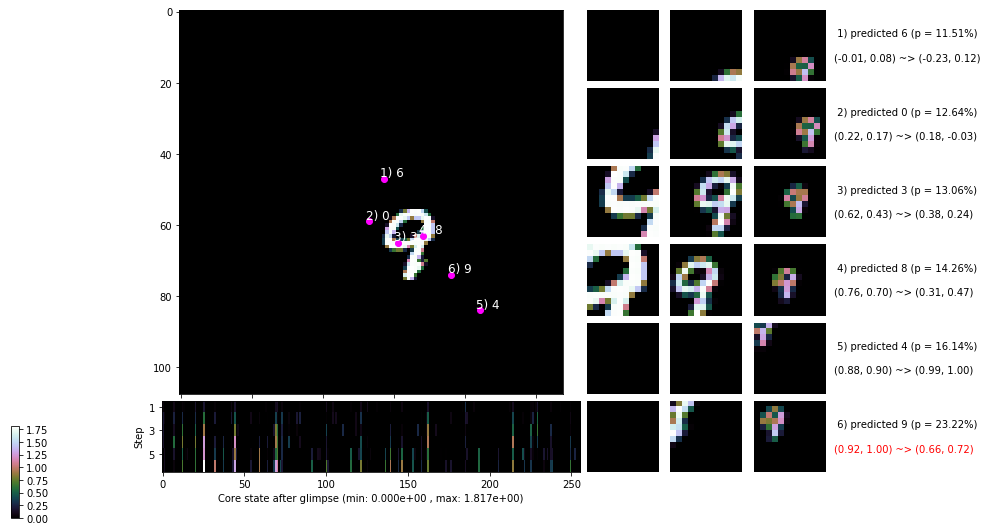

 b   1500/  4000 >> 108.9 ms/b | lr: 9.89e-04 | grad 2norm:  7.00 | grad inf norm:  2.136
       Weights || abs max:  0.41 ( 7658.70) | mean: -7.28e-03 ( 0.05) | var: 5.10e-03 ( 8965.51)
        Biases || abs max:  0.17 (  934.41) | mean: -1.58e-02 ( 2.06) | var: 6.23e-04 (22366.10)
                  class loss: 1.776 | steps: 4.260 | reward:  0.295 | acc.: 29.54%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.3 ms/b | lr: 9.85e-04 | grad 2norm:  7.26 | grad inf norm:  2.236
       Weights || abs max:  0.43 ( 5194.60) | mean: -8.59e-03 ( 0.04) | var: 5.44e-03 (11424.32)
        Biases || abs max:  0.21 (  697.22) | mean: -1.96e-02 ( 1.67) | var: 7.94e-04 (14145.69)
                  class loss: 1.691 | steps: 4.190 | reward:  0.332 | acc.: 33.20%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

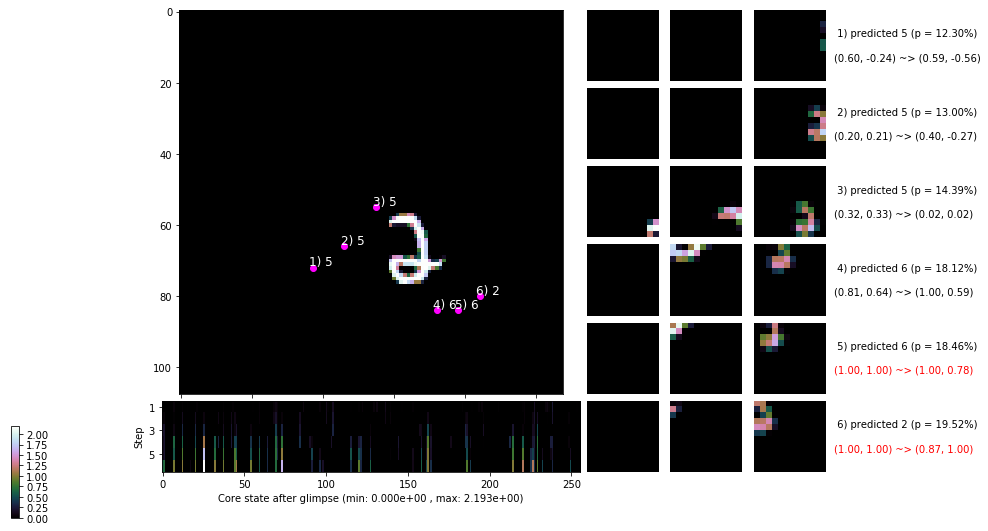

 b   2500/  4000 >> 101.8 ms/b | lr: 9.82e-04 | grad 2norm:  7.33 | grad inf norm:  2.241
       Weights || abs max:  0.49 ( 2461.39) | mean: -9.88e-03 ( 0.03) | var: 5.81e-03 (  271.46)
        Biases || abs max:  0.23 (  606.86) | mean: -2.26e-02 ( 1.52) | var: 9.45e-04 (19812.85)
                  class loss: 1.609 | steps: 4.069 | reward:  0.365 | acc.: 36.52%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.5 ms/b | lr: 9.78e-04 | grad 2norm:  8.01 | grad inf norm:  2.420
       Weights || abs max:  0.52 ( 5879.96) | mean: -1.09e-02 ( 0.04) | var: 6.20e-03 ( 7919.25)
        Biases || abs max:  0.26 (  646.55) | mean: -2.53e-02 ( 1.61) | var: 1.11e-03 ( 7154.57)
                  class loss: 1.536 | steps: 3.897 | reward:  0.410 | acc.: 40.95%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

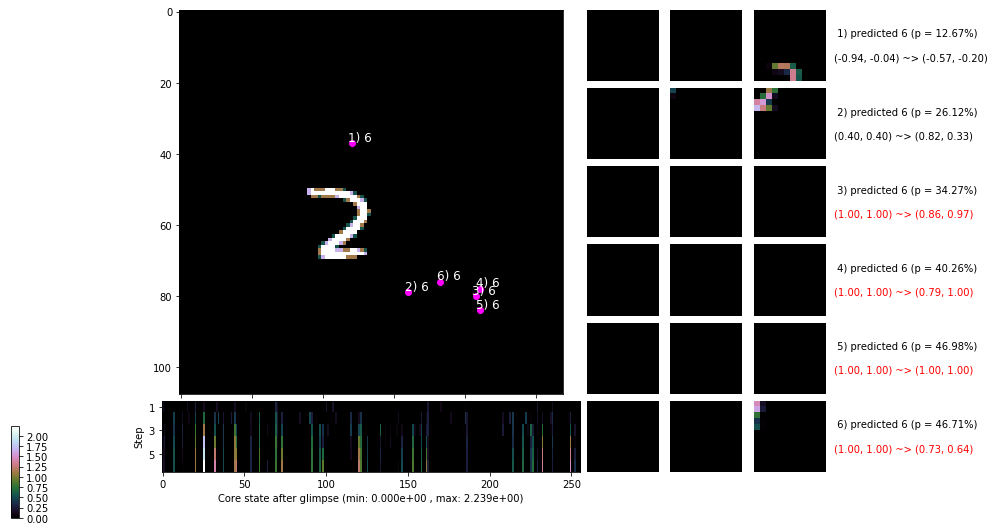

 b   3500/  4000 >> 103.1 ms/b | lr: 9.74e-04 | grad 2norm:  9.05 | grad inf norm:  2.761
       Weights || abs max:  0.57 ( 2481.81) | mean: -1.18e-02 ( 0.03) | var: 6.54e-03 ( 1040.31)
        Biases || abs max:  0.29 (  932.18) | mean: -2.76e-02 ( 1.97) | var: 1.26e-03 (93131.95)
                  class loss: 1.468 | steps: 3.806 | reward:  0.440 | acc.: 44.00%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.9 ms/b | lr: 9.70e-04 | grad 2norm:  8.89 | grad inf norm:  2.658
       Weights || abs max:  0.60 ( 2701.52) | mean: -1.26e-02 ( 0.03) | var: 6.92e-03 (  364.72)
        Biases || abs max:  0.30 (  810.97) | mean: -2.92e-02 ( 1.83) | var: 1.41e-03 (15277.00)
                  class loss: 1.417 | steps: 3.709 | reward:  0.469 | acc.: 46.91%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

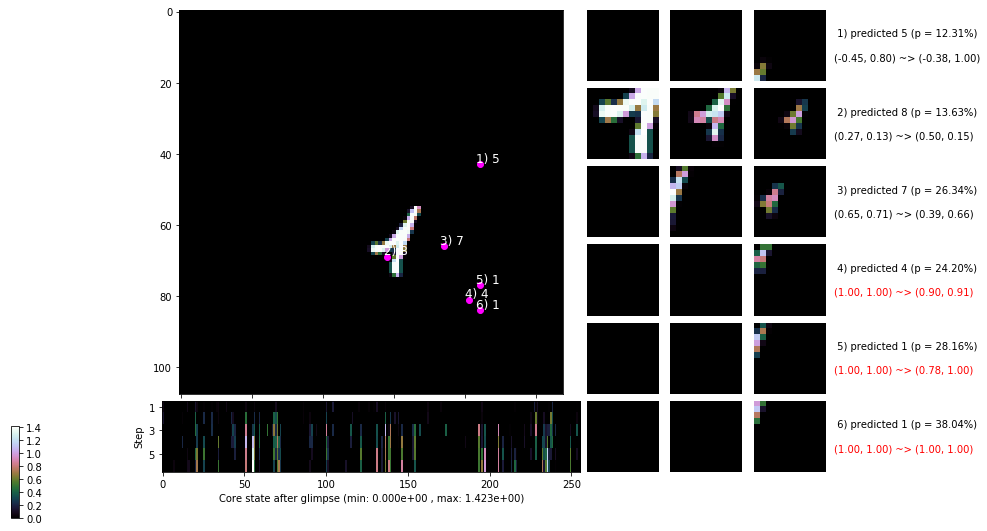

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


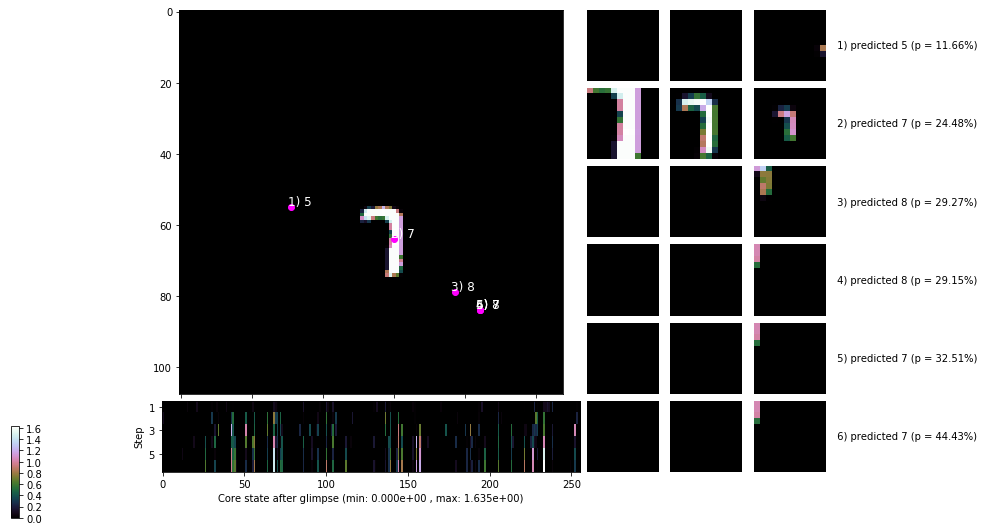


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


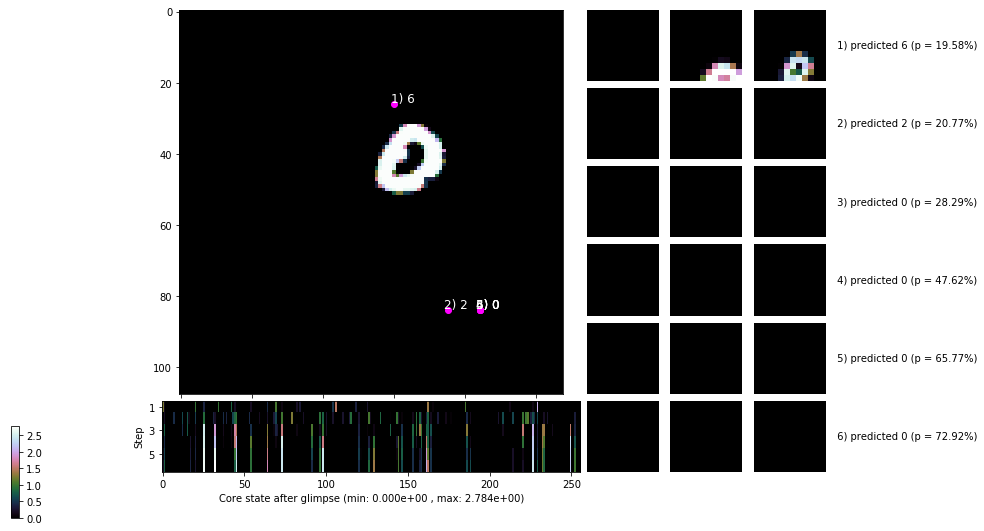

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


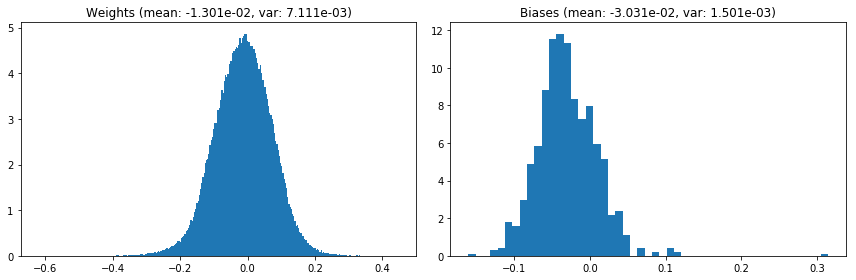

                                      Location network weights and biases


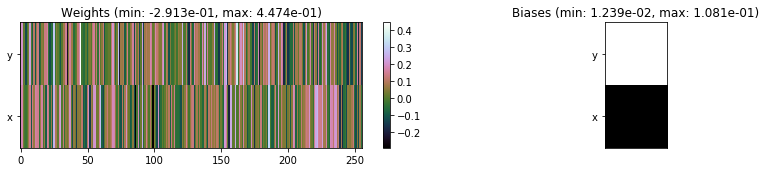

---------------------------------------------------------------------------------------------------------------
Elapsed time:  409.81 sec | TRAIN >> class loss: 1.6744 | steps:  4.084    | reward:  0.3509    | acc.: 35.093% 
                          | VAL   >> class loss: 1.3494 | steps:  3.581    | reward:  0.4870    | acc.: 48.700% 


Epoch   2/400) lr = 0.0009695
 b    500/  4000 >> 100.7 ms/b | lr: 9.67e-04 | grad 2norm:  9.13 | grad inf norm:  2.707
       Weights || abs max:  0.63 ( 2402.86) | mean: -1.35e-02 ( 0.03) | var: 7.30e-03 (  320.13)
        Biases || abs max:  0.33 (  880.99) | mean: -3.13e-02 ( 2.06) | var: 1.56e-03 (19847.49)
                  class loss: 1.302 | steps: 3.619 | reward:  0.508 | acc.: 50.76%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.0 ms/b | lr: 9.63e-04 | grad 2norm:  9.44 | grad inf norm:  2.768
       Weights || abs max:  0.64 ( 9002.65) | mean: -1.41e-02 ( 0.05) | var

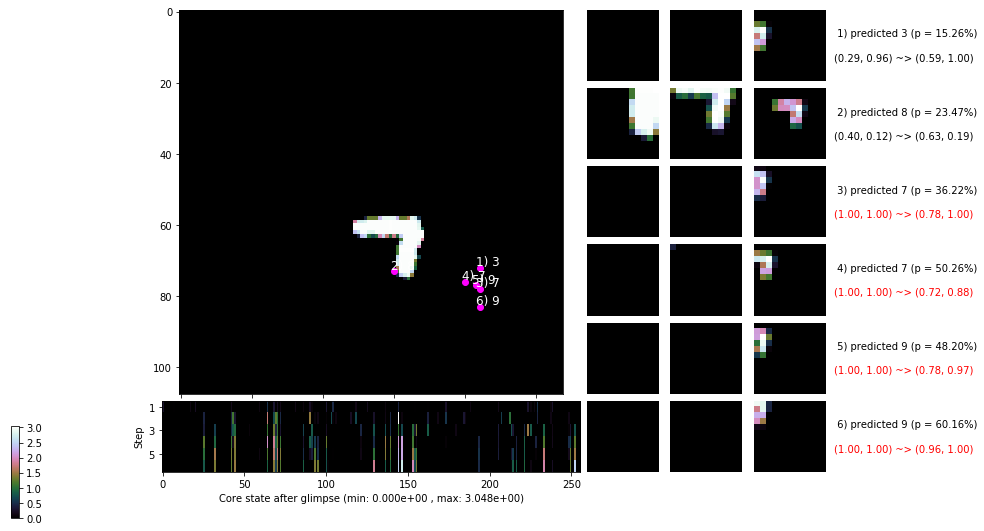

 b   1500/  4000 >> 103.2 ms/b | lr: 9.59e-04 | grad 2norm:  9.12 | grad inf norm:  2.608
       Weights || abs max:  0.66 ( 2386.45) | mean: -1.48e-02 ( 0.03) | var: 8.03e-03 (  352.02)
        Biases || abs max:  0.39 (  921.99) | mean: -3.41e-02 ( 1.66) | var: 1.82e-03 (37377.61)
                  class loss: 1.137 | steps: 3.333 | reward:  0.580 | acc.: 58.02%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.7 ms/b | lr: 9.55e-04 | grad 2norm:  9.34 | grad inf norm:  2.639
       Weights || abs max:  0.68 ( 3962.50) | mean: -1.55e-02 ( 0.04) | var: 8.42e-03 ( 4037.33)
        Biases || abs max:  0.41 (  630.73) | mean: -3.54e-02 ( 1.25) | var: 1.96e-03 ( 8862.01)
                  class loss: 1.069 | steps: 3.269 | reward:  0.614 | acc.: 61.39%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

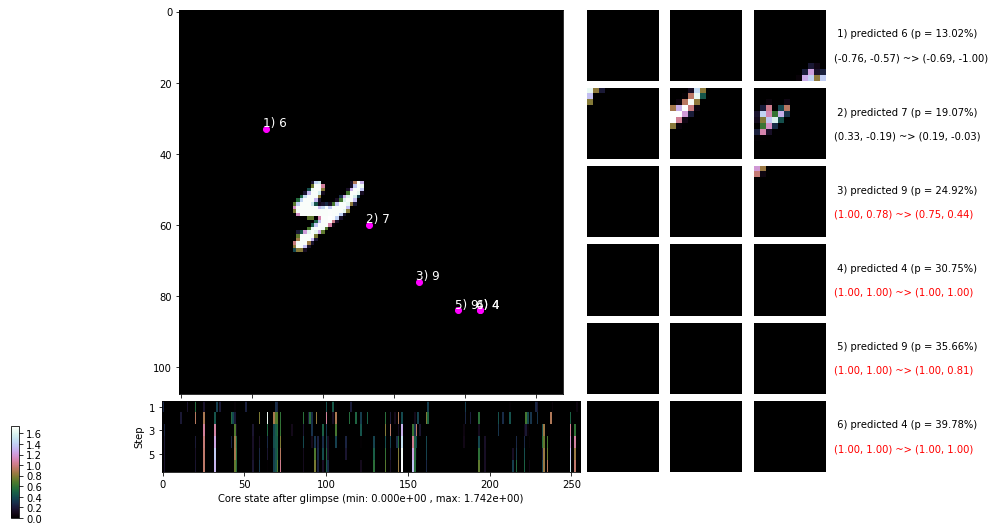

 b   2500/  4000 >> 103.7 ms/b | lr: 9.52e-04 | grad 2norm:  9.01 | grad inf norm:  2.547
       Weights || abs max:  0.71 ( 2812.91) | mean: -1.61e-02 ( 0.03) | var: 8.79e-03 (  806.23)
        Biases || abs max:  0.43 ( 1252.20) | mean: -3.67e-02 ( 1.90) | var: 2.09e-03 (309059.00)
                  class loss: 1.044 | steps: 3.202 | reward:  0.610 | acc.: 60.97%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 104.3 ms/b | lr: 9.48e-04 | grad 2norm:  9.05 | grad inf norm:  2.582
       Weights || abs max:  0.73 ( 3551.91) | mean: -1.67e-02 ( 0.03) | var: 9.16e-03 ( 1277.67)
        Biases || abs max:  0.45 (  788.25) | mean: -3.75e-02 ( 1.60) | var: 2.20e-03 (15395.14)
                  class loss: 0.985 | steps: 3.144 | reward:  0.641 | acc.: 64.14%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

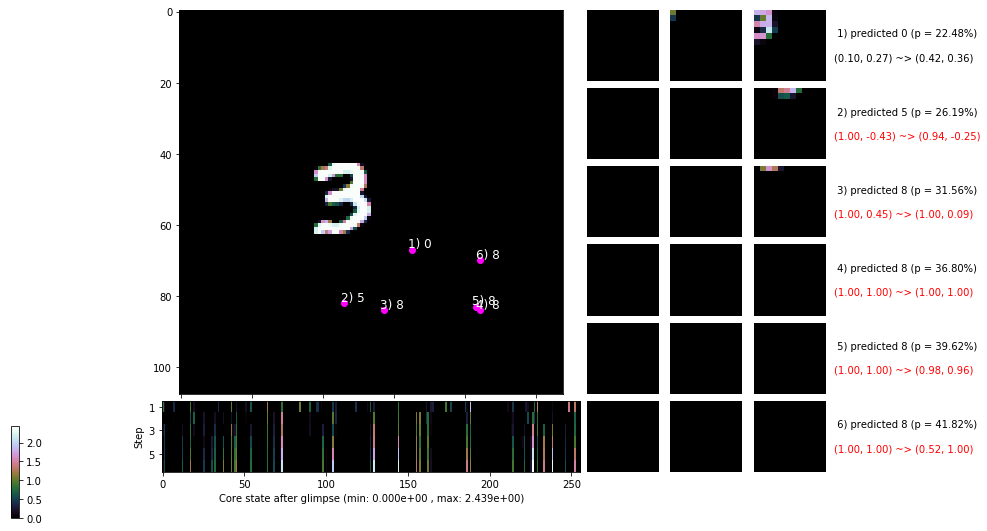

 b   3500/  4000 >> 108.0 ms/b | lr: 9.45e-04 | grad 2norm:  9.19 | grad inf norm:  2.647
       Weights || abs max:  0.77 ( 7752.22) | mean: -1.73e-02 ( 0.05) | var: 9.52e-03 (32606.87)
        Biases || abs max:  0.48 (  497.84) | mean: -3.86e-02 ( 1.03) | var: 2.34e-03 ( 8124.22)
                  class loss: 0.939 | steps: 3.178 | reward:  0.653 | acc.: 65.33%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.4 ms/b | lr: 9.41e-04 | grad 2norm:  8.94 | grad inf norm:  2.548
       Weights || abs max:  0.91 ( 3354.31) | mean: -1.79e-02 ( 0.03) | var: 9.89e-03 (  951.30)
        Biases || abs max:  0.50 (  767.28) | mean: -4.00e-02 ( 1.37) | var: 2.50e-03 (35930.11)
                  class loss: 0.907 | steps: 3.133 | reward:  0.675 | acc.: 67.53%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

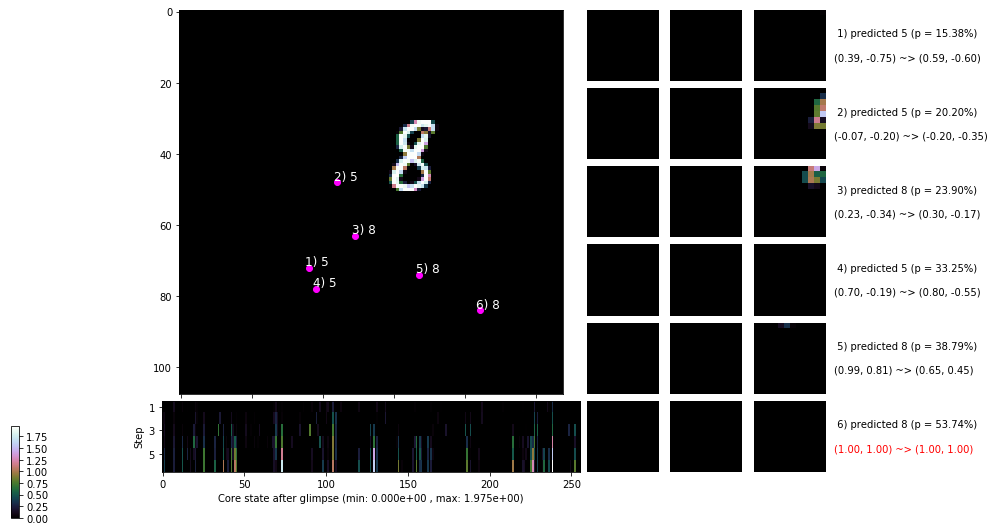

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


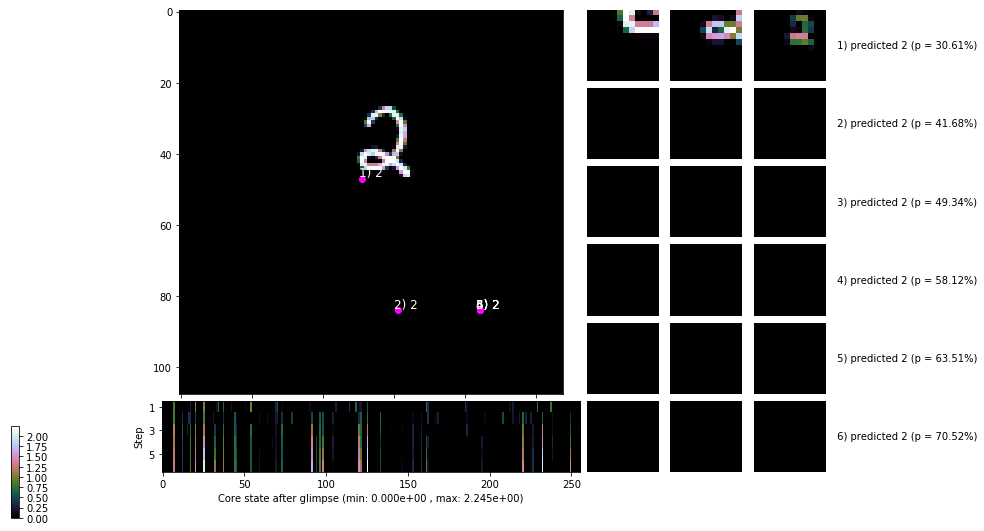


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


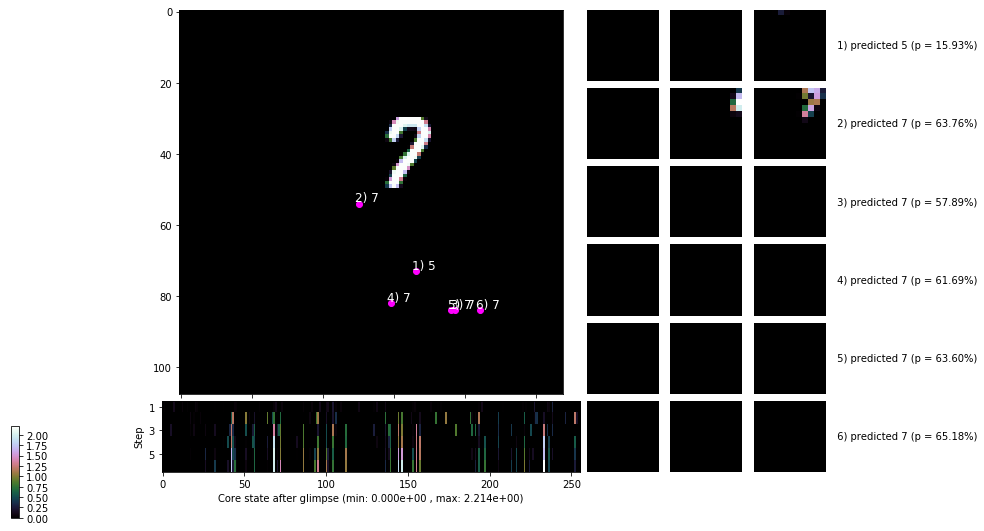

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


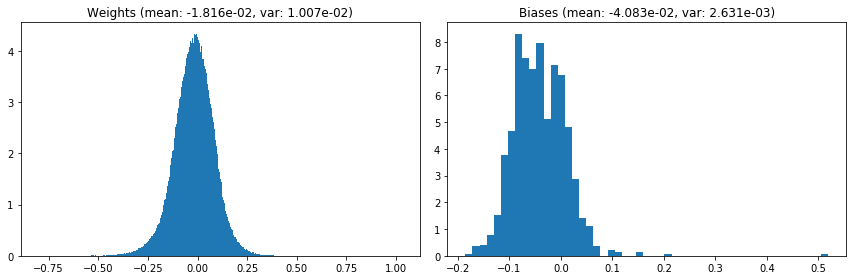

                                      Location network weights and biases


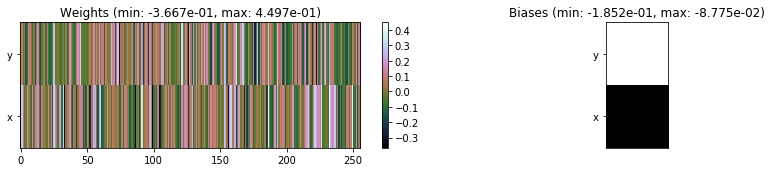

---------------------------------------------------------------------------------------------------------------
Elapsed time:  412.48 sec | TRAIN >> class loss: 1.0708 | steps:  3.293    | reward:  0.6047    | acc.: 60.469% 
                          | VAL   >> class loss: 0.9180 | steps:  3.051    | reward:  0.6636    | acc.: 66.360% 


Epoch   3/400) lr = 0.0009399
 b    500/  4000 >> 100.3 ms/b | lr: 9.37e-04 | grad 2norm:  8.89 | grad inf norm:  2.534
       Weights || abs max:  1.11 ( 4321.20) | mean: -1.84e-02 ( 0.04) | var: 1.02e-02 ( 1695.58)
        Biases || abs max:  0.52 (  538.91) | mean: -4.16e-02 ( 1.32) | var: 2.70e-03 (15887.25)
                  class loss: 0.903 | steps: 3.064 | reward:  0.677 | acc.: 67.67%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.4 ms/b | lr: 9.33e-04 | grad 2norm:  8.82 | grad inf norm:  2.536
       Weights || abs max:  1.17 ( 2698.00) | mean: -1.89e-02 ( 0.03) | var

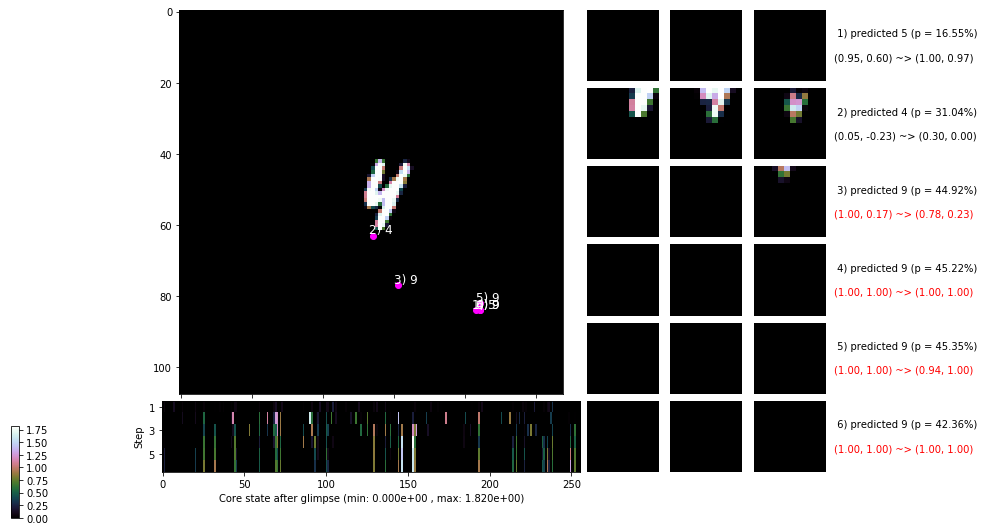

 b   1500/  4000 >> 106.5 ms/b | lr: 9.30e-04 | grad 2norm:  9.07 | grad inf norm:  2.602
       Weights || abs max:  1.16 ( 4404.17) | mean: -1.92e-02 ( 0.04) | var: 1.09e-02 ( 3520.86)
        Biases || abs max:  0.55 (  593.64) | mean: -4.47e-02 ( 1.34) | var: 3.06e-03 (34337.20)
                  class loss: 0.853 | steps: 3.038 | reward:  0.690 | acc.: 69.04%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.1 ms/b | lr: 9.26e-04 | grad 2norm:  8.77 | grad inf norm:  2.472
       Weights || abs max:  1.15 ( 4018.49) | mean: -1.97e-02 ( 0.03) | var: 1.13e-02 ( 1783.78)
        Biases || abs max:  0.56 (  855.42) | mean: -4.60e-02 ( 1.37) | var: 3.23e-03 (54298.16)
                  class loss: 0.843 | steps: 2.973 | reward:  0.698 | acc.: 69.76%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

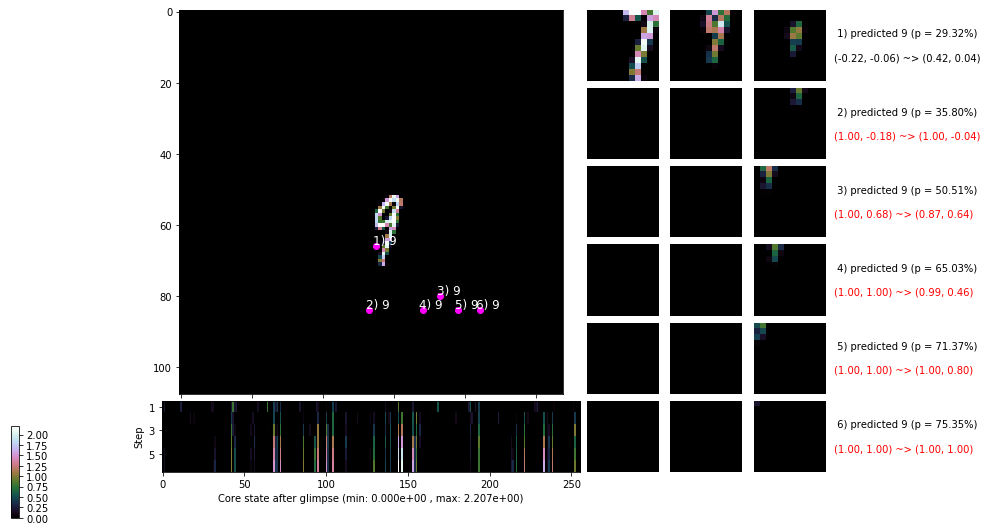

 b   2500/  4000 >> 107.5 ms/b | lr: 9.23e-04 | grad 2norm:  9.01 | grad inf norm:  2.621
       Weights || abs max:  1.15 ( 2634.60) | mean: -2.01e-02 ( 0.03) | var: 1.16e-02 (  199.61)
        Biases || abs max:  0.57 (  388.95) | mean: -4.69e-02 ( 1.10) | var: 3.39e-03 ( 8265.72)
                  class loss: 0.827 | steps: 2.975 | reward:  0.703 | acc.: 70.31%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.8 ms/b | lr: 9.19e-04 | grad 2norm:  8.93 | grad inf norm:  2.561
       Weights || abs max:  1.15 ( 3520.02) | mean: -2.05e-02 ( 0.03) | var: 1.19e-02 (  941.92)
        Biases || abs max:  0.58 (  460.54) | mean: -4.81e-02 ( 1.05) | var: 3.55e-03 ( 2754.39)
                  class loss: 0.834 | steps: 3.061 | reward:  0.701 | acc.: 70.13%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

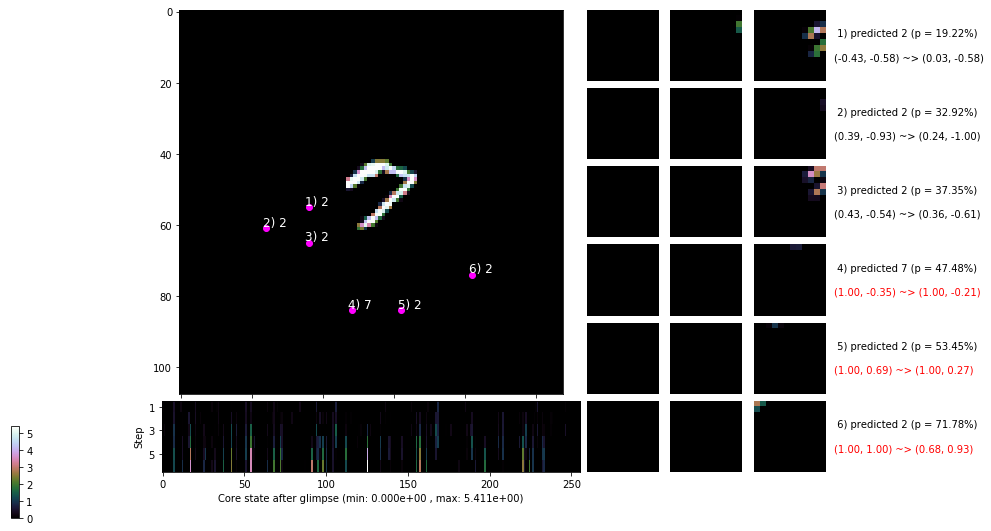

 b   3500/  4000 >> 107.5 ms/b | lr: 9.16e-04 | grad 2norm:  8.81 | grad inf norm:  2.540
       Weights || abs max:  1.03 ( 2530.38) | mean: -2.09e-02 ( 0.03) | var: 1.22e-02 (  246.06)
        Biases || abs max:  0.59 (  492.64) | mean: -4.91e-02 ( 1.16) | var: 3.72e-03 ( 6082.42)
                  class loss: 0.824 | steps: 3.028 | reward:  0.706 | acc.: 70.59%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.0 ms/b | lr: 9.12e-04 | grad 2norm:  8.60 | grad inf norm:  2.506
       Weights || abs max:  0.96 ( 3032.35) | mean: -2.12e-02 ( 0.03) | var: 1.25e-02 (  532.30)
        Biases || abs max:  0.61 (  657.94) | mean: -5.03e-02 ( 1.42) | var: 3.82e-03 (16925.67)
                  class loss: 0.789 | steps: 2.973 | reward:  0.725 | acc.: 72.49%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

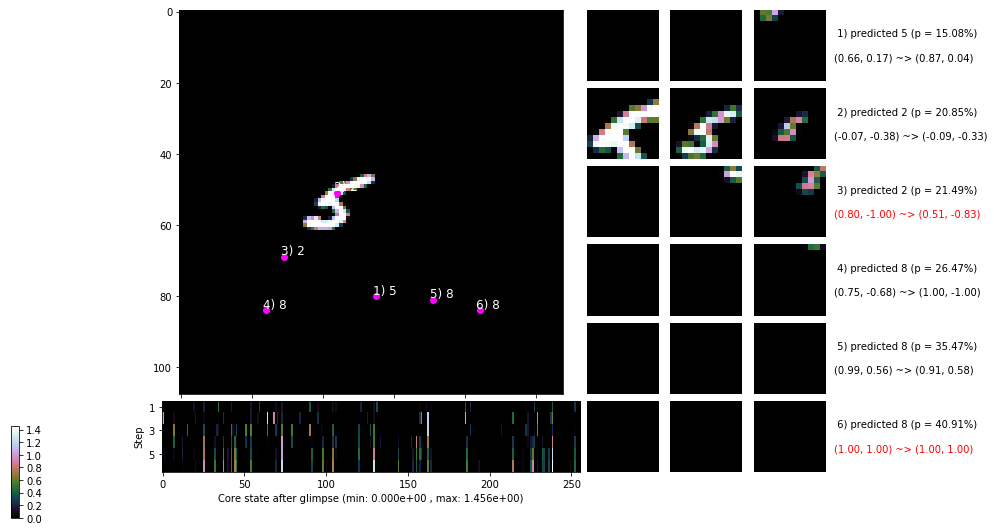

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


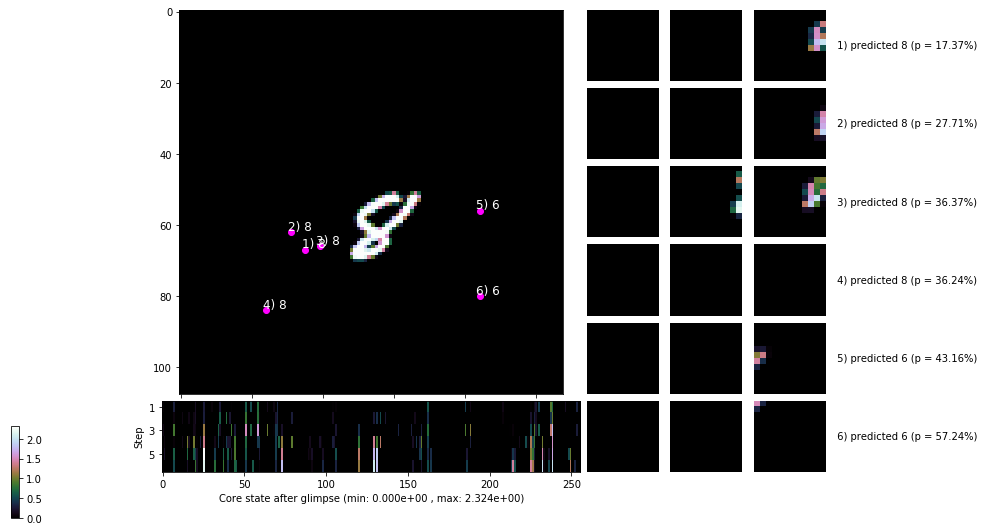


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


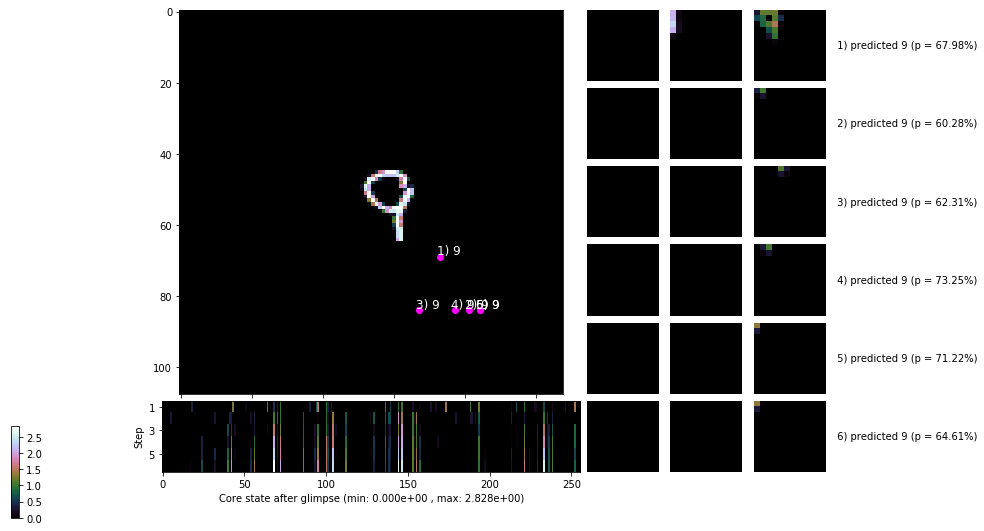

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


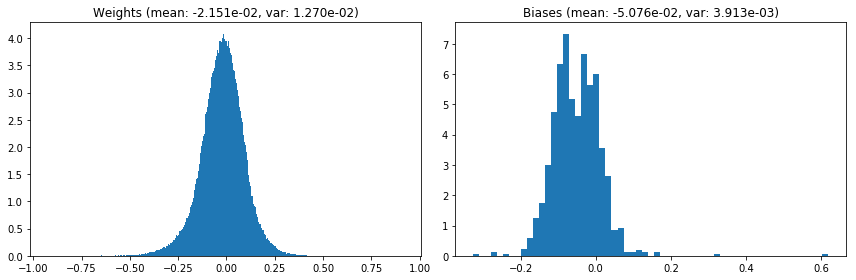

                                      Location network weights and biases


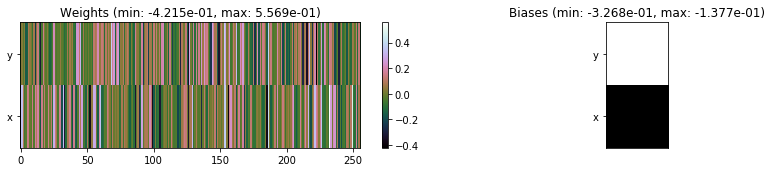

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.48 sec | TRAIN >> class loss: 0.8461 | steps:  3.026    | reward:  0.6974    | acc.: 69.742% 
                          | VAL   >> class loss: 0.6929 | steps:  2.907    | reward:  0.7492    | acc.: 74.920% 


Epoch   4/400) lr = 0.0009112
 b    500/  4000 >> 104.3 ms/b | lr: 9.08e-04 | grad 2norm:  8.78 | grad inf norm:  2.571
       Weights || abs max:  0.93 ( 2658.32) | mean: -2.16e-02 ( 0.03) | var: 1.28e-02 (  343.61)
        Biases || abs max:  0.62 (  305.76) | mean: -5.11e-02 ( 0.87) | var: 3.97e-03 ( 1248.78)
                  class loss: 0.742 | steps: 2.926 | reward:  0.736 | acc.: 73.63%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 107.4 ms/b | lr: 9.05e-04 | grad 2norm:  8.52 | grad inf norm:  2.497
       Weights || abs max:  0.96 ( 5037.65) | mean: -2.19e-02 ( 0.04) | var

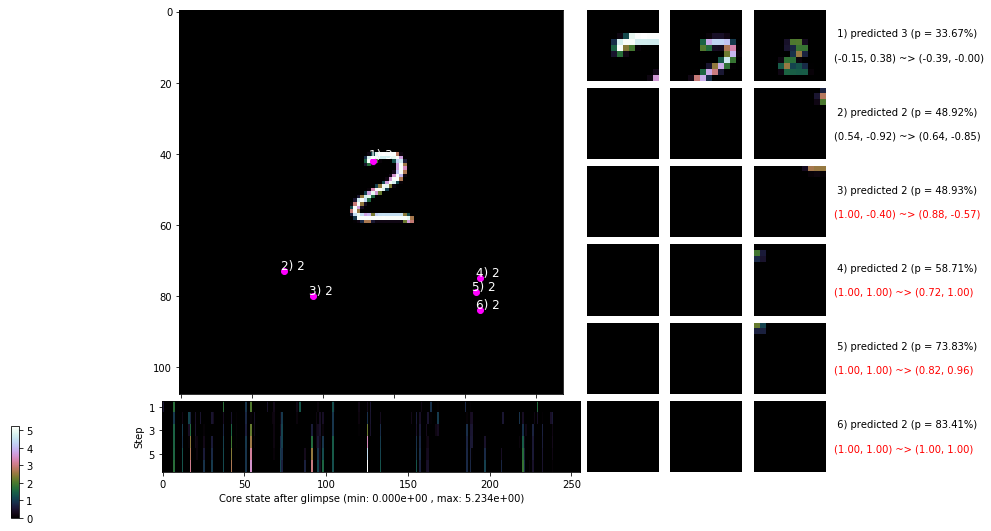

 b   1500/  4000 >> 102.2 ms/b | lr: 9.01e-04 | grad 2norm:  8.68 | grad inf norm:  2.534
       Weights || abs max:  0.97 ( 2311.19) | mean: -2.22e-02 ( 0.03) | var: 1.35e-02 (  363.03)
        Biases || abs max:  0.64 (  326.52) | mean: -5.32e-02 ( 0.84) | var: 4.34e-03 ( 1531.41)
                  class loss: 0.732 | steps: 2.948 | reward:  0.738 | acc.: 73.80%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.0 ms/b | lr: 8.98e-04 | grad 2norm:  8.49 | grad inf norm:  2.471
       Weights || abs max:  1.00 ( 2894.01) | mean: -2.24e-02 ( 0.03) | var: 1.38e-02 (  521.51)
        Biases || abs max:  0.66 (  422.80) | mean: -5.41e-02 ( 1.01) | var: 4.53e-03 ( 5054.42)
                  class loss: 0.706 | steps: 2.921 | reward:  0.752 | acc.: 75.20%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

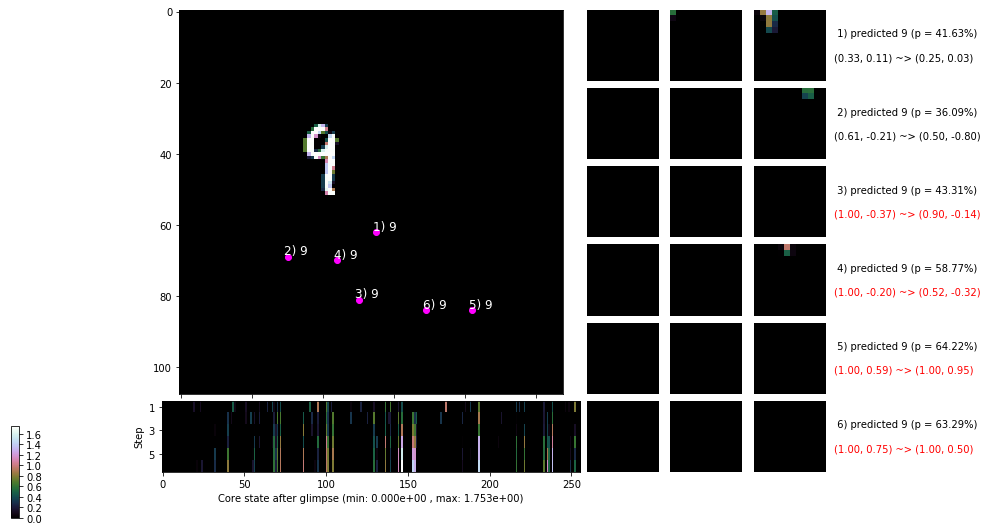

 b   2500/  4000 >> 107.5 ms/b | lr: 8.95e-04 | grad 2norm:  8.62 | grad inf norm:  2.492
       Weights || abs max:  1.02 ( 3550.26) | mean: -2.26e-02 ( 0.03) | var: 1.41e-02 ( 2262.94)
        Biases || abs max:  0.67 (  530.88) | mean: -5.47e-02 ( 1.03) | var: 4.70e-03 ( 8781.88)
                  class loss: 0.696 | steps: 2.870 | reward:  0.761 | acc.: 76.09%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.7 ms/b | lr: 8.91e-04 | grad 2norm:  8.70 | grad inf norm:  2.575
       Weights || abs max:  1.04 ( 3474.74) | mean: -2.28e-02 ( 0.03) | var: 1.44e-02 (  628.70)
        Biases || abs max:  0.67 (  327.94) | mean: -5.52e-02 ( 0.83) | var: 4.87e-03 ( 1789.17)
                  class loss: 0.698 | steps: 2.873 | reward:  0.757 | acc.: 75.75%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

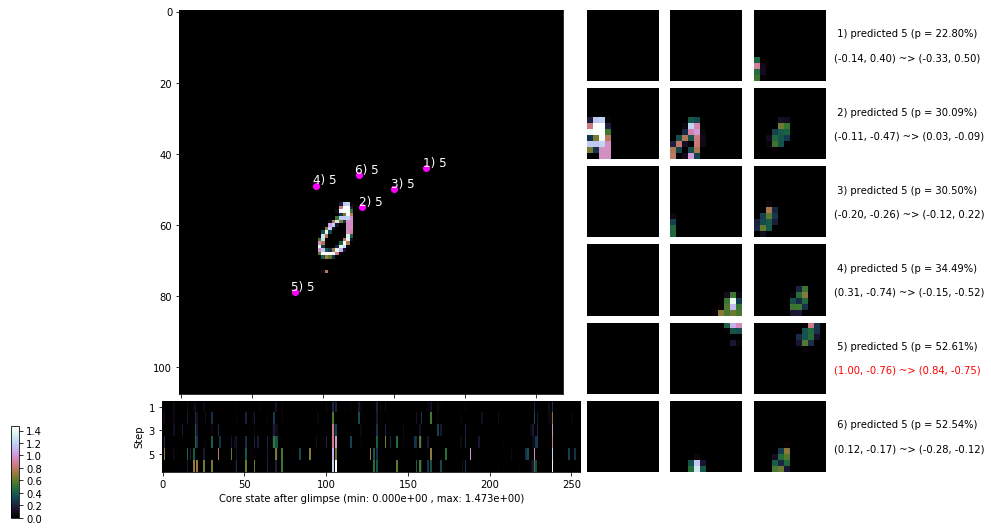

 b   3500/  4000 >> 107.6 ms/b | lr: 8.88e-04 | grad 2norm:  8.79 | grad inf norm:  2.622
       Weights || abs max:  1.07 ( 5696.35) | mean: -2.31e-02 ( 0.04) | var: 1.47e-02 (21528.92)
        Biases || abs max:  0.67 (  573.26) | mean: -5.59e-02 ( 1.06) | var: 4.99e-03 (26357.99)
                  class loss: 0.680 | steps: 2.830 | reward:  0.762 | acc.: 76.18%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.2 ms/b | lr: 8.84e-04 | grad 2norm:  9.02 | grad inf norm:  2.671
       Weights || abs max:  1.09 ( 2950.40) | mean: -2.34e-02 ( 0.03) | var: 1.50e-02 (  351.22)
        Biases || abs max:  0.68 (  562.18) | mean: -5.68e-02 ( 1.04) | var: 5.11e-03 (34946.96)
                  class loss: 0.679 | steps: 2.824 | reward:  0.763 | acc.: 76.27%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

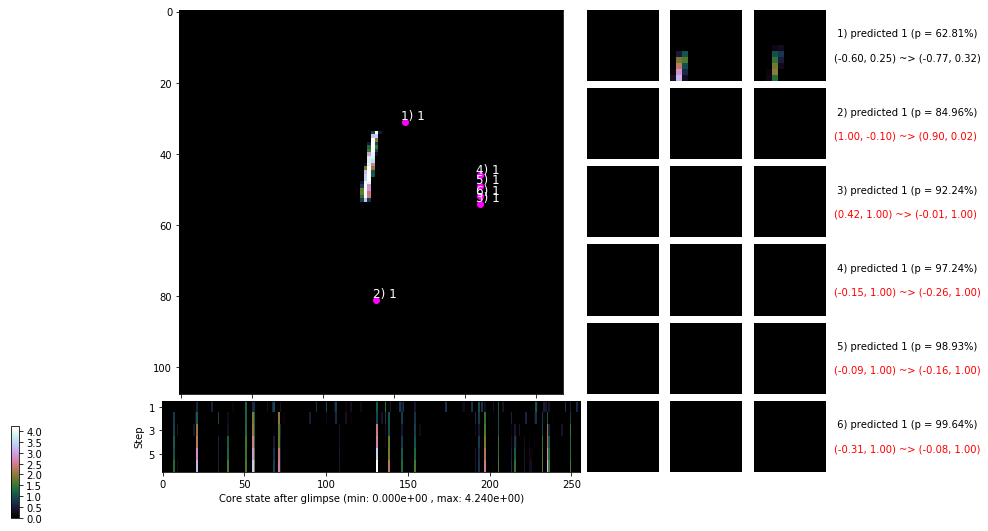

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


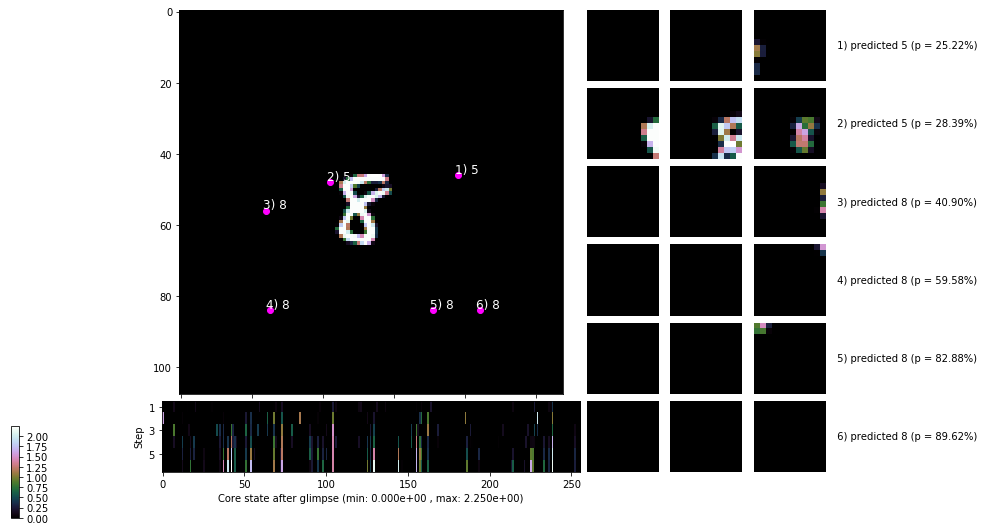


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


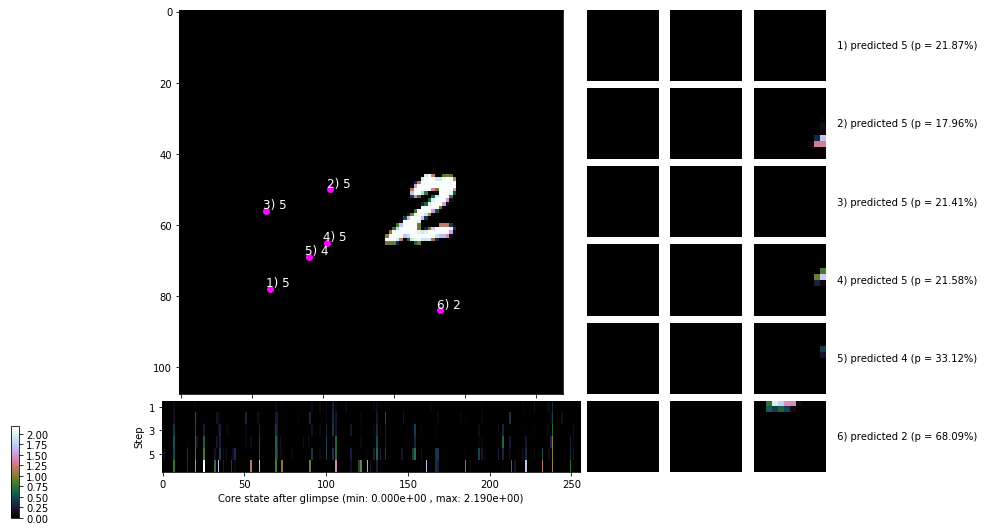

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


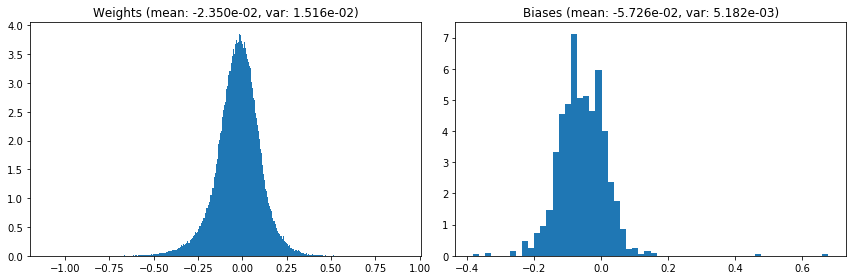

                                      Location network weights and biases


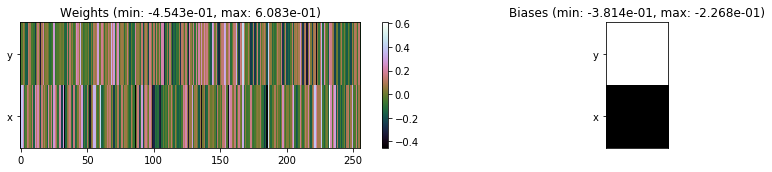

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.64 sec | TRAIN >> class loss: 0.7093 | steps:  2.886    | reward:  0.7512    | acc.: 75.118% 
                          | VAL   >> class loss: 0.6130 | steps:  2.707    | reward:  0.7928    | acc.: 79.280% 


Epoch   5/400) lr = 0.0008833
 b    500/  4000 >> 106.4 ms/b | lr: 8.81e-04 | grad 2norm:  8.68 | grad inf norm:  2.574
       Weights || abs max:  1.10 ( 7391.86) | mean: -2.36e-02 ( 0.05) | var: 1.53e-02 (16963.02)
        Biases || abs max:  0.68 (  359.62) | mean: -5.76e-02 ( 0.93) | var: 5.25e-03 ( 3425.44)
                  class loss: 0.671 | steps: 2.836 | reward:  0.770 | acc.: 76.99%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 110.7 ms/b | lr: 8.77e-04 | grad 2norm:  8.56 | grad inf norm:  2.554
       Weights || abs max:  1.09 (10484.63) | mean: -2.38e-02 ( 0.06) | var

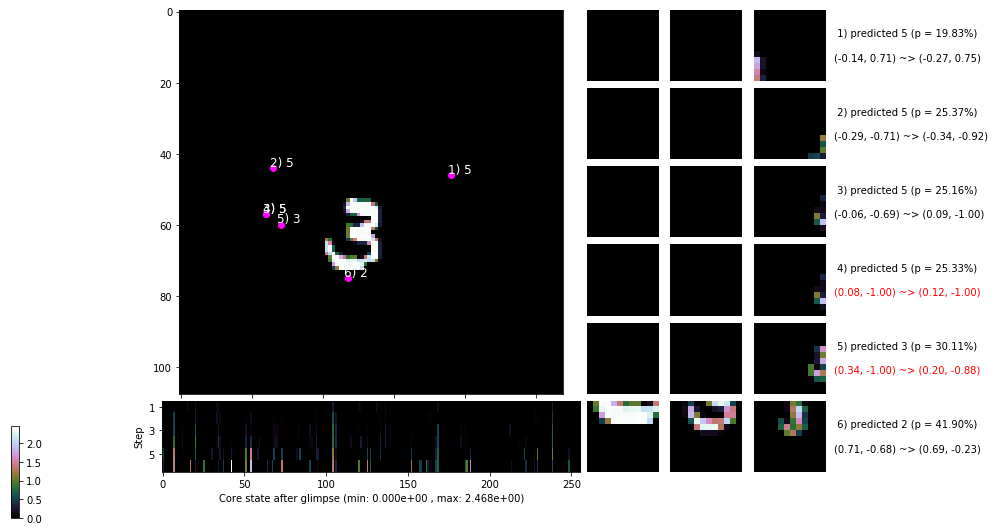

 b   1500/  4000 >> 110.0 ms/b | lr: 8.74e-04 | grad 2norm:  8.26 | grad inf norm:  2.463
       Weights || abs max:  1.09 ( 2734.12) | mean: -2.41e-02 ( 0.03) | var: 1.60e-02 (  398.25)
        Biases || abs max:  0.70 (  270.93) | mean: -5.93e-02 ( 0.75) | var: 5.61e-03 (  928.50)
                  class loss: 0.637 | steps: 2.808 | reward:  0.786 | acc.: 78.60%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.8 ms/b | lr: 8.70e-04 | grad 2norm:  8.31 | grad inf norm:  2.482
       Weights || abs max:  1.13 ( 3550.43) | mean: -2.42e-02 ( 0.03) | var: 1.63e-02 (  555.88)
        Biases || abs max:  0.71 (  782.27) | mean: -5.98e-02 ( 1.12) | var: 5.82e-03 (130737.58)
                  class loss: 0.579 | steps: 2.729 | reward:  0.806 | acc.: 80.56%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

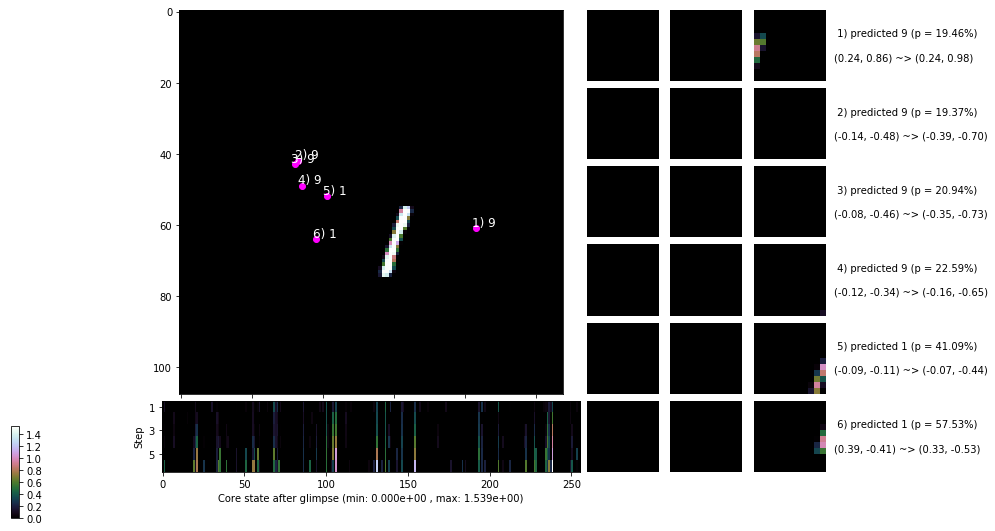

 b   2500/  4000 >> 110.4 ms/b | lr: 8.68e-04 | grad 2norm:  8.28 | grad inf norm:  2.467
       Weights || abs max:  1.15 ( 5056.84) | mean: -2.44e-02 ( 0.04) | var: 1.66e-02 ( 4102.42)
        Biases || abs max:  0.73 (  320.66) | mean: -6.04e-02 ( 0.84) | var: 6.02e-03 (10488.43)
                  class loss: 0.587 | steps: 2.751 | reward:  0.805 | acc.: 80.49%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 109.8 ms/b | lr: 8.64e-04 | grad 2norm:  8.21 | grad inf norm:  2.476
       Weights || abs max:  1.17 ( 3526.20) | mean: -2.46e-02 ( 0.03) | var: 1.69e-02 ( 1028.13)
        Biases || abs max:  0.74 (  244.59) | mean: -6.21e-02 ( 0.59) | var: 6.24e-03 ( 1200.08)
                  class loss: 0.572 | steps: 2.757 | reward:  0.810 | acc.: 80.98%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

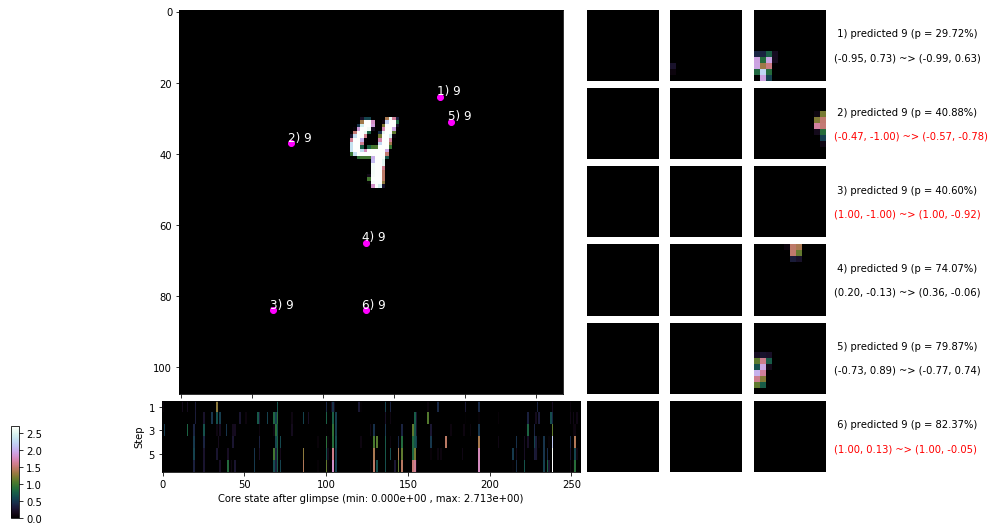

 b   3500/  4000 >> 113.3 ms/b | lr: 8.61e-04 | grad 2norm:  8.05 | grad inf norm:  2.404
       Weights || abs max:  1.17 ( 7303.45) | mean: -2.49e-02 ( 0.05) | var: 1.72e-02 (24630.77)
        Biases || abs max:  0.74 (  311.71) | mean: -6.33e-02 ( 0.76) | var: 6.40e-03 ( 6510.75)
                  class loss: 0.568 | steps: 2.718 | reward:  0.813 | acc.: 81.27%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 106.5 ms/b | lr: 8.57e-04 | grad 2norm:  8.09 | grad inf norm:  2.473
       Weights || abs max:  1.17 ( 3444.42) | mean: -2.51e-02 ( 0.03) | var: 1.75e-02 ( 1325.35)
        Biases || abs max:  0.75 (  159.52) | mean: -6.41e-02 ( 0.46) | var: 6.55e-03 (  254.17)
                  class loss: 0.556 | steps: 2.636 | reward:  0.822 | acc.: 82.17%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

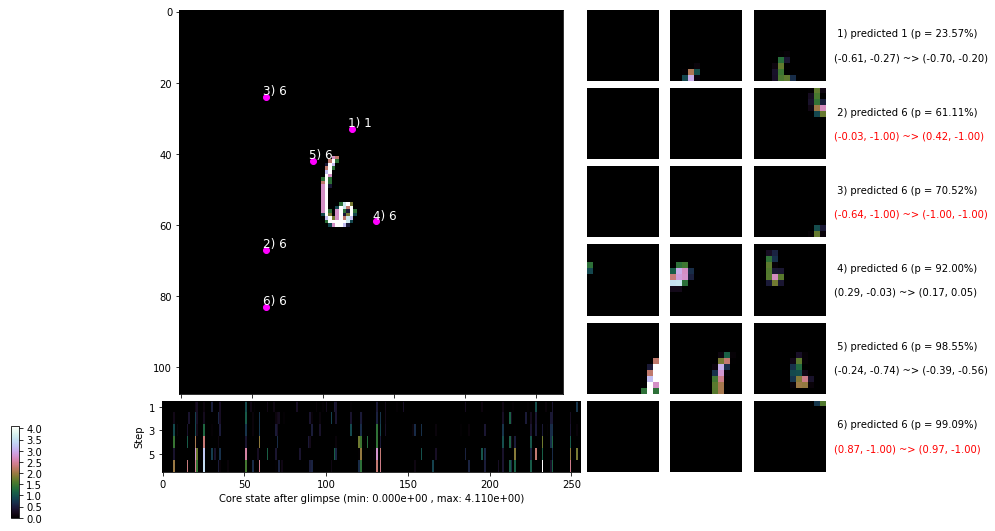

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


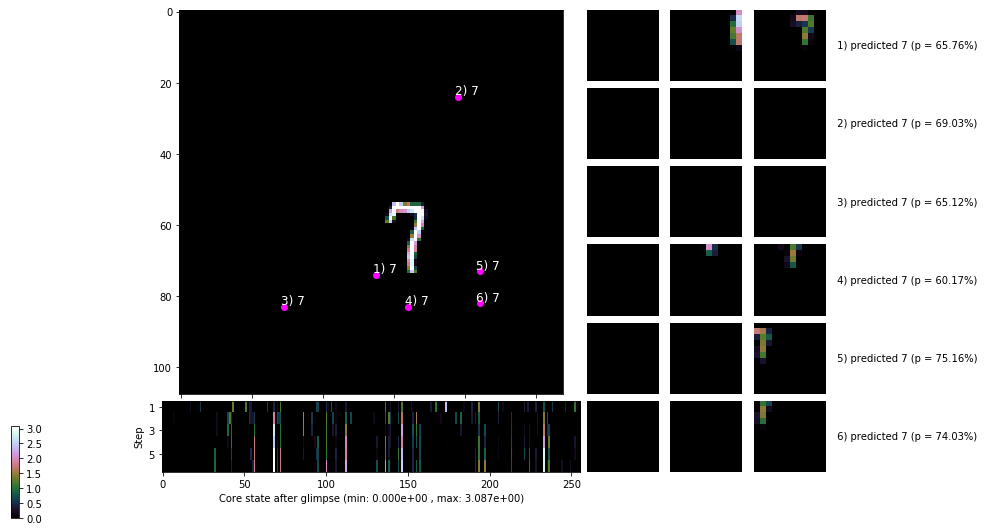


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


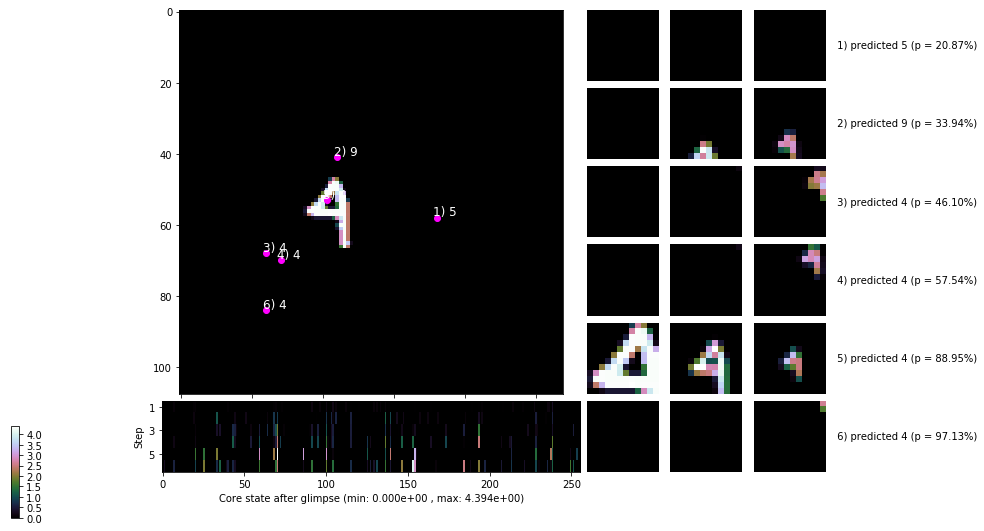

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


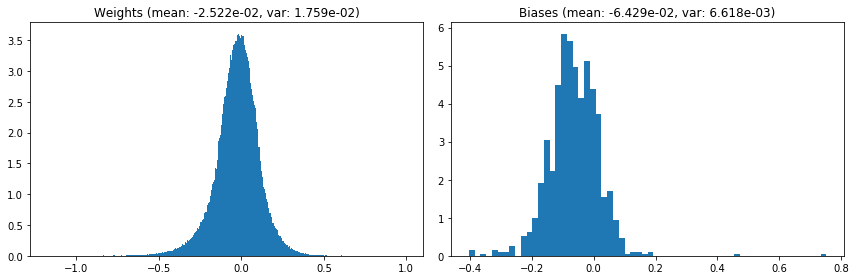

                                      Location network weights and biases


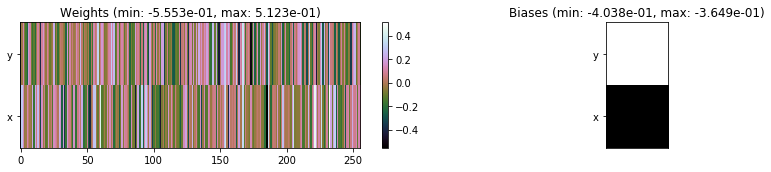

---------------------------------------------------------------------------------------------------------------
Elapsed time:  439.47 sec | TRAIN >> class loss: 0.6026 | steps:  2.761    | reward:  0.7985    | acc.: 79.854% 
                          | VAL   >> class loss: 0.5021 | steps:  2.495    | reward:  0.8288    | acc.: 82.880% 


Epoch   6/400) lr = 0.0008563
 b    500/  4000 >> 99.8 ms/b | lr: 8.54e-04 | grad 2norm:  7.53 | grad inf norm:  2.231
       Weights || abs max:  1.18 ( 5129.54) | mean: -2.53e-02 ( 0.04) | var: 1.77e-02 ( 5135.58)
        Biases || abs max:  0.75 (  234.21) | mean: -6.48e-02 ( 0.59) | var: 6.72e-03 (  734.56)
                  class loss: 0.538 | steps: 2.625 | reward:  0.827 | acc.: 82.69%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.6 ms/b | lr: 8.50e-04 | grad 2norm:  7.62 | grad inf norm:  2.237
       Weights || abs max:  1.21 ( 6518.56) | mean: -2.55e-02 ( 0.04) | var:

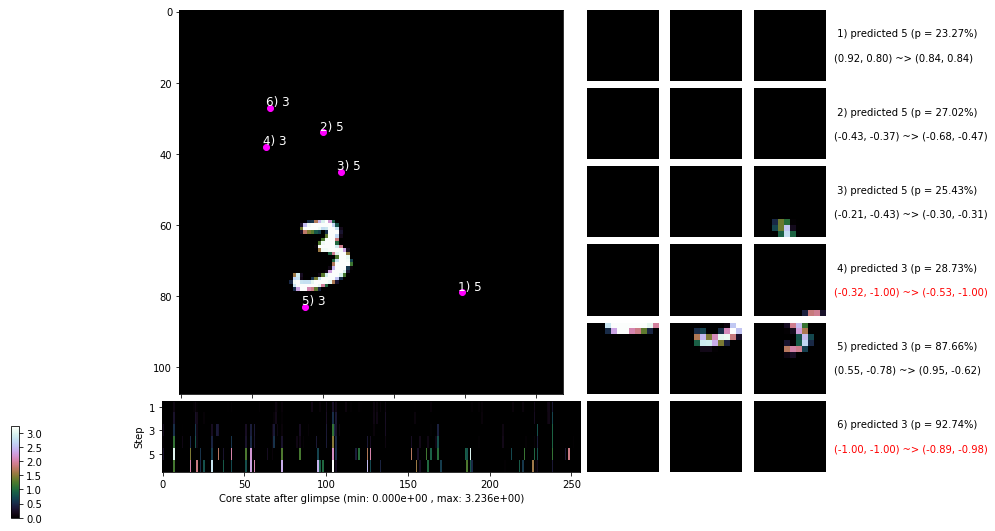

 b   1500/  4000 >> 107.1 ms/b | lr: 8.47e-04 | grad 2norm:  7.93 | grad inf norm:  2.409
       Weights || abs max:  1.22 ( 4191.59) | mean: -2.56e-02 ( 0.04) | var: 1.83e-02 ( 2427.87)
        Biases || abs max:  0.77 (  666.05) | mean: -6.63e-02 ( 1.01) | var: 7.21e-03 (100362.83)
                  class loss: 0.517 | steps: 2.631 | reward:  0.833 | acc.: 83.26%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.9 ms/b | lr: 8.44e-04 | grad 2norm:  7.96 | grad inf norm:  2.403
       Weights || abs max:  1.23 ( 5666.89) | mean: -2.57e-02 ( 0.04) | var: 1.86e-02 ( 6500.41)
        Biases || abs max:  0.77 (  239.50) | mean: -6.71e-02 ( 0.61) | var: 7.41e-03 ( 2983.85)
                  class loss: 0.502 | steps: 2.569 | reward:  0.838 | acc.: 83.81%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

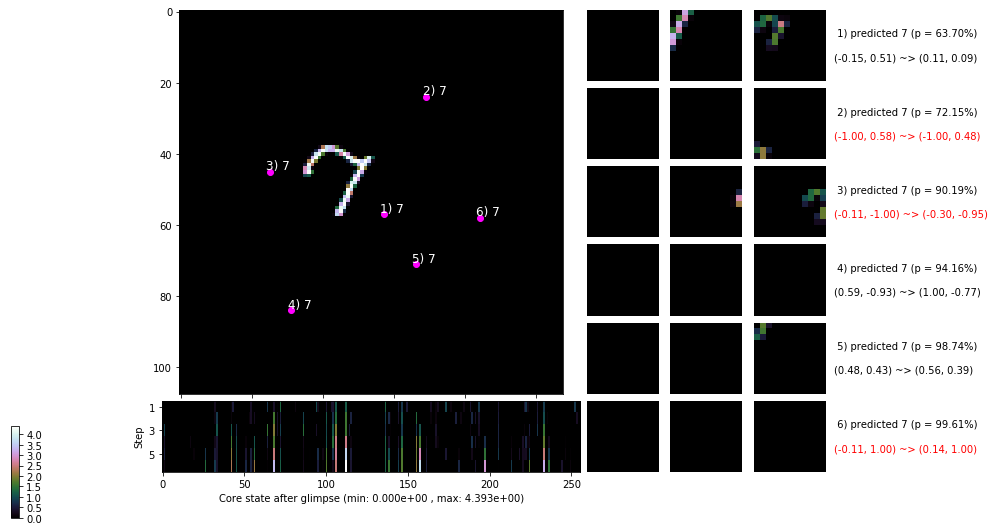

 b   2500/  4000 >> 101.4 ms/b | lr: 8.41e-04 | grad 2norm:  7.94 | grad inf norm:  2.399
       Weights || abs max:  1.24 ( 3060.28) | mean: -2.58e-02 ( 0.03) | var: 1.88e-02 (  641.49)
        Biases || abs max:  0.77 (  145.13) | mean: -6.76e-02 ( 0.42) | var: 7.56e-03 (  231.12)
                  class loss: 0.510 | steps: 2.574 | reward:  0.835 | acc.: 83.51%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 99.8 ms/b | lr: 8.38e-04 | grad 2norm:  7.72 | grad inf norm:  2.377
       Weights || abs max:  1.26 ( 7020.39) | mean: -2.60e-02 ( 0.05) | var: 1.91e-02 (11590.43)
        Biases || abs max:  0.77 ( 4311.42) | mean: -6.80e-02 ( 4.51) | var: 7.72e-03 (7879812.00)
                  class loss: 0.492 | steps: 2.571 | reward:  0.844 | acc.: 84.41%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

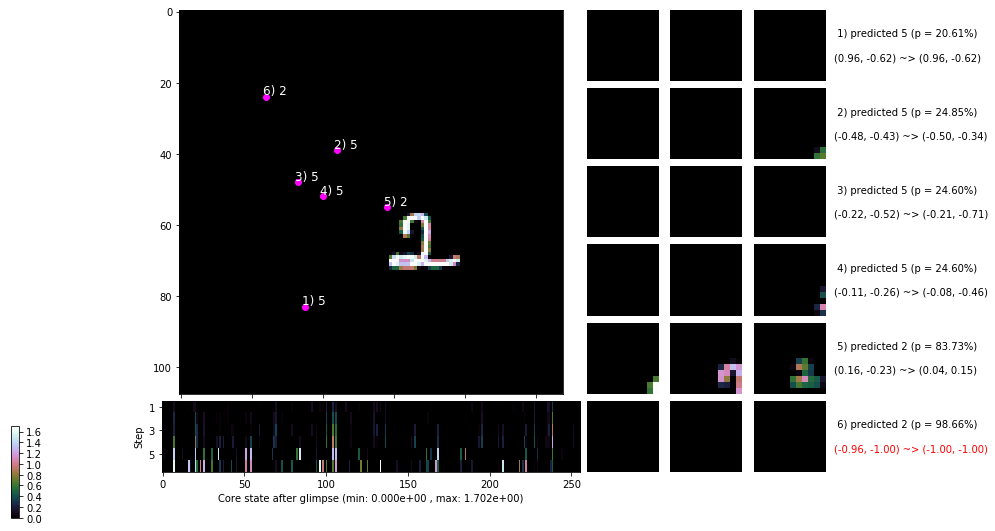

 b   3500/  4000 >> 106.0 ms/b | lr: 8.34e-04 | grad 2norm:  7.61 | grad inf norm:  2.313
       Weights || abs max:  1.28 ( 2974.43) | mean: -2.62e-02 ( 0.03) | var: 1.94e-02 (  577.25)
        Biases || abs max:  0.78 (  178.27) | mean: -6.87e-02 ( 0.50) | var: 7.98e-03 ( 1265.61)
                  class loss: 0.470 | steps: 2.566 | reward:  0.844 | acc.: 84.45%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.3 ms/b | lr: 8.31e-04 | grad 2norm:  7.58 | grad inf norm:  2.288
       Weights || abs max:  1.29 ( 5151.01) | mean: -2.64e-02 ( 0.04) | var: 1.96e-02 ( 6049.05)
        Biases || abs max:  0.78 (  177.84) | mean: -6.94e-02 ( 0.47) | var: 8.15e-03 (  782.88)
                  class loss: 0.482 | steps: 2.587 | reward:  0.841 | acc.: 84.10%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

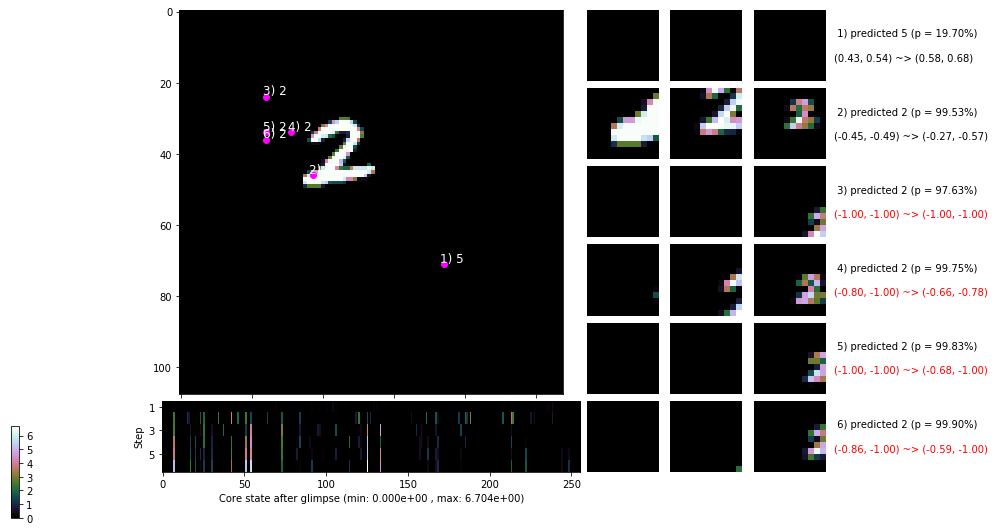

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


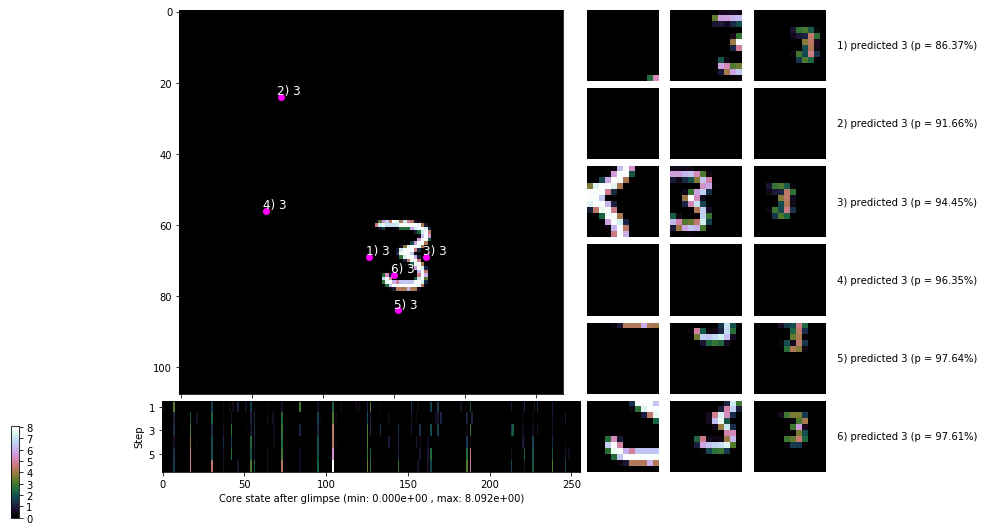


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


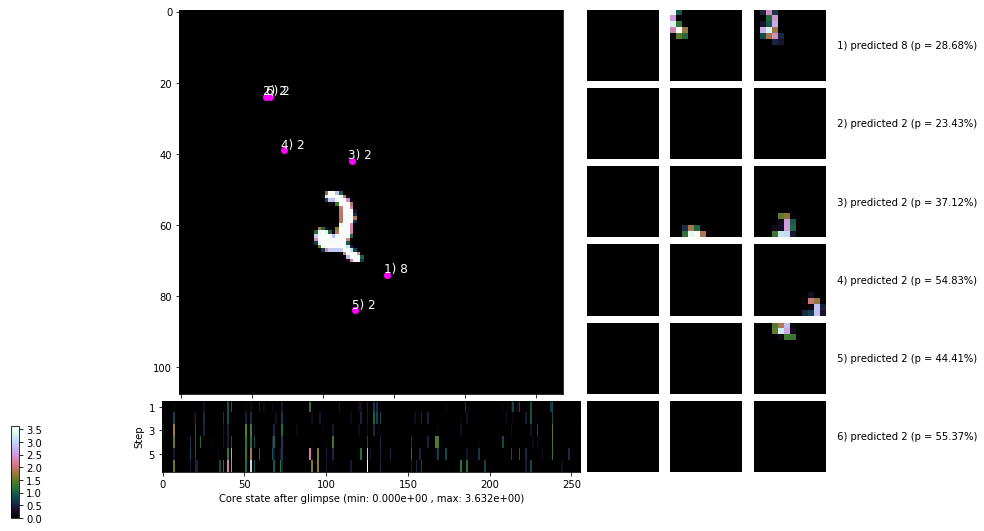

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


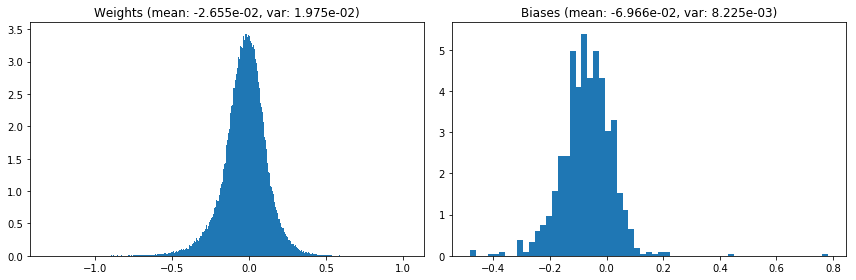

                                      Location network weights and biases


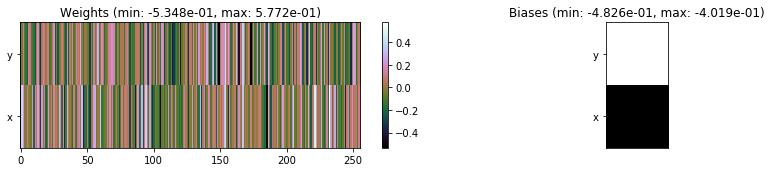

---------------------------------------------------------------------------------------------------------------
Elapsed time:  413.95 sec | TRAIN >> class loss: 0.5023 | steps:  2.589    | reward:  0.8371    | acc.: 83.708% 
                          | VAL   >> class loss: 0.4320 | steps:  2.491    | reward:  0.8562    | acc.: 85.620% 


Epoch   7/400) lr = 0.0008302
 b    500/  4000 >> 102.0 ms/b | lr: 8.28e-04 | grad 2norm:  7.66 | grad inf norm:  2.350
       Weights || abs max:  1.31 ( 4562.63) | mean: -2.65e-02 ( 0.04) | var: 1.99e-02 ( 4372.76)
        Biases || abs max:  0.79 (  315.84) | mean: -6.99e-02 ( 0.63) | var: 8.27e-03 (11217.20)
                  class loss: 0.444 | steps: 2.495 | reward:  0.854 | acc.: 85.39%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.6 ms/b | lr: 8.24e-04 | grad 2norm:  7.40 | grad inf norm:  2.264
       Weights || abs max:  1.31 ( 3947.55) | mean: -2.66e-02 ( 0.04) | var

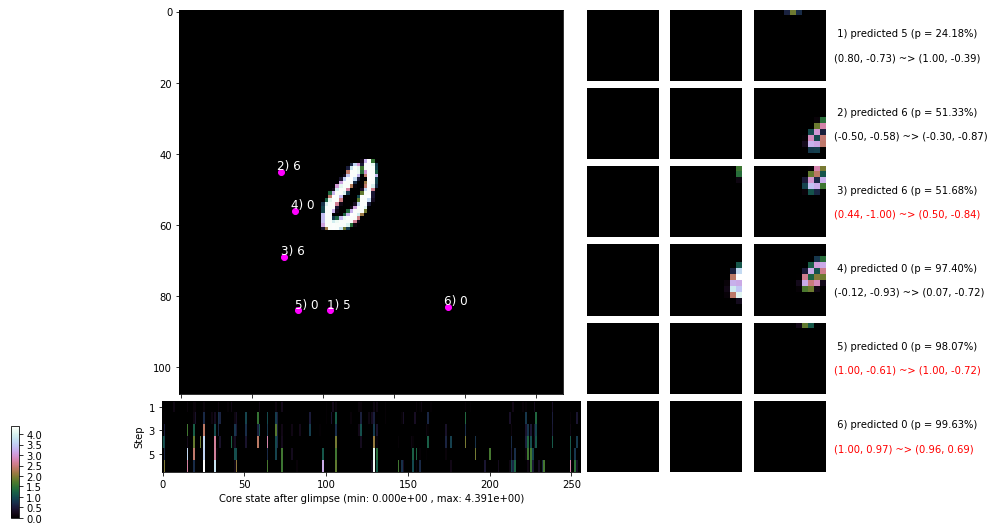

 b   1500/  4000 >> 104.0 ms/b | lr: 8.21e-04 | grad 2norm:  7.60 | grad inf norm:  2.341
       Weights || abs max:  1.32 ( 6404.92) | mean: -2.68e-02 ( 0.05) | var: 2.04e-02 ( 6004.01)
        Biases || abs max:  0.79 (  319.80) | mean: -7.16e-02 ( 0.60) | var: 8.65e-03 ( 8795.03)
                  class loss: 0.448 | steps: 2.507 | reward:  0.856 | acc.: 85.61%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.1 ms/b | lr: 8.18e-04 | grad 2norm:  7.43 | grad inf norm:  2.275
       Weights || abs max:  1.33 ( 5171.99) | mean: -2.70e-02 ( 0.04) | var: 2.06e-02 ( 3652.93)
        Biases || abs max:  0.78 ( 1161.45) | mean: -7.25e-02 ( 2.24) | var: 8.75e-03 (463639.69)
                  class loss: 0.476 | steps: 2.579 | reward:  0.845 | acc.: 84.47%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

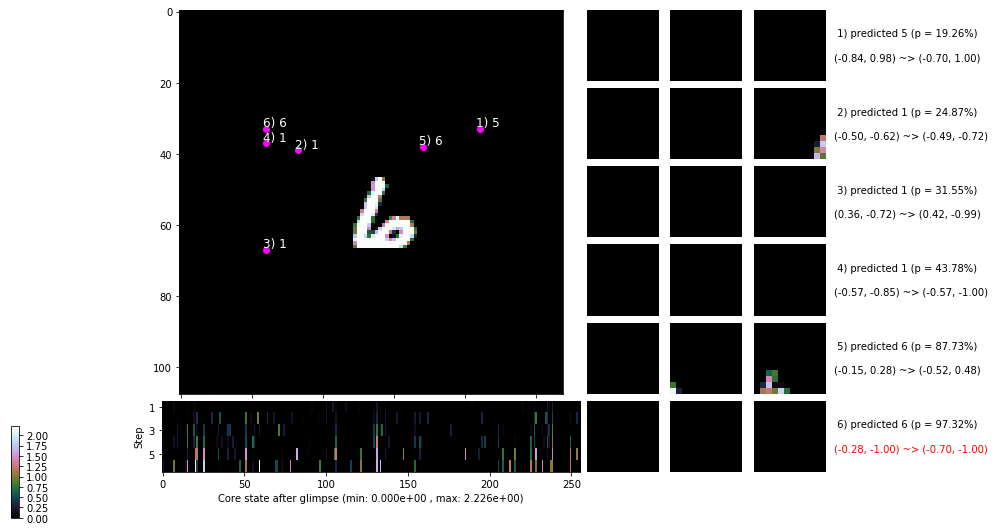

 b   2500/  4000 >> 104.4 ms/b | lr: 8.15e-04 | grad 2norm:  7.39 | grad inf norm:  2.319
       Weights || abs max:  1.35 ( 3227.87) | mean: -2.71e-02 ( 0.03) | var: 2.09e-02 (  402.51)
        Biases || abs max:  0.77 (  187.62) | mean: -7.37e-02 ( 0.46) | var: 8.94e-03 ( 1913.45)
                  class loss: 0.498 | steps: 2.631 | reward:  0.835 | acc.: 83.50%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.4 ms/b | lr: 8.12e-04 | grad 2norm:  7.32 | grad inf norm:  2.236
       Weights || abs max:  1.37 ( 5326.29) | mean: -2.74e-02 ( 0.04) | var: 2.11e-02 ( 1963.04)
        Biases || abs max:  0.78 (  360.71) | mean: -7.44e-02 ( 0.63) | var: 9.22e-03 ( 6243.68)
                  class loss: 0.472 | steps: 2.602 | reward:  0.844 | acc.: 84.37%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

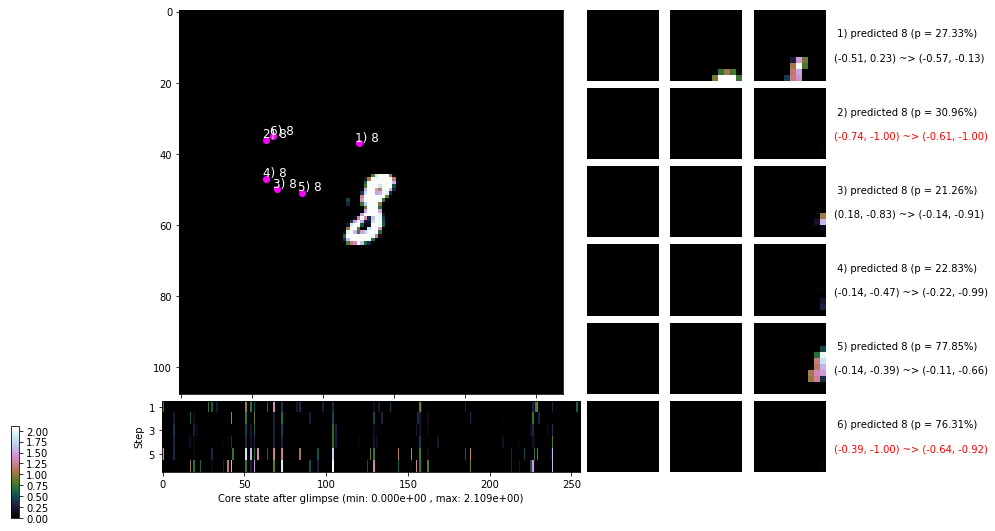

 b   3500/  4000 >> 105.1 ms/b | lr: 8.09e-04 | grad 2norm:  7.62 | grad inf norm:  2.435
       Weights || abs max:  1.39 (11885.55) | mean: -2.75e-02 ( 0.06) | var: 2.14e-02 (94598.63)
        Biases || abs max:  0.79 (  590.24) | mean: -7.47e-02 ( 0.84) | var: 9.33e-03 (76234.34)
                  class loss: 0.441 | steps: 2.525 | reward:  0.857 | acc.: 85.73%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.1 ms/b | lr: 8.06e-04 | grad 2norm:  7.34 | grad inf norm:  2.319
       Weights || abs max:  1.42 ( 2689.89) | mean: -2.76e-02 ( 0.03) | var: 2.16e-02 (  227.35)
        Biases || abs max:  0.80 (  292.84) | mean: -7.52e-02 ( 0.55) | var: 9.52e-03 ( 2616.03)
                  class loss: 0.439 | steps: 2.547 | reward:  0.859 | acc.: 85.95%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

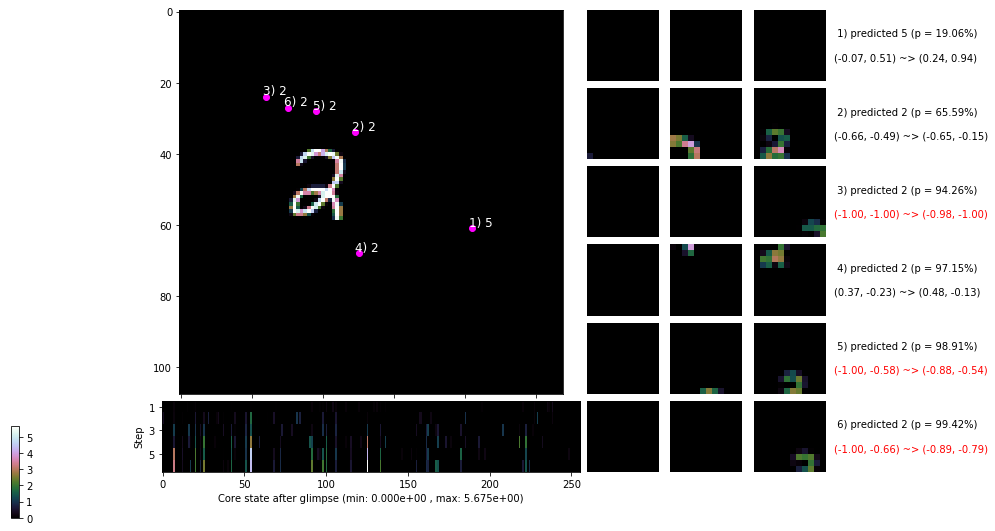

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


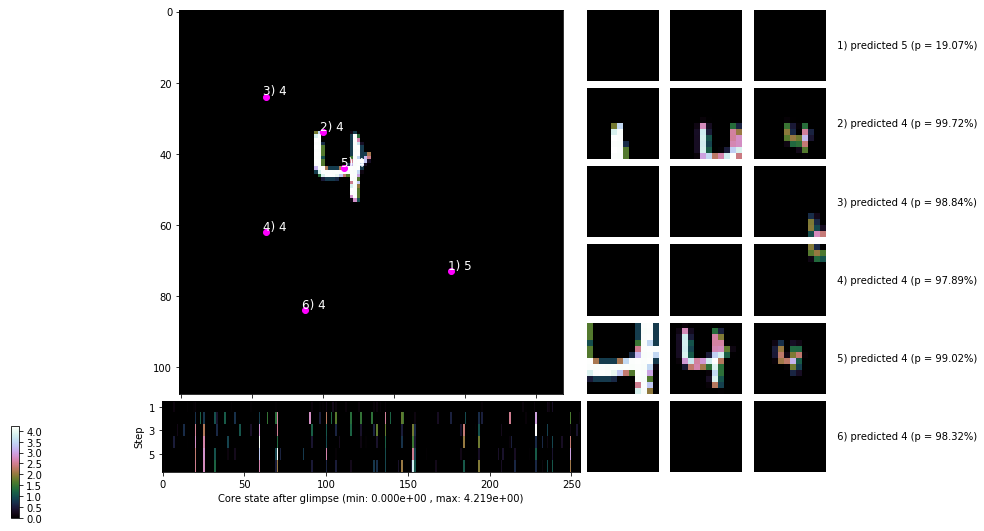


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


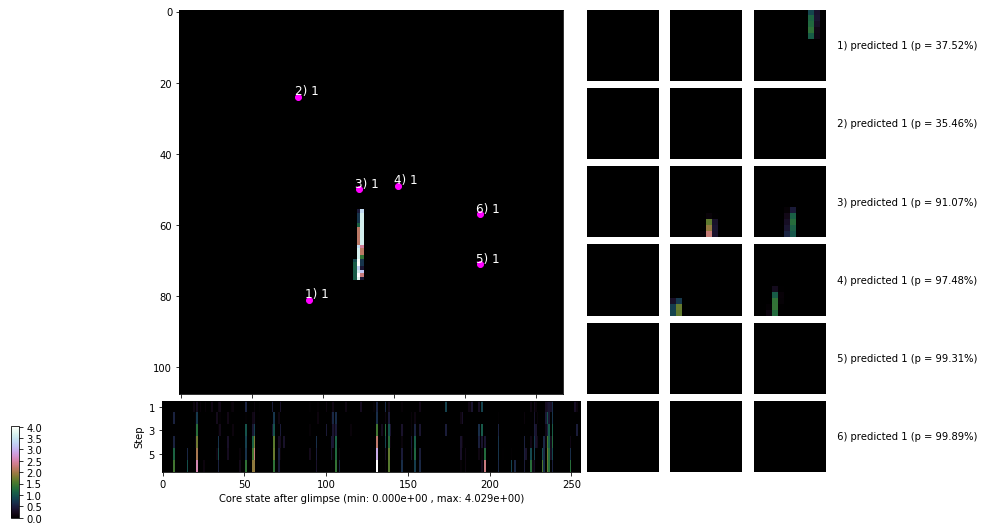

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


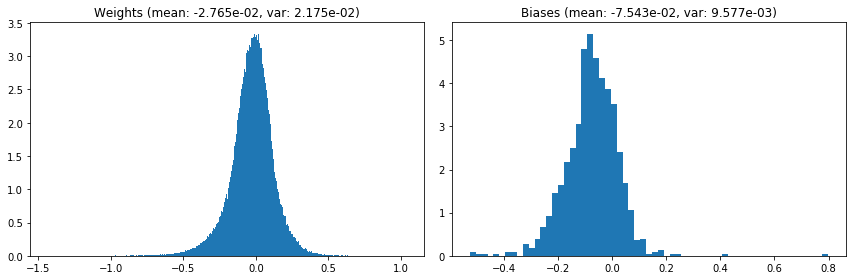

                                      Location network weights and biases


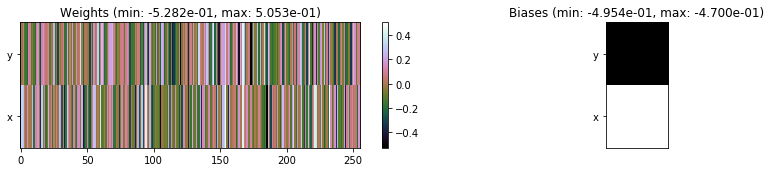

---------------------------------------------------------------------------------------------------------------
Elapsed time:  411.89 sec | TRAIN >> class loss: 0.4580 | steps:  2.547    | reward:  0.8507    | acc.: 85.071% 
                          | VAL   >> class loss: 0.3808 | steps:  2.413    | reward:  0.8716    | acc.: 87.160% 


Epoch   8/400) lr = 0.0008048
 b    500/  4000 >> 103.2 ms/b | lr: 8.02e-04 | grad 2norm:  7.34 | grad inf norm:  2.310
       Weights || abs max:  1.43 ( 5291.23) | mean: -2.78e-02 ( 0.04) | var: 2.19e-02 ( 7387.89)
        Biases || abs max:  0.80 ( 1933.01) | mean: -7.61e-02 ( 2.20) | var: 9.76e-03 (1362055.25)
                  class loss: 0.430 | steps: 2.536 | reward:  0.862 | acc.: 86.17%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.2 ms/b | lr: 7.99e-04 | grad 2norm:  7.25 | grad inf norm:  2.276
       Weights || abs max:  1.43 ( 3506.50) | mean: -2.79e-02 ( 0.03) | v

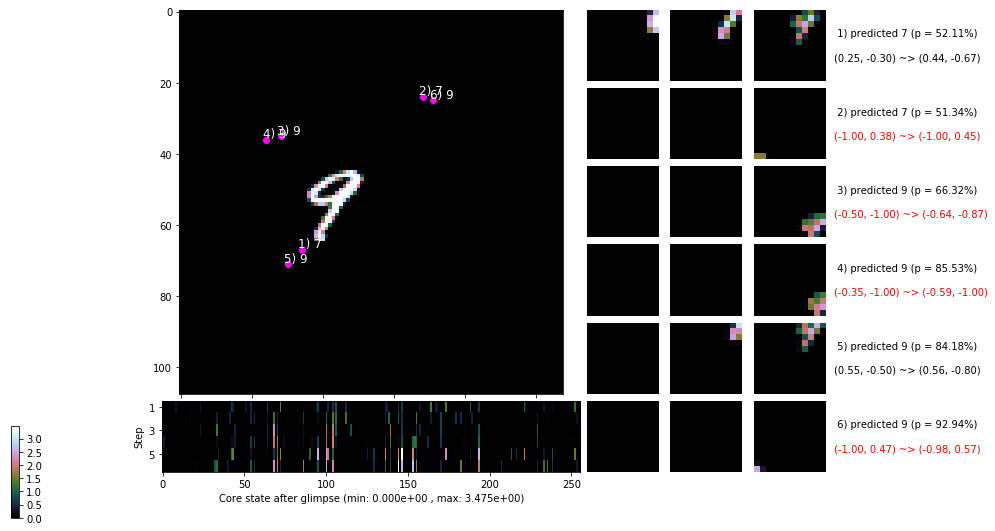

 b   1500/  4000 >> 114.0 ms/b | lr: 7.96e-04 | grad 2norm:  7.27 | grad inf norm:  2.260
       Weights || abs max:  1.45 ( 3893.76) | mean: -2.80e-02 ( 0.03) | var: 2.24e-02 ( 1855.98)
        Biases || abs max:  0.79 (  154.01) | mean: -7.81e-02 ( 0.40) | var: 1.03e-02 (  851.11)
                  class loss: 0.451 | steps: 2.575 | reward:  0.856 | acc.: 85.61%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.9 ms/b | lr: 7.93e-04 | grad 2norm:  7.18 | grad inf norm:  2.250
       Weights || abs max:  1.43 ( 2731.03) | mean: -2.81e-02 ( 0.03) | var: 2.26e-02 (  230.81)
        Biases || abs max:  0.79 (  156.68) | mean: -7.88e-02 ( 0.42) | var: 1.04e-02 (  845.64)
                  class loss: 0.452 | steps: 2.597 | reward:  0.853 | acc.: 85.34%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

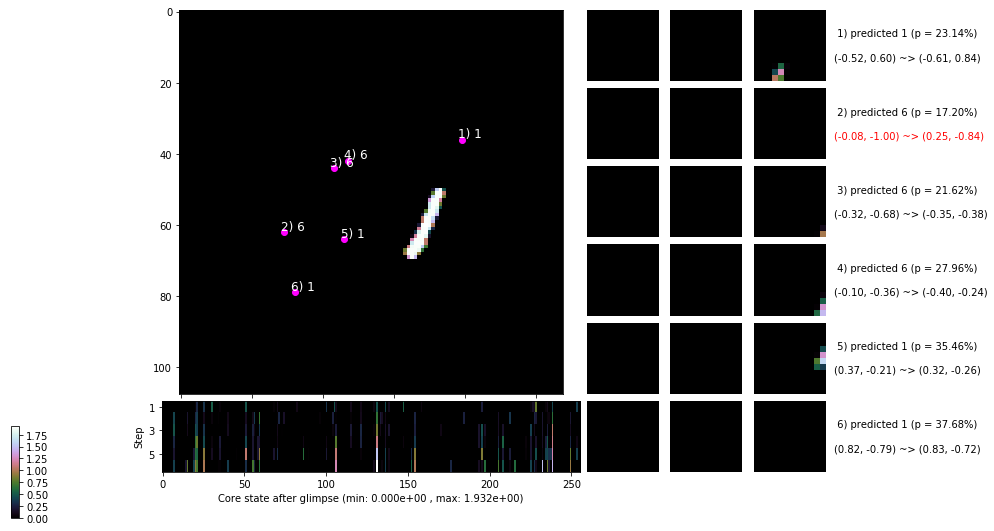

 b   2500/  4000 >> 100.5 ms/b | lr: 7.90e-04 | grad 2norm:  7.36 | grad inf norm:  2.336
       Weights || abs max:  1.45 ( 4340.90) | mean: -2.80e-02 ( 0.04) | var: 2.28e-02 ( 3685.08)
        Biases || abs max:  0.80 (  211.46) | mean: -7.85e-02 ( 0.45) | var: 1.05e-02 (  783.57)
                  class loss: 0.410 | steps: 2.513 | reward:  0.867 | acc.: 86.72%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 97.5 ms/b | lr: 7.87e-04 | grad 2norm:  7.16 | grad inf norm:  2.246
       Weights || abs max:  1.46 ( 5141.13) | mean: -2.82e-02 ( 0.04) | var: 2.31e-02 ( 6716.19)
        Biases || abs max:  0.80 (  178.55) | mean: -7.96e-02 ( 0.47) | var: 1.07e-02 (  645.05)
                  class loss: 0.426 | steps: 2.576 | reward:  0.864 | acc.: 86.43%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


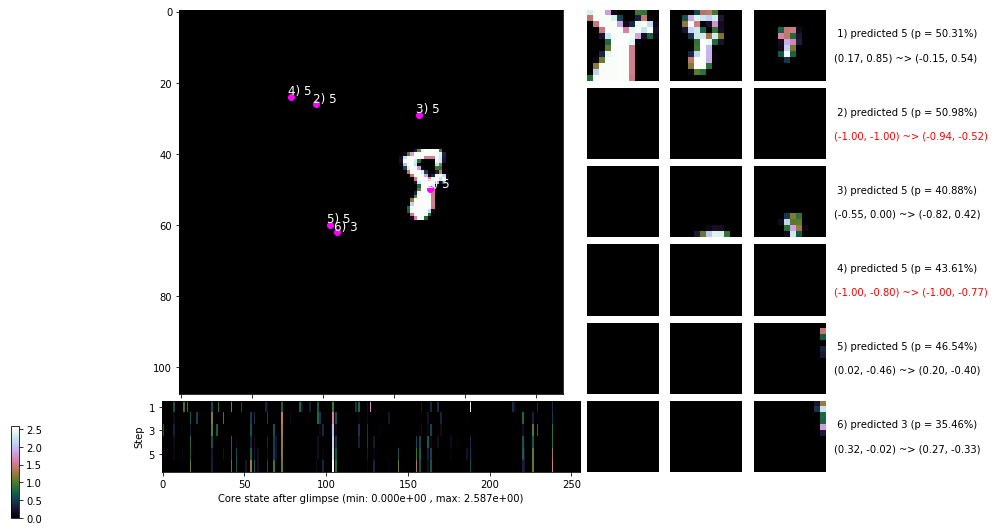

 b   3500/  4000 >> 100.3 ms/b | lr: 7.84e-04 | grad 2norm:  7.16 | grad inf norm:  2.259
       Weights || abs max:  1.46 (24602.46) | mean: -2.83e-02 ( 0.12) | var: 2.33e-02 (256534.88)
        Biases || abs max:  0.81 (  652.03) | mean: -8.07e-02 ( 0.94) | var: 1.09e-02 (62252.99)
                  class loss: 0.406 | steps: 2.481 | reward:  0.871 | acc.: 87.09%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.3 ms/b | lr: 7.81e-04 | grad 2norm:  7.21 | grad inf norm:  2.279
       Weights || abs max:  1.47 ( 4554.32) | mean: -2.85e-02 ( 0.04) | var: 2.35e-02 ( 1963.24)
        Biases || abs max:  0.81 (  195.25) | mean: -8.14e-02 ( 0.47) | var: 1.12e-02 (  908.52)
                  class loss: 0.394 | steps: 2.440 | reward:  0.874 | acc.: 87.45%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

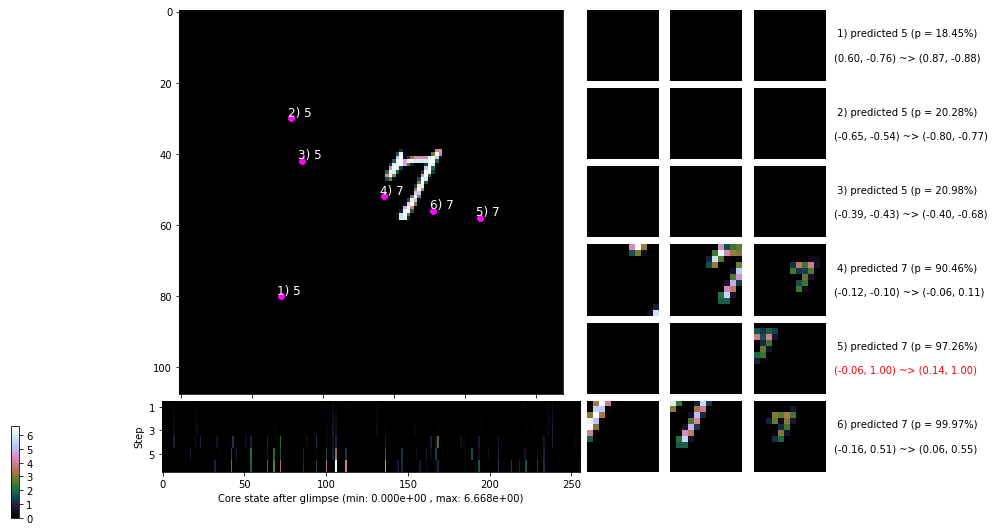

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


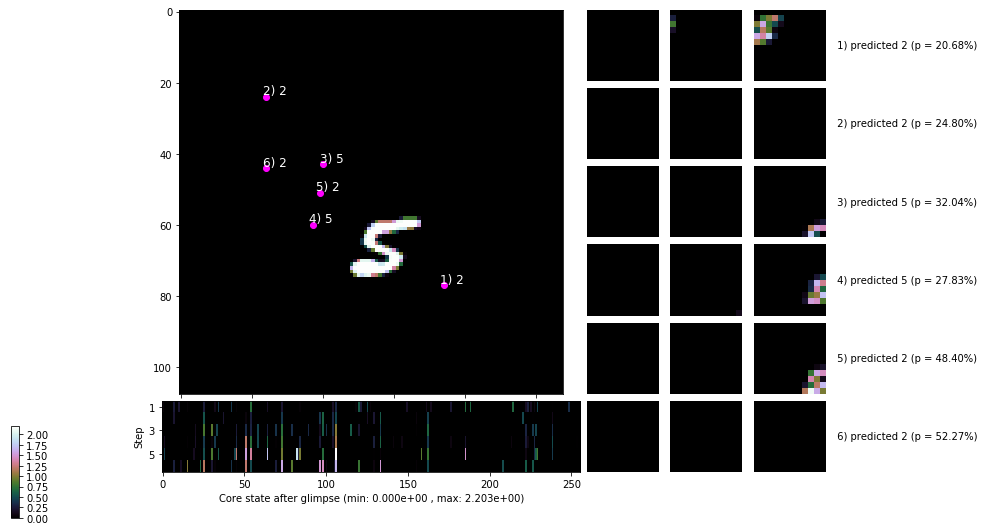


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


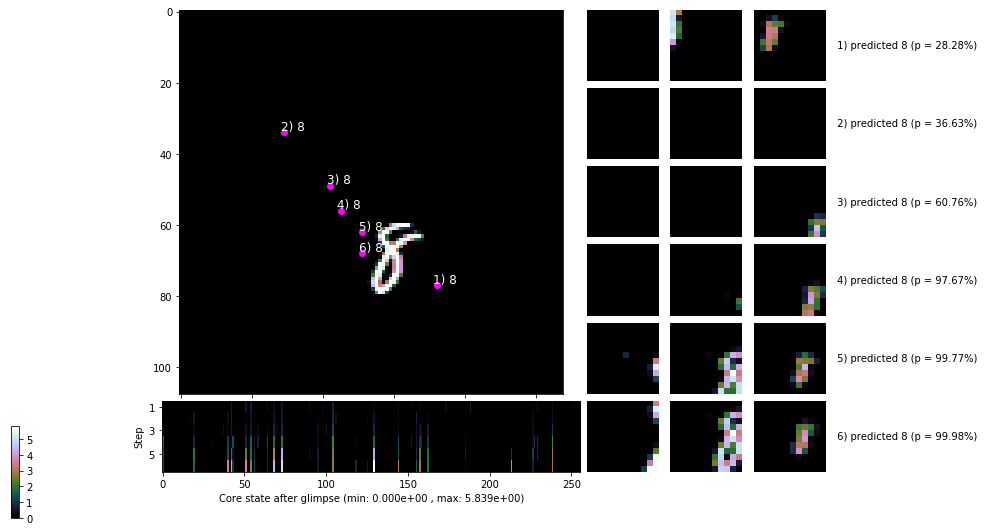

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


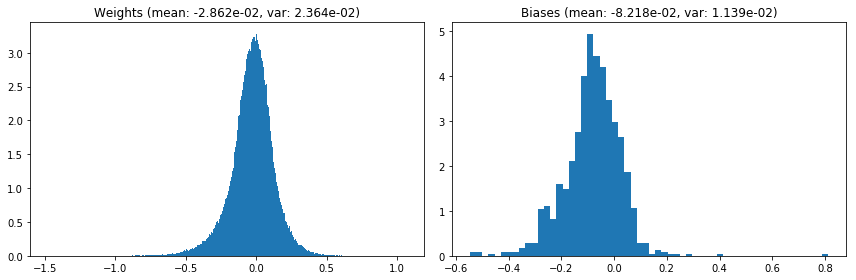

                                      Location network weights and biases


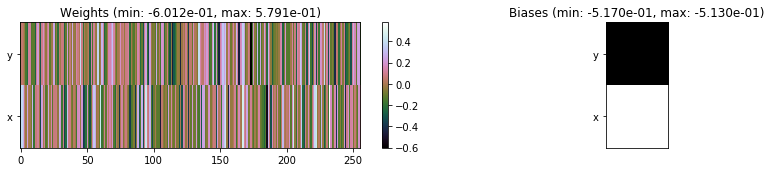

---------------------------------------------------------------------------------------------------------------
Elapsed time:  412.03 sec | TRAIN >> class loss: 0.4238 | steps:  2.529    | reward:  0.8639    | acc.: 86.387% 
                          | VAL   >> class loss: 0.3629 | steps:  2.411    | reward:  0.8820    | acc.: 88.200% 


Epoch   9/400) lr = 0.0007803
 b    500/  4000 >> 108.8 ms/b | lr: 7.78e-04 | grad 2norm:  7.40 | grad inf norm:  2.367
       Weights || abs max:  1.49 ( 2866.72) | mean: -2.87e-02 ( 0.03) | var: 2.37e-02 (  187.95)
        Biases || abs max:  0.81 (  159.19) | mean: -8.23e-02 ( 0.42) | var: 1.15e-02 (  853.52)
                  class loss: 0.388 | steps: 2.424 | reward:  0.876 | acc.: 87.62%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.0 ms/b | lr: 7.75e-04 | grad 2norm:  7.23 | grad inf norm:  2.323
       Weights || abs max:  1.51 ( 3027.33) | mean: -2.87e-02 ( 0.03) | var

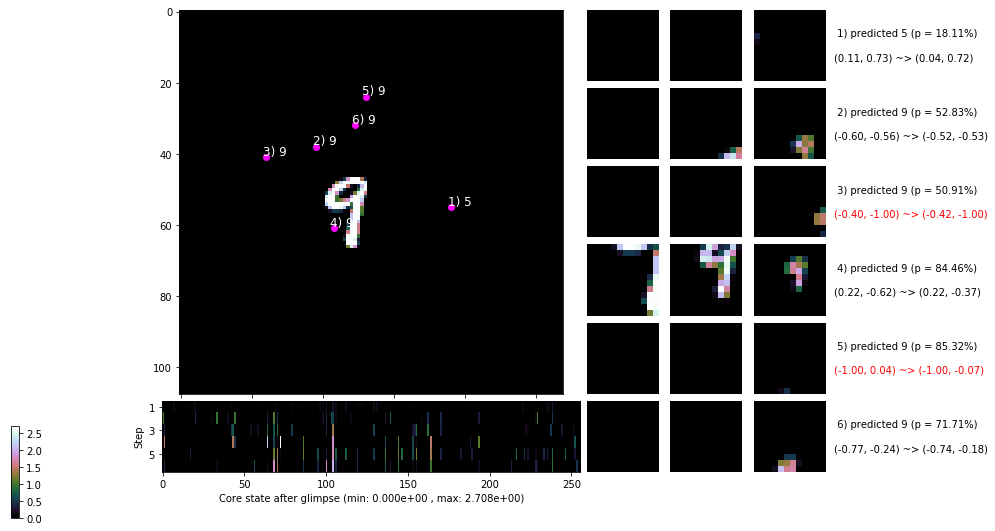

 b   1500/  4000 >> 107.2 ms/b | lr: 7.72e-04 | grad 2norm:  7.33 | grad inf norm:  2.356
       Weights || abs max:  1.53 ( 4095.44) | mean: -2.87e-02 ( 0.04) | var: 2.42e-02 ( 1152.73)
        Biases || abs max:  0.82 (  332.24) | mean: -8.30e-02 ( 0.63) | var: 1.18e-02 (20094.71)
                  class loss: 0.368 | steps: 2.352 | reward:  0.881 | acc.: 88.08%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.2 ms/b | lr: 7.69e-04 | grad 2norm:  6.97 | grad inf norm:  2.223
       Weights || abs max:  1.54 ( 8131.41) | mean: -2.88e-02 ( 0.05) | var: 2.44e-02 (22992.49)
        Biases || abs max:  0.82 (  283.17) | mean: -8.37e-02 ( 0.47) | var: 1.19e-02 (12452.79)
                  class loss: 0.383 | steps: 2.432 | reward:  0.880 | acc.: 88.01%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

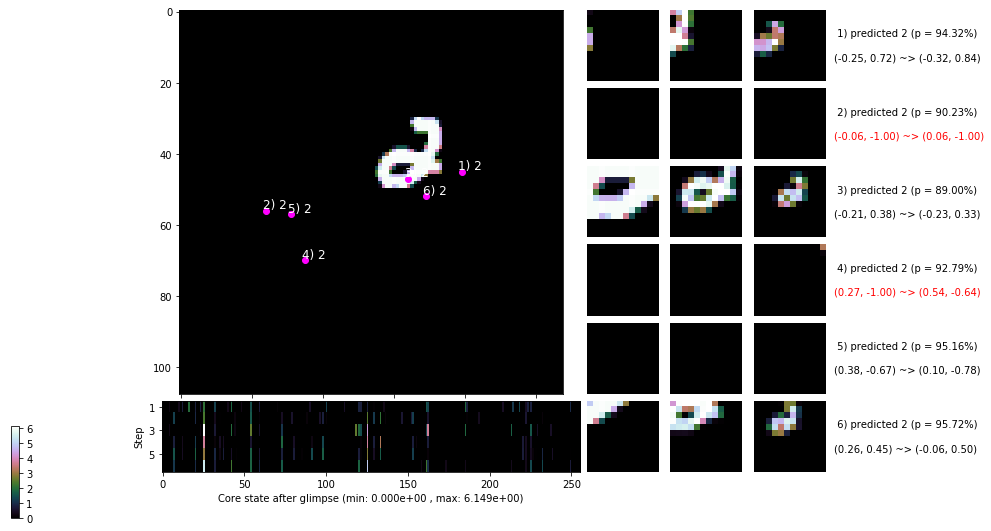

 b   2500/  4000 >> 107.0 ms/b | lr: 7.66e-04 | grad 2norm:  7.08 | grad inf norm:  2.257
       Weights || abs max:  1.57 ( 2644.62) | mean: -2.87e-02 ( 0.03) | var: 2.47e-02 (  217.61)
        Biases || abs max:  0.81 (  113.49) | mean: -8.39e-02 ( 0.28) | var: 1.20e-02 (  266.54)
                  class loss: 0.425 | steps: 2.552 | reward:  0.863 | acc.: 86.27%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 121.1 ms/b | lr: 7.63e-04 | grad 2norm:  7.21 | grad inf norm:  2.334
       Weights || abs max:  1.60 ( 3650.29) | mean: -2.87e-02 ( 0.03) | var: 2.49e-02 ( 1670.15)
        Biases || abs max:  0.80 (  145.29) | mean: -8.46e-02 ( 0.34) | var: 1.22e-02 (  549.85)
                  class loss: 0.411 | steps: 2.532 | reward:  0.864 | acc.: 86.42%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

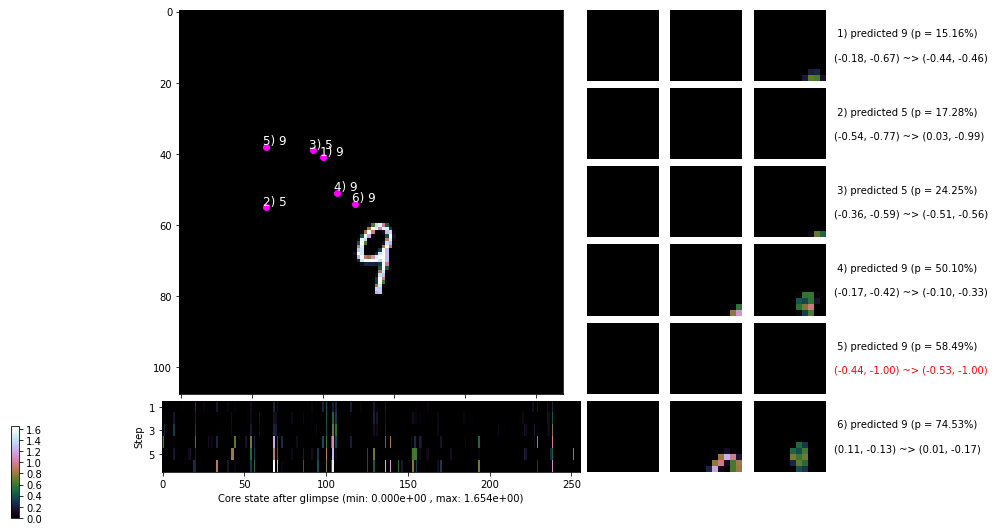

 b   3500/  4000 >> 107.3 ms/b | lr: 7.60e-04 | grad 2norm:  7.38 | grad inf norm:  2.381
       Weights || abs max:  1.63 ( 3999.38) | mean: -2.89e-02 ( 0.04) | var: 2.51e-02 ( 1577.82)
        Biases || abs max:  0.80 (   97.75) | mean: -8.56e-02 ( 0.26) | var: 1.25e-02 (  122.64)
                  class loss: 0.401 | steps: 2.479 | reward:  0.875 | acc.: 87.55%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.5 ms/b | lr: 7.57e-04 | grad 2norm:  7.21 | grad inf norm:  2.321
       Weights || abs max:  1.64 ( 3495.52) | mean: -2.91e-02 ( 0.03) | var: 2.53e-02 (  650.15)
        Biases || abs max:  0.81 (  169.12) | mean: -8.69e-02 ( 0.39) | var: 1.28e-02 ( 1022.94)
                  class loss: 0.386 | steps: 2.481 | reward:  0.877 | acc.: 87.68%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

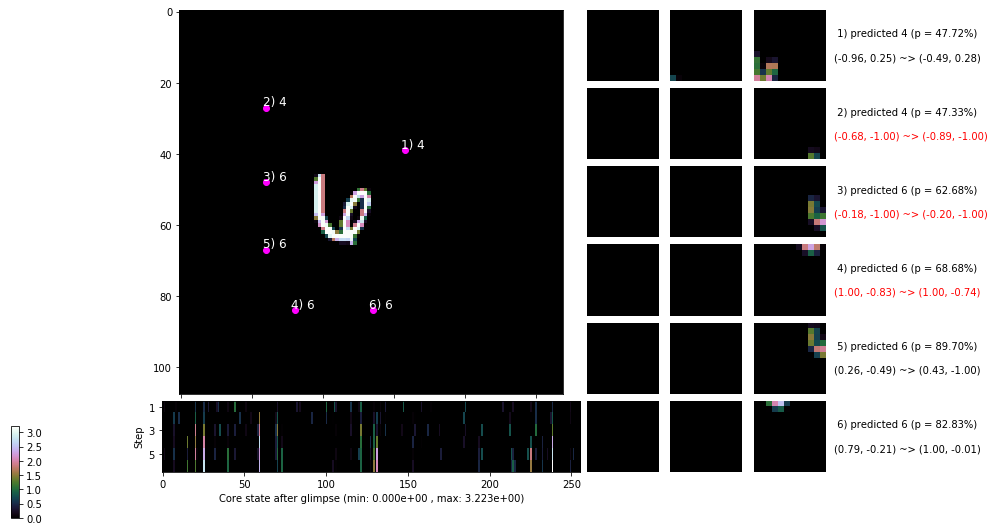

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


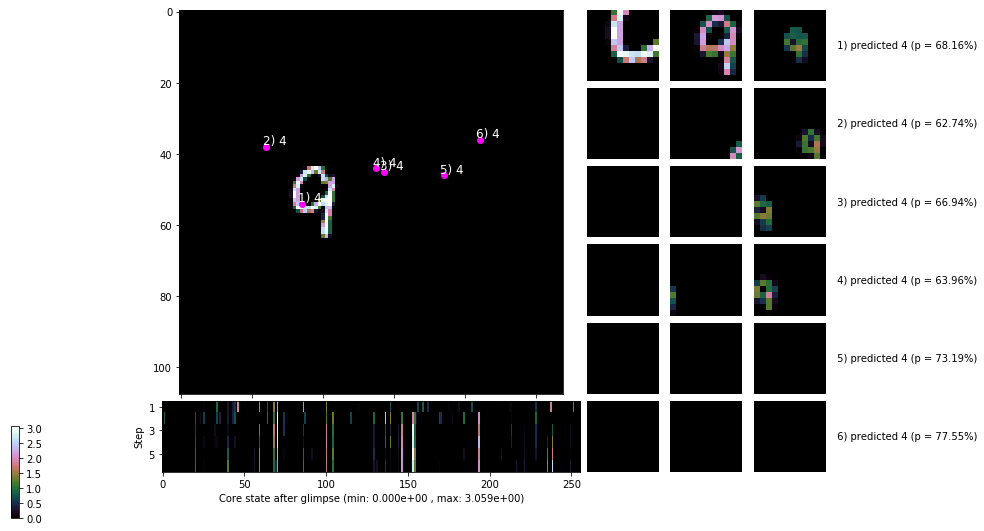


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


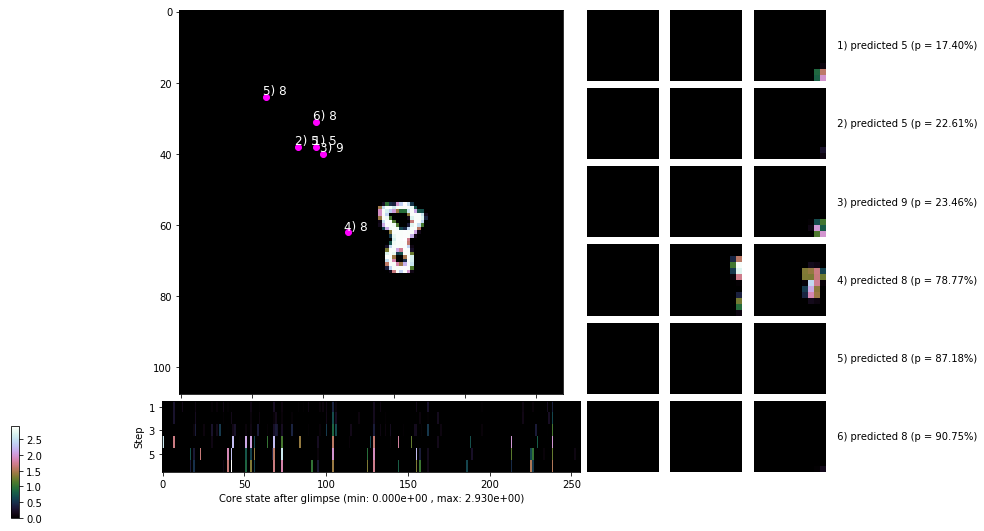

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


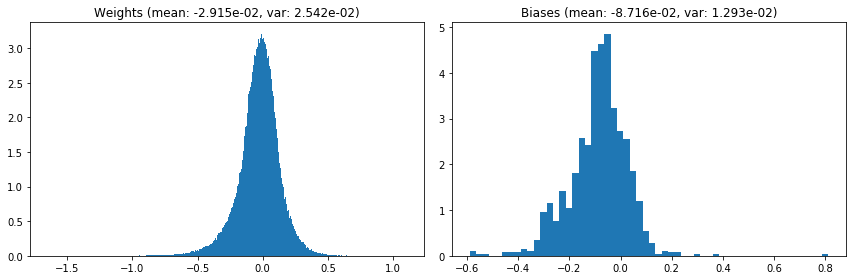

                                      Location network weights and biases


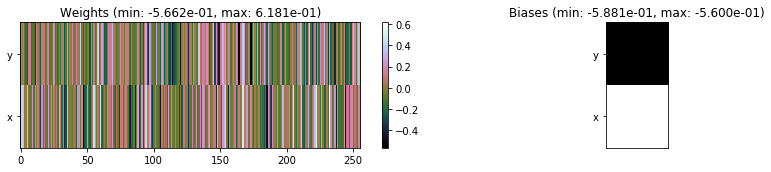

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.08 sec | TRAIN >> class loss: 0.3930 | steps:  2.456    | reward:  0.8745    | acc.: 87.447% 
                          | VAL   >> class loss: 0.3800 | steps:  2.477 :( | reward:  0.8774 :( | acc.: 87.740% :(


Epoch  10/400) lr = 0.0007564
 b    500/  4000 >> 99.2 ms/b | lr: 7.54e-04 | grad 2norm:  7.27 | grad inf norm:  2.385
       Weights || abs max:  1.66 ( 3616.71) | mean: -2.91e-02 ( 0.03) | var: 2.55e-02 (  655.92)
        Biases || abs max:  0.81 (  140.62) | mean: -8.72e-02 ( 0.31) | var: 1.30e-02 (  880.95)
                  class loss: 0.401 | steps: 2.502 | reward:  0.872 | acc.: 87.21%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 98.7 ms/b | lr: 7.51e-04 | grad 2norm:  7.18 | grad inf norm:  2.312
       Weights || abs max:  1.67 ( 2591.84) | mean: -2.91e-02 ( 0.03) | var

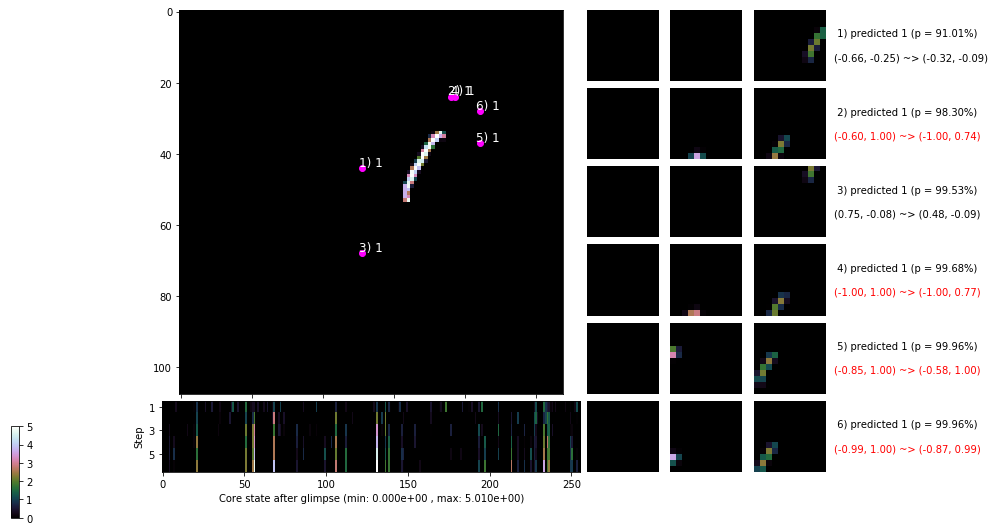

 b   1500/  4000 >> 100.8 ms/b | lr: 7.48e-04 | grad 2norm:  7.17 | grad inf norm:  2.322
       Weights || abs max:  1.70 ( 7361.52) | mean: -2.93e-02 ( 0.05) | var: 2.60e-02 (14028.35)
        Biases || abs max:  0.81 (  200.44) | mean: -8.85e-02 ( 0.37) | var: 1.35e-02 ( 1959.05)
                  class loss: 0.367 | steps: 2.381 | reward:  0.883 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 98.6 ms/b | lr: 7.45e-04 | grad 2norm:  7.13 | grad inf norm:  2.328
       Weights || abs max:  1.71 (10879.35) | mean: -2.94e-02 ( 0.06) | var: 2.62e-02 (49764.90)
        Biases || abs max:  0.82 (  100.79) | mean: -8.93e-02 ( 0.29) | var: 1.38e-02 (  350.60)
                  class loss: 0.370 | steps: 2.382 | reward:  0.885 | acc.: 88.50%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


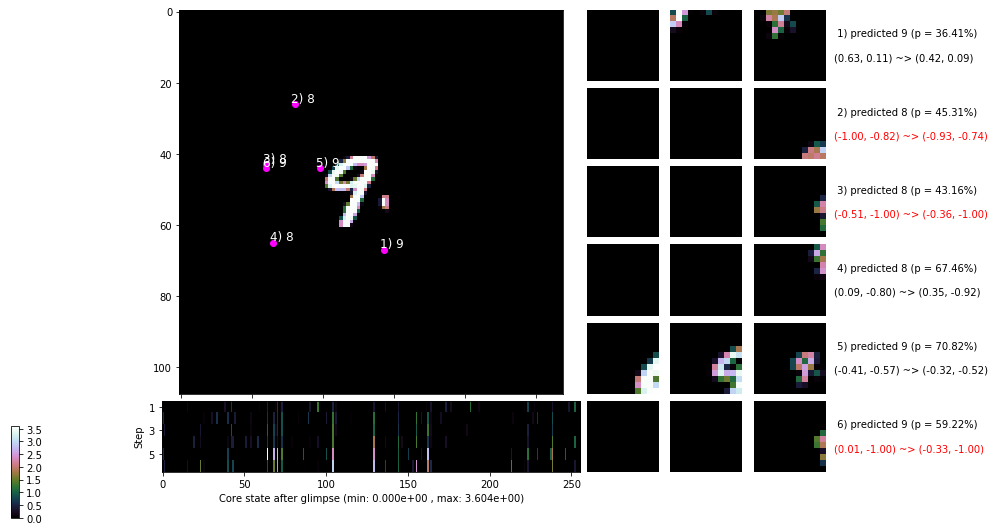

 b   2500/  4000 >> 99.9 ms/b | lr: 7.43e-04 | grad 2norm:  7.21 | grad inf norm:  2.362
       Weights || abs max:  1.72 ( 7885.70) | mean: -2.94e-02 ( 0.05) | var: 2.64e-02 (27955.79)
        Biases || abs max:  0.82 (  230.84) | mean: -8.99e-02 ( 0.47) | var: 1.41e-02 ( 3375.69)
                  class loss: 0.369 | steps: 2.390 | reward:  0.885 | acc.: 88.54%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 98.2 ms/b | lr: 7.40e-04 | grad 2norm:  7.18 | grad inf norm:  2.309
       Weights || abs max:  1.73 ( 7531.61) | mean: -2.95e-02 ( 0.05) | var: 2.66e-02 (15599.72)
        Biases || abs max:  0.82 (  207.51) | mean: -9.12e-02 ( 0.42) | var: 1.43e-02 ( 1443.92)
                  class loss: 0.383 | steps: 2.451 | reward:  0.879 | acc.: 87.90%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
	

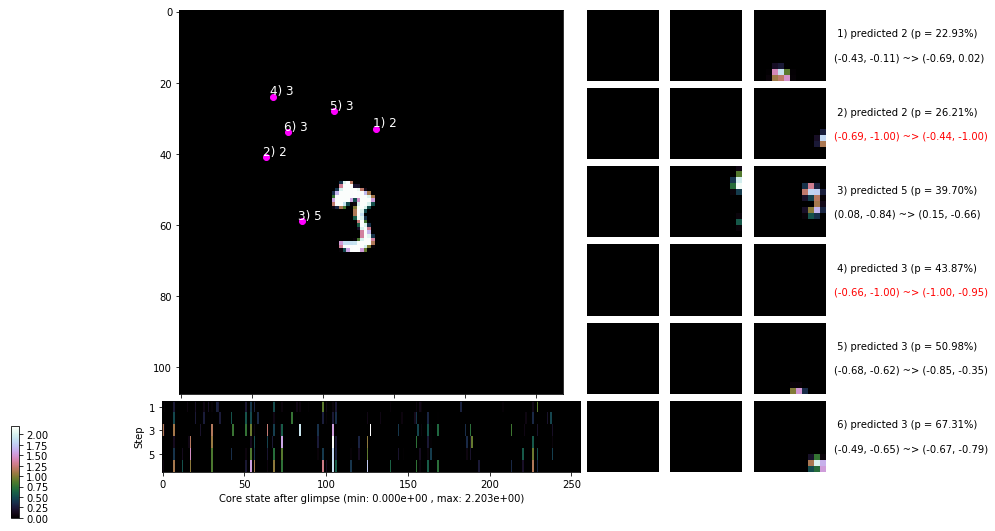

 b   3500/  4000 >> 101.0 ms/b | lr: 7.37e-04 | grad 2norm:  7.41 | grad inf norm:  2.434
       Weights || abs max:  1.75 ( 7424.71) | mean: -2.96e-02 ( 0.05) | var: 2.68e-02 ( 8961.67)
        Biases || abs max:  0.81 (  136.14) | mean: -9.18e-02 ( 0.30) | var: 1.44e-02 (  210.28)
                  class loss: 0.376 | steps: 2.386 | reward:  0.878 | acc.: 87.76%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 98.6 ms/b | lr: 7.34e-04 | grad 2norm:  7.23 | grad inf norm:  2.371
       Weights || abs max:  1.75 ( 3862.87) | mean: -2.97e-02 ( 0.03) | var: 2.70e-02 (  541.11)
        Biases || abs max:  0.82 (  229.83) | mean: -9.23e-02 ( 0.42) | var: 1.46e-02 ( 2076.77)
                  class loss: 0.361 | steps: 2.322 | reward:  0.886 | acc.: 88.61%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


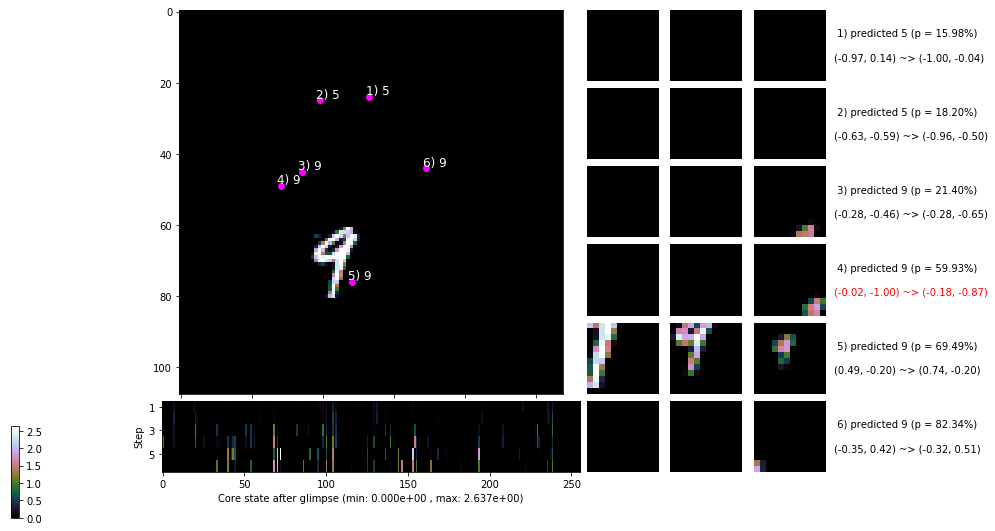

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


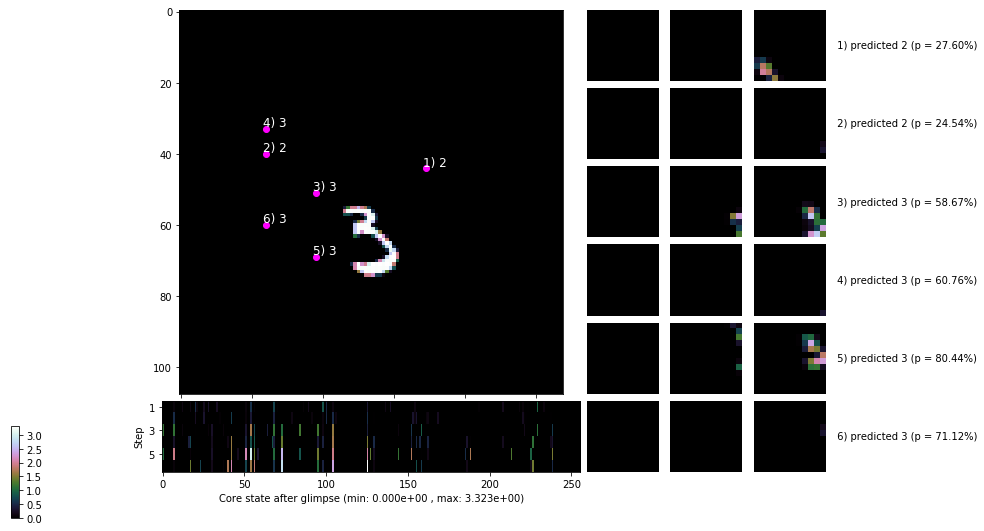


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


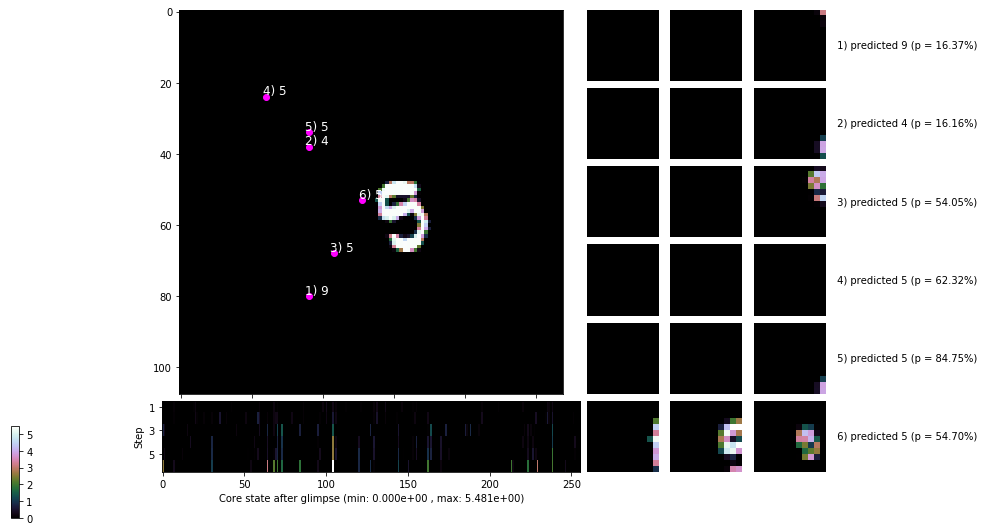

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


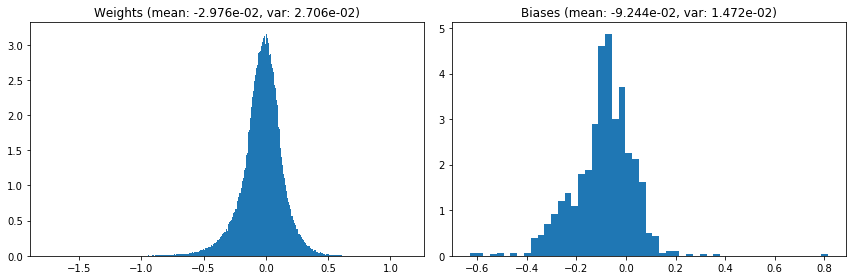

                                      Location network weights and biases


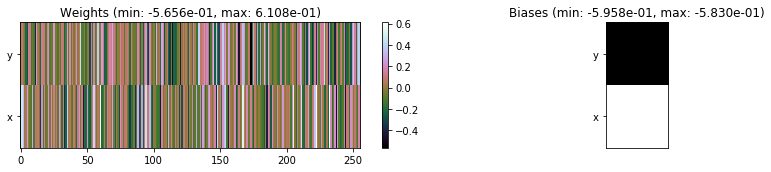

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.46 sec | TRAIN >> class loss: 0.3790 | steps:  2.410    | reward:  0.8801    | acc.: 88.008% 
                          | VAL   >> class loss: 0.3098 | steps:  2.263    | reward:  0.9000    | acc.: 90.000% 


Epoch  11/400) lr = 0.0007333
 b    500/  4000 >> 105.5 ms/b | lr: 7.31e-04 | grad 2norm:  7.03 | grad inf norm:  2.336
       Weights || abs max:  1.77 ( 3585.38) | mean: -2.98e-02 ( 0.03) | var: 2.72e-02 ( 1993.75)
        Biases || abs max:  0.82 (  405.01) | mean: -9.28e-02 ( 0.66) | var: 1.48e-02 ( 6943.38)
                  class loss: 0.353 | steps: 2.330 | reward:  0.889 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 99.0 ms/b | lr: 7.28e-04 | grad 2norm:  7.14 | grad inf norm:  2.410
       Weights || abs max:  1.78 ( 3357.09) | mean: -2.99e-02 ( 0.03) | var:

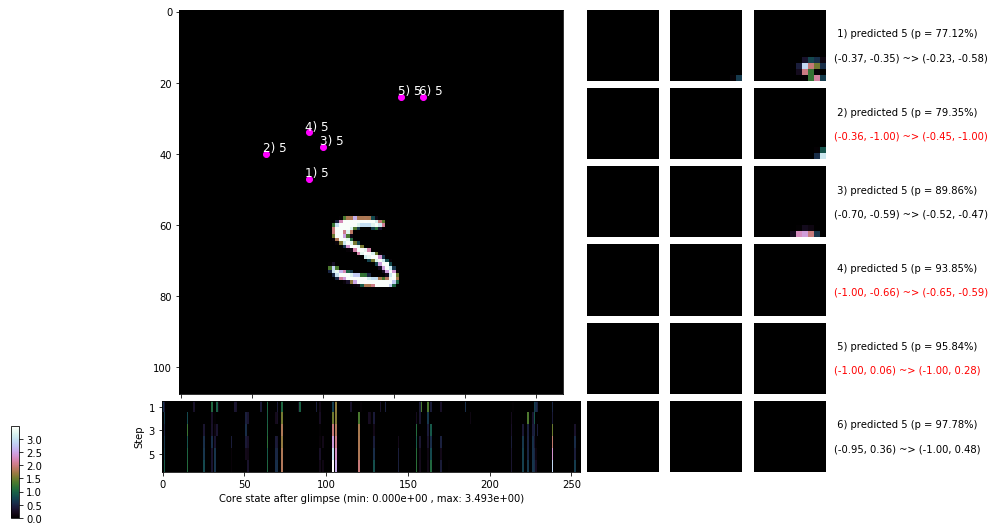

 b   1500/  4000 >> 100.1 ms/b | lr: 7.25e-04 | grad 2norm:  7.30 | grad inf norm:  2.402
       Weights || abs max:  1.80 ( 6223.41) | mean: -2.99e-02 ( 0.04) | var: 2.75e-02 (14454.09)
        Biases || abs max:  0.82 (  169.88) | mean: -9.43e-02 ( 0.40) | var: 1.52e-02 (  520.55)
                  class loss: 0.387 | steps: 2.385 | reward:  0.878 | acc.: 87.81%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 98.1 ms/b | lr: 7.22e-04 | grad 2norm:  7.10 | grad inf norm:  2.378
       Weights || abs max:  1.80 (10357.48) | mean: -3.00e-02 ( 0.06) | var: 2.77e-02 (54151.25)
        Biases || abs max:  0.82 (  639.85) | mean: -9.54e-02 ( 0.80) | var: 1.54e-02 (83318.14)
                  class loss: 0.379 | steps: 2.425 | reward:  0.879 | acc.: 87.95%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


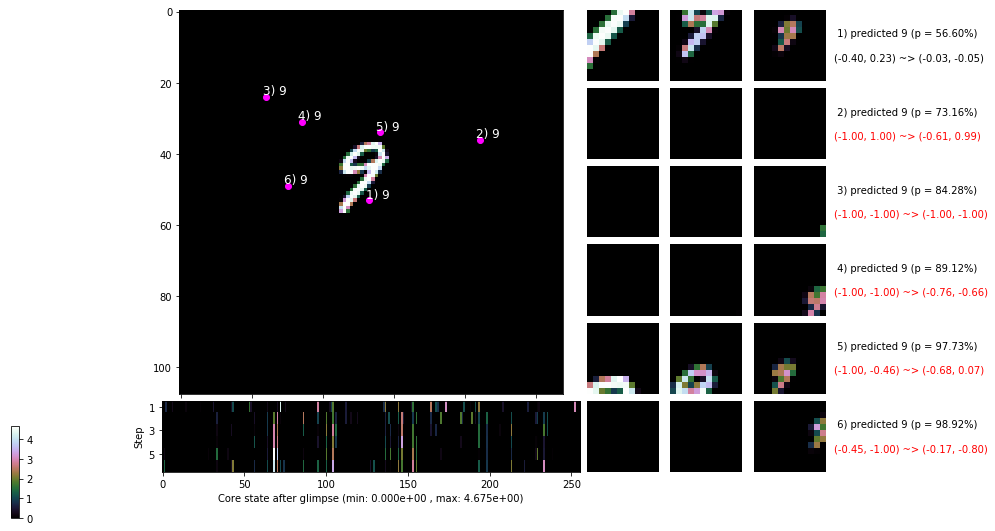

 b   2500/  4000 >> 100.0 ms/b | lr: 7.20e-04 | grad 2norm:  7.11 | grad inf norm:  2.378
       Weights || abs max:  1.82 ( 3555.81) | mean: -2.99e-02 ( 0.03) | var: 2.79e-02 ( 1154.45)
        Biases || abs max:  0.82 (  139.00) | mean: -9.56e-02 ( 0.32) | var: 1.55e-02 (  276.31)
                  class loss: 0.356 | steps: 2.381 | reward:  0.889 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 98.3 ms/b | lr: 7.17e-04 | grad 2norm:  6.97 | grad inf norm:  2.309
       Weights || abs max:  1.84 (50202.88) | mean: -2.98e-02 ( 0.22) | var: 2.82e-02 (4249383.50)
        Biases || abs max:  0.82 (  147.99) | mean: -9.62e-02 ( 0.35) | var: 1.57e-02 (  570.53)
                  class loss: 0.358 | steps: 2.452 | reward:  0.884 | acc.: 88.42%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

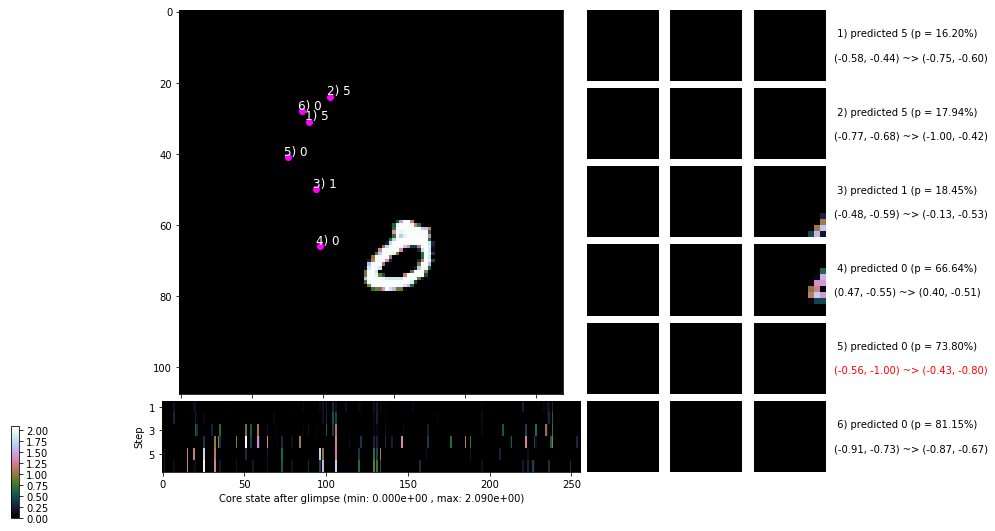

 b   3500/  4000 >> 100.2 ms/b | lr: 7.15e-04 | grad 2norm:  7.08 | grad inf norm:  2.372
       Weights || abs max:  1.82 ( 2261.19) | mean: -2.98e-02 ( 0.03) | var: 2.84e-02 (  136.29)
        Biases || abs max:  0.82 (  232.86) | mean: -9.70e-02 ( 0.46) | var: 1.59e-02 ( 2876.27)
                  class loss: 0.387 | steps: 2.506 | reward:  0.877 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 99.5 ms/b | lr: 7.12e-04 | grad 2norm:  7.31 | grad inf norm:  2.480
       Weights || abs max:  1.83 ( 5096.92) | mean: -2.98e-02 ( 0.04) | var: 2.86e-02 ( 3784.90)
        Biases || abs max:  0.82 (  404.55) | mean: -9.75e-02 ( 0.58) | var: 1.61e-02 (29997.81)
                  class loss: 0.371 | steps: 2.484 | reward:  0.881 | acc.: 88.11%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


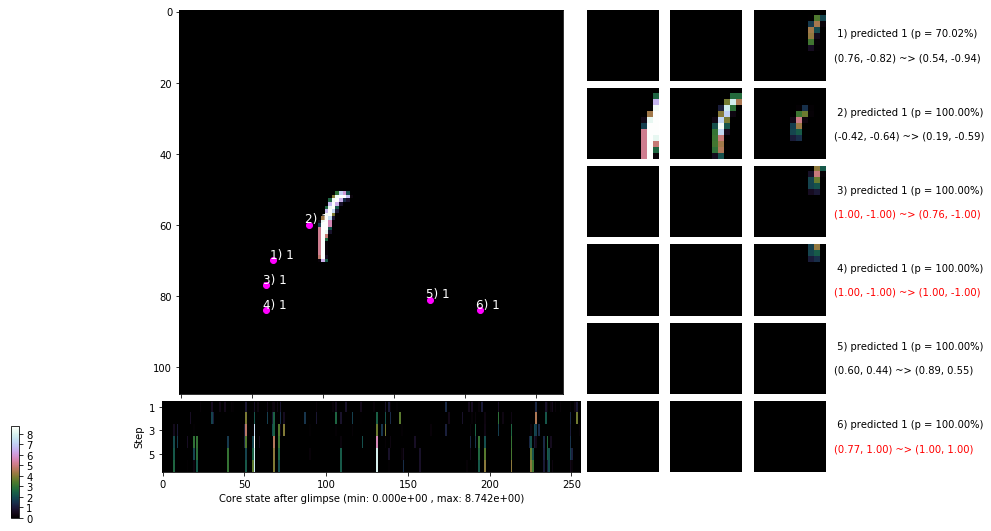

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


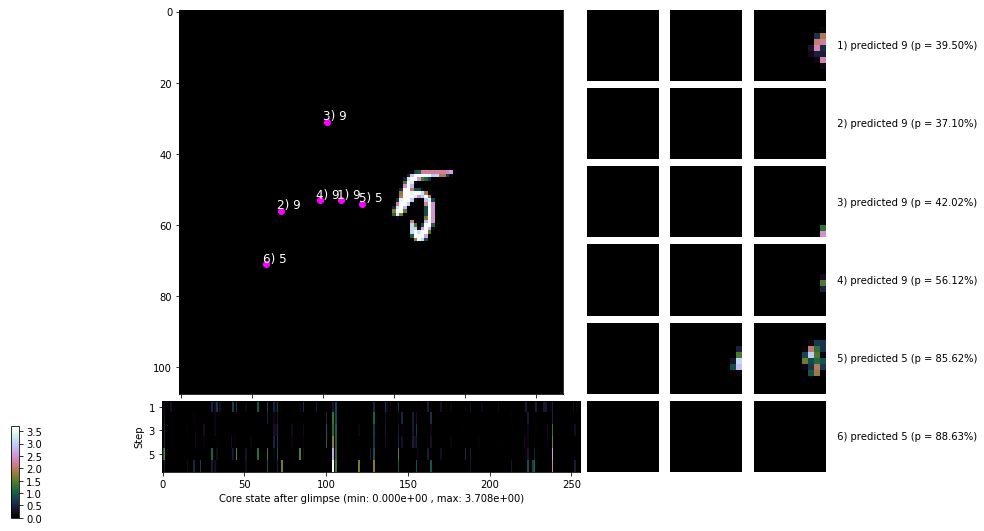


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


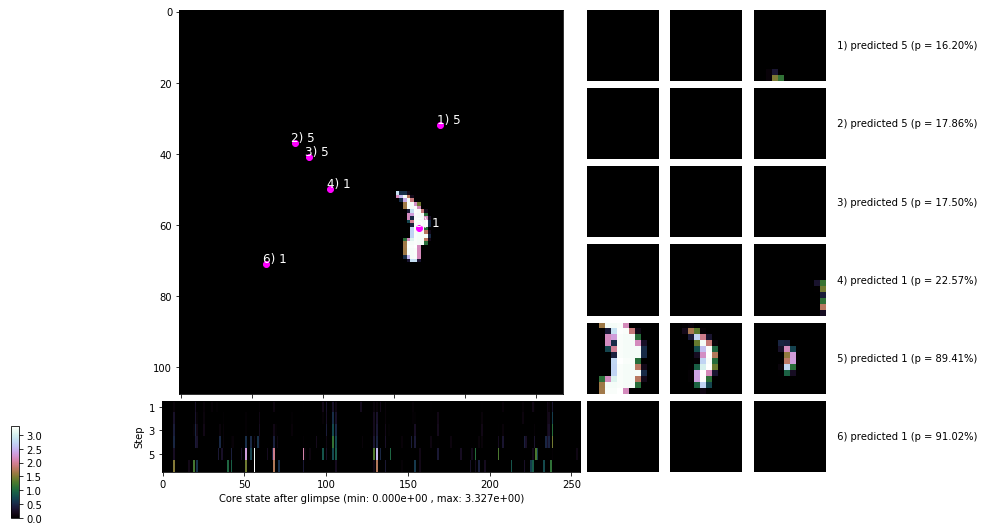

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


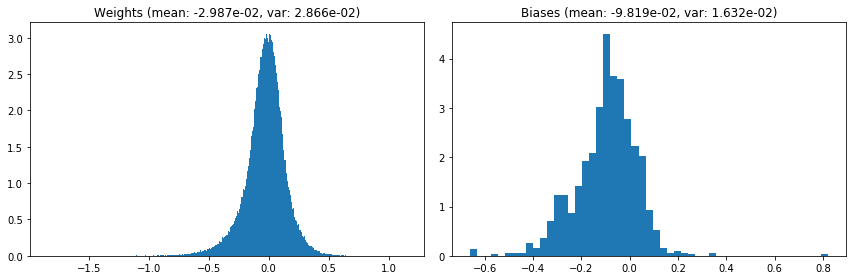

                                      Location network weights and biases


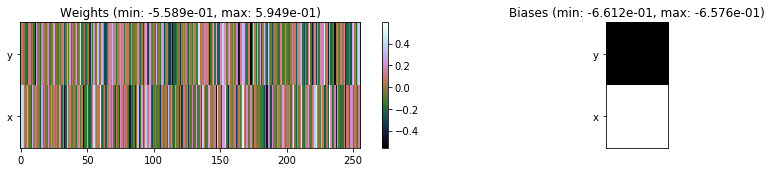

---------------------------------------------------------------------------------------------------------------
Elapsed time:  401.41 sec | TRAIN >> class loss: 0.3680 | steps:  2.412 :( | reward:  0.8833    | acc.: 88.326% 
                          | VAL   >> class loss: 0.3106 | steps:  2.387 :( | reward:  0.8992 :( | acc.: 89.920% :(


Epoch  12/400) lr = 0.0007109
 b    500/  4000 >> 98.5 ms/b | lr: 7.09e-04 | grad 2norm:  7.13 | grad inf norm:  2.433
       Weights || abs max:  1.86 ( 7361.18) | mean: -2.98e-02 ( 0.05) | var: 2.88e-02 (15962.13)
        Biases || abs max:  0.82 (  981.61) | mean: -9.86e-02 ( 1.11) | var: 1.64e-02 (269124.94)
                  class loss: 0.369 | steps: 2.488 | reward:  0.881 | acc.: 88.09%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 98.7 ms/b | lr: 7.06e-04 | grad 2norm:  6.99 | grad inf norm:  2.381
       Weights || abs max:  1.87 ( 3207.54) | mean: -2.99e-02 ( 0.03) | va

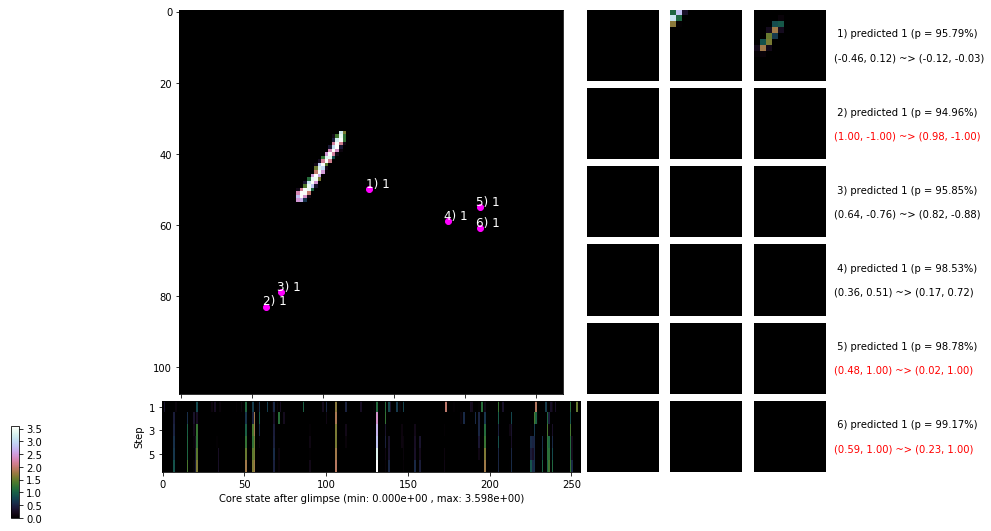

 b   1500/  4000 >> 99.7 ms/b | lr: 7.03e-04 | grad 2norm:  7.23 | grad inf norm:  2.466
       Weights || abs max:  1.87 ( 3574.73) | mean: -2.98e-02 ( 0.03) | var: 2.92e-02 (  518.85)
        Biases || abs max:  0.82 (  143.93) | mean: -1.00e-01 ( 0.33) | var: 1.69e-02 (  324.65)
                  class loss: 0.367 | steps: 2.445 | reward:  0.881 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 98.4 ms/b | lr: 7.00e-04 | grad 2norm:  7.01 | grad inf norm:  2.447
       Weights || abs max:  1.89 ( 5848.31) | mean: -2.99e-02 ( 0.04) | var: 2.93e-02 (10845.13)
        Biases || abs max:  0.83 (  310.77) | mean: -1.00e-01 ( 0.48) | var: 1.70e-02 (12656.45)
                  class loss: 0.346 | steps: 2.428 | reward:  0.892 | acc.: 89.19%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
	

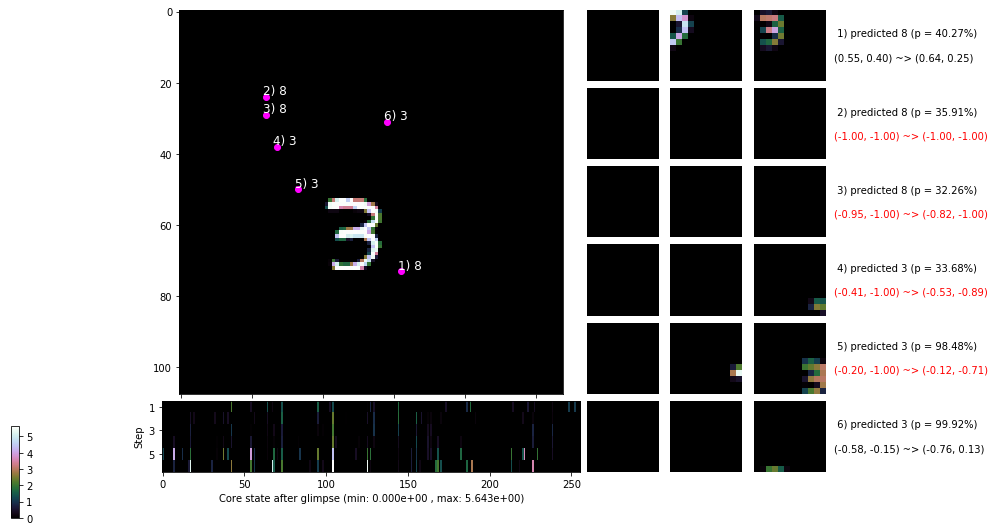

 b   2500/  4000 >> 108.5 ms/b | lr: 6.98e-04 | grad 2norm:  7.00 | grad inf norm:  2.396
       Weights || abs max:  1.92 (10119.33) | mean: -3.00e-02 ( 0.06) | var: 2.95e-02 (37264.93)
        Biases || abs max:  0.83 (  131.11) | mean: -1.01e-01 ( 0.29) | var: 1.73e-02 (  251.03)
                  class loss: 0.362 | steps: 2.458 | reward:  0.887 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.8 ms/b | lr: 6.95e-04 | grad 2norm:  7.00 | grad inf norm:  2.426
       Weights || abs max:  1.94 ( 3359.59) | mean: -3.00e-02 ( 0.03) | var: 2.97e-02 ( 1298.52)
        Biases || abs max:  0.82 (  137.04) | mean: -1.01e-01 ( 0.30) | var: 1.73e-02 (  381.14)
                  class loss: 0.352 | steps: 2.462 | reward:  0.887 | acc.: 88.66%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

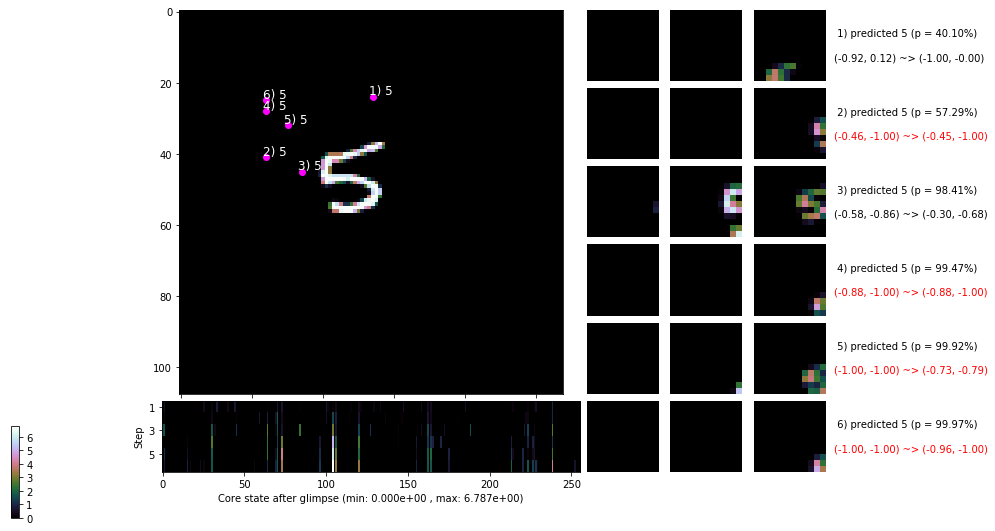

 b   3500/  4000 >> 102.2 ms/b | lr: 6.93e-04 | grad 2norm:  7.15 | grad inf norm:  2.521
       Weights || abs max:  1.96 ( 5614.16) | mean: -3.00e-02 ( 0.04) | var: 2.99e-02 ( 5597.32)
        Biases || abs max:  0.83 (  308.12) | mean: -1.02e-01 ( 0.54) | var: 1.75e-02 ( 5565.94)
                  class loss: 0.347 | steps: 2.415 | reward:  0.890 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.5 ms/b | lr: 6.90e-04 | grad 2norm:  7.01 | grad inf norm:  2.431
       Weights || abs max:  1.96 ( 3124.60) | mean: -3.01e-02 ( 0.03) | var: 3.01e-02 (  452.29)
        Biases || abs max:  0.83 (  166.44) | mean: -1.03e-01 ( 0.33) | var: 1.78e-02 (  843.40)
                  class loss: 0.330 | steps: 2.390 | reward:  0.895 | acc.: 89.51%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

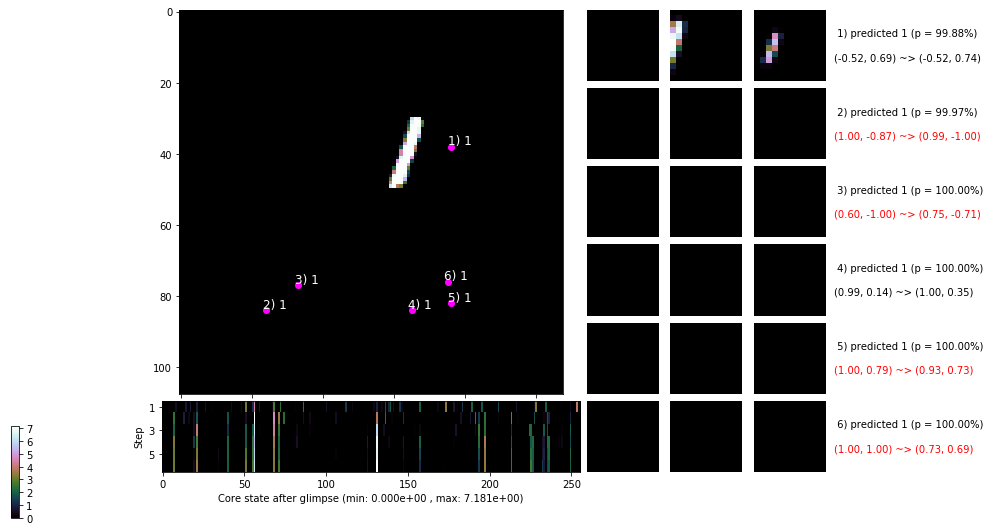

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


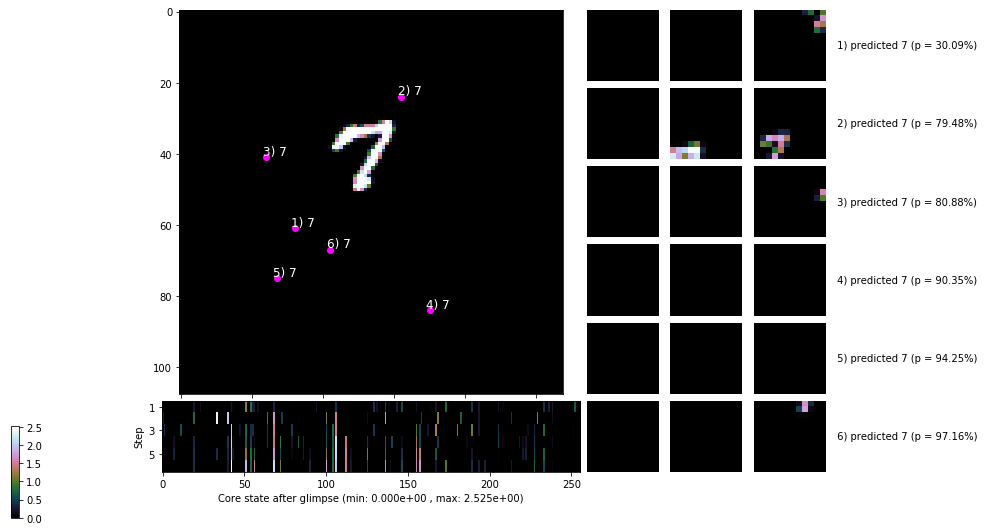


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


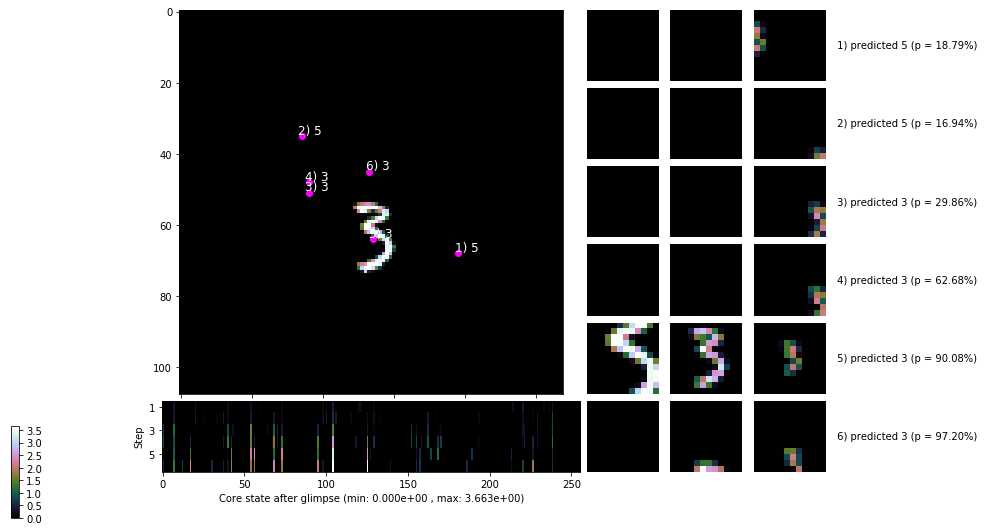

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


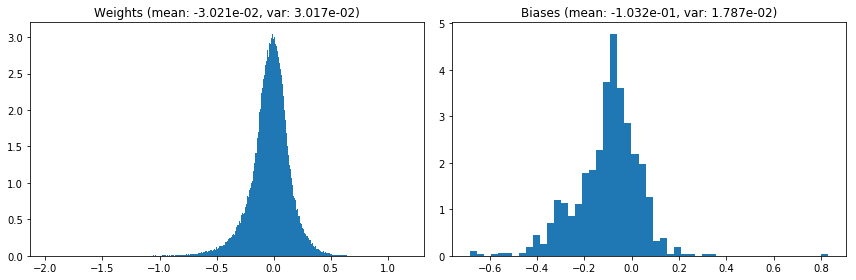

                                      Location network weights and biases


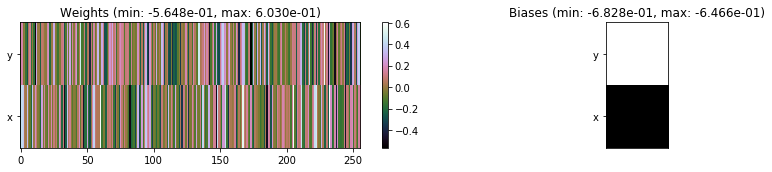

---------------------------------------------------------------------------------------------------------------
Elapsed time:  406.33 sec | TRAIN >> class loss: 0.3567 | steps:  2.449 :( | reward:  0.8864    | acc.: 88.637% 
                          | VAL   >> class loss: 0.2967 | steps:  2.353 :( | reward:  0.9092    | acc.: 90.920% 


Epoch  13/400) lr = 0.0006892
 b    500/  4000 >> 100.6 ms/b | lr: 6.87e-04 | grad 2norm:  7.14 | grad inf norm:  2.492
       Weights || abs max:  1.98 ( 4522.02) | mean: -3.03e-02 ( 0.04) | var: 3.03e-02 ( 8511.01)
        Biases || abs max:  0.83 (  164.31) | mean: -1.03e-01 ( 0.34) | var: 1.80e-02 (  470.08)
                  class loss: 0.321 | steps: 2.364 | reward:  0.898 | acc.: 89.83%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 100.6 ms/b | lr: 6.84e-04 | grad 2norm:  6.84 | grad inf norm:  2.322
       Weights || abs max:  1.98 ( 3595.52) | mean: -3.05e-02 ( 0.03) | var

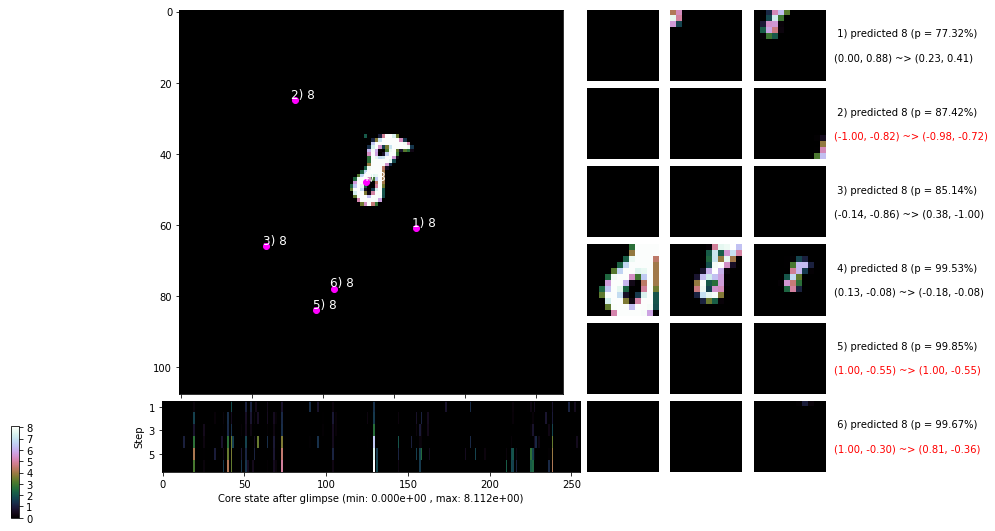

 b   1500/  4000 >> 104.2 ms/b | lr: 6.82e-04 | grad 2norm:  7.11 | grad inf norm:  2.504
       Weights || abs max:  1.99 (10432.38) | mean: -3.04e-02 ( 0.06) | var: 3.06e-02 (26277.20)
        Biases || abs max:  0.83 (  226.74) | mean: -1.04e-01 ( 0.52) | var: 1.85e-02 (19715.40)
                  class loss: 0.347 | steps: 2.482 | reward:  0.889 | acc.: 88.94%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.2 ms/b | lr: 6.79e-04 | grad 2norm:  6.99 | grad inf norm:  2.434
       Weights || abs max:  1.99 ( 2812.05) | mean: -3.04e-02 ( 0.03) | var: 3.08e-02 (  581.06)
        Biases || abs max:  0.82 (  226.66) | mean: -1.04e-01 ( 0.40) | var: 1.86e-02 ( 4501.82)
                  class loss: 0.368 | steps: 2.505 | reward:  0.883 | acc.: 88.32%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

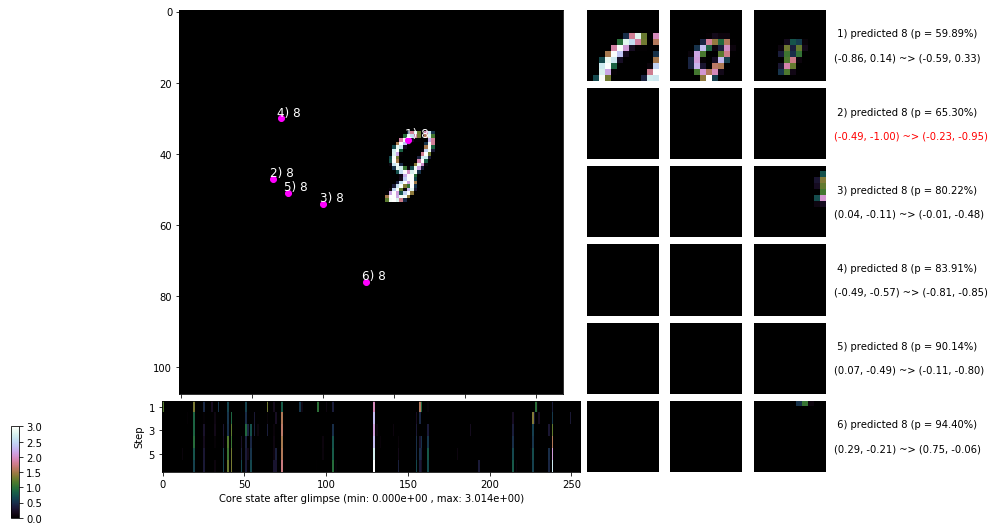

 b   2500/  4000 >> 100.2 ms/b | lr: 6.77e-04 | grad 2norm:  6.83 | grad inf norm:  2.320
       Weights || abs max:  2.00 ( 3558.08) | mean: -3.03e-02 ( 0.03) | var: 3.10e-02 (  778.17)
        Biases || abs max:  0.82 (  155.42) | mean: -1.04e-01 ( 0.37) | var: 1.86e-02 ( 1525.21)
                  class loss: 0.358 | steps: 2.465 | reward:  0.887 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 97.8 ms/b | lr: 6.74e-04 | grad 2norm:  6.96 | grad inf norm:  2.387
       Weights || abs max:  2.01 ( 2636.07) | mean: -3.03e-02 ( 0.03) | var: 3.12e-02 (  174.43)
        Biases || abs max:  0.81 (   87.51) | mean: -1.05e-01 ( 0.26) | var: 1.89e-02 (   48.44)
                  class loss: 0.367 | steps: 2.481 | reward:  0.884 | acc.: 88.43%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


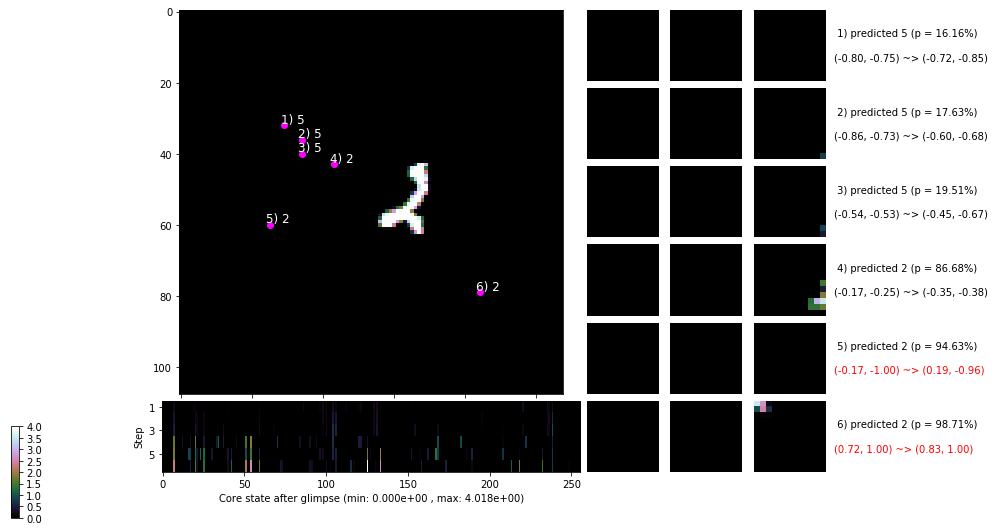

 b   3500/  4000 >> 100.5 ms/b | lr: 6.72e-04 | grad 2norm:  7.86 | grad inf norm:  2.665
       Weights || abs max:  2.02 ( 3604.73) | mean: -3.03e-02 ( 0.03) | var: 3.13e-02 ( 1137.01)
        Biases || abs max:  0.82 (  571.14) | mean: -1.05e-01 ( 1.02) | var: 1.91e-02 (44234.60)
                  class loss: 0.352 | steps: 2.462 | reward:  0.887 | acc.: 88.71%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.6 ms/b | lr: 6.69e-04 | grad 2norm:  7.20 | grad inf norm:  2.515
       Weights || abs max:  2.02 ( 2788.07) | mean: -3.04e-02 ( 0.03) | var: 3.15e-02 (  659.45)
        Biases || abs max:  0.82 (  160.90) | mean: -1.06e-01 ( 0.37) | var: 1.95e-02 (  710.07)
                  class loss: 0.351 | steps: 2.411 | reward:  0.889 | acc.: 88.91%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

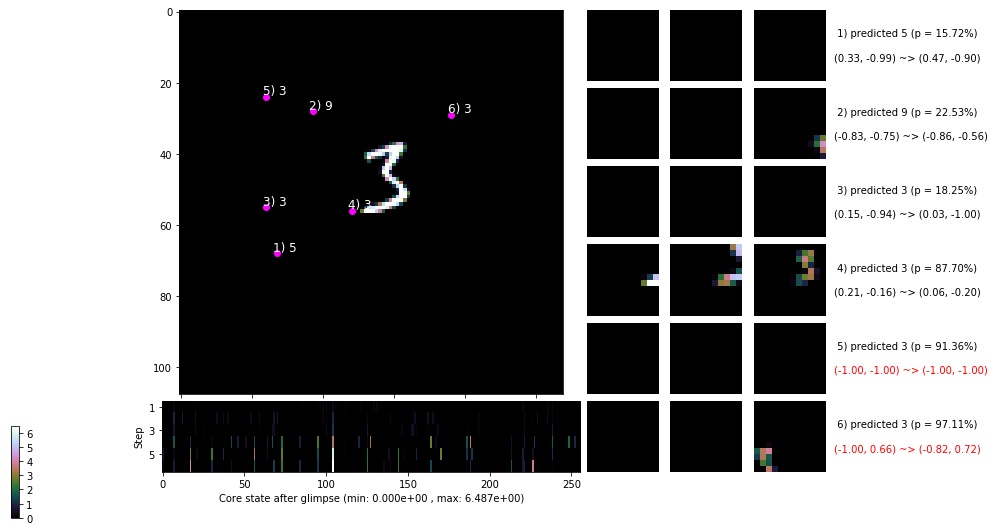

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


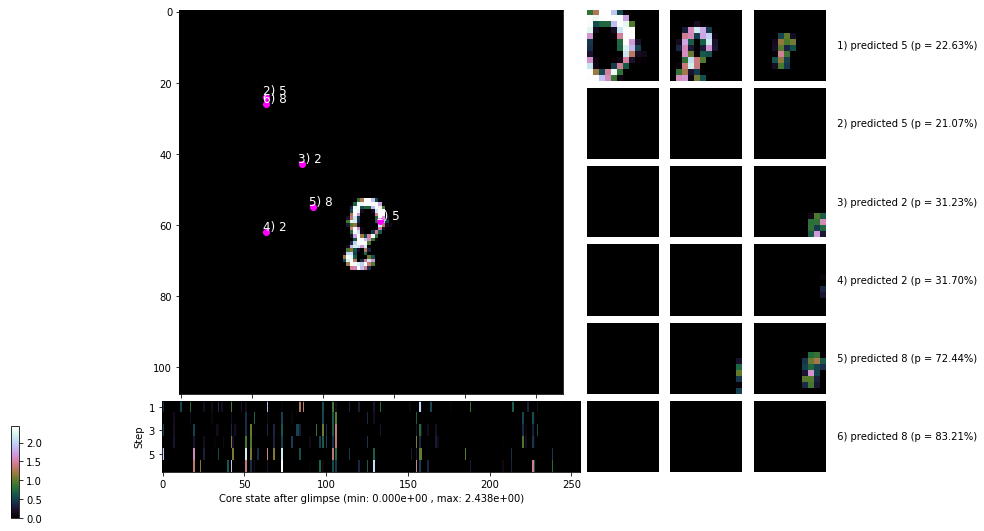


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


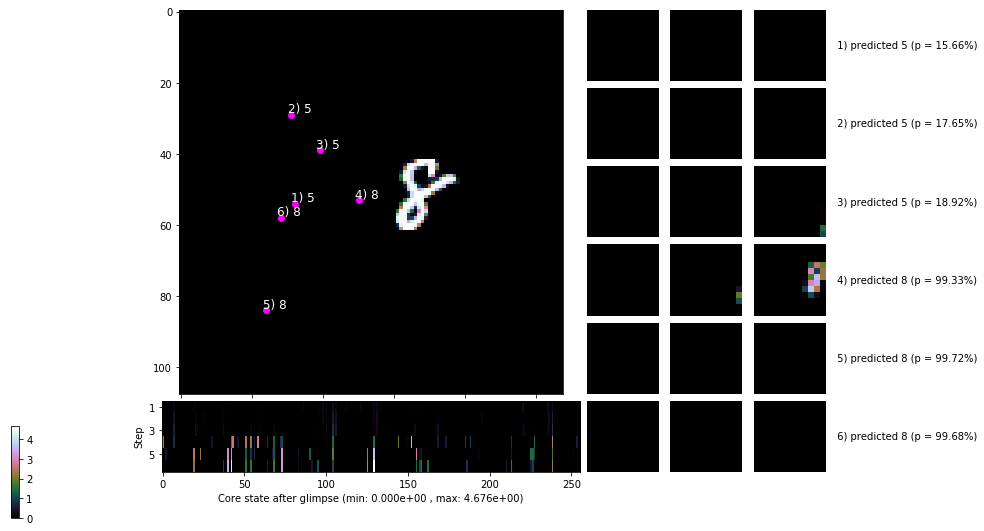

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


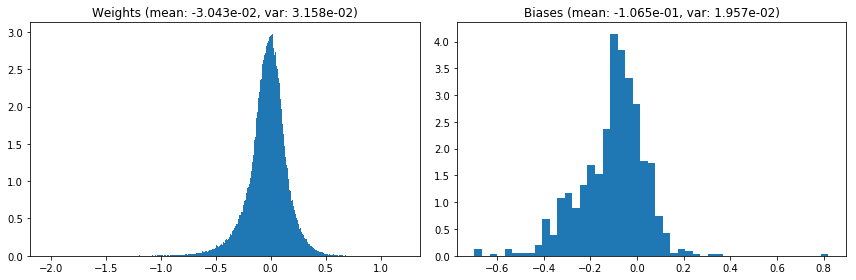

                                      Location network weights and biases


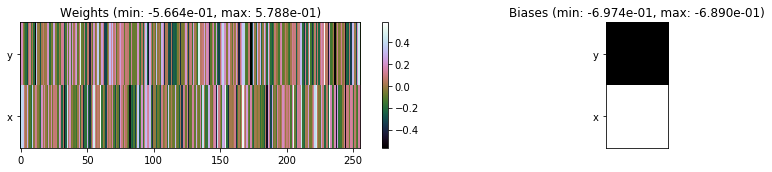

---------------------------------------------------------------------------------------------------------------
Elapsed time:  405.00 sec | TRAIN >> class loss: 0.3530 | steps:  2.457 :( | reward:  0.8880    | acc.: 88.801% 
                          | VAL   >> class loss: 0.3118 | steps:  2.353 :( | reward:  0.9030 :( | acc.: 90.300% :(


Epoch  14/400) lr = 0.0006682
 b    500/  4000 >> 106.8 ms/b | lr: 6.66e-04 | grad 2norm:  6.92 | grad inf norm:  2.346
       Weights || abs max:  2.03 (23085.88) | mean: -3.05e-02 ( 0.11) | var: 3.17e-02 (313805.44)
        Biases || abs max:  0.82 (  196.34) | mean: -1.07e-01 ( 0.41) | var: 1.96e-02 (  868.59)
                  class loss: 0.341 | steps: 2.395 | reward:  0.893 | acc.: 89.35%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.7 ms/b | lr: 6.64e-04 | grad 2norm:  7.12 | grad inf norm:  2.448
       Weights || abs max:  2.04 ( 4393.07) | mean: -3.06e-02 ( 0.04) | 

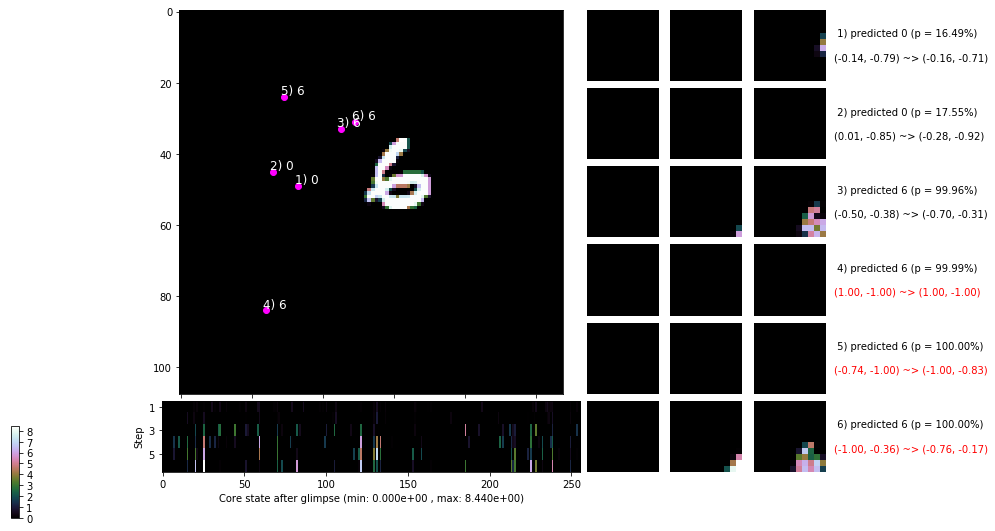

 b   1500/  4000 >> 105.2 ms/b | lr: 6.61e-04 | grad 2norm:  6.88 | grad inf norm:  2.391
       Weights || abs max:  2.04 ( 5630.43) | mean: -3.06e-02 ( 0.04) | var: 3.20e-02 ( 4706.20)
        Biases || abs max:  0.82 (  149.55) | mean: -1.08e-01 ( 0.36) | var: 2.01e-02 (  223.14)
                  class loss: 0.333 | steps: 2.390 | reward:  0.895 | acc.: 89.53%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.8 ms/b | lr: 6.58e-04 | grad 2norm:  7.38 | grad inf norm:  2.624
       Weights || abs max:  2.05 ( 3361.68) | mean: -3.06e-02 ( 0.03) | var: 3.21e-02 (  453.79)
        Biases || abs max:  0.83 (  126.31) | mean: -1.09e-01 ( 0.29) | var: 2.03e-02 (  238.60)
                  class loss: 0.325 | steps: 2.378 | reward:  0.897 | acc.: 89.67%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

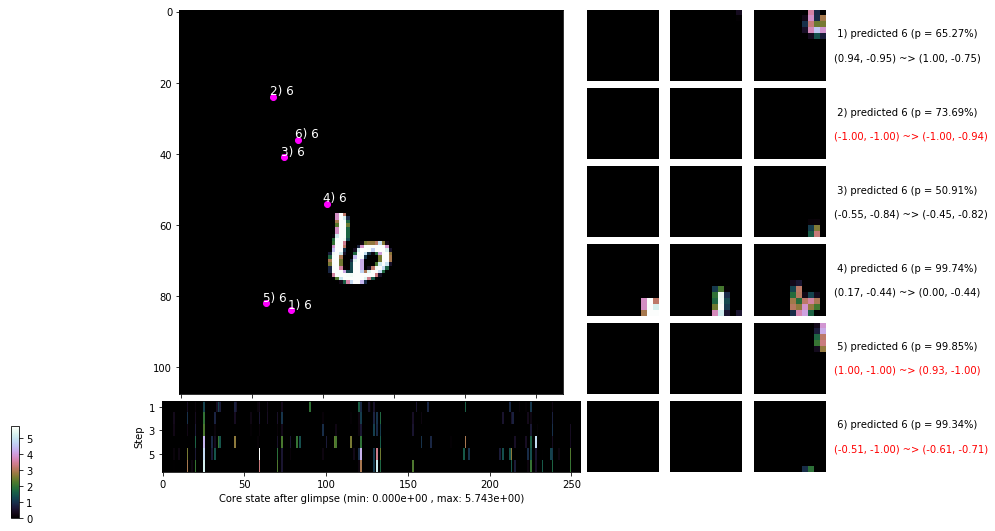

 b   2500/  4000 >> 102.7 ms/b | lr: 6.56e-04 | grad 2norm:  7.01 | grad inf norm:  2.489
       Weights || abs max:  2.06 ( 3816.67) | mean: -3.06e-02 ( 0.03) | var: 3.23e-02 ( 1184.37)
        Biases || abs max:  0.83 (  151.35) | mean: -1.09e-01 ( 0.34) | var: 2.06e-02 (  307.38)
                  class loss: 0.330 | steps: 2.430 | reward:  0.895 | acc.: 89.52%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.8 ms/b | lr: 6.54e-04 | grad 2norm:  7.19 | grad inf norm:  2.488
       Weights || abs max:  2.07 (20024.93) | mean: -3.06e-02 ( 0.10) | var: 3.25e-02 (379142.00)
        Biases || abs max:  0.83 (  285.61) | mean: -1.10e-01 ( 0.49) | var: 2.09e-02 ( 3204.09)
                  class loss: 0.335 | steps: 2.388 | reward:  0.893 | acc.: 89.29%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

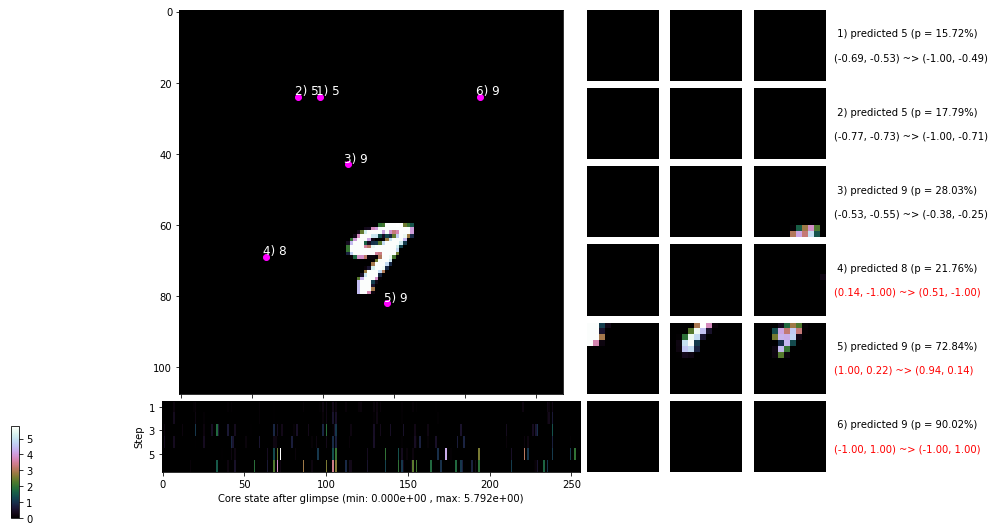

 b   3500/  4000 >> 104.4 ms/b | lr: 6.51e-04 | grad 2norm:  7.26 | grad inf norm:  2.578
       Weights || abs max:  2.08 ( 5379.51) | mean: -3.07e-02 ( 0.04) | var: 3.26e-02 ( 3396.29)
        Biases || abs max:  0.83 (  144.52) | mean: -1.11e-01 ( 0.31) | var: 2.12e-02 (  537.07)
                  class loss: 0.331 | steps: 2.405 | reward:  0.892 | acc.: 89.22%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.9 ms/b | lr: 6.48e-04 | grad 2norm:  7.12 | grad inf norm:  2.491
       Weights || abs max:  2.09 ( 3739.48) | mean: -3.09e-02 ( 0.03) | var: 3.28e-02 (  756.41)
        Biases || abs max:  0.83 (  895.19) | mean: -1.12e-01 ( 1.67) | var: 2.14e-02 (348561.50)
                  class loss: 0.327 | steps: 2.371 | reward:  0.896 | acc.: 89.62%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

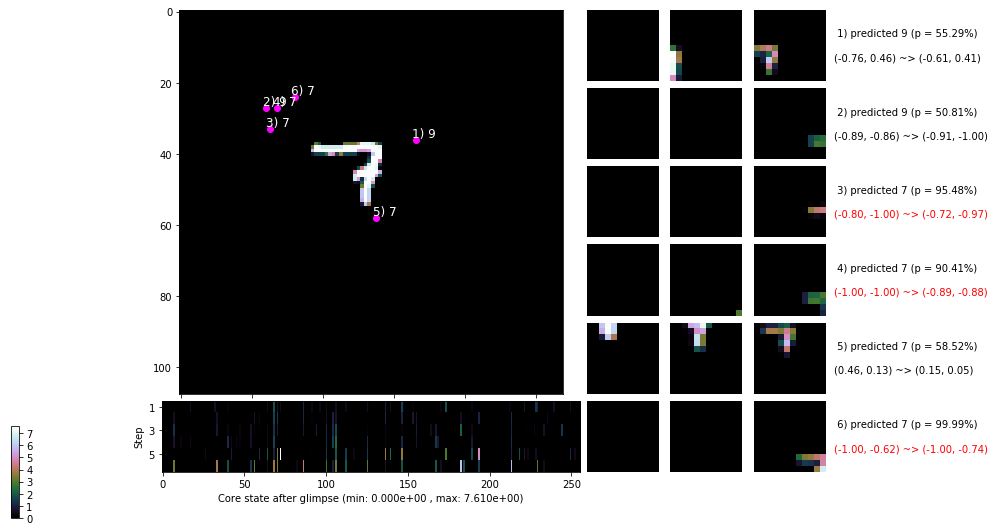

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


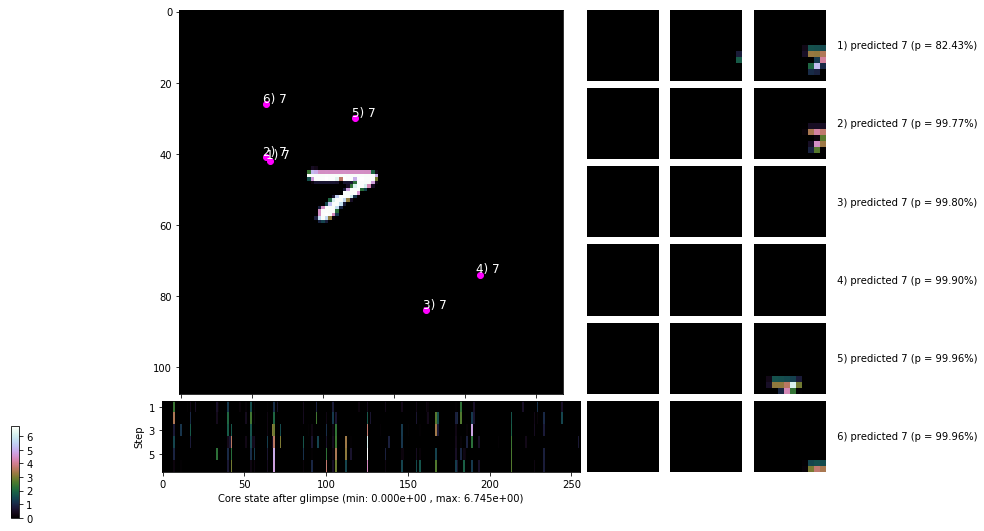


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


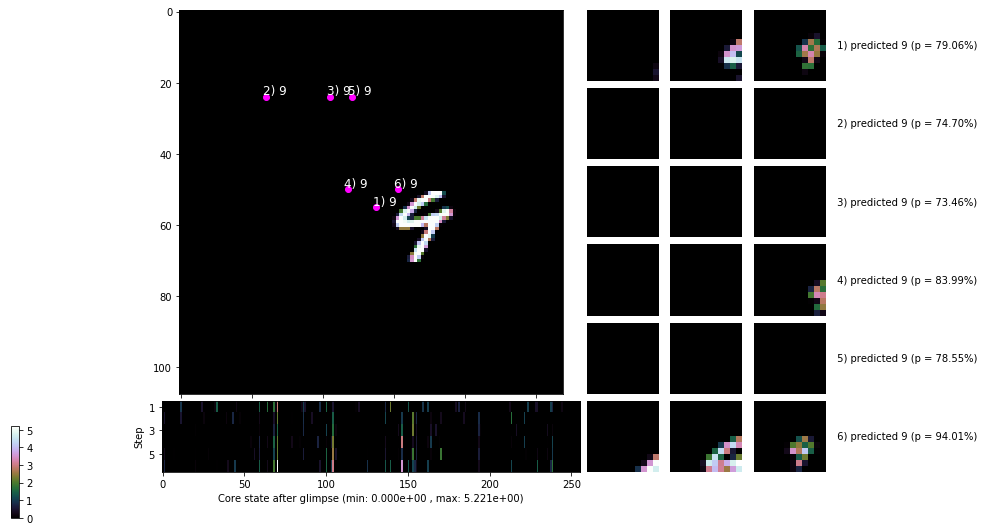

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


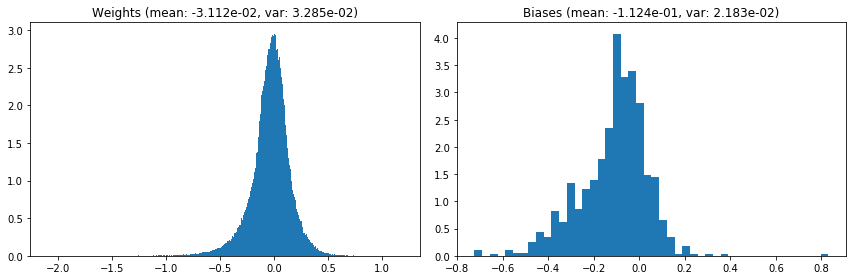

                                      Location network weights and biases


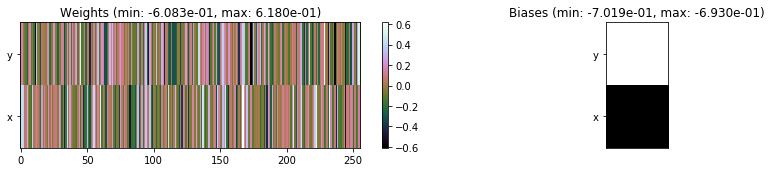

---------------------------------------------------------------------------------------------------------------
Elapsed time:  415.28 sec | TRAIN >> class loss: 0.3339 | steps:  2.400    | reward:  0.8939    | acc.: 89.393% 
                          | VAL   >> class loss: 0.2859 | steps:  2.318 :( | reward:  0.9120    | acc.: 91.200% 


Epoch  15/400) lr = 0.0006478
 b    500/  4000 >> 102.2 ms/b | lr: 6.46e-04 | grad 2norm:  6.81 | grad inf norm:  2.376
       Weights || abs max:  2.09 ( 3559.01) | mean: -3.11e-02 ( 0.03) | var: 3.29e-02 (  415.12)
        Biases || abs max:  0.83 (  121.59) | mean: -1.13e-01 ( 0.28) | var: 2.20e-02 (  166.54)
                  class loss: 0.318 | steps: 2.373 | reward:  0.900 | acc.: 89.99%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.7 ms/b | lr: 6.43e-04 | grad 2norm:  6.87 | grad inf norm:  2.369
       Weights || abs max:  2.09 ( 4765.57) | mean: -3.12e-02 ( 0.04) | var

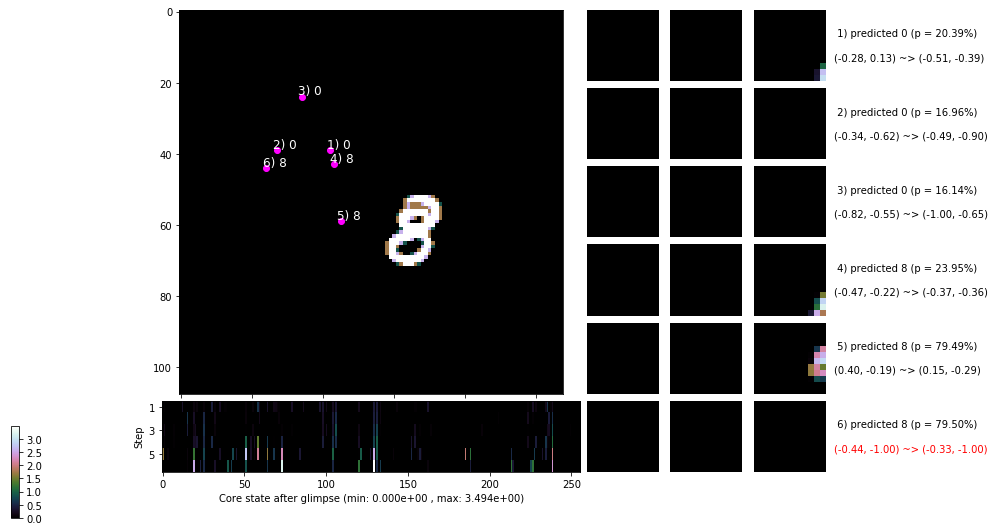

 b   1500/  4000 >> 110.0 ms/b | lr: 6.41e-04 | grad 2norm:  7.29 | grad inf norm:  2.562
       Weights || abs max:  2.07 ( 5484.83) | mean: -3.12e-02 ( 0.04) | var: 3.33e-02 ( 3401.98)
        Biases || abs max:  0.83 (  565.25) | mean: -1.13e-01 ( 0.75) | var: 2.24e-02 (28942.18)
                  class loss: 0.318 | steps: 2.383 | reward:  0.897 | acc.: 89.71%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 108.6 ms/b | lr: 6.38e-04 | grad 2norm:  7.23 | grad inf norm:  2.418
       Weights || abs max:  2.08 ( 3427.01) | mean: -3.12e-02 ( 0.03) | var: 3.34e-02 (  453.28)
        Biases || abs max:  0.83 (  117.09) | mean: -1.13e-01 ( 0.26) | var: 2.23e-02 (  249.40)
                  class loss: 0.318 | steps: 2.329 | reward:  0.897 | acc.: 89.70%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

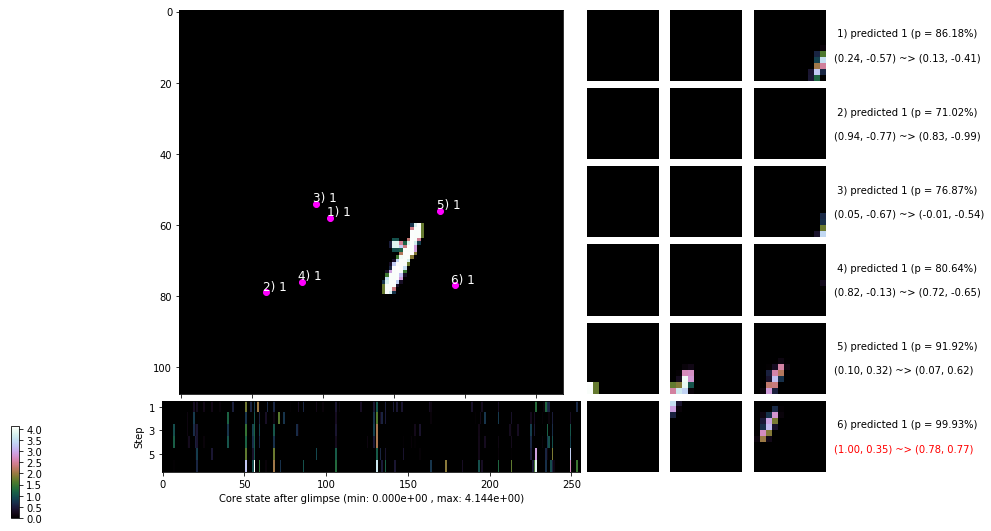

 b   2500/  4000 >> 104.2 ms/b | lr: 6.36e-04 | grad 2norm:  7.56 | grad inf norm:  2.657
       Weights || abs max:  2.09 ( 4412.20) | mean: -3.12e-02 ( 0.04) | var: 3.35e-02 (  924.62)
        Biases || abs max:  0.83 (  111.13) | mean: -1.14e-01 ( 0.27) | var: 2.24e-02 (  301.67)
                  class loss: 0.322 | steps: 2.277 | reward:  0.899 | acc.: 89.86%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.8 ms/b | lr: 6.34e-04 | grad 2norm:  7.53 | grad inf norm:  2.727
       Weights || abs max:  2.10 ( 6066.85) | mean: -3.11e-02 ( 0.04) | var: 3.37e-02 (10309.95)
        Biases || abs max:  0.83 (  143.39) | mean: -1.14e-01 ( 0.27) | var: 2.24e-02 (  492.36)
                  class loss: 0.323 | steps: 2.303 | reward:  0.900 | acc.: 90.03%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

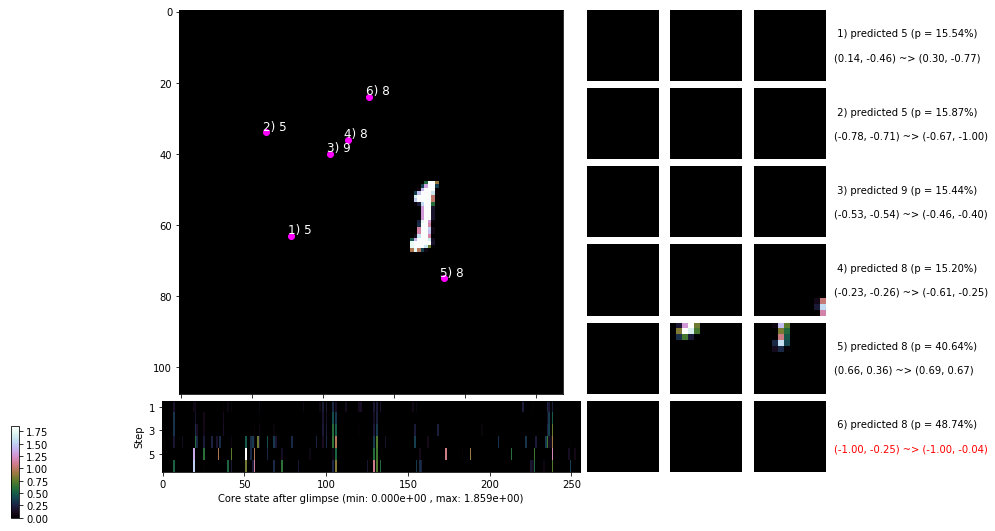

 b   3500/  4000 >> 103.9 ms/b | lr: 6.31e-04 | grad 2norm:  7.71 | grad inf norm:  2.686
       Weights || abs max:  2.11 ( 5333.05) | mean: -3.11e-02 ( 0.04) | var: 3.38e-02 ( 2714.12)
        Biases || abs max:  0.83 (  107.17) | mean: -1.14e-01 ( 0.24) | var: 2.27e-02 (  520.88)
                  class loss: 0.327 | steps: 2.337 | reward:  0.898 | acc.: 89.76%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.7 ms/b | lr: 6.29e-04 | grad 2norm:  7.56 | grad inf norm:  2.696
       Weights || abs max:  2.11 ( 8760.52) | mean: -3.11e-02 ( 0.05) | var: 3.40e-02 (23558.19)
        Biases || abs max:  0.84 (  172.55) | mean: -1.14e-01 ( 0.34) | var: 2.30e-02 ( 1238.85)
                  class loss: 0.317 | steps: 2.308 | reward:  0.900 | acc.: 90.03%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

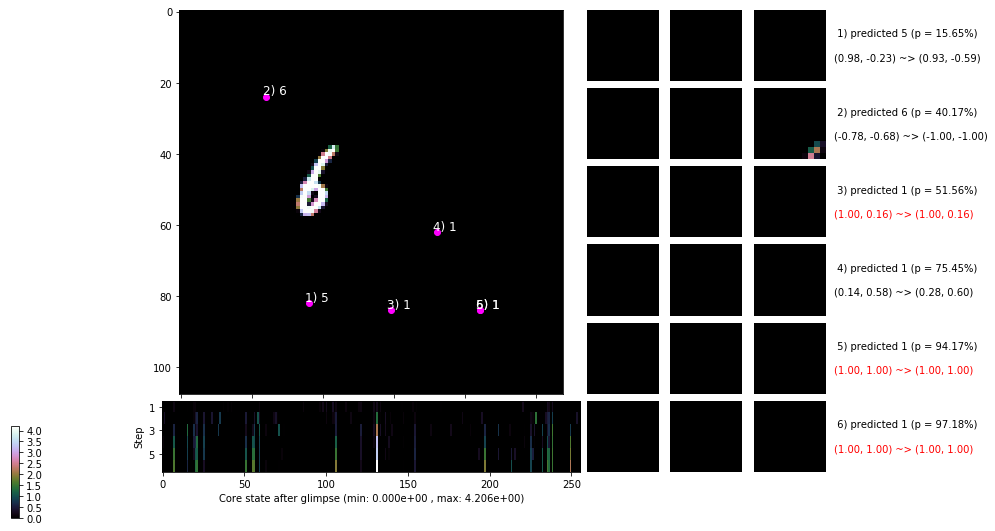

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


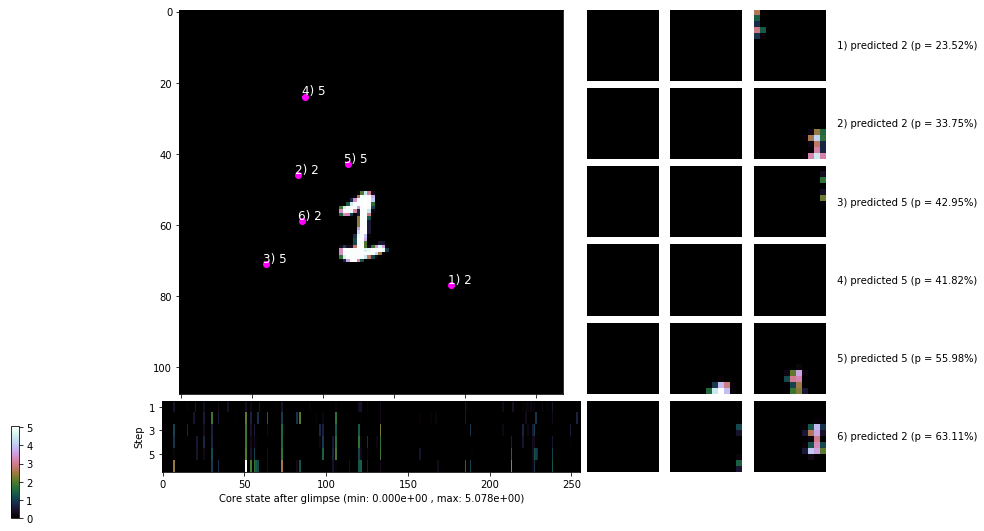


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


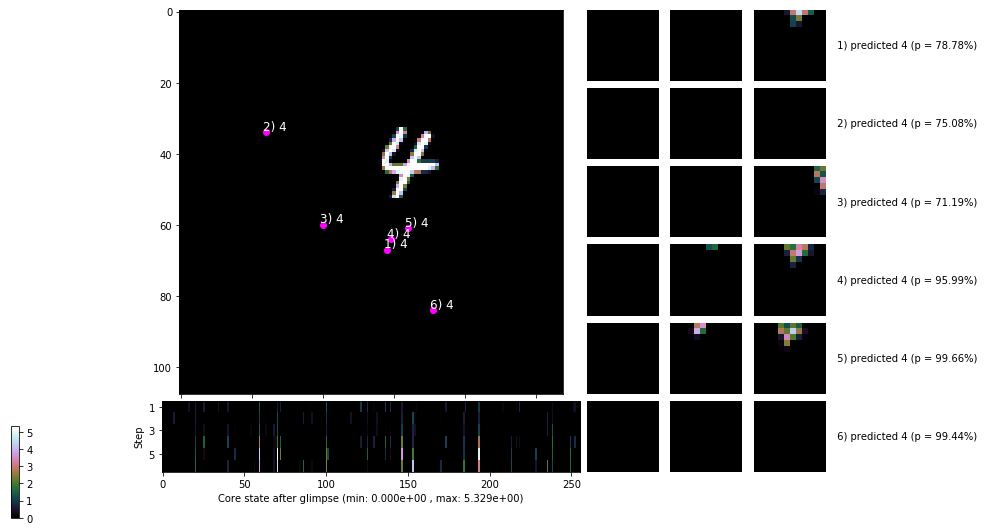

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


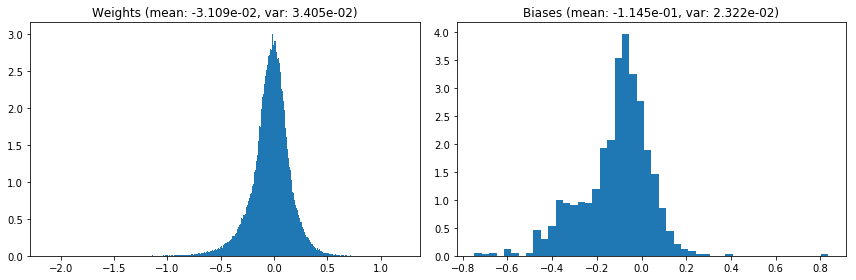

                                      Location network weights and biases


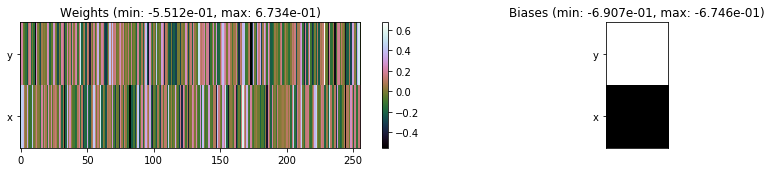

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.86 sec | TRAIN >> class loss: 0.3203 | steps:  2.342    | reward:  0.8988    | acc.: 89.876% 
                          | VAL   >> class loss: 0.3033 | steps:  2.200    | reward:  0.9062 :( | acc.: 90.620% :(


Epoch  16/400) lr = 0.000628
 b    500/  4000 >> 104.6 ms/b | lr: 6.26e-04 | grad 2norm:  7.66 | grad inf norm:  2.679
       Weights || abs max:  2.12 (54440.60) | mean: -3.12e-02 ( 0.23) | var: 3.41e-02 (2215720.50)
        Biases || abs max:  0.83 (  223.59) | mean: -1.15e-01 ( 0.37) | var: 2.33e-02 ( 6150.78)
                  class loss: 0.319 | steps: 2.270 | reward:  0.898 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.2 ms/b | lr: 6.24e-04 | grad 2norm:  7.71 | grad inf norm:  2.702
       Weights || abs max:  2.12 (90902.68) | mean: -3.12e-02 ( 0.38) | 

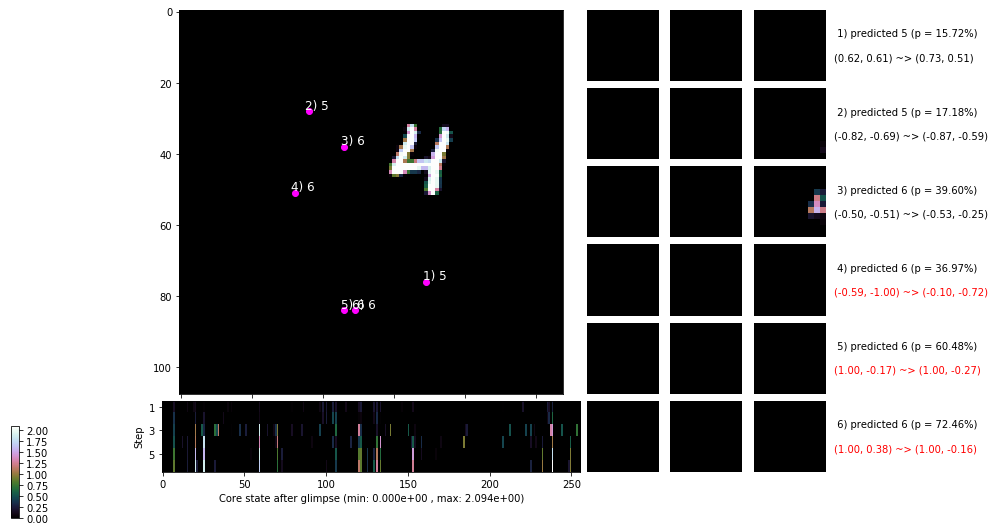

 b   1500/  4000 >> 104.7 ms/b | lr: 6.21e-04 | grad 2norm:  7.77 | grad inf norm:  2.815
       Weights || abs max:  2.13 ( 4104.78) | mean: -3.13e-02 ( 0.03) | var: 3.44e-02 (  973.36)
        Biases || abs max:  0.84 (  220.64) | mean: -1.16e-01 ( 0.48) | var: 2.37e-02 ( 3158.84)
                  class loss: 0.326 | steps: 2.352 | reward:  0.896 | acc.: 89.59%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.2 ms/b | lr: 6.19e-04 | grad 2norm:  7.81 | grad inf norm:  2.801
       Weights || abs max:  2.15 ( 4767.60) | mean: -3.12e-02 ( 0.04) | var: 3.46e-02 ( 4016.77)
        Biases || abs max:  0.84 (  188.77) | mean: -1.16e-01 ( 0.37) | var: 2.37e-02 (  432.95)
                  class loss: 0.313 | steps: 2.290 | reward:  0.898 | acc.: 89.83%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

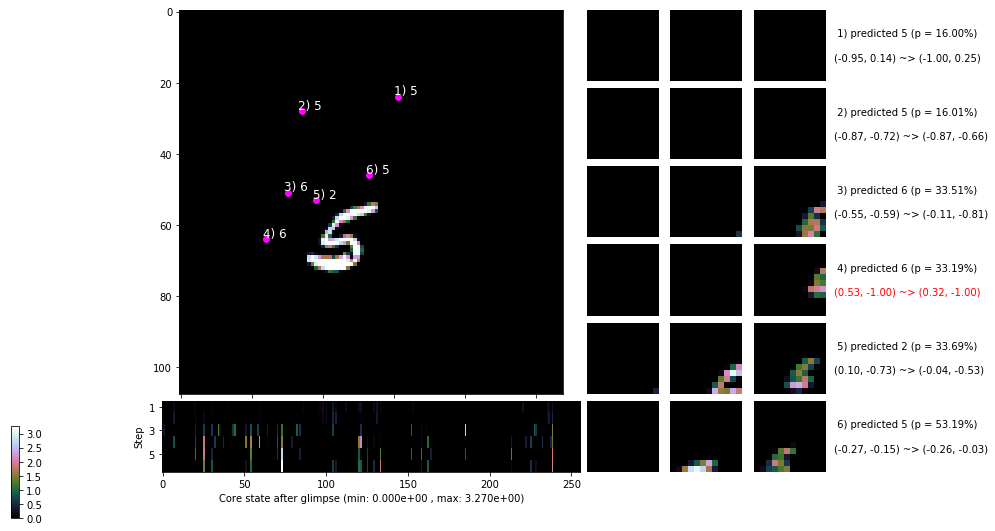

 b   2500/  4000 >> 103.8 ms/b | lr: 6.17e-04 | grad 2norm:  7.90 | grad inf norm:  2.836
       Weights || abs max:  2.14 (11166.74) | mean: -3.12e-02 ( 0.06) | var: 3.47e-02 (28242.48)
        Biases || abs max:  0.83 (  116.68) | mean: -1.17e-01 ( 0.26) | var: 2.39e-02 (  114.92)
                  class loss: 0.326 | steps: 2.313 | reward:  0.896 | acc.: 89.58%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.5 ms/b | lr: 6.14e-04 | grad 2norm:  7.61 | grad inf norm:  2.709
       Weights || abs max:  2.16 ( 5480.59) | mean: -3.11e-02 ( 0.04) | var: 3.49e-02 ( 2808.81)
        Biases || abs max:  0.83 (  180.43) | mean: -1.18e-01 ( 0.38) | var: 2.42e-02 ( 1175.15)
                  class loss: 0.312 | steps: 2.284 | reward:  0.902 | acc.: 90.22%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

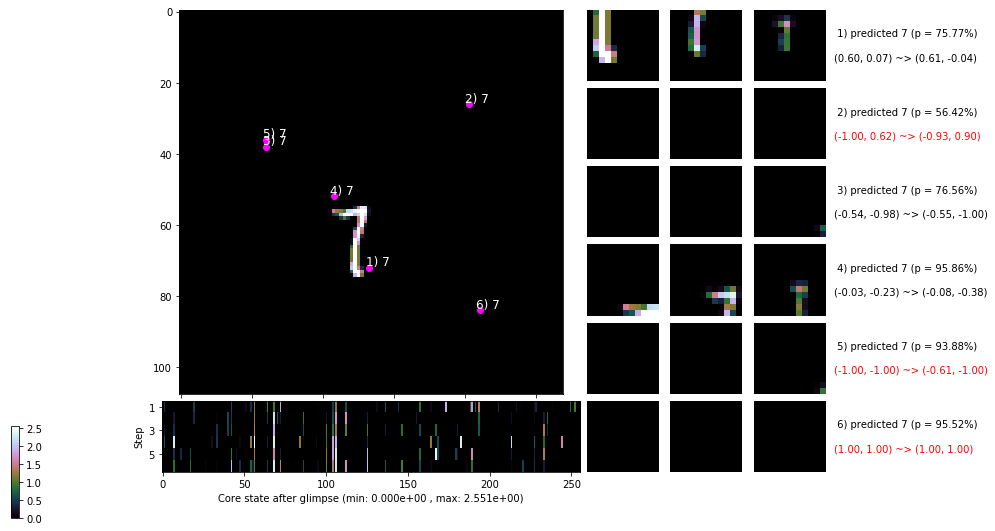

 b   3500/  4000 >> 116.0 ms/b | lr: 6.12e-04 | grad 2norm:  7.55 | grad inf norm:  2.702
       Weights || abs max:  2.17 (11536.18) | mean: -3.10e-02 ( 0.06) | var: 3.50e-02 (47167.94)
        Biases || abs max:  0.83 (  285.16) | mean: -1.18e-01 ( 0.42) | var: 2.44e-02 (11499.60)
                  class loss: 0.320 | steps: 2.350 | reward:  0.897 | acc.: 89.66%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.2 ms/b | lr: 6.09e-04 | grad 2norm:  7.79 | grad inf norm:  2.862
       Weights || abs max:  2.19 ( 3460.08) | mean: -3.11e-02 ( 0.03) | var: 3.52e-02 (  619.45)
        Biases || abs max:  0.83 (  116.39) | mean: -1.19e-01 ( 0.26) | var: 2.48e-02 (  180.46)
                  class loss: 0.331 | steps: 2.377 | reward:  0.896 | acc.: 89.59%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

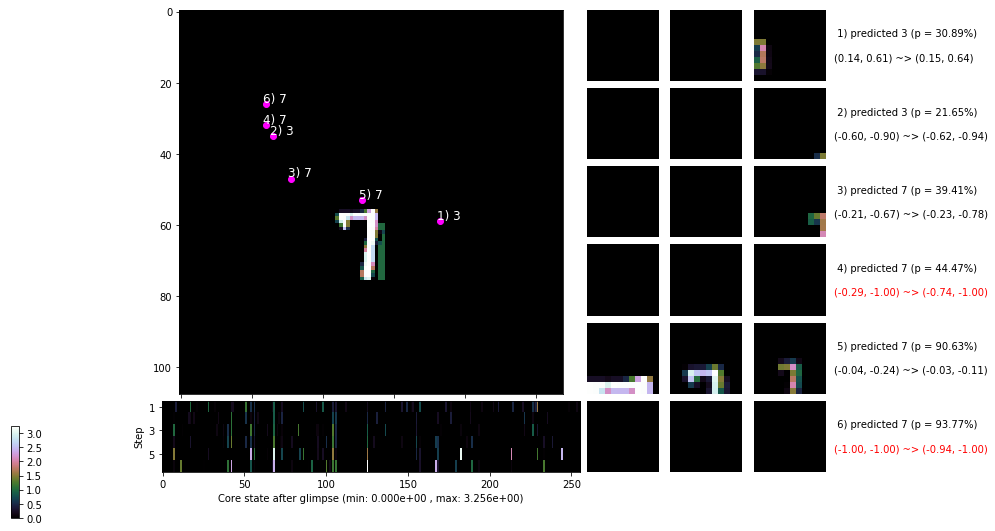

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


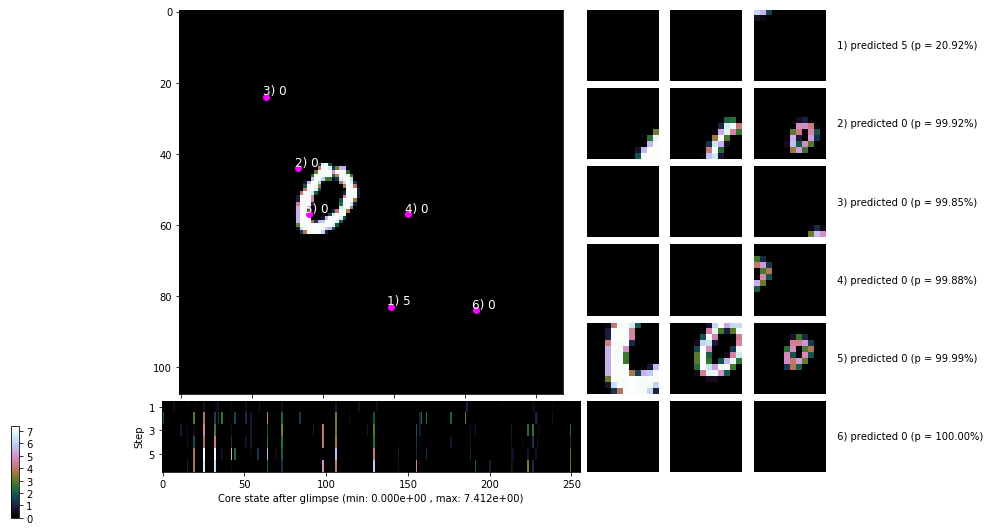


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


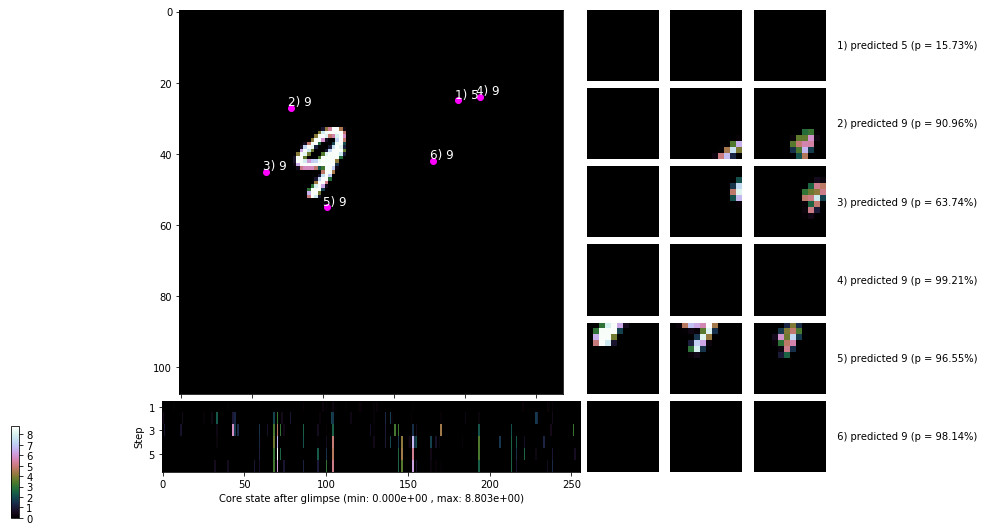

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


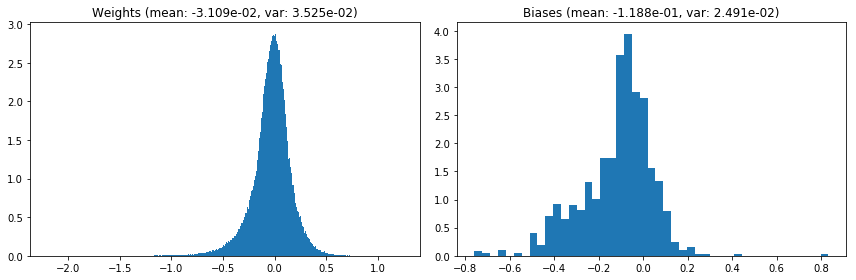

                                      Location network weights and biases


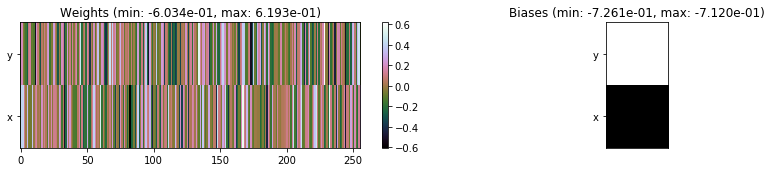

---------------------------------------------------------------------------------------------------------------
Elapsed time:  421.69 sec | TRAIN >> class loss: 0.3221 | steps:  2.316    | reward:  0.8976 :( | acc.: 89.756% :(
                          | VAL   >> class loss: 0.3185 | steps:  2.384 :( | reward:  0.8964 :( | acc.: 89.640% :(


Epoch  17/400) lr = 0.0006088
 b    500/  4000 >> 102.8 ms/b | lr: 6.07e-04 | grad 2norm:  7.70 | grad inf norm:  2.753
       Weights || abs max:  2.20 ( 3517.34) | mean: -3.10e-02 ( 0.03) | var: 3.53e-02 ( 1036.67)
        Biases || abs max:  0.83 (  171.96) | mean: -1.19e-01 ( 0.36) | var: 2.50e-02 ( 1595.85)
                  class loss: 0.333 | steps: 2.367 | reward:  0.893 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.4 ms/b | lr: 6.05e-04 | grad 2norm:  7.70 | grad inf norm:  2.813
       Weights || abs max:  2.21 ( 6305.18) | mean: -3.10e-02 ( 0.04) |

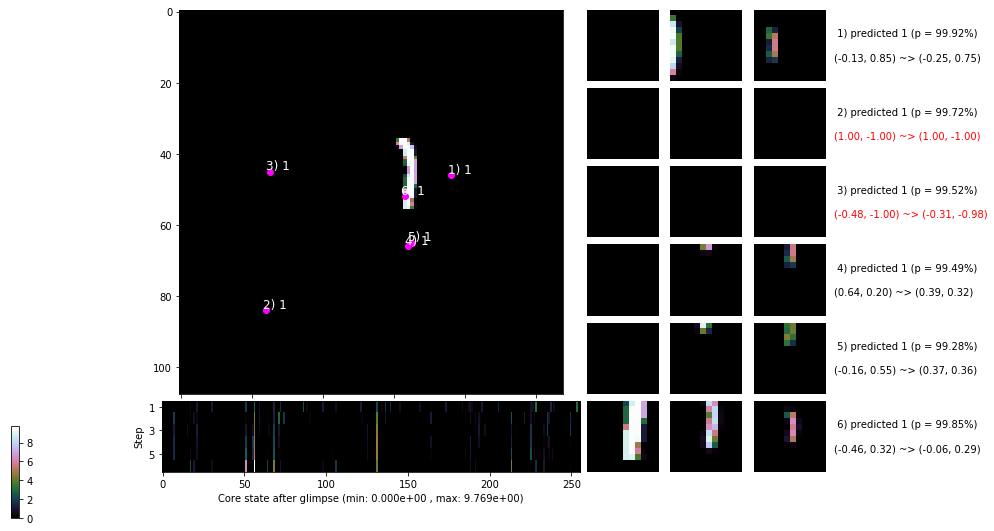

 b   1500/  4000 >> 104.9 ms/b | lr: 6.02e-04 | grad 2norm:  7.72 | grad inf norm:  2.754
       Weights || abs max:  2.21 ( 4633.42) | mean: -3.10e-02 ( 0.03) | var: 3.56e-02 ( 2063.09)
        Biases || abs max:  0.83 (  134.80) | mean: -1.20e-01 ( 0.27) | var: 2.54e-02 ( 1007.41)
                  class loss: 0.328 | steps: 2.356 | reward:  0.897 | acc.: 89.67%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.4 ms/b | lr: 6.00e-04 | grad 2norm:  9.31 | grad inf norm:  3.215
       Weights || abs max:  2.23 ( 4165.21) | mean: -3.10e-02 ( 0.03) | var: 3.58e-02 ( 1351.05)
        Biases || abs max:  0.83 (  213.82) | mean: -1.20e-01 ( 0.36) | var: 2.55e-02 ( 5949.08)
                  class loss: 0.314 | steps: 2.296 | reward:  0.900 | acc.: 89.99%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

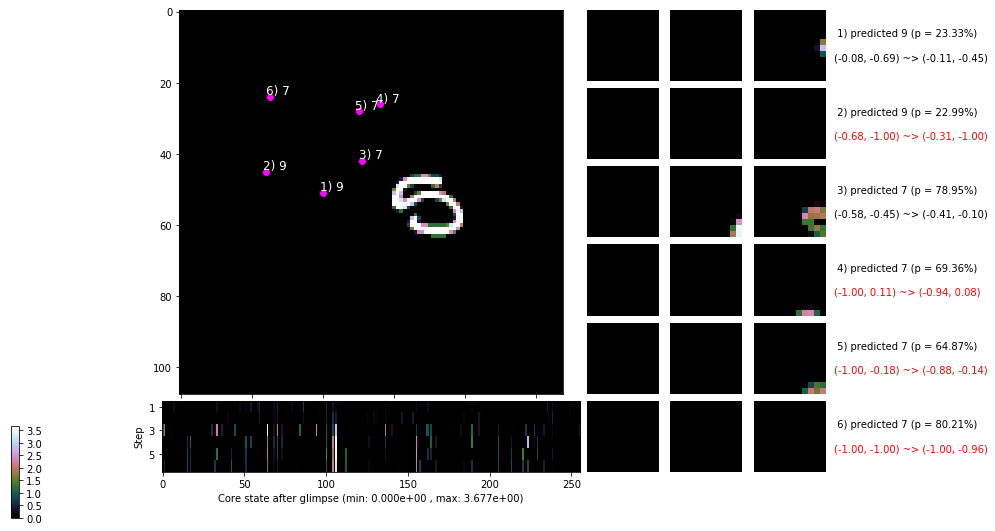

 b   2500/  4000 >> 106.3 ms/b | lr: 5.98e-04 | grad 2norm:  7.41 | grad inf norm:  2.712
       Weights || abs max:  2.24 ( 9138.05) | mean: -3.11e-02 ( 0.05) | var: 3.59e-02 (34391.62)
        Biases || abs max:  0.83 (  184.00) | mean: -1.21e-01 ( 0.34) | var: 2.57e-02 ( 1593.74)
                  class loss: 0.310 | steps: 2.325 | reward:  0.904 | acc.: 90.43%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.0 ms/b | lr: 5.96e-04 | grad 2norm:  7.57 | grad inf norm:  2.764
       Weights || abs max:  2.26 (12054.50) | mean: -3.11e-02 ( 0.06) | var: 3.60e-02 (98421.80)
        Biases || abs max:  0.83 (249779.06) | mean: -1.21e-01 (241.02) | var: 2.59e-02 (30072469504.00)
                  class loss: 0.307 | steps: 2.265 | reward:  0.904 | acc.: 90.43%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1

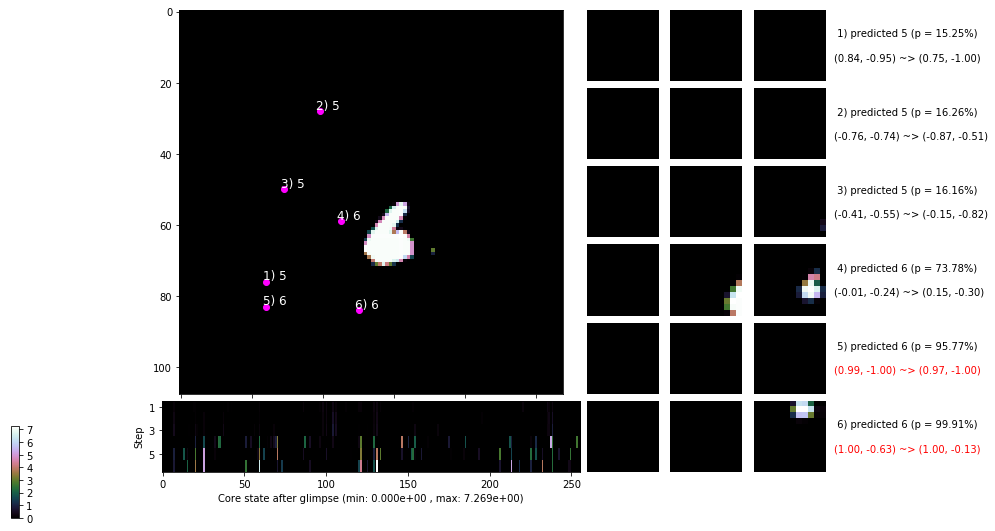

 b   3500/  4000 >> 104.6 ms/b | lr: 5.93e-04 | grad 2norm:  7.38 | grad inf norm:  2.626
       Weights || abs max:  2.28 ( 4235.74) | mean: -3.10e-02 ( 0.04) | var: 3.62e-02 (  669.25)
        Biases || abs max:  0.84 (  173.44) | mean: -1.22e-01 ( 0.34) | var: 2.62e-02 ( 1210.87)
                  class loss: 0.294 | steps: 2.299 | reward:  0.909 | acc.: 90.91%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.7 ms/b | lr: 5.91e-04 | grad 2norm:  9.93 | grad inf norm:  3.483
       Weights || abs max:  2.31 ( 9336.74) | mean: -3.10e-02 ( 0.06) | var: 3.63e-02 (37576.46)
        Biases || abs max:  0.84 (  154.94) | mean: -1.22e-01 ( 0.31) | var: 2.65e-02 (  505.84)
                  class loss: 0.306 | steps: 2.350 | reward:  0.902 | acc.: 90.23%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

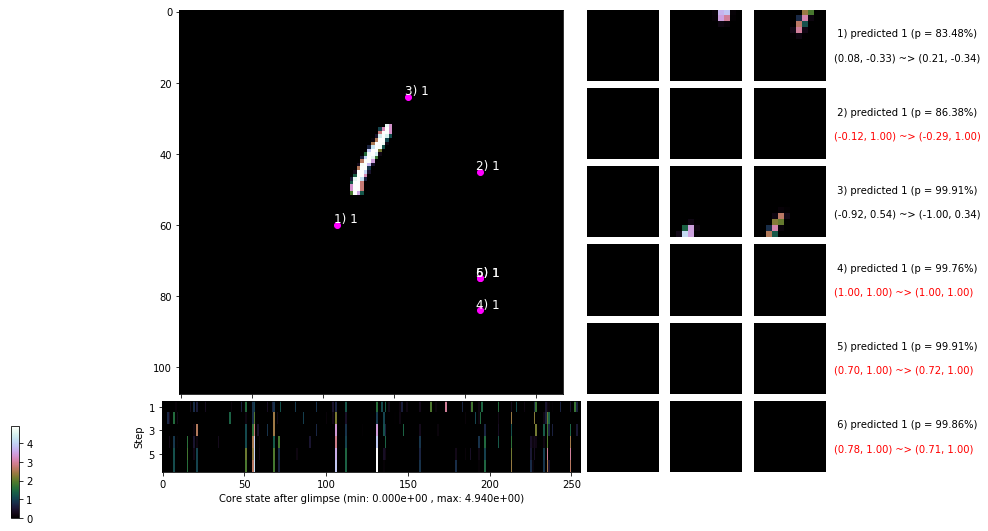

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


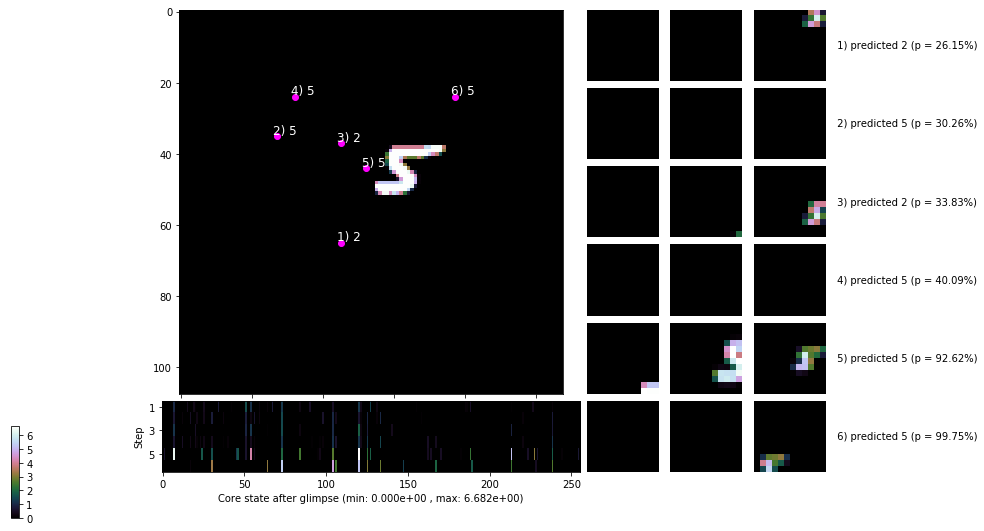


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


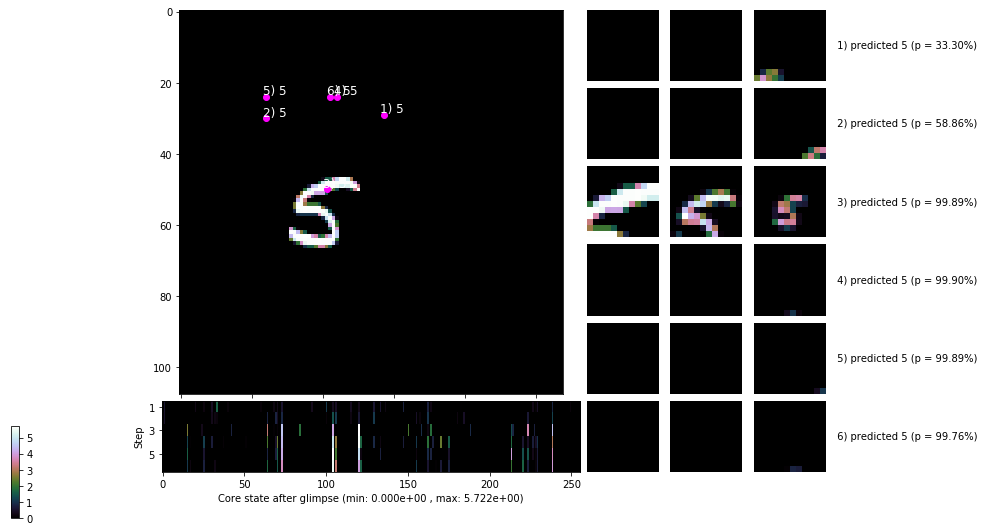

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


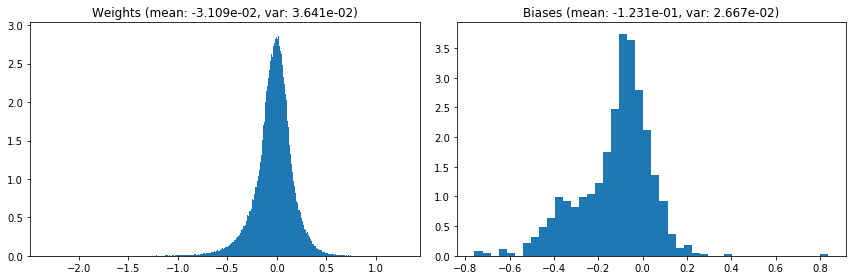

                                      Location network weights and biases


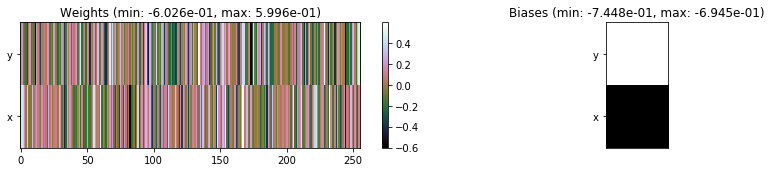

---------------------------------------------------------------------------------------------------------------
Elapsed time:  415.63 sec | TRAIN >> class loss: 0.3154 | steps:  2.329 :( | reward:  0.9004    | acc.: 90.038% 
                          | VAL   >> class loss: 0.2923 | steps:  2.304 :( | reward:  0.9050 :( | acc.: 90.500% :(


Epoch  18/400) lr = 0.0005902
 b    500/  4000 >> 106.1 ms/b | lr: 5.88e-04 | grad 2norm:  7.91 | grad inf norm:  2.864
       Weights || abs max:  2.32 ( 5334.68) | mean: -3.11e-02 ( 0.04) | var: 3.65e-02 ( 1666.26)
        Biases || abs max:  0.84 (  289.06) | mean: -1.23e-01 ( 0.52) | var: 2.68e-02 (12668.26)
                  class loss: 0.298 | steps: 2.340 | reward:  0.905 | acc.: 90.49%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 111.8 ms/b | lr: 5.86e-04 | grad 2norm:  8.31 | grad inf norm:  2.996
       Weights || abs max:  2.34 ( 4283.22) | mean: -3.11e-02 ( 0.04) | v

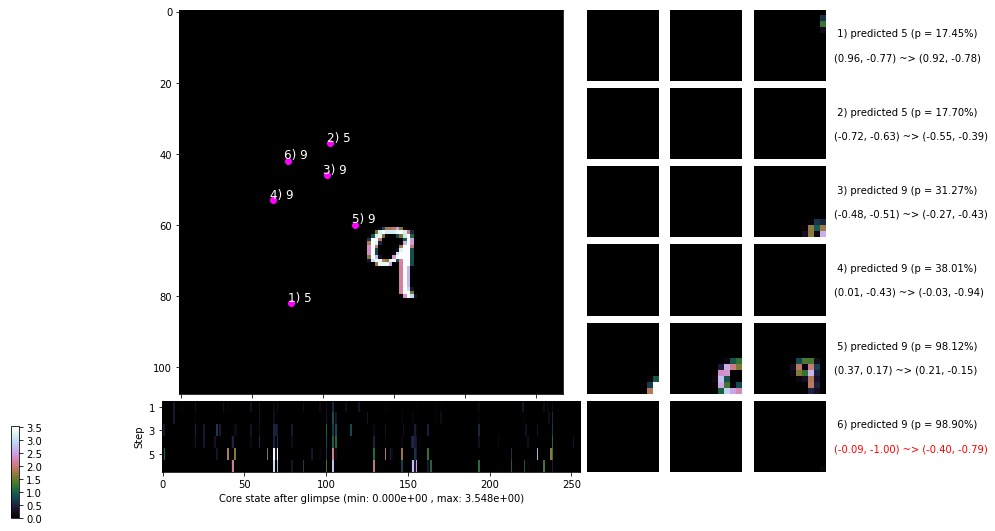

 b   1500/  4000 >> 107.8 ms/b | lr: 5.84e-04 | grad 2norm:  7.39 | grad inf norm:  2.694
       Weights || abs max:  2.34 ( 7080.32) | mean: -3.11e-02 ( 0.04) | var: 3.67e-02 ( 5880.34)
        Biases || abs max:  0.83 (  133.59) | mean: -1.24e-01 ( 0.29) | var: 2.74e-02 (  717.79)
                  class loss: 0.317 | steps: 2.328 | reward:  0.902 | acc.: 90.23%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.8 ms/b | lr: 5.81e-04 | grad 2norm:  7.81 | grad inf norm:  2.826
       Weights || abs max:  2.34 ( 4577.32) | mean: -3.11e-02 ( 0.04) | var: 3.69e-02 ( 1382.87)
        Biases || abs max:  0.83 (  115.78) | mean: -1.24e-01 ( 0.26) | var: 2.76e-02 (  167.37)
                  class loss: 0.304 | steps: 2.270 | reward:  0.903 | acc.: 90.27%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

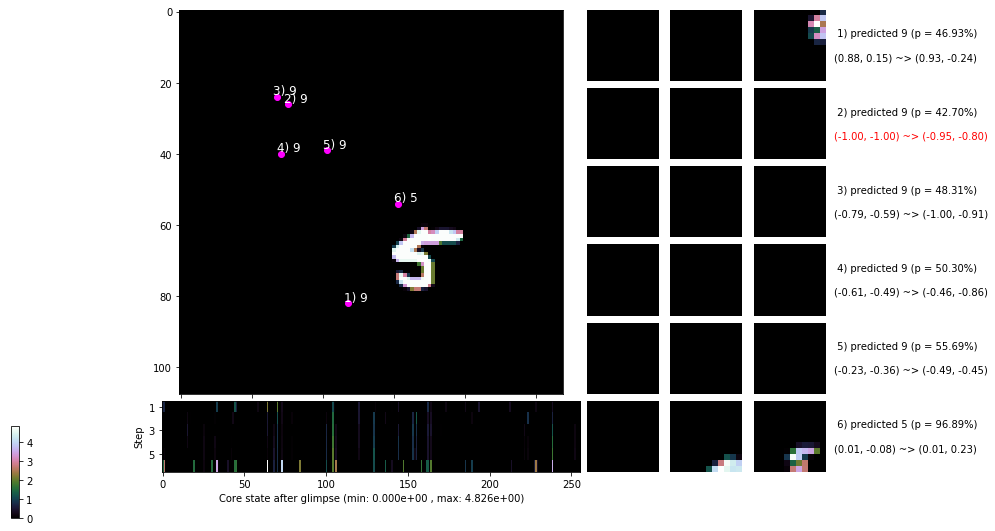

 b   2500/  4000 >> 104.9 ms/b | lr: 5.80e-04 | grad 2norm:  7.65 | grad inf norm:  2.765
       Weights || abs max:  2.34 (67073.99) | mean: -3.10e-02 ( 0.28) | var: 3.70e-02 (6606959.50)
        Biases || abs max:  0.84 (  151.42) | mean: -1.25e-01 ( 0.28) | var: 2.77e-02 (  263.06)
                  class loss: 0.283 | steps: 2.222 | reward:  0.911 | acc.: 91.09%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.0 ms/b | lr: 5.77e-04 | grad 2norm:  8.47 | grad inf norm:  3.092
       Weights || abs max:  2.35 ( 5597.54) | mean: -3.10e-02 ( 0.04) | var: 3.71e-02 ( 2997.65)
        Biases || abs max:  0.84 (  232.79) | mean: -1.26e-01 ( 0.36) | var: 2.81e-02 ( 7874.53)
                  class loss: 0.292 | steps: 2.252 | reward:  0.906 | acc.: 90.65%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

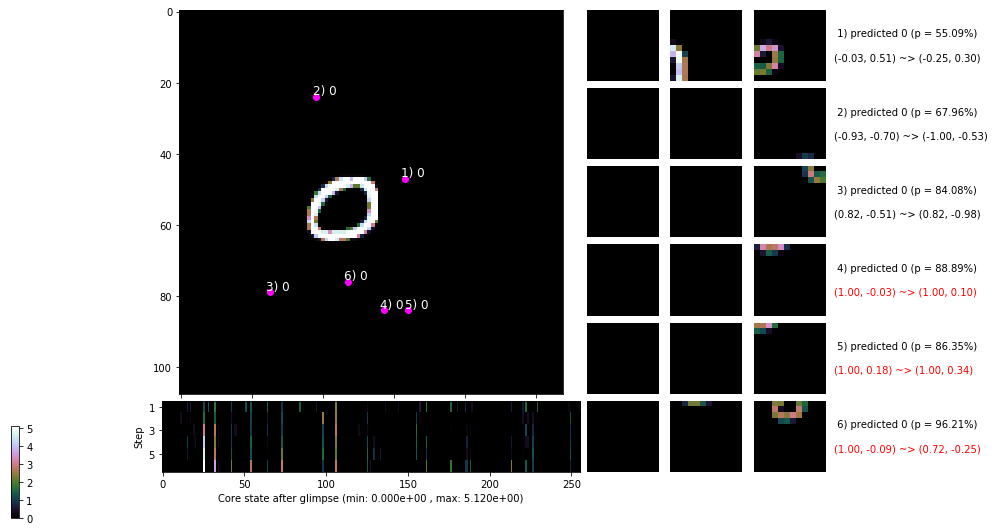

 b   3500/  4000 >> 102.6 ms/b | lr: 5.75e-04 | grad 2norm: 15.32 | grad inf norm:  4.739
       Weights || abs max:  2.35 (11591.60) | mean: -3.11e-02 ( 0.07) | var: 3.73e-02 (67297.88)
        Biases || abs max:  0.84 (  116.75) | mean: -1.26e-01 ( 0.24) | var: 2.85e-02 (  192.66)
                  class loss: 0.292 | steps: 2.286 | reward:  0.906 | acc.: 90.64%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.2 ms/b | lr: 5.73e-04 | grad 2norm:  9.21 | grad inf norm:  3.142
       Weights || abs max:  2.39 ( 3714.78) | mean: -3.10e-02 ( 0.03) | var: 3.74e-02 (  717.26)
        Biases || abs max:  0.84 (  108.58) | mean: -1.27e-01 ( 0.24) | var: 2.85e-02 (  426.77)
                  class loss: 0.296 | steps: 2.309 | reward:  0.906 | acc.: 90.61%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

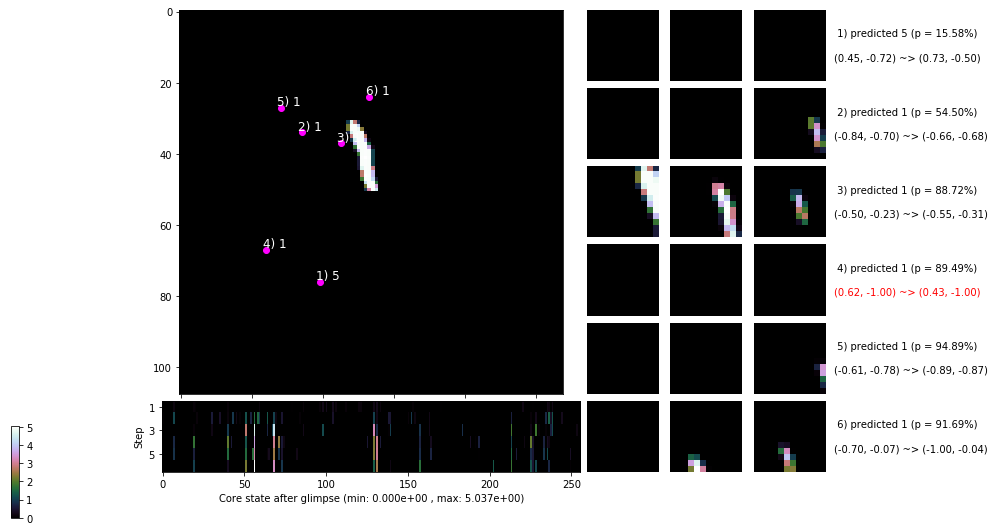

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


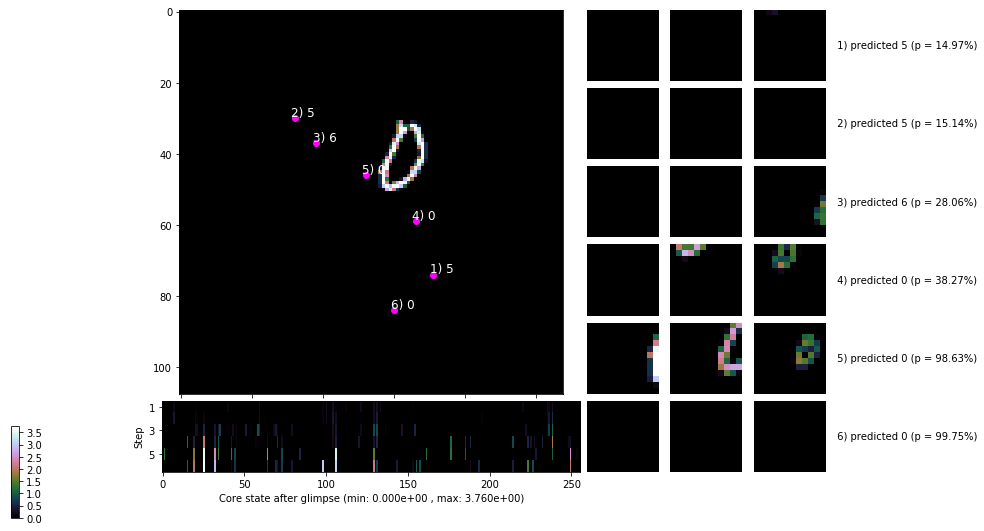


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


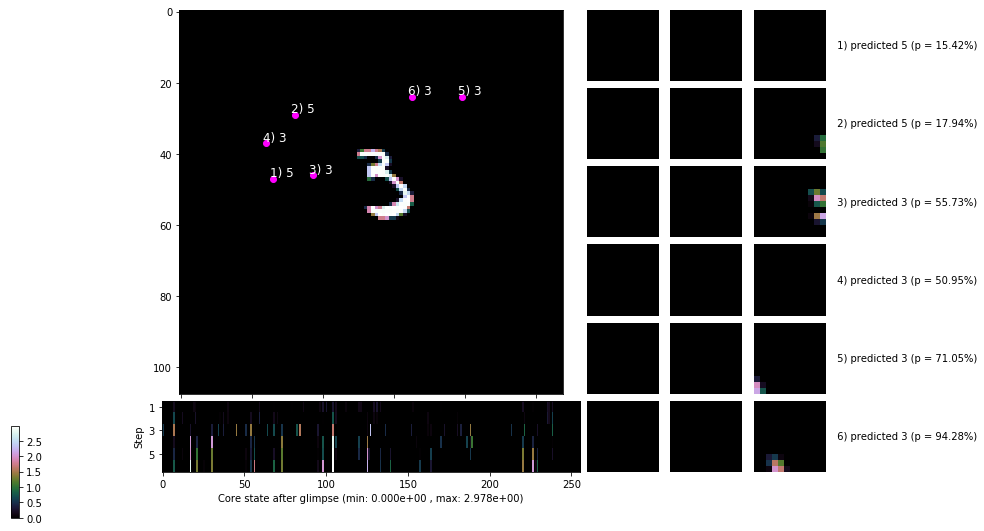

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


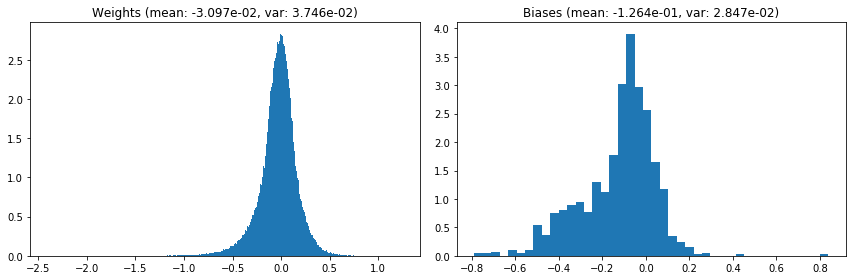

                                      Location network weights and biases


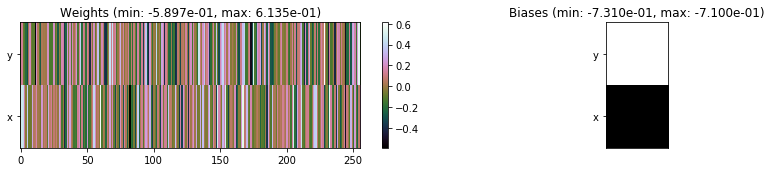

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.92 sec | TRAIN >> class loss: 0.3022 | steps:  2.299    | reward:  0.9040    | acc.: 90.399% 
                          | VAL   >> class loss: 0.2675 | steps:  2.257 :( | reward:  0.9114 :( | acc.: 91.140% :(


Epoch  19/400) lr = 0.0005722
 b    500/  4000 >> 109.7 ms/b | lr: 5.70e-04 | grad 2norm: 43.61 | grad inf norm: 11.626
       Weights || abs max:  2.41 ( 9004.04) | mean: -3.10e-02 ( 0.06) | var: 3.75e-02 (28898.83)
        Biases || abs max:  0.84 (   51.11) | mean: -1.27e-01 ( 0.15) | var: 2.87e-02 (   43.65)
                  class loss: 0.295 | steps: 2.316 | reward:  0.907 | acc.: 90.71%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 109.0 ms/b | lr: 5.68e-04 | grad 2norm: 10.20 | grad inf norm:  3.382
       Weights || abs max:  2.42 ( 7537.99) | mean: -3.11e-02 ( 0.05) | v

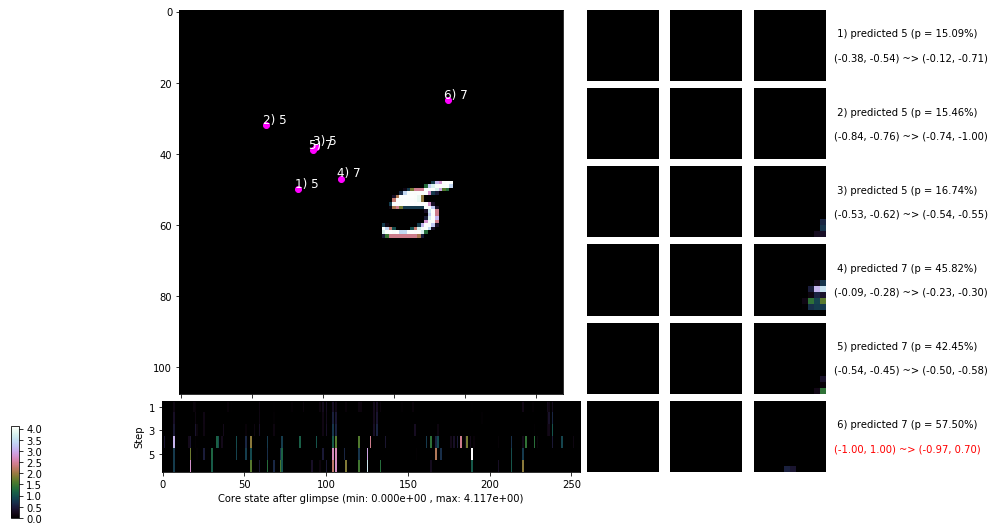

 b   1500/  4000 >> 106.7 ms/b | lr: 5.66e-04 | grad 2norm:  7.81 | grad inf norm:  2.820
       Weights || abs max:  2.42 ( 5115.14) | mean: -3.10e-02 ( 0.04) | var: 3.78e-02 ( 4066.65)
        Biases || abs max:  0.84 (   84.46) | mean: -1.28e-01 ( 0.20) | var: 2.92e-02 (  157.70)
                  class loss: 0.326 | steps: 2.412 | reward:  0.895 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.4 ms/b | lr: 5.64e-04 | grad 2norm:  9.62 | grad inf norm:  3.245
       Weights || abs max:  2.42 (22673.81) | mean: -3.09e-02 ( 0.11) | var: 3.79e-02 (180762.34)
        Biases || abs max:  0.83 (  143.20) | mean: -1.29e-01 ( 0.26) | var: 2.93e-02 (  517.03)
                  class loss: 0.323 | steps: 2.407 | reward:  0.897 | acc.: 89.67%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

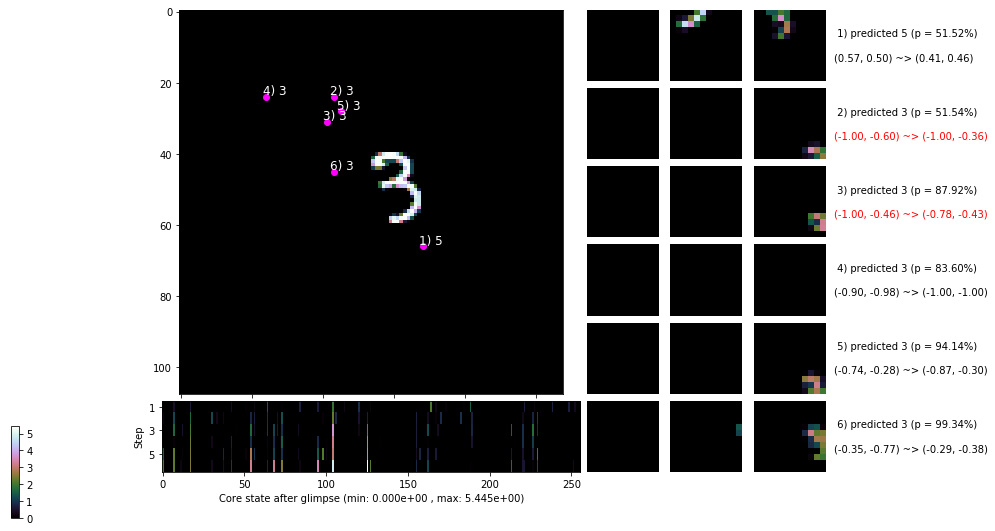

 b   2500/  4000 >> 108.0 ms/b | lr: 5.62e-04 | grad 2norm: 38.68 | grad inf norm:  9.959
       Weights || abs max:  2.42 (14051.91) | mean: -3.10e-02 ( 0.07) | var: 3.80e-02 (172764.22)
        Biases || abs max:  0.84 (  171.75) | mean: -1.30e-01 ( 0.28) | var: 2.96e-02 ( 3699.49)
                  class loss: 0.305 | steps: 2.344 | reward:  0.906 | acc.: 90.56%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.0 ms/b | lr: 5.60e-04 | grad 2norm: 22.32 | grad inf norm:  6.366
       Weights || abs max:  2.42 ( 6586.36) | mean: -3.09e-02 ( 0.04) | var: 3.82e-02 ( 8710.21)
        Biases || abs max:  0.84 (  250.41) | mean: -1.30e-01 ( 0.38) | var: 2.99e-02 ( 3752.24)
                  class loss: 0.286 | steps: 2.322 | reward:  0.909 | acc.: 90.87%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

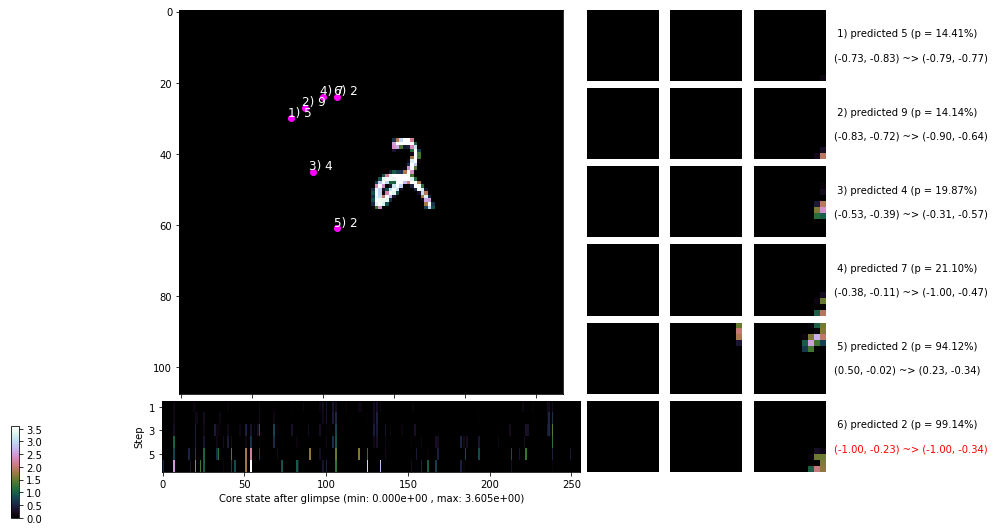

 b   3500/  4000 >> 112.5 ms/b | lr: 5.58e-04 | grad 2norm: 169.18 | grad inf norm: 39.628
       Weights || abs max:  2.44 (12239.04) | mean: -3.09e-02 ( 0.07) | var: 3.83e-02 (110018.63)
        Biases || abs max:  0.85 (  269.05) | mean: -1.30e-01 ( 0.41) | var: 3.00e-02 ( 2126.62)
                  class loss: 0.290 | steps: 2.297 | reward:  0.909 | acc.: 90.93%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.0 ms/b | lr: 5.55e-04 | grad 2norm: 439.32 | grad inf norm: 100.579
       Weights || abs max:  2.45 ( 4877.15) | mean: -3.08e-02 ( 0.04) | var: 3.84e-02 ( 1423.29)
        Biases || abs max:  0.85 (  626.46) | mean: -1.30e-01 ( 0.73) | var: 3.02e-02 (86934.62)
                  class loss: 0.300 | steps: 2.349 | reward:  0.906 | acc.: 90.61%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

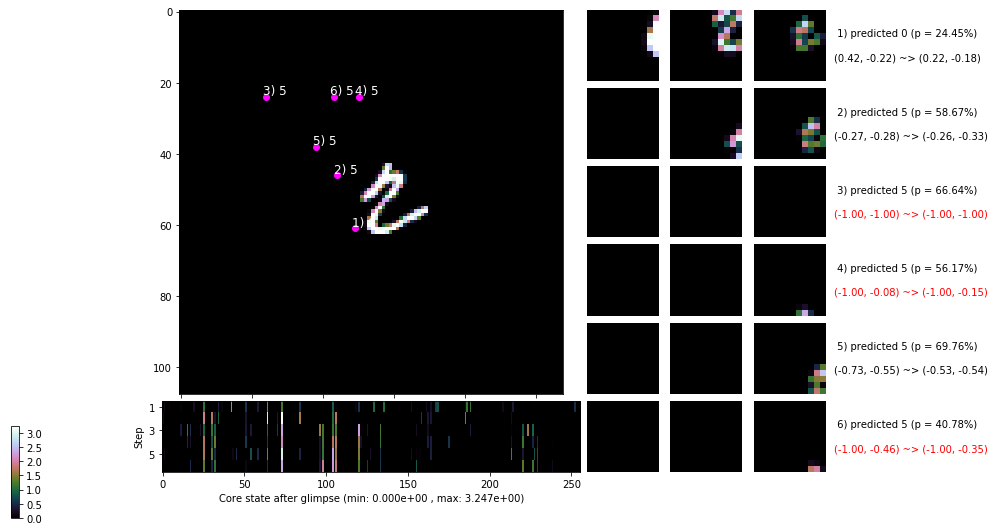

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


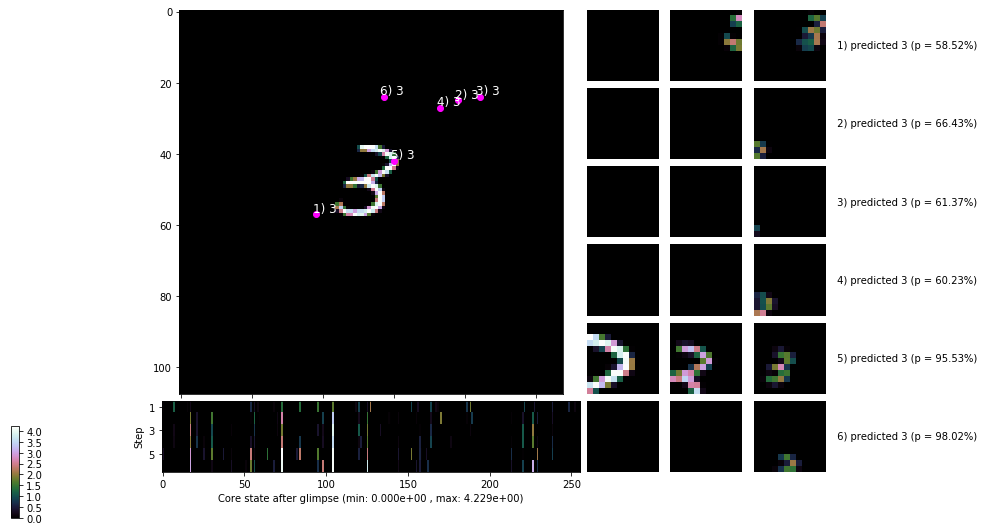


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


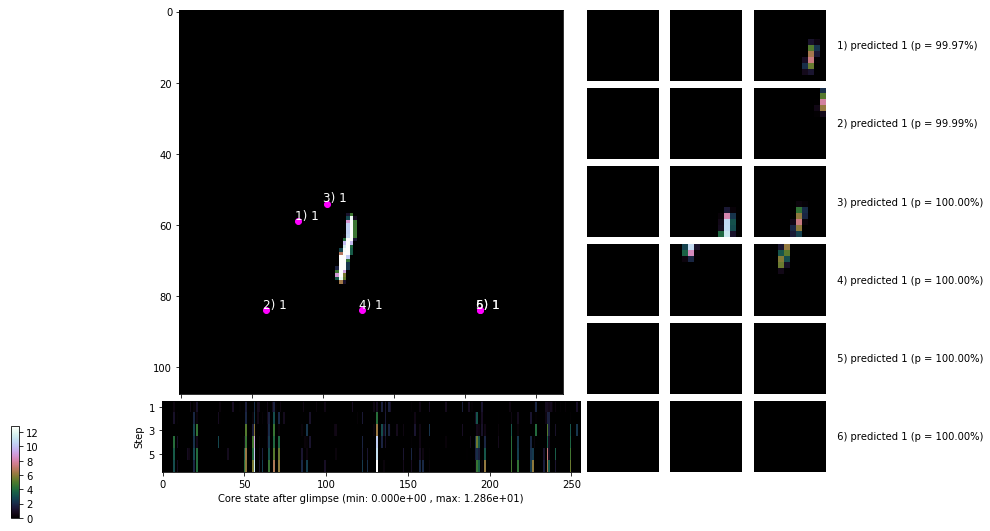

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


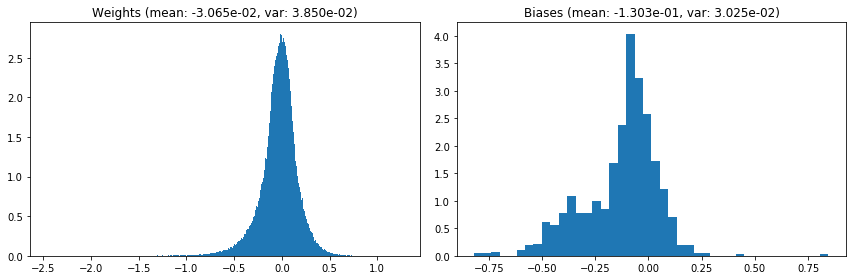

                                      Location network weights and biases


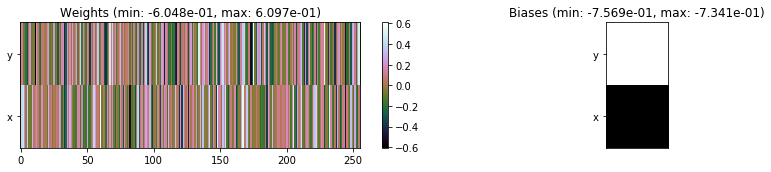

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.76 sec | TRAIN >> class loss: 0.3033 | steps:  2.343 :( | reward:  0.9040 :( | acc.: 90.397% :(
                          | VAL   >> class loss: 0.2694 | steps:  2.298 :( | reward:  0.9136    | acc.: 91.360% 


Epoch  20/400) lr = 0.0005547
 b    500/  4000 >> 109.1 ms/b | lr: 5.53e-04 | grad 2norm: 64.34 | grad inf norm: 16.586
       Weights || abs max:  2.45 ( 6539.80) | mean: -3.07e-02 ( 0.05) | var: 3.86e-02 ( 9558.94)
        Biases || abs max:  0.85 (   94.80) | mean: -1.31e-01 ( 0.21) | var: 3.04e-02 (  132.51)
                  class loss: 0.292 | steps: 2.356 | reward:  0.907 | acc.: 90.67%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 108.3 ms/b | lr: 5.51e-04 | grad 2norm: 121.99 | grad inf norm: 29.978
       Weights || abs max:  2.45 ( 5305.85) | mean: -3.07e-02 ( 0.04) | 

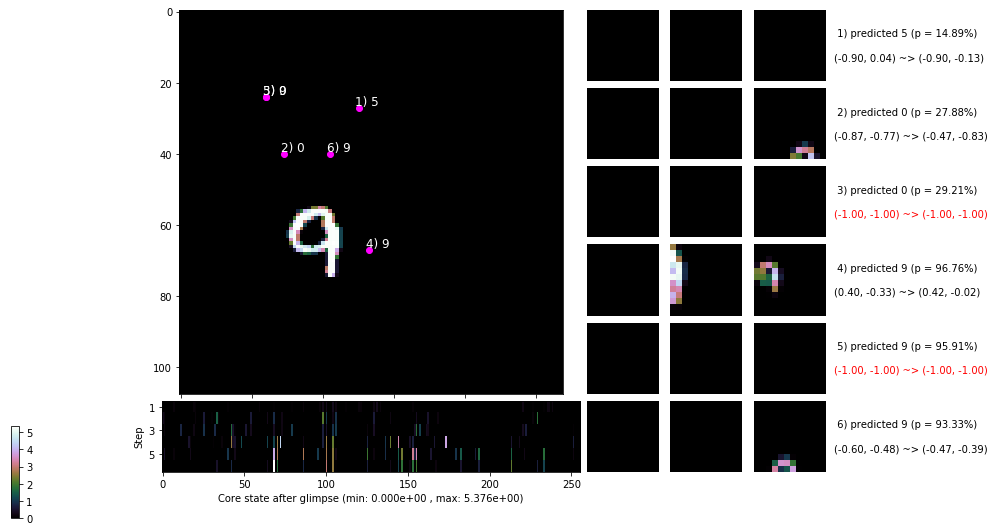

 b   1500/  4000 >> 108.4 ms/b | lr: 5.49e-04 | grad 2norm: 11.37 | grad inf norm:  3.691
       Weights || abs max:  2.47 ( 3624.74) | mean: -3.08e-02 ( 0.03) | var: 3.88e-02 (  678.65)
        Biases || abs max:  0.85 (  283.99) | mean: -1.32e-01 ( 0.58) | var: 3.11e-02 (44318.68)
                  class loss: 0.291 | steps: 2.335 | reward:  0.910 | acc.: 91.03%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.4 ms/b | lr: 5.46e-04 | grad 2norm:  7.57 | grad inf norm:  2.791
       Weights || abs max:  2.48 ( 8851.74) | mean: -3.07e-02 ( 0.05) | var: 3.89e-02 (24815.82)
        Biases || abs max:  0.85 (  128.41) | mean: -1.32e-01 ( 0.28) | var: 3.13e-02 ( 2572.31)
                  class loss: 0.289 | steps: 2.298 | reward:  0.908 | acc.: 90.81%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

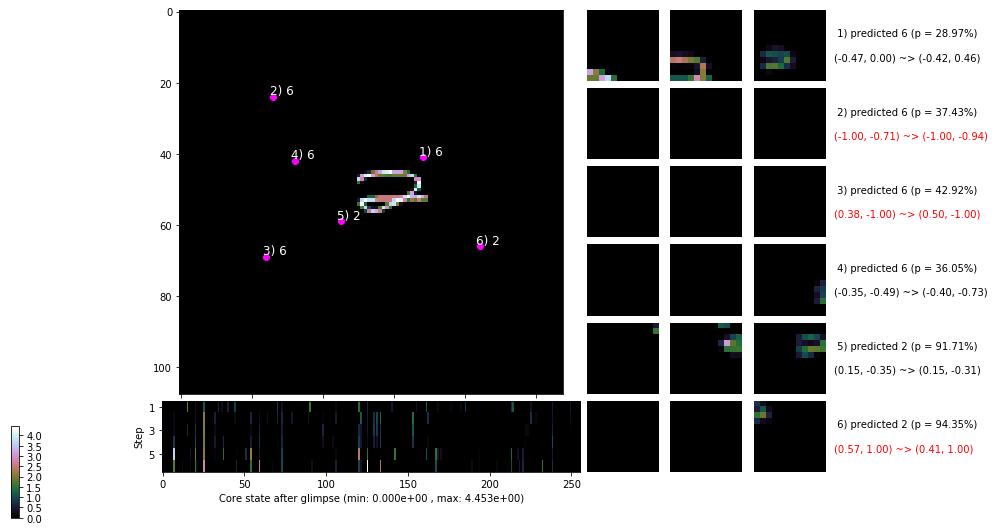

 b   2500/  4000 >> 104.8 ms/b | lr: 5.45e-04 | grad 2norm:  7.64 | grad inf norm:  2.878
       Weights || abs max:  2.49 ( 3844.22) | mean: -3.07e-02 ( 0.03) | var: 3.90e-02 ( 1641.27)
        Biases || abs max:  0.85 (   48.09) | mean: -1.33e-01 ( 0.16) | var: 3.16e-02 (   31.12)
                  class loss: 0.297 | steps: 2.371 | reward:  0.907 | acc.: 90.65%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.7 ms/b | lr: 5.43e-04 | grad 2norm:  7.89 | grad inf norm:  2.873
       Weights || abs max:  2.50 ( 3707.21) | mean: -3.08e-02 ( 0.03) | var: 3.92e-02 ( 1695.65)
        Biases || abs max:  0.84 (  129.79) | mean: -1.33e-01 ( 0.30) | var: 3.18e-02 (  254.62)
                  class loss: 0.308 | steps: 2.425 | reward:  0.900 | acc.: 89.99%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

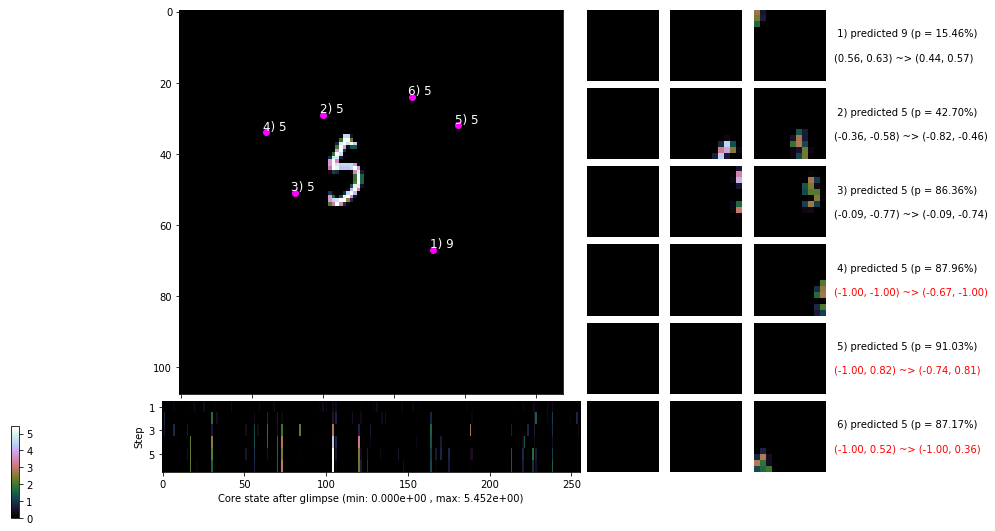

 b   3500/  4000 >> 110.3 ms/b | lr: 5.40e-04 | grad 2norm: 15.46 | grad inf norm:  4.717
       Weights || abs max:  2.51 ( 7596.73) | mean: -3.08e-02 ( 0.05) | var: 3.93e-02 ( 4126.50)
        Biases || abs max:  0.84 (  183.27) | mean: -1.34e-01 ( 0.32) | var: 3.19e-02 ( 1318.25)
                  class loss: 0.307 | steps: 2.362 | reward:  0.904 | acc.: 90.39%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 115.3 ms/b | lr: 5.38e-04 | grad 2norm:  9.15 | grad inf norm:  3.210
       Weights || abs max:  2.53 ( 5938.42) | mean: -3.07e-02 ( 0.04) | var: 3.94e-02 ( 5371.74)
        Biases || abs max:  0.84 (  495.49) | mean: -1.34e-01 ( 0.65) | var: 3.20e-02 (33287.67)
                  class loss: 0.292 | steps: 2.318 | reward:  0.907 | acc.: 90.68%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

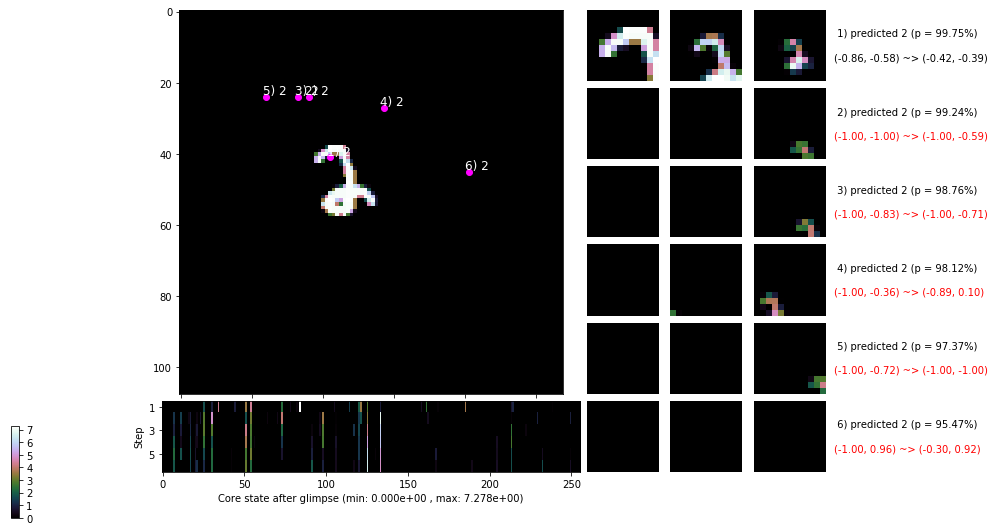

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


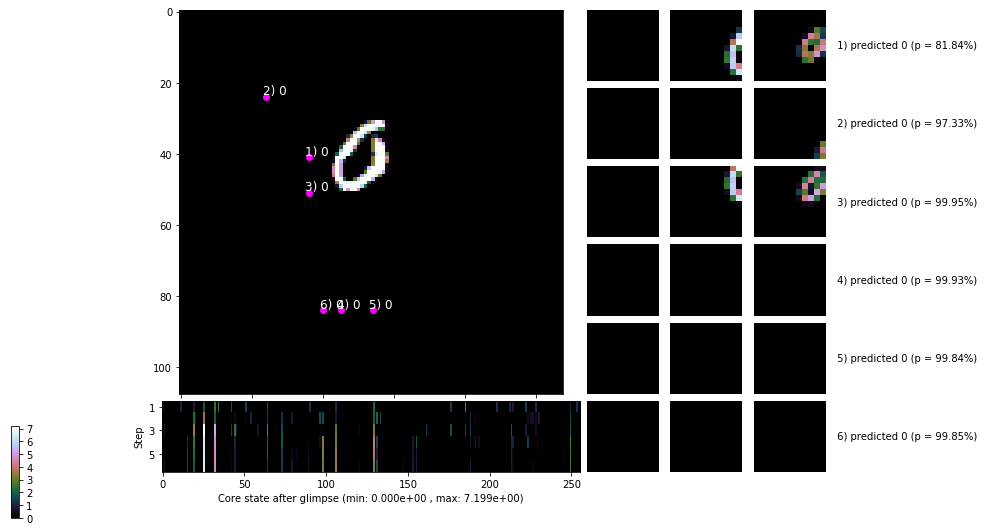


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


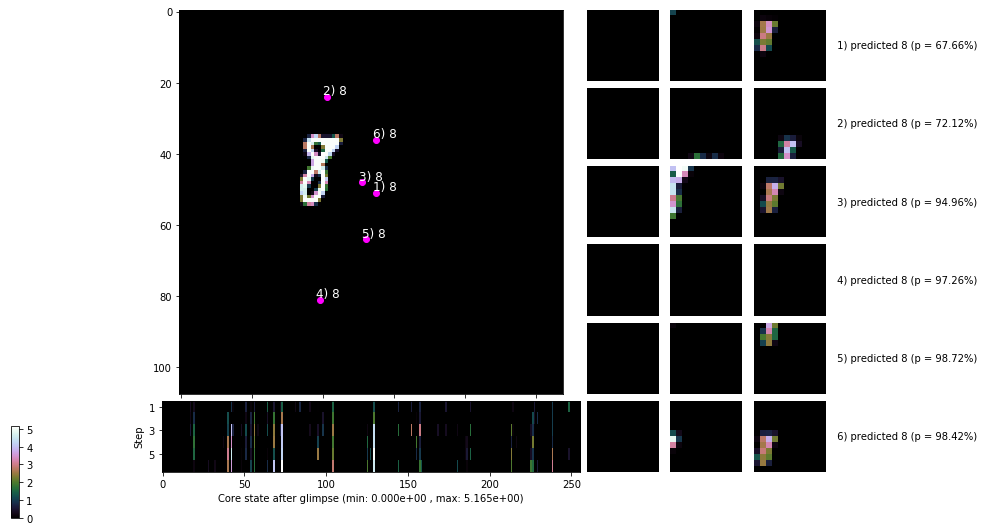

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


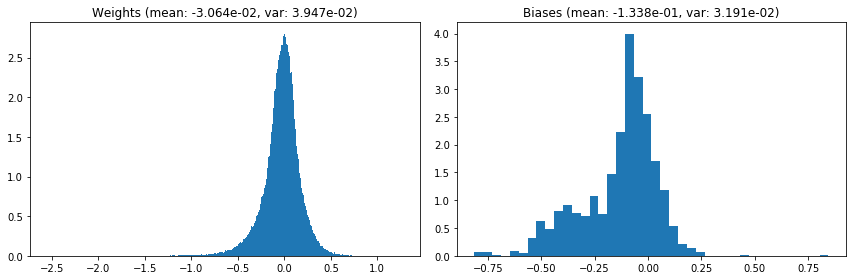

                                      Location network weights and biases


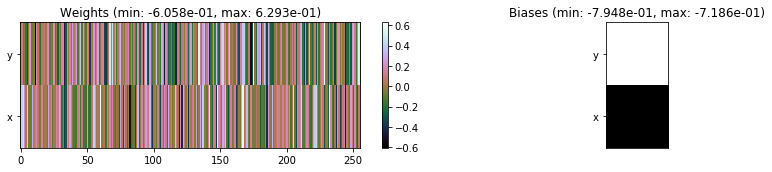

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.22 sec | TRAIN >> class loss: 0.2963 | steps:  2.351 :( | reward:  0.9063    | acc.: 90.631% 
                          | VAL   >> class loss: 0.3014 | steps:  2.268 :( | reward:  0.9120 :( | acc.: 91.200% :(


Epoch  21/400) lr = 0.0005378
 b    500/  4000 >> 105.9 ms/b | lr: 5.36e-04 | grad 2norm:  9.81 | grad inf norm:  3.332
       Weights || abs max:  2.55 (11987.97) | mean: -3.06e-02 ( 0.07) | var: 3.95e-02 (38565.62)
        Biases || abs max:  0.85 (  167.28) | mean: -1.34e-01 ( 0.30) | var: 3.22e-02 (  921.58)
                  class loss: 0.292 | steps: 2.333 | reward:  0.910 | acc.: 90.99%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 108.6 ms/b | lr: 5.34e-04 | grad 2norm: 12.89 | grad inf norm:  3.592
       Weights || abs max:  2.55 ( 4353.94) | mean: -3.05e-02 ( 0.04) | v

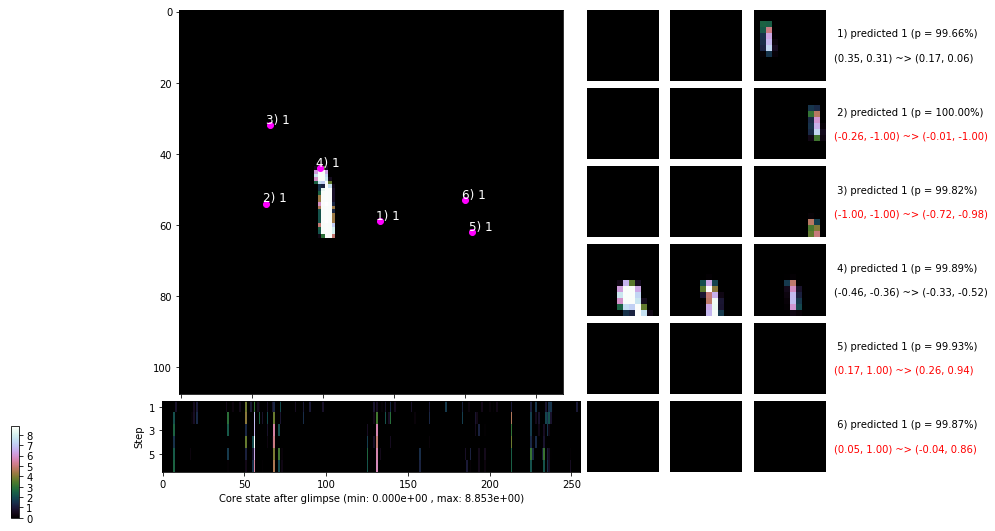

 b   1500/  4000 >> 111.4 ms/b | lr: 5.32e-04 | grad 2norm:  7.56 | grad inf norm:  2.835
       Weights || abs max:  2.55 (23610.37) | mean: -3.08e-02 ( 0.11) | var: 3.97e-02 (203890.92)
        Biases || abs max:  0.85 (  201.05) | mean: -1.36e-01 ( 0.31) | var: 3.32e-02 ( 2111.89)
                  class loss: 0.280 | steps: 2.336 | reward:  0.911 | acc.: 91.11%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 107.5 ms/b | lr: 5.30e-04 | grad 2norm:  7.98 | grad inf norm:  2.932
       Weights || abs max:  2.55 ( 5380.80) | mean: -3.08e-02 ( 0.04) | var: 3.98e-02 ( 5185.20)
        Biases || abs max:  0.85 (  127.36) | mean: -1.36e-01 ( 0.26) | var: 3.33e-02 (  426.91)
                  class loss: 0.301 | steps: 2.355 | reward:  0.906 | acc.: 90.61%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

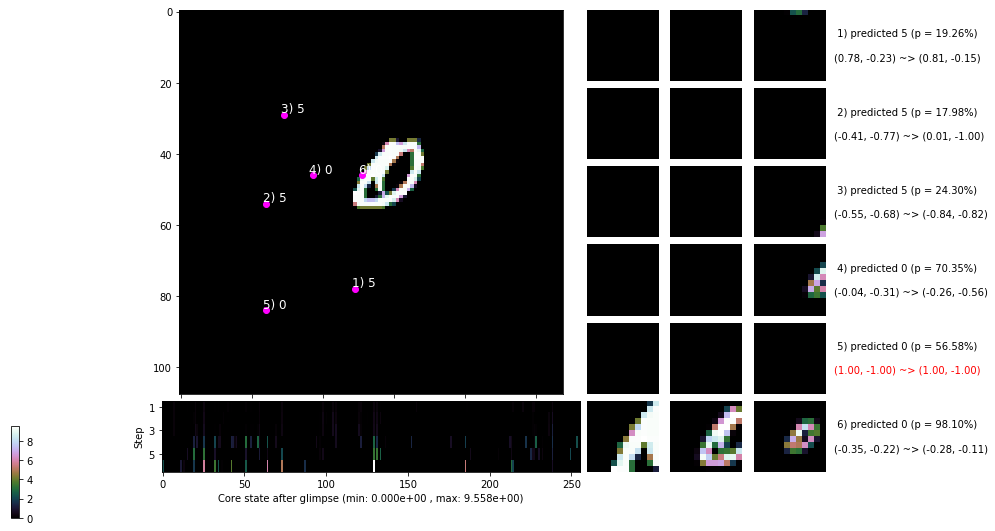

 b   2500/  4000 >> 104.2 ms/b | lr: 5.28e-04 | grad 2norm:  7.51 | grad inf norm:  2.836
       Weights || abs max:  2.55 ( 5331.86) | mean: -3.08e-02 ( 0.04) | var: 4.00e-02 ( 1963.29)
        Biases || abs max:  0.85 (  362.13) | mean: -1.36e-01 ( 0.51) | var: 3.37e-02 (12366.24)
                  class loss: 0.291 | steps: 2.345 | reward:  0.909 | acc.: 90.86%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.8 ms/b | lr: 5.26e-04 | grad 2norm:  7.49 | grad inf norm:  2.825
       Weights || abs max:  2.56 ( 4532.02) | mean: -3.09e-02 ( 0.04) | var: 4.01e-02 (  930.83)
        Biases || abs max:  0.85 (  114.34) | mean: -1.37e-01 ( 0.27) | var: 3.40e-02 (  148.62)
                  class loss: 0.292 | steps: 2.337 | reward:  0.909 | acc.: 90.88%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

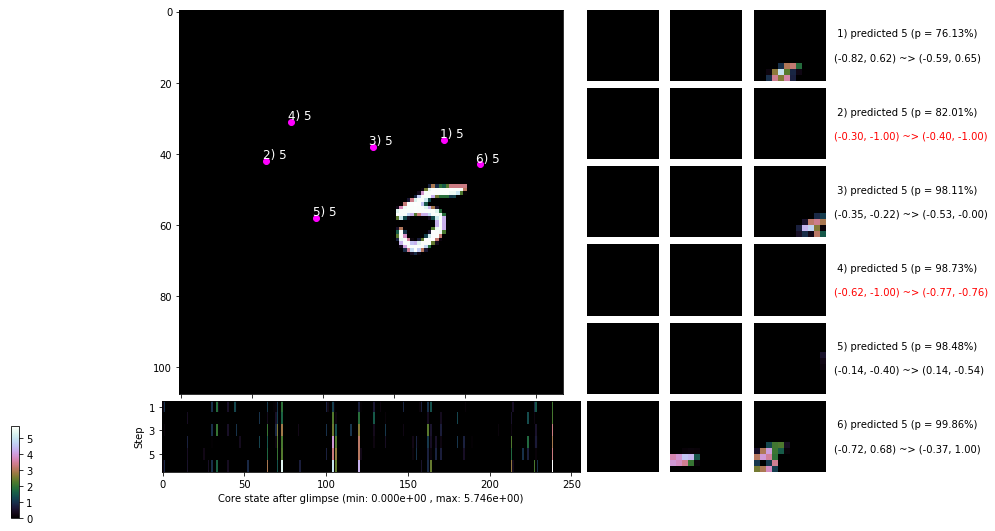

 b   3500/  4000 >> 105.4 ms/b | lr: 5.24e-04 | grad 2norm:  7.52 | grad inf norm:  2.815
       Weights || abs max:  2.56 (27082.15) | mean: -3.10e-02 ( 0.12) | var: 4.02e-02 (982718.88)
        Biases || abs max:  0.85 (  610.71) | mean: -1.38e-01 ( 0.75) | var: 3.43e-02 (58769.07)
                  class loss: 0.286 | steps: 2.320 | reward:  0.911 | acc.: 91.08%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 106.4 ms/b | lr: 5.22e-04 | grad 2norm:  7.36 | grad inf norm:  2.695
       Weights || abs max:  2.56 ( 5139.97) | mean: -3.10e-02 ( 0.04) | var: 4.03e-02 ( 1440.33)
        Biases || abs max:  0.85 (  311.71) | mean: -1.38e-01 ( 0.47) | var: 3.47e-02 ( 4740.29)
                  class loss: 0.288 | steps: 2.328 | reward:  0.912 | acc.: 91.23%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

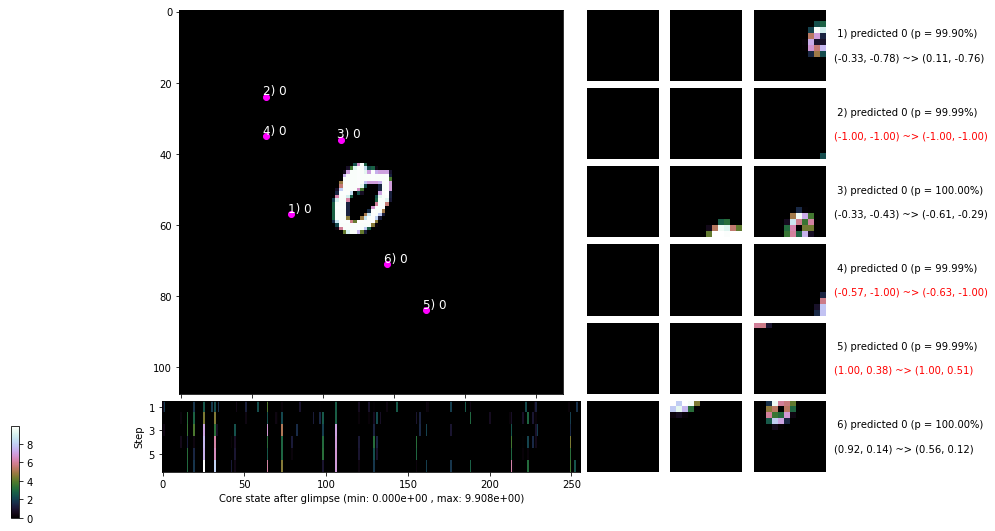

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


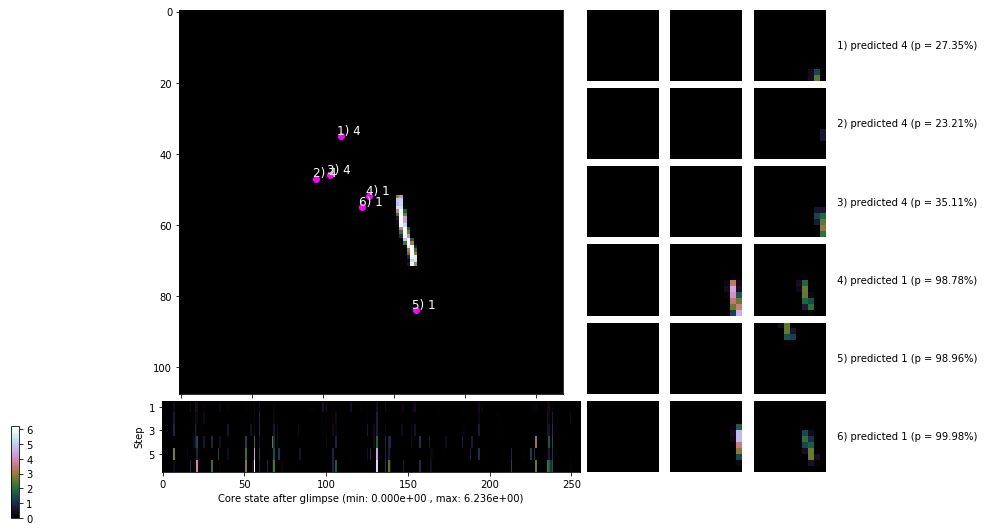


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


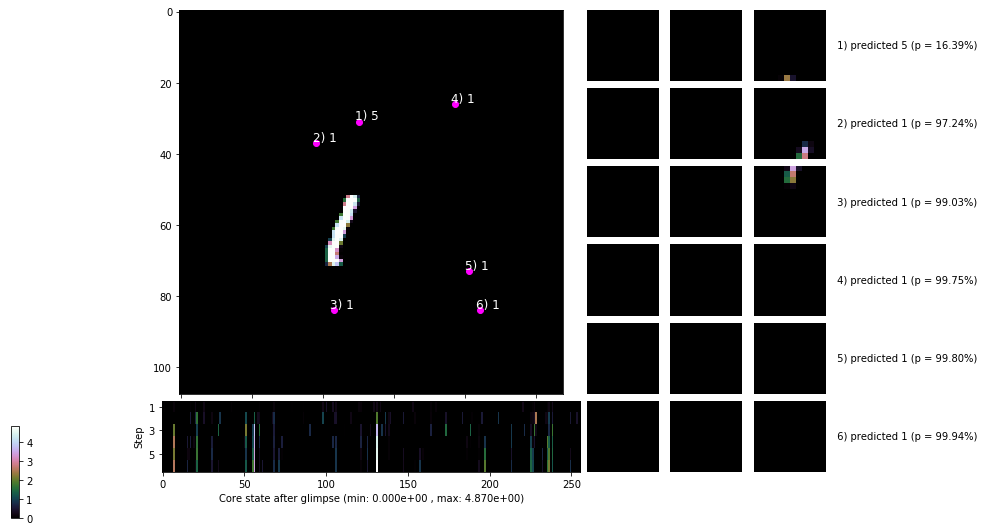

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


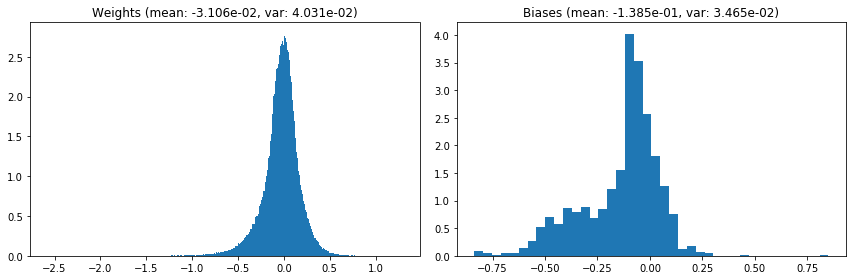

                                      Location network weights and biases


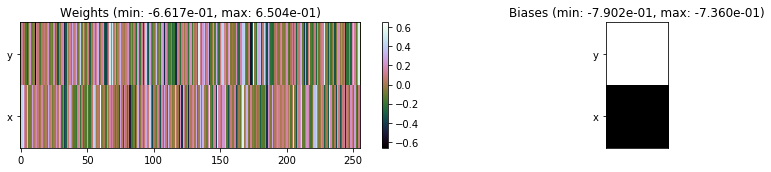

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.74 sec | TRAIN >> class loss: 0.3043 | steps:  2.340 :( | reward:  0.9095    | acc.: 90.955% 
                          | VAL   >> class loss: 0.2534 | steps:  2.257 :( | reward:  0.9198    | acc.: 91.980% 


Epoch  22/400) lr = 0.0005214
 b    500/  4000 >> 108.7 ms/b | lr: 5.20e-04 | grad 2norm:  7.45 | grad inf norm:  2.814
       Weights || abs max:  2.58 (19103.13) | mean: -3.11e-02 ( 0.09) | var: 4.04e-02 (218580.12)
        Biases || abs max:  0.86 (  119.87) | mean: -1.39e-01 ( 0.25) | var: 3.47e-02 (  159.29)
                  class loss: 0.267 | steps: 2.288 | reward:  0.917 | acc.: 91.70%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 114.0 ms/b | lr: 5.18e-04 | grad 2norm:  7.38 | grad inf norm:  2.691
       Weights || abs max:  2.58 (11617.26) | mean: -3.09e-02 ( 0.06) | va

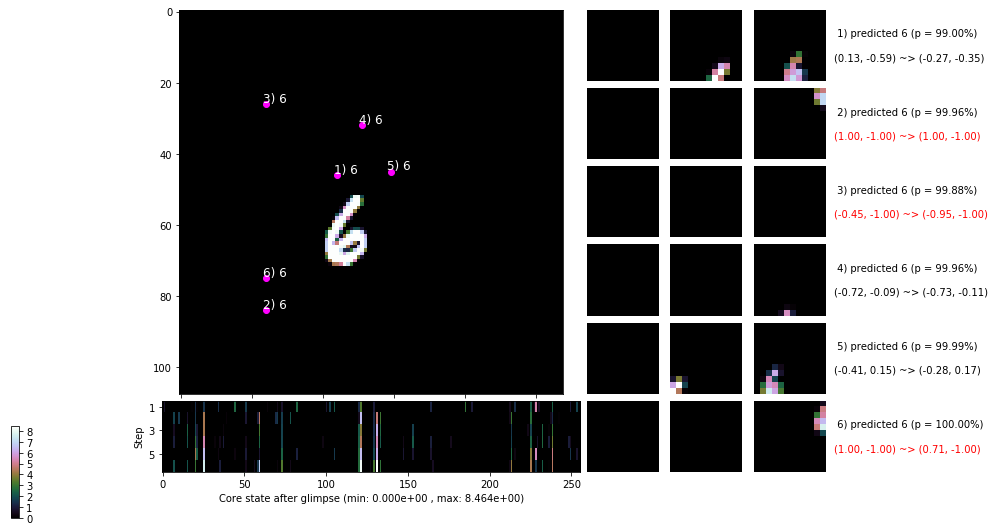

 b   1500/  4000 >> 111.5 ms/b | lr: 5.16e-04 | grad 2norm:  7.50 | grad inf norm:  2.787
       Weights || abs max:  2.58 ( 4435.05) | mean: -3.09e-02 ( 0.04) | var: 4.06e-02 ( 1631.67)
        Biases || abs max:  0.85 (  179.87) | mean: -1.39e-01 ( 0.34) | var: 3.51e-02 ( 1098.58)
                  class loss: 0.298 | steps: 2.367 | reward:  0.902 | acc.: 90.19%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 107.6 ms/b | lr: 5.14e-04 | grad 2norm:  7.89 | grad inf norm:  2.885
       Weights || abs max:  2.58 ( 5830.78) | mean: -3.07e-02 ( 0.04) | var: 4.07e-02 ( 8399.34)
        Biases || abs max:  0.85 (   94.06) | mean: -1.39e-01 ( 0.23) | var: 3.52e-02 (   65.64)
                  class loss: 0.297 | steps: 2.349 | reward:  0.907 | acc.: 90.68%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

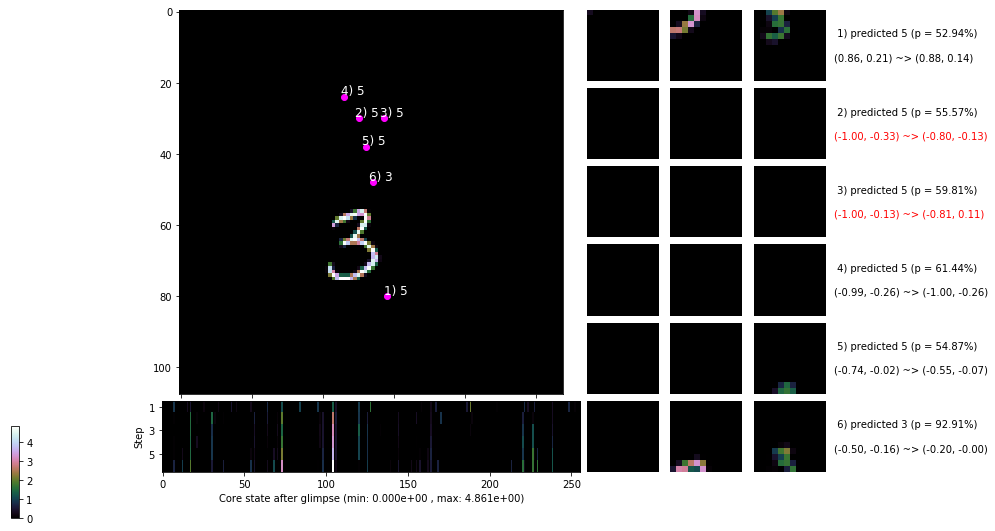

 b   2500/  4000 >> 105.0 ms/b | lr: 5.12e-04 | grad 2norm:  7.68 | grad inf norm:  2.917
       Weights || abs max:  2.58 ( 3842.60) | mean: -3.06e-02 ( 0.03) | var: 4.08e-02 (  655.67)
        Biases || abs max:  0.84 (  160.45) | mean: -1.39e-01 ( 0.31) | var: 3.52e-02 (  799.71)
                  class loss: 0.315 | steps: 2.370 | reward:  0.900 | acc.: 89.97%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.3 ms/b | lr: 5.10e-04 | grad 2norm:  7.71 | grad inf norm:  2.840
       Weights || abs max:  2.58 ( 5399.81) | mean: -3.05e-02 ( 0.04) | var: 4.09e-02 ( 3474.08)
        Biases || abs max:  0.84 (   59.77) | mean: -1.39e-01 ( 0.19) | var: 3.55e-02 (   24.11)
                  class loss: 0.319 | steps: 2.374 | reward:  0.897 | acc.: 89.69%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

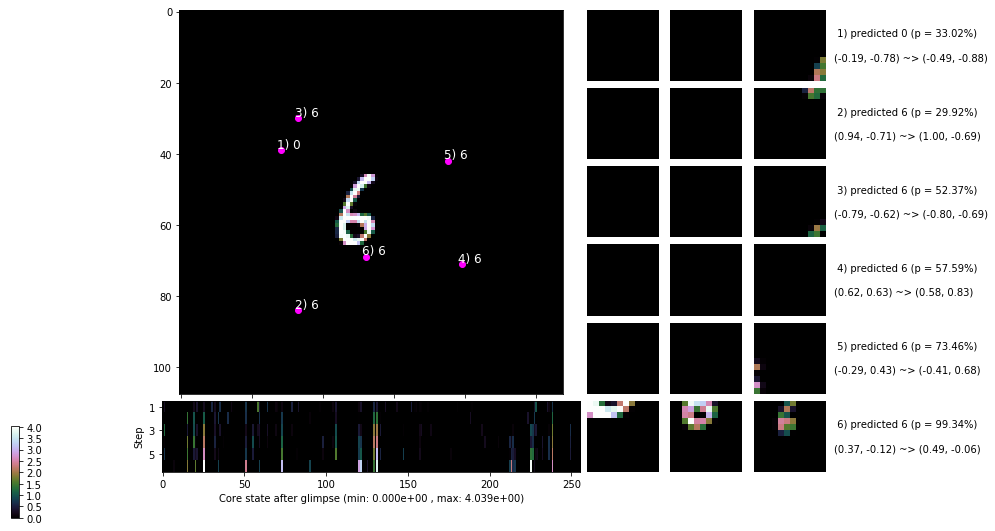

 b   3500/  4000 >> 106.2 ms/b | lr: 5.08e-04 | grad 2norm:  7.64 | grad inf norm:  2.863
       Weights || abs max:  2.59 ( 4898.82) | mean: -3.04e-02 ( 0.04) | var: 4.11e-02 ( 3024.48)
        Biases || abs max:  0.84 ( 1173.15) | mean: -1.39e-01 ( 1.30) | var: 3.56e-02 (483785.09)
                  class loss: 0.309 | steps: 2.366 | reward:  0.900 | acc.: 90.05%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.1 ms/b | lr: 5.06e-04 | grad 2norm:  9.68 | grad inf norm:  3.354
       Weights || abs max:  2.60 ( 8074.51) | mean: -3.04e-02 ( 0.05) | var: 4.12e-02 (13997.55)
        Biases || abs max:  0.85 (   87.61) | mean: -1.39e-01 ( 0.20) | var: 3.57e-02 (  497.83)
                  class loss: 0.289 | steps: 2.322 | reward:  0.909 | acc.: 90.94%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

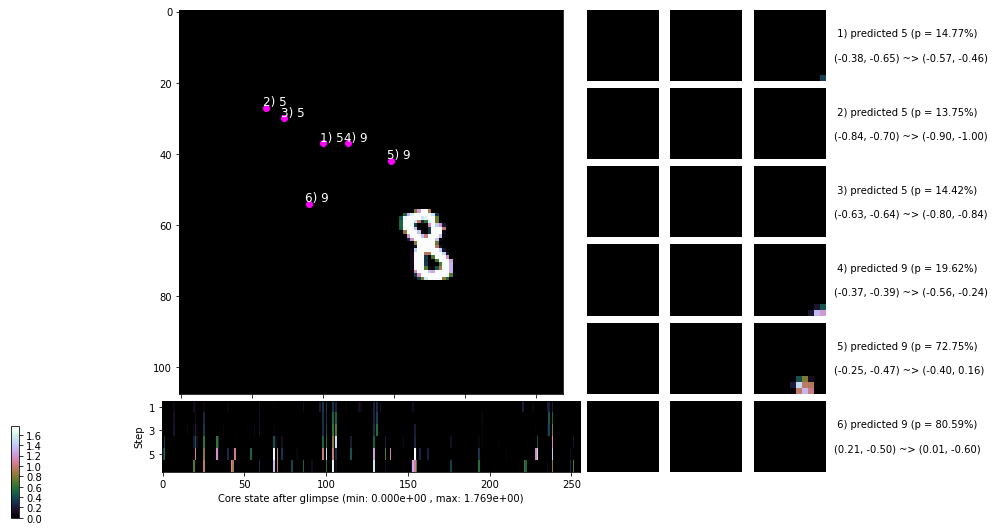

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


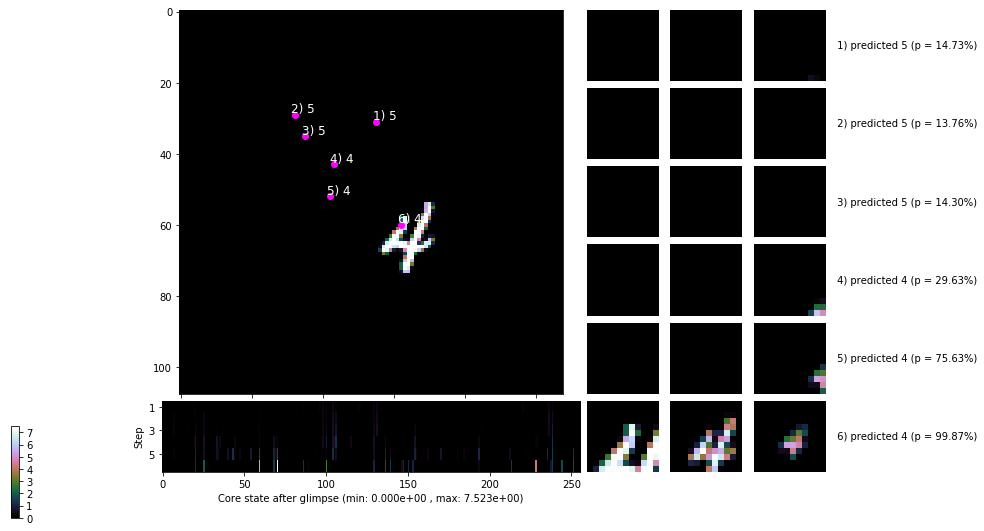


	Target class: 2  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


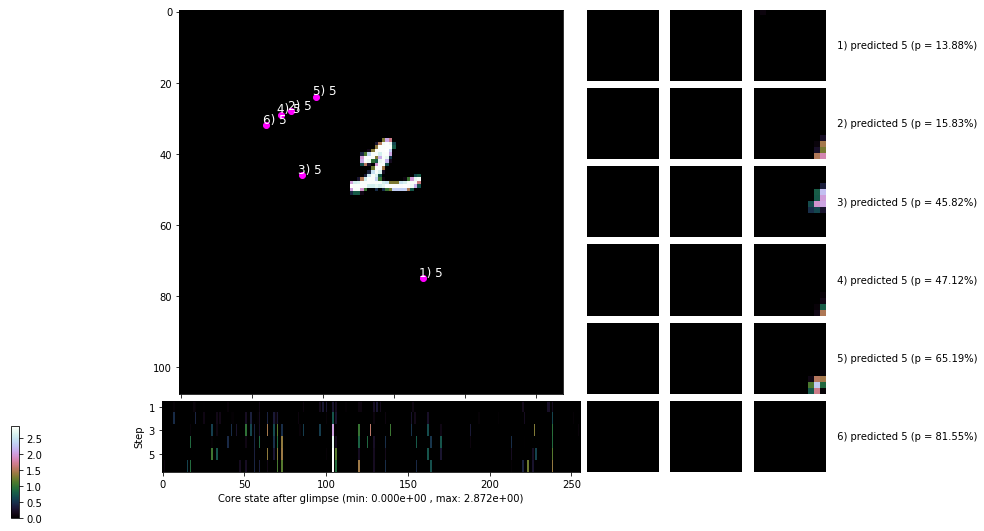

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


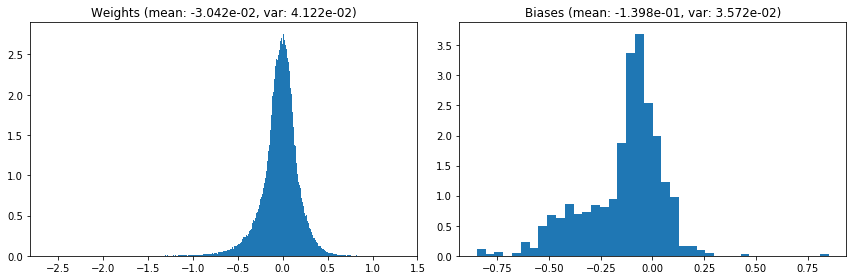

                                      Location network weights and biases


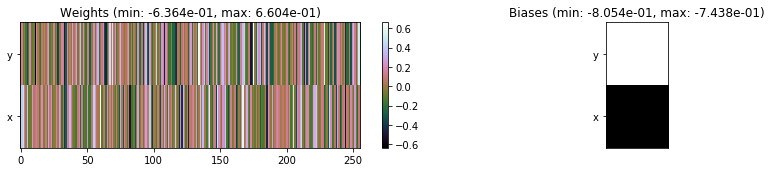

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.28 sec | TRAIN >> class loss: 0.2974 | steps:  2.348 :( | reward:  0.9052 :( | acc.: 90.525% :(
                          | VAL   >> class loss: 0.2666 | steps:  2.293 :( | reward:  0.9162 :( | acc.: 91.620% :(


Epoch  23/400) lr = 0.0005054
 b    500/  4000 >> 100.9 ms/b | lr: 5.04e-04 | grad 2norm:  7.80 | grad inf norm:  2.919
       Weights || abs max:  2.62 ( 5750.62) | mean: -3.04e-02 ( 0.04) | var: 4.13e-02 ( 4349.33)
        Biases || abs max:  0.85 (  108.08) | mean: -1.40e-01 ( 0.24) | var: 3.58e-02 (  152.55)
                  class loss: 0.292 | steps: 2.299 | reward:  0.912 | acc.: 91.15%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.7 ms/b | lr: 5.02e-04 | grad 2norm:  7.62 | grad inf norm:  2.881
       Weights || abs max:  2.62 ( 8592.42) | mean: -3.04e-02 ( 0.05) |

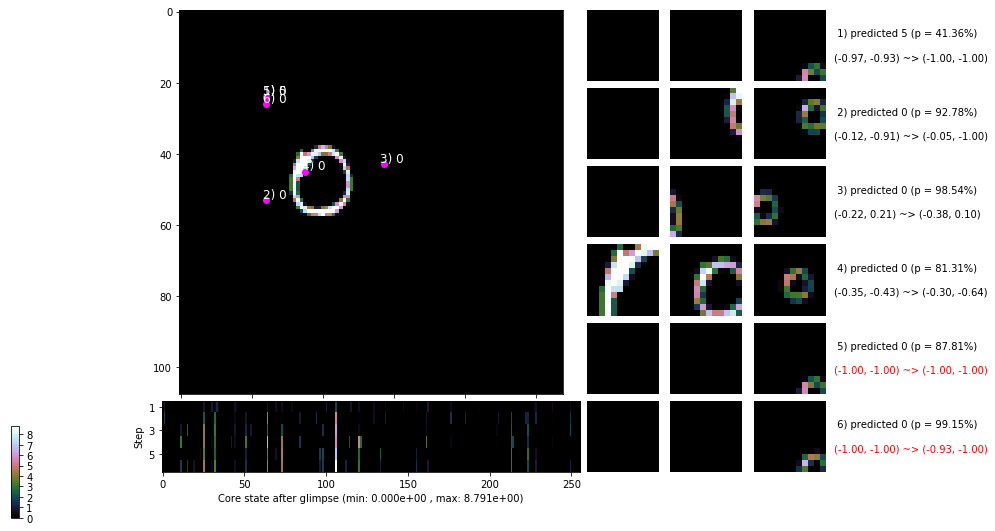

 b   1500/  4000 >> 112.8 ms/b | lr: 5.00e-04 | grad 2norm:  7.72 | grad inf norm:  2.882
       Weights || abs max:  2.62 ( 5110.17) | mean: -3.03e-02 ( 0.04) | var: 4.15e-02 ( 2122.35)
        Biases || abs max:  0.85 (  465.85) | mean: -1.40e-01 ( 0.59) | var: 3.62e-02 (17435.09)
                  class loss: 0.294 | steps: 2.317 | reward:  0.906 | acc.: 90.59%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 106.0 ms/b | lr: 4.98e-04 | grad 2norm: 15.31 | grad inf norm:  4.844
       Weights || abs max:  2.62 ( 6264.43) | mean: -3.02e-02 ( 0.04) | var: 4.16e-02 ( 5439.11)
        Biases || abs max:  0.85 (  191.14) | mean: -1.41e-01 ( 0.33) | var: 3.62e-02 ( 1619.23)
                  class loss: 0.290 | steps: 2.342 | reward:  0.908 | acc.: 90.79%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

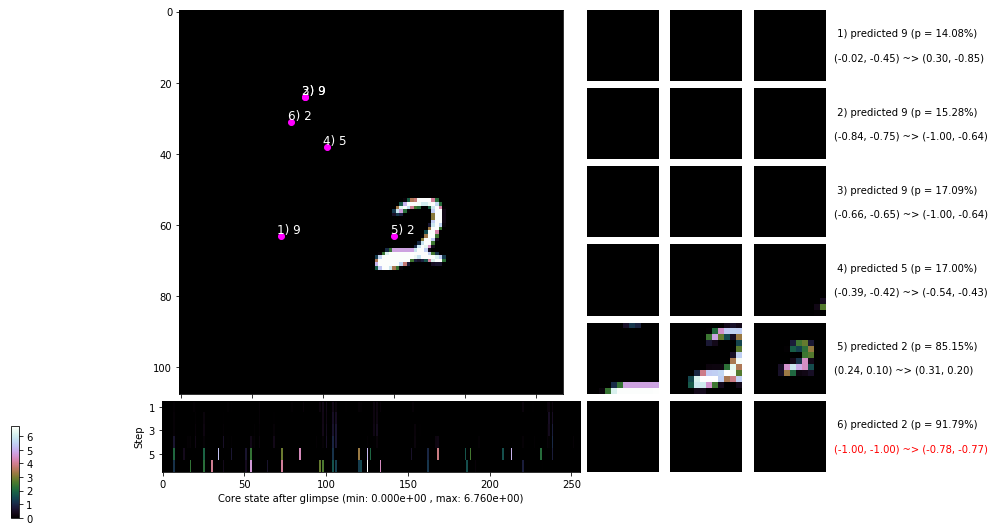

 b   2500/  4000 >> 113.8 ms/b | lr: 4.96e-04 | grad 2norm: 93.95 | grad inf norm: 24.762
       Weights || abs max:  2.63 ( 3046.85) | mean: -3.01e-02 ( 0.03) | var: 4.17e-02 (  296.42)
        Biases || abs max:  0.85 (  115.14) | mean: -1.41e-01 ( 0.23) | var: 3.63e-02 (  229.65)
                  class loss: 0.278 | steps: 2.287 | reward:  0.911 | acc.: 91.08%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.9 ms/b | lr: 4.94e-04 | grad 2norm: 21.30 | grad inf norm:  6.678
       Weights || abs max:  2.64 ( 7992.48) | mean: -3.02e-02 ( 0.05) | var: 4.18e-02 ( 8955.00)
        Biases || abs max:  0.85 (  211.88) | mean: -1.41e-01 ( 0.36) | var: 3.67e-02 ( 3800.00)
                  class loss: 0.270 | steps: 2.268 | reward:  0.912 | acc.: 91.25%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

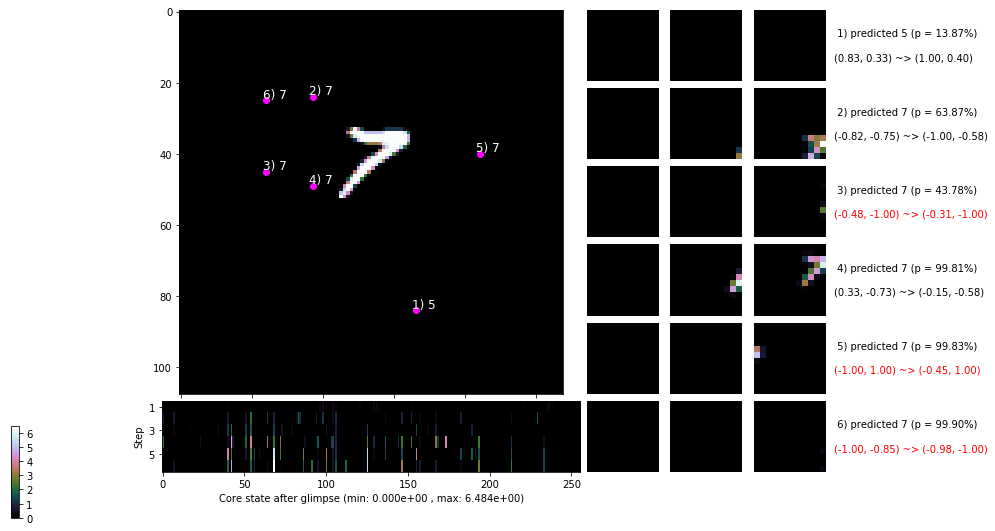

 b   3500/  4000 >> 114.7 ms/b | lr: 4.92e-04 | grad 2norm: 18.90 | grad inf norm:  5.942
       Weights || abs max:  2.66 ( 7778.60) | mean: -3.02e-02 ( 0.05) | var: 4.19e-02 ( 5887.98)
        Biases || abs max:  0.86 (  181.92) | mean: -1.42e-01 ( 0.32) | var: 3.69e-02 ( 1121.37)
                  class loss: 0.281 | steps: 2.256 | reward:  0.911 | acc.: 91.07%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.5 ms/b | lr: 4.90e-04 | grad 2norm:  9.68 | grad inf norm:  3.430
       Weights || abs max:  2.67 ( 4530.04) | mean: -3.03e-02 ( 0.04) | var: 4.20e-02 ( 1820.44)
        Biases || abs max:  0.86 ( 2861.25) | mean: -1.42e-01 ( 5.58) | var: 3.70e-02 (7421848.50)
                  class loss: 0.268 | steps: 2.285 | reward:  0.915 | acc.: 91.45%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

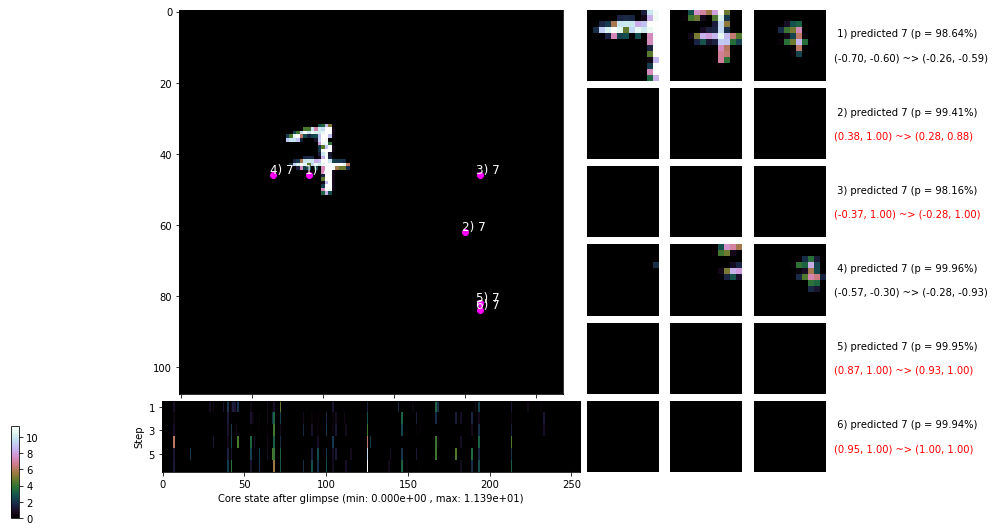

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


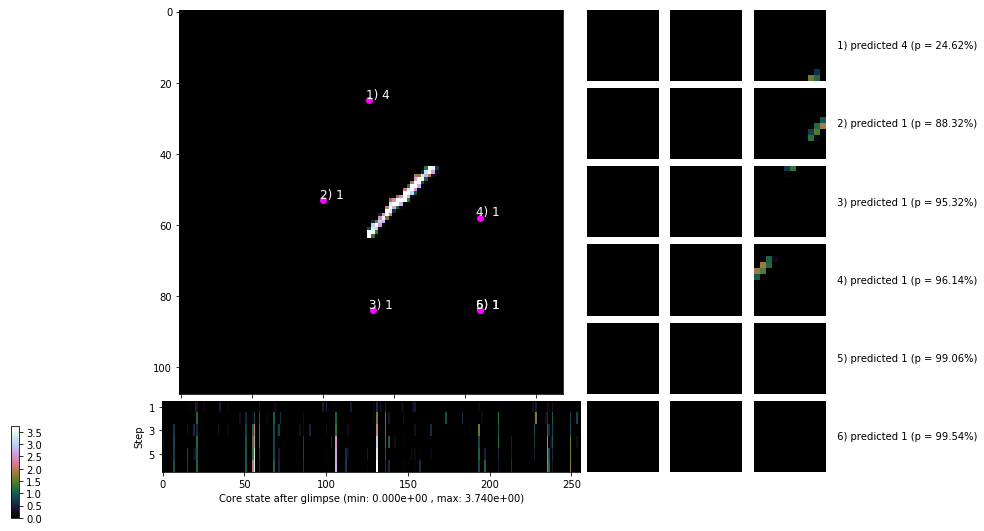


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


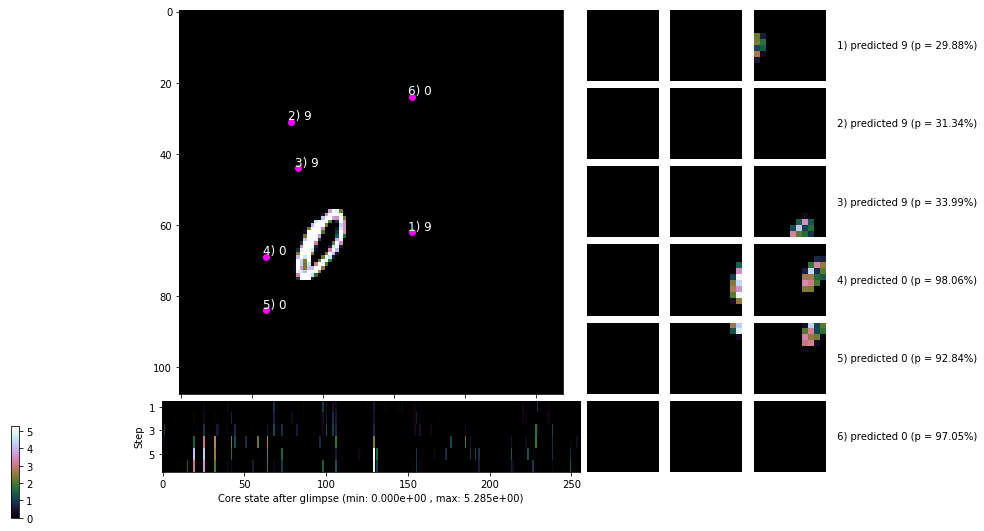

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


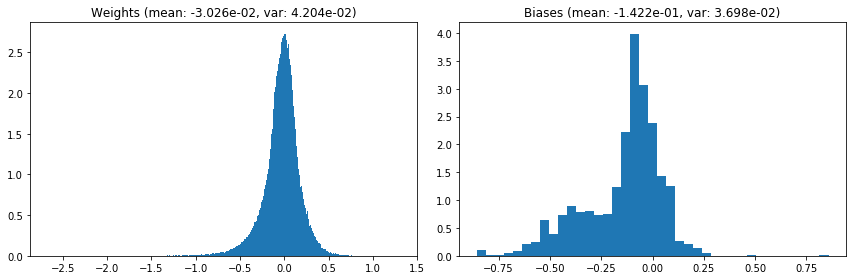

                                      Location network weights and biases


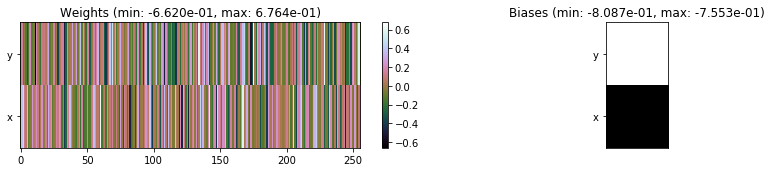

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.79 sec | TRAIN >> class loss: 0.2821 | steps:  2.291    | reward:  0.9107    | acc.: 91.067% 
                          | VAL   >> class loss: 0.2339 | steps:  2.193    | reward:  0.9276    | acc.: 92.760% 


Epoch  24/400) lr = 0.00049
 b    500/  4000 >> 110.0 ms/b | lr: 4.89e-04 | grad 2norm: 550.84 | grad inf norm: 144.034
       Weights || abs max:  2.68 ( 9495.47) | mean: -3.02e-02 ( 0.06) | var: 4.21e-02 (58769.31)
        Biases || abs max:  0.86 (  129.85) | mean: -1.42e-01 ( 0.26) | var: 3.71e-02 (  413.13)
                  class loss: 0.275 | steps: 2.260 | reward:  0.912 | acc.: 91.23%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 106.4 ms/b | lr: 4.87e-04 | grad 2norm: 11.28 | grad inf norm:  3.818
       Weights || abs max:  2.68 ( 9087.20) | mean: -3.02e-02 ( 0.06) | var

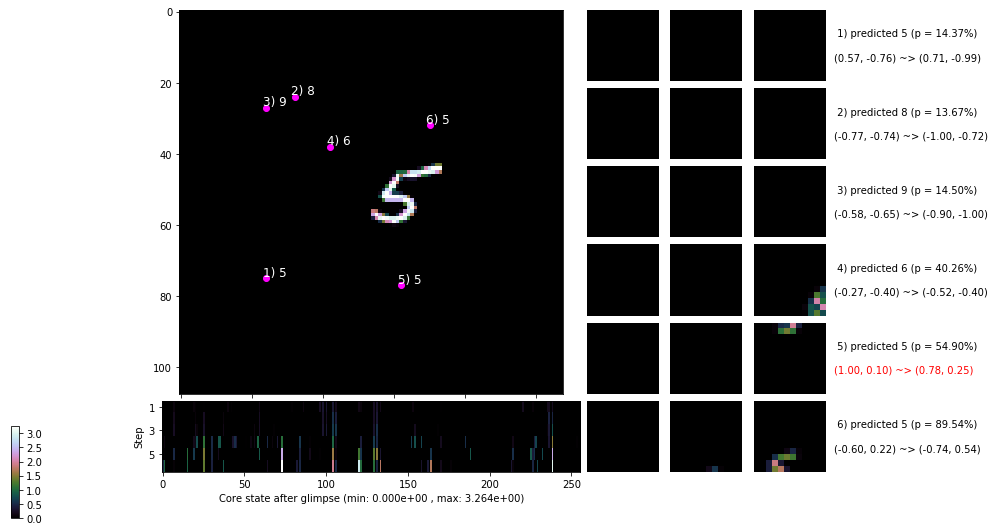

 b   1500/  4000 >> 105.8 ms/b | lr: 4.85e-04 | grad 2norm: 10.32 | grad inf norm:  3.541
       Weights || abs max:  2.69 ( 6024.68) | mean: -3.01e-02 ( 0.04) | var: 4.23e-02 ( 3857.56)
        Biases || abs max:  0.86 (  158.28) | mean: -1.43e-01 ( 0.29) | var: 3.76e-02 (  772.87)
                  class loss: 0.284 | steps: 2.219 | reward:  0.912 | acc.: 91.22%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.0 ms/b | lr: 4.83e-04 | grad 2norm: 14.38 | grad inf norm:  4.651
       Weights || abs max:  2.69 ( 3747.17) | mean: -3.01e-02 ( 0.03) | var: 4.24e-02 (  579.08)
        Biases || abs max:  0.87 (   99.73) | mean: -1.43e-01 ( 0.21) | var: 3.77e-02 (  115.06)
                  class loss: 0.280 | steps: 2.262 | reward:  0.912 | acc.: 91.17%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

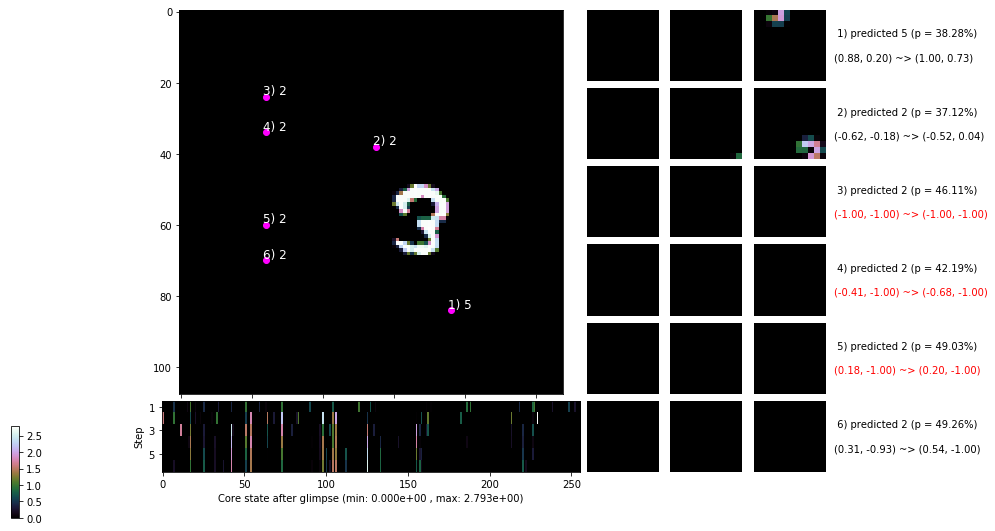

 b   2500/  4000 >> 103.8 ms/b | lr: 4.81e-04 | grad 2norm: 24.59 | grad inf norm:  5.379
       Weights || abs max:  2.70 ( 6308.04) | mean: -3.05e-02 ( 0.05) | var: 4.24e-02 ( 2490.60)
        Biases || abs max:  0.88 (  248.26) | mean: -1.44e-01 ( 0.35) | var: 3.82e-02 ( 6042.54)
                  class loss: 1.095 | steps: 2.292 | reward:  0.910 | acc.: 90.95%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.5 ms/b | lr: 4.79e-04 | grad 2norm:  7.69 | grad inf norm:  2.886
       Weights || abs max:  2.71 ( 5257.60) | mean: -3.05e-02 ( 0.04) | var: 4.25e-02 ( 2608.47)
        Biases || abs max:  0.88 (  258.28) | mean: -1.44e-01 ( 0.41) | var: 3.86e-02 ( 2549.86)
                  class loss: 0.282 | steps: 2.294 | reward:  0.911 | acc.: 91.07%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

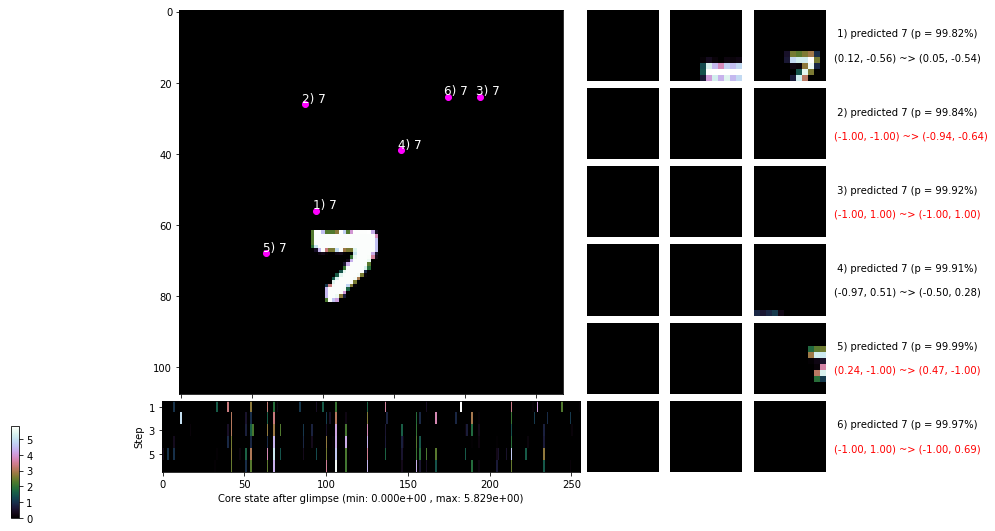

 b   3500/  4000 >> 104.5 ms/b | lr: 4.77e-04 | grad 2norm:  7.78 | grad inf norm:  2.953
       Weights || abs max:  2.72 (11583.03) | mean: -3.05e-02 ( 0.06) | var: 4.26e-02 (72691.13)
        Biases || abs max:  0.88 (  579.34) | mean: -1.45e-01 ( 0.65) | var: 3.87e-02 (125678.40)
                  class loss: 0.282 | steps: 2.248 | reward:  0.913 | acc.: 91.27%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 110.2 ms/b | lr: 4.76e-04 | grad 2norm:  7.98 | grad inf norm:  3.023
       Weights || abs max:  2.72 ( 6666.88) | mean: -3.05e-02 ( 0.04) | var: 4.27e-02 ( 6240.66)
        Biases || abs max:  0.89 (  114.91) | mean: -1.45e-01 ( 0.22) | var: 3.90e-02 ( 1158.21)
                  class loss: 0.282 | steps: 2.229 | reward:  0.910 | acc.: 91.01%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

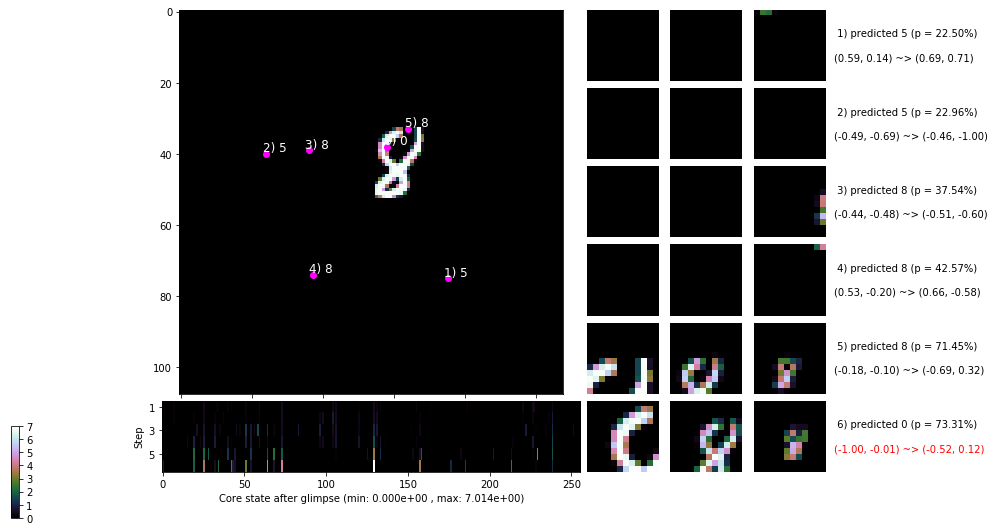

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


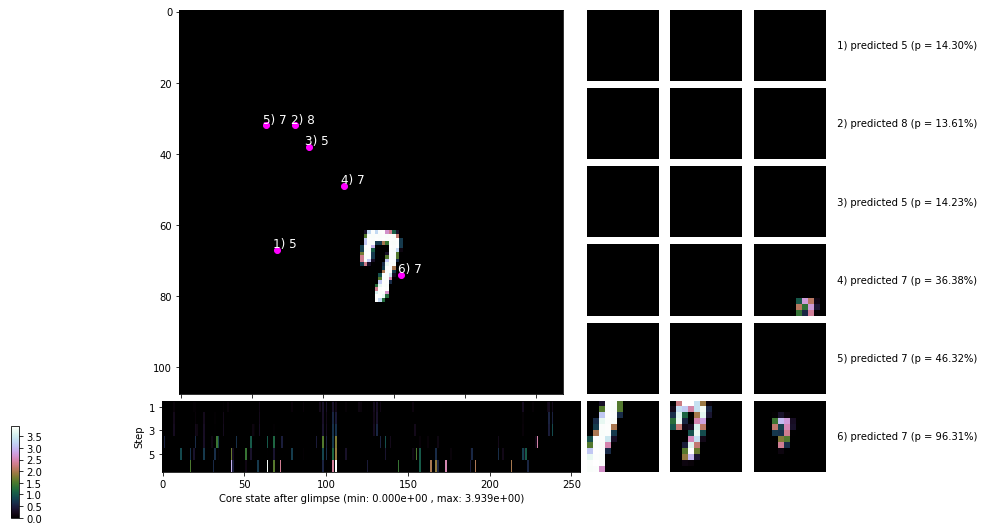


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


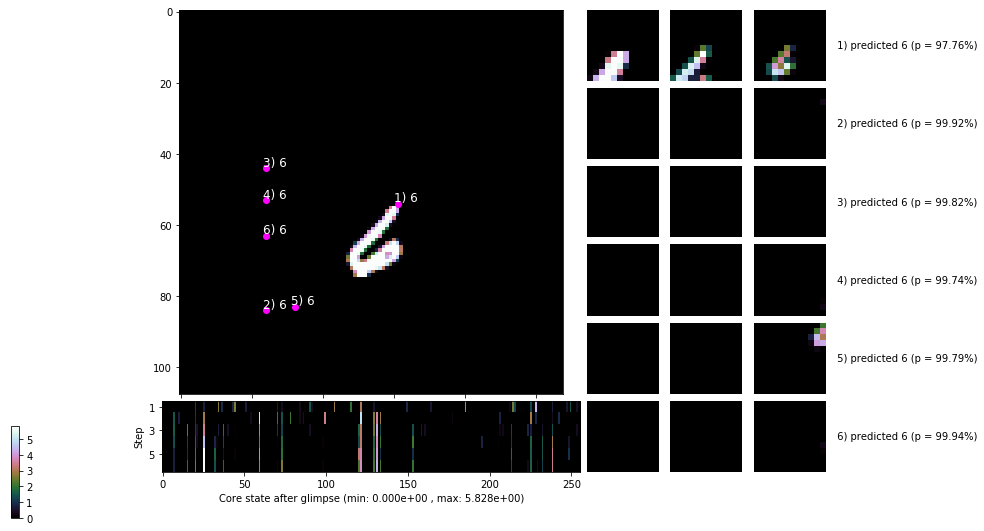

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


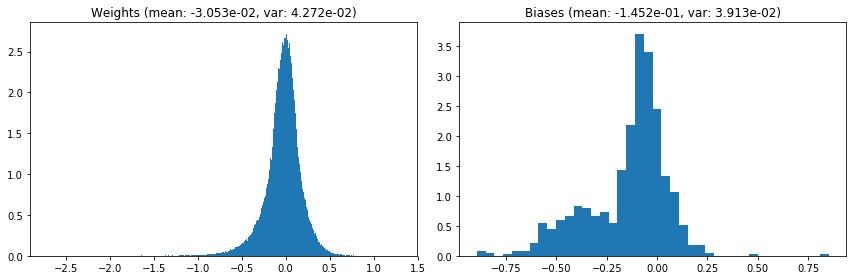

                                      Location network weights and biases


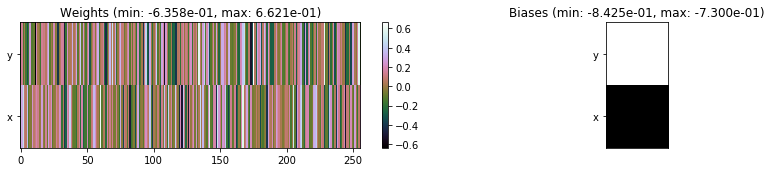

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.15 sec | TRAIN >> class loss: 0.3818 | steps:  2.256    | reward:  0.9116    | acc.: 91.157% 
                          | VAL   >> class loss: 0.2695 | steps:  2.213 :( | reward:  0.9112 :( | acc.: 91.120% :(


Epoch  25/400) lr = 0.000475
 b    500/  4000 >> 101.8 ms/b | lr: 4.74e-04 | grad 2norm:  7.77 | grad inf norm:  2.869
       Weights || abs max:  2.71 (22044.49) | mean: -3.05e-02 ( 0.11) | var: 4.28e-02 (352161.09)
        Biases || abs max:  0.90 (  141.46) | mean: -1.46e-01 ( 0.27) | var: 3.93e-02 (  949.43)
                  class loss: 0.278 | steps: 2.227 | reward:  0.914 | acc.: 91.41%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.2 ms/b | lr: 4.72e-04 | grad 2norm:  8.10 | grad inf norm:  3.121
       Weights || abs max:  2.71 ( 6644.88) | mean: -3.04e-02 ( 0.05) | v

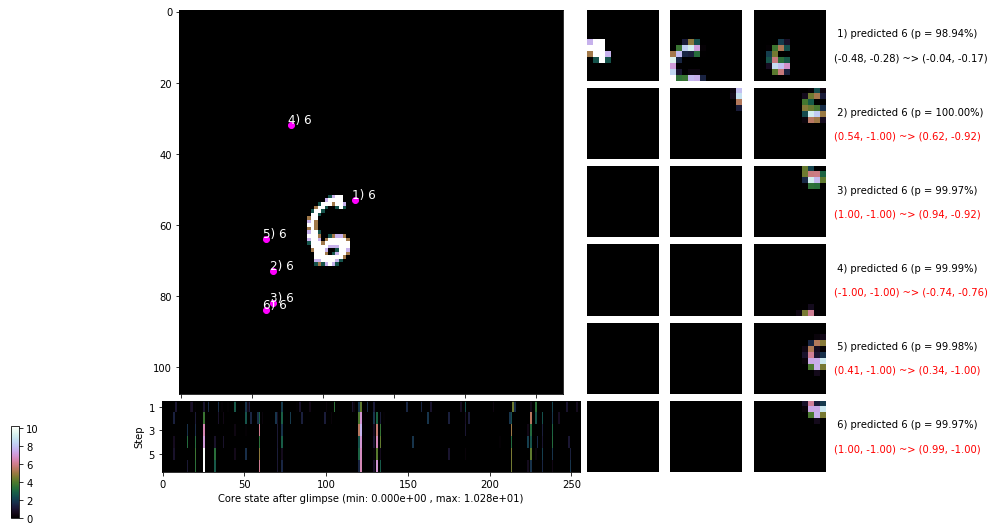

 b   1500/  4000 >> 103.6 ms/b | lr: 4.70e-04 | grad 2norm:  7.98 | grad inf norm:  2.988
       Weights || abs max:  2.72 (11021.49) | mean: -3.04e-02 ( 0.06) | var: 4.30e-02 (60991.49)
        Biases || abs max:  0.90 (  210.14) | mean: -1.46e-01 ( 0.32) | var: 3.96e-02 ( 4857.92)
                  class loss: 0.299 | steps: 2.281 | reward:  0.905 | acc.: 90.55%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.1 ms/b | lr: 4.68e-04 | grad 2norm:  7.59 | grad inf norm:  2.809
       Weights || abs max:  2.72 ( 4213.62) | mean: -3.04e-02 ( 0.04) | var: 4.31e-02 (  774.01)
        Biases || abs max:  0.90 (   84.24) | mean: -1.46e-01 ( 0.20) | var: 3.97e-02 (   47.13)
                  class loss: 0.281 | steps: 2.262 | reward:  0.911 | acc.: 91.07%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

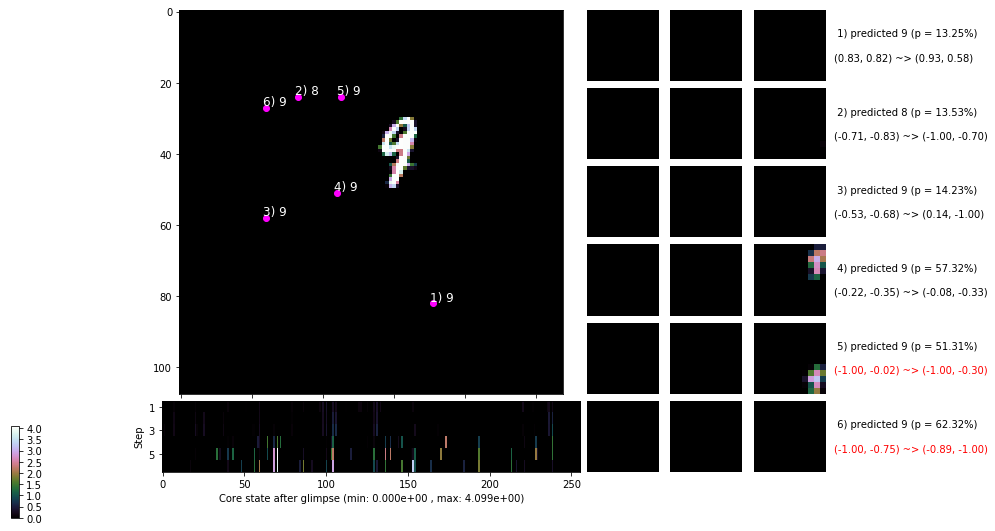

 b   2500/  4000 >> 105.7 ms/b | lr: 4.67e-04 | grad 2norm:  7.91 | grad inf norm:  3.014
       Weights || abs max:  2.72 ( 4976.41) | mean: -3.03e-02 ( 0.04) | var: 4.31e-02 ( 1580.81)
        Biases || abs max:  0.90 (  236.65) | mean: -1.47e-01 ( 0.35) | var: 3.99e-02 ( 3808.48)
                  class loss: 0.279 | steps: 2.254 | reward:  0.912 | acc.: 91.17%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.7 ms/b | lr: 4.65e-04 | grad 2norm:  7.96 | grad inf norm:  3.052
       Weights || abs max:  2.72 ( 3541.49) | mean: -3.03e-02 ( 0.03) | var: 4.32e-02 (  498.28)
        Biases || abs max:  0.91 (   83.03) | mean: -1.47e-01 ( 0.22) | var: 4.02e-02 ( 1227.30)
                  class loss: 0.290 | steps: 2.261 | reward:  0.909 | acc.: 90.93%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

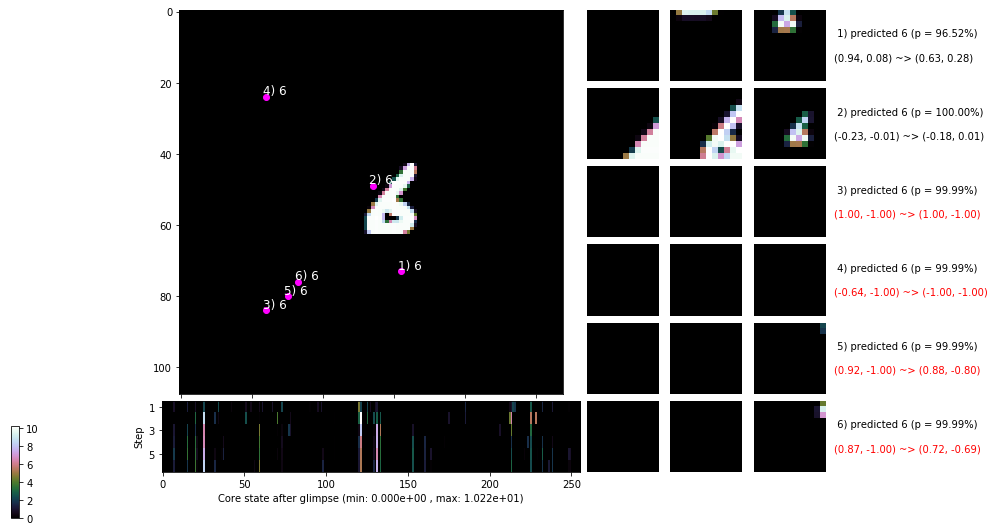

 b   3500/  4000 >> 102.6 ms/b | lr: 4.63e-04 | grad 2norm:  7.94 | grad inf norm:  3.011
       Weights || abs max:  2.73 ( 3450.86) | mean: -3.03e-02 ( 0.03) | var: 4.33e-02 (  296.79)
        Biases || abs max:  0.91 (  227.69) | mean: -1.48e-01 ( 0.36) | var: 4.04e-02 ( 4420.47)
                  class loss: 0.298 | steps: 2.280 | reward:  0.909 | acc.: 90.85%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 105.7 ms/b | lr: 4.61e-04 | grad 2norm:  7.92 | grad inf norm:  3.020
       Weights || abs max:  2.72 (20711.83) | mean: -3.02e-02 ( 0.10) | var: 4.34e-02 (489804.88)
        Biases || abs max:  0.93 (  250.83) | mean: -1.48e-01 ( 0.53) | var: 4.07e-02 (19944.67)
                  class loss: 0.302 | steps: 2.274 | reward:  0.906 | acc.: 90.57%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

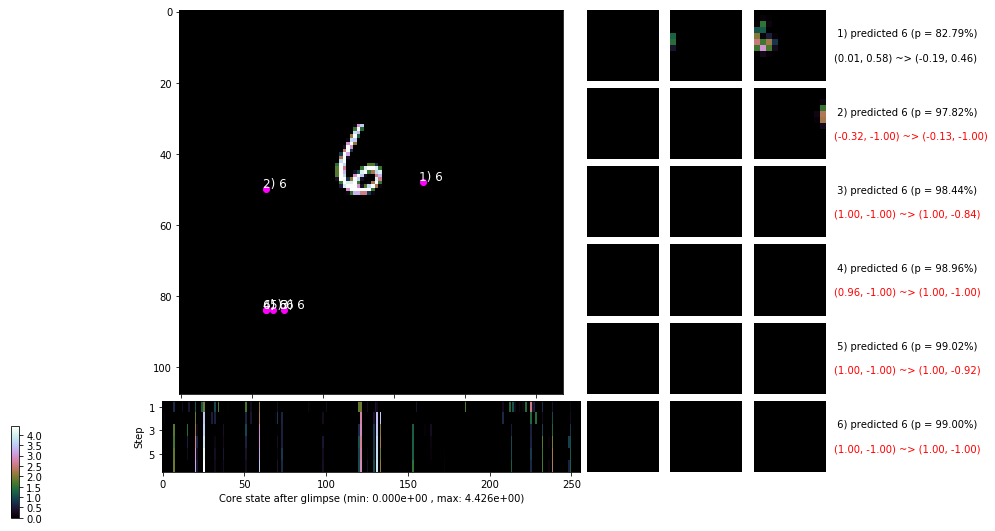

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


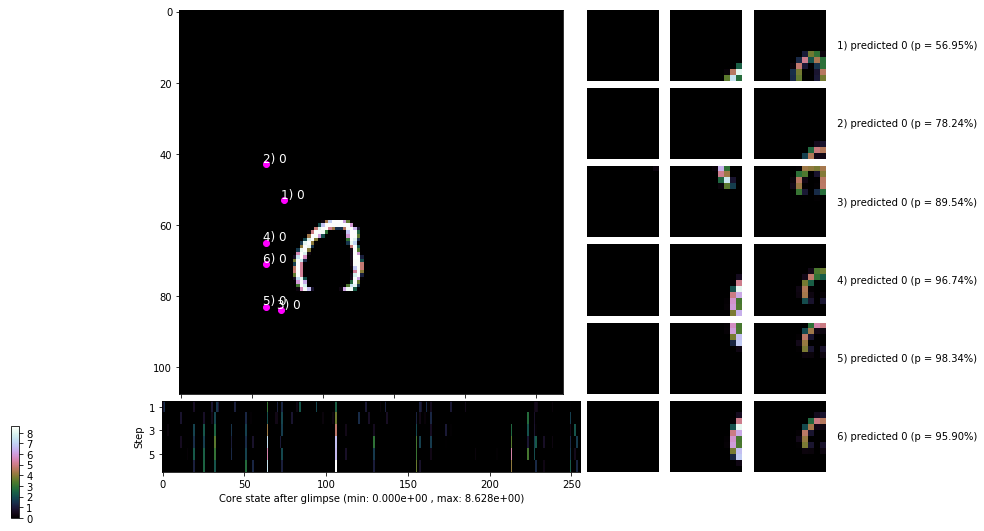


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


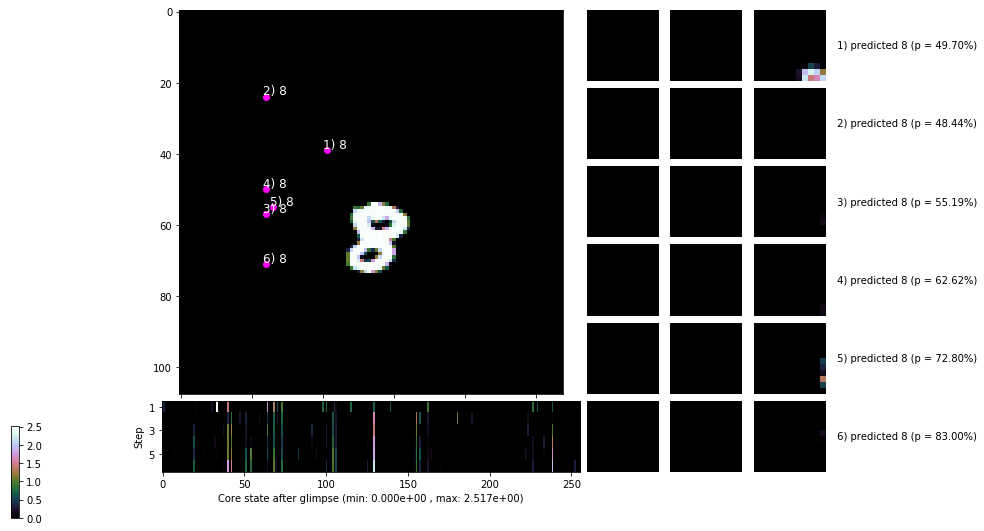

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


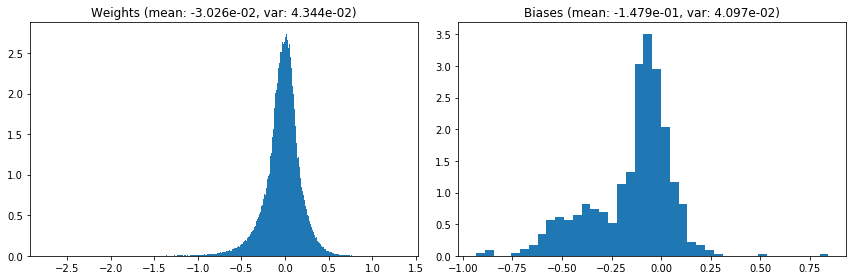

                                      Location network weights and biases


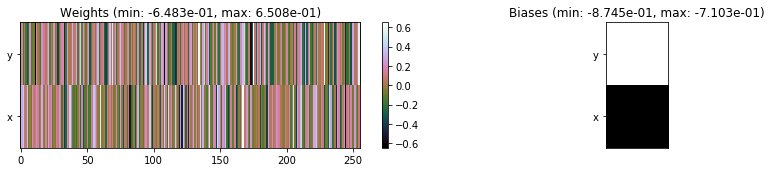

---------------------------------------------------------------------------------------------------------------
Elapsed time:  413.83 sec | TRAIN >> class loss: 0.2883 | steps:  2.261 :( | reward:  0.9096 :( | acc.: 90.960% :(
                          | VAL   >> class loss: 0.3098 | steps:  2.210 :( | reward:  0.8968 :( | acc.: 89.680% :(


Epoch  26/400) lr = 0.0004605
 b    500/  4000 >> 103.7 ms/b | lr: 4.59e-04 | grad 2norm:  8.06 | grad inf norm:  3.063
       Weights || abs max:  2.72 (10914.98) | mean: -3.02e-02 ( 0.06) | var: 4.35e-02 (23463.20)
        Biases || abs max:  0.93 (   88.15) | mean: -1.48e-01 ( 0.22) | var: 4.10e-02 (  135.20)
                  class loss: 0.317 | steps: 2.250 | reward:  0.901 | acc.: 90.10%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 105.0 ms/b | lr: 4.57e-04 | grad 2norm:  7.71 | grad inf norm:  2.856
       Weights || abs max:  2.72 ( 3247.68) | mean: -3.02e-02 ( 0.03) |

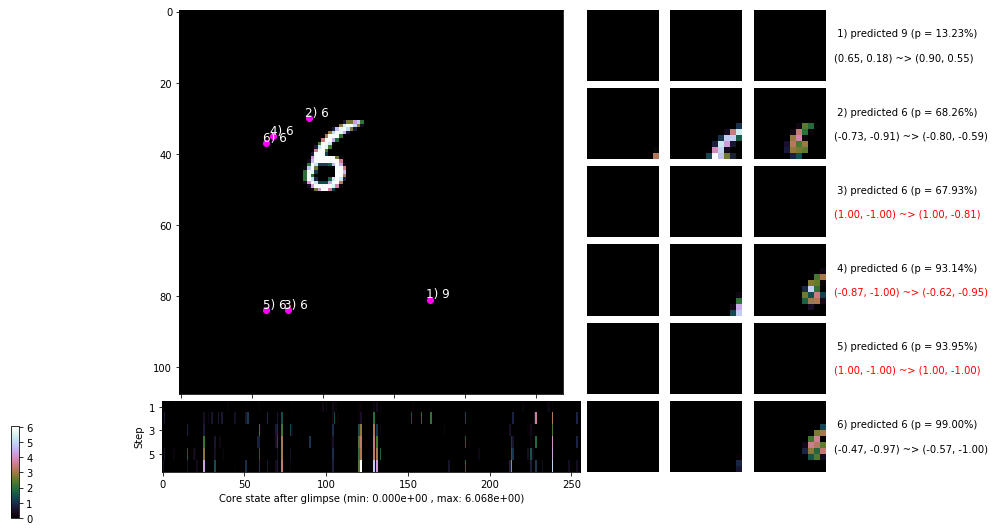

 b   1500/  4000 >> 119.0 ms/b | lr: 4.55e-04 | grad 2norm:  7.91 | grad inf norm:  3.024
       Weights || abs max:  2.73 ( 4782.60) | mean: -3.01e-02 ( 0.04) | var: 4.37e-02 ( 2020.01)
        Biases || abs max:  0.94 (  169.45) | mean: -1.49e-01 ( 0.30) | var: 4.13e-02 (  597.82)
                  class loss: 0.295 | steps: 2.304 | reward:  0.906 | acc.: 90.58%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.2 ms/b | lr: 4.54e-04 | grad 2norm:  7.68 | grad inf norm:  2.977
       Weights || abs max:  2.74 ( 3835.55) | mean: -3.01e-02 ( 0.03) | var: 4.38e-02 (  557.42)
        Biases || abs max:  0.93 (  237.54) | mean: -1.49e-01 ( 0.37) | var: 4.14e-02 ( 1762.48)
                  class loss: 0.275 | steps: 2.274 | reward:  0.913 | acc.: 91.27%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

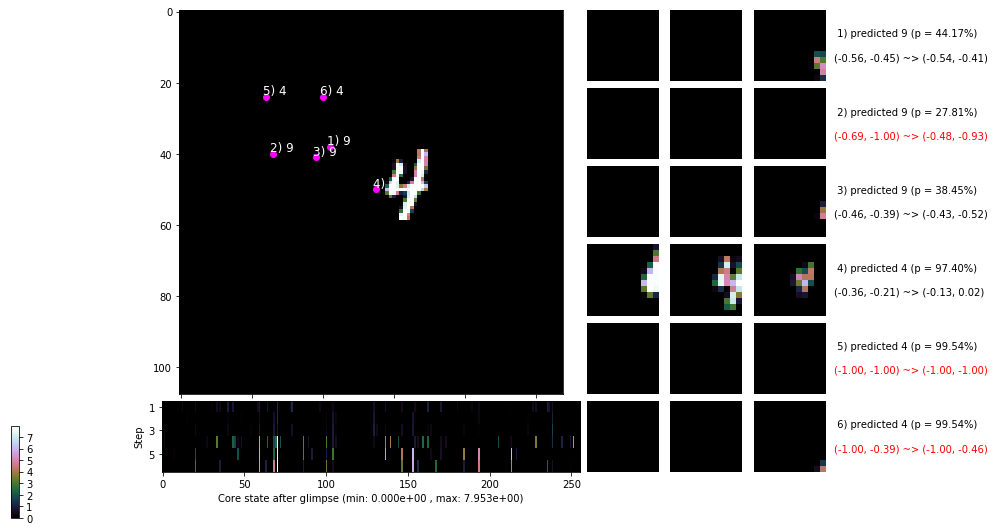

 b   2500/  4000 >> 113.6 ms/b | lr: 4.52e-04 | grad 2norm:  7.61 | grad inf norm:  2.865
       Weights || abs max:  2.73 ( 6775.66) | mean: -3.00e-02 ( 0.05) | var: 4.38e-02 ( 9129.51)
        Biases || abs max:  0.92 (  272.93) | mean: -1.49e-01 ( 0.38) | var: 4.14e-02 ( 9418.05)
                  class loss: 0.293 | steps: 2.304 | reward:  0.907 | acc.: 90.73%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 106.6 ms/b | lr: 4.50e-04 | grad 2norm:  7.75 | grad inf norm:  2.993
       Weights || abs max:  2.73 ( 6710.27) | mean: -3.00e-02 ( 0.05) | var: 4.39e-02 ( 4232.05)
        Biases || abs max:  0.92 (  189.23) | mean: -1.49e-01 ( 0.31) | var: 4.13e-02 ( 1395.72)
                  class loss: 0.279 | steps: 2.283 | reward:  0.911 | acc.: 91.08%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

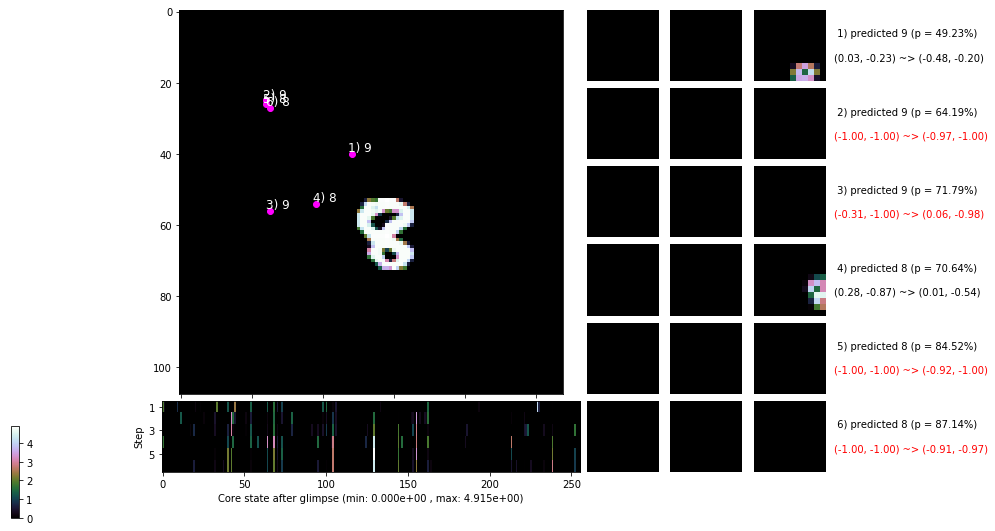

 b   3500/  4000 >> 109.7 ms/b | lr: 4.49e-04 | grad 2norm:  9.00 | grad inf norm:  3.151
       Weights || abs max:  2.74 ( 5106.90) | mean: -2.99e-02 ( 0.04) | var: 4.41e-02 ( 1161.37)
        Biases || abs max:  0.92 (  148.12) | mean: -1.49e-01 ( 0.28) | var: 4.13e-02 (  266.98)
                  class loss: 0.276 | steps: 2.285 | reward:  0.913 | acc.: 91.31%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 106.6 ms/b | lr: 4.47e-04 | grad 2norm:  8.60 | grad inf norm:  3.185
       Weights || abs max:  2.74 (13396.70) | mean: -2.99e-02 ( 0.07) | var: 4.41e-02 (159725.02)
        Biases || abs max:  0.92 (  119.16) | mean: -1.50e-01 ( 0.25) | var: 4.16e-02 (  214.28)
                  class loss: 0.290 | steps: 2.303 | reward:  0.911 | acc.: 91.12%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

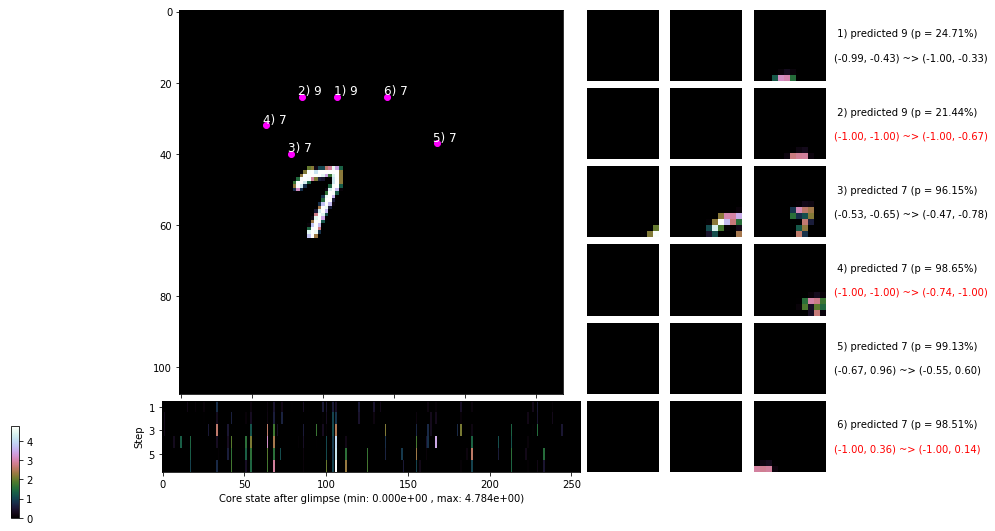

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


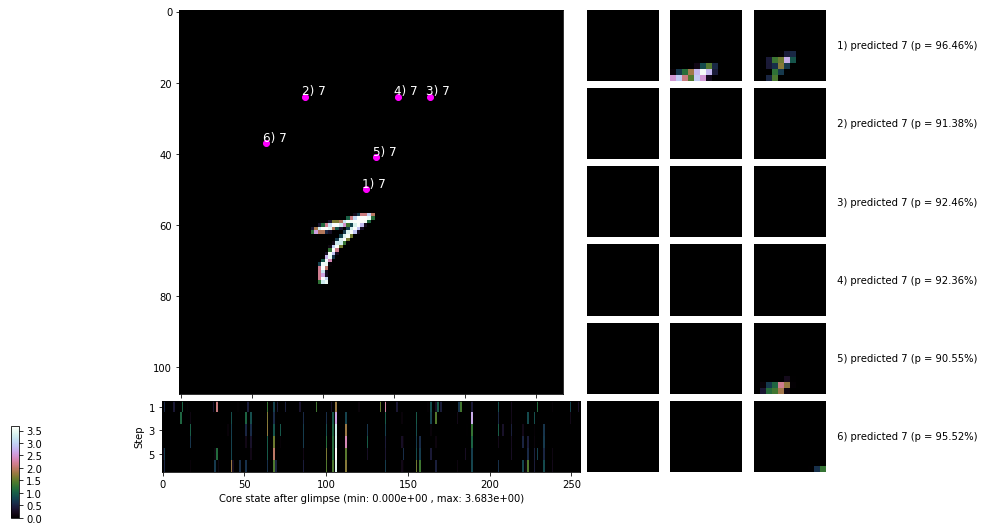


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


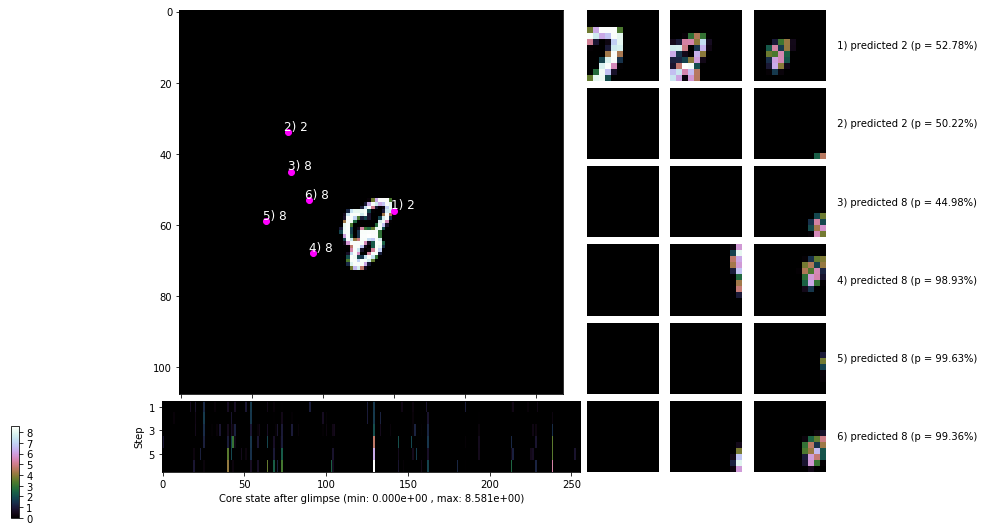

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


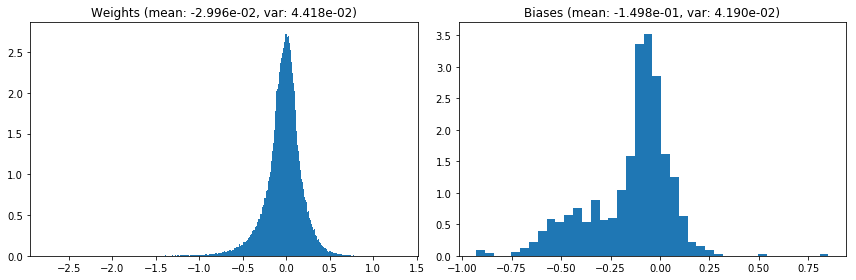

                                      Location network weights and biases


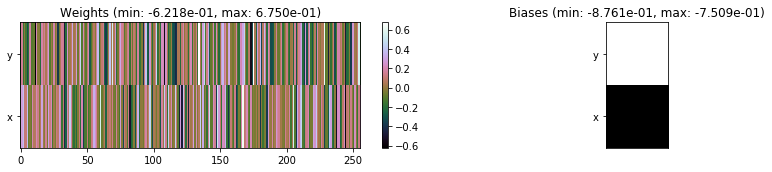

---------------------------------------------------------------------------------------------------------------
Elapsed time:  437.85 sec | TRAIN >> class loss: 0.2911 | steps:  2.288 :( | reward:  0.9082 :( | acc.: 90.823% :(
                          | VAL   >> class loss: 0.2459 | steps:  2.231 :( | reward:  0.9232 :( | acc.: 92.320% :(


Epoch  27/400) lr = 0.0004465
 b    500/  4000 >> 109.3 ms/b | lr: 4.45e-04 | grad 2norm: 10.80 | grad inf norm:  3.668
       Weights || abs max:  2.74 ( 8402.56) | mean: -2.99e-02 ( 0.05) | var: 4.42e-02 (14533.88)
        Biases || abs max:  0.94 (  134.14) | mean: -1.50e-01 ( 0.27) | var: 4.21e-02 (  355.13)
                  class loss: 0.270 | steps: 2.257 | reward:  0.916 | acc.: 91.55%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 110.7 ms/b | lr: 4.43e-04 | grad 2norm:  8.04 | grad inf norm:  3.056
       Weights || abs max:  2.74 ( 5402.67) | mean: -2.98e-02 ( 0.04) |

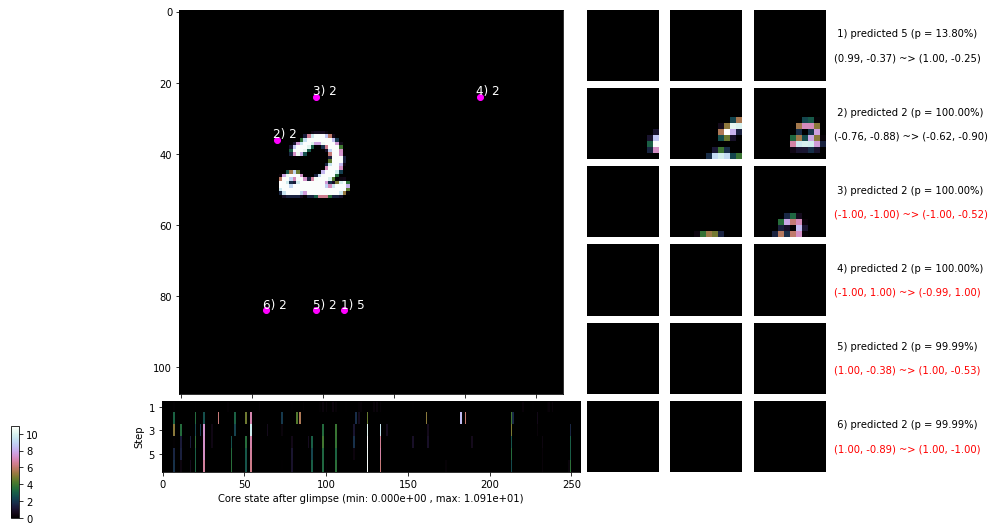

 b   1500/  4000 >> 108.0 ms/b | lr: 4.42e-04 | grad 2norm:  7.89 | grad inf norm:  2.963
       Weights || abs max:  2.75 ( 8808.81) | mean: -2.98e-02 ( 0.05) | var: 4.44e-02 (36327.79)
        Biases || abs max:  0.93 (  113.91) | mean: -1.50e-01 ( 0.22) | var: 4.26e-02 (  141.77)
                  class loss: 0.282 | steps: 2.310 | reward:  0.909 | acc.: 90.95%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 107.9 ms/b | lr: 4.40e-04 | grad 2norm:  8.32 | grad inf norm:  3.052
       Weights || abs max:  2.76 ( 5710.58) | mean: -2.98e-02 ( 0.04) | var: 4.45e-02 ( 7932.87)
        Biases || abs max:  0.95 (  119.31) | mean: -1.50e-01 ( 0.24) | var: 4.27e-02 (  433.61)
                  class loss: 0.268 | steps: 2.295 | reward:  0.917 | acc.: 91.69%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

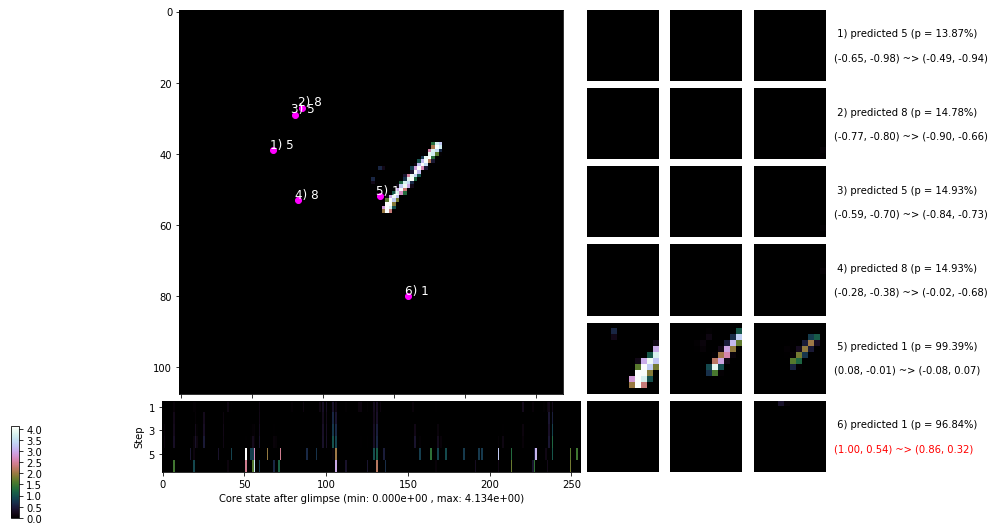

 b   2500/  4000 >> 109.1 ms/b | lr: 4.38e-04 | grad 2norm:  8.03 | grad inf norm:  3.076
       Weights || abs max:  2.76 (20167.16) | mean: -2.97e-02 ( 0.10) | var: 4.46e-02 (359937.00)
        Biases || abs max:  0.96 (  186.33) | mean: -1.51e-01 ( 0.31) | var: 4.28e-02 ( 2635.32)
                  class loss: 0.275 | steps: 2.273 | reward:  0.914 | acc.: 91.40%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 117.9 ms/b | lr: 4.37e-04 | grad 2norm:  7.99 | grad inf norm:  3.084
       Weights || abs max:  2.77 (27687.18) | mean: -2.97e-02 ( 0.13) | var: 4.46e-02 (964450.19)
        Biases || abs max:  0.97 (   92.67) | mean: -1.51e-01 ( 0.19) | var: 4.31e-02 (  748.08)
                  class loss: 0.280 | steps: 2.286 | reward:  0.912 | acc.: 91.23%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

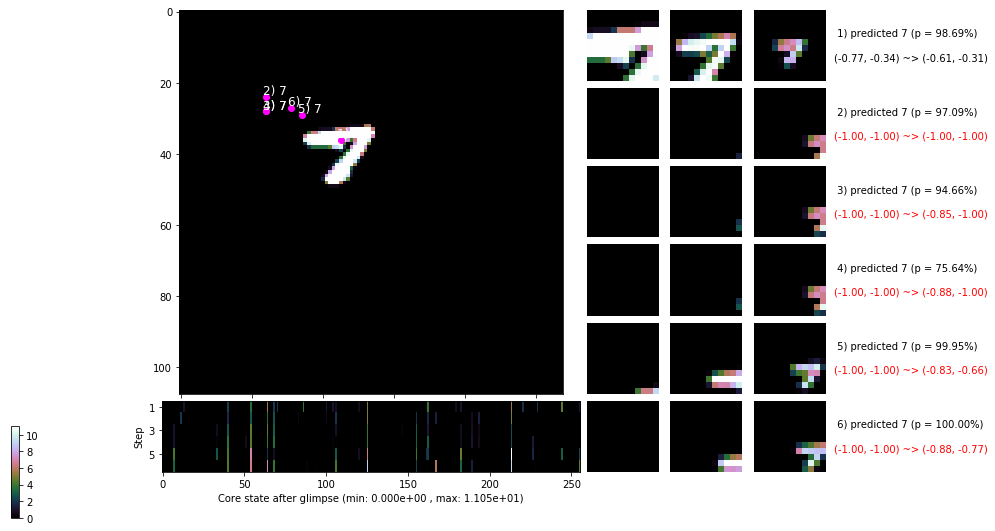

 b   3500/  4000 >> 108.2 ms/b | lr: 4.35e-04 | grad 2norm:  7.93 | grad inf norm:  3.066
       Weights || abs max:  2.77 ( 7527.78) | mean: -2.96e-02 ( 0.05) | var: 4.47e-02 ( 5001.52)
        Biases || abs max:  0.97 (  105.52) | mean: -1.51e-01 ( 0.22) | var: 4.32e-02 (  479.76)
                  class loss: 0.260 | steps: 2.250 | reward:  0.916 | acc.: 91.55%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.3 ms/b | lr: 4.33e-04 | grad 2norm:  8.00 | grad inf norm:  3.078
       Weights || abs max:  2.76 ( 6690.37) | mean: -2.96e-02 ( 0.05) | var: 4.48e-02 ( 4886.22)
        Biases || abs max:  0.97 (   94.30) | mean: -1.52e-01 ( 0.23) | var: 4.34e-02 (   72.13)
                  class loss: 0.270 | steps: 2.281 | reward:  0.915 | acc.: 91.53%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

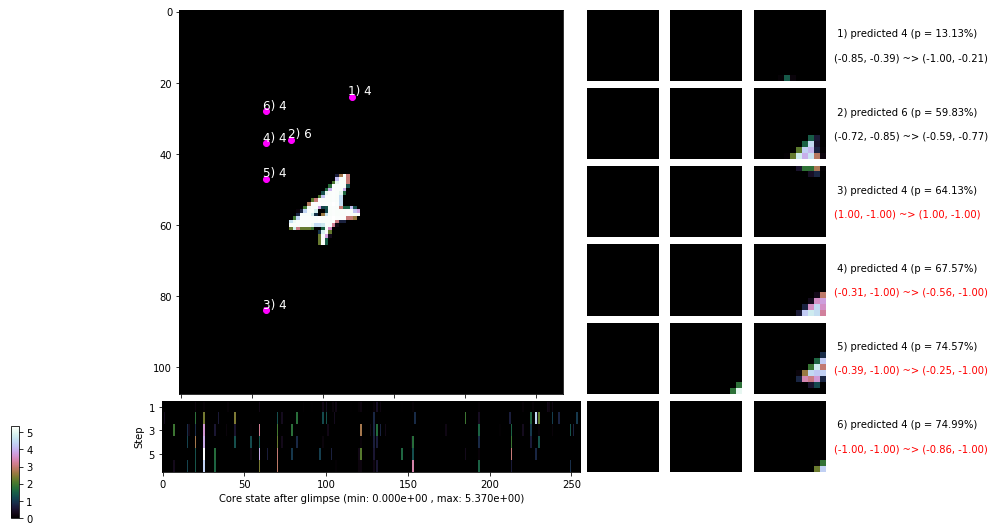

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


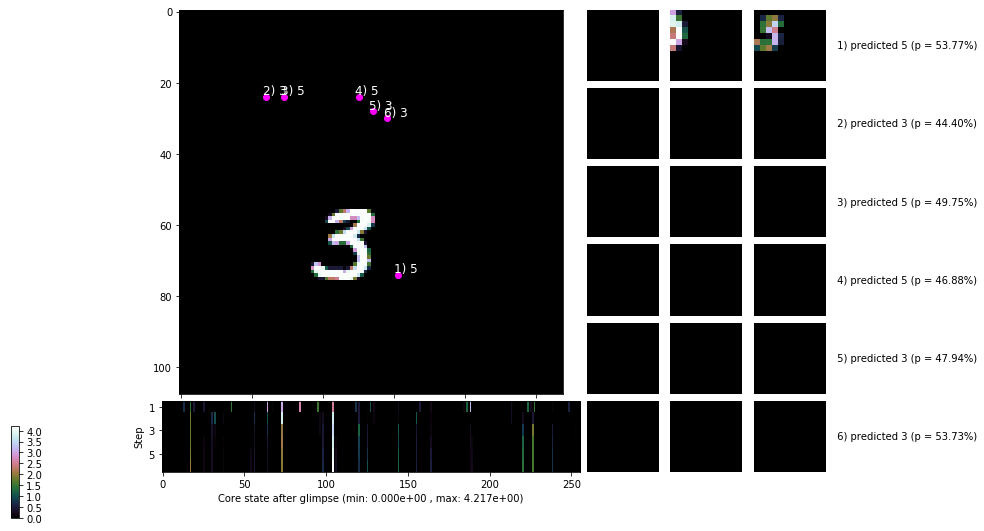


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


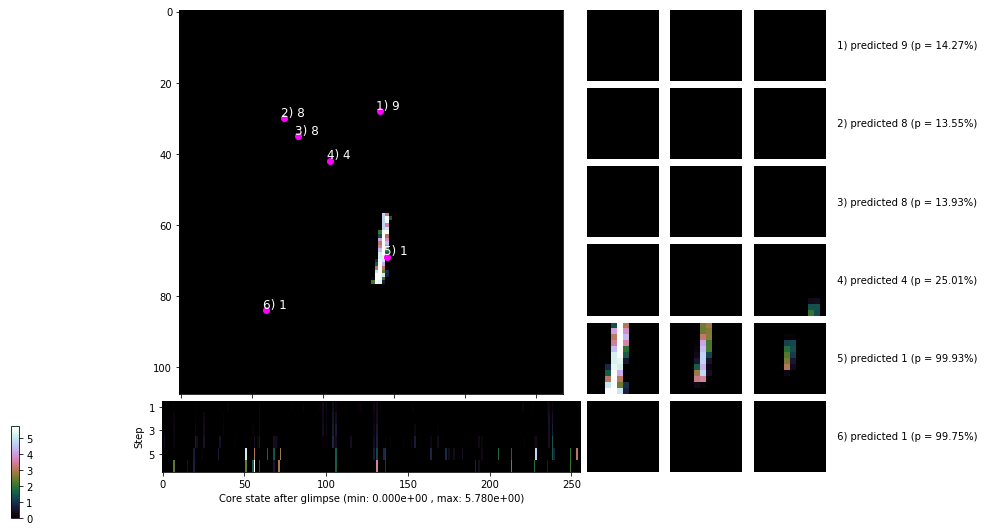

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


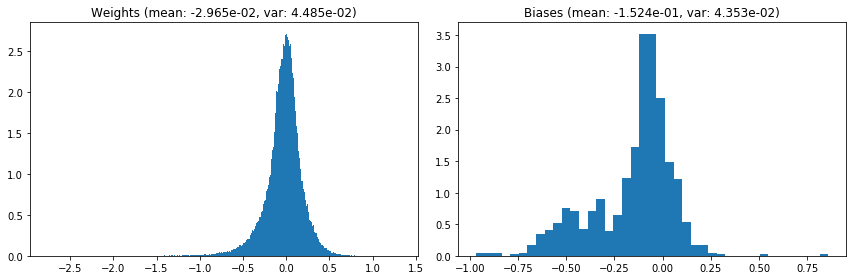

                                      Location network weights and biases


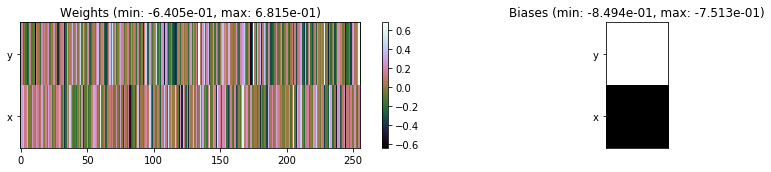

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.82 sec | TRAIN >> class loss: 0.2725 | steps:  2.275 :( | reward:  0.9142    | acc.: 91.422% 
                          | VAL   >> class loss: 0.2455 | steps:  2.206 :( | reward:  0.9194 :( | acc.: 91.940% :(


Epoch  28/400) lr = 0.0004328
 b    500/  4000 >> 108.3 ms/b | lr: 4.32e-04 | grad 2norm:  8.45 | grad inf norm:  3.115
       Weights || abs max:  2.76 ( 4207.23) | mean: -2.96e-02 ( 0.04) | var: 4.49e-02 (  797.98)
        Biases || abs max:  0.97 (  201.78) | mean: -1.52e-01 ( 0.33) | var: 4.37e-02 ( 2668.54)
                  class loss: 0.274 | steps: 2.278 | reward:  0.914 | acc.: 91.37%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 108.8 ms/b | lr: 4.30e-04 | grad 2norm: 10.81 | grad inf norm:  3.830
       Weights || abs max:  2.76 (11293.24) | mean: -2.96e-02 ( 0.07) | v

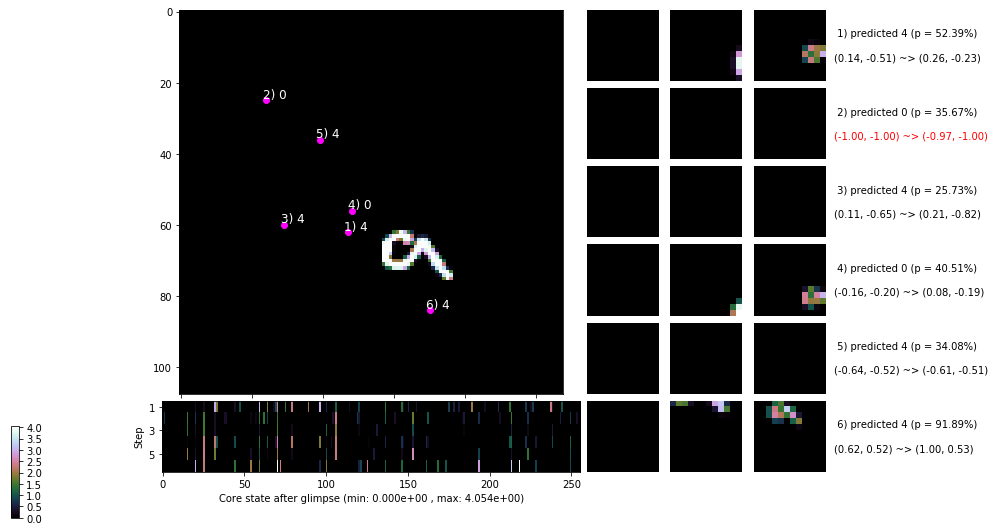

 b   1500/  4000 >> 108.4 ms/b | lr: 4.28e-04 | grad 2norm:  8.48 | grad inf norm:  3.153
       Weights || abs max:  2.77 ( 4933.67) | mean: -2.96e-02 ( 0.04) | var: 4.50e-02 (  905.04)
        Biases || abs max:  0.97 (   62.80) | mean: -1.53e-01 ( 0.14) | var: 4.43e-02 (  412.94)
                  class loss: 0.274 | steps: 2.266 | reward:  0.914 | acc.: 91.38%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 110.2 ms/b | lr: 4.26e-04 | grad 2norm: 11.93 | grad inf norm:  4.010
       Weights || abs max:  2.78 ( 9032.06) | mean: -2.96e-02 ( 0.06) | var: 4.51e-02 (22632.63)
        Biases || abs max:  0.97 (   64.51) | mean: -1.53e-01 ( 0.17) | var: 4.44e-02 (   76.63)
                  class loss: 0.274 | steps: 2.279 | reward:  0.913 | acc.: 91.33%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

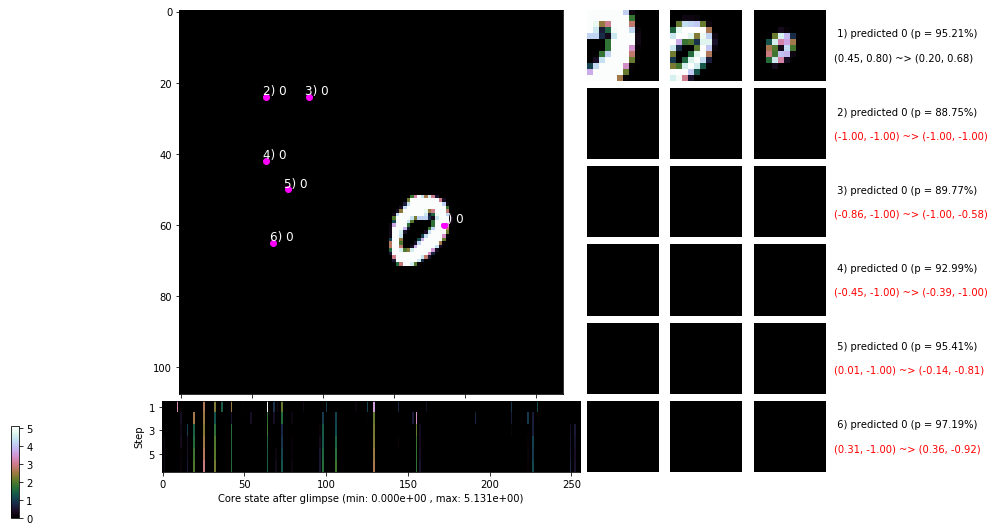

 b   2500/  4000 >> 108.0 ms/b | lr: 4.25e-04 | grad 2norm: 14.35 | grad inf norm:  4.660
       Weights || abs max:  2.79 ( 8736.22) | mean: -2.96e-02 ( 0.05) | var: 4.52e-02 (35269.00)
        Biases || abs max:  0.98 (   83.39) | mean: -1.53e-01 ( 0.19) | var: 4.45e-02 (  226.40)
                  class loss: 0.295 | steps: 2.342 | reward:  0.908 | acc.: 90.77%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 112.9 ms/b | lr: 4.23e-04 | grad 2norm:  9.76 | grad inf norm:  3.452
       Weights || abs max:  2.79 ( 4017.81) | mean: -2.96e-02 ( 0.03) | var: 4.53e-02 (  461.04)
        Biases || abs max:  0.99 (   66.90) | mean: -1.54e-01 ( 0.16) | var: 4.47e-02 (   48.06)
                  class loss: 0.278 | steps: 2.282 | reward:  0.913 | acc.: 91.32%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

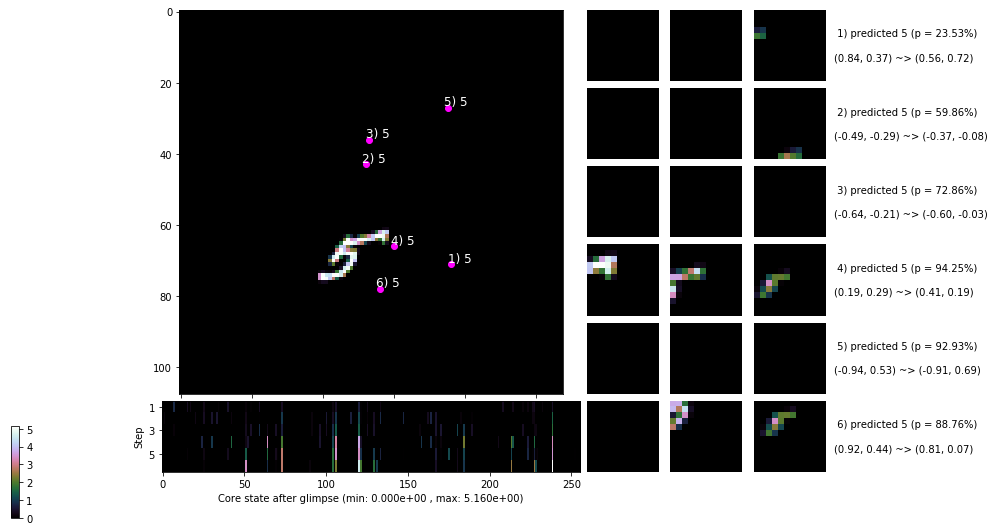

 b   3500/  4000 >> 114.7 ms/b | lr: 4.22e-04 | grad 2norm:  7.83 | grad inf norm:  3.039
       Weights || abs max:  2.79 (11601.59) | mean: -2.95e-02 ( 0.07) | var: 4.54e-02 (47491.82)
        Biases || abs max:  0.99 (  169.84) | mean: -1.54e-01 ( 0.28) | var: 4.48e-02 ( 1636.43)
                  class loss: 0.261 | steps: 2.240 | reward:  0.920 | acc.: 92.00%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 118.9 ms/b | lr: 4.20e-04 | grad 2norm: 15.39 | grad inf norm:  4.867
       Weights || abs max:  2.80 ( 8551.39) | mean: -2.95e-02 ( 0.06) | var: 4.55e-02 (20925.51)
        Biases || abs max:  0.99 (  137.26) | mean: -1.54e-01 ( 0.23) | var: 4.50e-02 ( 2209.45)
                  class loss: 0.262 | steps: 2.217 | reward:  0.917 | acc.: 91.69%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

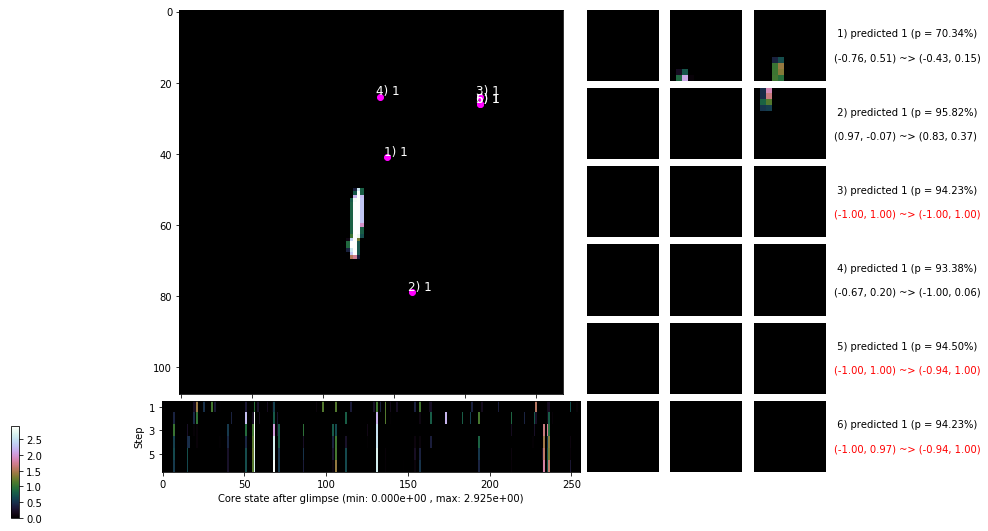

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


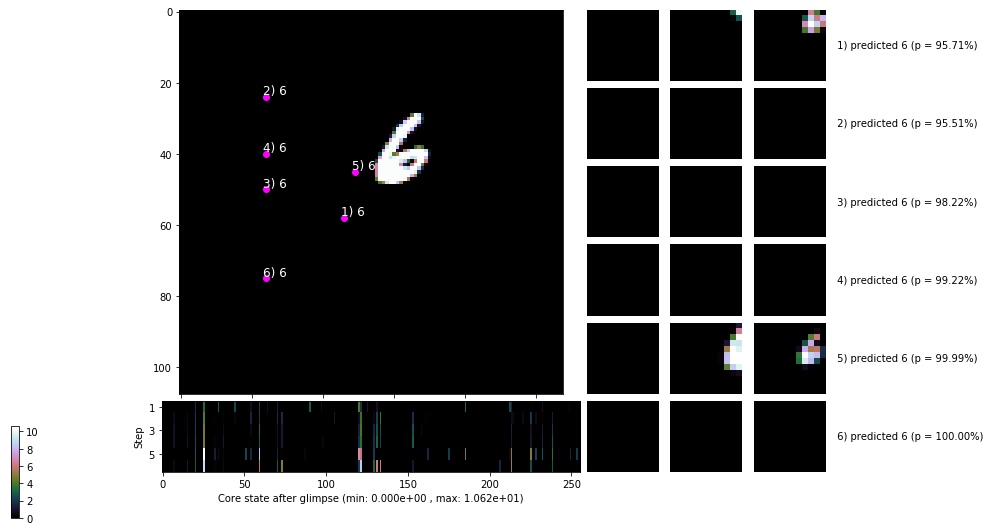


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


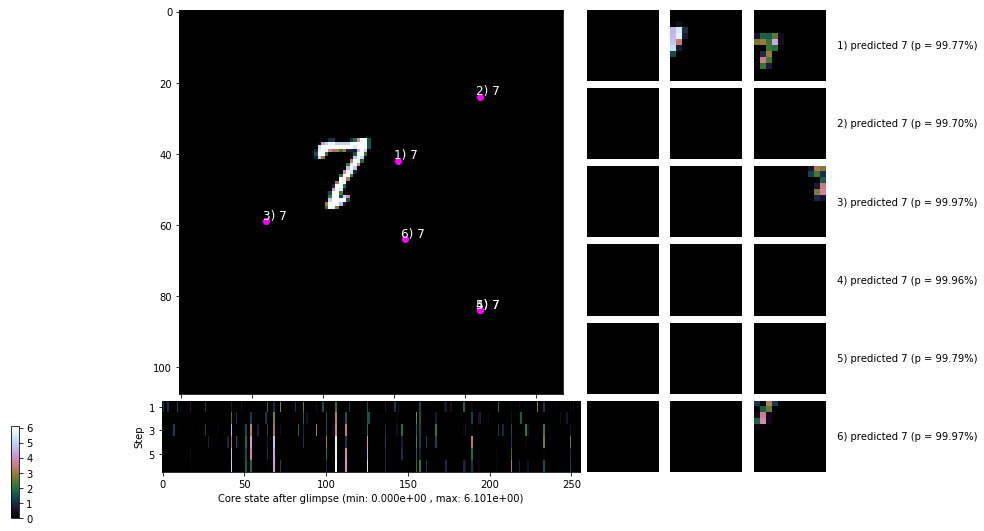

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


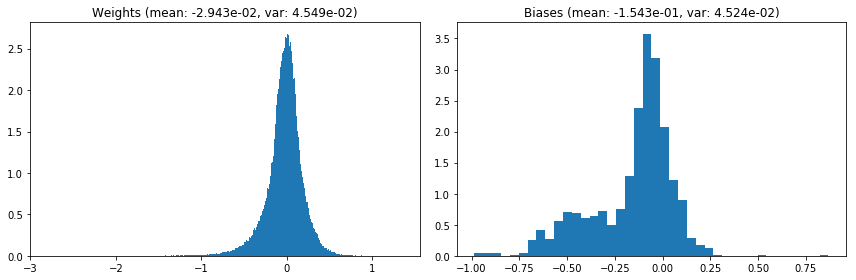

                                      Location network weights and biases


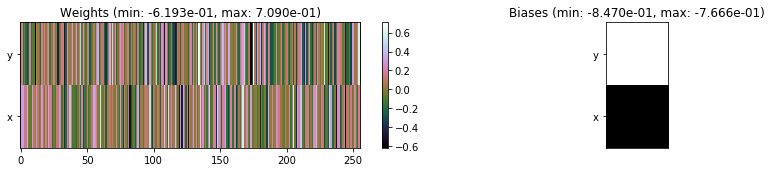

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.24 sec | TRAIN >> class loss: 0.2738 | steps:  2.270 :( | reward:  0.9140 :( | acc.: 91.398% :(
                          | VAL   >> class loss: 0.2545 | steps:  2.209 :( | reward:  0.9228 :( | acc.: 92.280% :(


Epoch  29/400) lr = 0.0004196
 b    500/  4000 >> 109.9 ms/b | lr: 4.18e-04 | grad 2norm:  9.89 | grad inf norm:  3.529
       Weights || abs max:  2.80 ( 6784.59) | mean: -2.95e-02 ( 0.05) | var: 4.55e-02 ( 2485.48)
        Biases || abs max:  0.99 (   84.85) | mean: -1.55e-01 ( 0.21) | var: 4.55e-02 (   76.85)
                  class loss: 0.270 | steps: 2.241 | reward:  0.914 | acc.: 91.38%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.8 ms/b | lr: 4.17e-04 | grad 2norm:  9.71 | grad inf norm:  3.438
       Weights || abs max:  2.79 ( 3778.63) | mean: -2.95e-02 ( 0.03) |

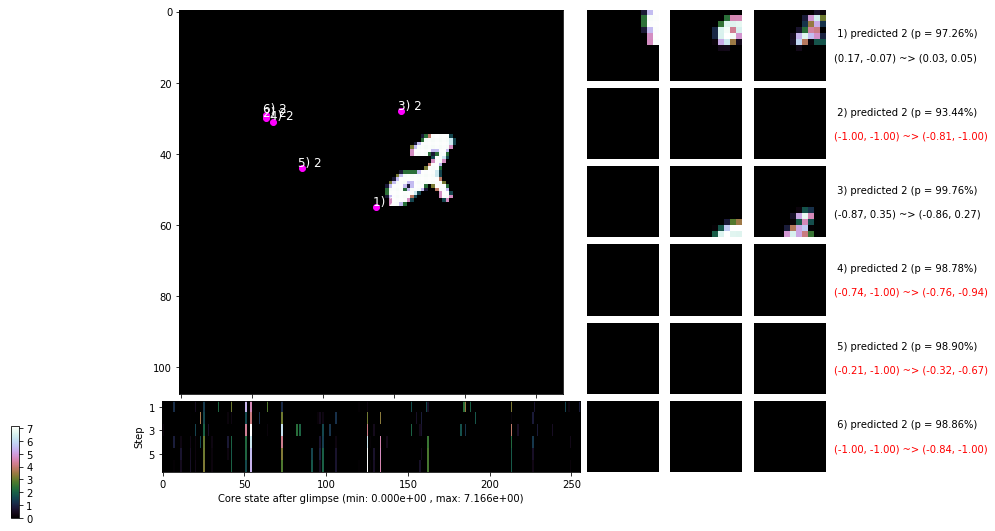

 b   1500/  4000 >> 109.2 ms/b | lr: 4.15e-04 | grad 2norm:  8.95 | grad inf norm:  3.303
       Weights || abs max:  2.79 ( 7575.95) | mean: -2.95e-02 ( 0.05) | var: 4.57e-02 (12124.62)
        Biases || abs max:  0.99 (  170.42) | mean: -1.56e-01 ( 0.28) | var: 4.59e-02 (  963.46)
                  class loss: 0.281 | steps: 2.304 | reward:  0.909 | acc.: 90.95%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 105.0 ms/b | lr: 4.13e-04 | grad 2norm: 13.63 | grad inf norm:  4.315
       Weights || abs max:  2.80 (12175.67) | mean: -2.93e-02 ( 0.07) | var: 4.58e-02 (32312.03)
        Biases || abs max:  1.00 (  109.65) | mean: -1.55e-01 ( 0.22) | var: 4.58e-02 (  282.67)
                  class loss: 0.272 | steps: 2.316 | reward:  0.916 | acc.: 91.56%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

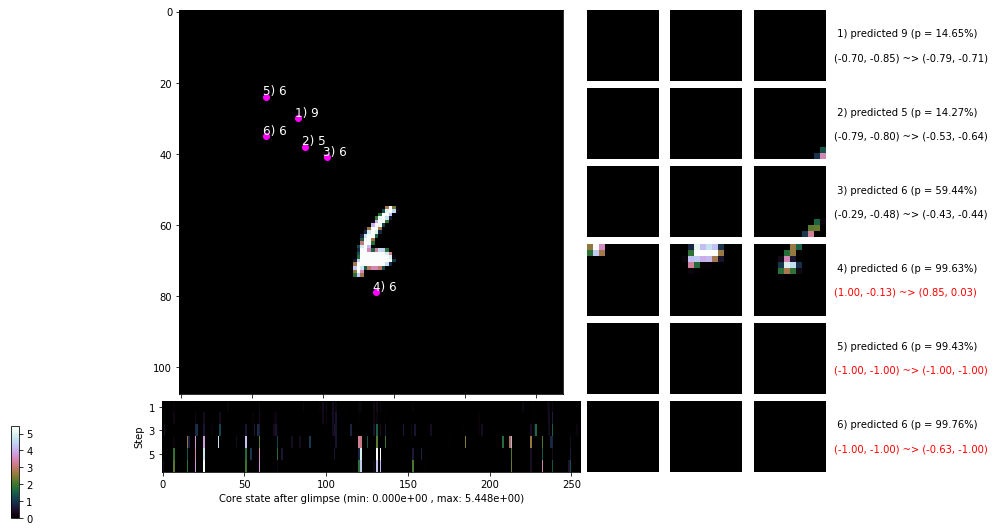

 b   2500/  4000 >> 104.8 ms/b | lr: 4.12e-04 | grad 2norm:  8.28 | grad inf norm:  3.155
       Weights || abs max:  2.80 ( 5388.30) | mean: -2.93e-02 ( 0.04) | var: 4.59e-02 ( 2284.95)
        Biases || abs max:  1.00 (   80.95) | mean: -1.56e-01 ( 0.18) | var: 4.60e-02 (  131.90)
                  class loss: 0.273 | steps: 2.280 | reward:  0.914 | acc.: 91.41%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.5 ms/b | lr: 4.10e-04 | grad 2norm: 24.03 | grad inf norm:  6.686
       Weights || abs max:  2.80 ( 7548.89) | mean: -2.93e-02 ( 0.05) | var: 4.59e-02 ( 6468.60)
        Biases || abs max:  1.00 (   91.34) | mean: -1.56e-01 ( 0.19) | var: 4.61e-02 (  162.89)
                  class loss: 0.288 | steps: 2.306 | reward:  0.910 | acc.: 91.01%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

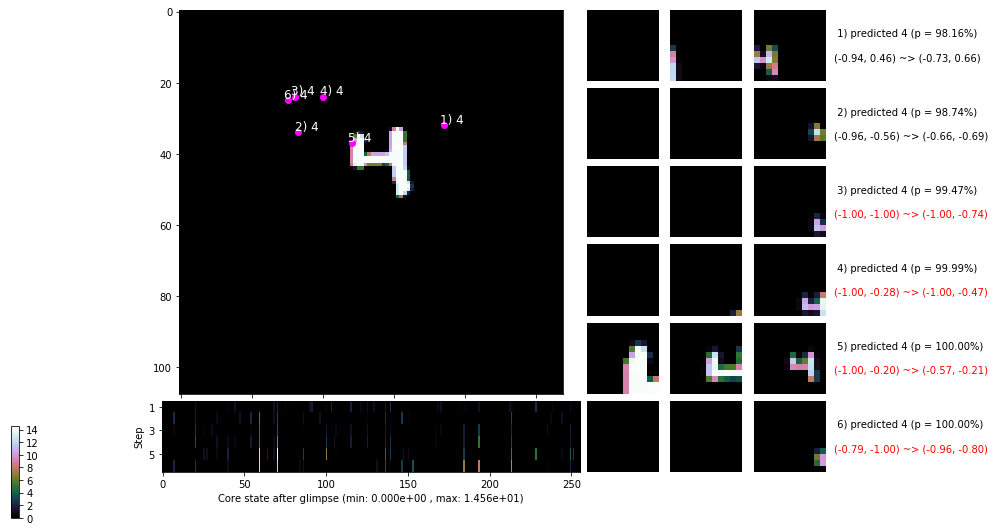

 b   3500/  4000 >> 110.1 ms/b | lr: 4.09e-04 | grad 2norm: 47.42 | grad inf norm: 11.829
       Weights || abs max:  2.81 ( 9008.93) | mean: -2.92e-02 ( 0.06) | var: 4.60e-02 (10328.00)
        Biases || abs max:  1.01 (  119.78) | mean: -1.56e-01 ( 0.23) | var: 4.62e-02 (  323.07)
                  class loss: 0.289 | steps: 2.289 | reward:  0.907 | acc.: 90.71%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 109.7 ms/b | lr: 4.07e-04 | grad 2norm: 53.83 | grad inf norm: 12.929
       Weights || abs max:  2.81 ( 5050.01) | mean: -2.91e-02 ( 0.04) | var: 4.61e-02 ( 1130.68)
        Biases || abs max:  1.01 (  112.83) | mean: -1.56e-01 ( 0.23) | var: 4.63e-02 (  135.33)
                  class loss: 0.264 | steps: 2.264 | reward:  0.917 | acc.: 91.65%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

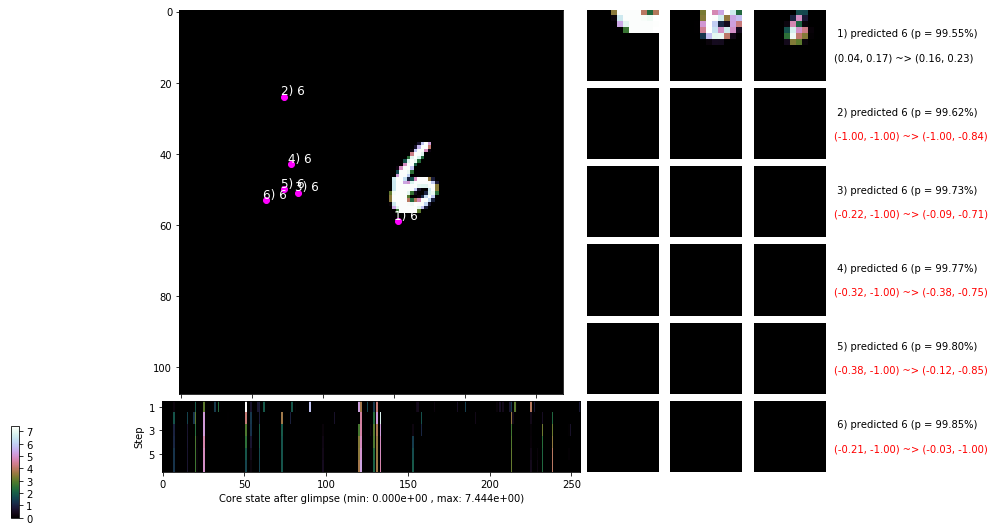

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


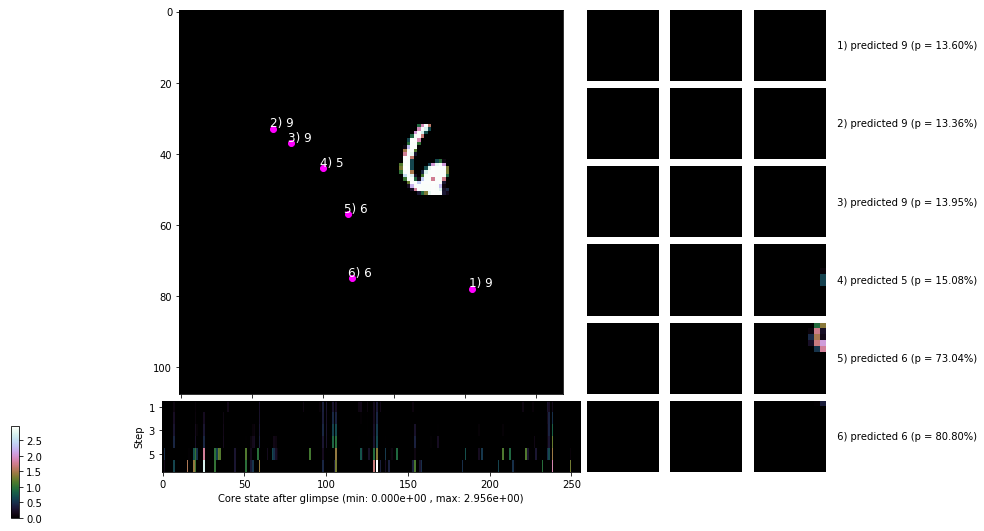


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


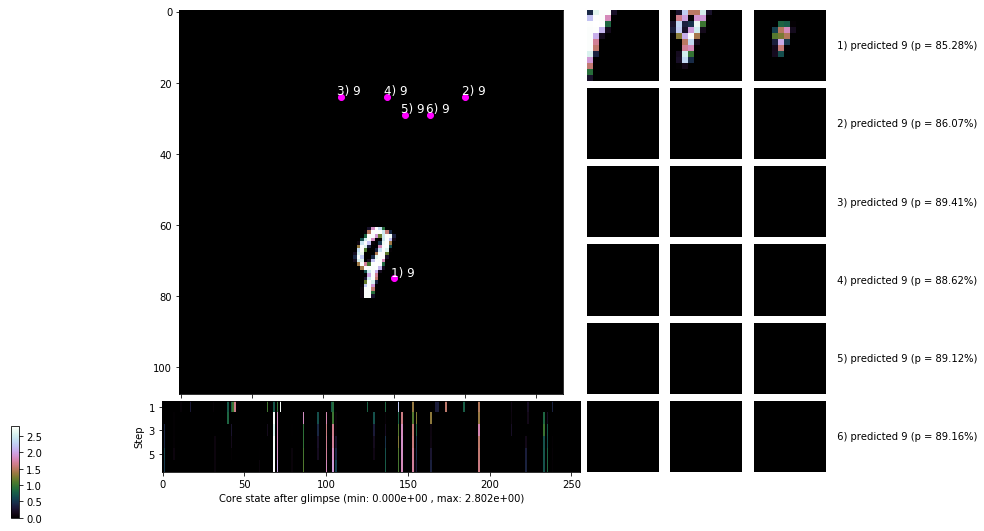

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


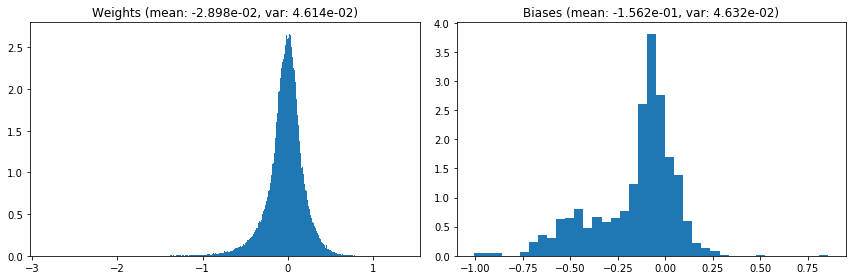

                                      Location network weights and biases


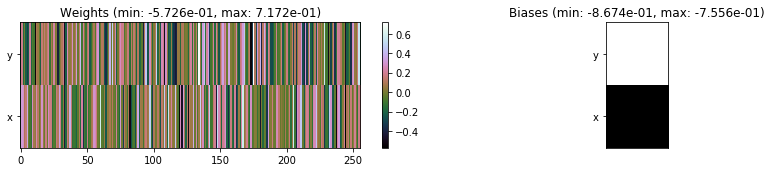

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.66 sec | TRAIN >> class loss: 0.2764 | steps:  2.285 :( | reward:  0.9127 :( | acc.: 91.267% :(
                          | VAL   >> class loss: 0.2442 | steps:  2.225 :( | reward:  0.9242 :( | acc.: 92.420% :(


Epoch  30/400) lr = 0.0004068
 b    500/  4000 >> 104.1 ms/b | lr: 4.06e-04 | grad 2norm: 47.52 | grad inf norm: 11.887
       Weights || abs max:  2.80 ( 5339.72) | mean: -2.90e-02 ( 0.04) | var: 4.62e-02 ( 2388.43)
        Biases || abs max:  1.00 (  590.90) | mean: -1.57e-01 ( 0.71) | var: 4.64e-02 (45255.84)
                  class loss: 0.274 | steps: 2.287 | reward:  0.914 | acc.: 91.38%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.2 ms/b | lr: 4.04e-04 | grad 2norm: 48.03 | grad inf norm: 11.936
       Weights || abs max:  2.80 ( 7099.06) | mean: -2.90e-02 ( 0.05) |

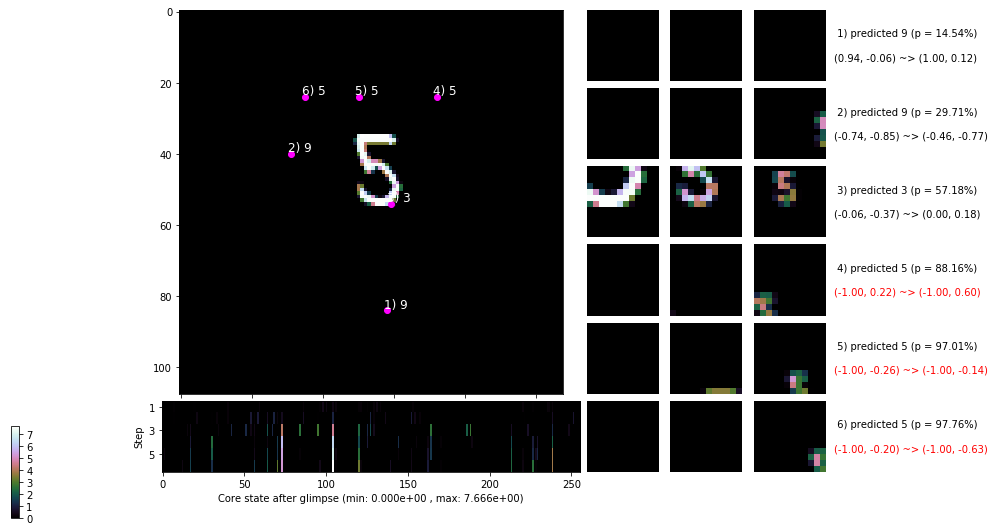

 b   1500/  4000 >> 113.2 ms/b | lr: 4.02e-04 | grad 2norm: 92.52 | grad inf norm: 22.204
       Weights || abs max:  2.81 ( 5583.85) | mean: -2.89e-02 ( 0.04) | var: 4.63e-02 ( 1993.23)
        Biases || abs max:  1.01 (   79.51) | mean: -1.57e-01 ( 0.17) | var: 4.67e-02 (   59.60)
                  class loss: 0.265 | steps: 2.277 | reward:  0.917 | acc.: 91.66%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 105.2 ms/b | lr: 4.01e-04 | grad 2norm: 129.65 | grad inf norm: 27.869
       Weights || abs max:  2.81 ( 9612.36) | mean: -2.88e-02 ( 0.06) | var: 4.64e-02 (20473.93)
        Biases || abs max:  1.01 (  120.60) | mean: -1.57e-01 ( 0.25) | var: 4.69e-02 (  645.78)
                  class loss: 0.245 | steps: 2.247 | reward:  0.923 | acc.: 92.30%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

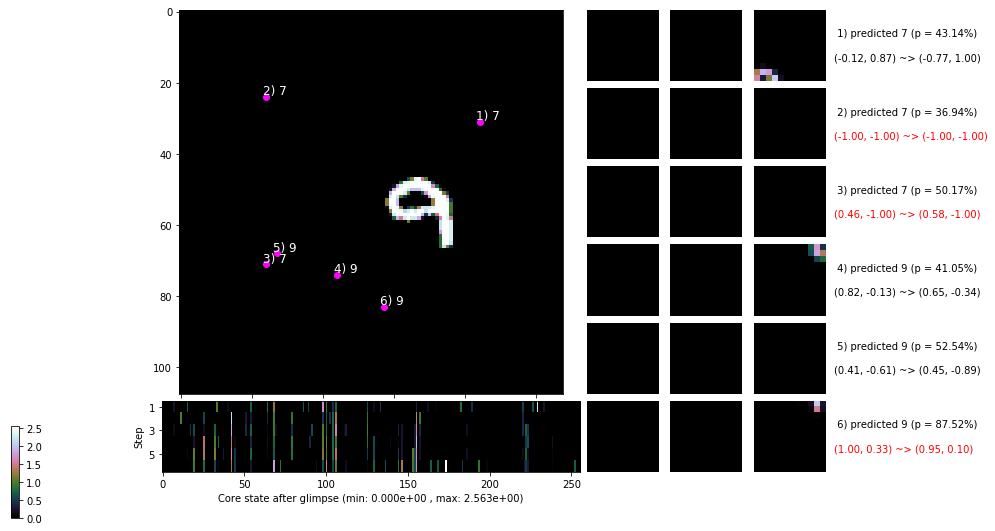

 b   2500/  4000 >> 108.3 ms/b | lr: 4.00e-04 | grad 2norm: 191.85 | grad inf norm: 43.148
       Weights || abs max:  2.82 ( 9227.76) | mean: -2.88e-02 ( 0.06) | var: 4.65e-02 ( 6870.55)
        Biases || abs max:  1.02 (   68.93) | mean: -1.58e-01 ( 0.19) | var: 4.73e-02 (   50.60)
                  class loss: 0.257 | steps: 2.218 | reward:  0.920 | acc.: 92.01%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 115.8 ms/b | lr: 3.98e-04 | grad 2norm: 95.12 | grad inf norm: 23.894
       Weights || abs max:  2.83 ( 5745.20) | mean: -2.90e-02 ( 0.04) | var: 4.65e-02 ( 2526.63)
        Biases || abs max:  1.02 (   63.84) | mean: -1.59e-01 ( 0.17) | var: 4.77e-02 (   30.89)
                  class loss: 0.270 | steps: 2.220 | reward:  0.918 | acc.: 91.81%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

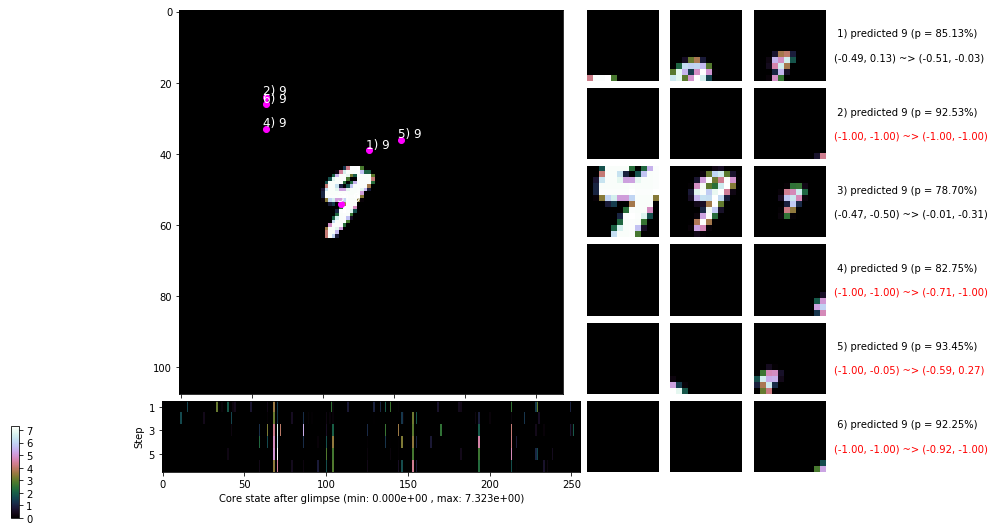

 b   3500/  4000 >> 112.9 ms/b | lr: 3.96e-04 | grad 2norm: 88.10 | grad inf norm: 22.021
       Weights || abs max:  2.84 ( 5400.67) | mean: -2.90e-02 ( 0.04) | var: 4.66e-02 ( 1350.23)
        Biases || abs max:  1.02 (   58.99) | mean: -1.59e-01 ( 0.16) | var: 4.79e-02 (  204.71)
                  class loss: 0.257 | steps: 2.222 | reward:  0.918 | acc.: 91.78%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 107.9 ms/b | lr: 3.95e-04 | grad 2norm: 49.76 | grad inf norm: 13.030
       Weights || abs max:  2.84 (15502.12) | mean: -2.90e-02 ( 0.08) | var: 4.66e-02 (169057.88)
        Biases || abs max:  1.02 (   92.88) | mean: -1.59e-01 ( 0.19) | var: 4.81e-02 (  111.67)
                  class loss: 0.256 | steps: 2.200 | reward:  0.919 | acc.: 91.89%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

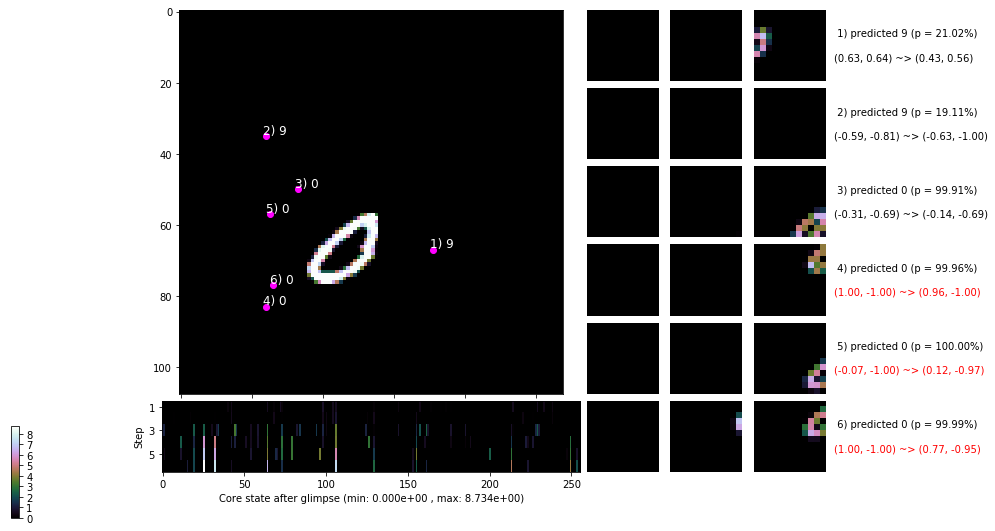

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


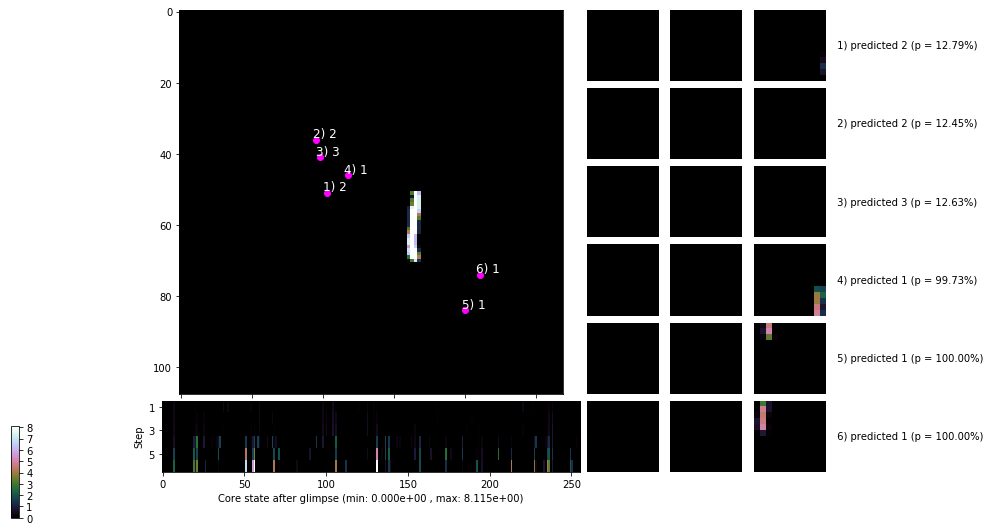


	Target class: 7  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


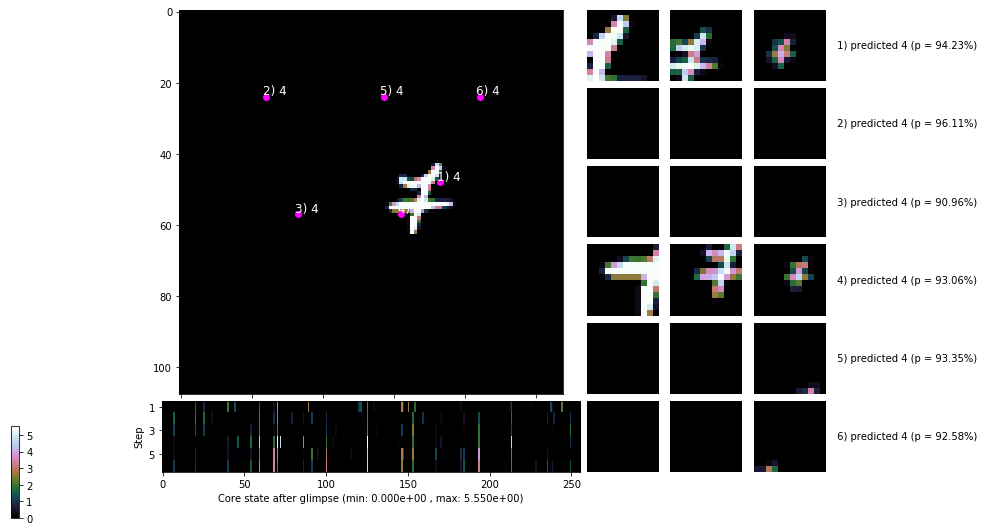

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


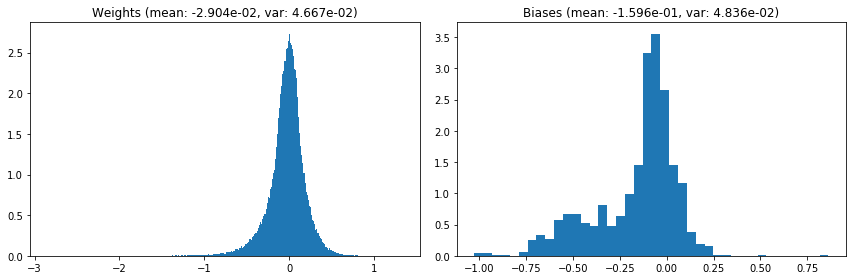

                                      Location network weights and biases


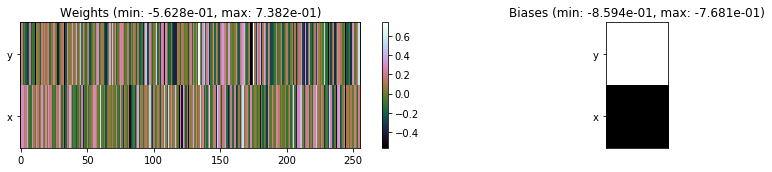

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.87 sec | TRAIN >> class loss: 0.2617 | steps:  2.242    | reward:  0.9175    | acc.: 91.752% 
                          | VAL   >> class loss: 0.2239 | steps:  2.096    | reward:  0.9268 :( | acc.: 92.680% :(


Epoch  31/400) lr = 0.0003944
 b    500/  4000 >> 113.0 ms/b | lr: 3.93e-04 | grad 2norm:  8.31 | grad inf norm:  3.184
       Weights || abs max:  2.84 ( 8180.96) | mean: -2.91e-02 ( 0.05) | var: 4.67e-02 (13682.95)
        Biases || abs max:  1.03 (  168.32) | mean: -1.60e-01 ( 0.30) | var: 4.85e-02 ( 1862.83)
                  class loss: 0.253 | steps: 2.200 | reward:  0.921 | acc.: 92.09%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 105.0 ms/b | lr: 3.92e-04 | grad 2norm:  7.81 | grad inf norm:  2.981
       Weights || abs max:  2.84 ( 9076.70) | mean: -2.90e-02 ( 0.06) | v

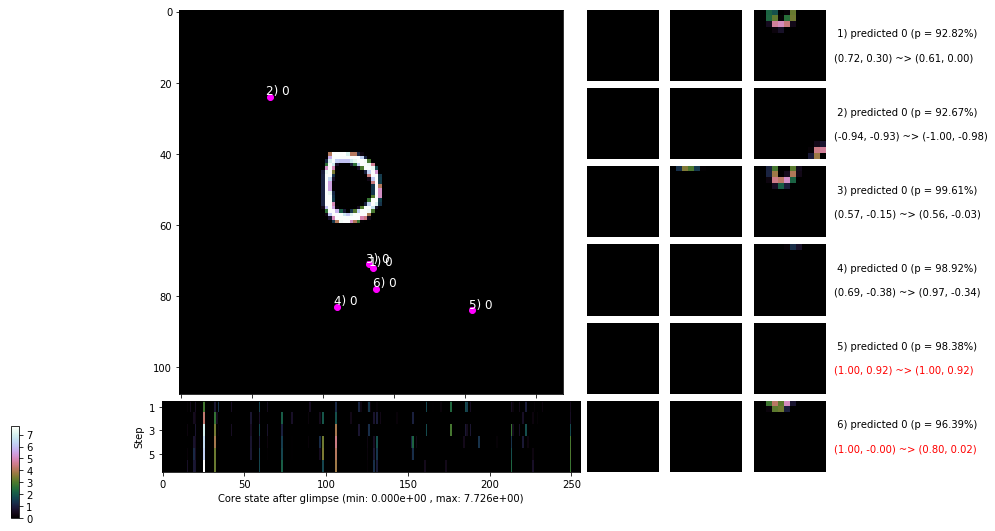

 b   1500/  4000 >> 103.0 ms/b | lr: 3.90e-04 | grad 2norm: 54.56 | grad inf norm: 13.518
       Weights || abs max:  2.84 ( 4526.59) | mean: -2.90e-02 ( 0.04) | var: 4.68e-02 (  601.75)
        Biases || abs max:  1.03 (  229.10) | mean: -1.60e-01 ( 0.33) | var: 4.89e-02 ( 2536.94)
                  class loss: 0.261 | steps: 2.263 | reward:  0.916 | acc.: 91.63%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.8 ms/b | lr: 3.88e-04 | grad 2norm: 14.24 | grad inf norm:  4.558
       Weights || abs max:  2.84 ( 7312.57) | mean: -2.90e-02 ( 0.05) | var: 4.69e-02 (14876.71)
        Biases || abs max:  1.03 (   54.95) | mean: -1.60e-01 ( 0.14) | var: 4.91e-02 (   29.38)
                  class loss: 0.255 | steps: 2.214 | reward:  0.920 | acc.: 91.97%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

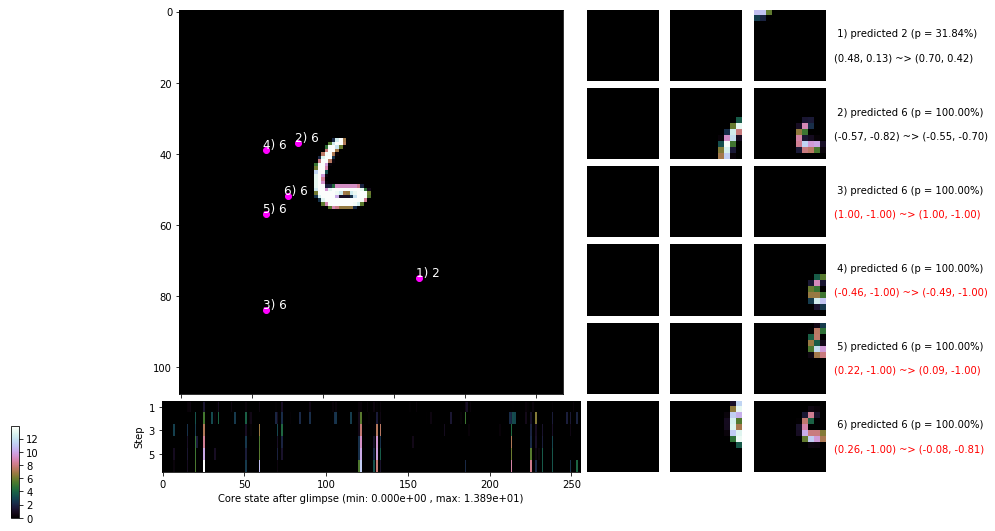

 b   2500/  4000 >> 102.2 ms/b | lr: 3.87e-04 | grad 2norm: 83.82 | grad inf norm: 19.680
       Weights || abs max:  2.85 ( 7762.86) | mean: -2.90e-02 ( 0.05) | var: 4.70e-02 ( 7000.71)
        Biases || abs max:  1.03 (  112.29) | mean: -1.61e-01 ( 0.22) | var: 4.93e-02 (  489.82)
                  class loss: 0.248 | steps: 2.219 | reward:  0.922 | acc.: 92.21%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.0 ms/b | lr: 3.86e-04 | grad 2norm: 134.05 | grad inf norm: 30.316
       Weights || abs max:  2.85 ( 5912.70) | mean: -2.89e-02 ( 0.04) | var: 4.70e-02 ( 1836.58)
        Biases || abs max:  1.03 (   56.53) | mean: -1.61e-01 ( 0.17) | var: 4.95e-02 (   36.50)
                  class loss: 0.256 | steps: 2.205 | reward:  0.921 | acc.: 92.11%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

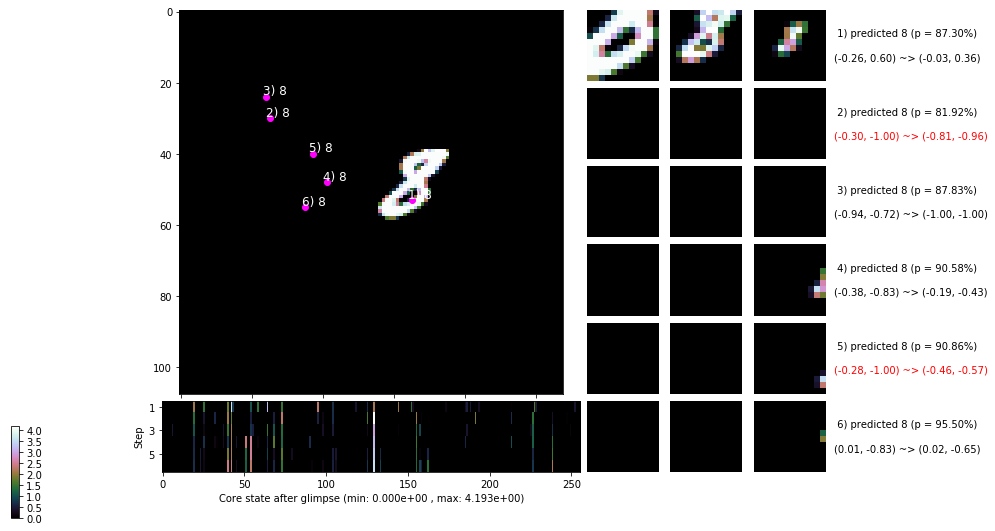

 b   3500/  4000 >> 104.8 ms/b | lr: 3.84e-04 | grad 2norm: 11.41 | grad inf norm:  3.902
       Weights || abs max:  2.86 ( 5499.97) | mean: -2.89e-02 ( 0.04) | var: 4.71e-02 ( 2053.80)
        Biases || abs max:  1.02 (   66.25) | mean: -1.61e-01 ( 0.15) | var: 4.94e-02 (   47.99)
                  class loss: 0.250 | steps: 2.179 | reward:  0.923 | acc.: 92.26%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 105.5 ms/b | lr: 3.83e-04 | grad 2norm: 97.26 | grad inf norm: 22.114
       Weights || abs max:  2.87 ( 7016.52) | mean: -2.88e-02 ( 0.05) | var: 4.72e-02 ( 3447.52)
        Biases || abs max:  1.02 (   94.05) | mean: -1.62e-01 ( 0.18) | var: 4.94e-02 (  390.09)
                  class loss: 0.257 | steps: 2.251 | reward:  0.920 | acc.: 92.02%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

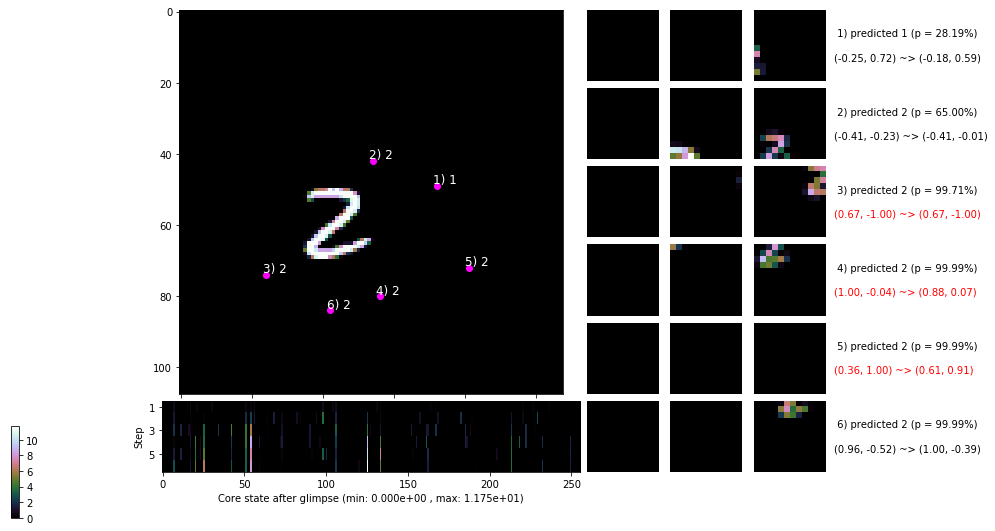

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


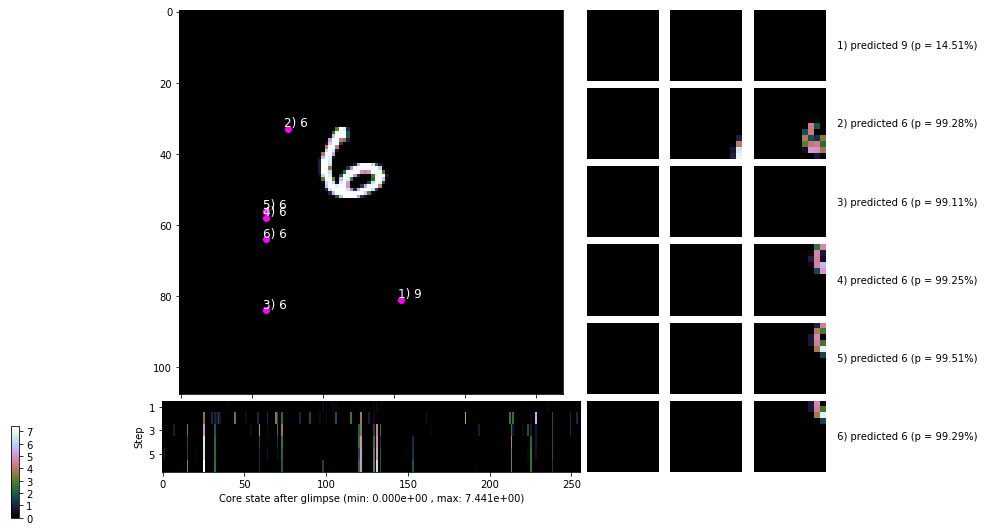


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


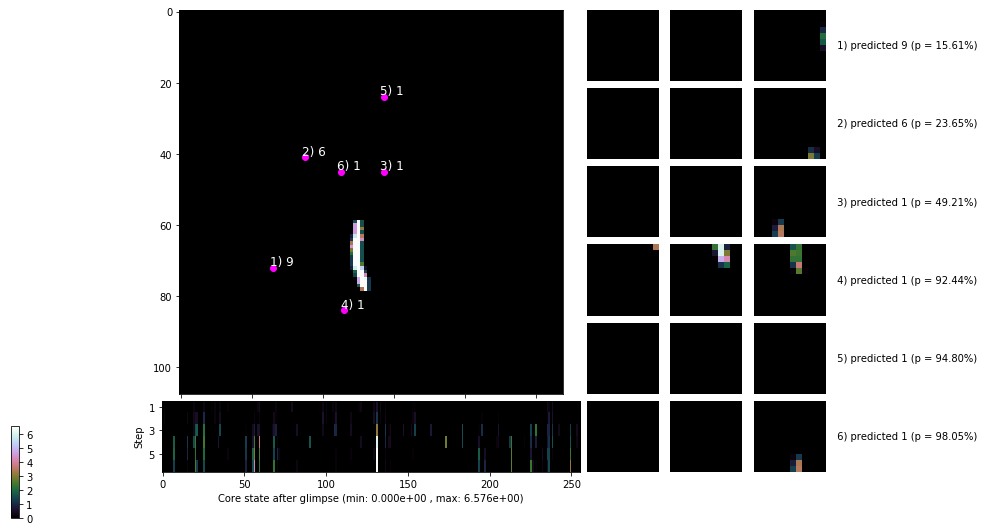

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


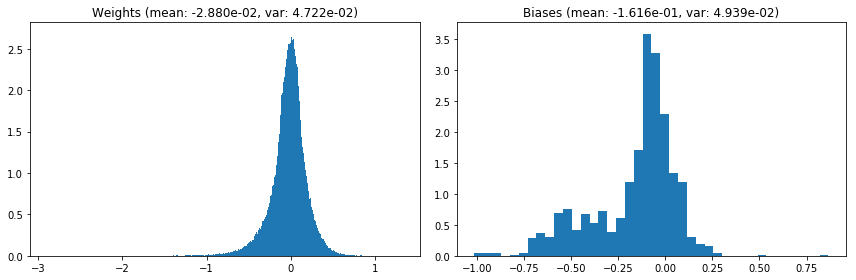

                                      Location network weights and biases


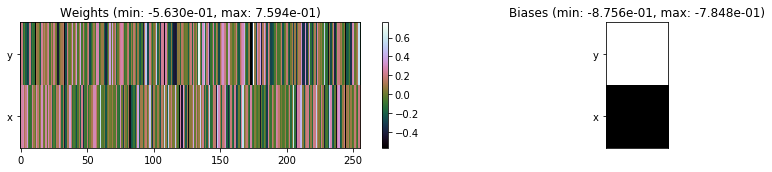

---------------------------------------------------------------------------------------------------------------
Elapsed time:  418.79 sec | TRAIN >> class loss: 0.2539 | steps:  2.221    | reward:  0.9206    | acc.: 92.064% 
                          | VAL   >> class loss: 0.2329 | steps:  2.215 :( | reward:  0.9290    | acc.: 92.900% 


Epoch  32/400) lr = 0.0003823
 b    500/  4000 >> 103.4 ms/b | lr: 3.81e-04 | grad 2norm: 304.70 | grad inf norm: 66.947
       Weights || abs max:  2.88 (26019.27) | mean: -2.87e-02 ( 0.12) | var: 4.73e-02 (859835.94)
        Biases || abs max:  1.01 (   85.10) | mean: -1.62e-01 ( 0.17) | var: 4.93e-02 (  244.48)
                  class loss: 0.256 | steps: 2.227 | reward:  0.922 | acc.: 92.21%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.2 ms/b | lr: 3.80e-04 | grad 2norm: 70.59 | grad inf norm: 17.697
       Weights || abs max:  2.88 ( 5715.69) | mean: -2.86e-02 ( 0.04) | v

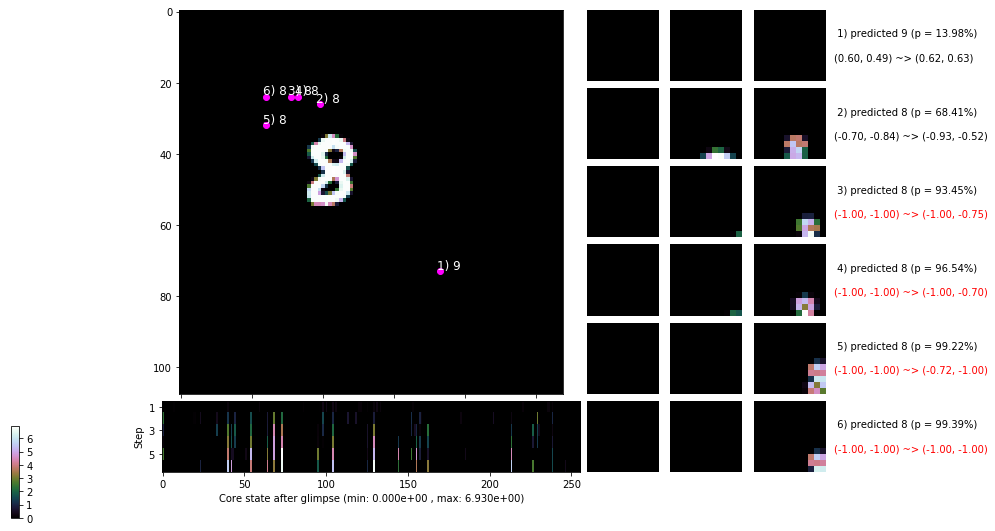

 b   1500/  4000 >> 105.5 ms/b | lr: 3.78e-04 | grad 2norm: 89.25 | grad inf norm: 21.561
       Weights || abs max:  2.88 (12069.67) | mean: -2.86e-02 ( 0.07) | var: 4.74e-02 (23191.34)
        Biases || abs max:  1.02 (  112.04) | mean: -1.62e-01 ( 0.20) | var: 4.98e-02 (  402.50)
                  class loss: 0.239 | steps: 2.219 | reward:  0.924 | acc.: 92.39%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.0 ms/b | lr: 3.77e-04 | grad 2norm: 1111.58 | grad inf norm: 234.635
       Weights || abs max:  2.87 ( 7014.75) | mean: -2.86e-02 ( 0.05) | var: 4.75e-02 ( 5054.51)
        Biases || abs max:  1.03 (   98.59) | mean: -1.63e-01 ( 0.19) | var: 5.00e-02 (  221.05)
                  class loss: 0.251 | steps: 2.252 | reward:  0.924 | acc.: 92.37%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

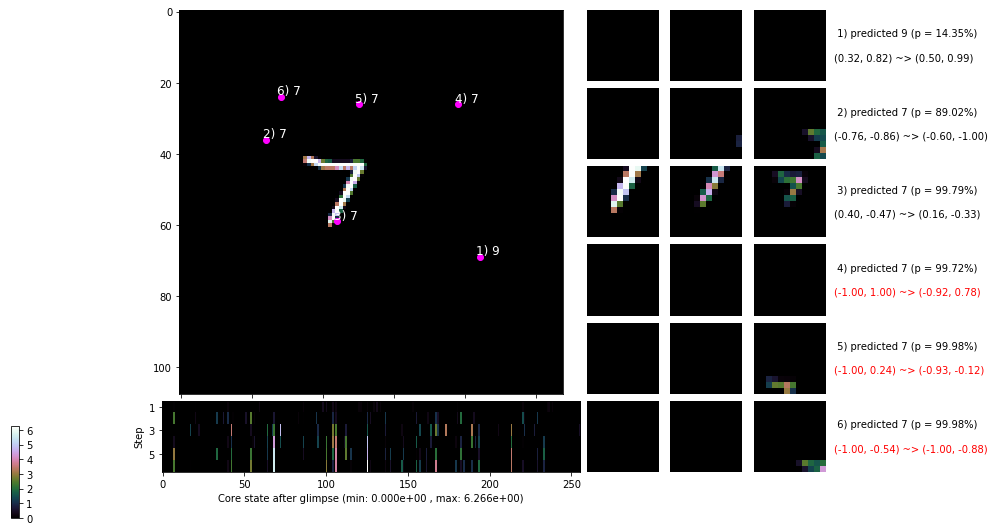

 b   2500/  4000 >> 110.4 ms/b | lr: 3.76e-04 | grad 2norm: 430.94 | grad inf norm: 94.316
       Weights || abs max:  2.87 ( 6384.01) | mean: -2.85e-02 ( 0.05) | var: 4.75e-02 ( 7435.74)
        Biases || abs max:  1.03 (  119.48) | mean: -1.63e-01 ( 0.23) | var: 5.03e-02 (  266.08)
                  class loss: 0.280 | steps: 2.259 | reward:  0.922 | acc.: 92.23%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 107.2 ms/b | lr: 3.74e-04 | grad 2norm: 52.23 | grad inf norm: 11.150
       Weights || abs max:  2.87 (18678.28) | mean: -2.86e-02 ( 0.09) | var: 4.76e-02 (395487.44)
        Biases || abs max:  1.05 (  161.42) | mean: -1.63e-01 ( 0.28) | var: 5.08e-02 (  534.59)
                  class loss: 0.419 | steps: 2.276 | reward:  0.918 | acc.: 91.80%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

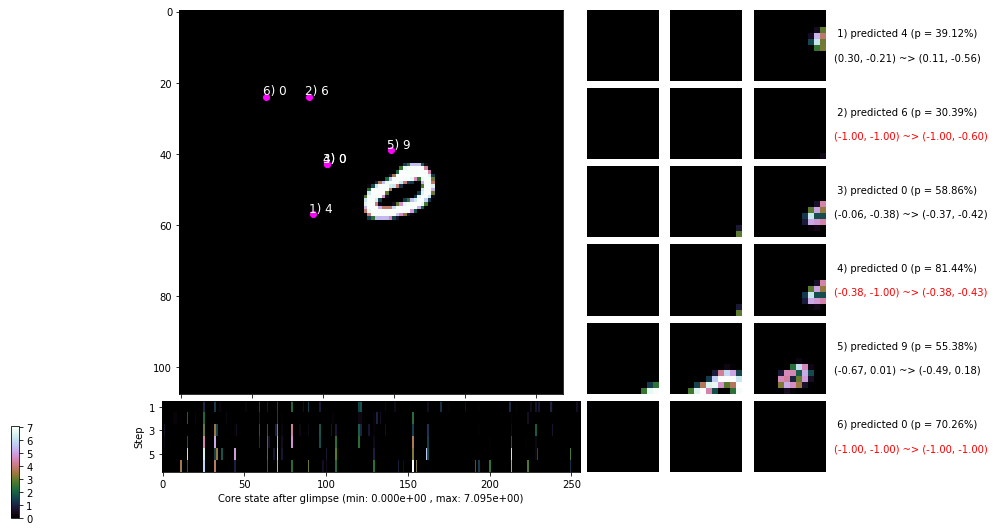

 b   3500/  4000 >> 105.8 ms/b | lr: 3.73e-04 | grad 2norm:  9.46 | grad inf norm:  3.352
       Weights || abs max:  2.87 ( 4304.72) | mean: -2.86e-02 ( 0.04) | var: 4.76e-02 (  980.12)
        Biases || abs max:  1.05 (  134.08) | mean: -1.63e-01 ( 0.25) | var: 5.07e-02 (  235.19)
                  class loss: 0.260 | steps: 2.274 | reward:  0.918 | acc.: 91.83%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.7 ms/b | lr: 3.71e-04 | grad 2norm:  9.94 | grad inf norm:  3.577
       Weights || abs max:  2.87 ( 8810.59) | mean: -2.86e-02 ( 0.05) | var: 4.77e-02 (24560.56)
        Biases || abs max:  1.05 (   93.37) | mean: -1.63e-01 ( 0.21) | var: 5.08e-02 (  240.88)
                  class loss: 0.259 | steps: 2.253 | reward:  0.918 | acc.: 91.81%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

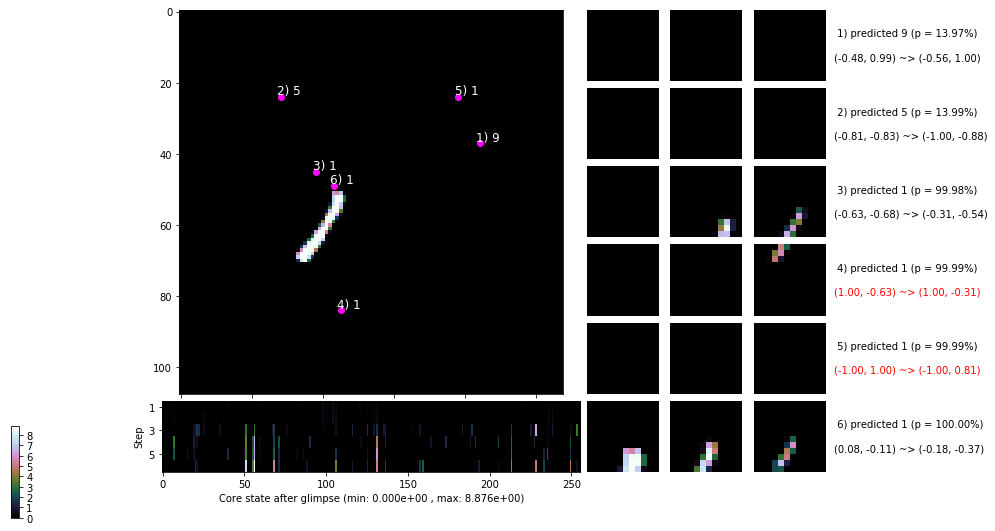

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


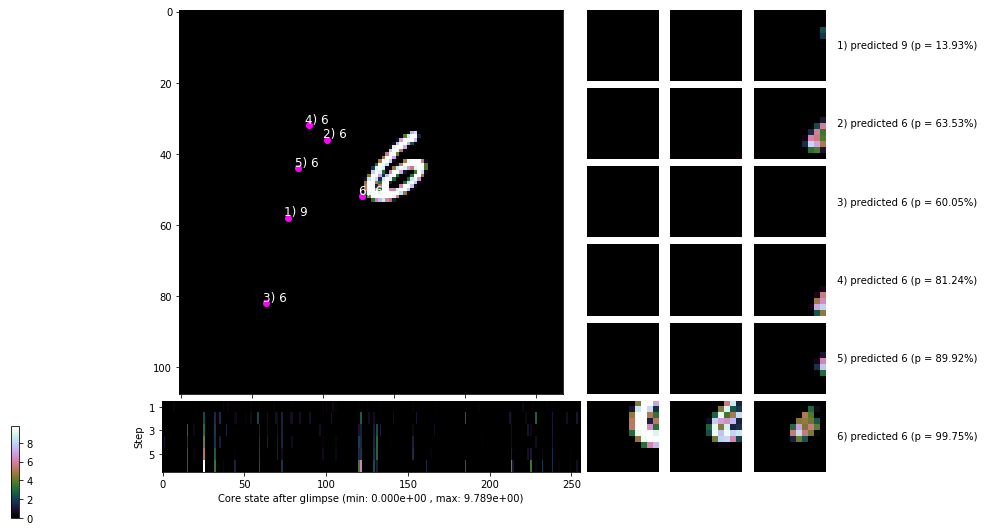


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


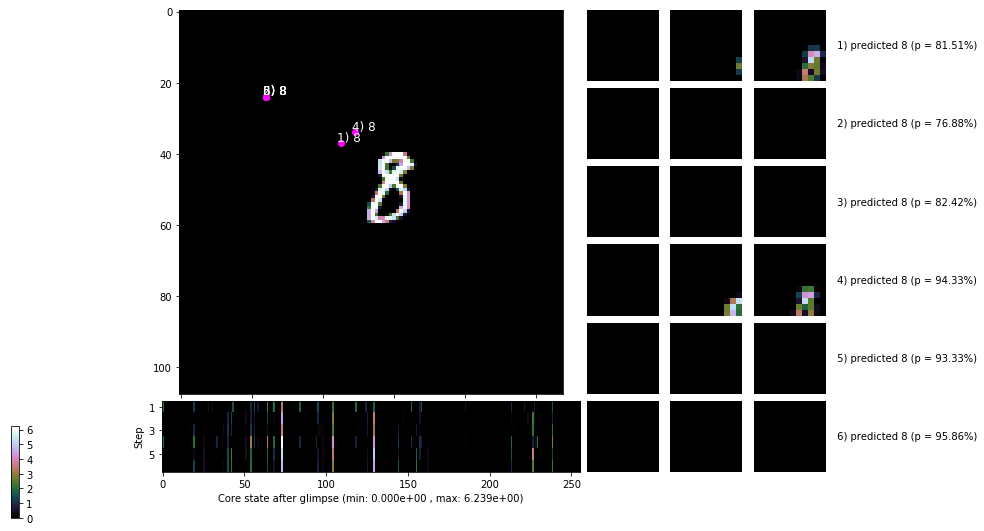

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


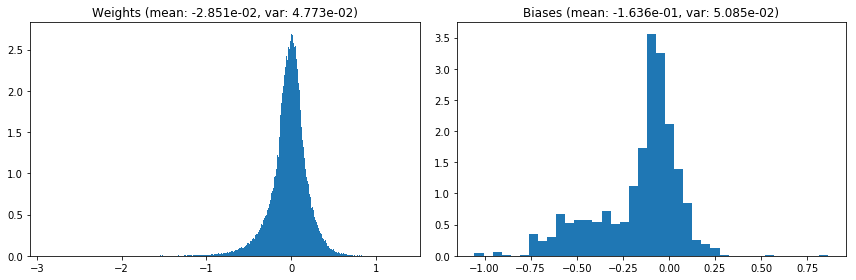

                                      Location network weights and biases


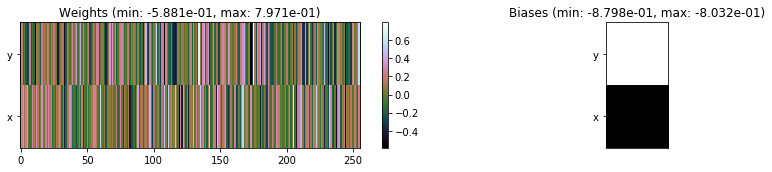

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.15 sec | TRAIN >> class loss: 0.2761 | steps:  2.244 :( | reward:  0.9212    | acc.: 92.119% 
                          | VAL   >> class loss: 0.2634 | steps:  2.236 :( | reward:  0.9114 :( | acc.: 91.140% :(


Epoch  33/400) lr = 0.0003707
 b    500/  4000 >> 110.8 ms/b | lr: 3.70e-04 | grad 2norm:  9.10 | grad inf norm:  3.349
       Weights || abs max:  2.87 (11941.01) | mean: -2.85e-02 ( 0.07) | var: 4.78e-02 (116403.92)
        Biases || abs max:  1.06 (   90.86) | mean: -1.64e-01 ( 0.21) | var: 5.11e-02 (  237.82)
                  class loss: 0.255 | steps: 2.237 | reward:  0.918 | acc.: 91.76%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.0 ms/b | lr: 3.68e-04 | grad 2norm: 26.85 | grad inf norm:  7.322
       Weights || abs max:  2.87 (13619.97) | mean: -2.85e-02 ( 0.07) | 

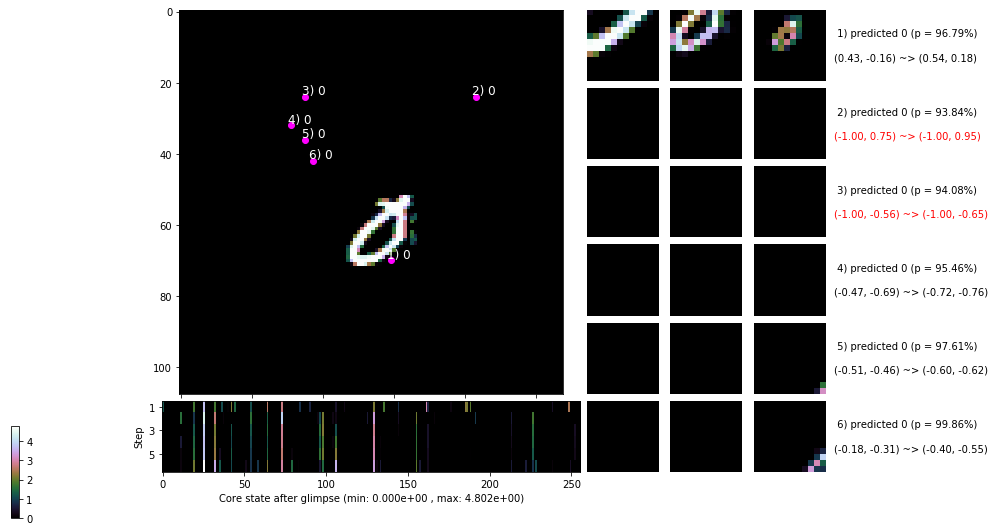

 b   1500/  4000 >> 103.5 ms/b | lr: 3.67e-04 | grad 2norm: 306.44 | grad inf norm: 62.606
       Weights || abs max:  2.88 ( 3575.23) | mean: -2.85e-02 ( 0.03) | var: 4.79e-02 (  338.68)
        Biases || abs max:  1.07 (  103.69) | mean: -1.64e-01 ( 0.22) | var: 5.14e-02 (  444.79)
                  class loss: 0.252 | steps: 2.251 | reward:  0.921 | acc.: 92.15%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 105.2 ms/b | lr: 3.65e-04 | grad 2norm:  8.36 | grad inf norm:  3.155
       Weights || abs max:  2.89 ( 9234.76) | mean: -2.85e-02 ( 0.06) | var: 4.79e-02 (11032.02)
        Biases || abs max:  1.07 (   67.05) | mean: -1.65e-01 ( 0.17) | var: 5.18e-02 (   67.38)
                  class loss: 0.245 | steps: 2.253 | reward:  0.925 | acc.: 92.50%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

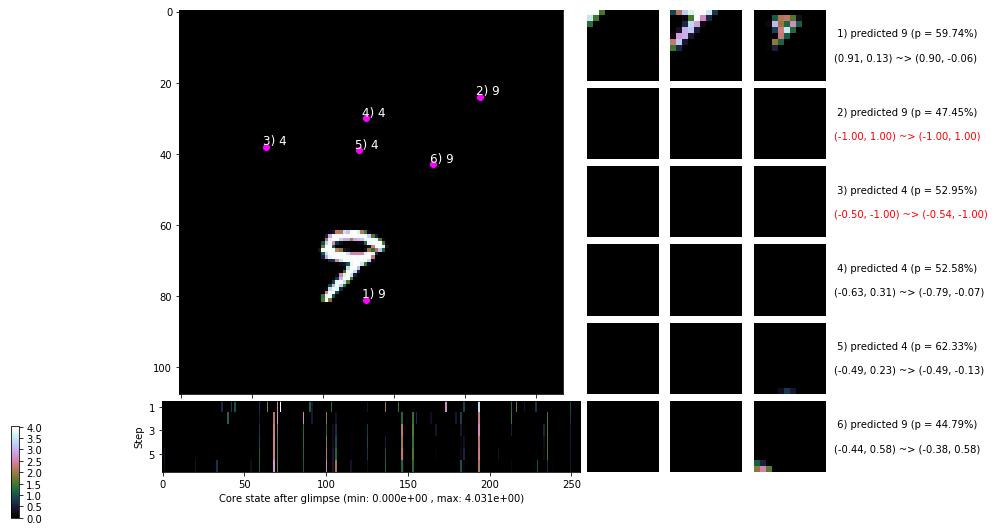

 b   2500/  4000 >> 117.3 ms/b | lr: 3.64e-04 | grad 2norm:  9.56 | grad inf norm:  3.373
       Weights || abs max:  2.91 (15362.29) | mean: -2.84e-02 ( 0.08) | var: 4.80e-02 (109267.55)
        Biases || abs max:  1.07 (   76.63) | mean: -1.65e-01 ( 0.17) | var: 5.19e-02 (  177.96)
                  class loss: 0.240 | steps: 2.252 | reward:  0.924 | acc.: 92.39%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 114.9 ms/b | lr: 3.63e-04 | grad 2norm:  7.96 | grad inf norm:  3.095
       Weights || abs max:  2.92 ( 5293.20) | mean: -2.83e-02 ( 0.04) | var: 4.81e-02 ( 3251.97)
        Biases || abs max:  1.08 (   68.01) | mean: -1.65e-01 ( 0.19) | var: 5.20e-02 (   48.83)
                  class loss: 0.258 | steps: 2.281 | reward:  0.919 | acc.: 91.95%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

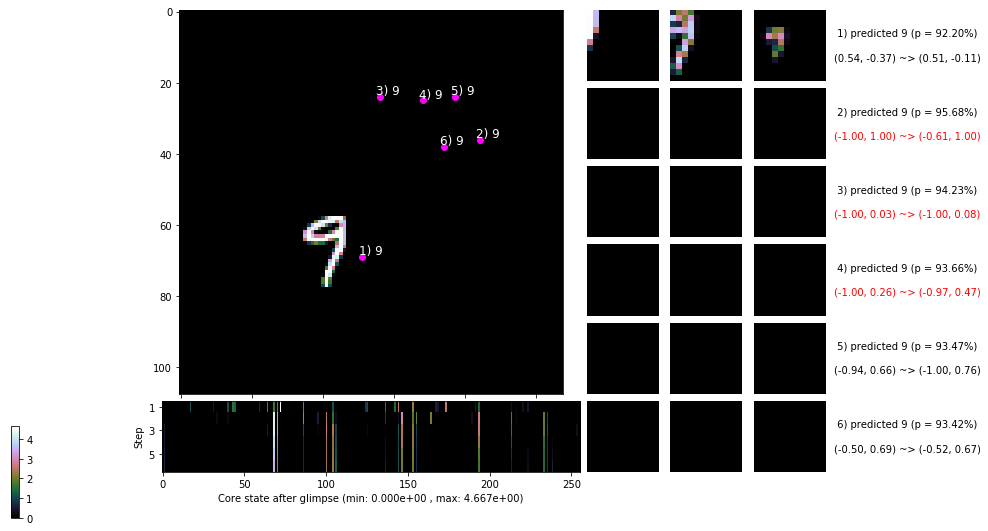

 b   3500/  4000 >> 104.2 ms/b | lr: 3.61e-04 | grad 2norm: 11.82 | grad inf norm:  3.928
       Weights || abs max:  2.93 ( 4917.99) | mean: -2.83e-02 ( 0.04) | var: 4.82e-02 ( 3303.83)
        Biases || abs max:  1.09 (   56.96) | mean: -1.65e-01 ( 0.15) | var: 5.22e-02 (   33.65)
                  class loss: 0.255 | steps: 2.285 | reward:  0.918 | acc.: 91.76%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.9 ms/b | lr: 3.60e-04 | grad 2norm: 11.76 | grad inf norm:  3.935
       Weights || abs max:  2.93 (10148.68) | mean: -2.83e-02 ( 0.06) | var: 4.82e-02 (16400.89)
        Biases || abs max:  1.09 (   82.37) | mean: -1.65e-01 ( 0.18) | var: 5.23e-02 (   71.01)
                  class loss: 0.257 | steps: 2.290 | reward:  0.915 | acc.: 91.54%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

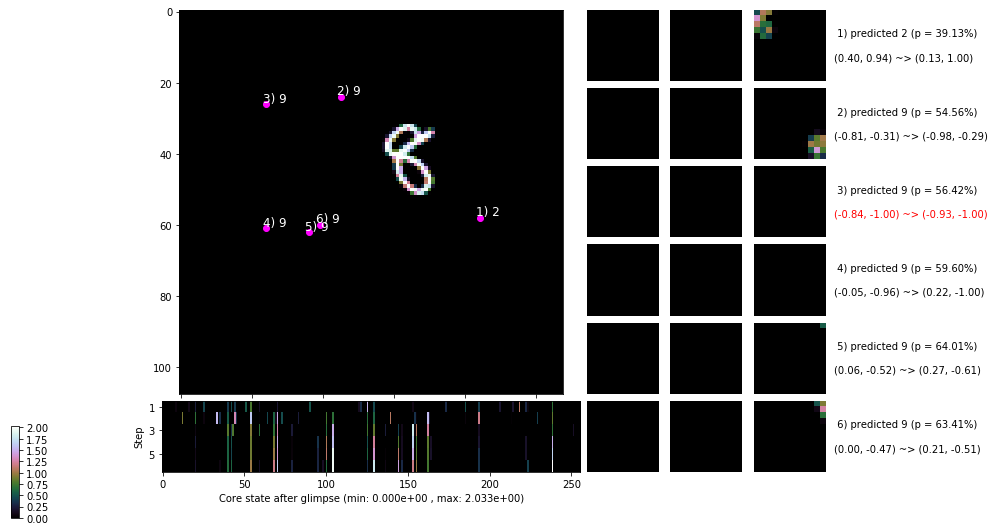

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


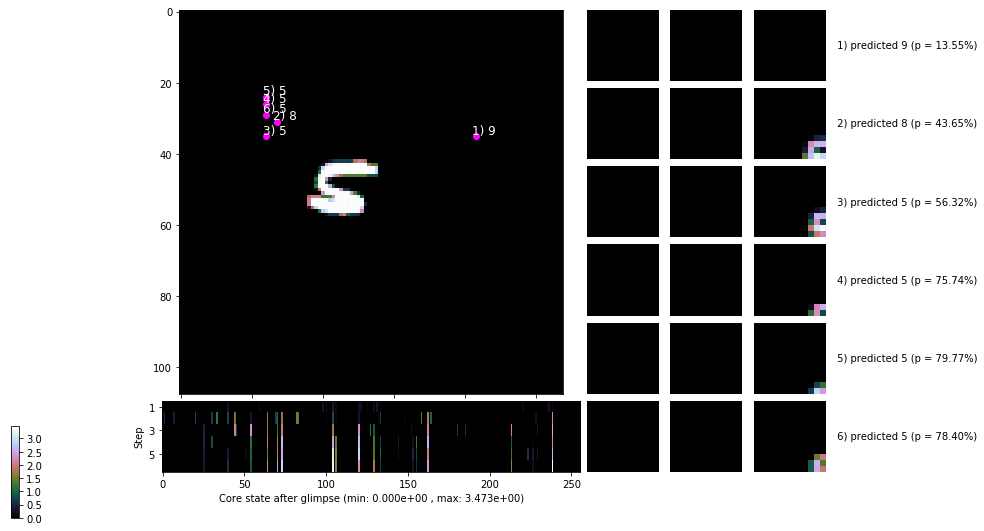


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


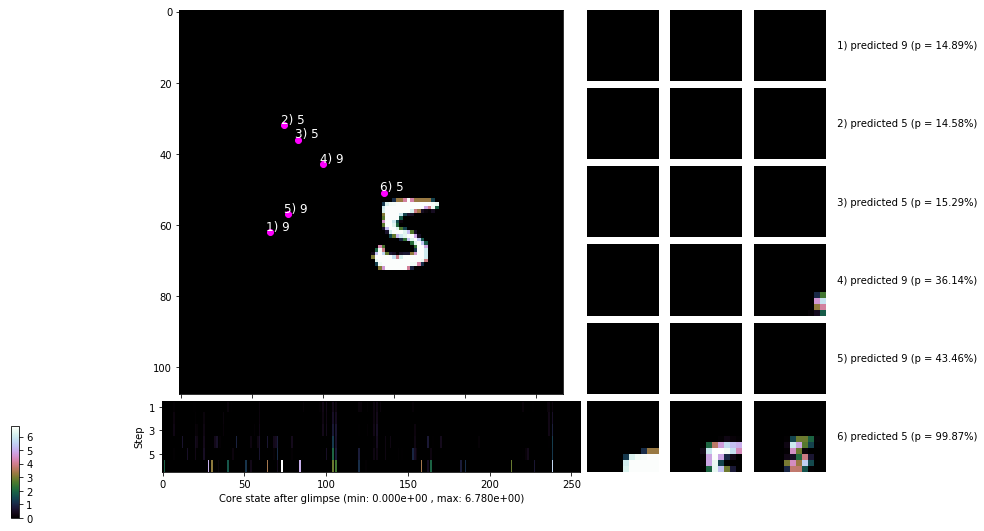

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


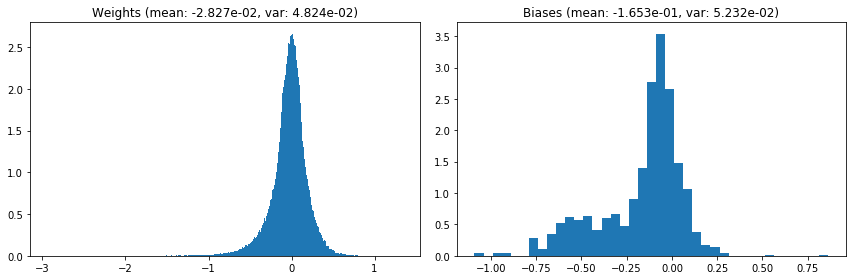

                                      Location network weights and biases


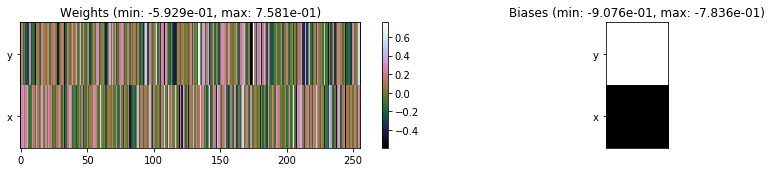

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.01 sec | TRAIN >> class loss: 0.2519 | steps:  2.261 :( | reward:  0.9200 :( | acc.: 91.996% :(
                          | VAL   >> class loss: 0.2434 | steps:  2.280 :( | reward:  0.9190 :( | acc.: 91.900% :(


Epoch  34/400) lr = 0.0003593
 b    500/  4000 >> 101.6 ms/b | lr: 3.58e-04 | grad 2norm: 22.97 | grad inf norm:  6.426
       Weights || abs max:  2.94 ( 8183.04) | mean: -2.82e-02 ( 0.05) | var: 4.83e-02 ( 7425.68)
        Biases || abs max:  1.09 (  125.49) | mean: -1.65e-01 ( 0.24) | var: 5.25e-02 (  230.80)
                  class loss: 0.253 | steps: 2.262 | reward:  0.921 | acc.: 92.06%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.5 ms/b | lr: 3.57e-04 | grad 2norm: 12.58 | grad inf norm:  4.186
       Weights || abs max:  2.95 (14337.53) | mean: -2.83e-02 ( 0.07) |

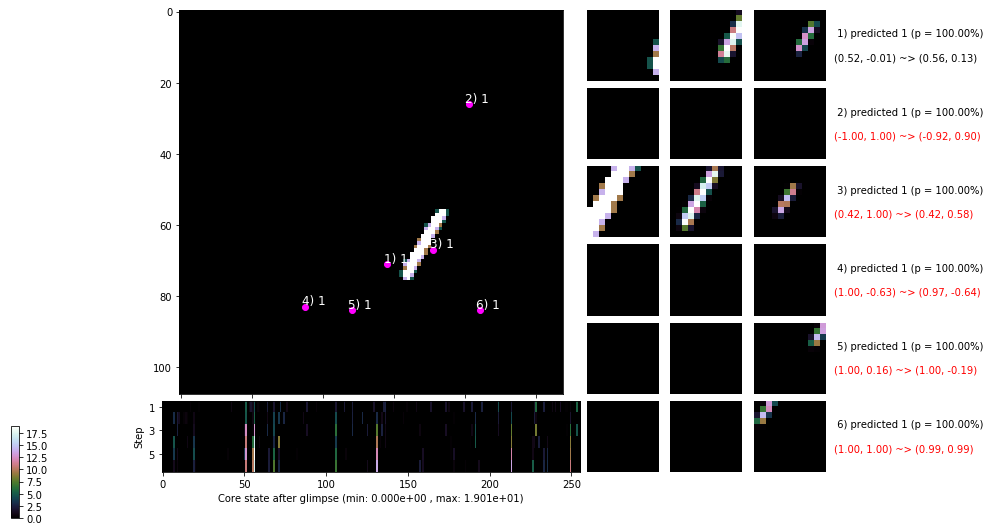

 b   1500/  4000 >> 106.9 ms/b | lr: 3.55e-04 | grad 2norm: 30.73 | grad inf norm:  8.240
       Weights || abs max:  2.95 (15272.05) | mean: -2.82e-02 ( 0.08) | var: 4.84e-02 (186028.14)
        Biases || abs max:  1.09 (   74.76) | mean: -1.66e-01 ( 0.18) | var: 5.30e-02 (  194.40)
                  class loss: 0.246 | steps: 2.264 | reward:  0.921 | acc.: 92.09%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 108.2 ms/b | lr: 3.54e-04 | grad 2norm: 14.03 | grad inf norm:  4.496
       Weights || abs max:  2.96 ( 5296.73) | mean: -2.82e-02 ( 0.04) | var: 4.84e-02 ( 7007.21)
        Biases || abs max:  1.09 (  152.03) | mean: -1.66e-01 ( 0.25) | var: 5.32e-02 (  563.05)
                  class loss: 0.256 | steps: 2.297 | reward:  0.918 | acc.: 91.80%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

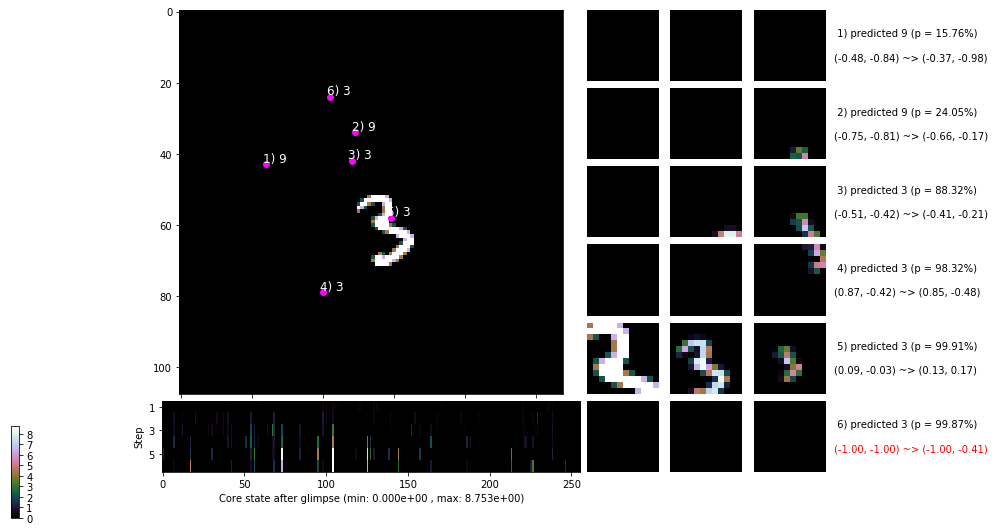

 b   2500/  4000 >> 103.9 ms/b | lr: 3.53e-04 | grad 2norm: 38.40 | grad inf norm:  9.869
       Weights || abs max:  2.97 ( 4516.05) | mean: -2.82e-02 ( 0.04) | var: 4.85e-02 ( 1195.32)
        Biases || abs max:  1.09 (  137.32) | mean: -1.66e-01 ( 0.21) | var: 5.34e-02 ( 3063.23)
                  class loss: 0.268 | steps: 2.318 | reward:  0.913 | acc.: 91.29%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 100.4 ms/b | lr: 3.52e-04 | grad 2norm: 74.52 | grad inf norm: 16.833
       Weights || abs max:  2.97 ( 5538.73) | mean: -2.81e-02 ( 0.04) | var: 4.85e-02 ( 1783.73)
        Biases || abs max:  1.09 (  165.21) | mean: -1.67e-01 ( 0.24) | var: 5.35e-02 ( 4675.64)
                  class loss: 0.265 | steps: 2.292 | reward:  0.914 | acc.: 91.35%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

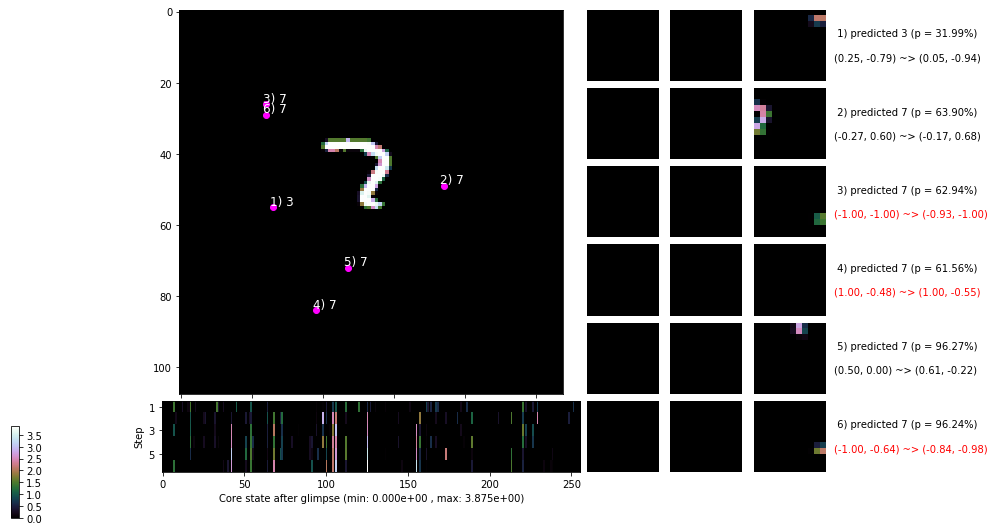

 b   3500/  4000 >> 104.1 ms/b | lr: 3.50e-04 | grad 2norm: 24.04 | grad inf norm:  4.946
       Weights || abs max:  2.97 ( 6828.19) | mean: -2.81e-02 ( 0.05) | var: 4.86e-02 ( 7162.90)
        Biases || abs max:  1.09 (  123.66) | mean: -1.67e-01 ( 0.21) | var: 5.37e-02 (  615.86)
                  class loss: 0.441 | steps: 2.329 | reward:  0.916 | acc.: 91.57%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.7 ms/b | lr: 3.49e-04 | grad 2norm:  9.10 | grad inf norm:  3.267
       Weights || abs max:  2.98 ( 8282.44) | mean: -2.82e-02 ( 0.05) | var: 4.86e-02 ( 5083.00)
        Biases || abs max:  1.10 (  109.01) | mean: -1.67e-01 ( 0.21) | var: 5.39e-02 (  168.51)
                  class loss: 0.248 | steps: 2.233 | reward:  0.923 | acc.: 92.27%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

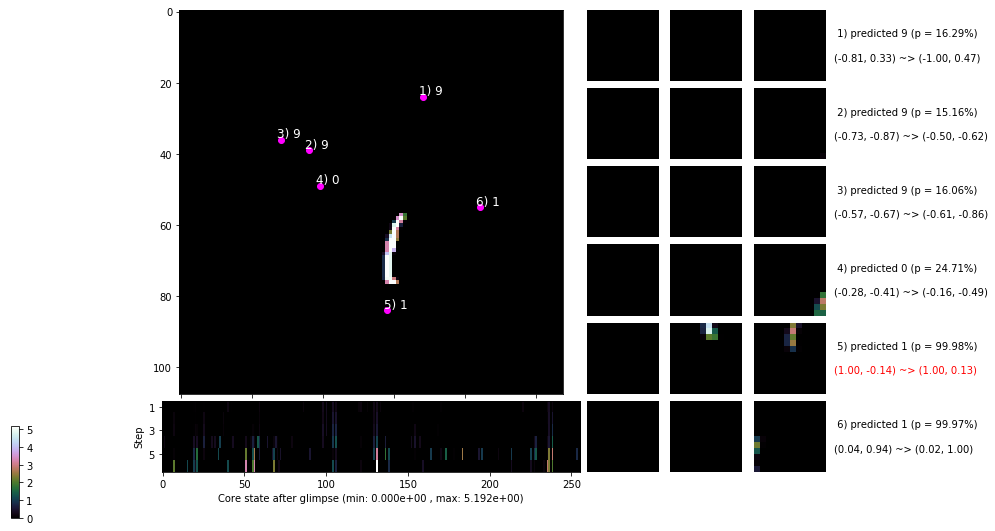

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


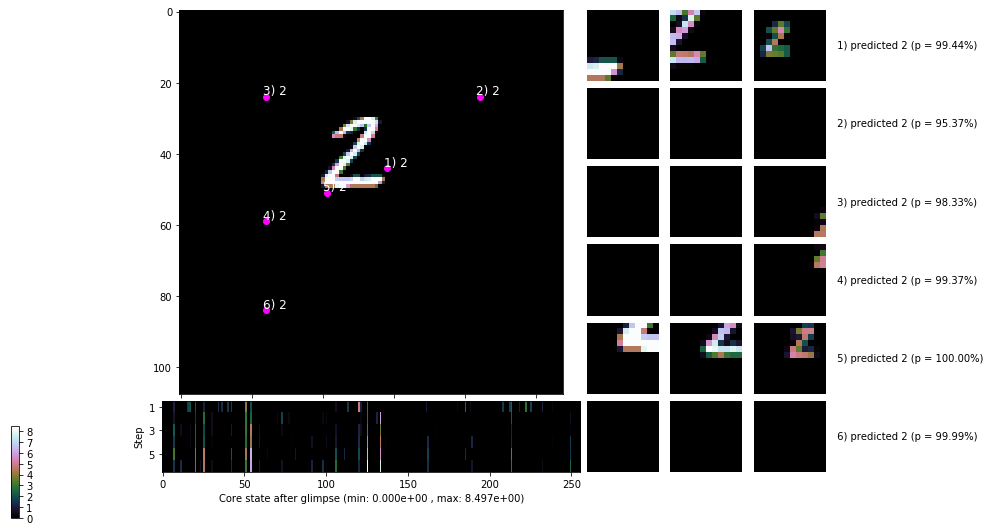


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


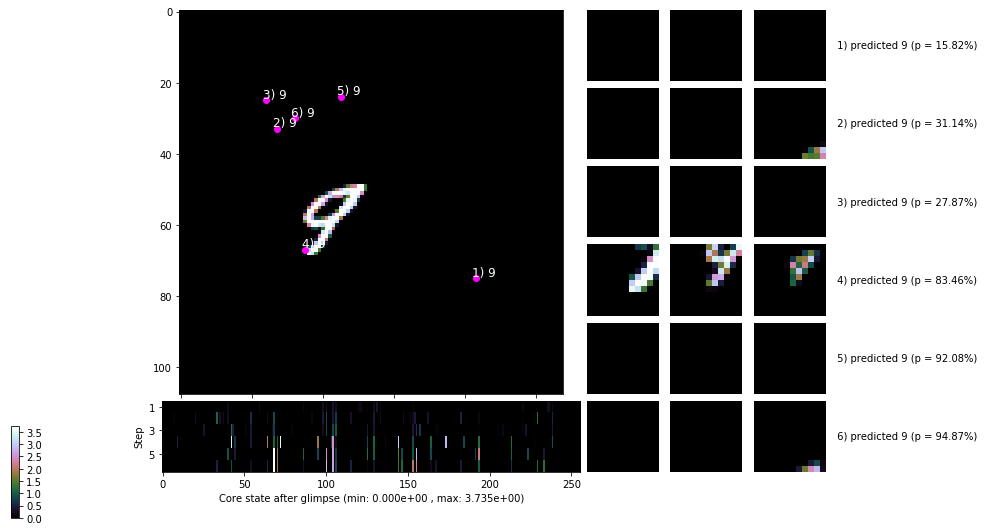

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


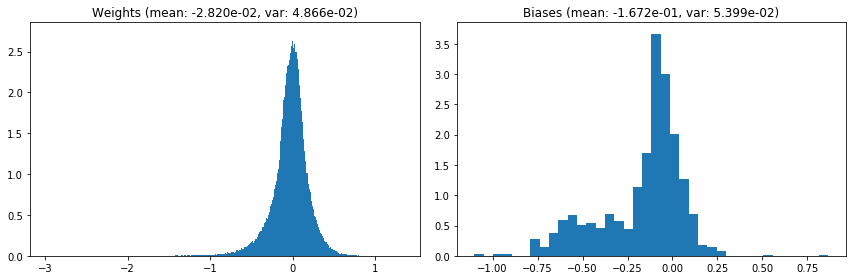

                                      Location network weights and biases


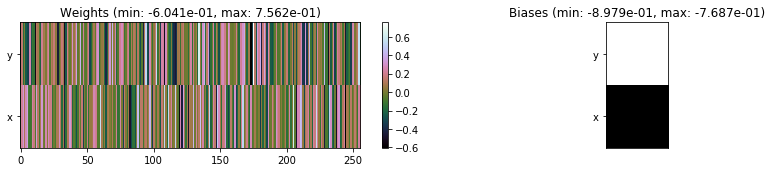

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.78 sec | TRAIN >> class loss: 0.2809 | steps:  2.288 :( | reward:  0.9171 :( | acc.: 91.714% :(
                          | VAL   >> class loss: 0.2213 | steps:  2.217 :( | reward:  0.9262 :( | acc.: 92.620% :(


Epoch  35/400) lr = 0.0003484
 b    500/  4000 >> 102.0 ms/b | lr: 3.47e-04 | grad 2norm: 12.89 | grad inf norm:  4.281
       Weights || abs max:  2.98 ( 4721.05) | mean: -2.81e-02 ( 0.04) | var: 4.87e-02 ( 1904.92)
        Biases || abs max:  1.10 (  127.26) | mean: -1.67e-01 ( 0.23) | var: 5.40e-02 (  928.95)
                  class loss: 0.256 | steps: 2.245 | reward:  0.918 | acc.: 91.84%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.9 ms/b | lr: 3.46e-04 | grad 2norm: 36.66 | grad inf norm:  9.977
       Weights || abs max:  2.98 ( 5867.78) | mean: -2.80e-02 ( 0.04) |

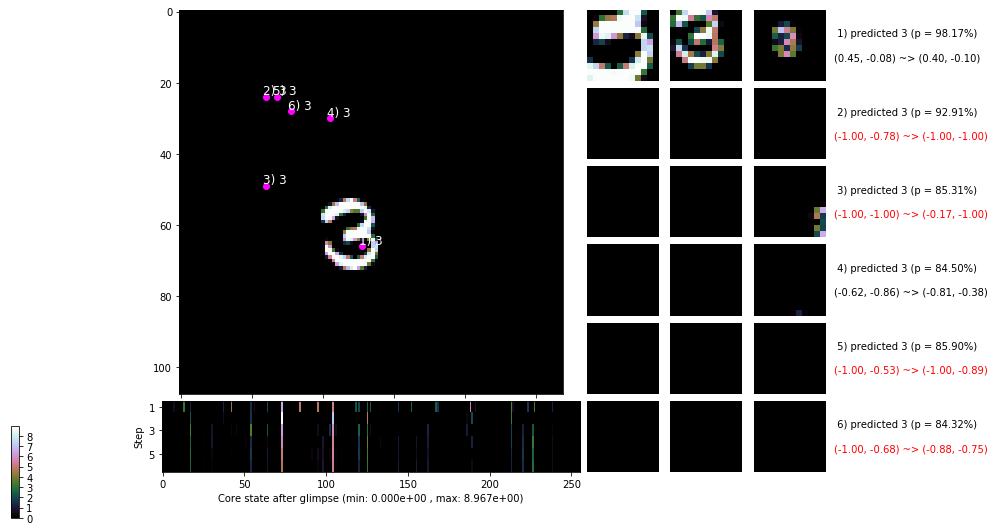

 b   1500/  4000 >> 104.1 ms/b | lr: 3.45e-04 | grad 2norm: 28.74 | grad inf norm:  7.992
       Weights || abs max:  2.98 ( 4396.98) | mean: -2.80e-02 ( 0.04) | var: 4.88e-02 ( 1070.01)
        Biases || abs max:  1.11 (  198.37) | mean: -1.68e-01 ( 0.32) | var: 5.44e-02 ( 3025.20)
                  class loss: 0.255 | steps: 2.290 | reward:  0.918 | acc.: 91.83%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.0 ms/b | lr: 3.43e-04 | grad 2norm:  9.15 | grad inf norm:  3.332
       Weights || abs max:  2.97 ( 4662.04) | mean: -2.80e-02 ( 0.04) | var: 4.89e-02 ( 7289.29)
        Biases || abs max:  1.11 (   86.56) | mean: -1.68e-01 ( 0.21) | var: 5.46e-02 (  180.63)
                  class loss: 0.268 | steps: 2.318 | reward:  0.916 | acc.: 91.56%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

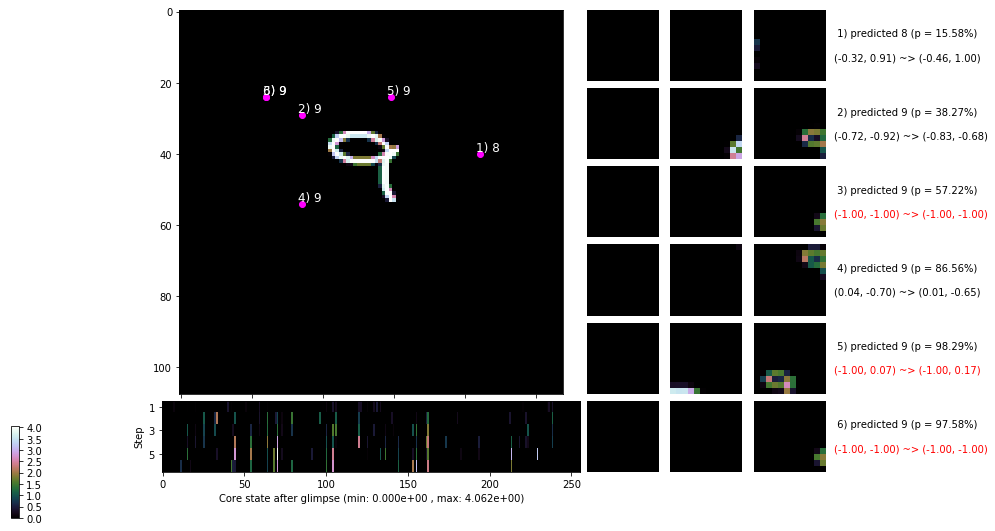

 b   2500/  4000 >> 103.8 ms/b | lr: 3.42e-04 | grad 2norm: 11.57 | grad inf norm:  3.973
       Weights || abs max:  2.97 ( 4423.60) | mean: -2.80e-02 ( 0.04) | var: 4.89e-02 (  899.64)
        Biases || abs max:  1.11 (   68.50) | mean: -1.68e-01 ( 0.16) | var: 5.48e-02 (  125.88)
                  class loss: 0.262 | steps: 2.277 | reward:  0.917 | acc.: 91.70%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.6 ms/b | lr: 3.41e-04 | grad 2norm: 10.42 | grad inf norm:  3.703
       Weights || abs max:  2.97 ( 4583.47) | mean: -2.80e-02 ( 0.04) | var: 4.90e-02 ( 2587.24)
        Biases || abs max:  1.12 (  101.29) | mean: -1.69e-01 ( 0.20) | var: 5.49e-02 (  207.23)
                  class loss: 0.256 | steps: 2.268 | reward:  0.922 | acc.: 92.17%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

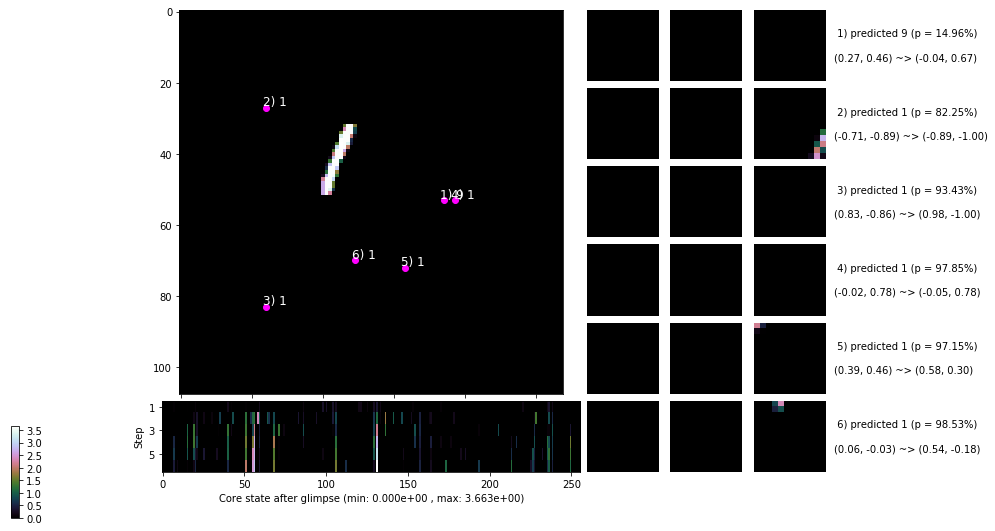

 b   3500/  4000 >> 113.2 ms/b | lr: 3.39e-04 | grad 2norm: 25.61 | grad inf norm:  7.323
       Weights || abs max:  2.98 ( 5163.88) | mean: -2.79e-02 ( 0.04) | var: 4.90e-02 ( 1101.25)
        Biases || abs max:  1.12 (  122.70) | mean: -1.68e-01 ( 0.23) | var: 5.50e-02 (  259.67)
                  class loss: 0.246 | steps: 2.264 | reward:  0.923 | acc.: 92.35%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.3 ms/b | lr: 3.38e-04 | grad 2norm: 16.27 | grad inf norm:  5.028
       Weights || abs max:  2.99 (25557.58) | mean: -2.78e-02 ( 0.12) | var: 4.91e-02 (415065.12)
        Biases || abs max:  1.13 (  212.46) | mean: -1.69e-01 ( 0.32) | var: 5.52e-02 ( 4975.50)
                  class loss: 0.259 | steps: 2.277 | reward:  0.921 | acc.: 92.05%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

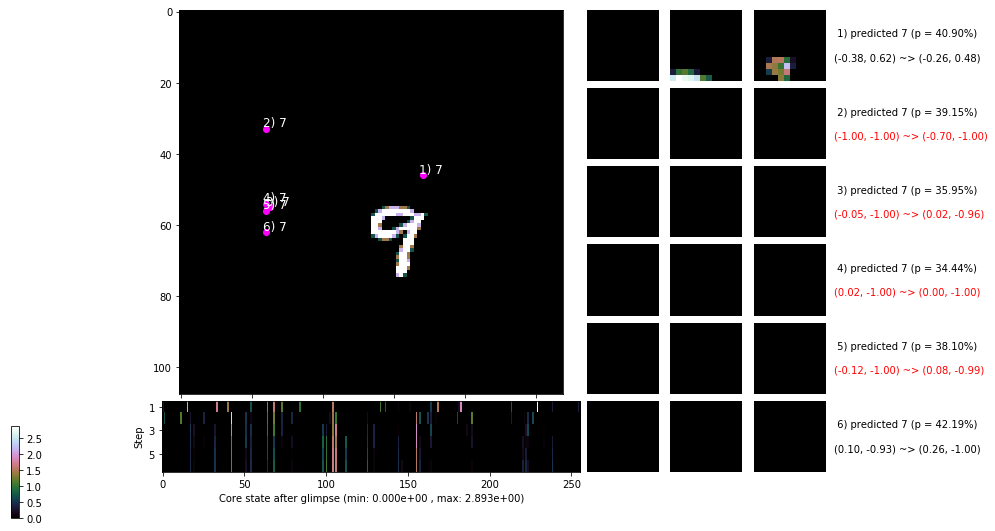

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


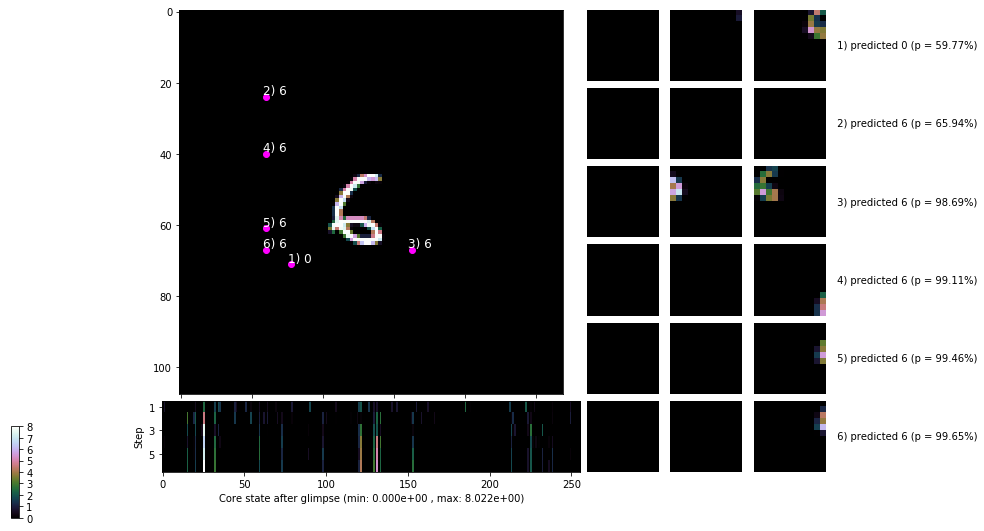


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


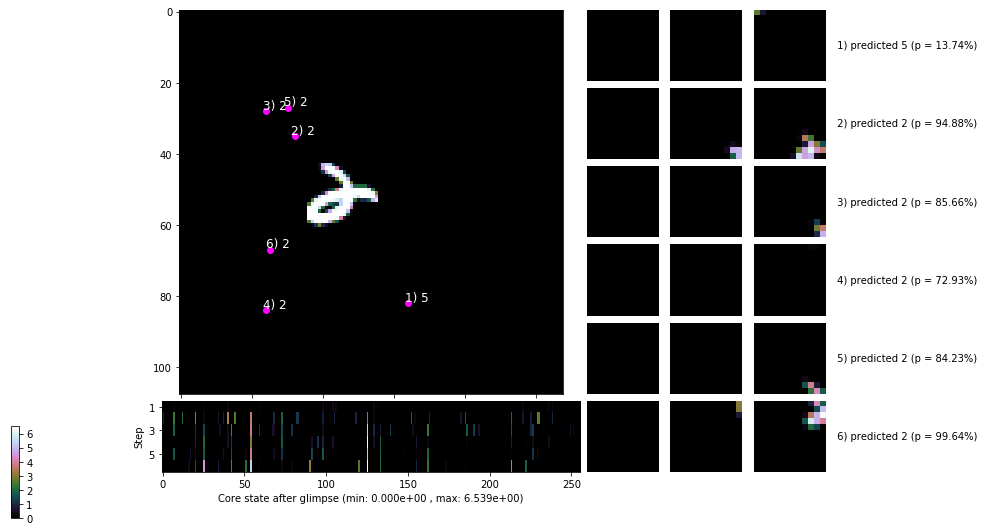

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


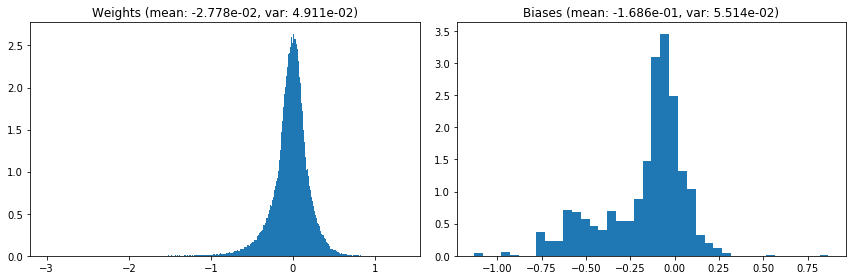

                                      Location network weights and biases


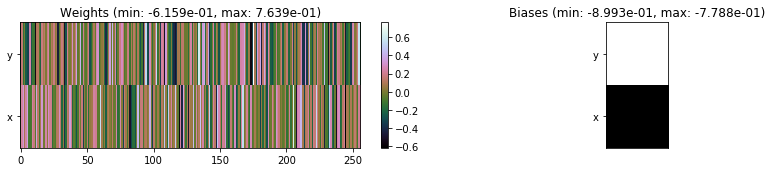

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.56 sec | TRAIN >> class loss: 0.2575 | steps:  2.279 :( | reward:  0.9188 :( | acc.: 91.884% :(
                          | VAL   >> class loss: 0.2645 | steps:  2.308 :( | reward:  0.9108 :( | acc.: 91.080% :(


Epoch  36/400) lr = 0.0003377
 b    500/  4000 >> 103.2 ms/b | lr: 3.37e-04 | grad 2norm: 76.91 | grad inf norm: 18.401
       Weights || abs max:  2.99 ( 4730.92) | mean: -2.78e-02 ( 0.04) | var: 4.91e-02 (  663.48)
        Biases || abs max:  1.13 (   90.77) | mean: -1.68e-01 ( 0.18) | var: 5.50e-02 (  372.93)
                  class loss: 0.262 | steps: 2.288 | reward:  0.915 | acc.: 91.52%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.9 ms/b | lr: 3.35e-04 | grad 2norm: 134.48 | grad inf norm: 34.973
       Weights || abs max:  3.00 ( 8882.95) | mean: -2.78e-02 ( 0.05) 

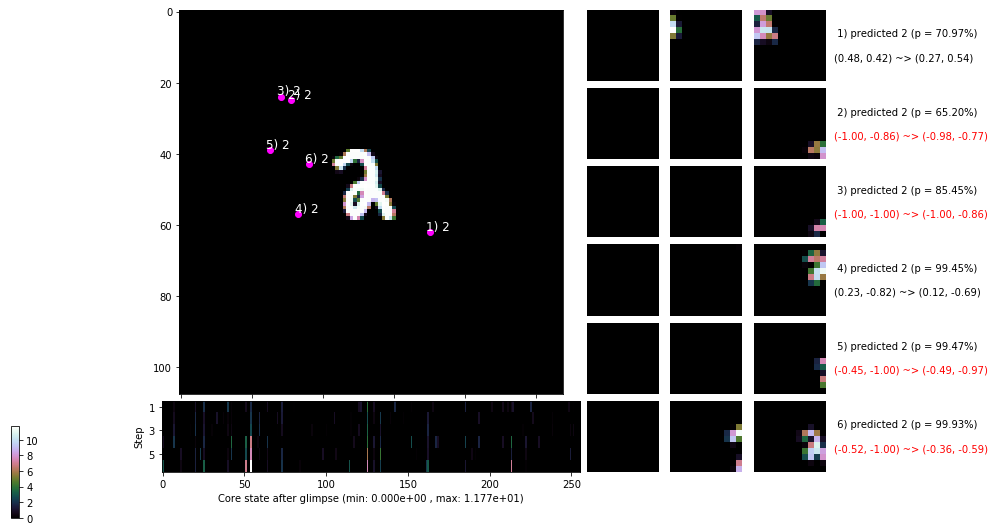

 b   1500/  4000 >> 102.7 ms/b | lr: 3.34e-04 | grad 2norm: 12.84 | grad inf norm:  4.412
       Weights || abs max:  3.01 ( 6345.06) | mean: -2.78e-02 ( 0.05) | var: 4.93e-02 ( 2965.91)
        Biases || abs max:  1.13 (  139.44) | mean: -1.69e-01 ( 0.23) | var: 5.49e-02 (  286.73)
                  class loss: 0.265 | steps: 2.274 | reward:  0.917 | acc.: 91.65%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.4 ms/b | lr: 3.33e-04 | grad 2norm: 138.43 | grad inf norm: 35.749
       Weights || abs max:  3.01 ( 5374.03) | mean: -2.77e-02 ( 0.04) | var: 4.93e-02 ( 2035.86)
        Biases || abs max:  1.13 (   99.05) | mean: -1.69e-01 ( 0.19) | var: 5.51e-02 (  534.25)
                  class loss: 0.240 | steps: 2.221 | reward:  0.923 | acc.: 92.33%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

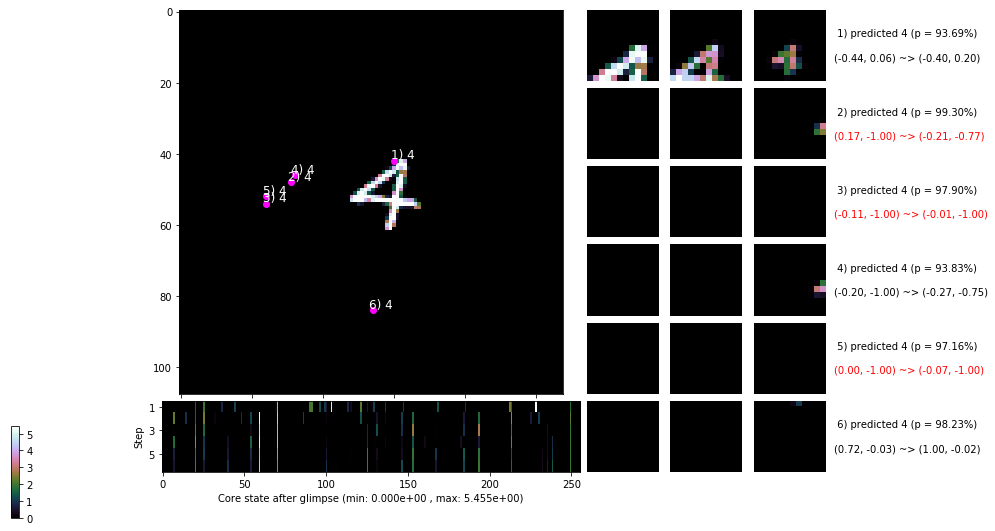

 b   2500/  4000 >> 103.2 ms/b | lr: 3.32e-04 | grad 2norm: 15.28 | grad inf norm:  5.114
       Weights || abs max:  3.01 ( 4813.77) | mean: -2.76e-02 ( 0.04) | var: 4.94e-02 ( 2238.59)
        Biases || abs max:  1.13 (   57.05) | mean: -1.69e-01 ( 0.15) | var: 5.51e-02 (  100.23)
                  class loss: 0.254 | steps: 2.237 | reward:  0.917 | acc.: 91.69%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 100.2 ms/b | lr: 3.30e-04 | grad 2norm: 50.86 | grad inf norm: 14.179
       Weights || abs max:  3.01 ( 4015.12) | mean: -2.77e-02 ( 0.04) | var: 4.94e-02 ( 1124.88)
        Biases || abs max:  1.13 (   48.94) | mean: -1.69e-01 ( 0.13) | var: 5.53e-02 (  249.52)
                  class loss: 0.255 | steps: 2.226 | reward:  0.920 | acc.: 91.96%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

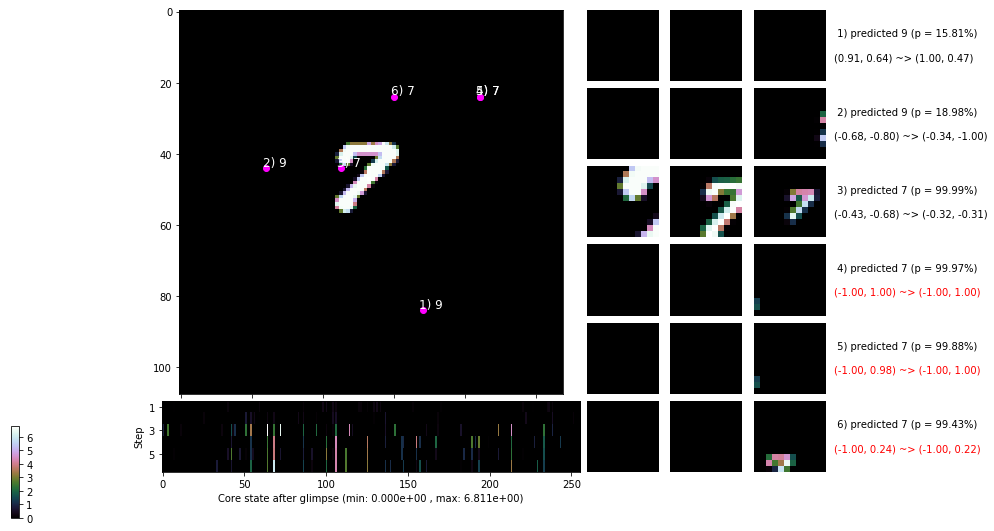

 b   3500/  4000 >> 102.4 ms/b | lr: 3.29e-04 | grad 2norm: 67.79 | grad inf norm: 18.381
       Weights || abs max:  3.01 ( 6980.14) | mean: -2.77e-02 ( 0.05) | var: 4.95e-02 ( 3500.45)
        Biases || abs max:  1.13 (  216.83) | mean: -1.70e-01 ( 0.35) | var: 5.55e-02 ( 8796.76)
                  class loss: 0.236 | steps: 2.204 | reward:  0.926 | acc.: 92.61%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.1 ms/b | lr: 3.28e-04 | grad 2norm: 67.73 | grad inf norm: 18.353
       Weights || abs max:  3.01 ( 5482.77) | mean: -2.77e-02 ( 0.04) | var: 4.95e-02 ( 2807.00)
        Biases || abs max:  1.13 (  139.13) | mean: -1.70e-01 ( 0.21) | var: 5.56e-02 ( 2061.23)
                  class loss: 0.235 | steps: 2.176 | reward:  0.924 | acc.: 92.36%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

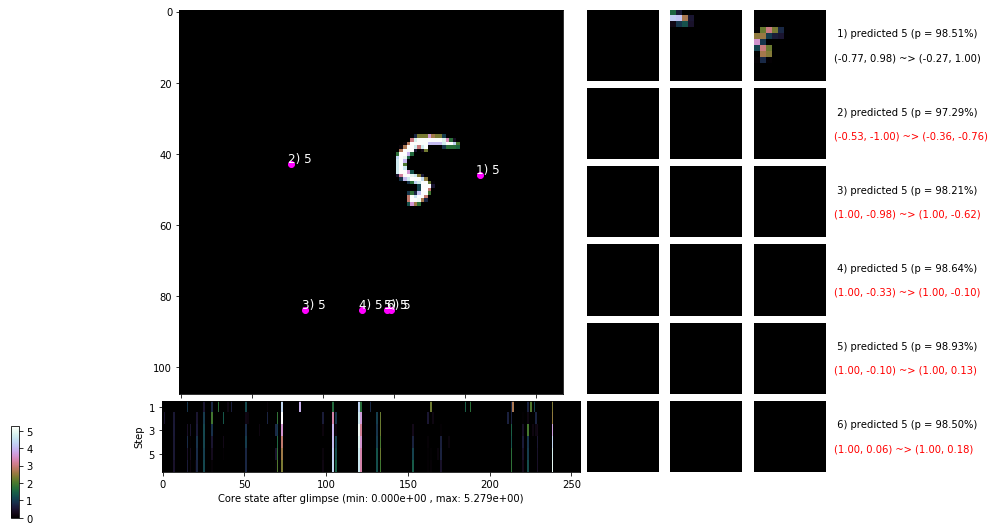

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


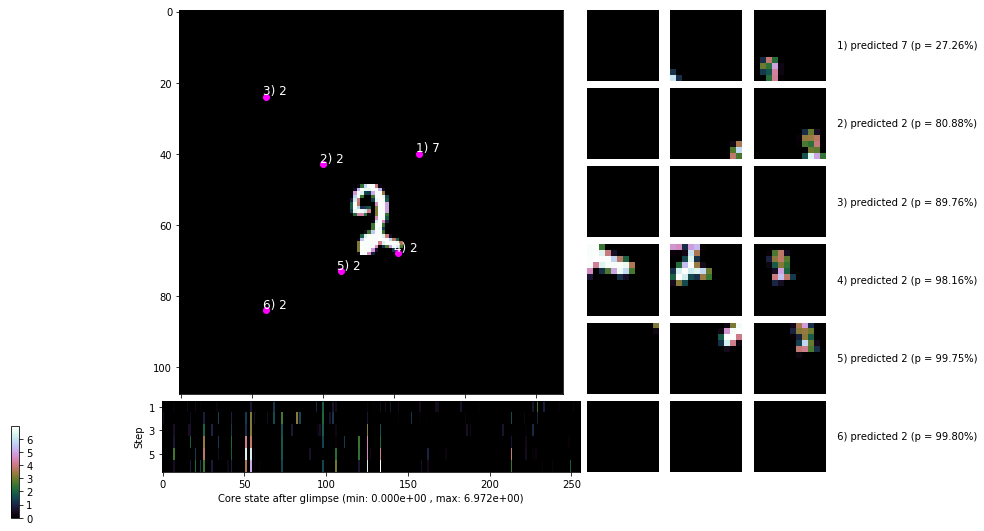


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


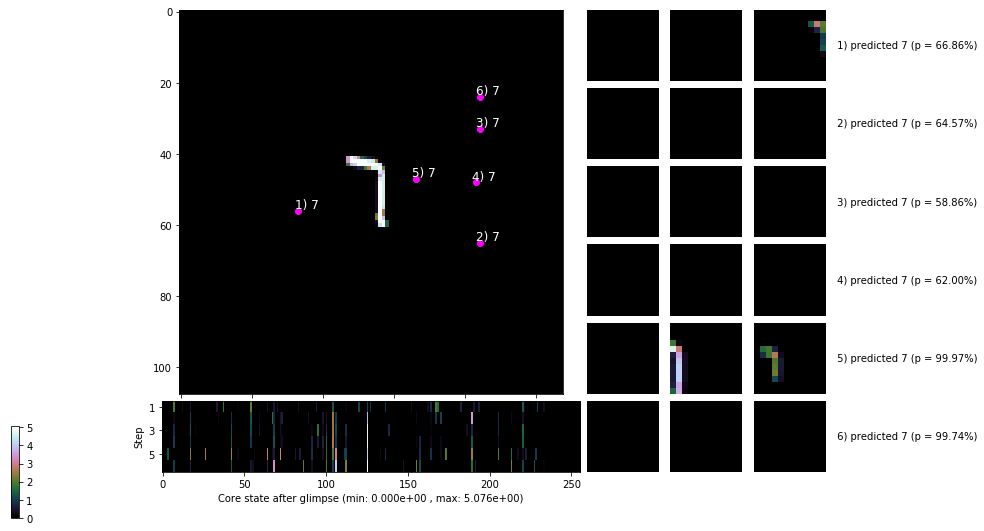

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


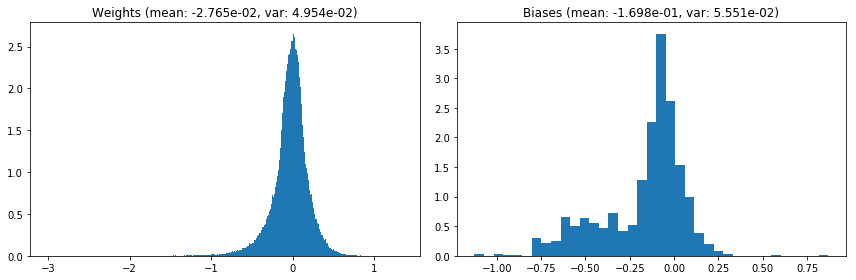

                                      Location network weights and biases


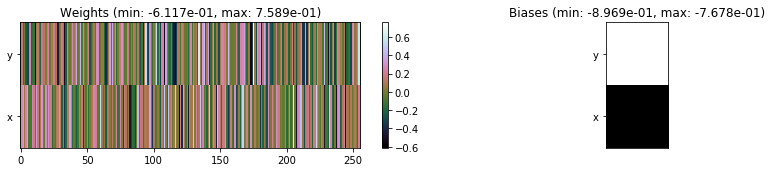

---------------------------------------------------------------------------------------------------------------
Elapsed time:  409.16 sec | TRAIN >> class loss: 0.2504 | steps:  2.239 :( | reward:  0.9199 :( | acc.: 91.987% :(
                          | VAL   >> class loss: 0.2176 | steps:  2.160 :( | reward:  0.9318    | acc.: 93.180% 


Epoch  37/400) lr = 0.0003274
 b    500/  4000 >> 103.7 ms/b | lr: 3.26e-04 | grad 2norm: 62.45 | grad inf norm: 16.795
       Weights || abs max:  3.00 ( 8693.66) | mean: -2.76e-02 ( 0.05) | var: 4.96e-02 (23591.23)
        Biases || abs max:  1.13 (  115.99) | mean: -1.70e-01 ( 0.21) | var: 5.55e-02 (  638.03)
                  class loss: 0.242 | steps: 2.223 | reward:  0.921 | acc.: 92.13%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 107.1 ms/b | lr: 3.25e-04 | grad 2norm: 296.78 | grad inf norm: 74.621
       Weights || abs max:  3.01 ( 9135.02) | mean: -2.75e-02 ( 0.06) | 

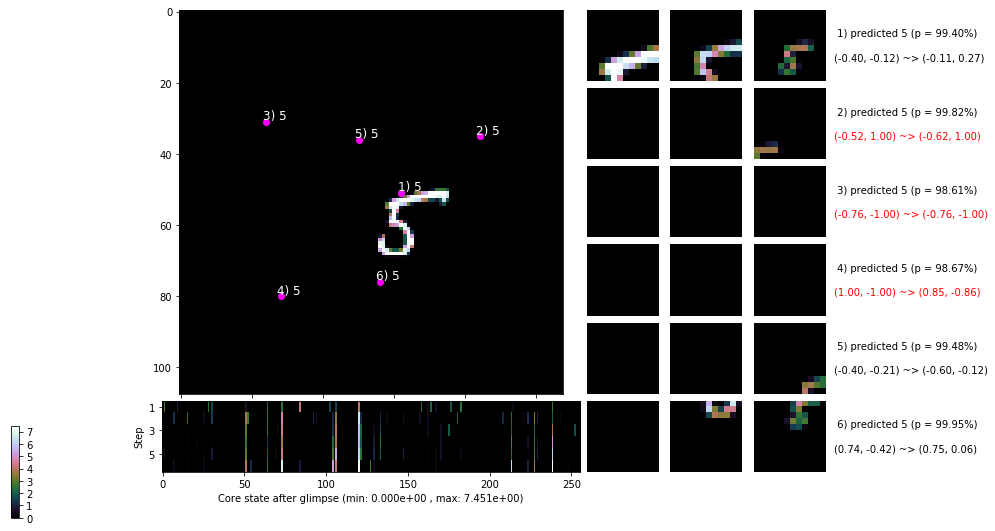

 b   1500/  4000 >> 104.4 ms/b | lr: 3.24e-04 | grad 2norm: 66.27 | grad inf norm: 18.314
       Weights || abs max:  3.00 (16983.10) | mean: -2.75e-02 ( 0.09) | var: 4.97e-02 (159946.81)
        Biases || abs max:  1.12 (  148.07) | mean: -1.70e-01 ( 0.26) | var: 5.58e-02 ( 2463.73)
                  class loss: 0.248 | steps: 2.216 | reward:  0.920 | acc.: 91.97%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.7 ms/b | lr: 3.23e-04 | grad 2norm: 693.46 | grad inf norm: 164.723
       Weights || abs max:  2.99 (15616.19) | mean: -2.75e-02 ( 0.08) | var: 4.97e-02 (103873.12)
        Biases || abs max:  1.13 (  171.57) | mean: -1.71e-01 ( 0.26) | var: 5.59e-02 ( 1071.94)
                  class loss: 0.244 | steps: 2.226 | reward:  0.924 | acc.: 92.44%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

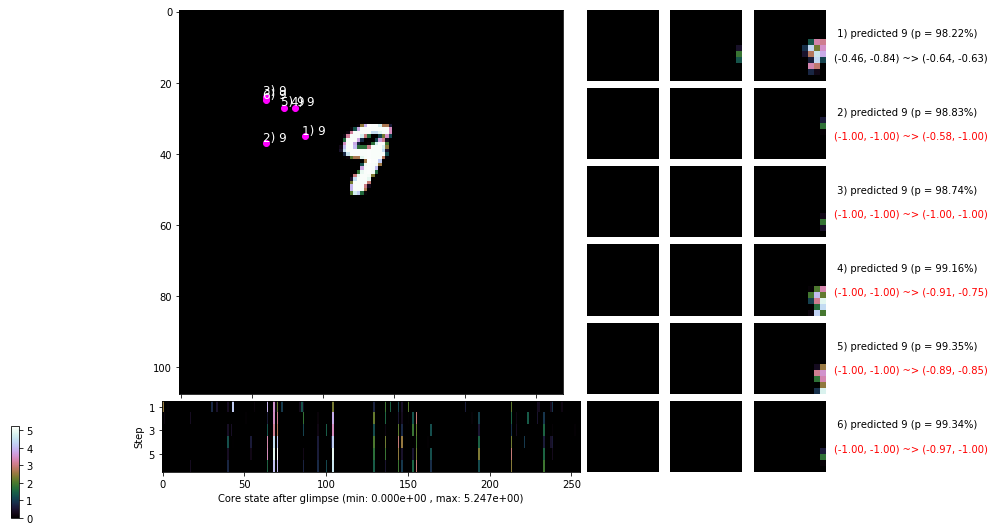

 b   2500/  4000 >> 107.0 ms/b | lr: 3.22e-04 | grad 2norm: 29.53 | grad inf norm:  8.049
       Weights || abs max:  2.99 ( 4637.02) | mean: -2.76e-02 ( 0.04) | var: 4.98e-02 ( 1186.82)
        Biases || abs max:  1.13 (   57.94) | mean: -1.71e-01 ( 0.14) | var: 5.62e-02 (   37.81)
                  class loss: 0.360 | steps: 2.256 | reward:  0.921 | acc.: 92.09%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.8 ms/b | lr: 3.20e-04 | grad 2norm:  9.33 | grad inf norm:  3.516
       Weights || abs max:  3.00 ( 6926.31) | mean: -2.76e-02 ( 0.05) | var: 4.98e-02 ( 5572.69)
        Biases || abs max:  1.14 (   92.77) | mean: -1.71e-01 ( 0.19) | var: 5.65e-02 ( 1171.56)
                  class loss: 0.242 | steps: 2.219 | reward:  0.926 | acc.: 92.57%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

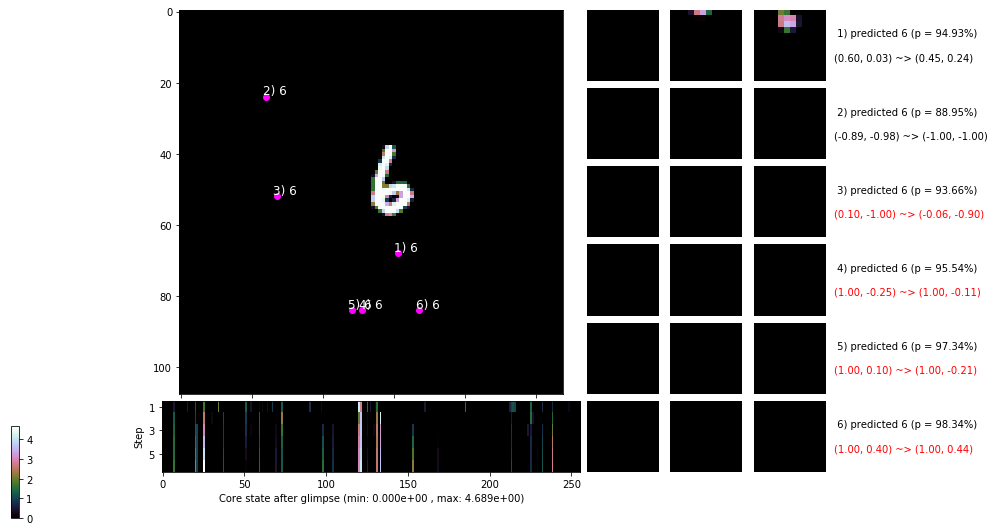

 b   3500/  4000 >> 103.5 ms/b | lr: 3.19e-04 | grad 2norm:  9.06 | grad inf norm:  3.299
       Weights || abs max:  3.00 ( 6270.41) | mean: -2.76e-02 ( 0.05) | var: 4.99e-02 ( 3701.44)
        Biases || abs max:  1.14 (   94.47) | mean: -1.71e-01 ( 0.20) | var: 5.65e-02 (  110.97)
                  class loss: 0.244 | steps: 2.252 | reward:  0.922 | acc.: 92.23%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.5 ms/b | lr: 3.18e-04 | grad 2norm:  8.15 | grad inf norm:  3.149
       Weights || abs max:  3.01 ( 4941.10) | mean: -2.75e-02 ( 0.04) | var: 4.99e-02 (  971.73)
        Biases || abs max:  1.15 (  799.24) | mean: -1.72e-01 ( 0.91) | var: 5.65e-02 (205397.84)
                  class loss: 0.252 | steps: 2.296 | reward:  0.919 | acc.: 91.89%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

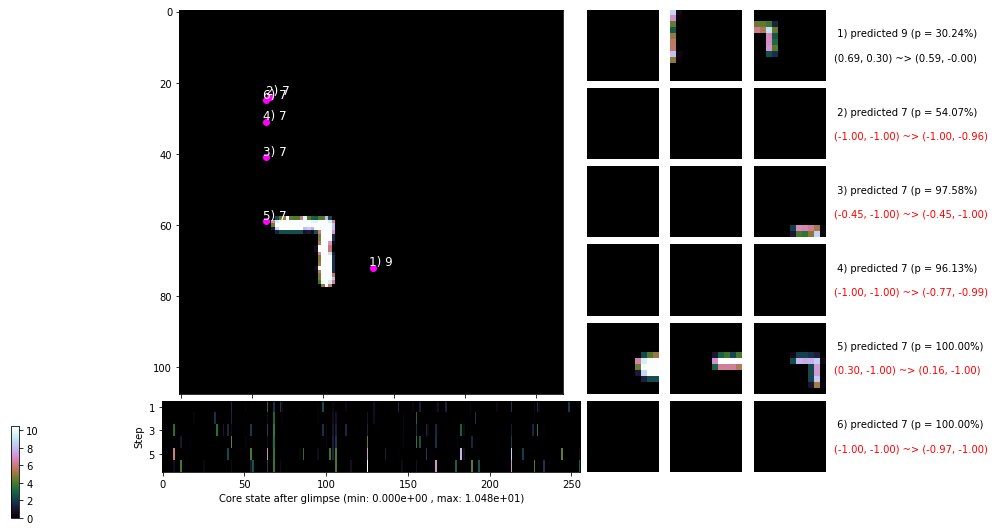

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


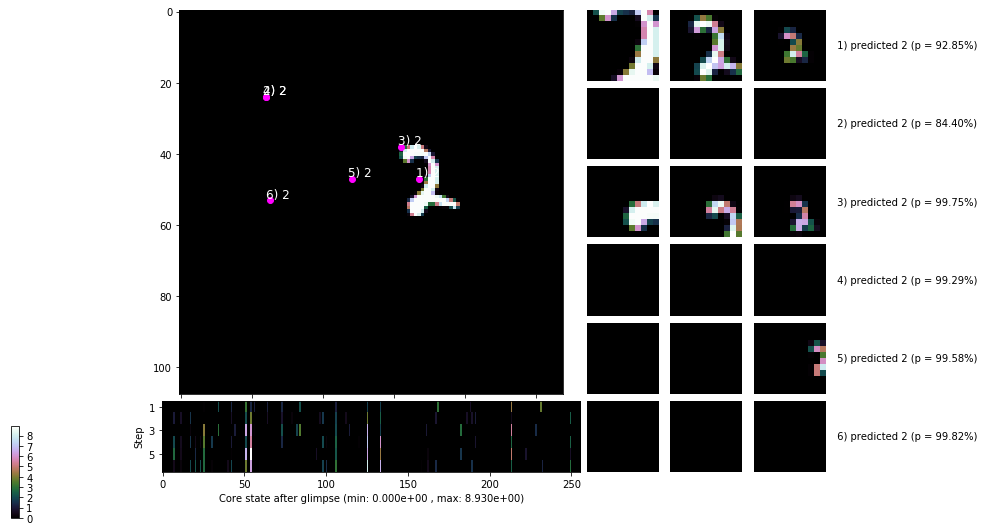


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


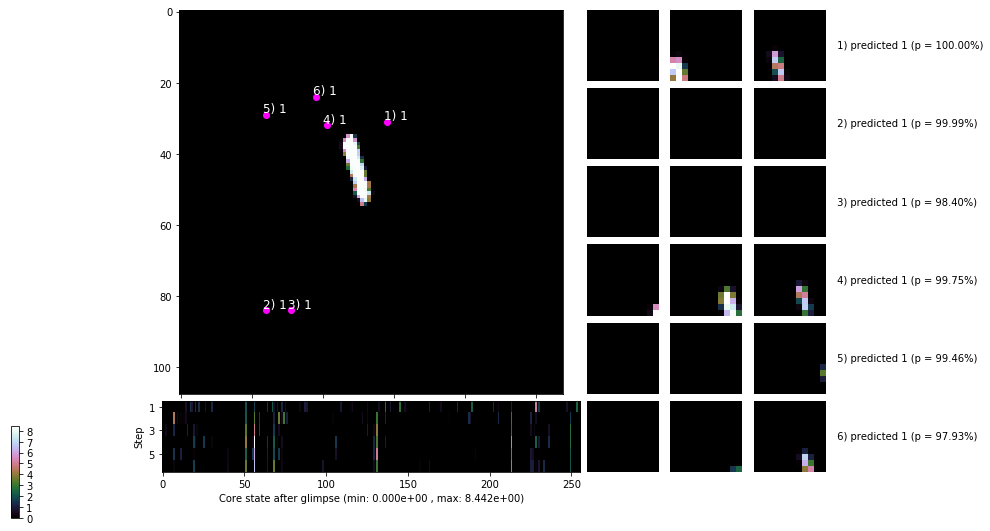

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


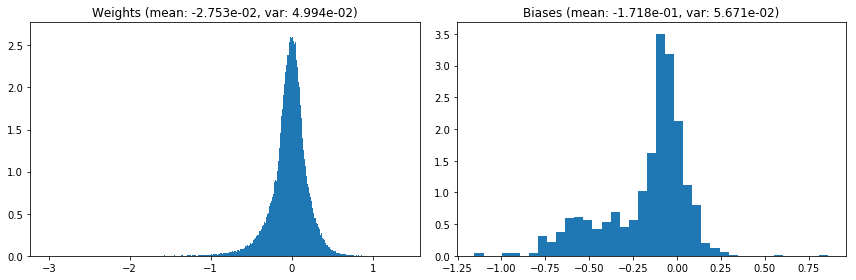

                                      Location network weights and biases


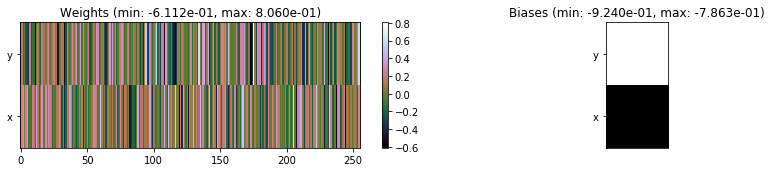

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.07 sec | TRAIN >> class loss: 0.2576 | steps:  2.234 :( | reward:  0.9226    | acc.: 92.262% 
                          | VAL   >> class loss: 0.2812 | steps:  2.314 :( | reward:  0.9120 :( | acc.: 91.200% :(


Epoch  38/400) lr = 0.0003174
 b    500/  4000 >> 102.7 ms/b | lr: 3.16e-04 | grad 2norm: 13.85 | grad inf norm:  4.596
       Weights || abs max:  3.01 ( 7598.60) | mean: -2.75e-02 ( 0.05) | var: 5.00e-02 (36242.69)
        Biases || abs max:  1.15 (  226.95) | mean: -1.72e-01 ( 0.36) | var: 5.68e-02 ( 1491.72)
                  class loss: 0.263 | steps: 2.287 | reward:  0.915 | acc.: 91.51%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 100.8 ms/b | lr: 3.15e-04 | grad 2norm: 53.64 | grad inf norm: 14.342
       Weights || abs max:  3.01 ( 7098.55) | mean: -2.74e-02 ( 0.05) | v

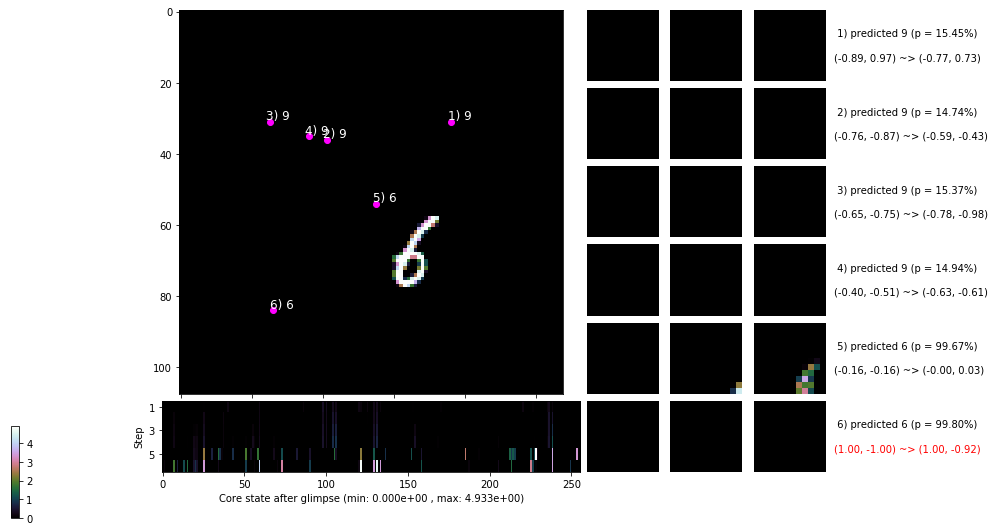

 b   1500/  4000 >> 103.1 ms/b | lr: 3.14e-04 | grad 2norm:  8.23 | grad inf norm:  3.194
       Weights || abs max:  3.02 ( 5085.21) | mean: -2.74e-02 ( 0.04) | var: 5.01e-02 ( 1168.77)
        Biases || abs max:  1.15 (  321.89) | mean: -1.72e-01 ( 0.43) | var: 5.71e-02 (22337.25)
                  class loss: 0.260 | steps: 2.298 | reward:  0.917 | acc.: 91.66%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.2 ms/b | lr: 3.13e-04 | grad 2norm: 13.91 | grad inf norm:  4.665
       Weights || abs max:  3.02 ( 4714.69) | mean: -2.74e-02 ( 0.04) | var: 5.01e-02 (  567.84)
        Biases || abs max:  1.15 (  232.11) | mean: -1.72e-01 ( 0.37) | var: 5.71e-02 ( 2231.38)
                  class loss: 0.257 | steps: 2.288 | reward:  0.920 | acc.: 91.99%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

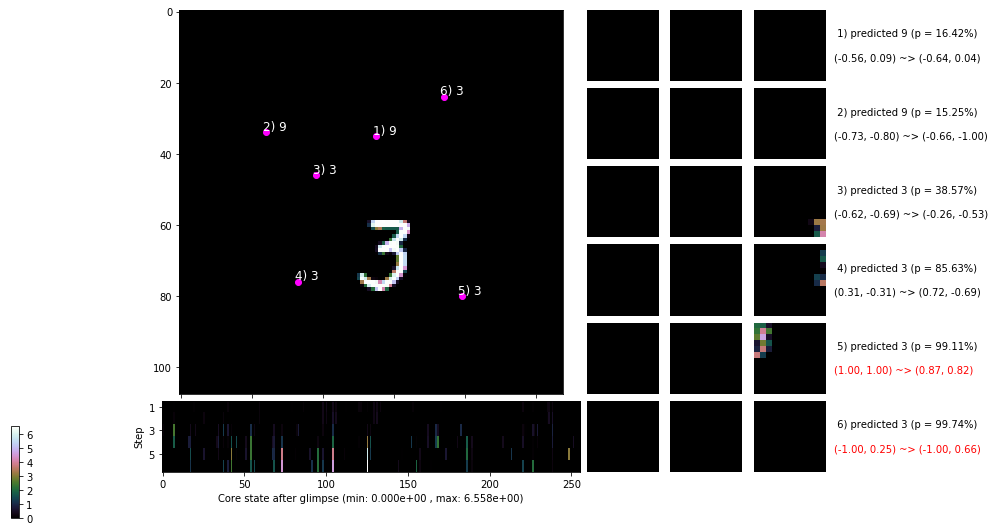

 b   2500/  4000 >> 105.7 ms/b | lr: 3.12e-04 | grad 2norm: 11.38 | grad inf norm:  4.092
       Weights || abs max:  3.02 ( 8763.74) | mean: -2.74e-02 ( 0.06) | var: 5.02e-02 (18312.60)
        Biases || abs max:  1.16 (  245.88) | mean: -1.72e-01 ( 0.42) | var: 5.72e-02 ( 3266.04)
                  class loss: 0.250 | steps: 2.272 | reward:  0.920 | acc.: 91.99%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.9 ms/b | lr: 3.10e-04 | grad 2norm:  8.71 | grad inf norm:  3.246
       Weights || abs max:  3.02 ( 7626.61) | mean: -2.73e-02 ( 0.05) | var: 5.02e-02 ( 9581.88)
        Biases || abs max:  1.16 (  164.82) | mean: -1.72e-01 ( 0.25) | var: 5.73e-02 ( 2536.21)
                  class loss: 0.238 | steps: 2.233 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

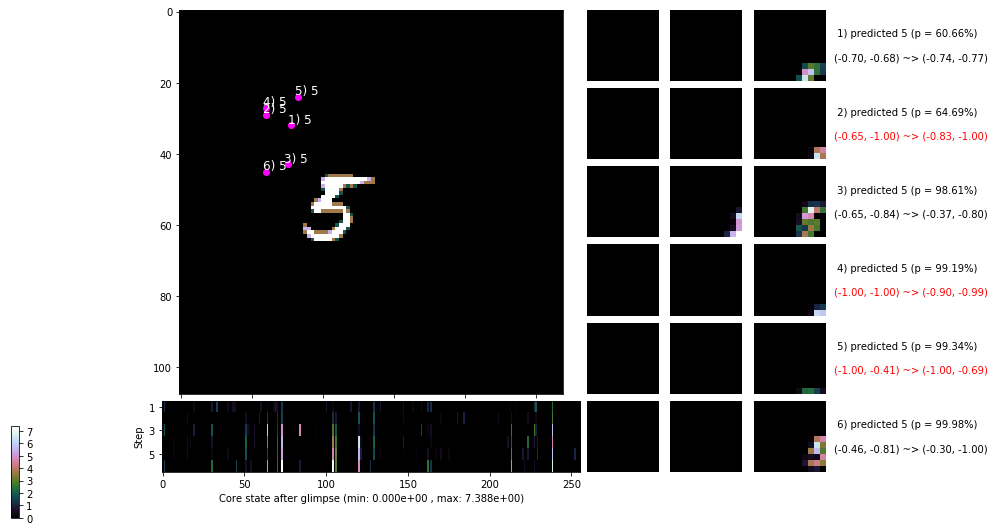

 b   3500/  4000 >> 103.3 ms/b | lr: 3.09e-04 | grad 2norm: 13.70 | grad inf norm:  4.591
       Weights || abs max:  3.03 ( 5825.96) | mean: -2.73e-02 ( 0.05) | var: 5.03e-02 ( 1874.47)
        Biases || abs max:  1.18 (  110.10) | mean: -1.73e-01 ( 0.21) | var: 5.76e-02 (  725.53)
                  class loss: 0.238 | steps: 2.219 | reward:  0.923 | acc.: 92.35%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.8 ms/b | lr: 3.08e-04 | grad 2norm: 22.14 | grad inf norm:  4.739
       Weights || abs max:  3.03 ( 7255.99) | mean: -2.74e-02 ( 0.05) | var: 5.03e-02 (29598.55)
        Biases || abs max:  1.18 (  115.03) | mean: -1.73e-01 ( 0.21) | var: 5.78e-02 (  940.70)
                  class loss: 0.780 | steps: 2.217 | reward:  0.921 | acc.: 92.09%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

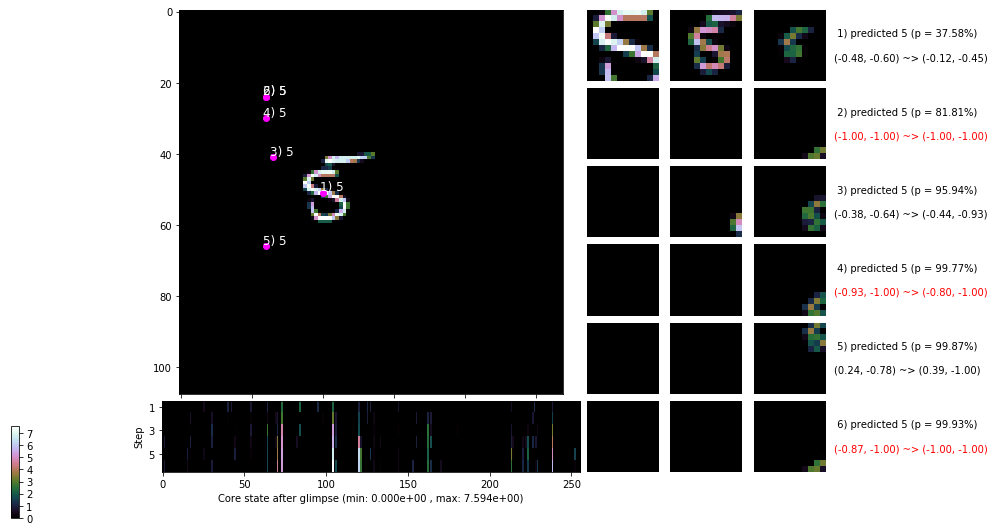

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


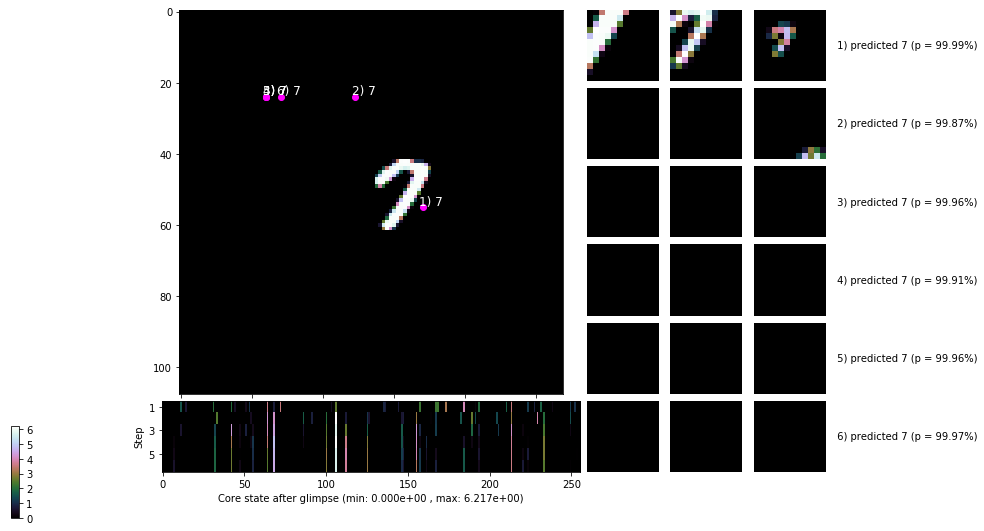


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


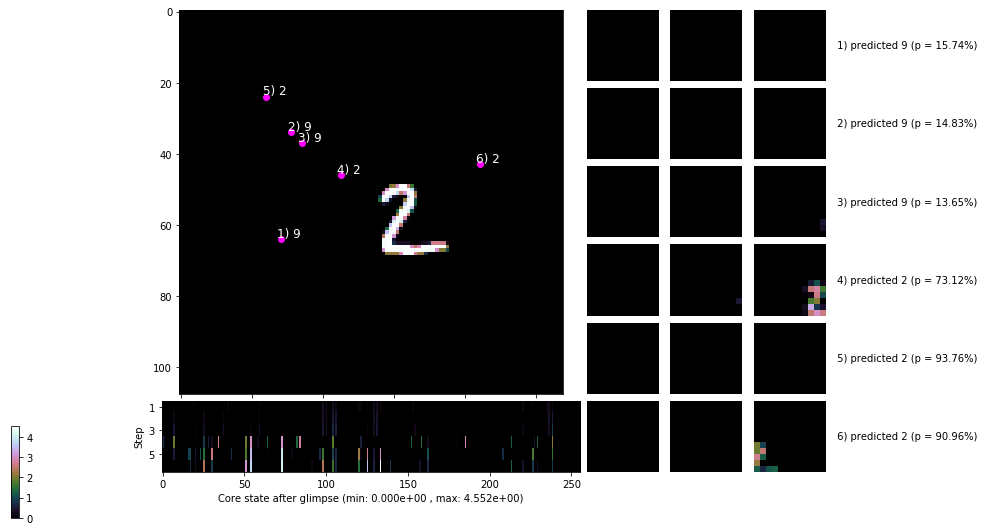

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


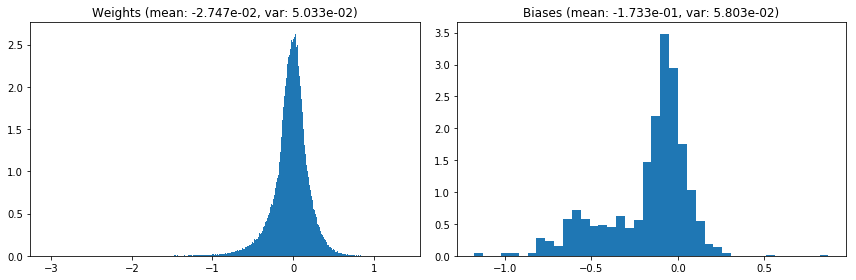

                                      Location network weights and biases


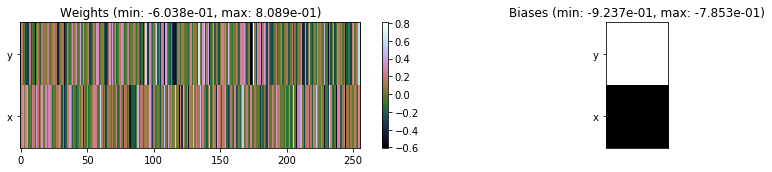

---------------------------------------------------------------------------------------------------------------
Elapsed time:  413.89 sec | TRAIN >> class loss: 0.3184 | steps:  2.263 :( | reward:  0.9200 :( | acc.: 91.997% :(
                          | VAL   >> class loss: 0.2385 | steps:  2.209 :( | reward:  0.9274 :( | acc.: 92.740% :(


Epoch  39/400) lr = 0.0003077
 b    500/  4000 >> 102.4 ms/b | lr: 3.07e-04 | grad 2norm:  7.89 | grad inf norm:  3.117
       Weights || abs max:  3.04 ( 4824.75) | mean: -2.75e-02 ( 0.04) | var: 5.03e-02 ( 1031.06)
        Biases || abs max:  1.18 (   91.10) | mean: -1.73e-01 ( 0.19) | var: 5.81e-02 (  394.26)
                  class loss: 0.235 | steps: 2.227 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.1 ms/b | lr: 3.06e-04 | grad 2norm:  8.02 | grad inf norm:  3.107
       Weights || abs max:  3.03 (23816.12) | mean: -2.74e-02 ( 0.12) |

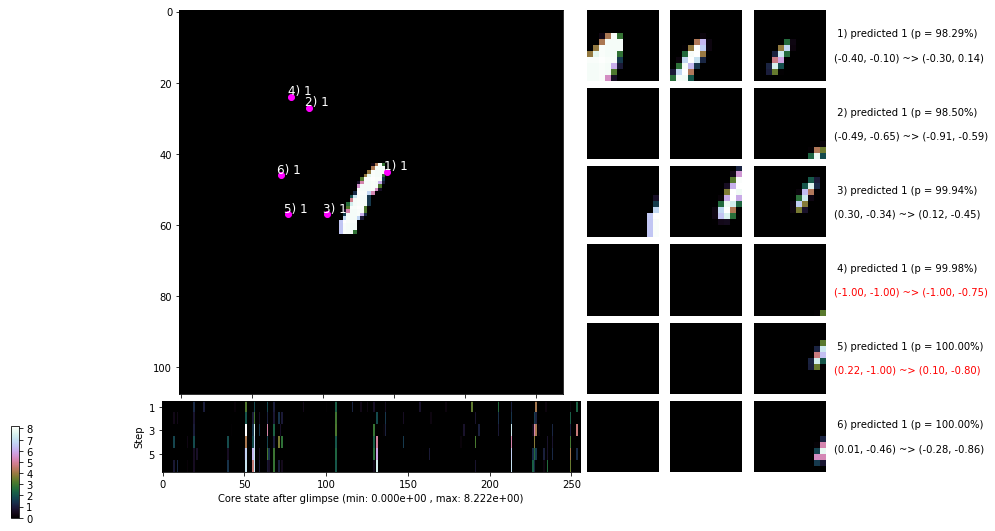

 b   1500/  4000 >> 104.1 ms/b | lr: 3.04e-04 | grad 2norm:  8.13 | grad inf norm:  3.184
       Weights || abs max:  3.04 ( 5900.87) | mean: -2.73e-02 ( 0.04) | var: 5.04e-02 ( 8821.12)
        Biases || abs max:  1.18 (   93.50) | mean: -1.73e-01 ( 0.19) | var: 5.79e-02 (   90.60)
                  class loss: 0.242 | steps: 2.181 | reward:  0.923 | acc.: 92.31%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.2 ms/b | lr: 3.03e-04 | grad 2norm:  8.34 | grad inf norm:  3.232
       Weights || abs max:  3.04 (13630.73) | mean: -2.73e-02 ( 0.08) | var: 5.05e-02 (96154.09)
        Biases || abs max:  1.19 (  337.08) | mean: -1.73e-01 ( 0.43) | var: 5.80e-02 (32878.19)
                  class loss: 0.222 | steps: 2.185 | reward:  0.930 | acc.: 92.97%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

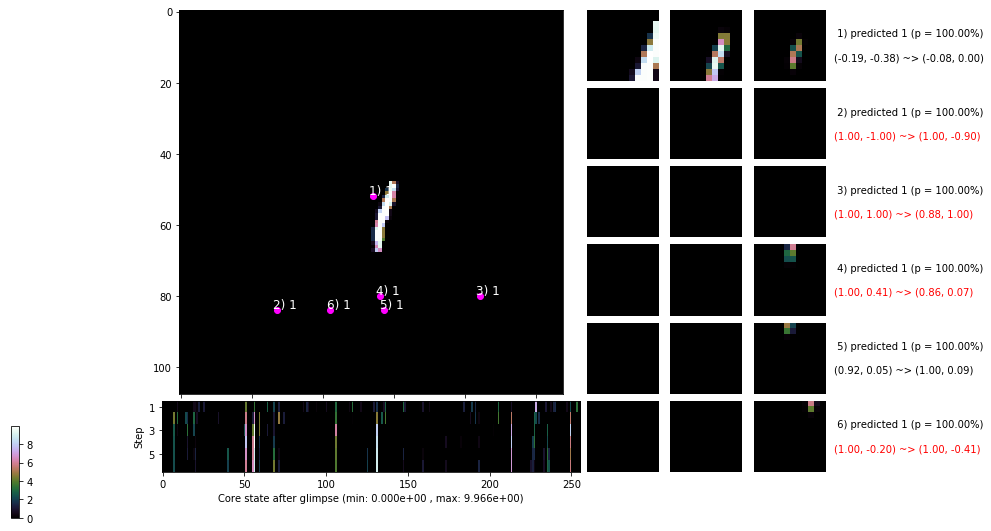

 b   2500/  4000 >> 102.4 ms/b | lr: 3.02e-04 | grad 2norm:  8.16 | grad inf norm:  3.221
       Weights || abs max:  3.04 ( 4763.15) | mean: -2.73e-02 ( 0.04) | var: 5.05e-02 ( 1182.36)
        Biases || abs max:  1.19 (  166.92) | mean: -1.73e-01 ( 0.27) | var: 5.80e-02 ( 1983.26)
                  class loss: 0.224 | steps: 2.148 | reward:  0.931 | acc.: 93.15%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.3 ms/b | lr: 3.01e-04 | grad 2norm: 11.36 | grad inf norm:  4.021
       Weights || abs max:  3.04 ( 7983.04) | mean: -2.72e-02 ( 0.05) | var: 5.06e-02 ( 5612.47)
        Biases || abs max:  1.19 (   54.34) | mean: -1.74e-01 ( 0.15) | var: 5.82e-02 (   31.77)
                  class loss: 0.225 | steps: 2.145 | reward:  0.929 | acc.: 92.86%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

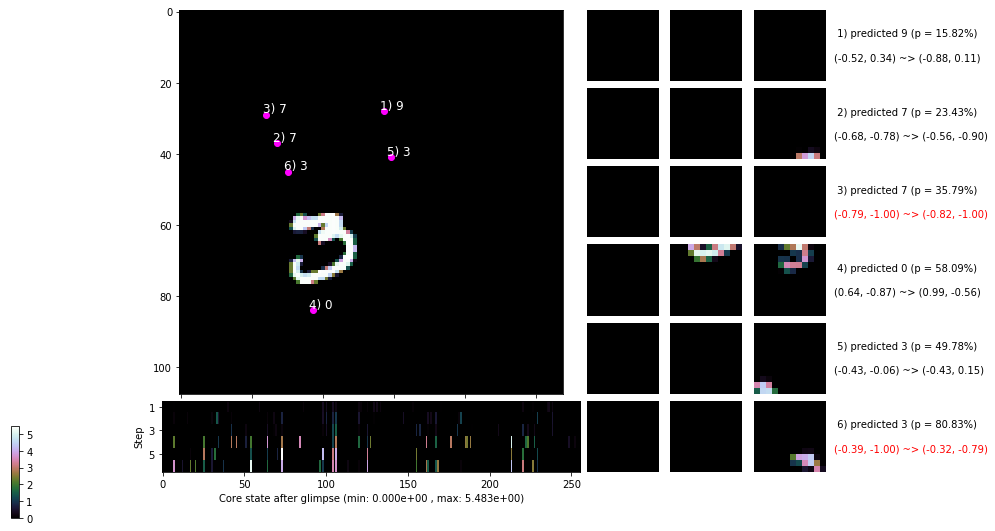

 b   3500/  4000 >> 106.8 ms/b | lr: 3.00e-04 | grad 2norm:  7.90 | grad inf norm:  3.041
       Weights || abs max:  3.04 ( 6288.79) | mean: -2.73e-02 ( 0.05) | var: 5.06e-02 ( 3673.51)
        Biases || abs max:  1.20 (  129.08) | mean: -1.74e-01 ( 0.26) | var: 5.85e-02 (  315.53)
                  class loss: 0.233 | steps: 2.195 | reward:  0.927 | acc.: 92.67%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.4 ms/b | lr: 2.99e-04 | grad 2norm:  8.10 | grad inf norm:  3.229
       Weights || abs max:  3.05 (10417.48) | mean: -2.73e-02 ( 0.06) | var: 5.06e-02 (59340.60)
        Biases || abs max:  1.20 (  299.19) | mean: -1.74e-01 ( 0.55) | var: 5.86e-02 (12370.04)
                  class loss: 0.240 | steps: 2.241 | reward:  0.922 | acc.: 92.21%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

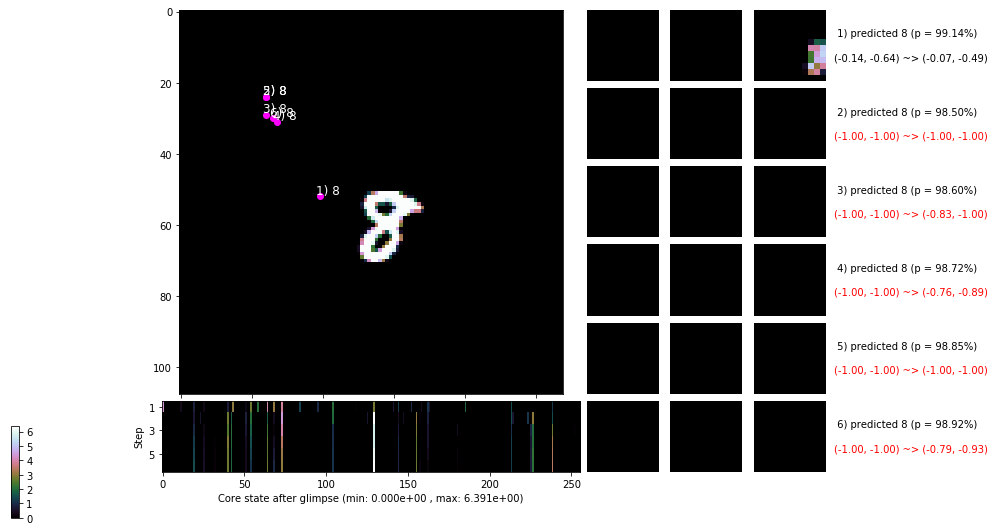

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


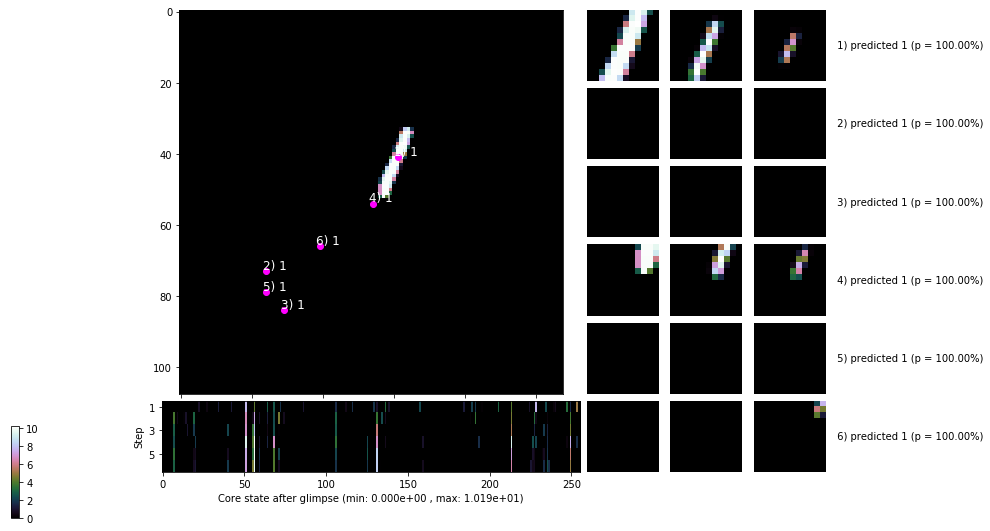


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


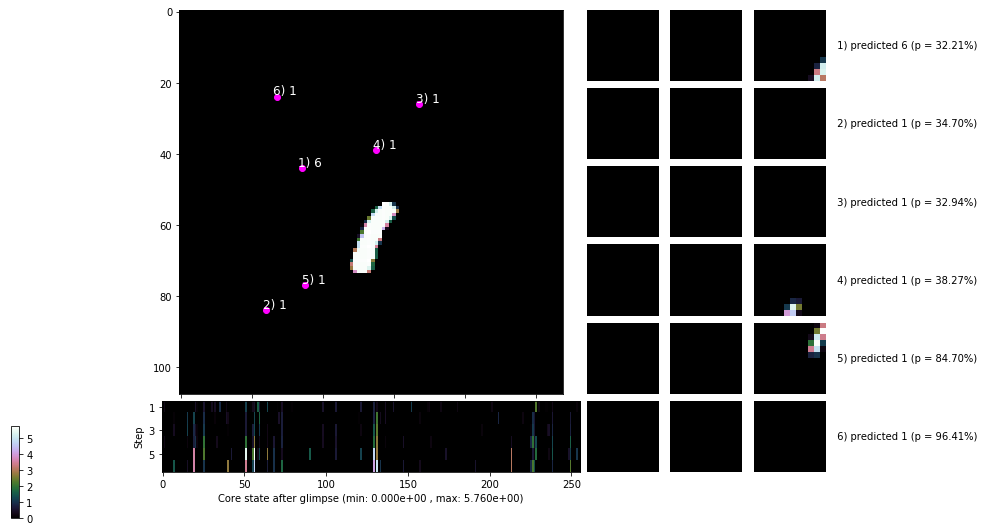

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


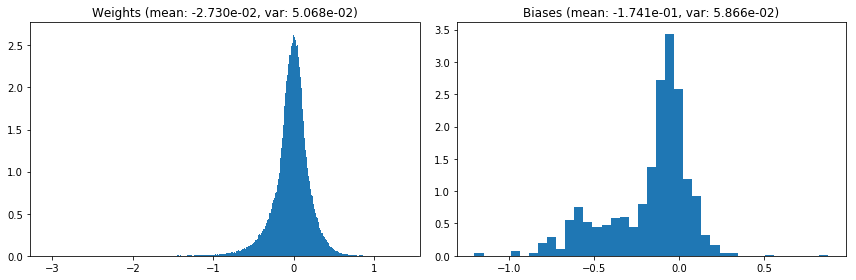

                                      Location network weights and biases


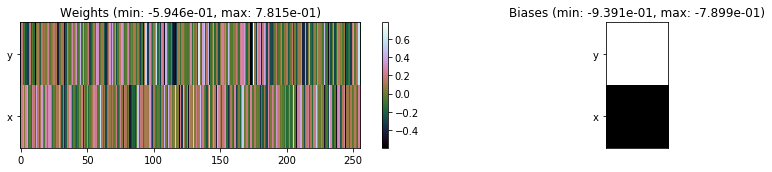

---------------------------------------------------------------------------------------------------------------
Elapsed time:  411.38 sec | TRAIN >> class loss: 0.2331 | steps:  2.192    | reward:  0.9265    | acc.: 92.652% 
                          | VAL   >> class loss: 0.2514 | steps:  2.205 :( | reward:  0.9222 :( | acc.: 92.220% :(


Epoch  40/400) lr = 0.0002983
 b    500/  4000 >> 119.0 ms/b | lr: 2.97e-04 | grad 2norm: 20.73 | grad inf norm:  6.609
       Weights || abs max:  3.06 (11959.82) | mean: -2.73e-02 ( 0.07) | var: 5.07e-02 (27380.14)
        Biases || abs max:  1.20 (  279.64) | mean: -1.74e-01 ( 0.40) | var: 5.87e-02 ( 5912.42)
                  class loss: 0.252 | steps: 2.259 | reward:  0.919 | acc.: 91.95%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 108.4 ms/b | lr: 2.96e-04 | grad 2norm:  7.84 | grad inf norm:  2.997
       Weights || abs max:  3.06 ( 8796.54) | mean: -2.72e-02 ( 0.06) | v

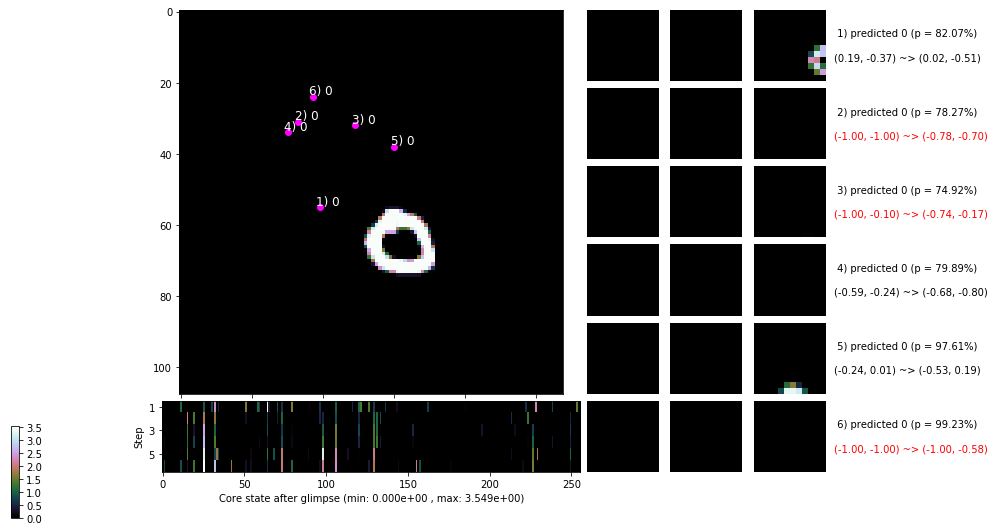

 b   1500/  4000 >> 107.0 ms/b | lr: 2.95e-04 | grad 2norm:  7.92 | grad inf norm:  3.069
       Weights || abs max:  3.06 ( 4991.99) | mean: -2.72e-02 ( 0.04) | var: 5.08e-02 ( 2164.68)
        Biases || abs max:  1.20 (  127.47) | mean: -1.74e-01 ( 0.24) | var: 5.86e-02 ( 1159.90)
                  class loss: 0.255 | steps: 2.280 | reward:  0.920 | acc.: 91.97%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.0 ms/b | lr: 2.94e-04 | grad 2norm:  7.85 | grad inf norm:  3.017
       Weights || abs max:  3.07 (10444.58) | mean: -2.72e-02 ( 0.06) | var: 5.08e-02 (25044.88)
        Biases || abs max:  1.21 (   83.62) | mean: -1.74e-01 ( 0.18) | var: 5.90e-02 (  499.95)
                  class loss: 0.256 | steps: 2.251 | reward:  0.919 | acc.: 91.94%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

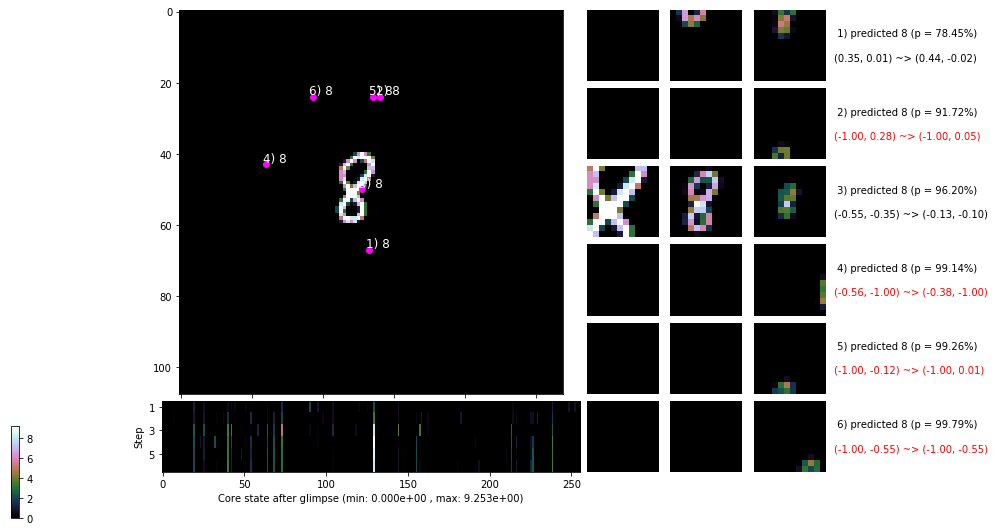

 b   2500/  4000 >> 105.4 ms/b | lr: 2.93e-04 | grad 2norm: 41.34 | grad inf norm: 11.507
       Weights || abs max:  3.07 (11516.01) | mean: -2.72e-02 ( 0.07) | var: 5.09e-02 (40565.31)
        Biases || abs max:  1.21 (  121.50) | mean: -1.75e-01 ( 0.24) | var: 5.91e-02 (  258.95)
                  class loss: 0.239 | steps: 2.225 | reward:  0.925 | acc.: 92.50%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.2 ms/b | lr: 2.92e-04 | grad 2norm: 40.51 | grad inf norm: 11.786
       Weights || abs max:  3.07 (19656.69) | mean: -2.71e-02 ( 0.10) | var: 5.09e-02 (174865.20)
        Biases || abs max:  1.21 (  334.27) | mean: -1.75e-01 ( 0.45) | var: 5.91e-02 (28757.91)
                  class loss: 0.246 | steps: 2.241 | reward:  0.922 | acc.: 92.19%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

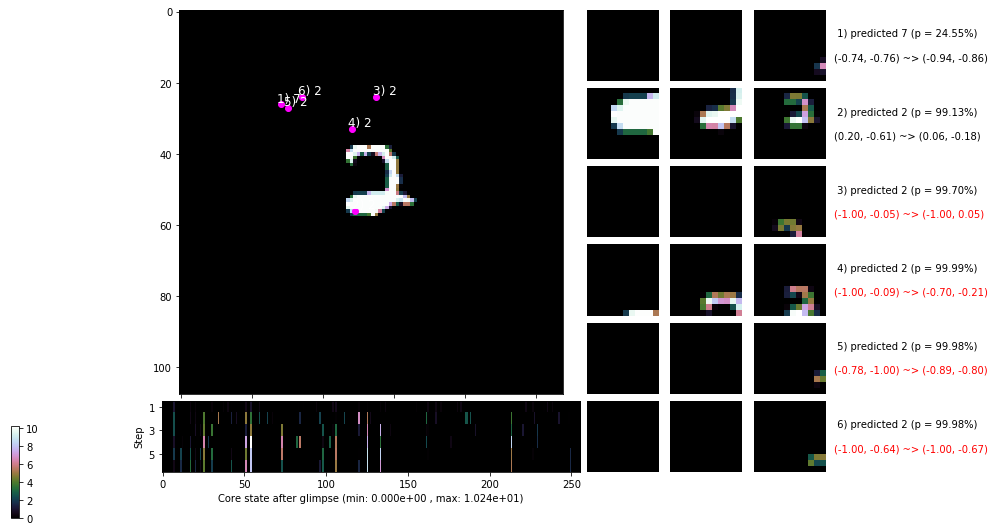

 b   3500/  4000 >> 104.5 ms/b | lr: 2.91e-04 | grad 2norm: 20.71 | grad inf norm:  6.464
       Weights || abs max:  3.08 (13948.07) | mean: -2.70e-02 ( 0.08) | var: 5.10e-02 (64858.95)
        Biases || abs max:  1.21 (  180.84) | mean: -1.75e-01 ( 0.36) | var: 5.92e-02 ( 1680.90)
                  class loss: 0.236 | steps: 2.240 | reward:  0.924 | acc.: 92.43%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.2 ms/b | lr: 2.89e-04 | grad 2norm: 119.82 | grad inf norm: 28.574
       Weights || abs max:  3.08 ( 8398.61) | mean: -2.70e-02 ( 0.06) | var: 5.10e-02 (11134.27)
        Biases || abs max:  1.21 (  100.78) | mean: -1.75e-01 ( 0.24) | var: 5.92e-02 (  135.31)
                  class loss: 0.235 | steps: 2.241 | reward:  0.928 | acc.: 92.79%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

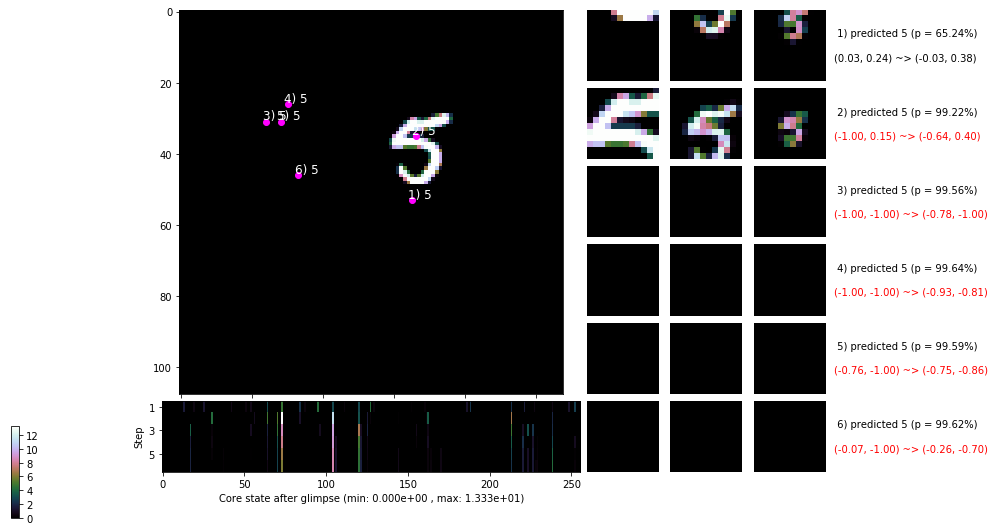

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


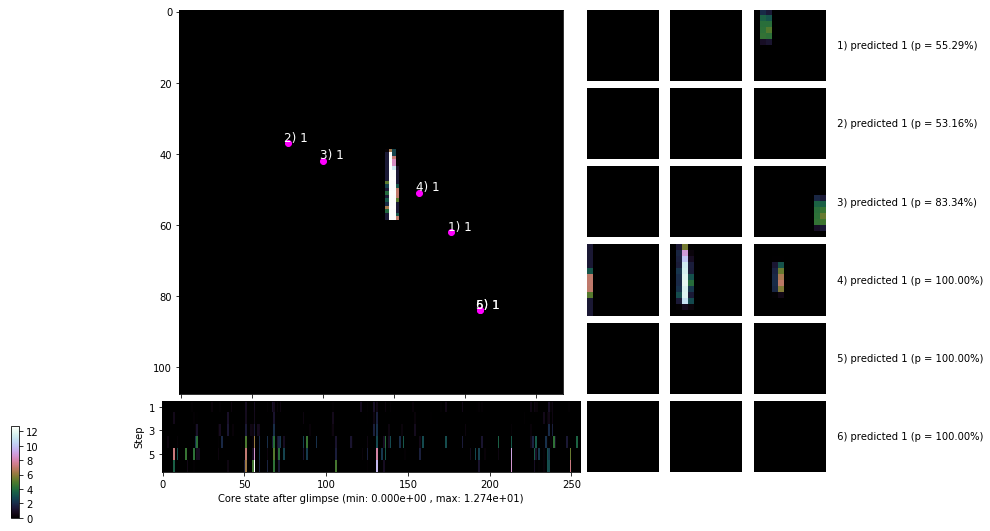


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


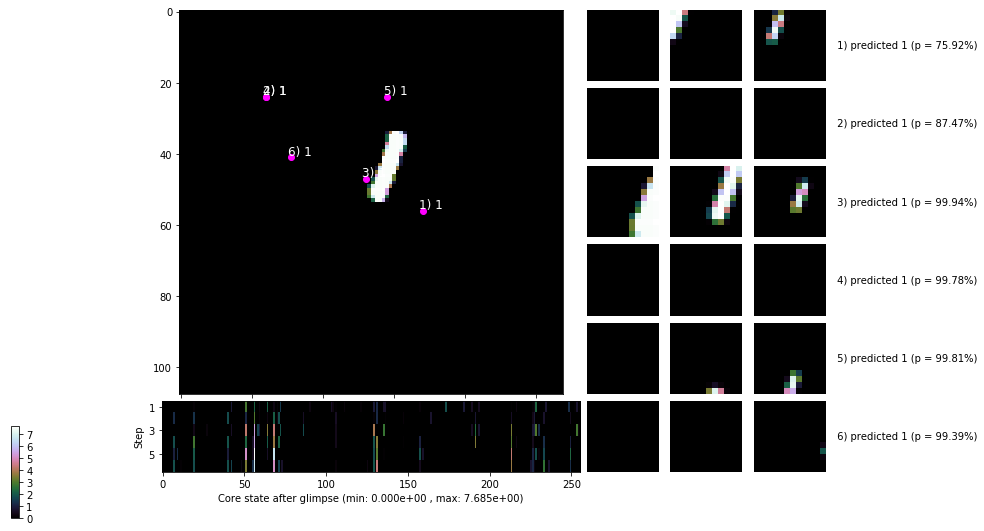

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


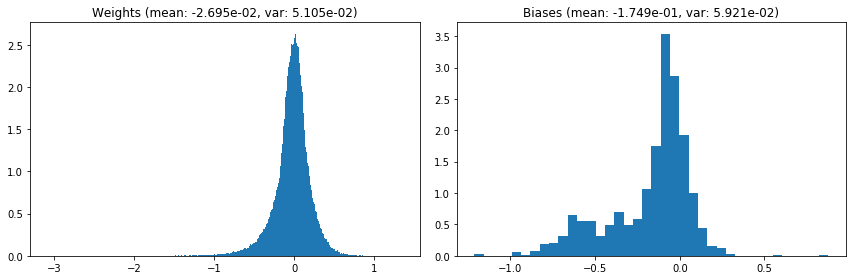

                                      Location network weights and biases


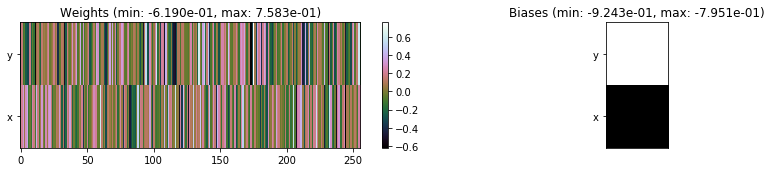

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.48 sec | TRAIN >> class loss: 0.2473 | steps:  2.256 :( | reward:  0.9218 :( | acc.: 92.182% :(
                          | VAL   >> class loss: 0.2176 | steps:  2.216 :( | reward:  0.9344    | acc.: 93.440% 


Epoch  41/400) lr = 0.0002892
 b    500/  4000 >> 102.2 ms/b | lr: 2.88e-04 | grad 2norm:  8.84 | grad inf norm:  3.427
       Weights || abs max:  3.08 (26282.55) | mean: -2.70e-02 ( 0.12) | var: 5.11e-02 (797753.19)
        Biases || abs max:  1.21 (  142.48) | mean: -1.75e-01 ( 0.25) | var: 5.94e-02 ( 1907.46)
                  class loss: 0.241 | steps: 2.207 | reward:  0.923 | acc.: 92.32%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.8 ms/b | lr: 2.87e-04 | grad 2norm:  8.39 | grad inf norm:  3.253
       Weights || abs max:  3.08 ( 4727.41) | mean: -2.69e-02 ( 0.04) | 

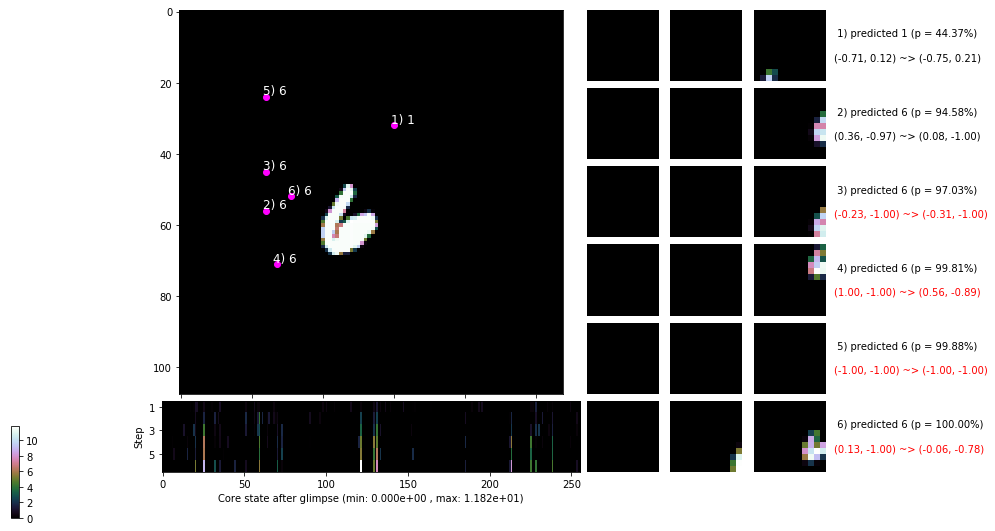

 b   1500/  4000 >> 106.5 ms/b | lr: 2.86e-04 | grad 2norm: 377.42 | grad inf norm: 86.866
       Weights || abs max:  3.09 ( 5202.58) | mean: -2.69e-02 ( 0.04) | var: 5.12e-02 ( 1520.93)
        Biases || abs max:  1.20 (  146.89) | mean: -1.75e-01 ( 0.25) | var: 5.96e-02 (  650.62)
                  class loss: 0.226 | steps: 2.195 | reward:  0.928 | acc.: 92.79%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 108.7 ms/b | lr: 2.85e-04 | grad 2norm: 40.09 | grad inf norm: 10.870
       Weights || abs max:  3.10 ( 6169.70) | mean: -2.68e-02 ( 0.05) | var: 5.12e-02 ( 5422.76)
        Biases || abs max:  1.20 (  134.02) | mean: -1.75e-01 ( 0.30) | var: 5.96e-02 ( 5513.31)
                  class loss: 0.246 | steps: 2.248 | reward:  0.924 | acc.: 92.38%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

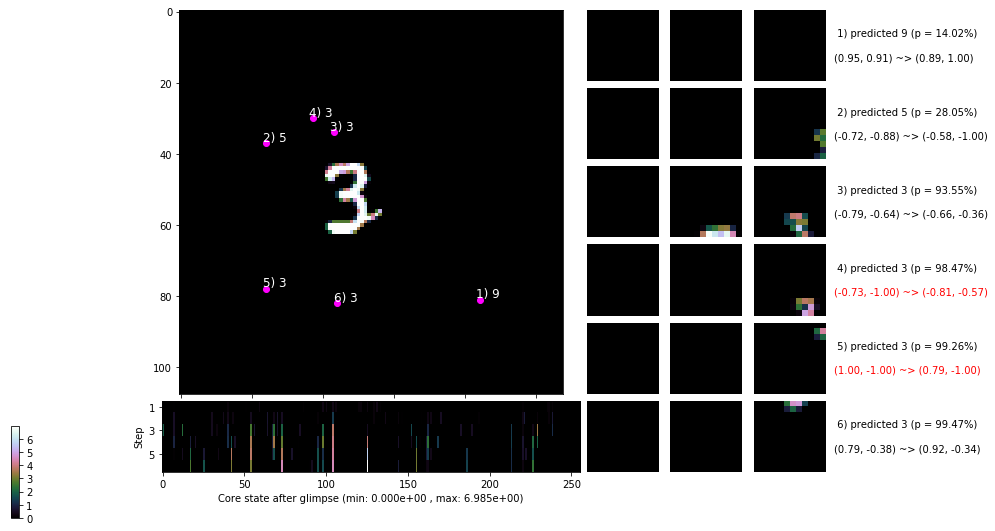

 b   2500/  4000 >> 103.2 ms/b | lr: 2.84e-04 | grad 2norm: 11.06 | grad inf norm:  3.885
       Weights || abs max:  3.10 ( 8621.41) | mean: -2.67e-02 ( 0.06) | var: 5.12e-02 ( 5144.82)
        Biases || abs max:  1.19 (   57.86) | mean: -1.76e-01 ( 0.14) | var: 5.97e-02 (  137.57)
                  class loss: 0.241 | steps: 2.231 | reward:  0.925 | acc.: 92.51%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 100.4 ms/b | lr: 2.83e-04 | grad 2norm: 23.50 | grad inf norm:  7.131
       Weights || abs max:  3.10 ( 9772.57) | mean: -2.67e-02 ( 0.06) | var: 5.13e-02 (34997.88)
        Biases || abs max:  1.20 (   67.70) | mean: -1.76e-01 ( 0.17) | var: 5.98e-02 (  107.72)
                  class loss: 0.234 | steps: 2.208 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

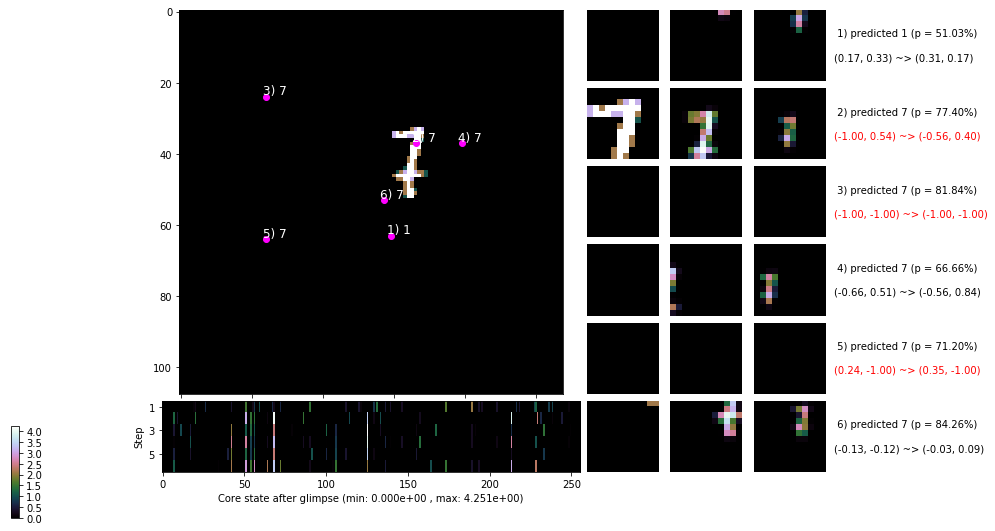

 b   3500/  4000 >> 103.0 ms/b | lr: 2.82e-04 | grad 2norm: 202.08 | grad inf norm: 47.558
       Weights || abs max:  3.11 ( 7387.60) | mean: -2.66e-02 ( 0.05) | var: 5.13e-02 ( 9521.05)
        Biases || abs max:  1.20 (  213.78) | mean: -1.76e-01 ( 0.29) | var: 5.99e-02 (17697.59)
                  class loss: 0.233 | steps: 2.223 | reward:  0.924 | acc.: 92.42%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 100.8 ms/b | lr: 2.81e-04 | grad 2norm: 34.08 | grad inf norm:  9.666
       Weights || abs max:  3.12 (142954.81) | mean: -2.66e-02 ( 0.58) | var: 5.14e-02 (36506188.00)
        Biases || abs max:  1.20 (  220.94) | mean: -1.76e-01 ( 0.31) | var: 6.02e-02 ( 8695.65)
                  class loss: 0.240 | steps: 2.254 | reward:  0.923 | acc.: 92.31%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

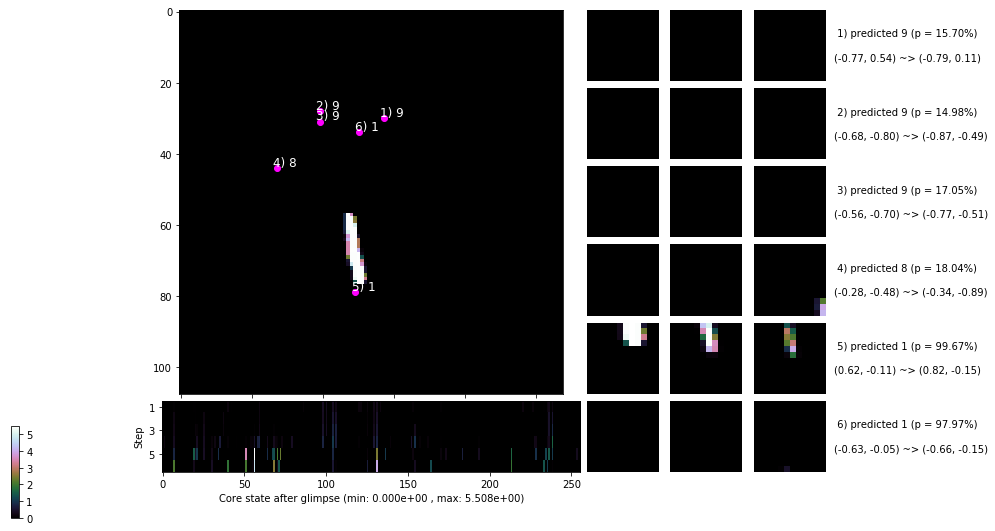

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


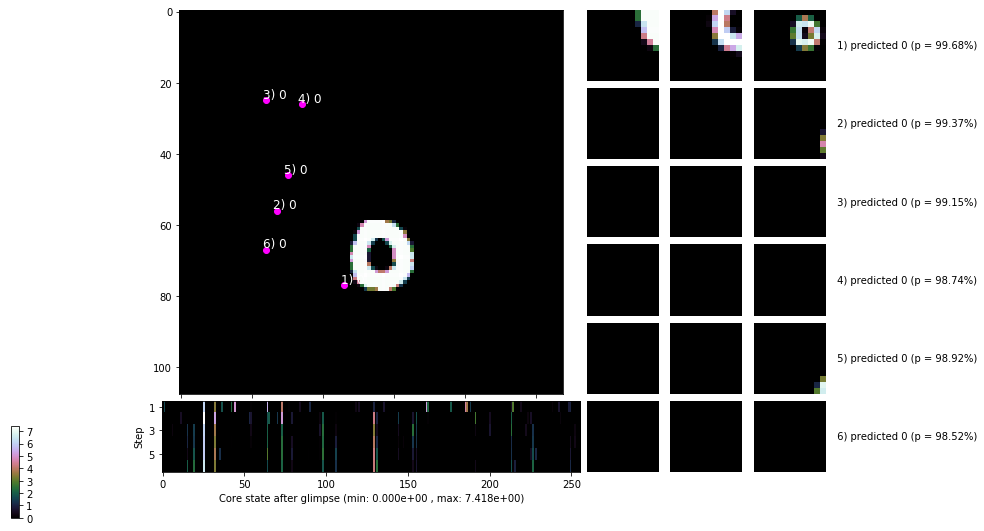


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


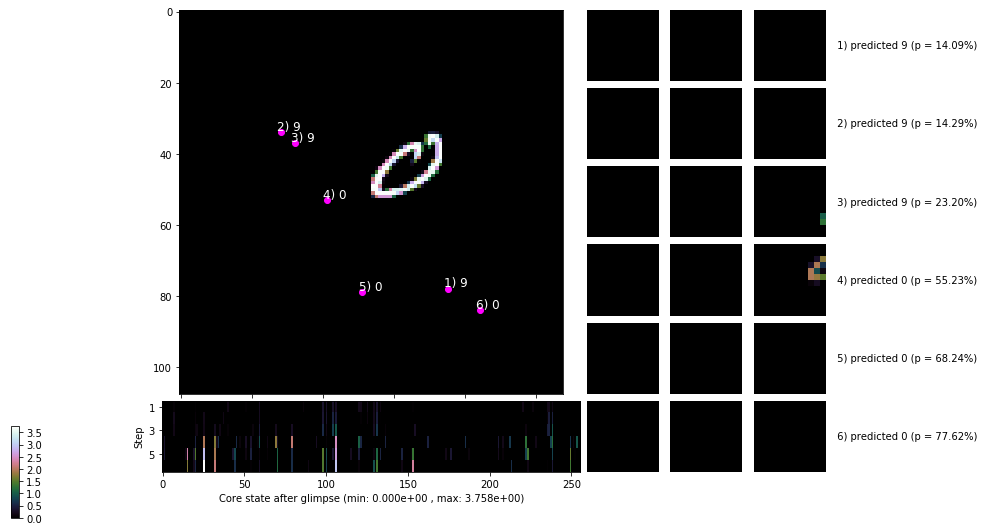

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


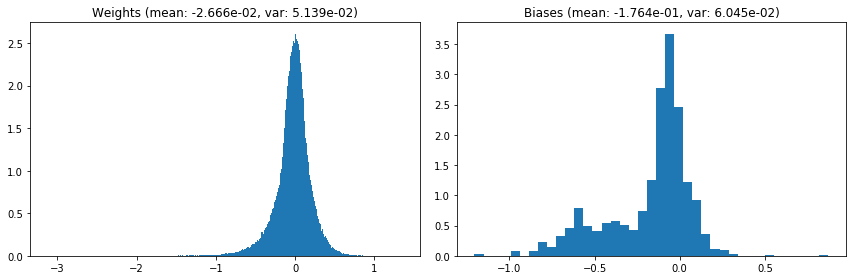

                                      Location network weights and biases


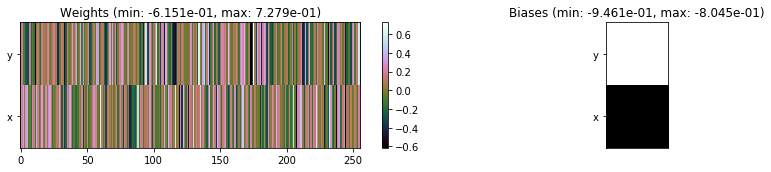

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.96 sec | TRAIN >> class loss: 0.2367 | steps:  2.221 :( | reward:  0.9251 :( | acc.: 92.510% :(
                          | VAL   >> class loss: 0.1974 | steps:  2.154 :( | reward:  0.9352    | acc.: 93.520% 


Epoch  42/400) lr = 0.0002804
 b    500/  4000 >> 102.6 ms/b | lr: 2.80e-04 | grad 2norm: 36.21 | grad inf norm: 10.255
       Weights || abs max:  3.11 (11414.79) | mean: -2.66e-02 ( 0.07) | var: 5.14e-02 (16017.27)
        Biases || abs max:  1.20 (   39.32) | mean: -1.76e-01 ( 0.11) | var: 6.04e-02 (   17.22)
                  class loss: 0.237 | steps: 2.240 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 100.3 ms/b | lr: 2.78e-04 | grad 2norm:  8.50 | grad inf norm:  3.242
       Weights || abs max:  3.11 ( 6862.08) | mean: -2.67e-02 ( 0.05) | v

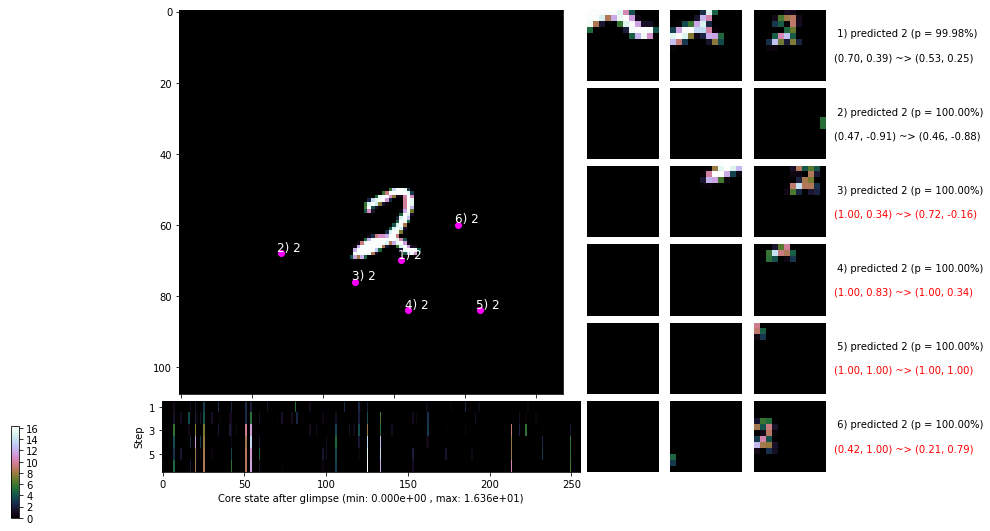

 b   1500/  4000 >> 104.7 ms/b | lr: 2.77e-04 | grad 2norm: 10.59 | grad inf norm:  3.798
       Weights || abs max:  3.11 ( 4557.80) | mean: -2.67e-02 ( 0.04) | var: 5.15e-02 (  648.76)
        Biases || abs max:  1.22 (  370.27) | mean: -1.77e-01 ( 0.48) | var: 6.10e-02 (18275.06)
                  class loss: 0.261 | steps: 2.326 | reward:  0.916 | acc.: 91.57%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.2 ms/b | lr: 2.76e-04 | grad 2norm: 18.39 | grad inf norm:  5.735
       Weights || abs max:  3.11 ( 6719.34) | mean: -2.67e-02 ( 0.05) | var: 5.15e-02 ( 6984.73)
        Biases || abs max:  1.22 (  269.30) | mean: -1.78e-01 ( 0.37) | var: 6.11e-02 (17205.24)
                  class loss: 0.263 | steps: 2.295 | reward:  0.915 | acc.: 91.51%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

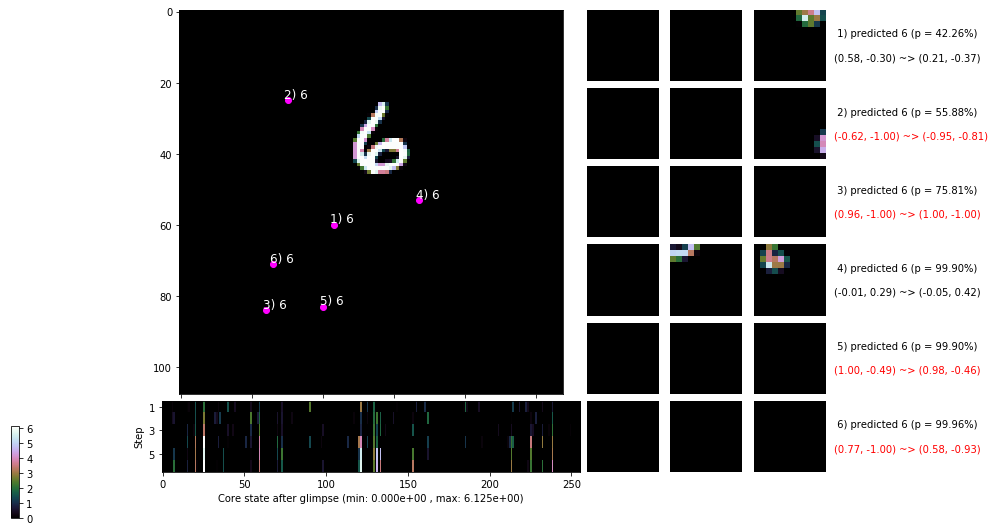

 b   2500/  4000 >> 104.4 ms/b | lr: 2.75e-04 | grad 2norm:  9.10 | grad inf norm:  3.399
       Weights || abs max:  3.11 ( 4830.59) | mean: -2.66e-02 ( 0.04) | var: 5.16e-02 ( 1419.27)
        Biases || abs max:  1.22 (  115.81) | mean: -1.78e-01 ( 0.25) | var: 6.12e-02 (  246.70)
                  class loss: 0.243 | steps: 2.273 | reward:  0.923 | acc.: 92.27%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.7 ms/b | lr: 2.74e-04 | grad 2norm:  8.58 | grad inf norm:  3.238
       Weights || abs max:  3.11 ( 5811.95) | mean: -2.66e-02 ( 0.05) | var: 5.16e-02 (  660.44)
        Biases || abs max:  1.22 (  122.16) | mean: -1.78e-01 ( 0.25) | var: 6.13e-02 (  256.18)
                  class loss: 0.230 | steps: 2.224 | reward:  0.928 | acc.: 92.79%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

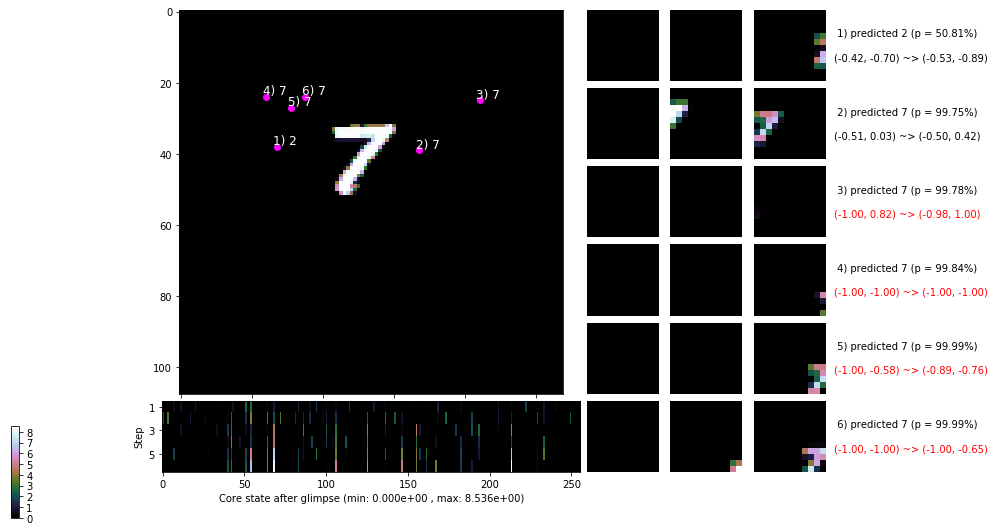

 b   3500/  4000 >> 115.9 ms/b | lr: 2.73e-04 | grad 2norm: 47.89 | grad inf norm: 13.497
       Weights || abs max:  3.11 ( 5905.94) | mean: -2.66e-02 ( 0.04) | var: 5.17e-02 ( 1944.94)
        Biases || abs max:  1.22 (  265.34) | mean: -1.78e-01 ( 0.37) | var: 6.14e-02 (10964.51)
                  class loss: 0.240 | steps: 2.250 | reward:  0.924 | acc.: 92.36%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.9 ms/b | lr: 2.72e-04 | grad 2norm:  8.41 | grad inf norm:  3.216
       Weights || abs max:  3.11 ( 8358.91) | mean: -2.66e-02 ( 0.05) | var: 5.17e-02 ( 9331.54)
        Biases || abs max:  1.22 (   76.45) | mean: -1.78e-01 ( 0.17) | var: 6.14e-02 (   65.19)
                  class loss: 0.227 | steps: 2.228 | reward:  0.929 | acc.: 92.87%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

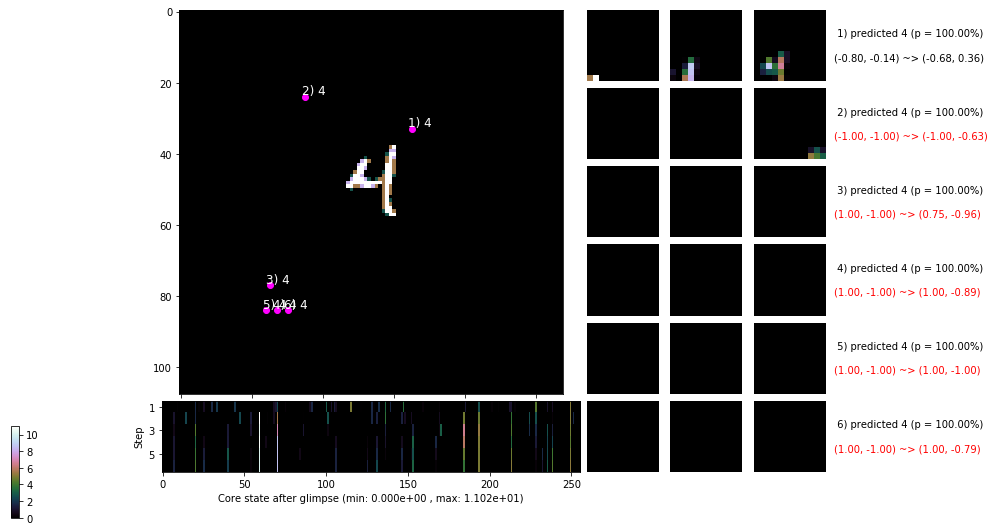

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


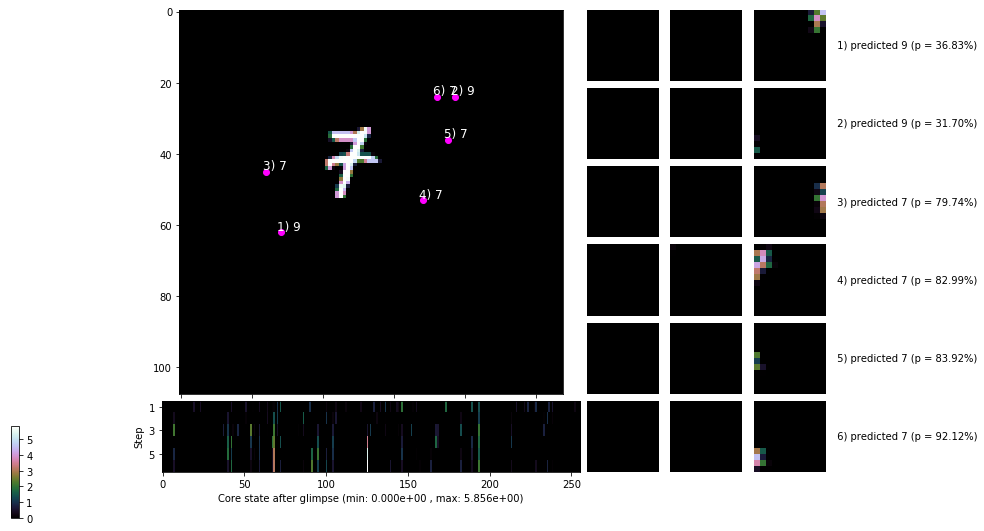


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


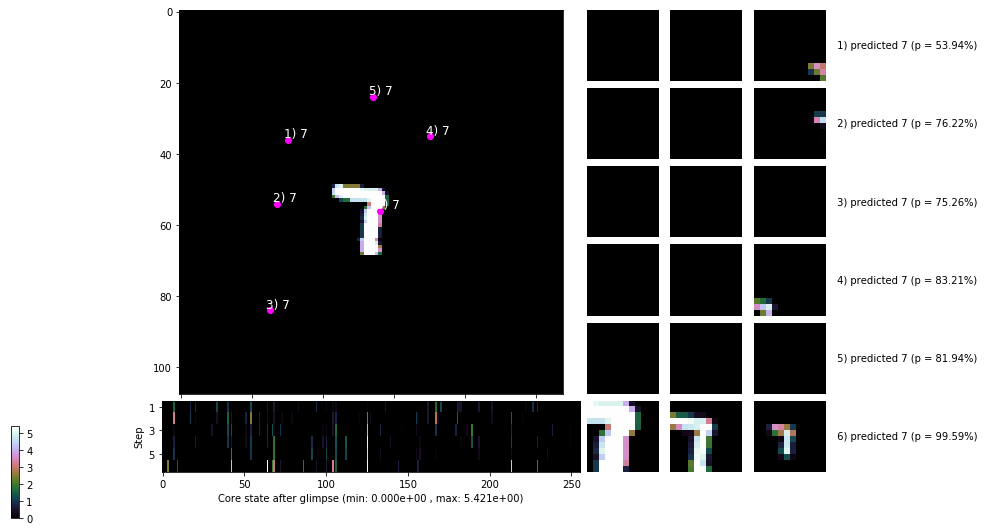

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


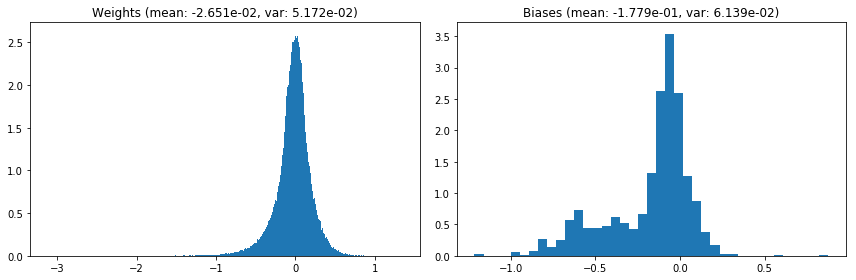

                                      Location network weights and biases


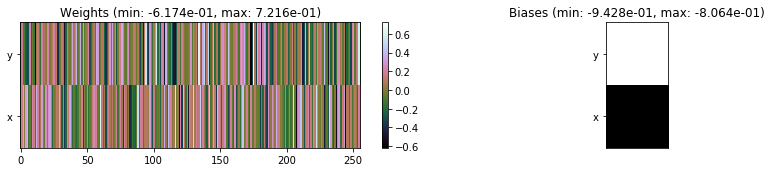

---------------------------------------------------------------------------------------------------------------
Elapsed time:  420.02 sec | TRAIN >> class loss: 0.2444 | steps:  2.267 :( | reward:  0.9223 :( | acc.: 92.226% :(
                          | VAL   >> class loss: 0.2063 | steps:  2.182 :( | reward:  0.9382    | acc.: 93.820% 


Epoch  43/400) lr = 0.0002718
 b    500/  4000 >> 97.9 ms/b | lr: 2.71e-04 | grad 2norm: 23.25 | grad inf norm:  6.727
       Weights || abs max:  3.12 ( 5227.07) | mean: -2.65e-02 ( 0.04) | var: 5.17e-02 ( 1977.75)
        Biases || abs max:  1.22 (   83.62) | mean: -1.78e-01 ( 0.21) | var: 6.14e-02 (  101.30)
                  class loss: 0.242 | steps: 2.216 | reward:  0.924 | acc.: 92.44%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 96.8 ms/b | lr: 2.70e-04 | grad 2norm:  9.43 | grad inf norm:  3.624
       Weights || abs max:  3.12 ( 8532.51) | mean: -2.65e-02 ( 0.06) | var

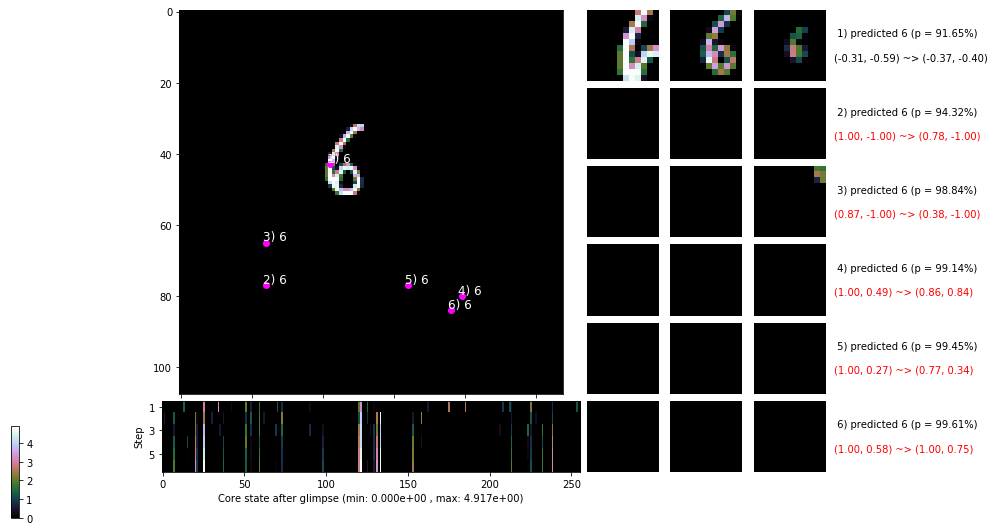

 b   1500/  4000 >> 99.0 ms/b | lr: 2.69e-04 | grad 2norm:  9.68 | grad inf norm:  3.589
       Weights || abs max:  3.13 (17601.17) | mean: -2.64e-02 ( 0.10) | var: 5.18e-02 (59834.86)
        Biases || abs max:  1.21 (   72.63) | mean: -1.78e-01 ( 0.16) | var: 6.16e-02 (  344.93)
                  class loss: 0.224 | steps: 2.219 | reward:  0.929 | acc.: 92.86%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 96.9 ms/b | lr: 2.68e-04 | grad 2norm: 69.50 | grad inf norm: 17.868
       Weights || abs max:  3.13 (12835.84) | mean: -2.64e-02 ( 0.08) | var: 5.19e-02 (54388.16)
        Biases || abs max:  1.21 (  153.10) | mean: -1.79e-01 ( 0.28) | var: 6.18e-02 (  630.12)
                  class loss: 0.229 | steps: 2.226 | reward:  0.930 | acc.: 92.99%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
	

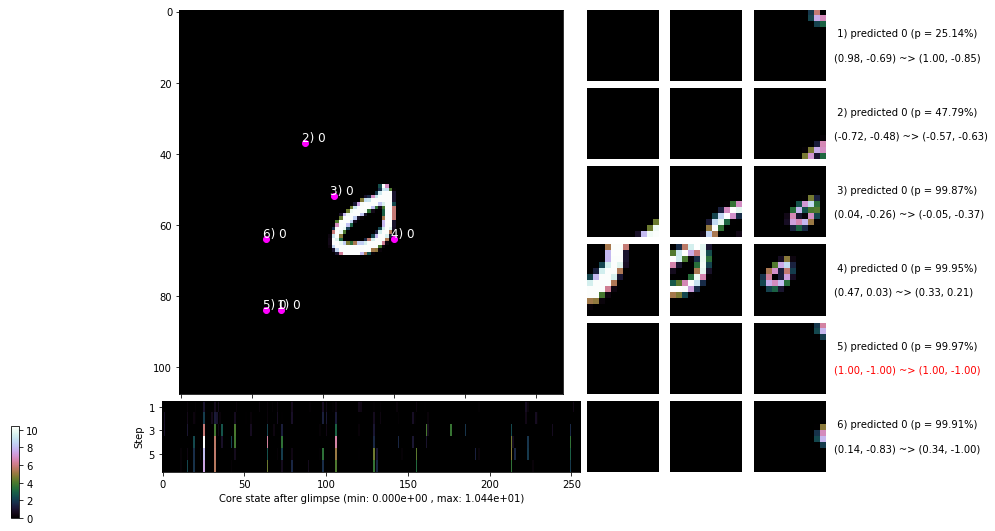

 b   2500/  4000 >> 97.9 ms/b | lr: 2.67e-04 | grad 2norm: 46.98 | grad inf norm: 12.538
       Weights || abs max:  3.13 ( 9303.34) | mean: -2.63e-02 ( 0.06) | var: 5.19e-02 ( 8929.96)
        Biases || abs max:  1.22 (  174.75) | mean: -1.79e-01 ( 0.31) | var: 6.20e-02 (  686.38)
                  class loss: 0.228 | steps: 2.198 | reward:  0.931 | acc.: 93.13%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.8 ms/b | lr: 2.66e-04 | grad 2norm: 395.18 | grad inf norm: 88.556
       Weights || abs max:  3.13 ( 6381.78) | mean: -2.63e-02 ( 0.05) | var: 5.19e-02 ( 4853.11)
        Biases || abs max:  1.22 (  203.10) | mean: -1.79e-01 ( 0.31) | var: 6.21e-02 ( 3737.43)
                  class loss: 0.231 | steps: 2.227 | reward:  0.928 | acc.: 92.77%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

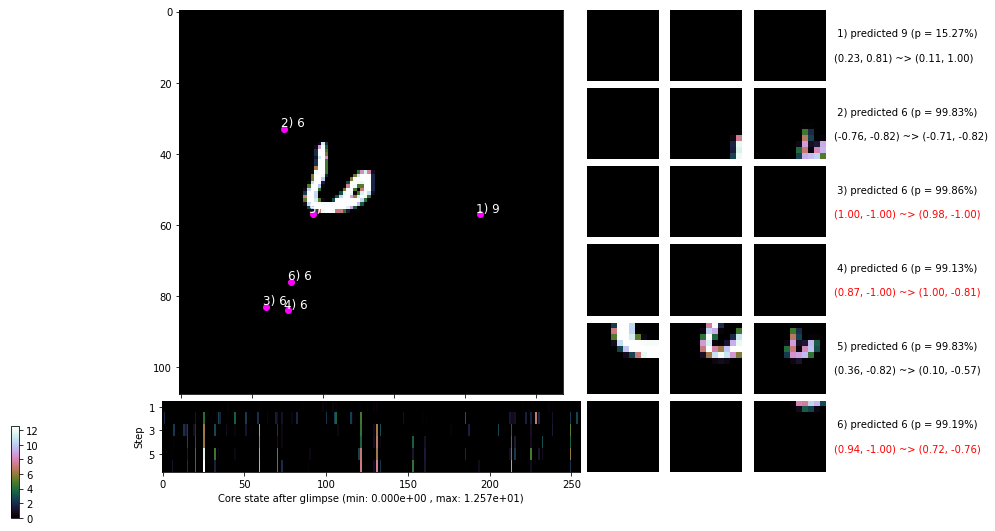

 b   3500/  4000 >> 108.2 ms/b | lr: 2.65e-04 | grad 2norm: 218.68 | grad inf norm: 49.712
       Weights || abs max:  3.13 ( 9474.64) | mean: -2.62e-02 ( 0.06) | var: 5.20e-02 (17318.09)
        Biases || abs max:  1.21 (   97.45) | mean: -1.79e-01 ( 0.22) | var: 6.21e-02 (  133.86)
                  class loss: 0.218 | steps: 2.167 | reward:  0.933 | acc.: 93.25%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 95.5 ms/b | lr: 2.64e-04 | grad 2norm: 26.33 | grad inf norm:  7.584
       Weights || abs max:  3.14 ( 7960.72) | mean: -2.62e-02 ( 0.06) | var: 5.20e-02 ( 6678.20)
        Biases || abs max:  1.21 (  119.73) | mean: -1.79e-01 ( 0.22) | var: 6.22e-02 (  877.00)
                  class loss: 0.220 | steps: 2.209 | reward:  0.929 | acc.: 92.93%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

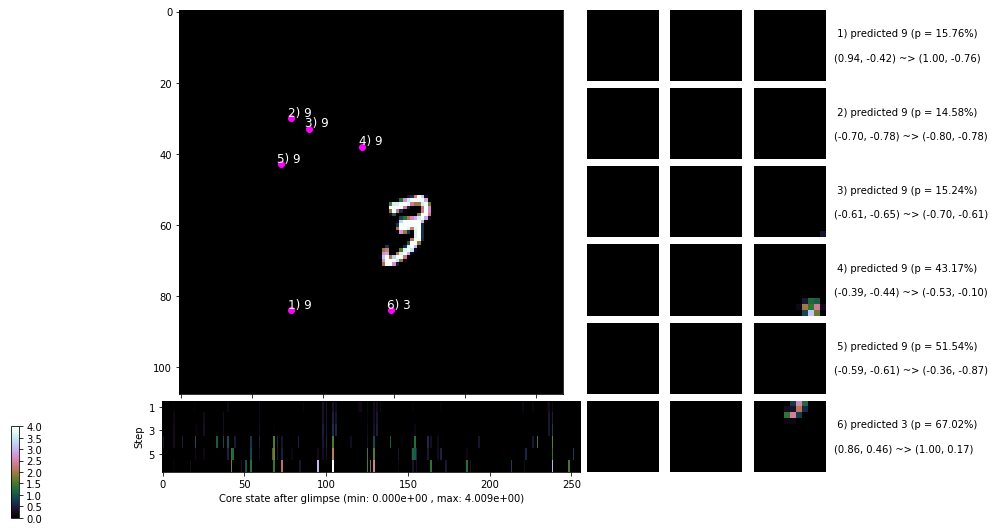

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


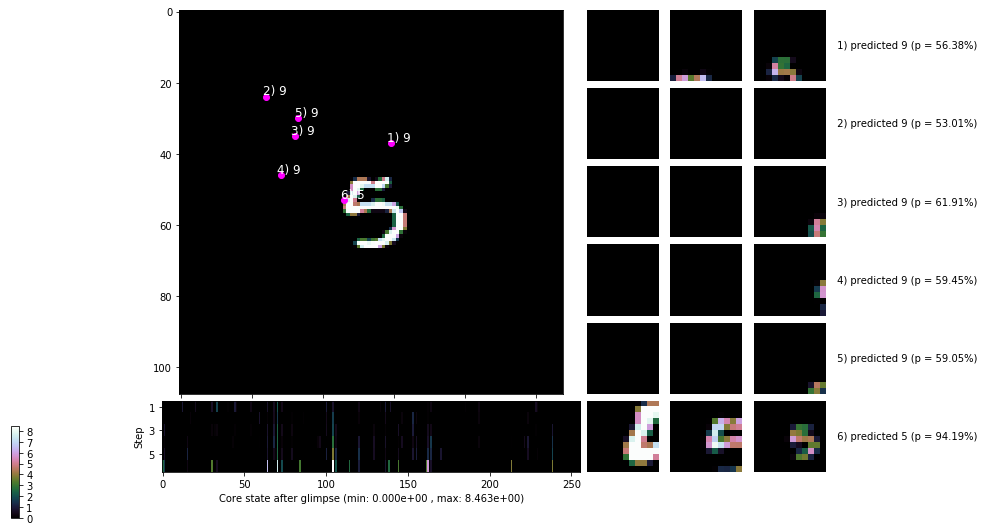


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


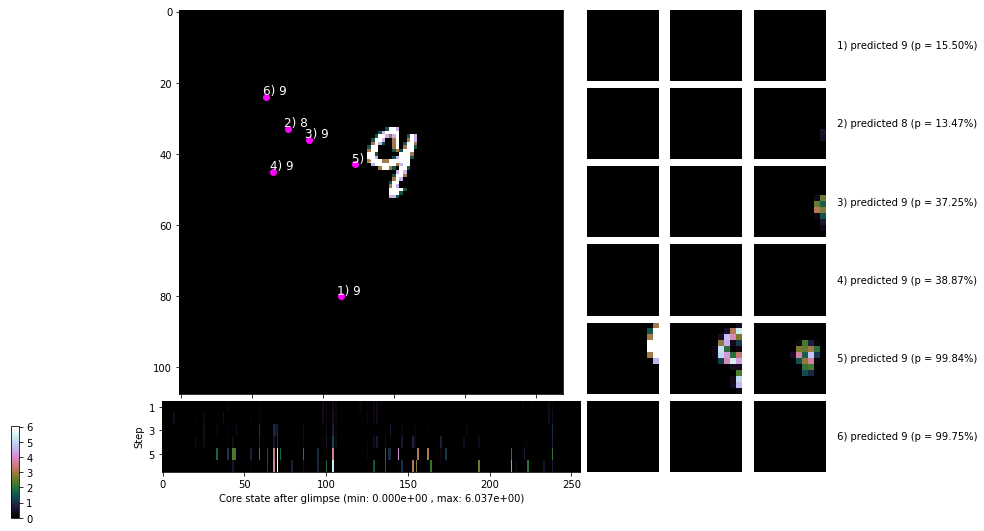

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


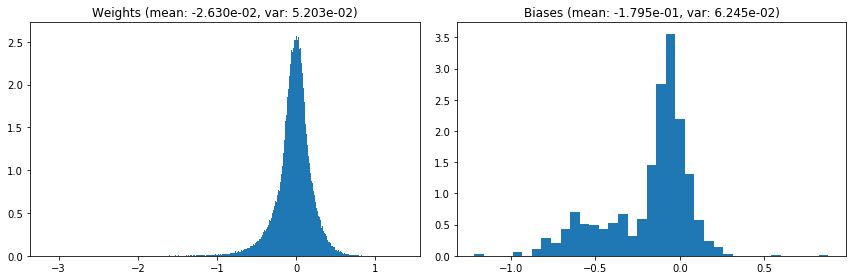

                                      Location network weights and biases


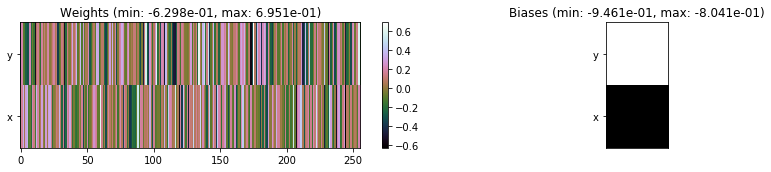

---------------------------------------------------------------------------------------------------------------
Elapsed time:  399.13 sec | TRAIN >> class loss: 0.2265 | steps:  2.204 :( | reward:  0.9293    | acc.: 92.931% 
                          | VAL   >> class loss: 0.2074 | steps:  2.222 :( | reward:  0.9340 :( | acc.: 93.400% :(


Epoch  44/400) lr = 0.0002635
 b    500/  4000 >> 105.5 ms/b | lr: 2.63e-04 | grad 2norm: 14.69 | grad inf norm:  4.687
       Weights || abs max:  3.14 ( 4961.41) | mean: -2.62e-02 ( 0.04) | var: 5.20e-02 (  829.70)
        Biases || abs max:  1.22 (   95.35) | mean: -1.79e-01 ( 0.19) | var: 6.25e-02 (  650.50)
                  class loss: 0.220 | steps: 2.208 | reward:  0.931 | acc.: 93.08%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 98.7 ms/b | lr: 2.62e-04 | grad 2norm: 45.54 | grad inf norm: 12.227
       Weights || abs max:  3.14 ( 7304.44) | mean: -2.61e-02 ( 0.05) | va

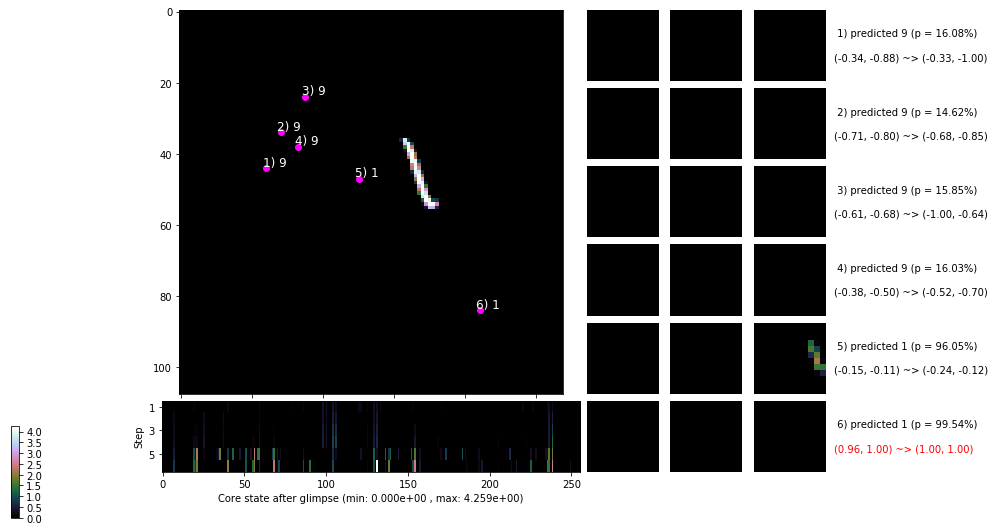

 b   1500/  4000 >> 108.1 ms/b | lr: 2.61e-04 | grad 2norm: 173.46 | grad inf norm: 39.254
       Weights || abs max:  3.13 ( 9292.27) | mean: -2.60e-02 ( 0.06) | var: 5.21e-02 ( 7325.79)
        Biases || abs max:  1.22 (  104.77) | mean: -1.79e-01 ( 0.22) | var: 6.25e-02 (  398.42)
                  class loss: 0.241 | steps: 2.267 | reward:  0.924 | acc.: 92.43%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 95.9 ms/b | lr: 2.60e-04 | grad 2norm: 26.29 | grad inf norm:  7.326
       Weights || abs max:  3.14 ( 5228.06) | mean: -2.60e-02 ( 0.04) | var: 5.22e-02 ( 1389.51)
        Biases || abs max:  1.23 (  432.90) | mean: -1.79e-01 ( 0.57) | var: 6.26e-02 (25050.36)
                  class loss: 0.244 | steps: 2.277 | reward:  0.921 | acc.: 92.11%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

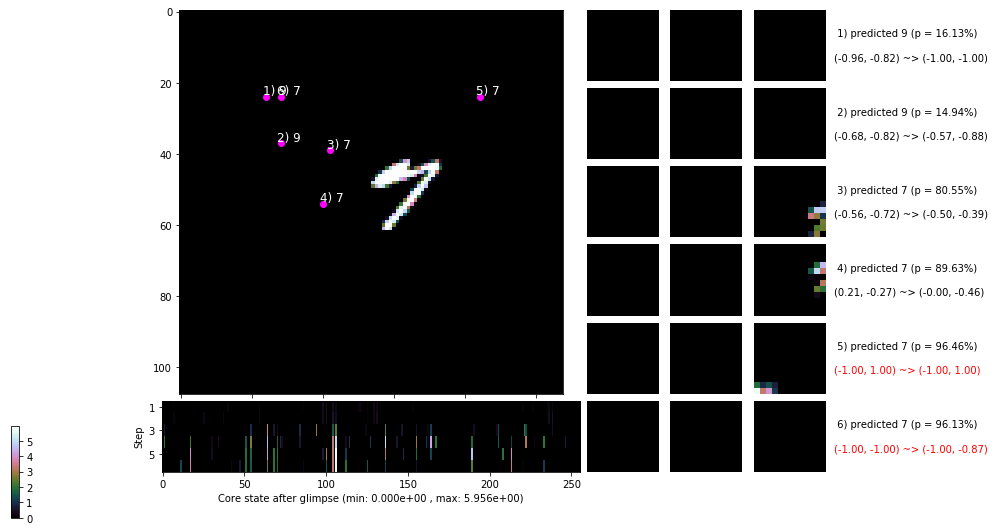

 b   2500/  4000 >> 99.9 ms/b | lr: 2.59e-04 | grad 2norm: 10.25 | grad inf norm:  3.637
       Weights || abs max:  3.13 (12059.26) | mean: -2.60e-02 ( 0.07) | var: 5.22e-02 (27667.78)
        Biases || abs max:  1.24 (  126.33) | mean: -1.80e-01 ( 0.23) | var: 6.28e-02 (  347.60)
                  class loss: 0.230 | steps: 2.246 | reward:  0.925 | acc.: 92.53%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.3 ms/b | lr: 2.58e-04 | grad 2norm: 22.12 | grad inf norm:  6.454
       Weights || abs max:  3.13 ( 9869.90) | mean: -2.60e-02 ( 0.06) | var: 5.22e-02 (41075.25)
        Biases || abs max:  1.24 ( 4628.59) | mean: -1.80e-01 ( 8.87) | var: 6.28e-02 (19032814.00)
                  class loss: 0.242 | steps: 2.275 | reward:  0.923 | acc.: 92.29%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

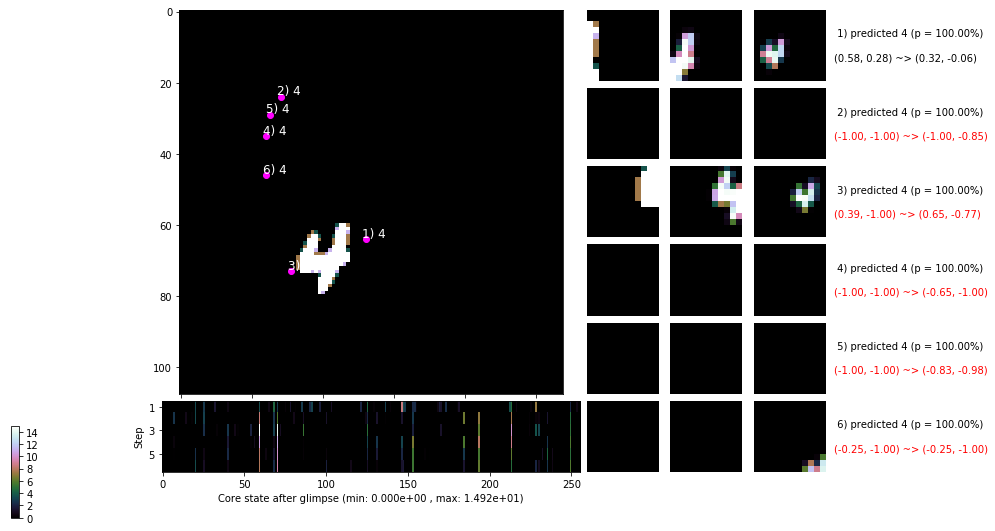

 b   3500/  4000 >> 108.4 ms/b | lr: 2.57e-04 | grad 2norm: 368.13 | grad inf norm: 77.478
       Weights || abs max:  3.13 ( 7264.91) | mean: -2.60e-02 ( 0.05) | var: 5.23e-02 ( 4375.97)
        Biases || abs max:  1.24 (  107.17) | mean: -1.80e-01 ( 0.20) | var: 6.27e-02 (  276.75)
                  class loss: 0.238 | steps: 2.271 | reward:  0.926 | acc.: 92.57%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.1 ms/b | lr: 2.56e-04 | grad 2norm: 228.31 | grad inf norm: 51.120
       Weights || abs max:  3.14 ( 5740.86) | mean: -2.60e-02 ( 0.05) | var: 5.23e-02 ( 1802.36)
        Biases || abs max:  1.24 (   87.49) | mean: -1.80e-01 ( 0.19) | var: 6.28e-02 (  123.74)
                  class loss: 0.238 | steps: 2.243 | reward:  0.923 | acc.: 92.31%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

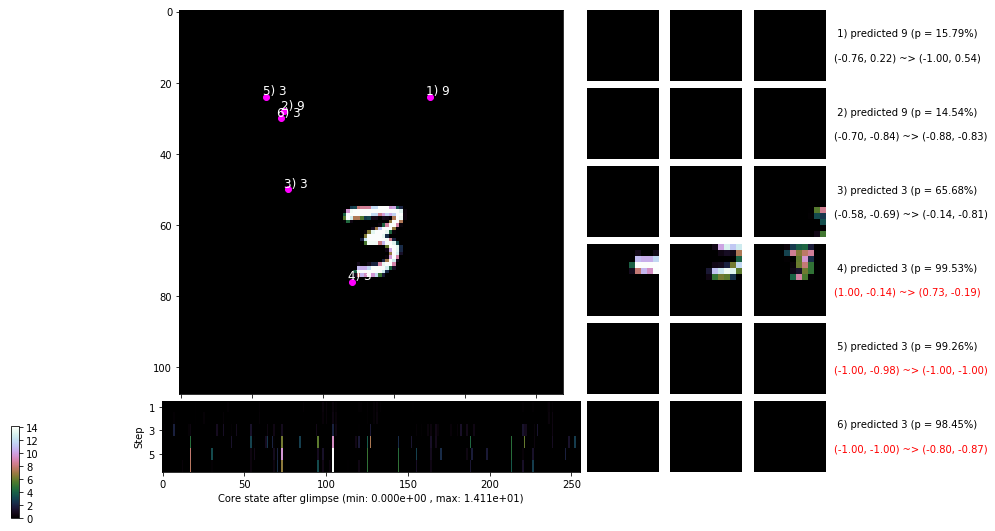

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


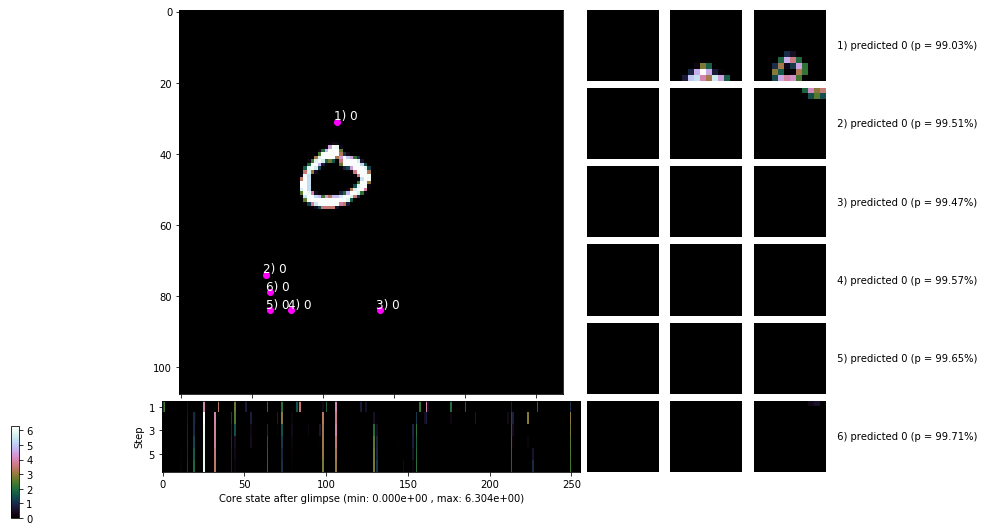


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


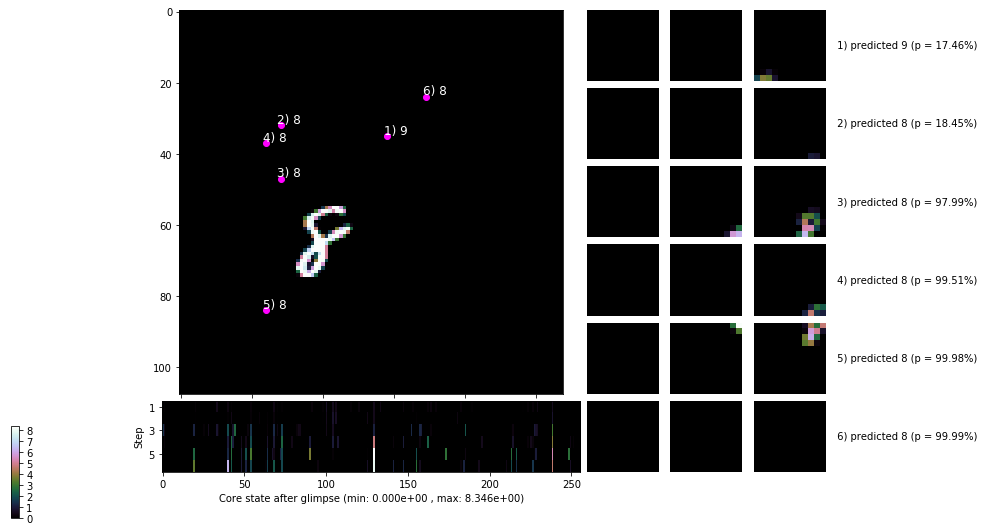

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


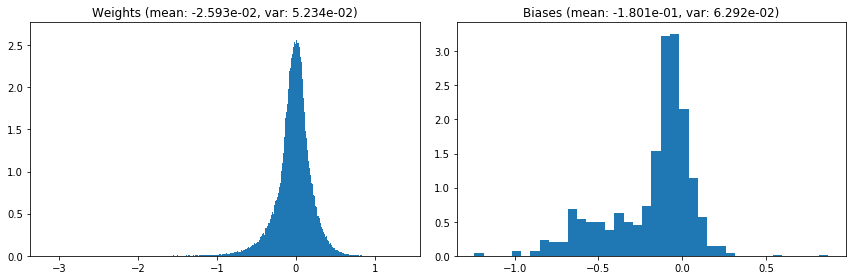

                                      Location network weights and biases


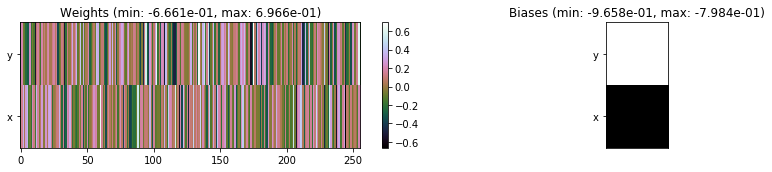

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.14 sec | TRAIN >> class loss: 0.2352 | steps:  2.254 :( | reward:  0.9253 :( | acc.: 92.531% :(
                          | VAL   >> class loss: 0.2276 | steps:  2.229 :( | reward:  0.9288 :( | acc.: 92.880% :(


Epoch  45/400) lr = 0.0002555
 b    500/  4000 >> 107.7 ms/b | lr: 2.55e-04 | grad 2norm: 33.79 | grad inf norm:  9.346
       Weights || abs max:  3.14 ( 4693.60) | mean: -2.59e-02 ( 0.04) | var: 5.24e-02 (  469.53)
        Biases || abs max:  1.25 (  691.42) | mean: -1.80e-01 ( 0.83) | var: 6.29e-02 (35798.87)
                  class loss: 0.248 | steps: 2.274 | reward:  0.922 | acc.: 92.25%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.3 ms/b | lr: 2.54e-04 | grad 2norm: 30.17 | grad inf norm:  8.327
       Weights || abs max:  3.15 ( 6991.08) | mean: -2.59e-02 ( 0.05) |

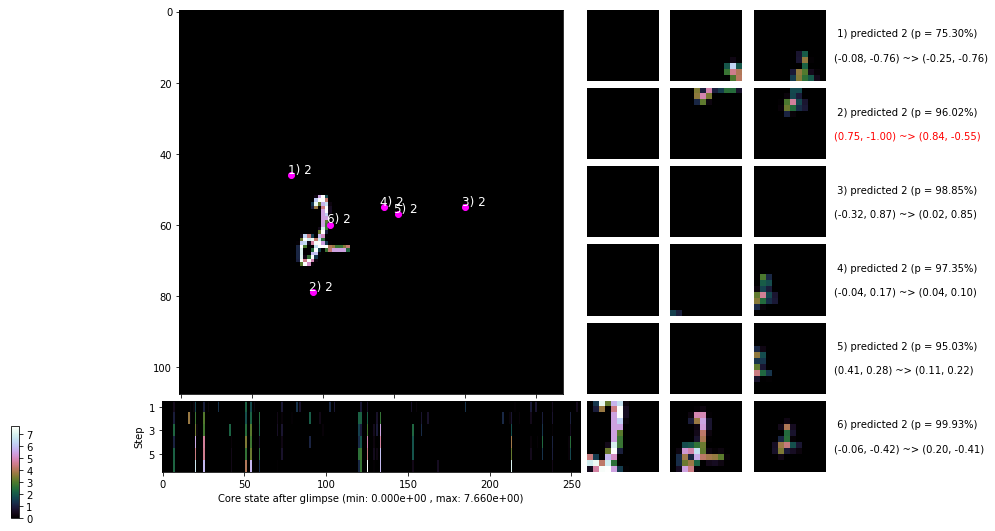

 b   1500/  4000 >> 97.1 ms/b | lr: 2.53e-04 | grad 2norm: 31.85 | grad inf norm:  8.489
       Weights || abs max:  3.15 (10728.89) | mean: -2.59e-02 ( 0.06) | var: 5.24e-02 (14587.26)
        Biases || abs max:  1.24 (   45.09) | mean: -1.80e-01 ( 0.14) | var: 6.31e-02 (   38.68)
                  class loss: 0.236 | steps: 2.254 | reward:  0.922 | acc.: 92.24%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 94.7 ms/b | lr: 2.52e-04 | grad 2norm: 118.56 | grad inf norm: 27.555
       Weights || abs max:  3.16 ( 7271.34) | mean: -2.59e-02 ( 0.05) | var: 5.25e-02 ( 7505.44)
        Biases || abs max:  1.24 (   45.07) | mean: -1.80e-01 ( 0.13) | var: 6.31e-02 (   39.25)
                  class loss: 0.232 | steps: 2.225 | reward:  0.927 | acc.: 92.71%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


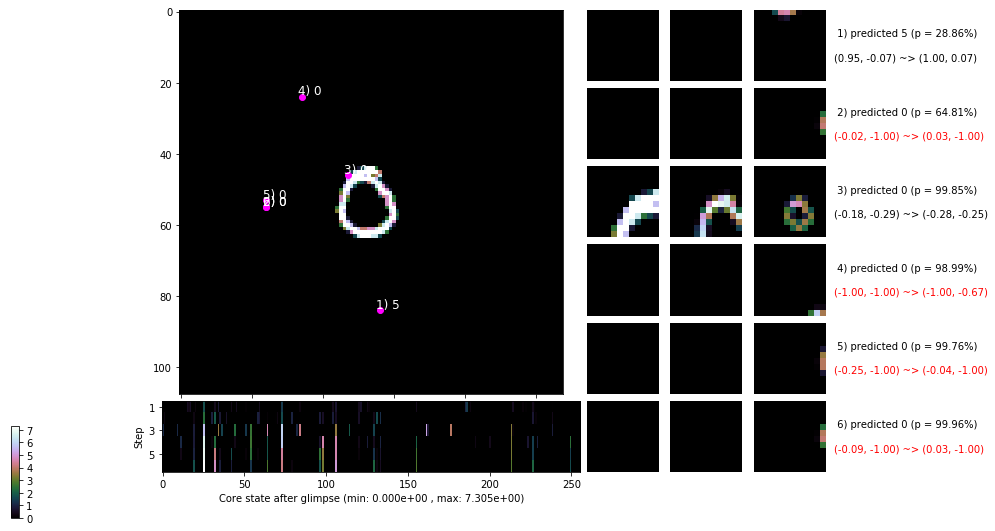

 b   2500/  4000 >> 97.0 ms/b | lr: 2.51e-04 | grad 2norm: 65.24 | grad inf norm: 16.730
       Weights || abs max:  3.16 ( 3682.39) | mean: -2.58e-02 ( 0.03) | var: 5.25e-02 (  531.93)
        Biases || abs max:  1.24 (   83.58) | mean: -1.81e-01 ( 0.17) | var: 6.34e-02 (  582.82)
                  class loss: 0.230 | steps: 2.210 | reward:  0.929 | acc.: 92.93%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 99.9 ms/b | lr: 2.50e-04 | grad 2norm: 85.01 | grad inf norm: 20.654
       Weights || abs max:  3.16 ( 8975.12) | mean: -2.58e-02 ( 0.06) | var: 5.25e-02 (18616.46)
        Biases || abs max:  1.25 (   46.73) | mean: -1.81e-01 ( 0.14) | var: 6.36e-02 (   16.85)
                  class loss: 0.221 | steps: 2.210 | reward:  0.929 | acc.: 92.87%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
	

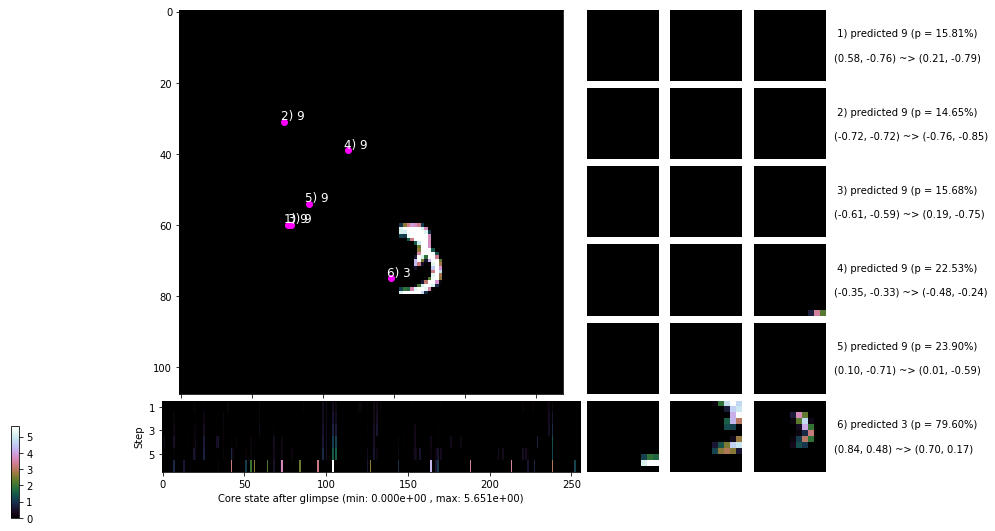

 b   3500/  4000 >> 96.7 ms/b | lr: 2.49e-04 | grad 2norm: 29.47 | grad inf norm:  7.587
       Weights || abs max:  3.16 ( 5918.49) | mean: -2.57e-02 ( 0.05) | var: 5.26e-02 ( 1353.89)
        Biases || abs max:  1.25 (  101.59) | mean: -1.81e-01 ( 0.21) | var: 6.37e-02 (  283.45)
                  class loss: 0.223 | steps: 2.218 | reward:  0.930 | acc.: 92.97%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 94.3 ms/b | lr: 2.48e-04 | grad 2norm: 116.46 | grad inf norm: 28.629
       Weights || abs max:  3.17 (13714.88) | mean: -2.56e-02 ( 0.08) | var: 5.26e-02 (143393.17)
        Biases || abs max:  1.26 (  279.80) | mean: -1.81e-01 ( 0.42) | var: 6.36e-02 ( 2169.47)
                  class loss: 0.234 | steps: 2.236 | reward:  0.926 | acc.: 92.58%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

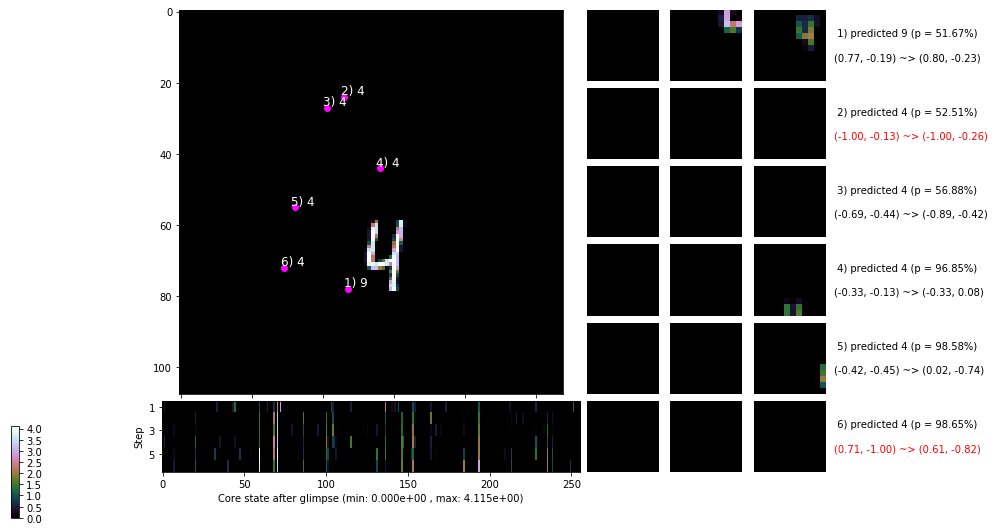

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


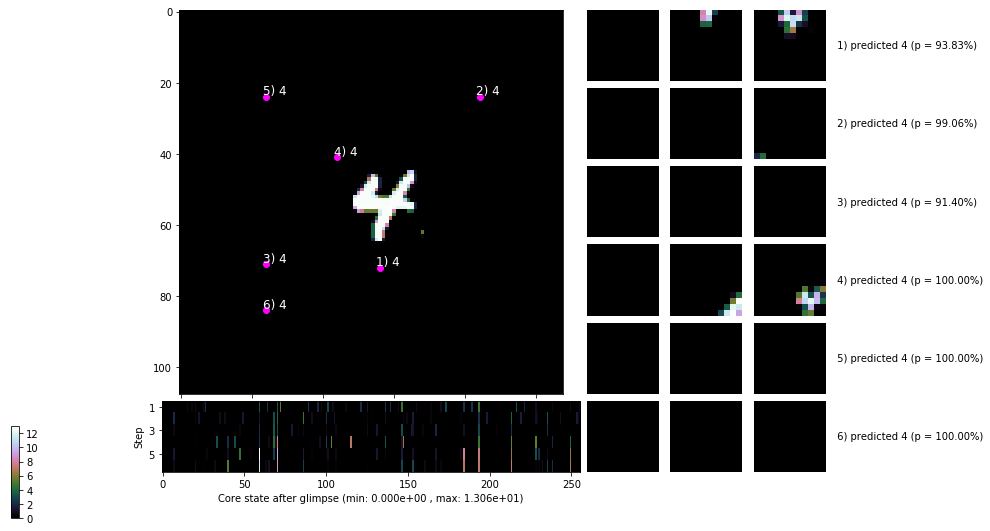


	Target class: 7  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


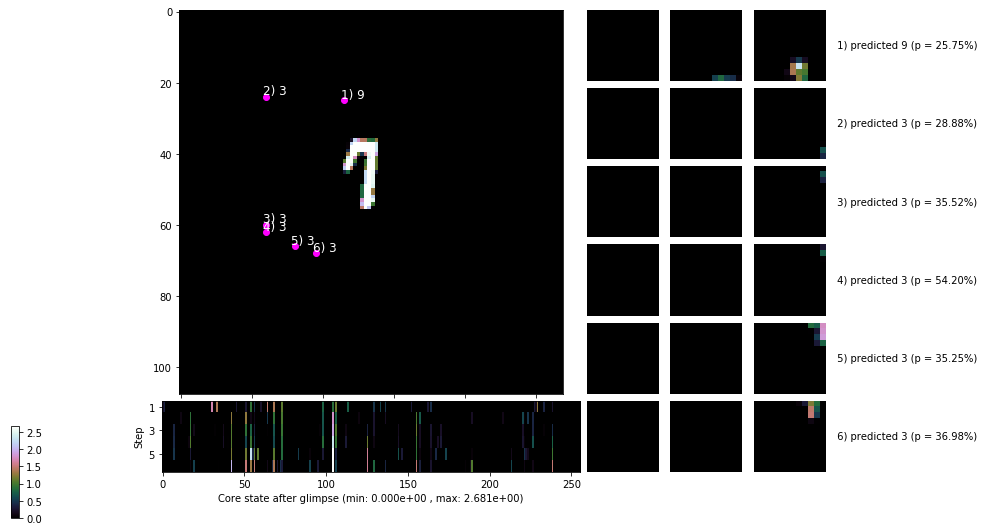

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


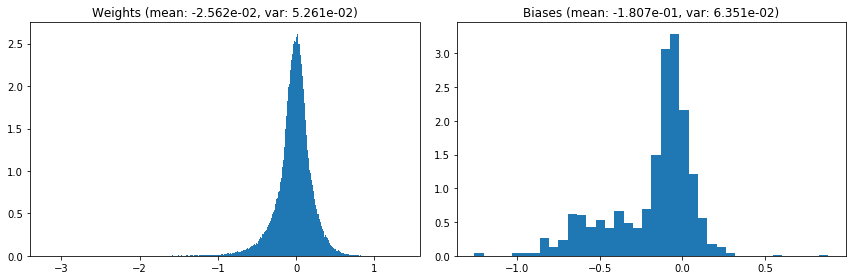

                                      Location network weights and biases


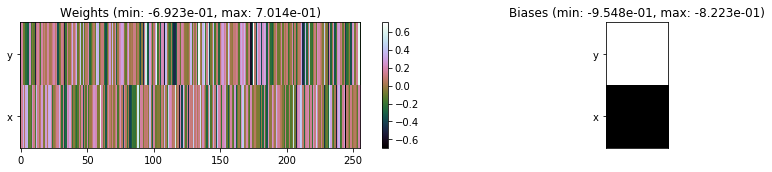

---------------------------------------------------------------------------------------------------------------
Elapsed time:  395.90 sec | TRAIN >> class loss: 0.2327 | steps:  2.234 :( | reward:  0.9263 :( | acc.: 92.632% :(
                          | VAL   >> class loss: 0.2052 | steps:  2.185 :( | reward:  0.9374 :( | acc.: 93.740% :(


Epoch  46/400) lr = 0.0002477
 b    500/  4000 >> 94.7 ms/b | lr: 2.47e-04 | grad 2norm: 28.92 | grad inf norm:  8.118
       Weights || abs max:  3.17 ( 5678.20) | mean: -2.57e-02 ( 0.05) | var: 5.26e-02 ( 1577.40)
        Biases || abs max:  1.26 (  181.96) | mean: -1.81e-01 ( 0.34) | var: 6.37e-02 ( 1710.82)
                  class loss: 0.225 | steps: 2.236 | reward:  0.930 | acc.: 92.95%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 94.3 ms/b | lr: 2.46e-04 | grad 2norm: 195.18 | grad inf norm: 42.318
       Weights || abs max:  3.17 ( 5093.42) | mean: -2.57e-02 ( 0.04) | 

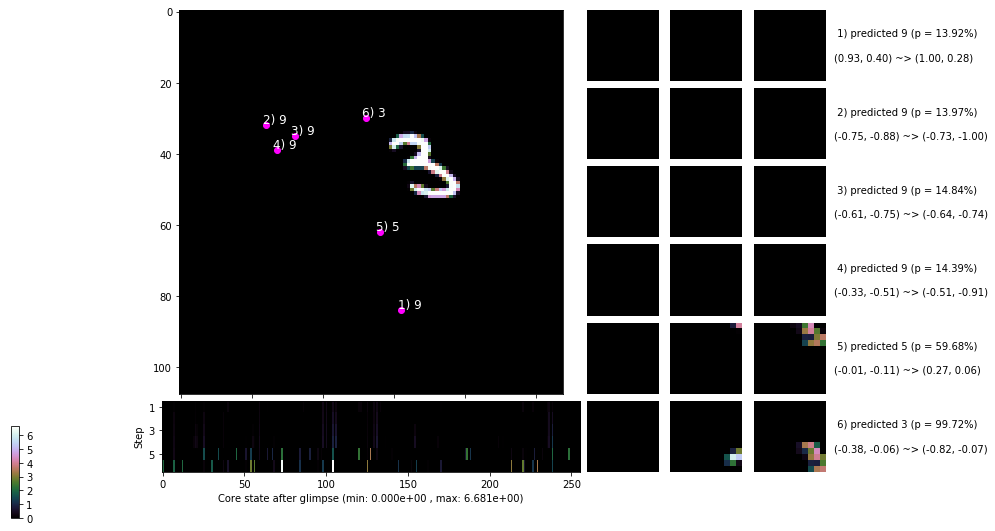

 b   1500/  4000 >> 97.2 ms/b | lr: 2.45e-04 | grad 2norm: 104.29 | grad inf norm: 24.321
       Weights || abs max:  3.17 (16515.78) | mean: -2.57e-02 ( 0.09) | var: 5.27e-02 (208615.45)
        Biases || abs max:  1.26 (  426.53) | mean: -1.81e-01 ( 0.55) | var: 6.38e-02 (35312.82)
                  class loss: 0.249 | steps: 2.310 | reward:  0.922 | acc.: 92.17%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 99.9 ms/b | lr: 2.44e-04 | grad 2norm: 69.29 | grad inf norm: 16.024
       Weights || abs max:  3.17 ( 9010.71) | mean: -2.55e-02 ( 0.06) | var: 5.27e-02 (11446.87)
        Biases || abs max:  1.26 (  300.11) | mean: -1.81e-01 ( 0.47) | var: 6.37e-02 ( 2709.51)
                  class loss: 0.251 | steps: 2.272 | reward:  0.920 | acc.: 91.99%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

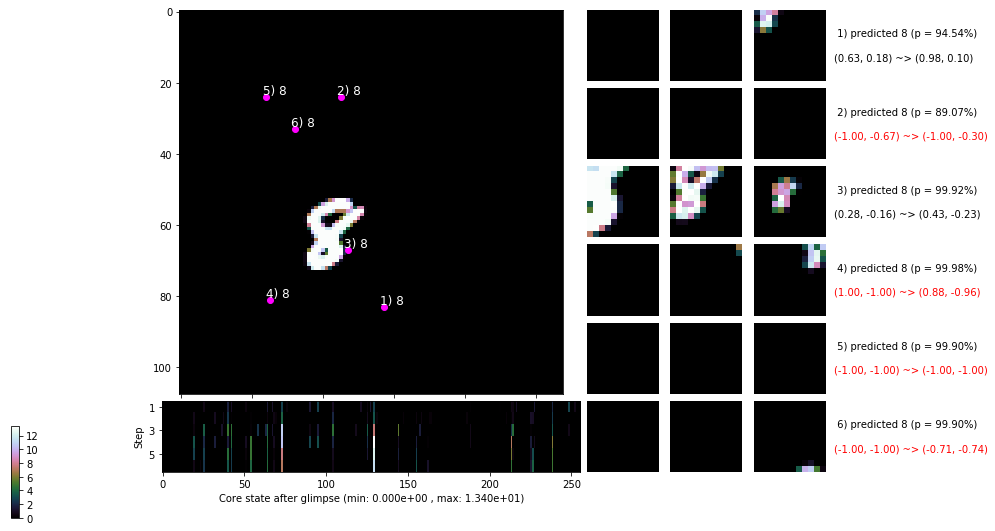

 b   2500/  4000 >> 101.6 ms/b | lr: 2.43e-04 | grad 2norm: 453.26 | grad inf norm: 91.301
       Weights || abs max:  3.18 (14191.44) | mean: -2.54e-02 ( 0.08) | var: 5.28e-02 (157116.91)
        Biases || abs max:  1.25 (  499.98) | mean: -1.81e-01 ( 0.67) | var: 6.36e-02 (23629.64)
                  class loss: 0.245 | steps: 2.270 | reward:  0.924 | acc.: 92.38%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 99.9 ms/b | lr: 2.42e-04 | grad 2norm: 227.27 | grad inf norm: 47.934
       Weights || abs max:  3.18 ( 4932.47) | mean: -2.54e-02 ( 0.04) | var: 5.28e-02 ( 1351.00)
        Biases || abs max:  1.26 (  110.39) | mean: -1.81e-01 ( 0.24) | var: 6.37e-02 (  170.60)
                  class loss: 0.241 | steps: 2.254 | reward:  0.924 | acc.: 92.35%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

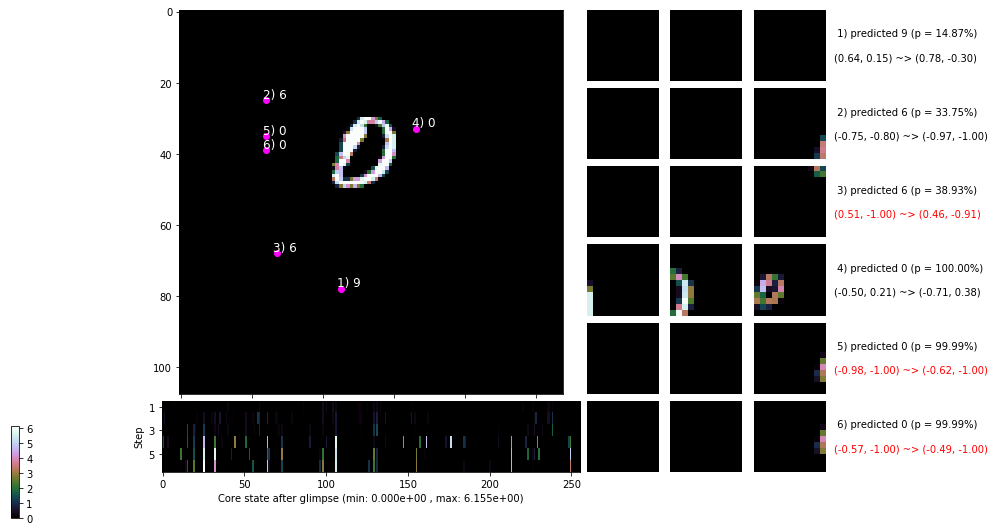

 b   3500/  4000 >> 100.1 ms/b | lr: 2.41e-04 | grad 2norm: 91.88 | grad inf norm: 22.042
       Weights || abs max:  3.19 ( 7952.62) | mean: -2.54e-02 ( 0.06) | var: 5.28e-02 ( 3873.49)
        Biases || abs max:  1.26 (  204.02) | mean: -1.81e-01 ( 0.35) | var: 6.39e-02 ( 1375.62)
                  class loss: 0.226 | steps: 2.266 | reward:  0.928 | acc.: 92.83%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 99.6 ms/b | lr: 2.40e-04 | grad 2norm: 769.34 | grad inf norm: 158.786
       Weights || abs max:  3.19 (22477.34) | mean: -2.54e-02 ( 0.11) | var: 5.29e-02 (480123.81)
        Biases || abs max:  1.26 (  199.72) | mean: -1.81e-01 ( 0.35) | var: 6.41e-02 (  821.16)
                  class loss: 0.381 | steps: 2.277 | reward:  0.924 | acc.: 92.42%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

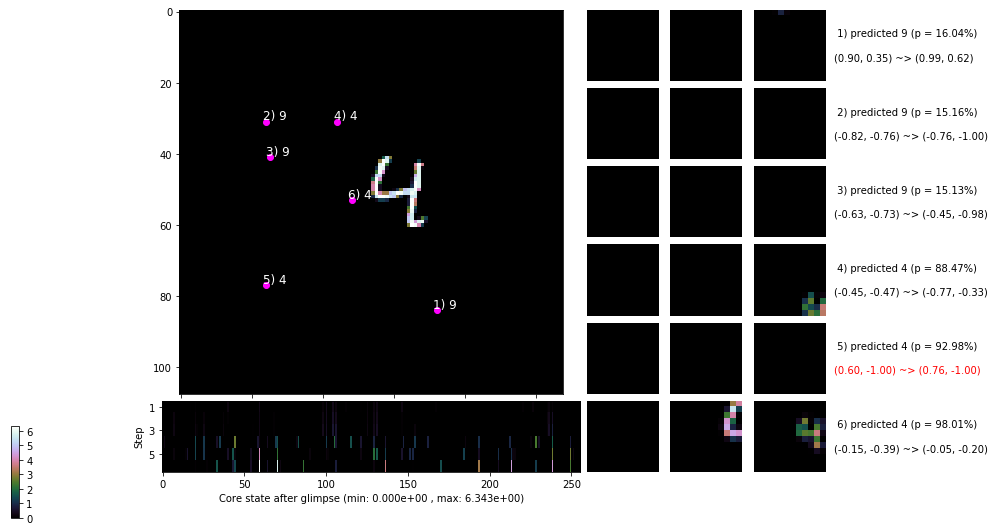

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


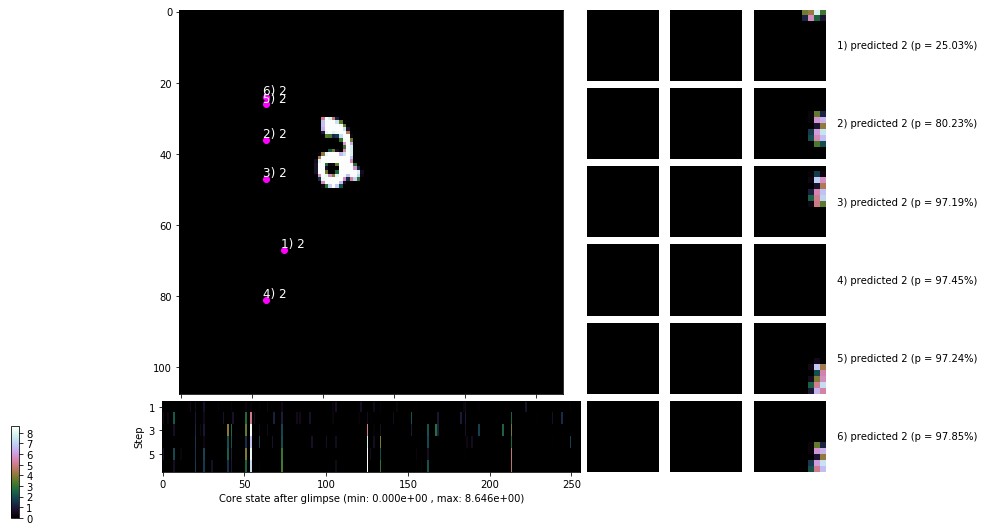


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


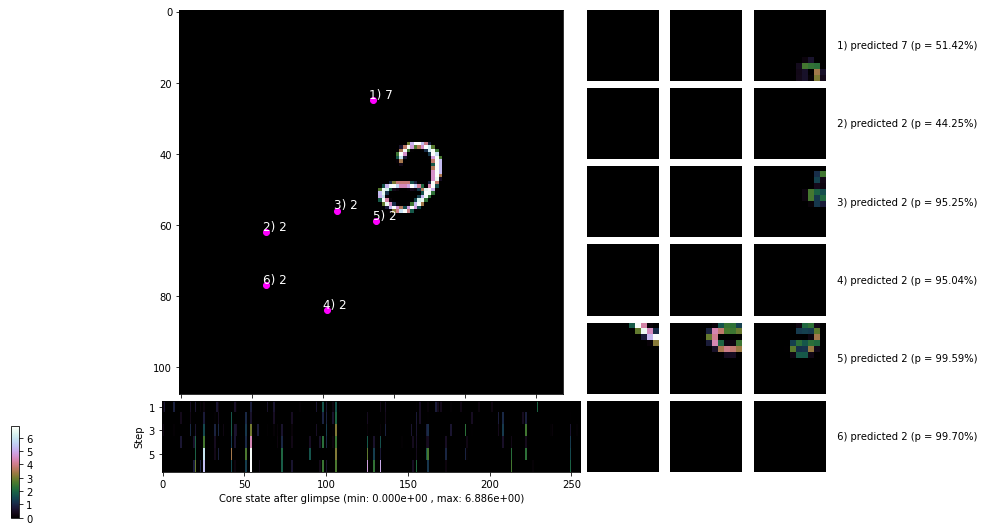

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


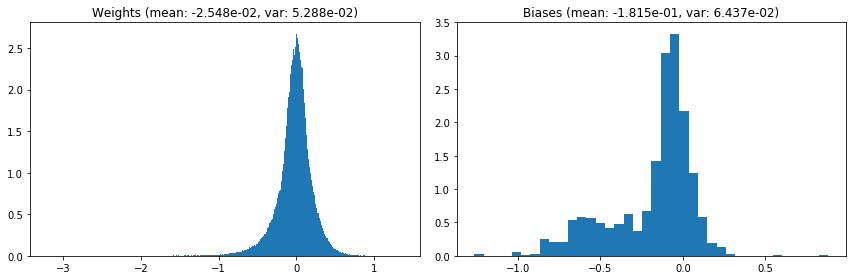

                                      Location network weights and biases


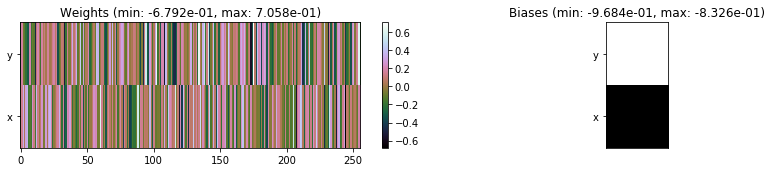

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.77 sec | TRAIN >> class loss: 0.2564 | steps:  2.268 :( | reward:  0.9245 :( | acc.: 92.451% :(
                          | VAL   >> class loss: 0.2271 | steps:  2.264 :( | reward:  0.9258 :( | acc.: 92.580% :(


Epoch  47/400) lr = 0.0002401
 b    500/  4000 >> 98.4 ms/b | lr: 2.39e-04 | grad 2norm:  9.17 | grad inf norm:  3.394
       Weights || abs max:  3.19 (21780.01) | mean: -2.55e-02 ( 0.11) | var: 5.29e-02 (232093.66)
        Biases || abs max:  1.25 (  175.00) | mean: -1.82e-01 ( 0.31) | var: 6.43e-02 ( 1110.06)
                  class loss: 0.240 | steps: 2.242 | reward:  0.923 | acc.: 92.34%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 106.8 ms/b | lr: 2.38e-04 | grad 2norm: 32.98 | grad inf norm:  8.884
       Weights || abs max:  3.20 ( 5853.31) | mean: -2.54e-02 ( 0.04) |

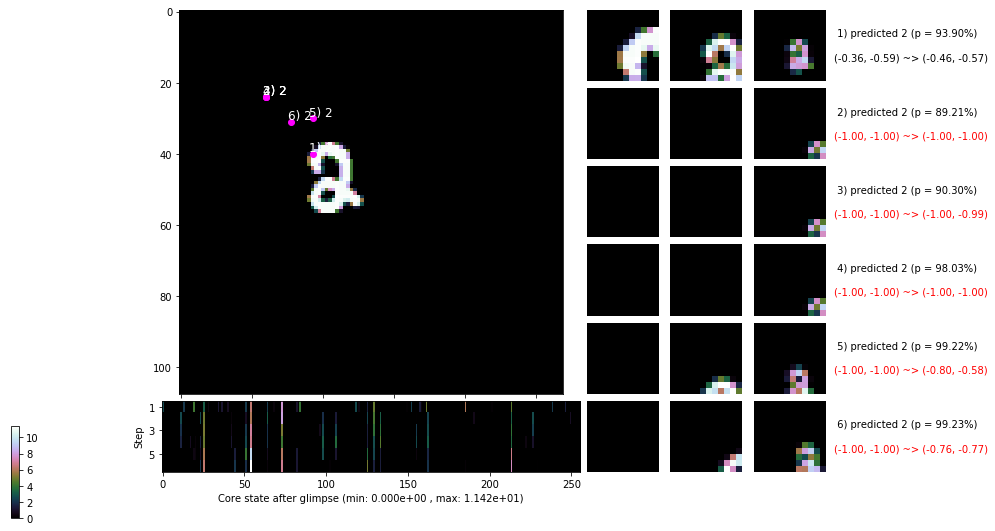

 b   1500/  4000 >> 102.1 ms/b | lr: 2.37e-04 | grad 2norm: 35.03 | grad inf norm:  9.274
       Weights || abs max:  3.20 ( 7236.28) | mean: -2.54e-02 ( 0.05) | var: 5.30e-02 (11116.37)
        Biases || abs max:  1.25 (  176.95) | mean: -1.82e-01 ( 0.26) | var: 6.46e-02 ( 4285.66)
                  class loss: 0.216 | steps: 2.188 | reward:  0.930 | acc.: 92.96%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 98.6 ms/b | lr: 2.37e-04 | grad 2norm: 39.99 | grad inf norm: 10.611
       Weights || abs max:  3.20 (28890.16) | mean: -2.53e-02 ( 0.14) | var: 5.30e-02 (919139.25)
        Biases || abs max:  1.26 (  443.84) | mean: -1.82e-01 ( 0.55) | var: 6.46e-02 (55858.13)
                  class loss: 0.216 | steps: 2.181 | reward:  0.931 | acc.: 93.06%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

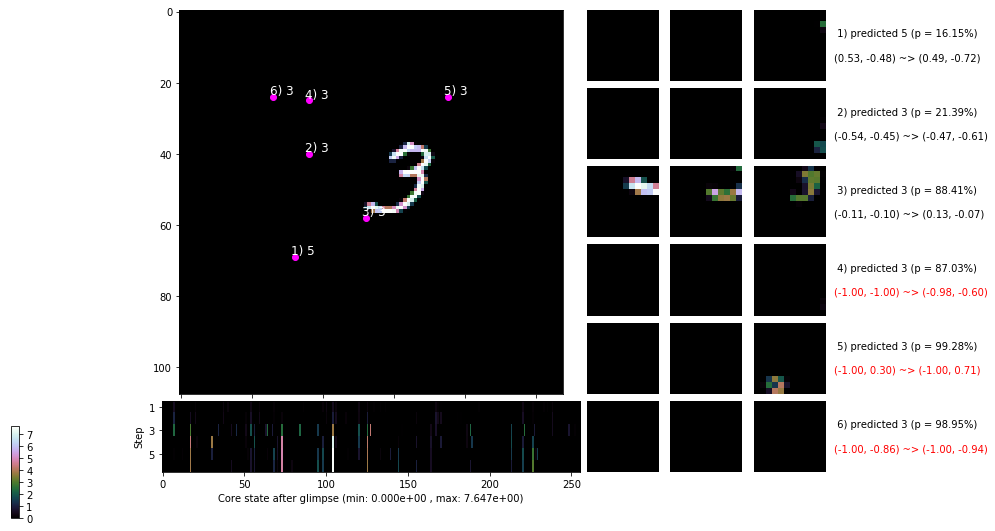

 b   2500/  4000 >> 100.5 ms/b | lr: 2.36e-04 | grad 2norm: 102.35 | grad inf norm: 24.804
       Weights || abs max:  3.21 ( 5732.47) | mean: -2.53e-02 ( 0.04) | var: 5.30e-02 ( 3035.55)
        Biases || abs max:  1.26 (  125.37) | mean: -1.82e-01 ( 0.23) | var: 6.49e-02 ( 2449.59)
                  class loss: 0.224 | steps: 2.217 | reward:  0.927 | acc.: 92.74%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 94.7 ms/b | lr: 2.35e-04 | grad 2norm: 103.59 | grad inf norm: 22.637
       Weights || abs max:  3.21 ( 6190.73) | mean: -2.53e-02 ( 0.04) | var: 5.31e-02 ( 3694.37)
        Biases || abs max:  1.26 (  153.48) | mean: -1.82e-01 ( 0.26) | var: 6.50e-02 (  480.66)
                  class loss: 0.227 | steps: 2.196 | reward:  0.927 | acc.: 92.73%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

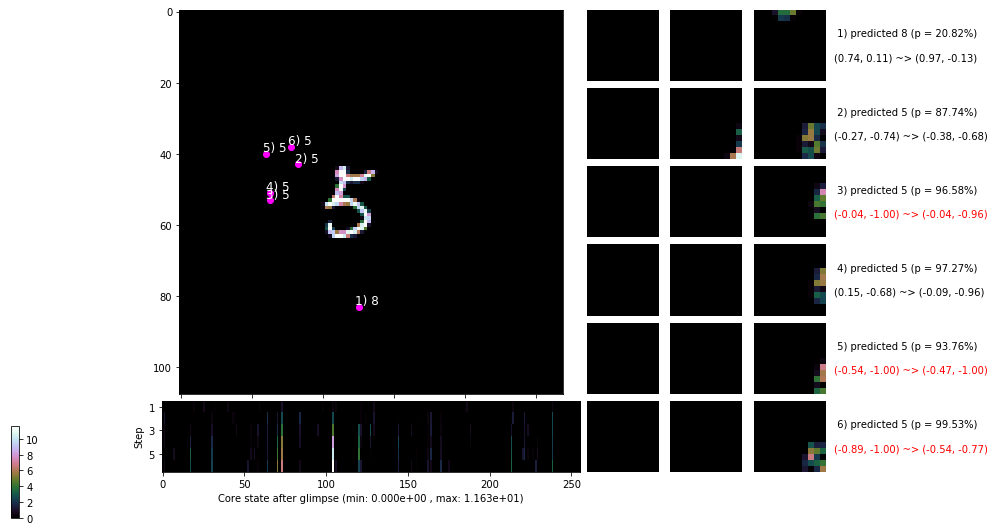

 b   3500/  4000 >> 98.4 ms/b | lr: 2.34e-04 | grad 2norm: 10.38 | grad inf norm:  3.681
       Weights || abs max:  3.22 (11664.27) | mean: -2.53e-02 ( 0.07) | var: 5.31e-02 (75815.91)
        Biases || abs max:  1.26 (   62.22) | mean: -1.83e-01 ( 0.15) | var: 6.50e-02 (   28.42)
                  class loss: 0.226 | steps: 2.200 | reward:  0.930 | acc.: 92.97%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 95.9 ms/b | lr: 2.33e-04 | grad 2norm: 19.41 | grad inf norm:  5.683
       Weights || abs max:  3.22 ( 9574.10) | mean: -2.53e-02 ( 0.06) | var: 5.31e-02 (48931.01)
        Biases || abs max:  1.26 (  234.17) | mean: -1.83e-01 ( 0.33) | var: 6.51e-02 ( 5264.69)
                  class loss: 0.234 | steps: 2.225 | reward:  0.924 | acc.: 92.44%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
	

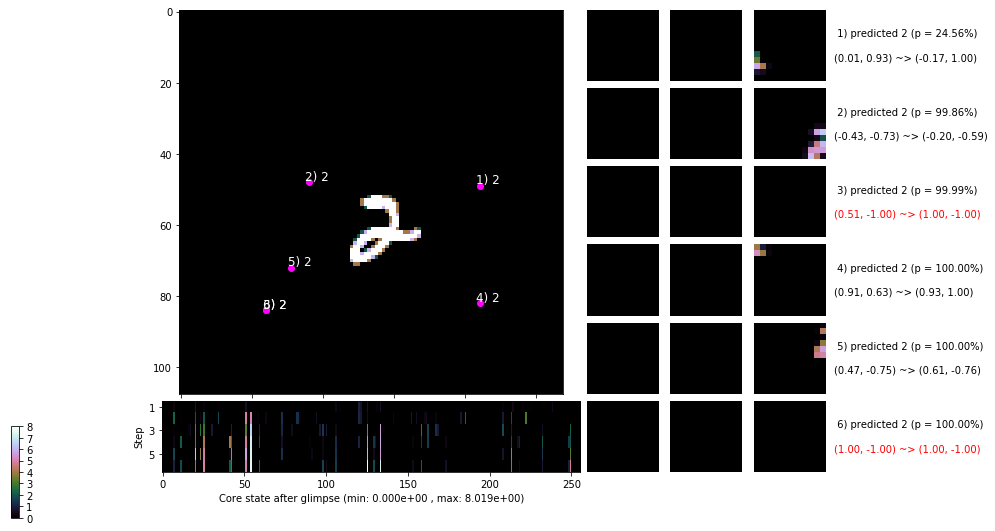

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


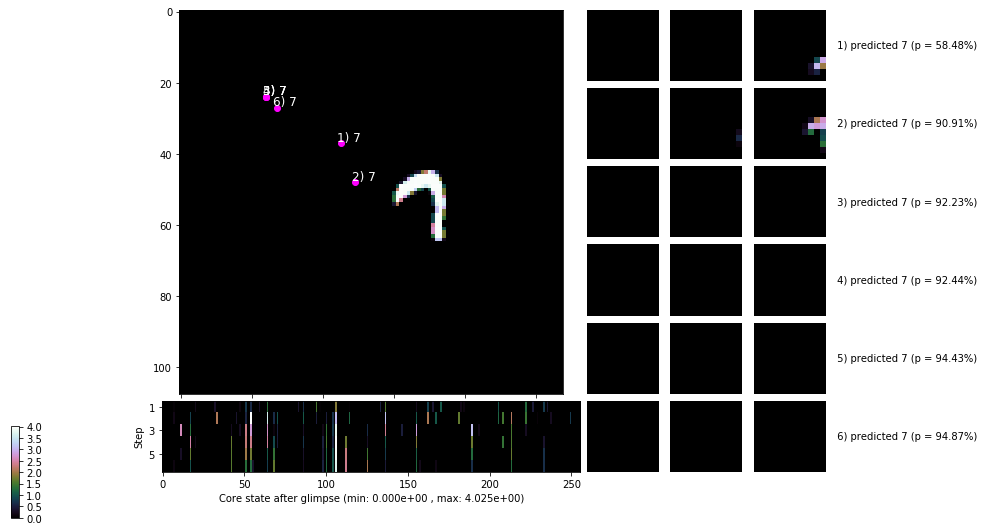


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


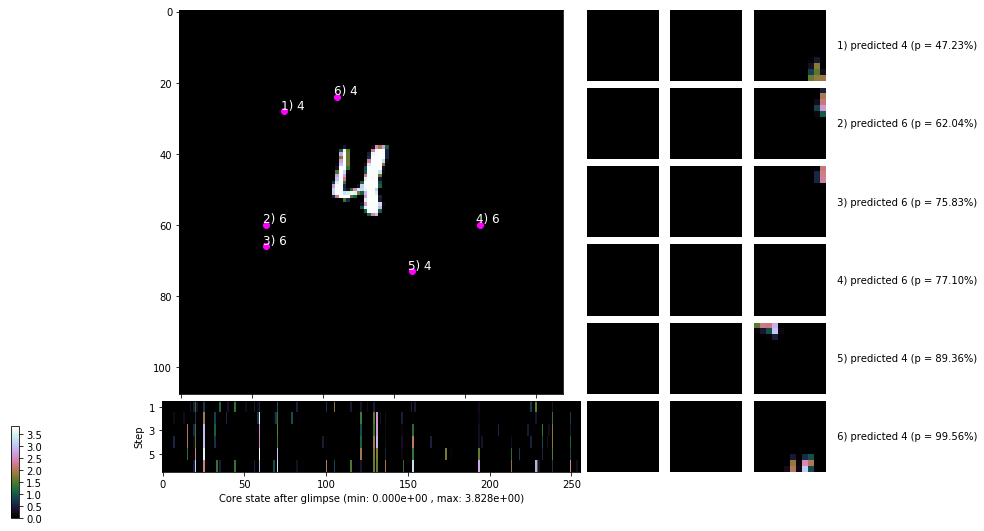

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


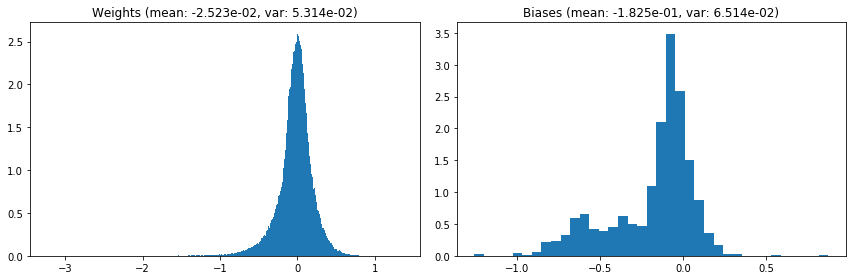

                                      Location network weights and biases


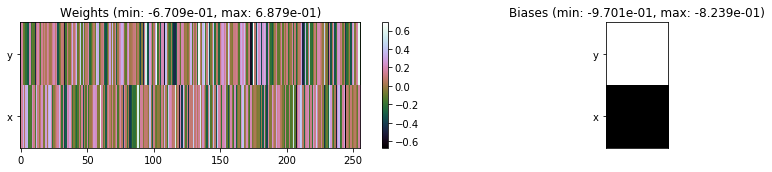

---------------------------------------------------------------------------------------------------------------
Elapsed time:  398.74 sec | TRAIN >> class loss: 0.2266 | steps:  2.212 :( | reward:  0.9273 :( | acc.: 92.729% :(
                          | VAL   >> class loss: 0.2254 | steps:  2.219 :( | reward:  0.9282 :( | acc.: 92.820% :(


Epoch  48/400) lr = 0.0002328
 b    500/  4000 >> 95.2 ms/b | lr: 2.32e-04 | grad 2norm: 133.38 | grad inf norm: 28.108
       Weights || abs max:  3.22 (16381.53) | mean: -2.52e-02 ( 0.09) | var: 5.32e-02 (46832.26)
        Biases || abs max:  1.26 (   95.99) | mean: -1.83e-01 ( 0.18) | var: 6.53e-02 (  510.71)
                  class loss: 0.231 | steps: 2.214 | reward:  0.927 | acc.: 92.73%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 95.3 ms/b | lr: 2.31e-04 | grad 2norm: 1829.52 | grad inf norm: 352.939
       Weights || abs max:  3.22 ( 5974.77) | mean: -2.51e-02 ( 0.05)

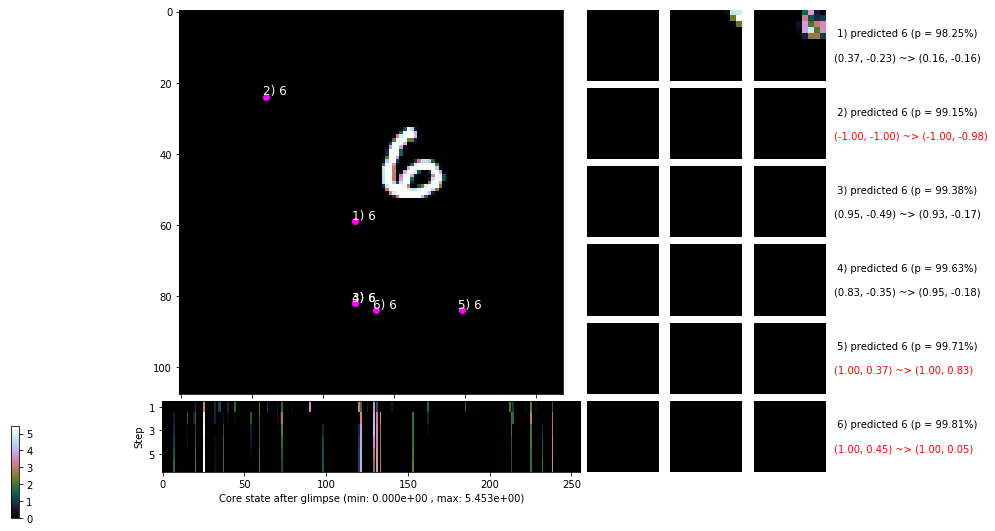

 b   1500/  4000 >> 97.2 ms/b | lr: 2.30e-04 | grad 2norm: 602.06 | grad inf norm: 123.586
       Weights || abs max:  3.22 (10524.42) | mean: -2.51e-02 ( 0.06) | var: 5.32e-02 (27028.86)
        Biases || abs max:  1.26 (   67.79) | mean: -1.83e-01 ( 0.16) | var: 6.55e-02 (   49.97)
                  class loss: 0.248 | steps: 2.227 | reward:  0.920 | acc.: 92.02%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 96.0 ms/b | lr: 2.29e-04 | grad 2norm: 61.64 | grad inf norm: 15.401
       Weights || abs max:  3.22 (10784.85) | mean: -2.51e-02 ( 0.06) | var: 5.32e-02 (47500.93)
        Biases || abs max:  1.27 (   70.17) | mean: -1.83e-01 ( 0.15) | var: 6.58e-02 (  319.04)
                  class loss: 0.235 | steps: 2.203 | reward:  0.925 | acc.: 92.48%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

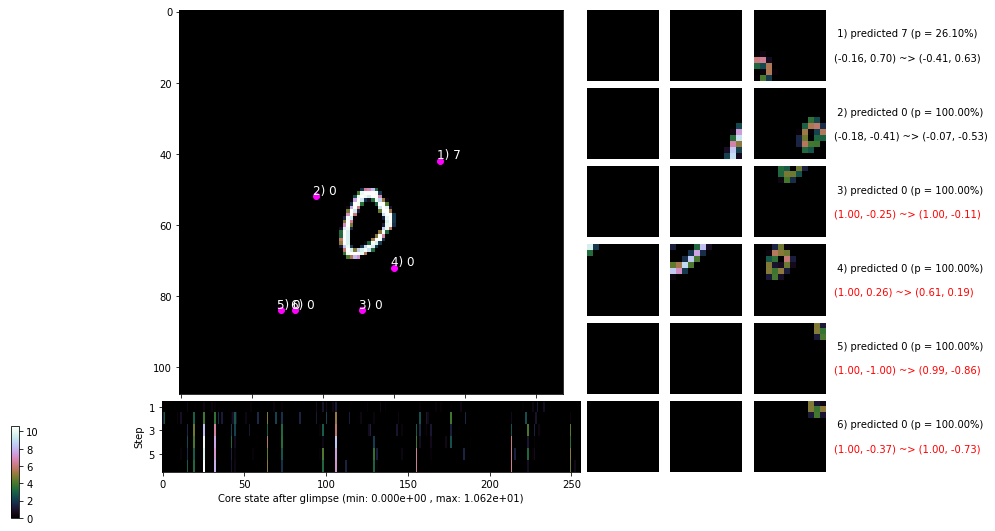

 b   2500/  4000 >> 98.7 ms/b | lr: 2.29e-04 | grad 2norm: 148.50 | grad inf norm: 27.751
       Weights || abs max:  3.22 ( 5248.82) | mean: -2.51e-02 ( 0.04) | var: 5.33e-02 ( 5917.35)
        Biases || abs max:  1.28 (  163.93) | mean: -1.83e-01 ( 0.23) | var: 6.61e-02 ( 9293.34)
                  class loss: 0.214 | steps: 2.189 | reward:  0.932 | acc.: 93.20%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 97.7 ms/b | lr: 2.28e-04 | grad 2norm: 20.92 | grad inf norm:  6.195
       Weights || abs max:  3.22 ( 5979.67) | mean: -2.52e-02 ( 0.04) | var: 5.33e-02 ( 5449.74)
        Biases || abs max:  1.28 (   66.93) | mean: -1.84e-01 ( 0.17) | var: 6.62e-02 (   50.99)
                  class loss: 0.231 | steps: 2.167 | reward:  0.929 | acc.: 92.88%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


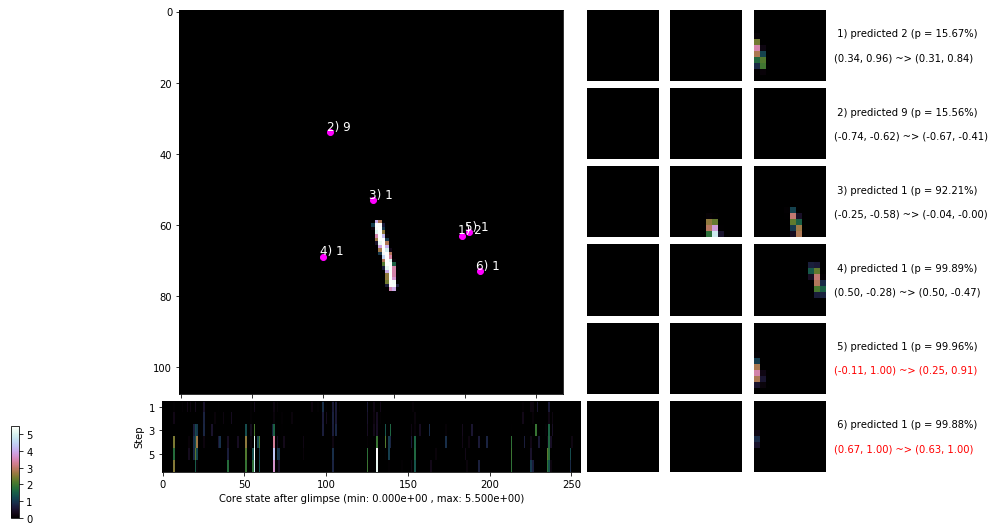

 b   3500/  4000 >> 96.8 ms/b | lr: 2.27e-04 | grad 2norm: 506.66 | grad inf norm: 101.566
       Weights || abs max:  3.22 ( 8634.89) | mean: -2.51e-02 ( 0.06) | var: 5.33e-02 ( 6404.04)
        Biases || abs max:  1.28 (   63.70) | mean: -1.83e-01 ( 0.16) | var: 6.61e-02 (   33.36)
                  class loss: 0.220 | steps: 2.143 | reward:  0.930 | acc.: 93.01%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 95.0 ms/b | lr: 2.26e-04 | grad 2norm: 19.26 | grad inf norm:  6.092
       Weights || abs max:  3.22 (62777.96) | mean: -2.50e-02 ( 0.27) | var: 5.34e-02 (5242994.00)
        Biases || abs max:  1.29 (  800.88) | mean: -1.84e-01 ( 1.21) | var: 6.62e-02 (133725.45)
                  class loss: 0.221 | steps: 2.156 | reward:  0.930 | acc.: 93.01%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

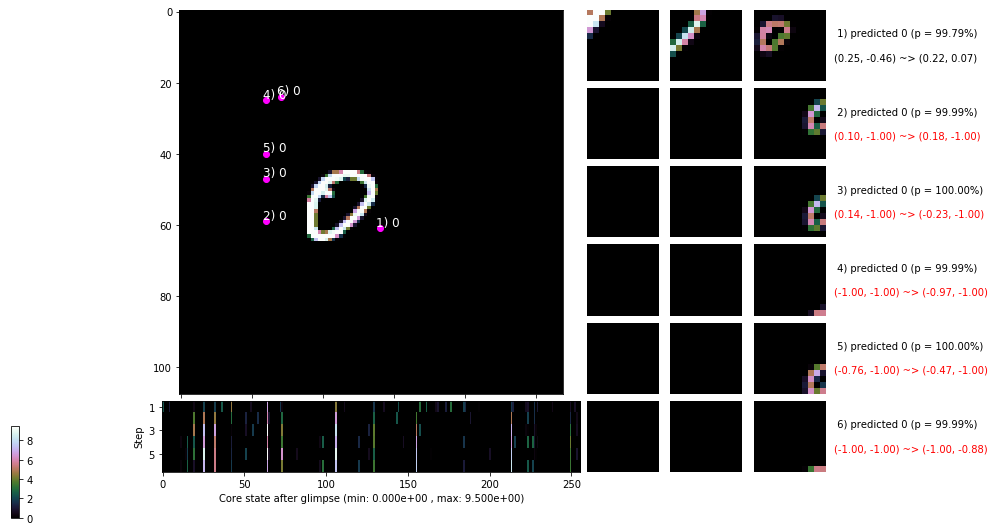

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


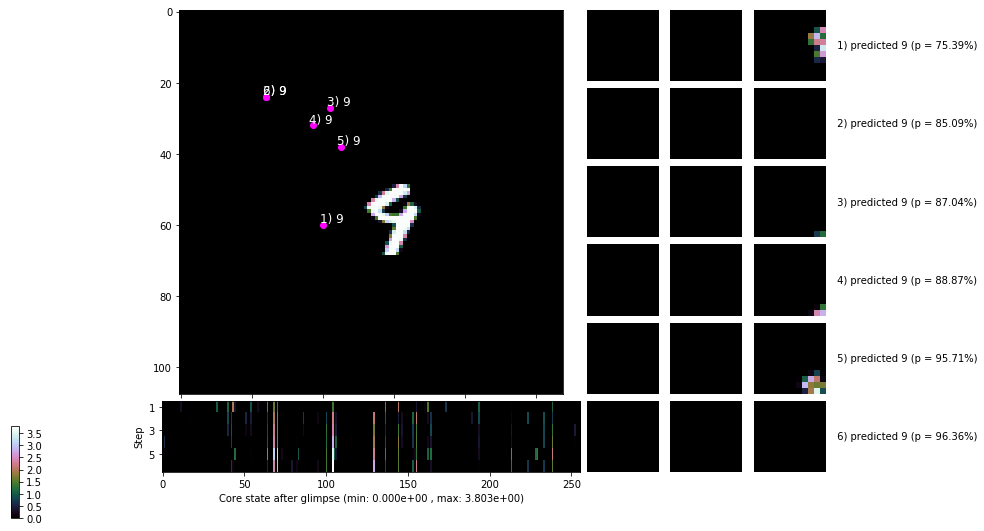


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


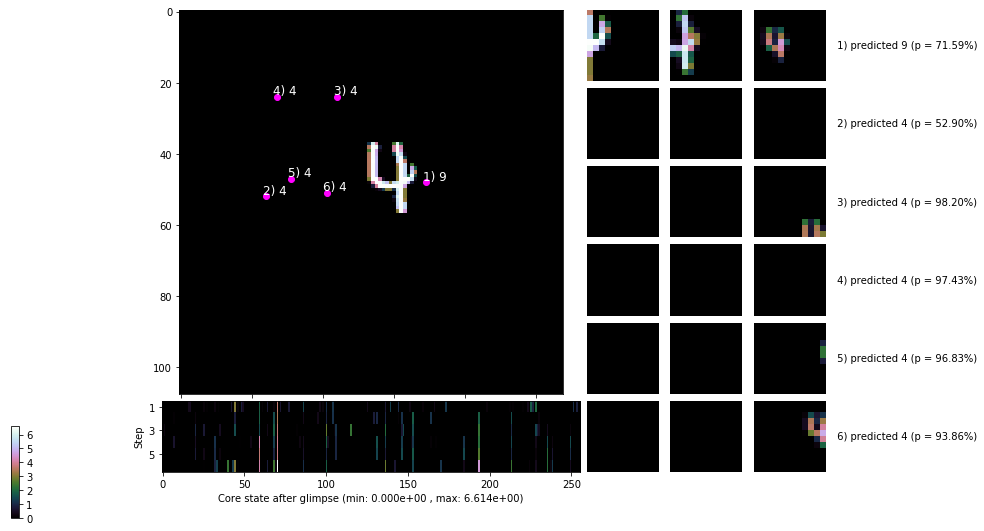

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


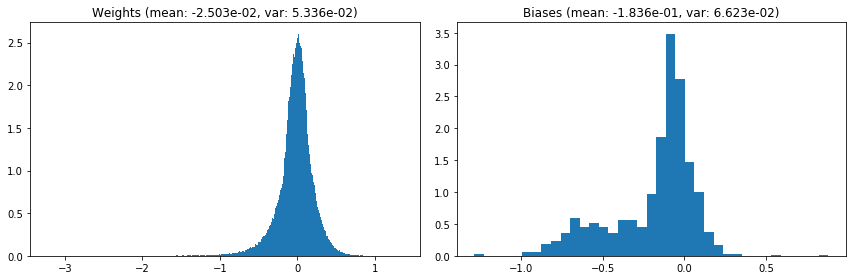

                                      Location network weights and biases


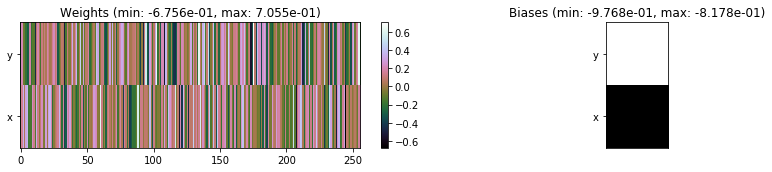

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.00 sec | TRAIN >> class loss: 0.2287 | steps:  2.185    | reward:  0.9275 :( | acc.: 92.750% :(
                          | VAL   >> class loss: 0.2251 | steps:  2.191 :( | reward:  0.9264 :( | acc.: 92.640% :(


Epoch  49/400) lr = 0.0002257
 b    500/  4000 >> 95.7 ms/b | lr: 2.25e-04 | grad 2norm: 45.73 | grad inf norm: 11.977
       Weights || abs max:  3.22 (12580.48) | mean: -2.50e-02 ( 0.07) | var: 5.34e-02 (49057.91)
        Biases || abs max:  1.28 (  219.81) | mean: -1.84e-01 ( 0.35) | var: 6.62e-02 (  819.33)
                  class loss: 0.229 | steps: 2.184 | reward:  0.929 | acc.: 92.85%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 97.6 ms/b | lr: 2.24e-04 | grad 2norm: 209.92 | grad inf norm: 45.468
       Weights || abs max:  3.22 ( 6701.88) | mean: -2.49e-02 ( 0.05) | 

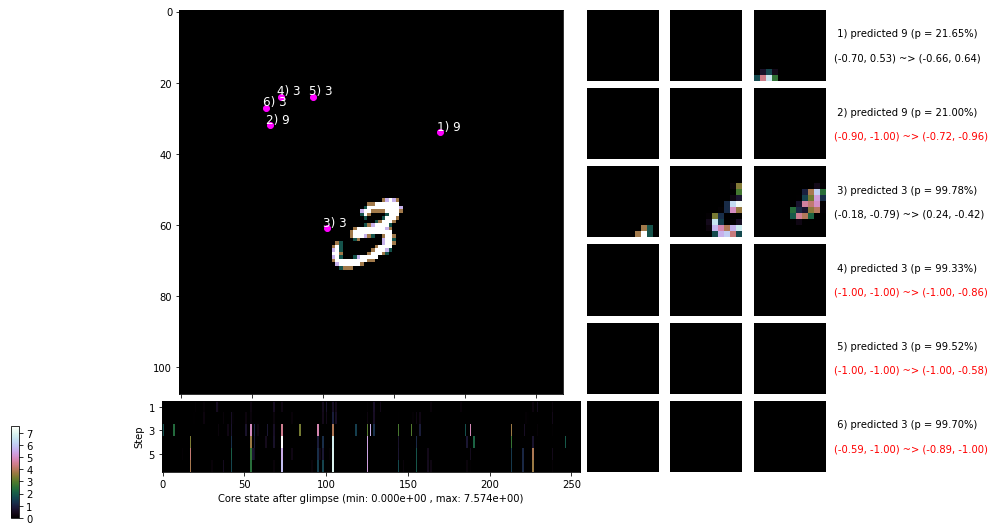

 b   1500/  4000 >> 98.6 ms/b | lr: 2.23e-04 | grad 2norm: 476.82 | grad inf norm: 96.307
       Weights || abs max:  3.22 ( 7073.05) | mean: -2.50e-02 ( 0.05) | var: 5.34e-02 ( 3656.05)
        Biases || abs max:  1.28 (  114.54) | mean: -1.84e-01 ( 0.21) | var: 6.63e-02 (  621.32)
                  class loss: 0.210 | steps: 2.199 | reward:  0.933 | acc.: 93.29%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 96.0 ms/b | lr: 2.22e-04 | grad 2norm: 166.38 | grad inf norm: 35.942
       Weights || abs max:  3.22 ( 4950.37) | mean: -2.50e-02 ( 0.04) | var: 5.35e-02 (  953.74)
        Biases || abs max:  1.29 (  119.59) | mean: -1.84e-01 ( 0.22) | var: 6.65e-02 (  266.80)
                  class loss: 0.223 | steps: 2.233 | reward:  0.932 | acc.: 93.19%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

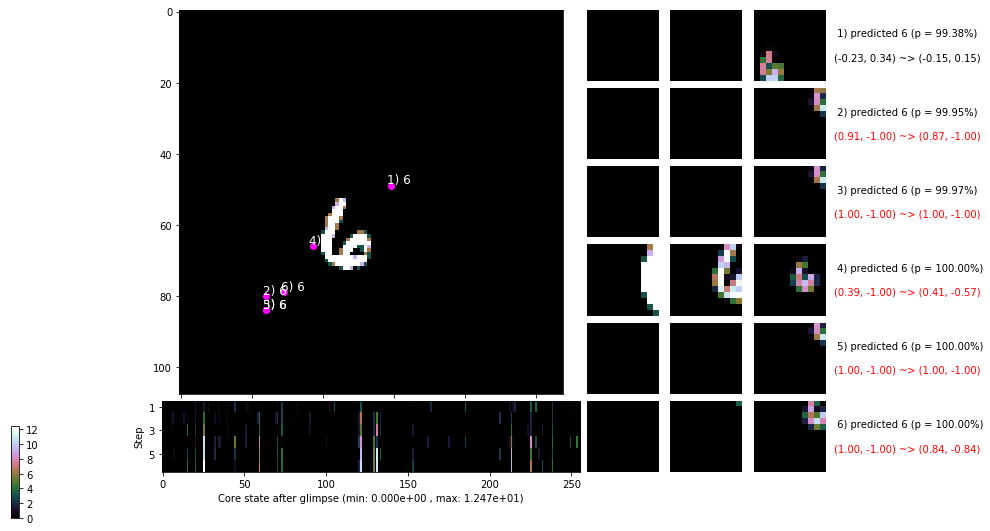

 b   2500/  4000 >> 96.5 ms/b | lr: 2.22e-04 | grad 2norm: 251.77 | grad inf norm: 52.946
       Weights || abs max:  3.22 ( 7201.00) | mean: -2.50e-02 ( 0.05) | var: 5.35e-02 ( 3653.82)
        Biases || abs max:  1.29 (   74.62) | mean: -1.84e-01 ( 0.16) | var: 6.68e-02 (   60.40)
                  class loss: 0.234 | steps: 2.204 | reward:  0.924 | acc.: 92.41%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 95.1 ms/b | lr: 2.21e-04 | grad 2norm: 26.52 | grad inf norm:  7.411
       Weights || abs max:  3.23 ( 5761.48) | mean: -2.49e-02 ( 0.04) | var: 5.35e-02 ( 2206.25)
        Biases || abs max:  1.28 ( 1272.26) | mean: -1.84e-01 ( 1.35) | var: 6.69e-02 (633763.94)
                  class loss: 0.239 | steps: 2.181 | reward:  0.925 | acc.: 92.48%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

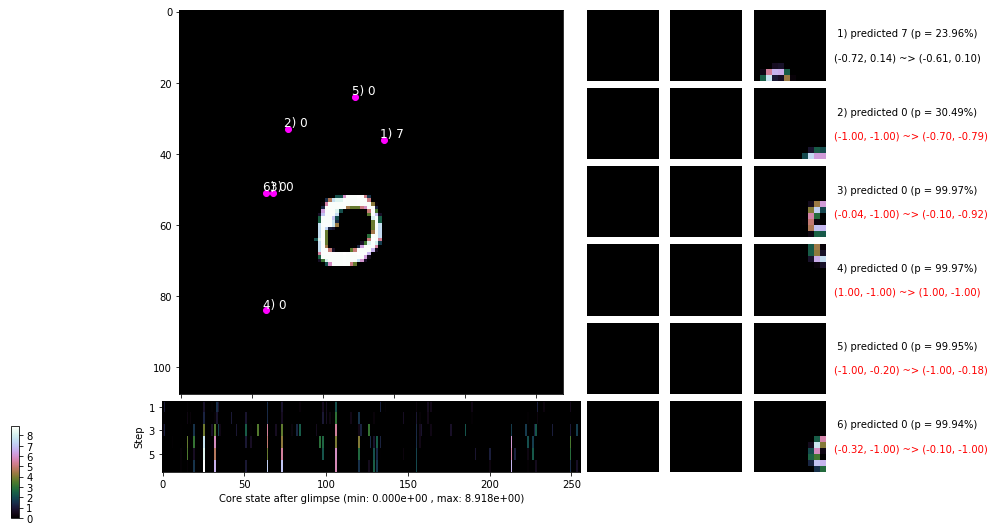

 b   3500/  4000 >> 97.1 ms/b | lr: 2.20e-04 | grad 2norm: 215.21 | grad inf norm: 46.957
       Weights || abs max:  3.23 (59031.34) | mean: -2.49e-02 ( 0.25) | var: 5.36e-02 (4095311.75)
        Biases || abs max:  1.29 (  116.04) | mean: -1.84e-01 ( 0.21) | var: 6.68e-02 (  793.52)
                  class loss: 0.229 | steps: 2.185 | reward:  0.926 | acc.: 92.55%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 96.8 ms/b | lr: 2.19e-04 | grad 2norm: 479.24 | grad inf norm: 92.565
       Weights || abs max:  3.23 ( 6707.60) | mean: -2.48e-02 ( 0.05) | var: 5.36e-02 ( 2112.91)
        Biases || abs max:  1.28 (  273.65) | mean: -1.84e-01 ( 0.36) | var: 6.70e-02 (12478.88)
                  class loss: 0.236 | steps: 2.174 | reward:  0.925 | acc.: 92.54%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

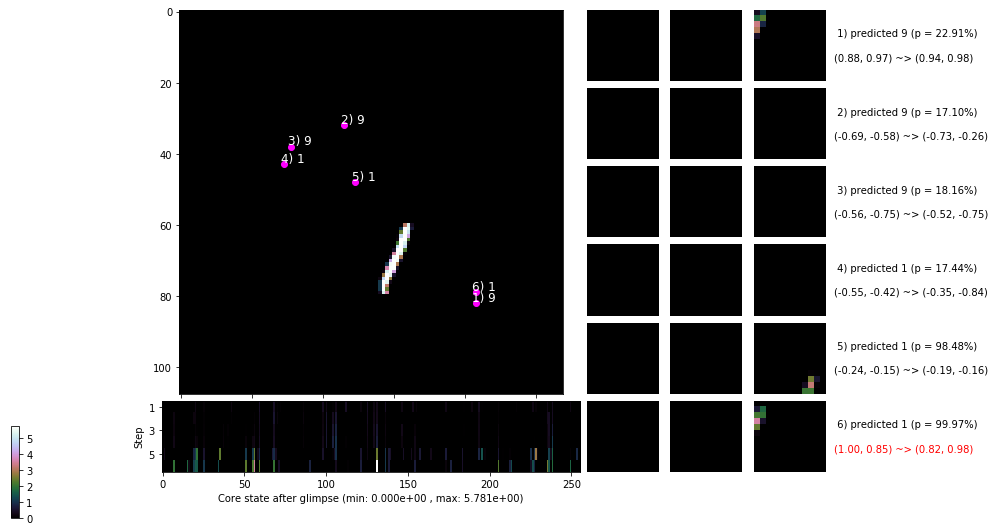

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


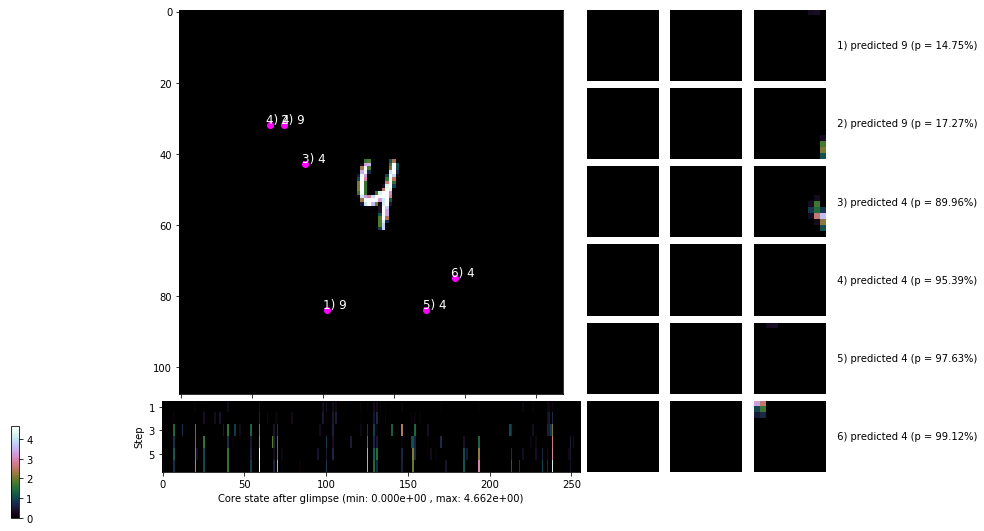


	Target class: 9  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


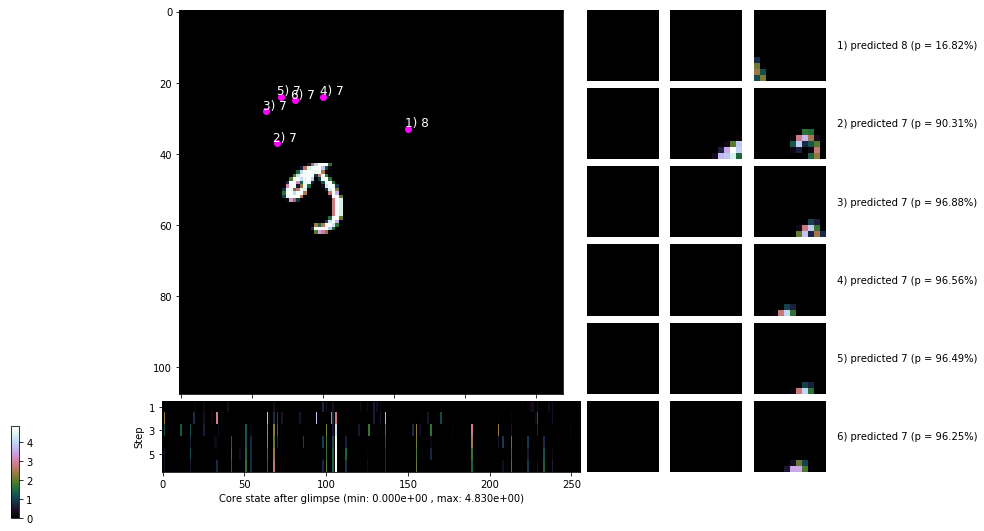

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


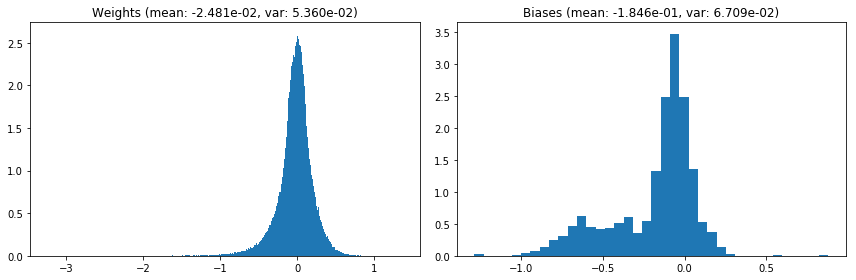

                                      Location network weights and biases


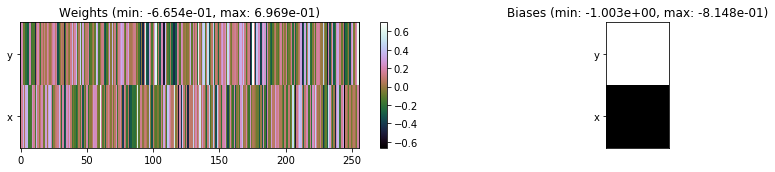

---------------------------------------------------------------------------------------------------------------
Elapsed time:  387.83 sec | TRAIN >> class loss: 0.2290 | steps:  2.193 :( | reward:  0.9276 :( | acc.: 92.763% :(
                          | VAL   >> class loss: 0.2536 | steps:  2.217 :( | reward:  0.9140 :( | acc.: 91.400% :(


Epoch  50/400) lr = 0.0002188
 b    500/  4000 >> 100.7 ms/b | lr: 2.18e-04 | grad 2norm: 21.73 | grad inf norm:  6.314
       Weights || abs max:  3.24 (10508.93) | mean: -2.48e-02 ( 0.06) | var: 5.36e-02 (16800.31)
        Biases || abs max:  1.29 (  129.77) | mean: -1.85e-01 ( 0.22) | var: 6.72e-02 (  371.28)
                  class loss: 0.219 | steps: 2.164 | reward:  0.929 | acc.: 92.92%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.1 ms/b | lr: 2.17e-04 | grad 2norm: 1025.65 | grad inf norm: 208.634
       Weights || abs max:  3.24 ( 6482.61) | mean: -2.48e-02 ( 0.05

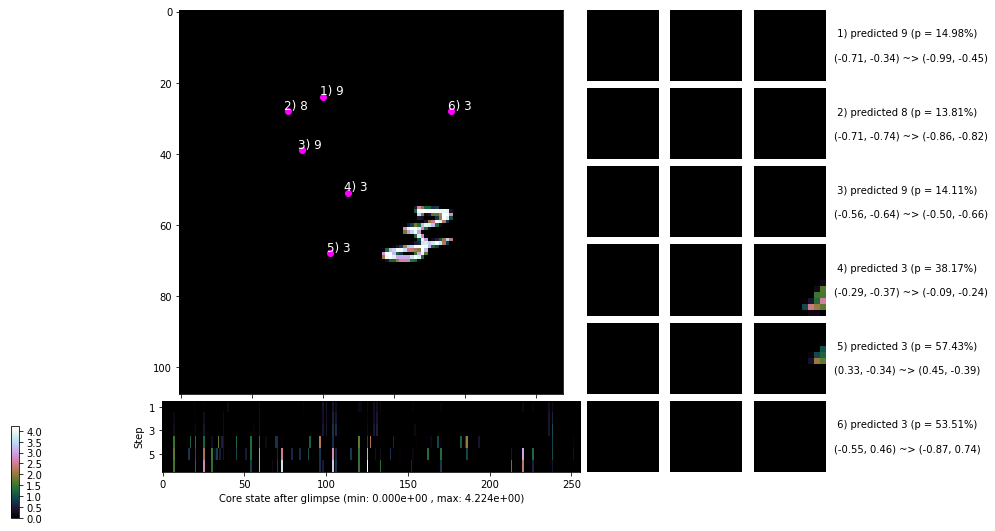

 b   1500/  4000 >> 105.9 ms/b | lr: 2.16e-04 | grad 2norm: 792.36 | grad inf norm: 154.902
       Weights || abs max:  3.24 (12054.10) | mean: -2.48e-02 ( 0.07) | var: 5.37e-02 (87659.60)
        Biases || abs max:  1.30 (   77.80) | mean: -1.85e-01 ( 0.17) | var: 6.75e-02 (  151.06)
                  class loss: 0.219 | steps: 2.148 | reward:  0.933 | acc.: 93.29%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.2 ms/b | lr: 2.16e-04 | grad 2norm: 233.56 | grad inf norm: 48.895
       Weights || abs max:  3.24 (10353.20) | mean: -2.48e-02 ( 0.06) | var: 5.37e-02 (20124.52)
        Biases || abs max:  1.31 (   59.94) | mean: -1.85e-01 ( 0.14) | var: 6.77e-02 (   46.74)
                  class loss: 0.223 | steps: 2.180 | reward:  0.929 | acc.: 92.90%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

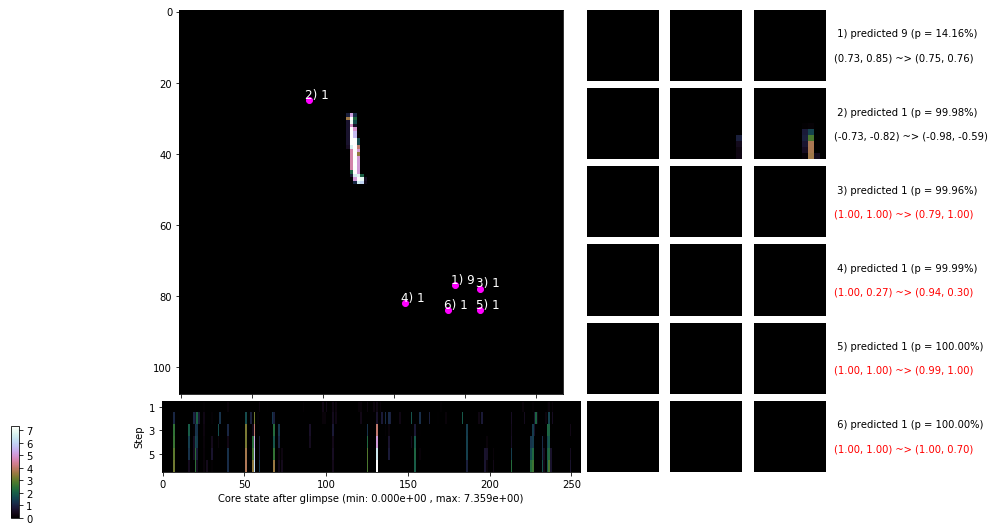

 b   2500/  4000 >> 107.7 ms/b | lr: 2.15e-04 | grad 2norm: 16.62 | grad inf norm:  5.210
       Weights || abs max:  3.24 (10607.96) | mean: -2.47e-02 ( 0.06) | var: 5.37e-02 (89381.24)
        Biases || abs max:  1.30 (  941.14) | mean: -1.85e-01 ( 1.01) | var: 6.77e-02 (349565.09)
                  class loss: 0.214 | steps: 2.181 | reward:  0.932 | acc.: 93.25%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 108.0 ms/b | lr: 2.14e-04 | grad 2norm: 71.80 | grad inf norm: 16.710
       Weights || abs max:  3.24 (15527.98) | mean: -2.47e-02 ( 0.09) | var: 5.37e-02 (49461.90)
        Biases || abs max:  1.31 (  160.66) | mean: -1.85e-01 ( 0.28) | var: 6.78e-02 (  409.86)
                  class loss: 0.252 | steps: 2.172 | reward:  0.929 | acc.: 92.93%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

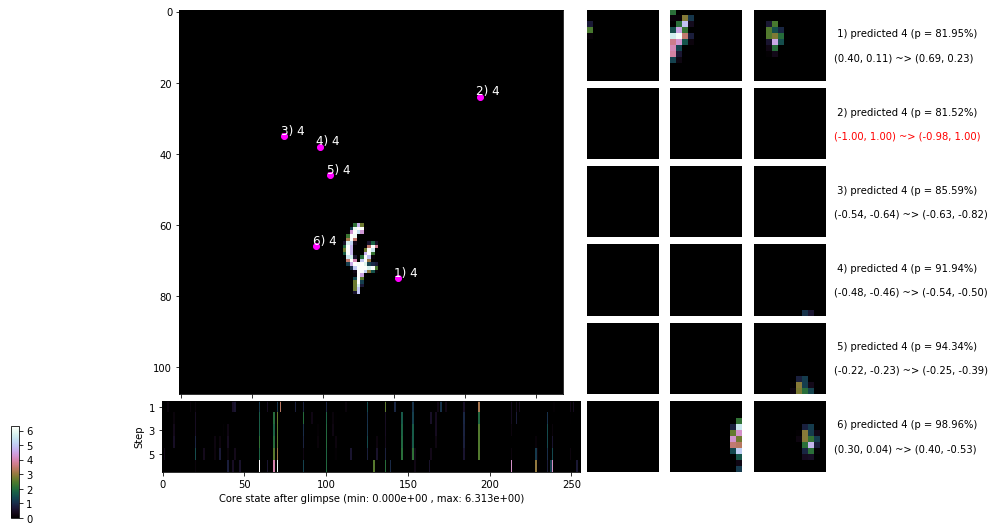

 b   3500/  4000 >> 112.5 ms/b | lr: 2.13e-04 | grad 2norm: 15.45 | grad inf norm:  4.965
       Weights || abs max:  3.24 (10862.81) | mean: -2.48e-02 ( 0.07) | var: 5.38e-02 (36130.64)
        Biases || abs max:  1.31 (  398.27) | mean: -1.85e-01 ( 0.53) | var: 6.80e-02 (10115.45)
                  class loss: 0.222 | steps: 2.189 | reward:  0.931 | acc.: 93.08%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 105.6 ms/b | lr: 2.12e-04 | grad 2norm: 37.44 | grad inf norm:  9.616
       Weights || abs max:  3.25 ( 5241.19) | mean: -2.48e-02 ( 0.04) | var: 5.38e-02 ( 1195.82)
        Biases || abs max:  1.31 (  123.06) | mean: -1.85e-01 ( 0.24) | var: 6.79e-02 (  619.99)
                  class loss: 0.209 | steps: 2.153 | reward:  0.931 | acc.: 93.11%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

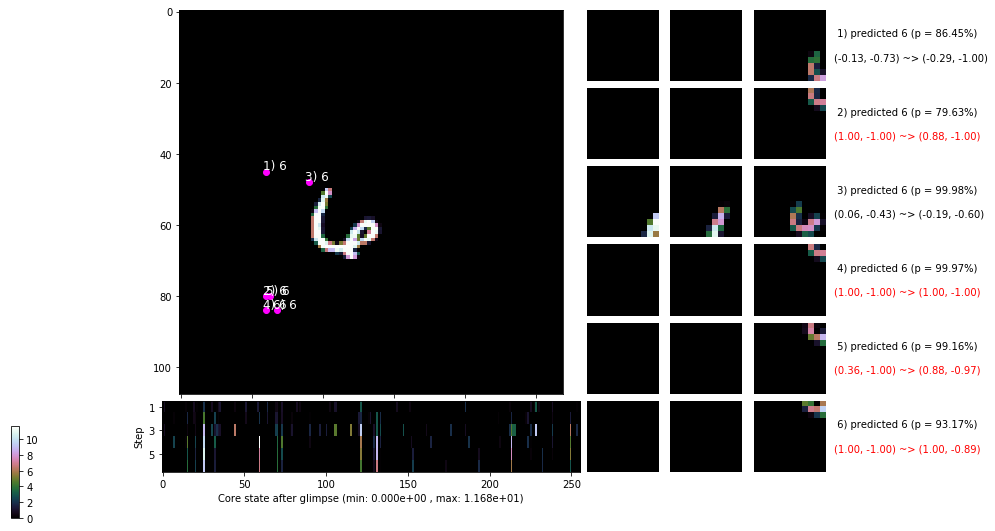

                                          ---===  VALIDATION  ===---

	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


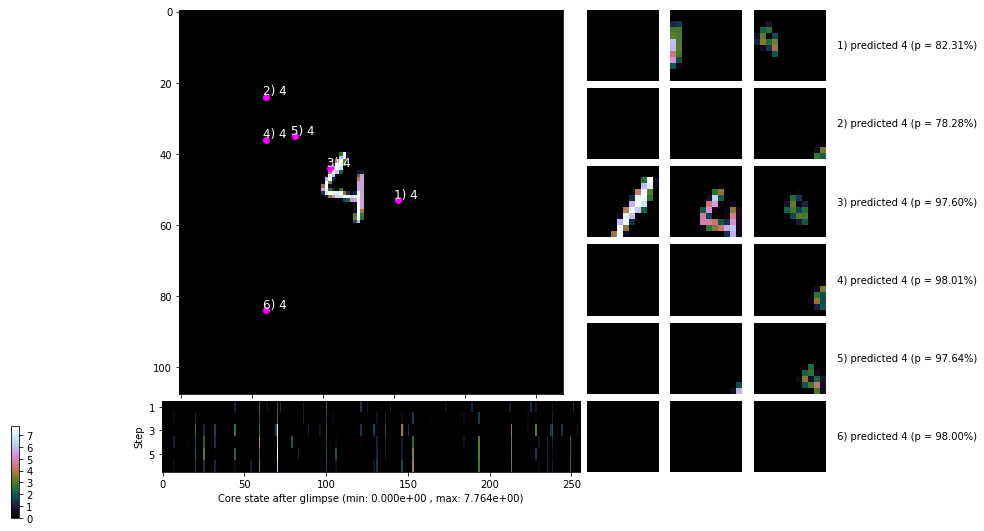


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


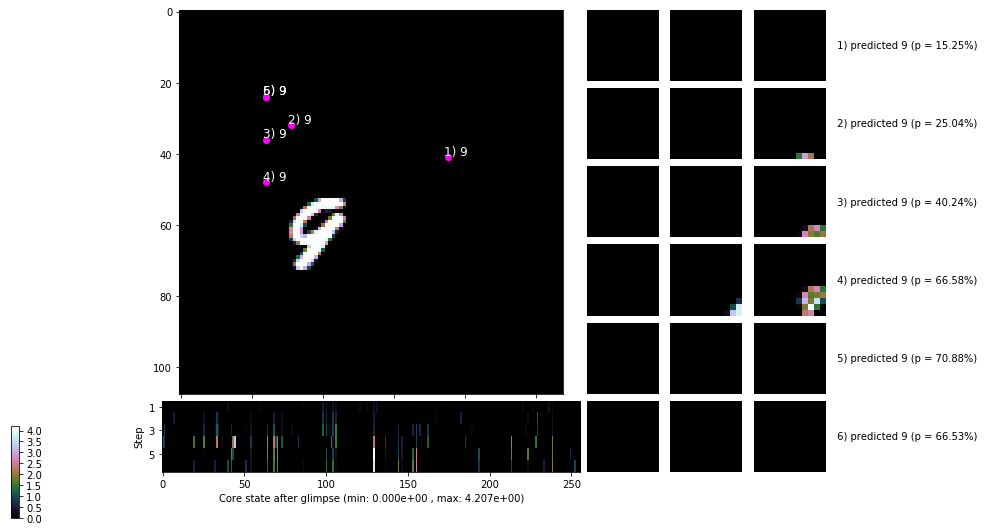

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


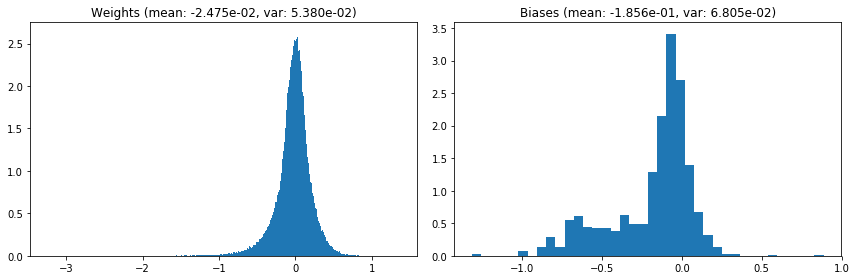

                                      Location network weights and biases


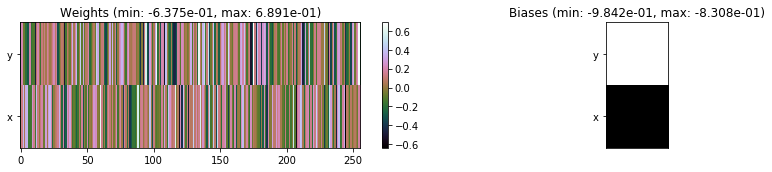

---------------------------------------------------------------------------------------------------------------
Elapsed time:  423.51 sec | TRAIN >> class loss: 0.2234 | steps:  2.169    | reward:  0.9305    | acc.: 93.050% 
                          | VAL   >> class loss: 0.2125 | steps:  2.169 :( | reward:  0.9336 :( | acc.: 93.360% :(


Epoch  51/400) lr = 0.0002121
 b    500/  4000 >> 105.7 ms/b | lr: 2.11e-04 | grad 2norm: 10.00 | grad inf norm:  3.683
       Weights || abs max:  3.24 ( 7581.83) | mean: -2.47e-02 ( 0.05) | var: 5.38e-02 ( 3965.03)
        Biases || abs max:  1.31 (  139.42) | mean: -1.86e-01 ( 0.26) | var: 6.81e-02 (  607.06)
                  class loss: 0.209 | steps: 2.141 | reward:  0.936 | acc.: 93.55%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.8 ms/b | lr: 2.11e-04 | grad 2norm: 281.91 | grad inf norm: 61.553
       Weights || abs max:  3.24 (11856.62) | mean: -2.47e-02 ( 0.07) | 

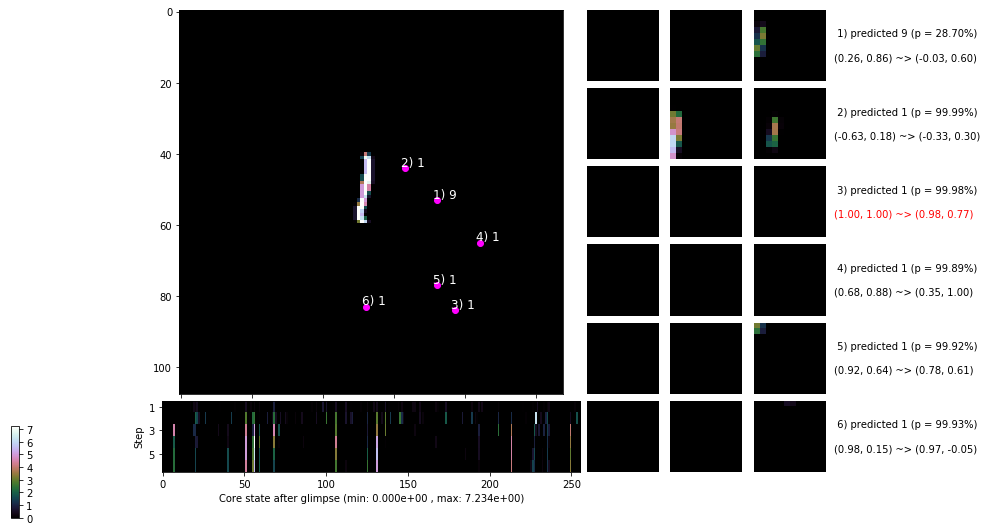

 b   1500/  4000 >> 106.7 ms/b | lr: 2.10e-04 | grad 2norm: 54.05 | grad inf norm: 12.566
       Weights || abs max:  3.24 ( 6069.76) | mean: -2.47e-02 ( 0.05) | var: 5.39e-02 ( 2061.28)
        Biases || abs max:  1.31 (  208.28) | mean: -1.86e-01 ( 0.36) | var: 6.82e-02 (  980.54)
                  class loss: 0.210 | steps: 2.128 | reward:  0.934 | acc.: 93.40%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.0 ms/b | lr: 2.09e-04 | grad 2norm: 34.13 | grad inf norm:  9.106
       Weights || abs max:  3.25 ( 7420.47) | mean: -2.47e-02 ( 0.05) | var: 5.39e-02 ( 4335.81)
        Biases || abs max:  1.31 (  140.55) | mean: -1.86e-01 ( 0.26) | var: 6.82e-02 ( 3393.79)
                  class loss: 0.213 | steps: 2.161 | reward:  0.932 | acc.: 93.19%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

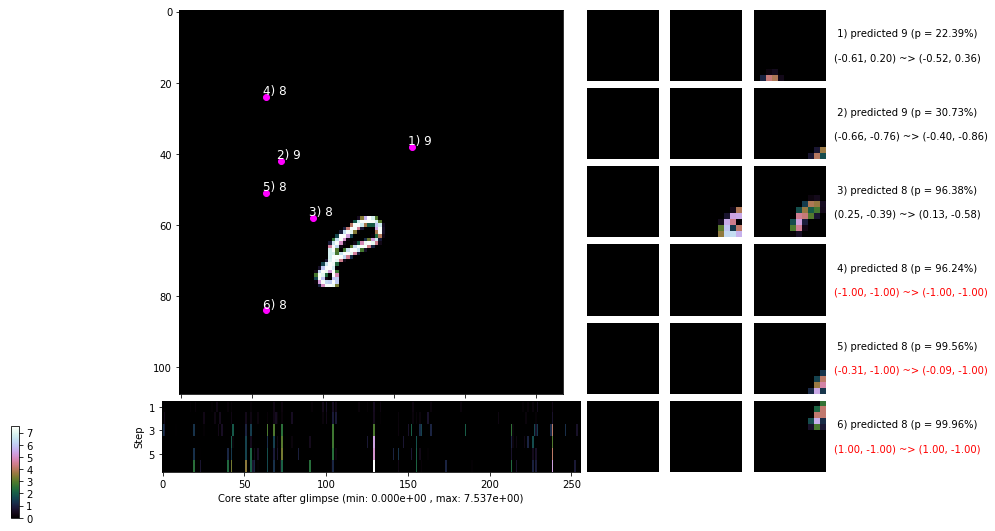

 b   2500/  4000 >> 104.2 ms/b | lr: 2.08e-04 | grad 2norm: 28.02 | grad inf norm:  7.706
       Weights || abs max:  3.25 ( 7114.15) | mean: -2.46e-02 ( 0.05) | var: 5.39e-02 ( 5929.62)
        Biases || abs max:  1.31 (   78.17) | mean: -1.86e-01 ( 0.18) | var: 6.82e-02 (  186.18)
                  class loss: 0.225 | steps: 2.168 | reward:  0.927 | acc.: 92.74%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 104.4 ms/b | lr: 2.07e-04 | grad 2norm: 693.70 | grad inf norm: 141.031
       Weights || abs max:  3.25 ( 9740.81) | mean: -2.46e-02 ( 0.06) | var: 5.40e-02 ( 9979.01)
        Biases || abs max:  1.31 (  226.41) | mean: -1.86e-01 ( 0.32) | var: 6.83e-02 ( 3921.47)
                  class loss: 0.220 | steps: 2.130 | reward:  0.930 | acc.: 92.95%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

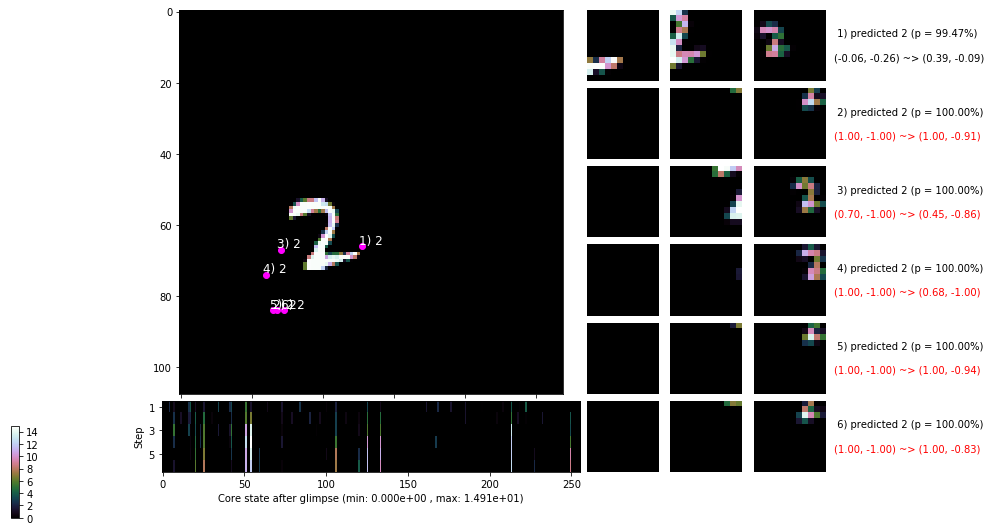

 b   3500/  4000 >> 105.9 ms/b | lr: 2.07e-04 | grad 2norm:  9.17 | grad inf norm:  3.455
       Weights || abs max:  3.26 (146350.94) | mean: -2.45e-02 ( 0.59) | var: 5.40e-02 (32605868.00)
        Biases || abs max:  1.32 (   85.60) | mean: -1.86e-01 ( 0.17) | var: 6.83e-02 (  402.80)
                  class loss: 0.211 | steps: 2.135 | reward:  0.935 | acc.: 93.47%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.5 ms/b | lr: 2.06e-04 | grad 2norm: 486.36 | grad inf norm: 100.203
       Weights || abs max:  3.27 ( 8057.16) | mean: -2.45e-02 ( 0.06) | var: 5.40e-02 ( 5362.22)
        Biases || abs max:  1.31 (   84.45) | mean: -1.86e-01 ( 0.17) | var: 6.84e-02 (   83.59)
                  class loss: 0.220 | steps: 2.155 | reward:  0.931 | acc.: 93.07%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

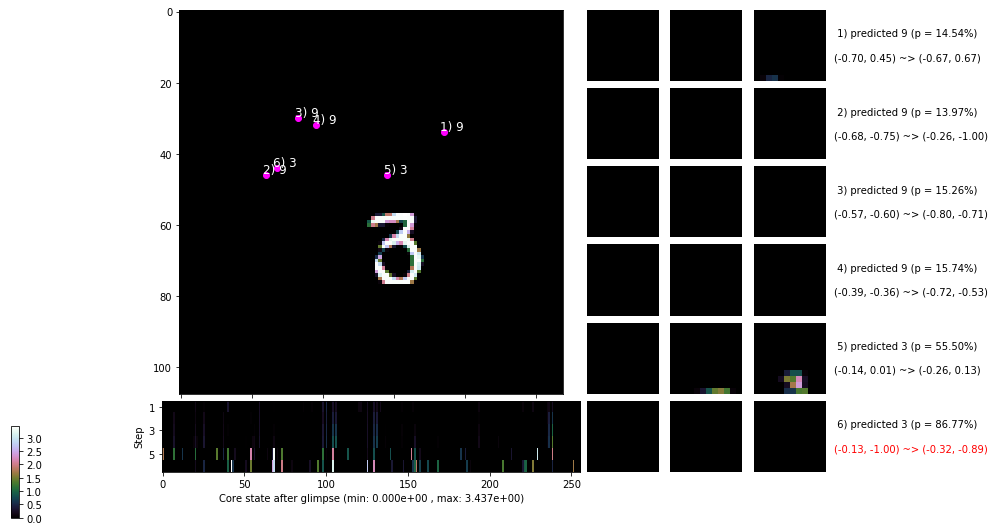

                                          ---===  VALIDATION  ===---

	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


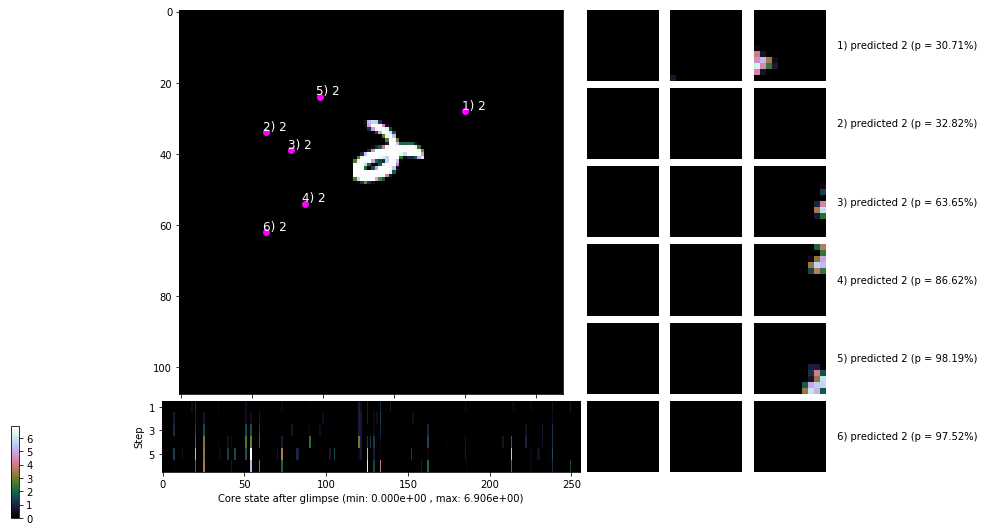


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


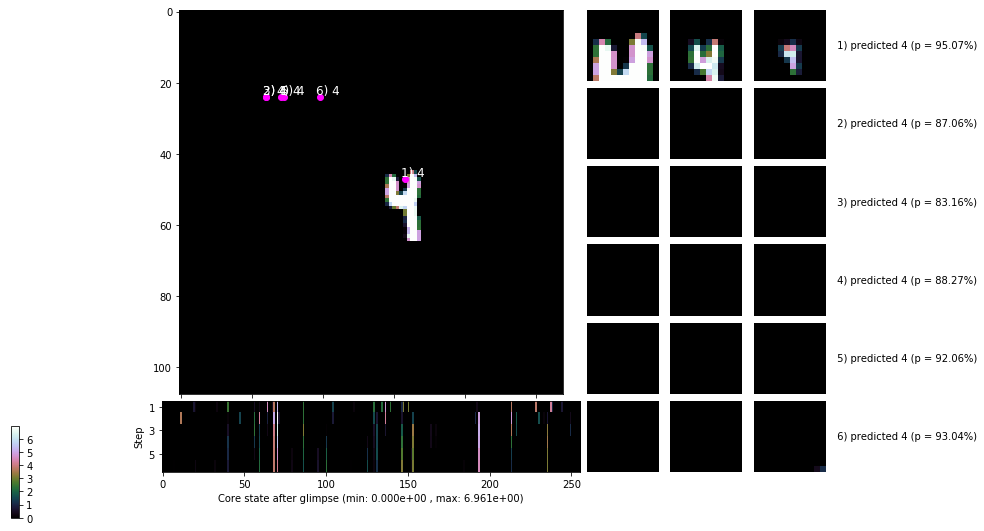

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


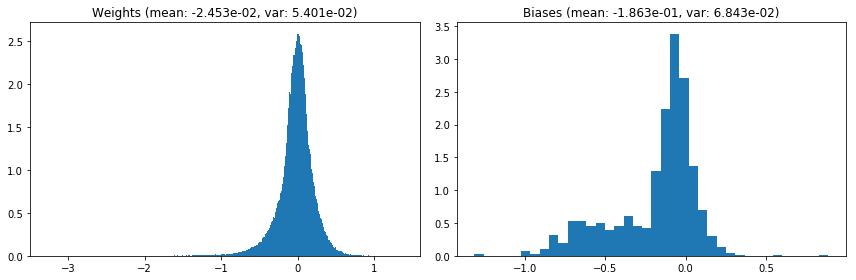

                                      Location network weights and biases


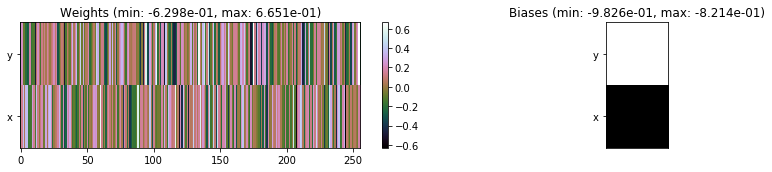

---------------------------------------------------------------------------------------------------------------
Elapsed time:  418.27 sec | TRAIN >> class loss: 0.2147 | steps:  2.148    | reward:  0.9319    | acc.: 93.194% 
                          | VAL   >> class loss: 0.2172 | steps:  2.145 :( | reward:  0.9328 :( | acc.: 93.280% :(


Epoch  52/400) lr = 0.0002056
 b    500/  4000 >> 102.6 ms/b | lr: 2.05e-04 | grad 2norm: 49.96 | grad inf norm: 12.572
       Weights || abs max:  3.26 ( 4281.58) | mean: -2.45e-02 ( 0.04) | var: 5.40e-02 (  532.89)
        Biases || abs max:  1.31 (  162.36) | mean: -1.86e-01 ( 0.25) | var: 6.84e-02 ( 1172.76)
                  class loss: 0.215 | steps: 2.160 | reward:  0.931 | acc.: 93.11%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.1 ms/b | lr: 2.04e-04 | grad 2norm: 38.82 | grad inf norm:  9.944
       Weights || abs max:  3.26 (10463.29) | mean: -2.45e-02 ( 0.07) | v

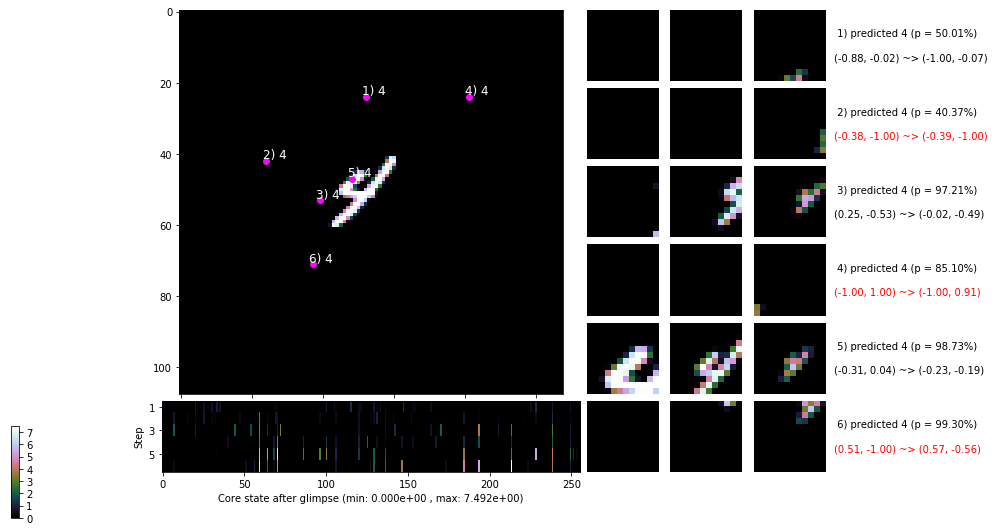

 b   1500/  4000 >> 103.9 ms/b | lr: 2.03e-04 | grad 2norm: 240.60 | grad inf norm: 51.952
       Weights || abs max:  3.26 ( 5652.41) | mean: -2.44e-02 ( 0.04) | var: 5.41e-02 ( 1092.10)
        Biases || abs max:  1.30 (  106.44) | mean: -1.86e-01 ( 0.20) | var: 6.86e-02 (  152.95)
                  class loss: 0.225 | steps: 2.151 | reward:  0.929 | acc.: 92.88%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.9 ms/b | lr: 2.03e-04 | grad 2norm: 28.67 | grad inf norm:  7.664
       Weights || abs max:  3.27 ( 7935.27) | mean: -2.44e-02 ( 0.05) | var: 5.41e-02 ( 3534.45)
        Biases || abs max:  1.30 (  151.31) | mean: -1.86e-01 ( 0.25) | var: 6.86e-02 ( 1209.02)
                  class loss: 0.213 | steps: 2.155 | reward:  0.933 | acc.: 93.25%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

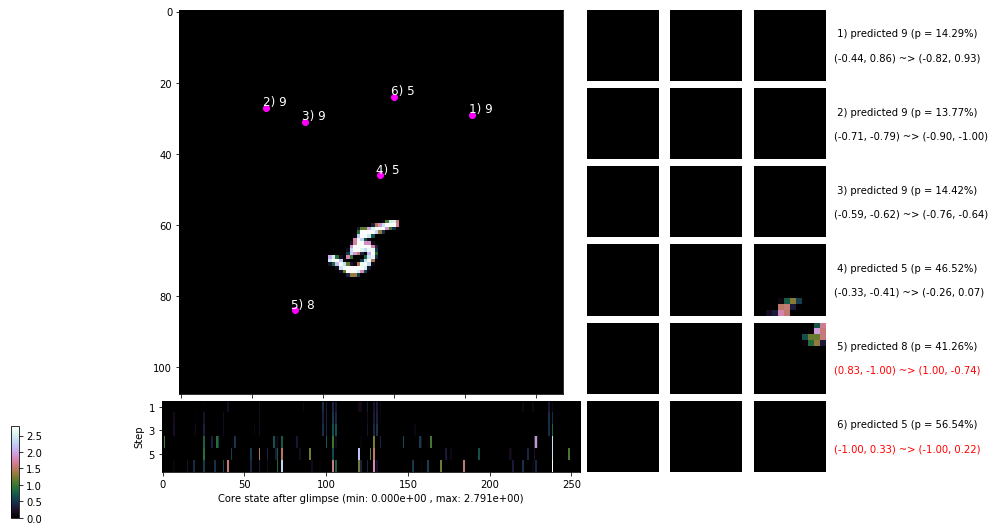

 b   2500/  4000 >> 103.6 ms/b | lr: 2.02e-04 | grad 2norm: 328.38 | grad inf norm: 68.390
       Weights || abs max:  3.27 ( 6855.46) | mean: -2.44e-02 ( 0.05) | var: 5.41e-02 ( 3755.73)
        Biases || abs max:  1.31 (   67.92) | mean: -1.87e-01 ( 0.15) | var: 6.88e-02 (   60.46)
                  class loss: 0.214 | steps: 2.161 | reward:  0.931 | acc.: 93.11%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 106.4 ms/b | lr: 2.01e-04 | grad 2norm: 993.04 | grad inf norm: 191.742
       Weights || abs max:  3.27 ( 5011.27) | mean: -2.44e-02 ( 0.04) | var: 5.41e-02 ( 1533.05)
        Biases || abs max:  1.31 (  176.42) | mean: -1.87e-01 ( 0.25) | var: 6.88e-02 ( 8025.30)
                  class loss: 0.212 | steps: 2.183 | reward:  0.932 | acc.: 93.19%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

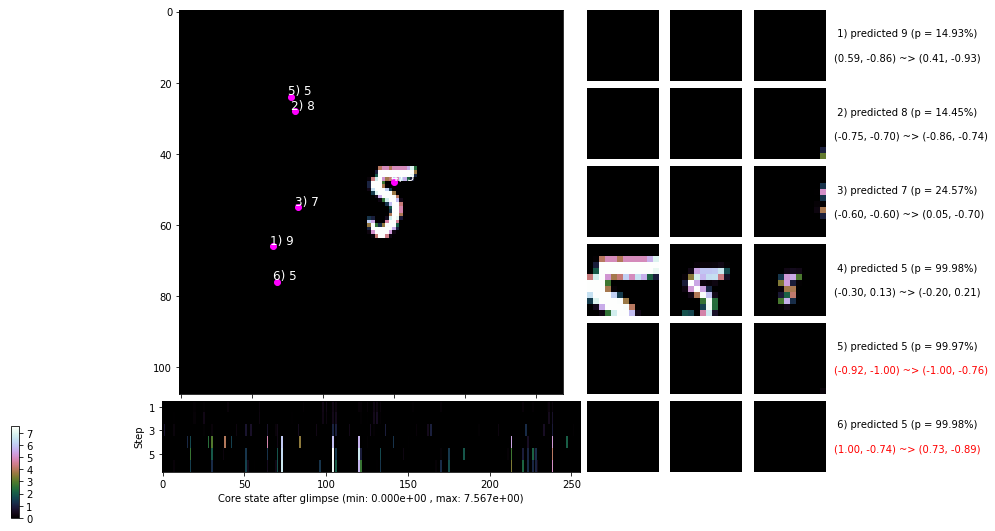

 b   3500/  4000 >> 104.7 ms/b | lr: 2.00e-04 | grad 2norm: 1297.78 | grad inf norm: 236.947
       Weights || abs max:  3.27 (25115.24) | mean: -2.44e-02 ( 0.13) | var: 5.42e-02 (562299.00)
        Biases || abs max:  1.31 (  638.33) | mean: -1.87e-01 ( 0.73) | var: 6.89e-02 (56261.65)
                  class loss: 0.217 | steps: 2.198 | reward:  0.933 | acc.: 93.33%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.5 ms/b | lr: 2.00e-04 | grad 2norm: 223.21 | grad inf norm: 48.022
       Weights || abs max:  3.27 ( 8639.26) | mean: -2.44e-02 ( 0.06) | var: 5.42e-02 ( 4191.73)
        Biases || abs max:  1.32 (  210.26) | mean: -1.87e-01 ( 0.30) | var: 6.91e-02 (  970.87)
                  class loss: 0.229 | steps: 2.185 | reward:  0.925 | acc.: 92.51%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

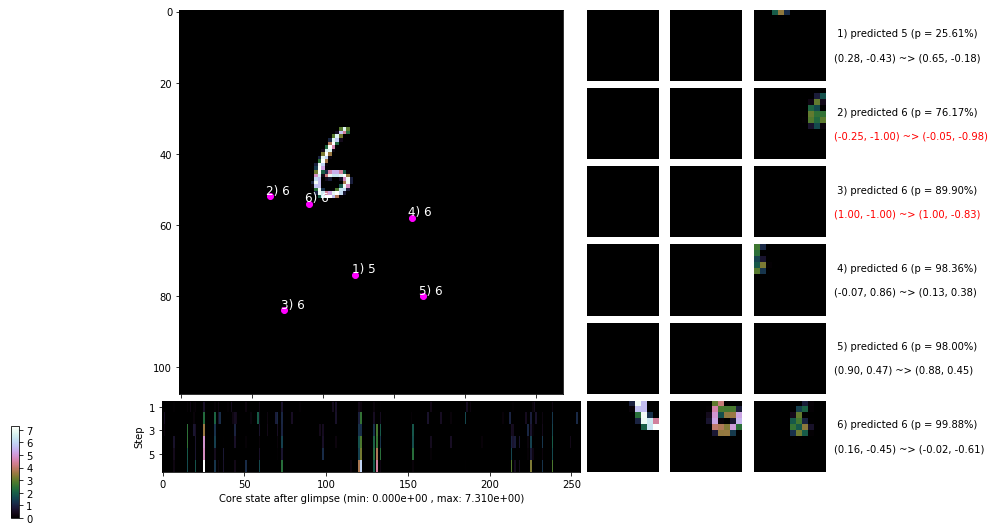

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


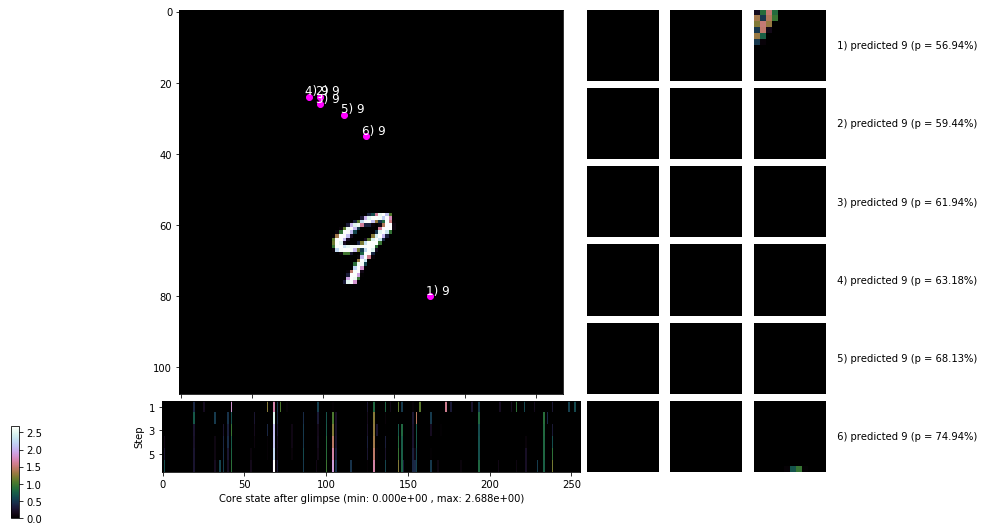


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


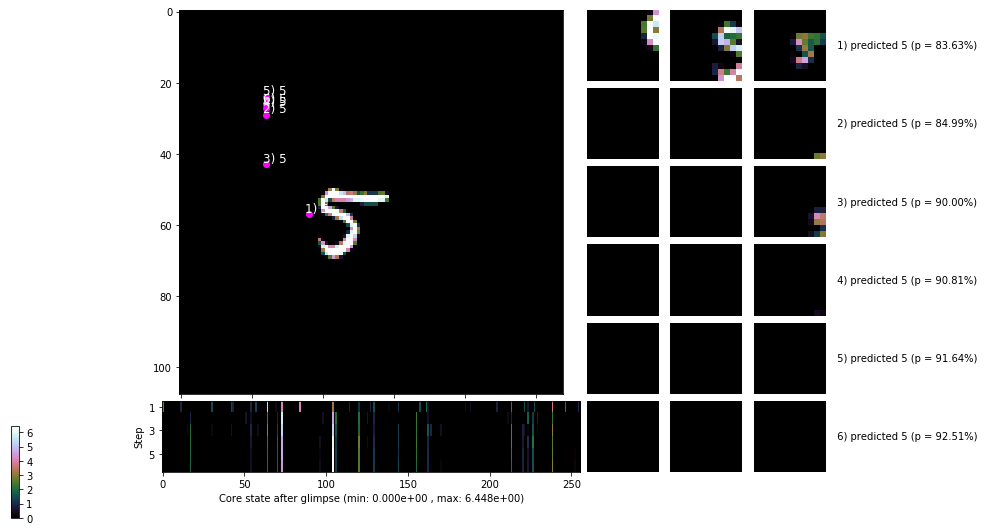

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


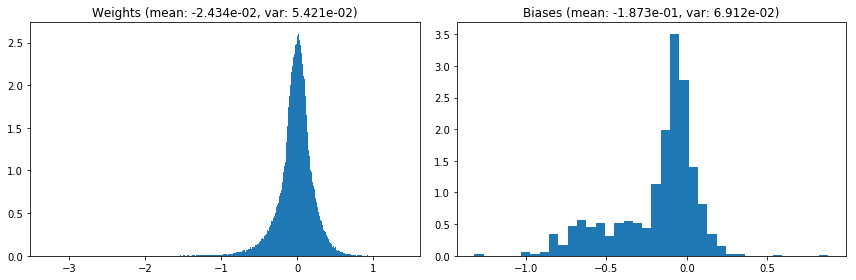

                                      Location network weights and biases


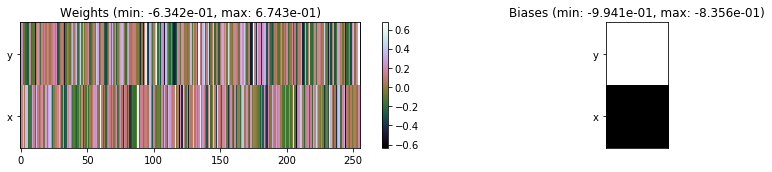

---------------------------------------------------------------------------------------------------------------
Elapsed time:  418.07 sec | TRAIN >> class loss: 0.2209 | steps:  2.176 :( | reward:  0.9300 :( | acc.: 92.999% :(
                          | VAL   >> class loss: 0.2139 | steps:  2.168 :( | reward:  0.9298 :( | acc.: 92.980% :(


Epoch  53/400) lr = 0.0001993
 b    500/  4000 >> 103.3 ms/b | lr: 1.99e-04 | grad 2norm: 400.50 | grad inf norm: 79.243
       Weights || abs max:  3.28 ( 8339.98) | mean: -2.43e-02 ( 0.05) | var: 5.42e-02 (12850.59)
        Biases || abs max:  1.32 (   54.32) | mean: -1.87e-01 ( 0.14) | var: 6.92e-02 (   30.81)
                  class loss: 0.214 | steps: 2.168 | reward:  0.934 | acc.: 93.37%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.5 ms/b | lr: 1.98e-04 | grad 2norm: 237.25 | grad inf norm: 44.678
       Weights || abs max:  3.28 ( 4639.93) | mean: -2.44e-02 ( 0.04)

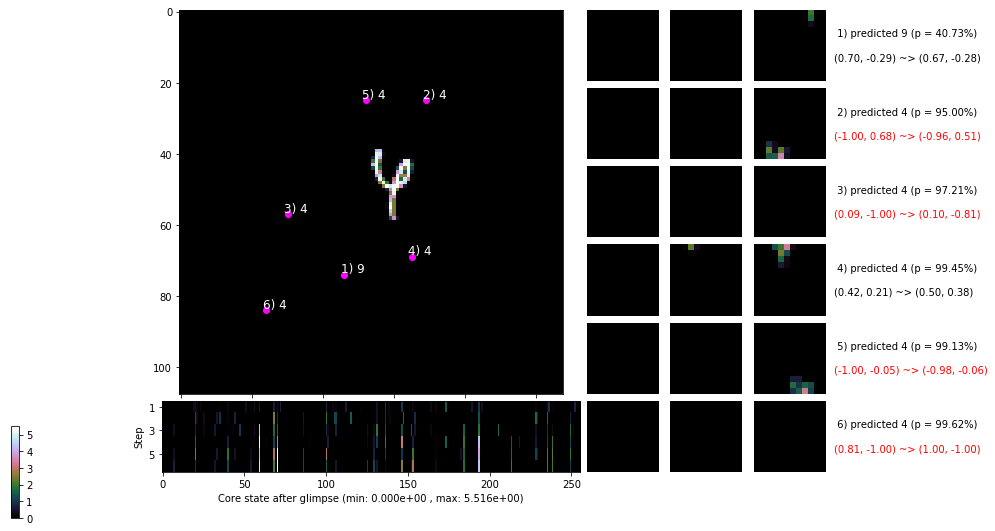

 b   1500/  4000 >> 106.1 ms/b | lr: 1.97e-04 | grad 2norm: 323.19 | grad inf norm: 69.949
       Weights || abs max:  3.28 (24774.39) | mean: -2.44e-02 ( 0.12) | var: 5.43e-02 (209615.47)
        Biases || abs max:  1.33 (   79.72) | mean: -1.88e-01 ( 0.18) | var: 6.96e-02 (  154.89)
                  class loss: 0.207 | steps: 2.197 | reward:  0.932 | acc.: 93.25%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.8 ms/b | lr: 1.96e-04 | grad 2norm: 1463.94 | grad inf norm: 297.902
       Weights || abs max:  3.29 ( 6190.18) | mean: -2.43e-02 ( 0.05) | var: 5.43e-02 ( 2217.17)
        Biases || abs max:  1.33 (  121.49) | mean: -1.88e-01 ( 0.22) | var: 6.96e-02 ( 1665.66)
                  class loss: 0.222 | steps: 2.207 | reward:  0.929 | acc.: 92.89%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

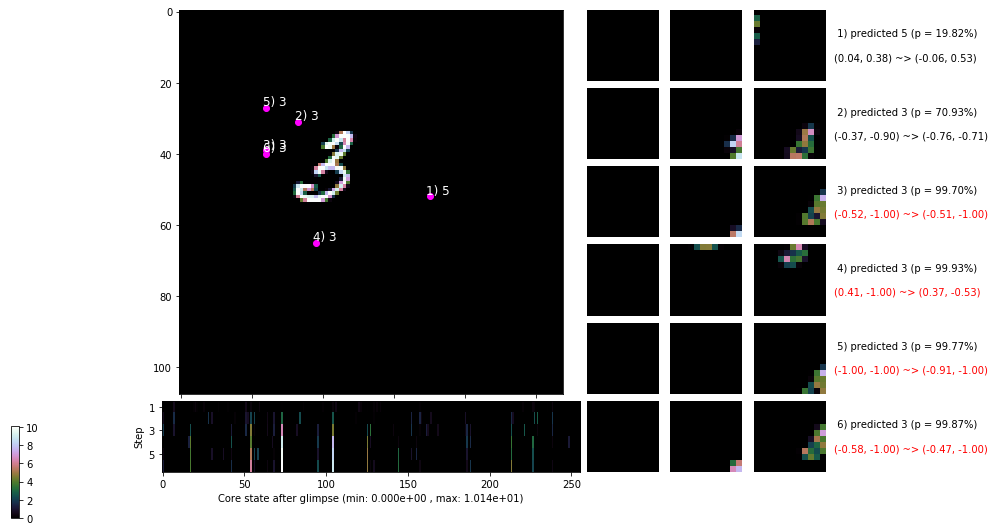

 b   2500/  4000 >> 106.3 ms/b | lr: 1.96e-04 | grad 2norm: 618.42 | grad inf norm: 127.835
       Weights || abs max:  3.29 ( 9265.24) | mean: -2.43e-02 ( 0.06) | var: 5.43e-02 ( 4302.69)
        Biases || abs max:  1.33 (  201.23) | mean: -1.88e-01 ( 0.27) | var: 6.97e-02 (14227.98)
                  class loss: 0.207 | steps: 2.172 | reward:  0.935 | acc.: 93.54%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.2 ms/b | lr: 1.95e-04 | grad 2norm: 73.89 | grad inf norm: 16.909
       Weights || abs max:  3.29 ( 7171.54) | mean: -2.43e-02 ( 0.05) | var: 5.43e-02 ( 2141.21)
        Biases || abs max:  1.33 (   55.35) | mean: -1.88e-01 ( 0.14) | var: 6.97e-02 (   42.11)
                  class loss: 0.220 | steps: 2.195 | reward:  0.930 | acc.: 93.02%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.

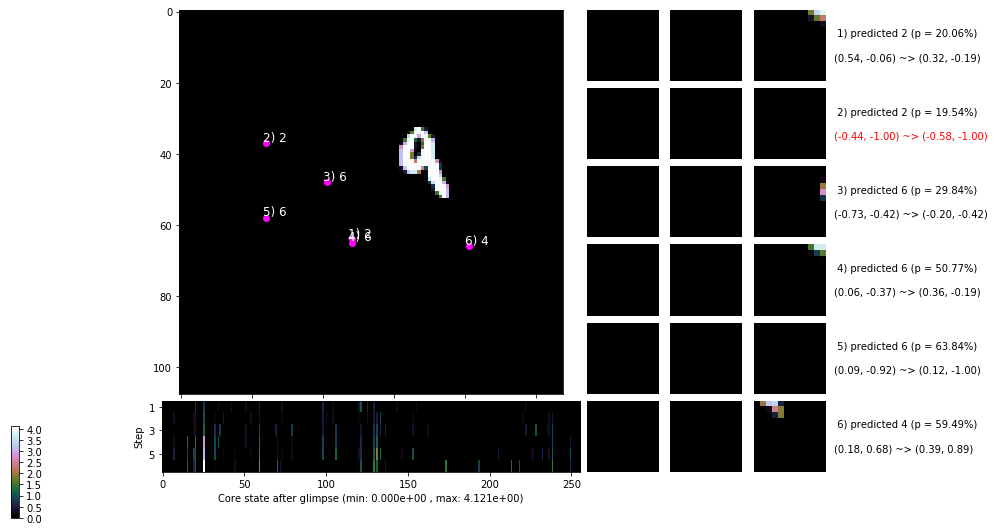

 b   3500/  4000 >> 105.2 ms/b | lr: 1.94e-04 | grad 2norm: 460.96 | grad inf norm: 99.261
       Weights || abs max:  3.29 ( 4608.43) | mean: -2.42e-02 ( 0.04) | var: 5.43e-02 ( 2674.68)
        Biases || abs max:  1.33 (   91.51) | mean: -1.88e-01 ( 0.17) | var: 6.97e-02 (  708.12)
                  class loss: 0.214 | steps: 2.208 | reward:  0.932 | acc.: 93.22%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.4 ms/b | lr: 1.93e-04 | grad 2norm: 1127.72 | grad inf norm: 227.452
       Weights || abs max:  3.29 ( 9041.95) | mean: -2.42e-02 ( 0.06) | var: 5.44e-02 (25786.12)
        Biases || abs max:  1.33 (  184.56) | mean: -1.88e-01 ( 0.27) | var: 6.98e-02 ( 1781.45)
                  class loss: 0.207 | steps: 2.175 | reward:  0.935 | acc.: 93.50%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

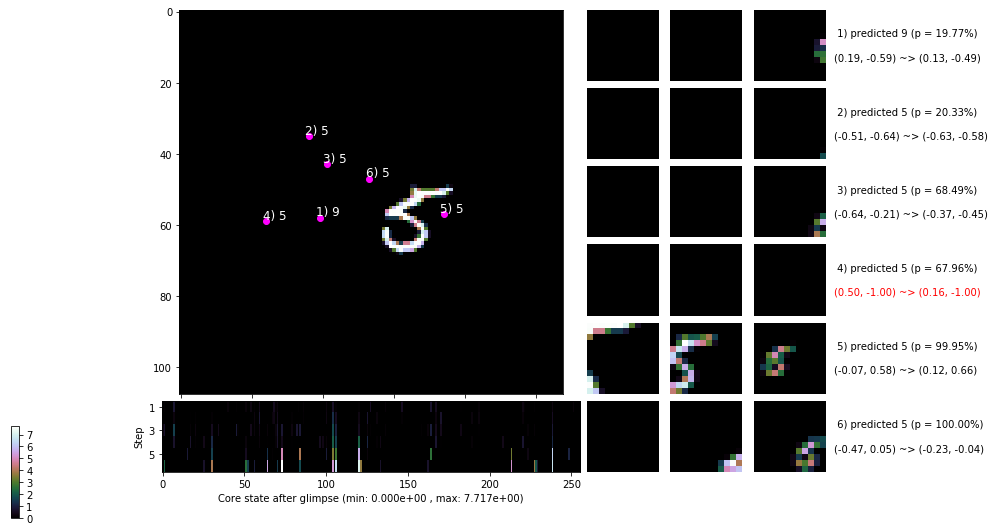

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


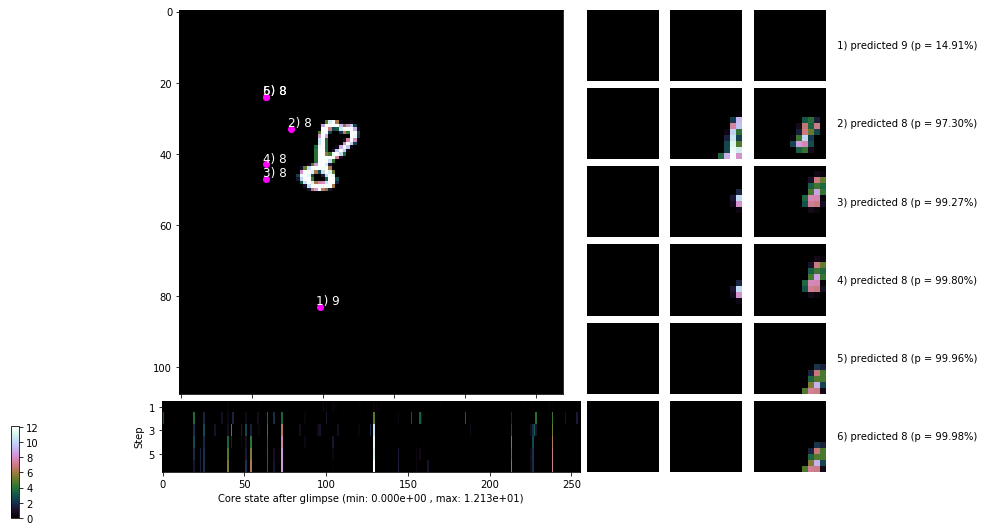


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


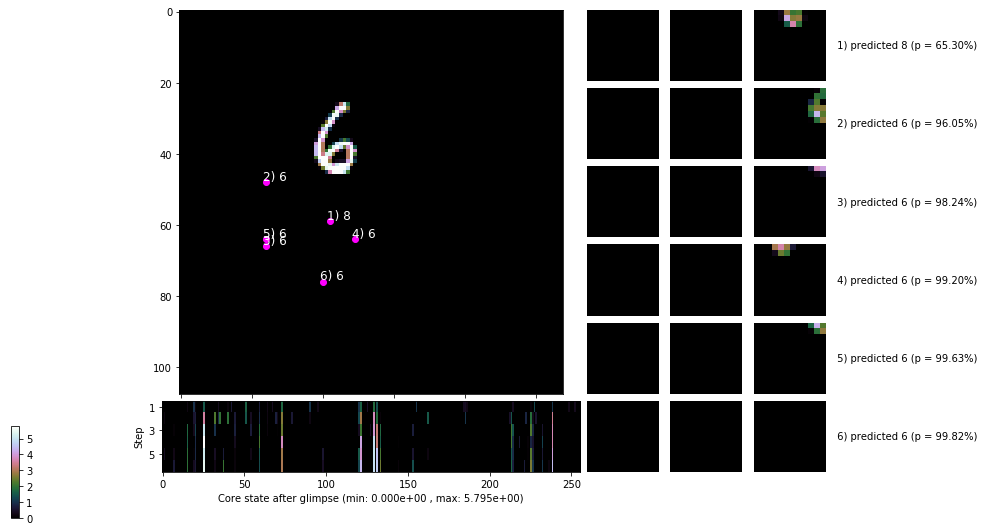

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


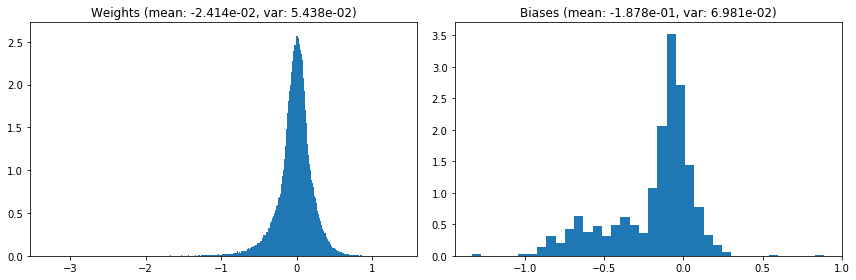

                                      Location network weights and biases


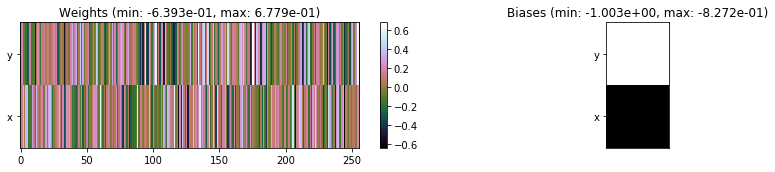

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.51 sec | TRAIN >> class loss: 0.3049 | steps:  2.187 :( | reward:  0.9326    | acc.: 93.256% 
                          | VAL   >> class loss: 0.2051 | steps:  2.175 :( | reward:  0.9344 :( | acc.: 93.440% :(


Epoch  54/400) lr = 0.0001932
 b    500/  4000 >> 107.2 ms/b | lr: 1.93e-04 | grad 2norm: 184.08 | grad inf norm: 40.188
       Weights || abs max:  3.29 ( 4506.94) | mean: -2.41e-02 ( 0.04) | var: 5.44e-02 ( 1329.96)
        Biases || abs max:  1.33 (   67.25) | mean: -1.88e-01 ( 0.19) | var: 6.99e-02 (  184.58)
                  class loss: 0.224 | steps: 2.230 | reward:  0.928 | acc.: 92.76%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 107.7 ms/b | lr: 1.92e-04 | grad 2norm: 887.92 | grad inf norm: 180.907
       Weights || abs max:  3.30 ( 3940.85) | mean: -2.41e-02 ( 0.03) 

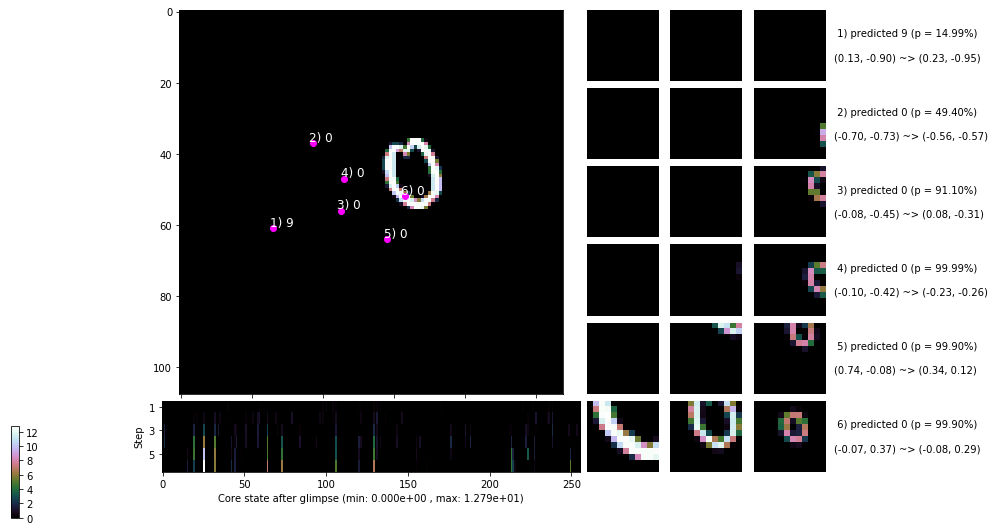

 b   1500/  4000 >> 113.6 ms/b | lr: 1.91e-04 | grad 2norm: 881.60 | grad inf norm: 176.804
       Weights || abs max:  3.30 ( 4564.79) | mean: -2.41e-02 ( 0.04) | var: 5.44e-02 (  619.08)
        Biases || abs max:  1.34 (   49.71) | mean: -1.88e-01 ( 0.15) | var: 6.98e-02 (   47.96)
                  class loss: 0.212 | steps: 2.179 | reward:  0.933 | acc.: 93.35%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 104.8 ms/b | lr: 1.90e-04 | grad 2norm: 1197.71 | grad inf norm: 242.375
       Weights || abs max:  3.30 ( 6626.09) | mean: -2.41e-02 ( 0.05) | var: 5.45e-02 ( 2053.90)
        Biases || abs max:  1.34 (   41.98) | mean: -1.88e-01 ( 0.12) | var: 6.99e-02 (  100.29)
                  class loss: 0.207 | steps: 2.161 | reward:  0.935 | acc.: 93.51%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

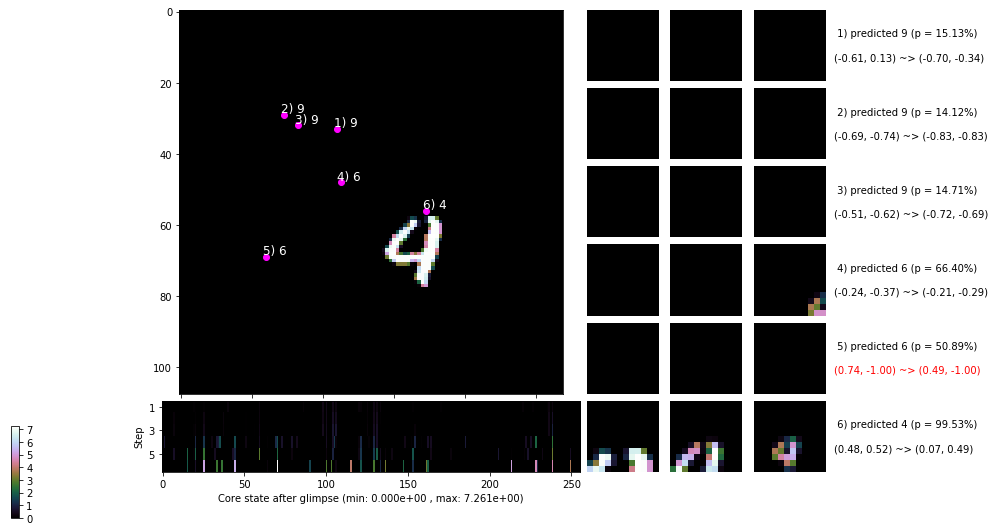

 b   2500/  4000 >> 104.5 ms/b | lr: 1.90e-04 | grad 2norm: 146.42 | grad inf norm: 32.404
       Weights || abs max:  3.30 (12046.99) | mean: -2.40e-02 ( 0.07) | var: 5.45e-02 (35969.91)
        Biases || abs max:  1.34 (   28.75) | mean: -1.88e-01 ( 0.10) | var: 6.99e-02 (   18.51)
                  class loss: 0.206 | steps: 2.138 | reward:  0.937 | acc.: 93.69%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 104.6 ms/b | lr: 1.89e-04 | grad 2norm: 110.24 | grad inf norm: 23.557
       Weights || abs max:  3.31 ( 7056.86) | mean: -2.40e-02 ( 0.05) | var: 5.45e-02 ( 2263.68)
        Biases || abs max:  1.34 (   87.51) | mean: -1.88e-01 ( 0.19) | var: 7.00e-02 (  142.74)
                  class loss: 0.208 | steps: 2.176 | reward:  0.933 | acc.: 93.32%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

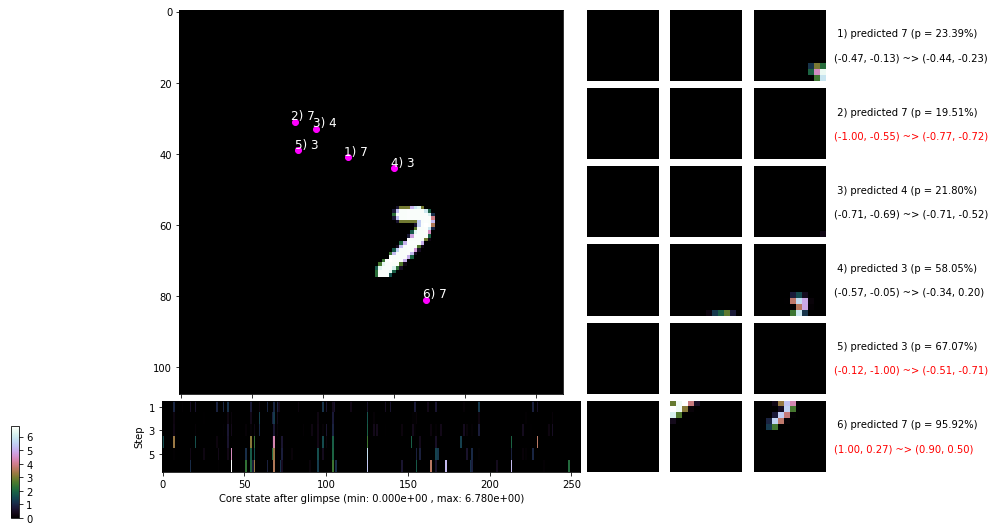

 b   3500/  4000 >> 106.3 ms/b | lr: 1.88e-04 | grad 2norm: 400.41 | grad inf norm: 84.917
       Weights || abs max:  3.31 (10920.66) | mean: -2.40e-02 ( 0.07) | var: 5.45e-02 (23638.16)
        Biases || abs max:  1.34 (   99.91) | mean: -1.89e-01 ( 0.24) | var: 7.01e-02 (  138.52)
                  class loss: 0.206 | steps: 2.162 | reward:  0.935 | acc.: 93.53%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.6 ms/b | lr: 1.88e-04 | grad 2norm: 54.90 | grad inf norm: 12.912
       Weights || abs max:  3.31 ( 6622.60) | mean: -2.40e-02 ( 0.05) | var: 5.45e-02 ( 1390.04)
        Biases || abs max:  1.33 (   90.58) | mean: -1.89e-01 ( 0.19) | var: 7.02e-02 (  255.66)
                  class loss: 0.199 | steps: 2.167 | reward:  0.936 | acc.: 93.60%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

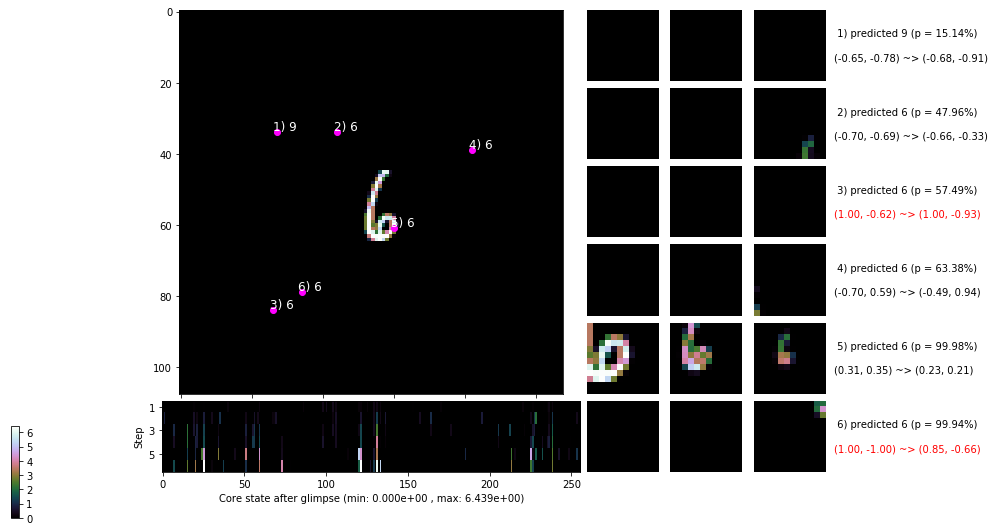

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


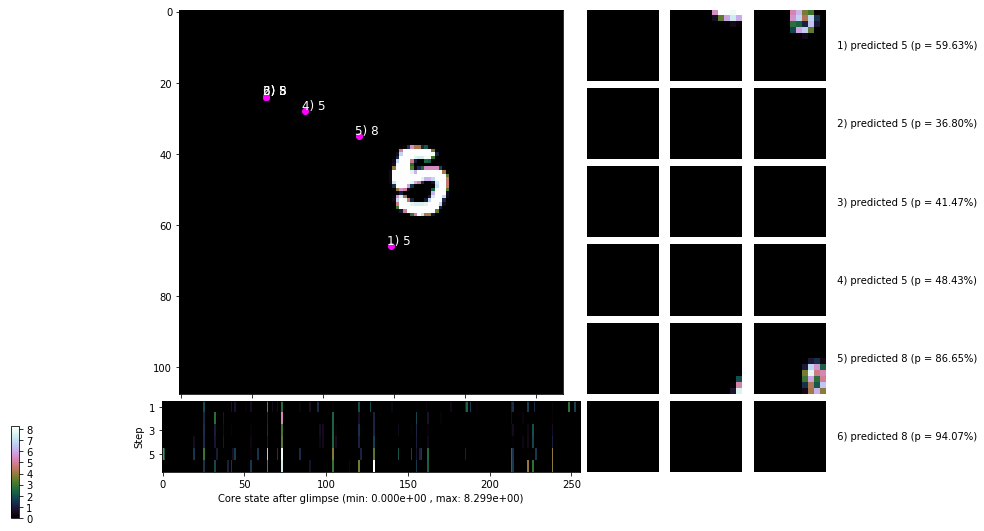


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


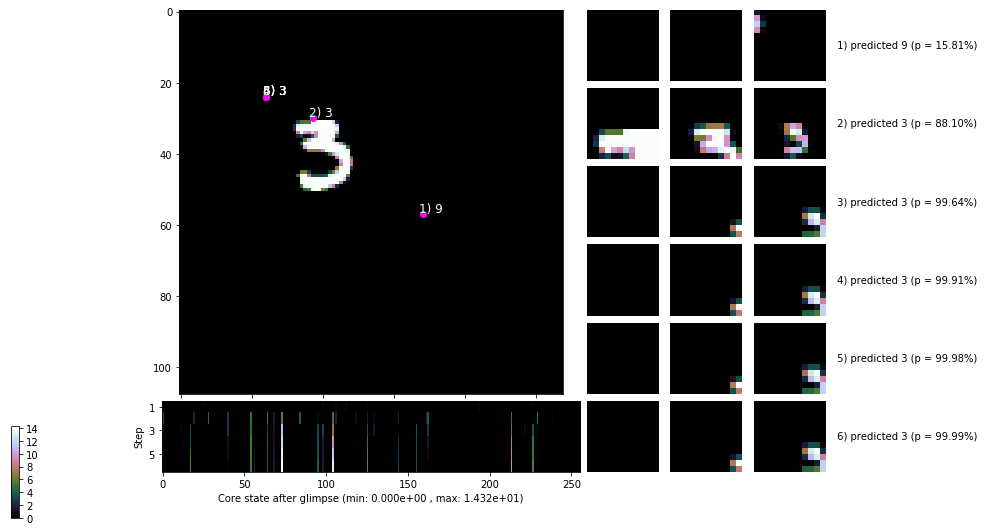

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


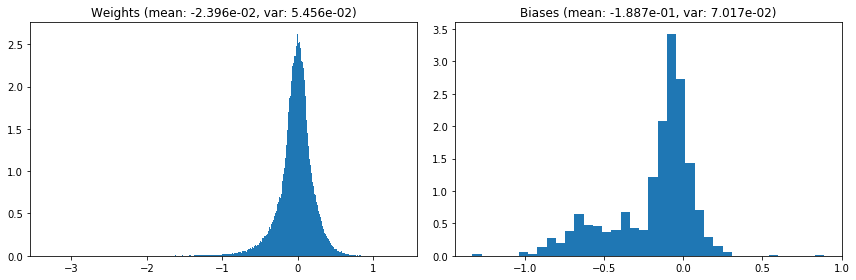

                                      Location network weights and biases


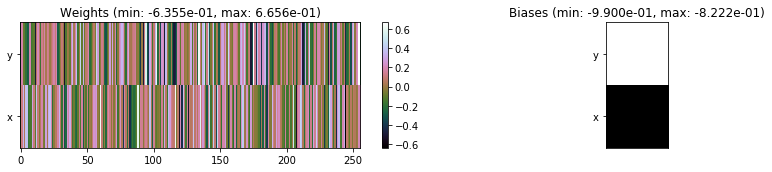

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.77 sec | TRAIN >> class loss: 0.2082 | steps:  2.173 :( | reward:  0.9342    | acc.: 93.417% 
                          | VAL   >> class loss: 0.1929 | steps:  2.123 :( | reward:  0.9394    | acc.: 93.940% 


Epoch  55/400) lr = 0.0001873
 b    500/  4000 >> 109.6 ms/b | lr: 1.87e-04 | grad 2norm: 723.35 | grad inf norm: 143.177
       Weights || abs max:  3.32 (12845.80) | mean: -2.40e-02 ( 0.07) | var: 5.46e-02 (58991.14)
        Biases || abs max:  1.33 (  100.20) | mean: -1.89e-01 ( 0.19) | var: 7.03e-02 (  225.94)
                  class loss: 0.208 | steps: 2.170 | reward:  0.935 | acc.: 93.53%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 110.0 ms/b | lr: 1.86e-04 | grad 2norm: 1769.05 | grad inf norm: 341.559
       Weights || abs max:  3.33 ( 8242.90) | mean: -2.39e-02 ( 0.06) 

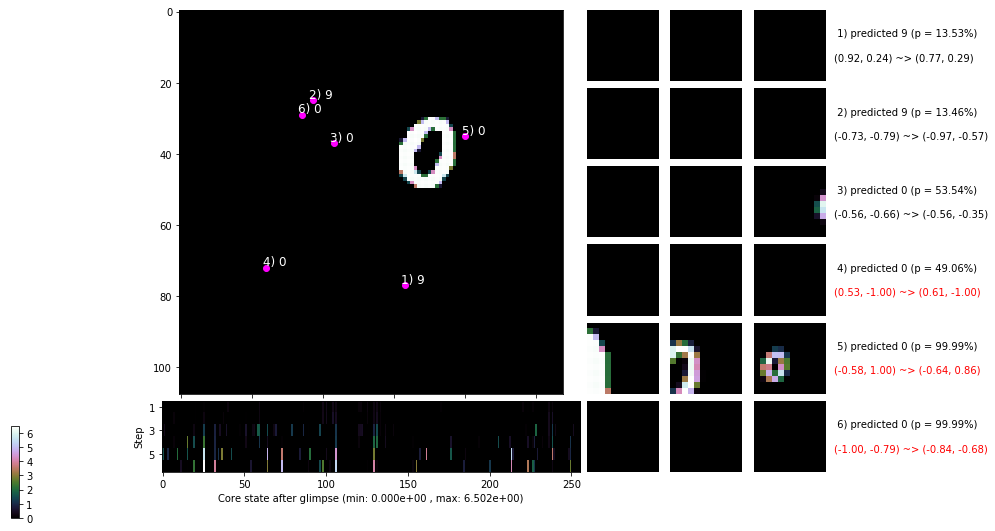

 b   1500/  4000 >> 110.6 ms/b | lr: 1.85e-04 | grad 2norm: 272.02 | grad inf norm: 57.632
       Weights || abs max:  3.33 ( 5751.25) | mean: -2.39e-02 ( 0.05) | var: 5.46e-02 ( 2786.44)
        Biases || abs max:  1.33 (  101.78) | mean: -1.89e-01 ( 0.18) | var: 7.05e-02 (  168.46)
                  class loss: 0.203 | steps: 2.163 | reward:  0.936 | acc.: 93.56%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 111.2 ms/b | lr: 1.85e-04 | grad 2norm: 1087.87 | grad inf norm: 208.576
       Weights || abs max:  3.33 (12086.54) | mean: -2.38e-02 ( 0.08) | var: 5.47e-02 (15466.41)
        Biases || abs max:  1.33 (  113.72) | mean: -1.89e-01 ( 0.21) | var: 7.05e-02 ( 1097.36)
                  class loss: 0.194 | steps: 2.179 | reward:  0.939 | acc.: 93.90%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

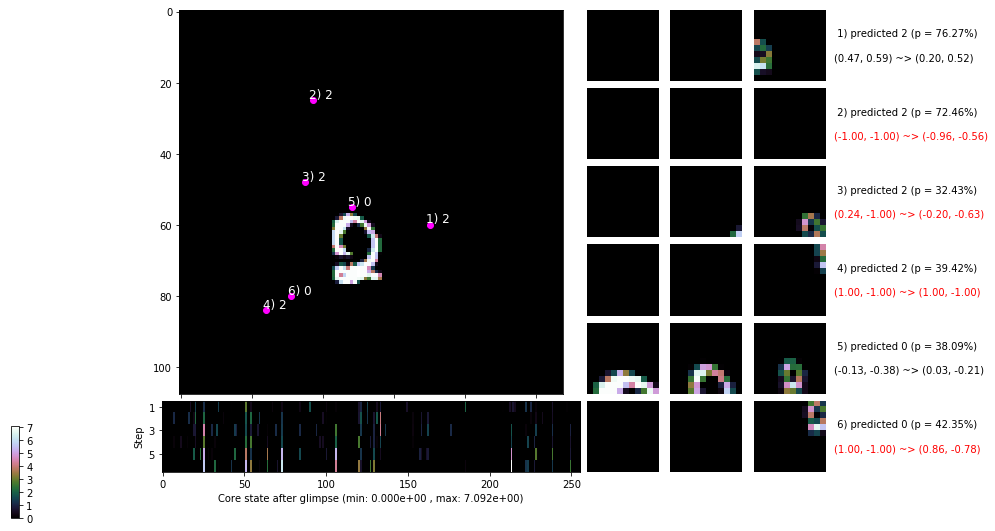

 b   2500/  4000 >> 108.8 ms/b | lr: 1.84e-04 | grad 2norm: 46.72 | grad inf norm: 11.703
       Weights || abs max:  3.32 (15308.34) | mean: -2.39e-02 ( 0.09) | var: 5.47e-02 (66925.40)
        Biases || abs max:  1.33 (  134.09) | mean: -1.89e-01 ( 0.23) | var: 7.09e-02 (  588.58)
                  class loss: 0.206 | steps: 2.151 | reward:  0.935 | acc.: 93.52%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 108.3 ms/b | lr: 1.83e-04 | grad 2norm: 1216.24 | grad inf norm: 239.694
       Weights || abs max:  3.32 (18830.38) | mean: -2.39e-02 ( 0.10) | var: 5.47e-02 (107381.51)
        Biases || abs max:  1.32 (   44.26) | mean: -1.89e-01 ( 0.14) | var: 7.10e-02 (   23.57)
                  class loss: 0.212 | steps: 2.179 | reward:  0.932 | acc.: 93.23%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

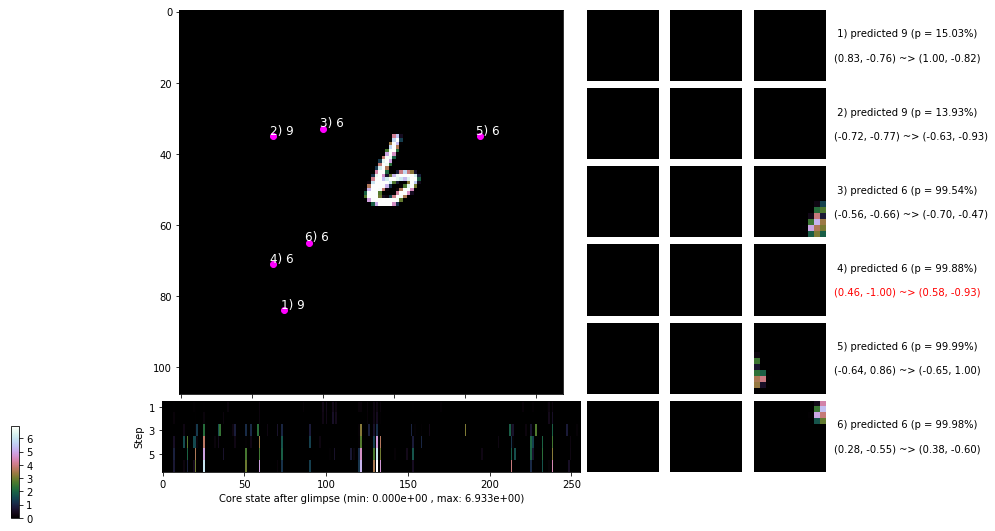

 b   3500/  4000 >> 112.0 ms/b | lr: 1.83e-04 | grad 2norm: 123.86 | grad inf norm: 26.562
       Weights || abs max:  3.33 (314034.50) | mean: -2.38e-02 ( 1.26) | var: 5.47e-02 (182385376.00)
        Biases || abs max:  1.33 (   47.04) | mean: -1.89e-01 ( 0.14) | var: 7.11e-02 (   54.53)
                  class loss: 0.213 | steps: 2.212 | reward:  0.932 | acc.: 93.15%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 110.5 ms/b | lr: 1.82e-04 | grad 2norm: 603.36 | grad inf norm: 112.690
       Weights || abs max:  3.33 ( 8473.95) | mean: -2.37e-02 ( 0.06) | var: 5.47e-02 ( 6211.01)
        Biases || abs max:  1.33 (  163.67) | mean: -1.89e-01 ( 0.25) | var: 7.11e-02 (  523.74)
                  class loss: 0.205 | steps: 2.188 | reward:  0.937 | acc.: 93.72%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1

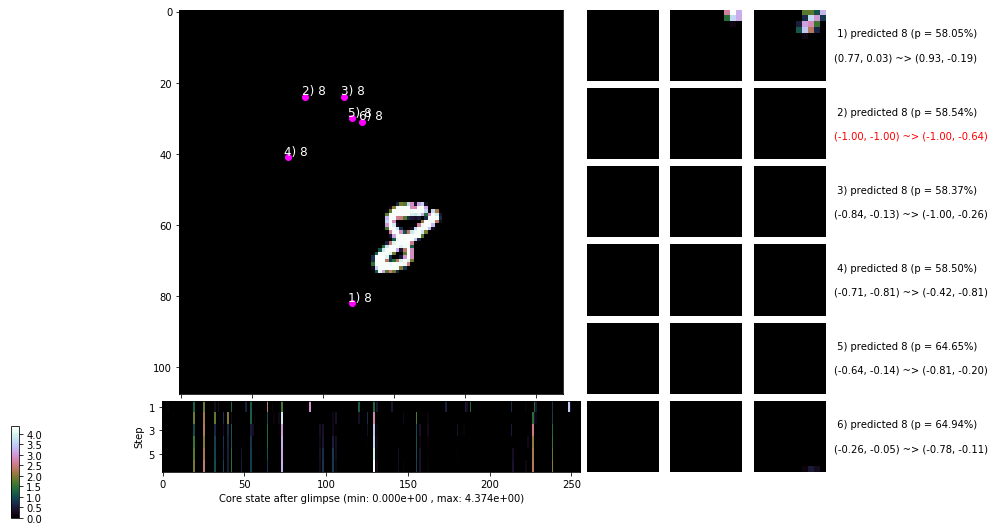

                                          ---===  VALIDATION  ===---

	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


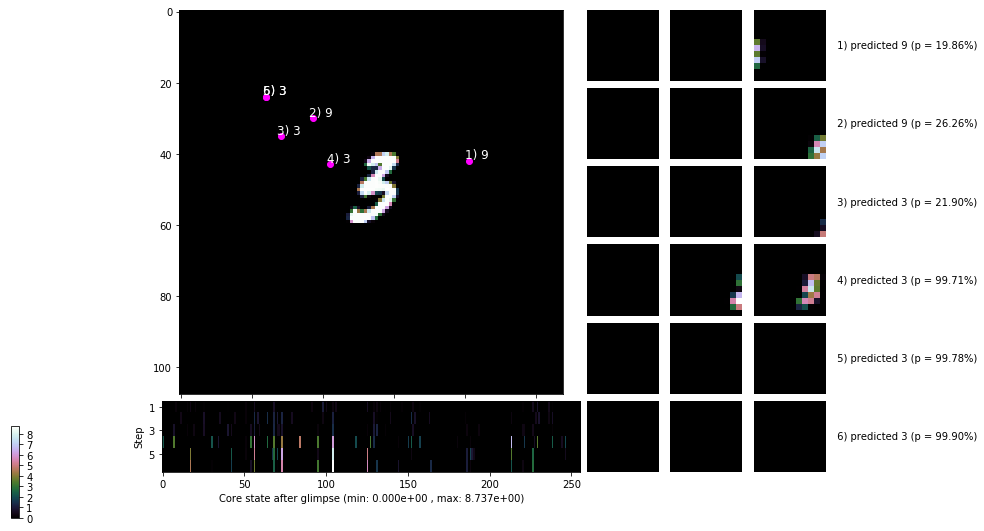


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


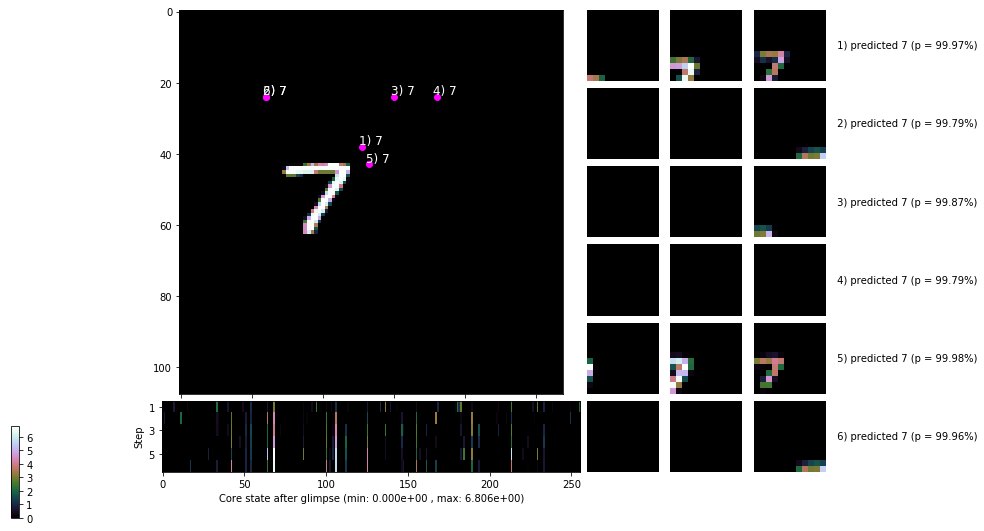

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


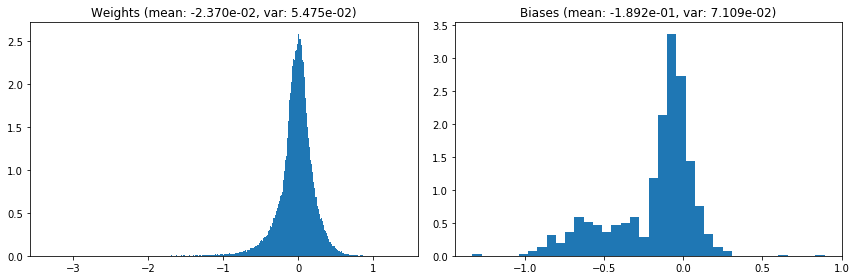

                                      Location network weights and biases


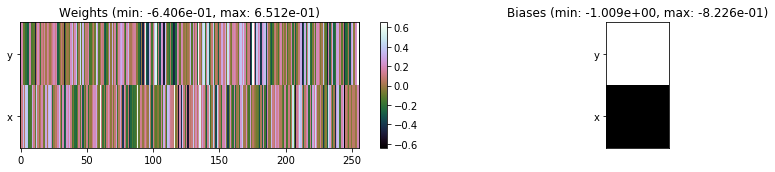

---------------------------------------------------------------------------------------------------------------
Elapsed time:  441.40 sec | TRAIN >> class loss: 0.2058 | steps:  2.176 :( | reward:  0.9353    | acc.: 93.534% 
                          | VAL   >> class loss: 0.2030 | steps:  2.178 :( | reward:  0.9404    | acc.: 94.040% 


Epoch  56/400) lr = 0.0001816
 b    500/  4000 >> 111.4 ms/b | lr: 1.81e-04 | grad 2norm: 144.71 | grad inf norm: 29.585
       Weights || abs max:  3.33 (11630.50) | mean: -2.37e-02 ( 0.07) | var: 5.48e-02 (23131.72)
        Biases || abs max:  1.33 (   72.59) | mean: -1.89e-01 ( 0.16) | var: 7.13e-02 (   79.99)
                  class loss: 0.211 | steps: 2.198 | reward:  0.933 | acc.: 93.33%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 102.9 ms/b | lr: 1.80e-04 | grad 2norm: 615.37 | grad inf norm: 117.444
       Weights || abs max:  3.33 ( 8844.62) | mean: -2.37e-02 ( 0.06) | 

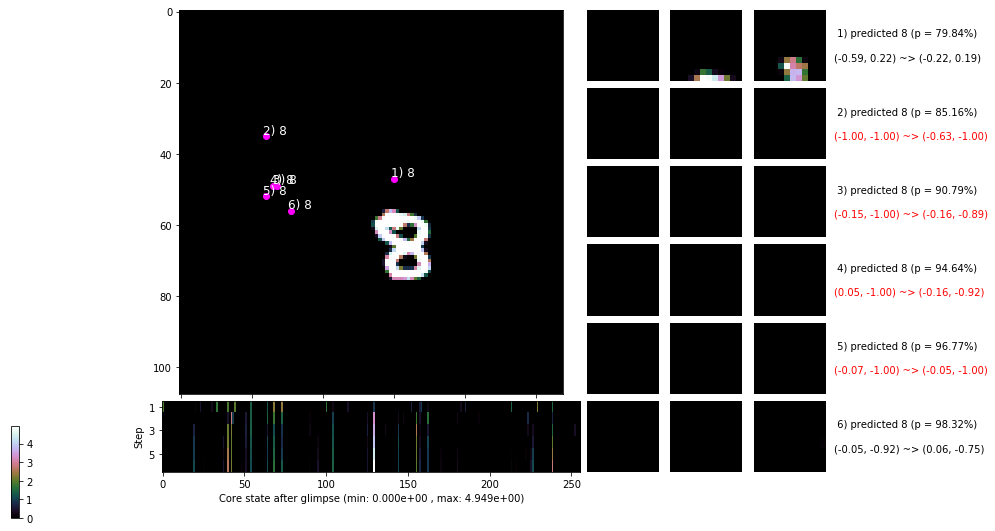

 b   1500/  4000 >> 102.8 ms/b | lr: 1.80e-04 | grad 2norm: 287.48 | grad inf norm: 56.789
       Weights || abs max:  3.33 (10768.64) | mean: -2.36e-02 ( 0.06) | var: 5.48e-02 (46170.32)
        Biases || abs max:  1.33 (   84.97) | mean: -1.89e-01 ( 0.18) | var: 7.15e-02 (   61.07)
                  class loss: 0.203 | steps: 2.180 | reward:  0.936 | acc.: 93.59%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.3 ms/b | lr: 1.79e-04 | grad 2norm: 163.38 | grad inf norm: 32.071
       Weights || abs max:  3.33 ( 3624.80) | mean: -2.36e-02 ( 0.03) | var: 5.48e-02 (  602.86)
        Biases || abs max:  1.34 (  177.41) | mean: -1.90e-01 ( 0.33) | var: 7.15e-02 ( 5214.53)
                  class loss: 0.211 | steps: 2.150 | reward:  0.933 | acc.: 93.31%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

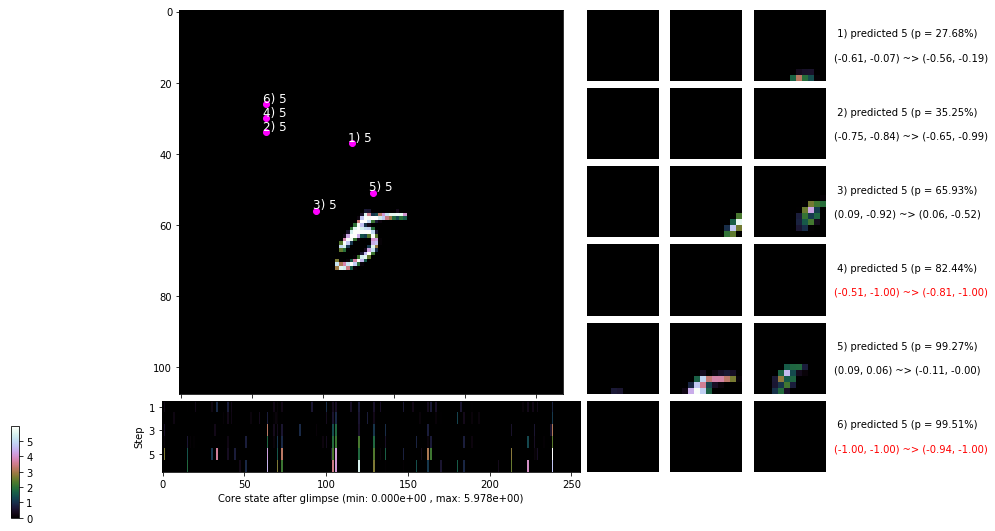

 b   2500/  4000 >> 102.9 ms/b | lr: 1.78e-04 | grad 2norm: 1158.38 | grad inf norm: 215.147
       Weights || abs max:  3.33 ( 6903.27) | mean: -2.36e-02 ( 0.05) | var: 5.49e-02 ( 5856.95)
        Biases || abs max:  1.34 (   64.43) | mean: -1.90e-01 ( 0.15) | var: 7.15e-02 (   77.88)
                  class loss: 0.223 | steps: 2.195 | reward:  0.930 | acc.: 92.98%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.3 ms/b | lr: 1.78e-04 | grad 2norm: 422.88 | grad inf norm: 87.969
       Weights || abs max:  3.33 ( 3793.32) | mean: -2.36e-02 ( 0.04) | var: 5.49e-02 (  457.26)
        Biases || abs max:  1.34 (   63.59) | mean: -1.90e-01 ( 0.14) | var: 7.16e-02 (   51.31)
                  class loss: 0.204 | steps: 2.175 | reward:  0.934 | acc.: 93.42%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

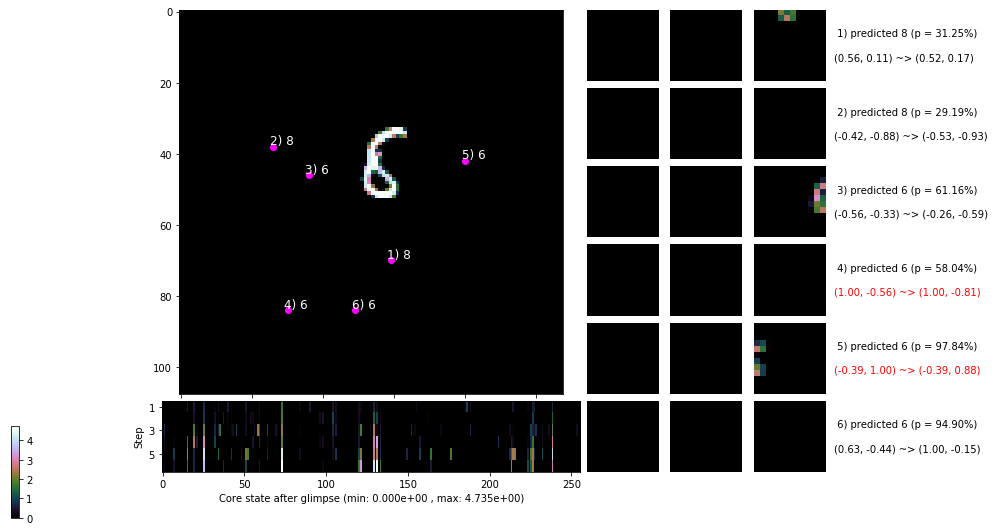

 b   3500/  4000 >> 103.9 ms/b | lr: 1.77e-04 | grad 2norm: 1351.05 | grad inf norm: 275.244
       Weights || abs max:  3.33 (44288.50) | mean: -2.36e-02 ( 0.20) | var: 5.49e-02 (2027401.75)
        Biases || abs max:  1.35 (  105.00) | mean: -1.90e-01 ( 0.20) | var: 7.17e-02 (  340.60)
                  class loss: 0.219 | steps: 2.234 | reward:  0.928 | acc.: 92.77%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.1 ms/b | lr: 1.76e-04 | grad 2norm: 1054.53 | grad inf norm: 216.631
       Weights || abs max:  3.33 ( 5564.14) | mean: -2.36e-02 ( 0.05) | var: 5.49e-02 (  854.76)
        Biases || abs max:  1.35 (  270.51) | mean: -1.90e-01 ( 0.36) | var: 7.17e-02 (12170.76)
                  class loss: 0.222 | steps: 2.248 | reward:  0.929 | acc.: 92.85%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1

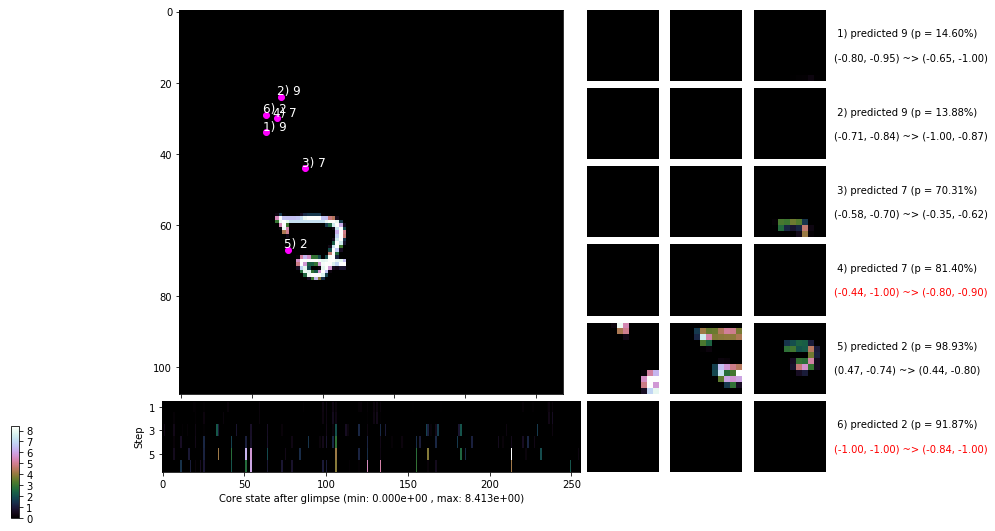

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


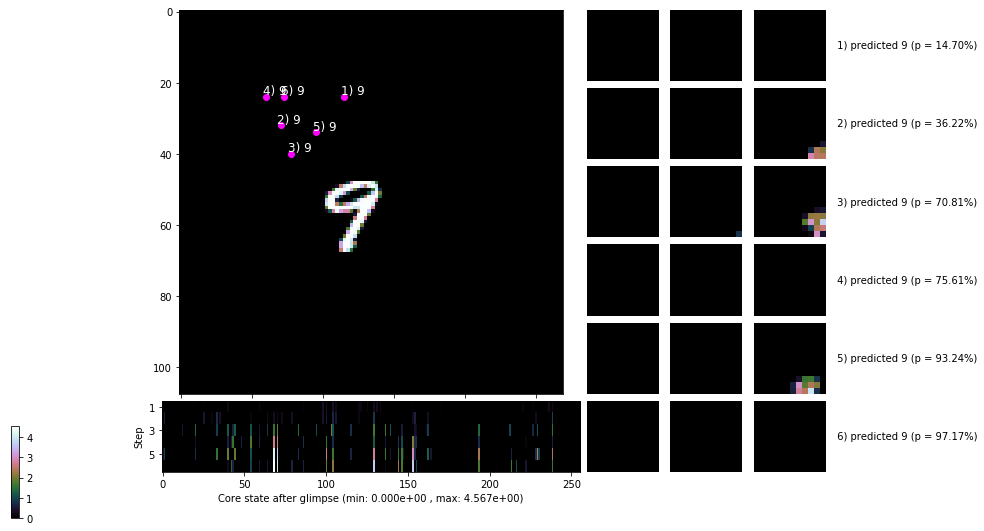


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


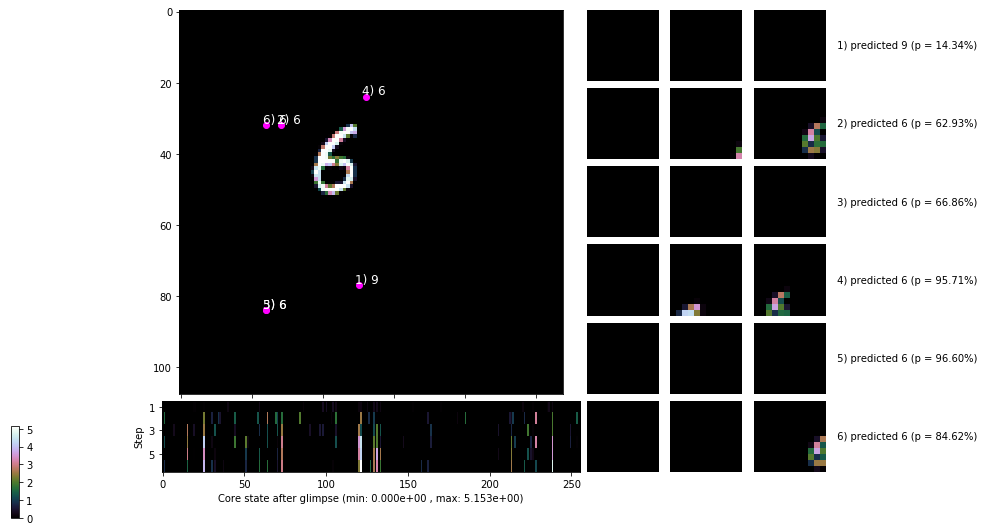

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


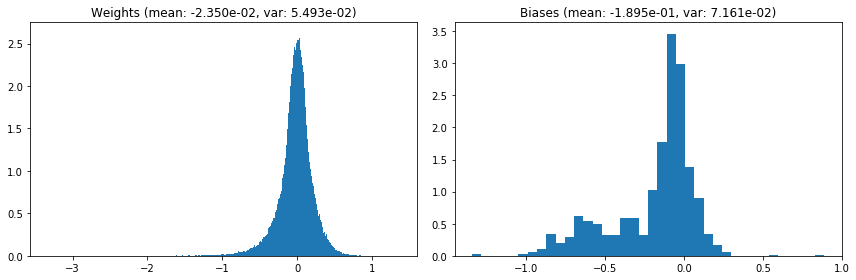

                                      Location network weights and biases


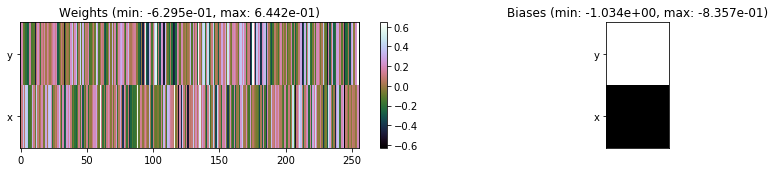

---------------------------------------------------------------------------------------------------------------
Elapsed time:  415.22 sec | TRAIN >> class loss: 0.2118 | steps:  2.192 :( | reward:  0.9320 :( | acc.: 93.196% :(
                          | VAL   >> class loss: 0.2153 | steps:  2.223 :( | reward:  0.9354 :( | acc.: 93.540% :(


Epoch  57/400) lr = 0.0001761
 b    500/  4000 >> 107.9 ms/b | lr: 1.76e-04 | grad 2norm: 1403.96 | grad inf norm: 280.559
       Weights || abs max:  3.33 (17342.66) | mean: -2.35e-02 ( 0.10) | var: 5.49e-02 (71017.52)
        Biases || abs max:  1.35 (   75.20) | mean: -1.90e-01 ( 0.19) | var: 7.17e-02 (   73.68)
                  class loss: 0.211 | steps: 2.242 | reward:  0.933 | acc.: 93.25%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 100.9 ms/b | lr: 1.75e-04 | grad 2norm: 120.45 | grad inf norm: 26.235
       Weights || abs max:  3.34 ( 8109.09) | mean: -2.35e-02 ( 0.0

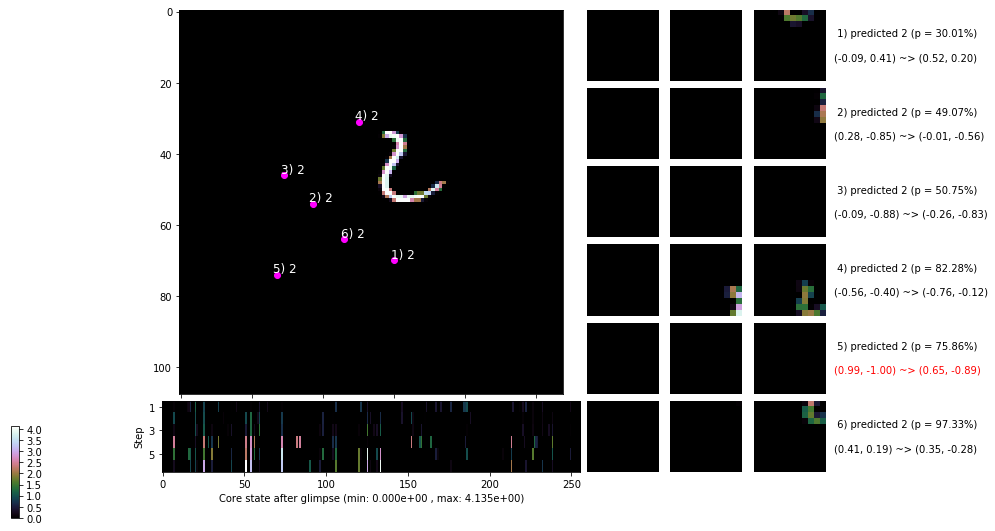

 b   1500/  4000 >> 103.6 ms/b | lr: 1.74e-04 | grad 2norm: 3808.20 | grad inf norm: 748.274
       Weights || abs max:  3.34 ( 9415.96) | mean: -2.35e-02 ( 0.06) | var: 5.50e-02 (48534.19)
        Biases || abs max:  1.35 (  128.09) | mean: -1.90e-01 ( 0.24) | var: 7.17e-02 ( 1126.26)
                  class loss: 0.223 | steps: 2.219 | reward:  0.930 | acc.: 93.00%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.4 ms/b | lr: 1.73e-04 | grad 2norm: 1787.13 | grad inf norm: 345.043
       Weights || abs max:  3.34 ( 4913.08) | mean: -2.35e-02 ( 0.04) | var: 5.50e-02 ( 1164.87)
        Biases || abs max:  1.35 (   83.46) | mean: -1.90e-01 ( 0.21) | var: 7.18e-02 (  130.37)
                  class loss: 0.223 | steps: 2.226 | reward:  0.929 | acc.: 92.87%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

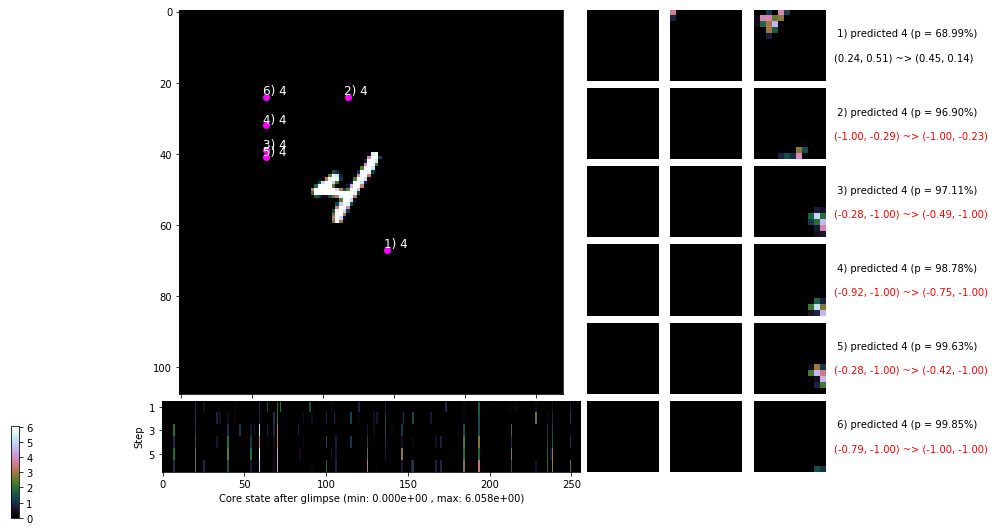

 b   2500/  4000 >> 102.9 ms/b | lr: 1.73e-04 | grad 2norm: 1077.60 | grad inf norm: 213.965
       Weights || abs max:  3.34 (19267.42) | mean: -2.34e-02 ( 0.10) | var: 5.50e-02 (255080.09)
        Biases || abs max:  1.36 (  140.90) | mean: -1.90e-01 ( 0.24) | var: 7.19e-02 (  501.63)
                  class loss: 0.220 | steps: 2.211 | reward:  0.930 | acc.: 92.97%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.1 ms/b | lr: 1.72e-04 | grad 2norm: 937.74 | grad inf norm: 171.475
       Weights || abs max:  3.34 ( 9750.95) | mean: -2.34e-02 ( 0.06) | var: 5.50e-02 ( 8764.45)
        Biases || abs max:  1.36 (  194.38) | mean: -1.90e-01 ( 0.31) | var: 7.19e-02 ( 3611.54)
                  class loss: 0.368 | steps: 2.187 | reward:  0.931 | acc.: 93.11%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

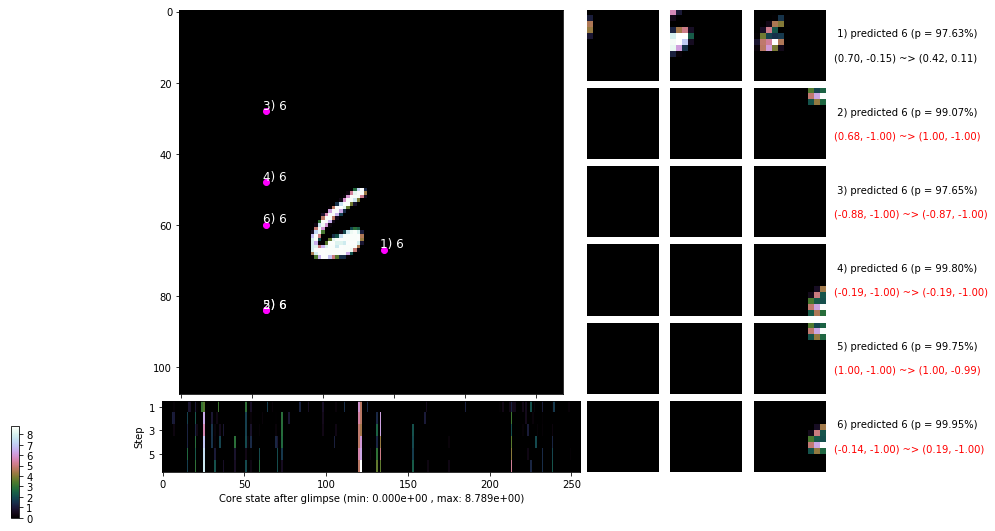

 b   3500/  4000 >> 111.7 ms/b | lr: 1.72e-04 | grad 2norm: 1945.94 | grad inf norm: 379.068
       Weights || abs max:  3.34 (15799.81) | mean: -2.34e-02 ( 0.09) | var: 5.51e-02 (139805.16)
        Biases || abs max:  1.36 (  147.27) | mean: -1.90e-01 ( 0.28) | var: 7.20e-02 ( 1352.38)
                  class loss: 0.206 | steps: 2.182 | reward:  0.934 | acc.: 93.40%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.1 ms/b | lr: 1.71e-04 | grad 2norm: 1633.37 | grad inf norm: 319.032
       Weights || abs max:  3.34 ( 7129.81) | mean: -2.34e-02 ( 0.05) | var: 5.51e-02 ( 5046.45)
        Biases || abs max:  1.36 (  251.95) | mean: -1.90e-01 ( 0.42) | var: 7.21e-02 ( 1954.01)
                  class loss: 0.210 | steps: 2.176 | reward:  0.932 | acc.: 93.21%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.

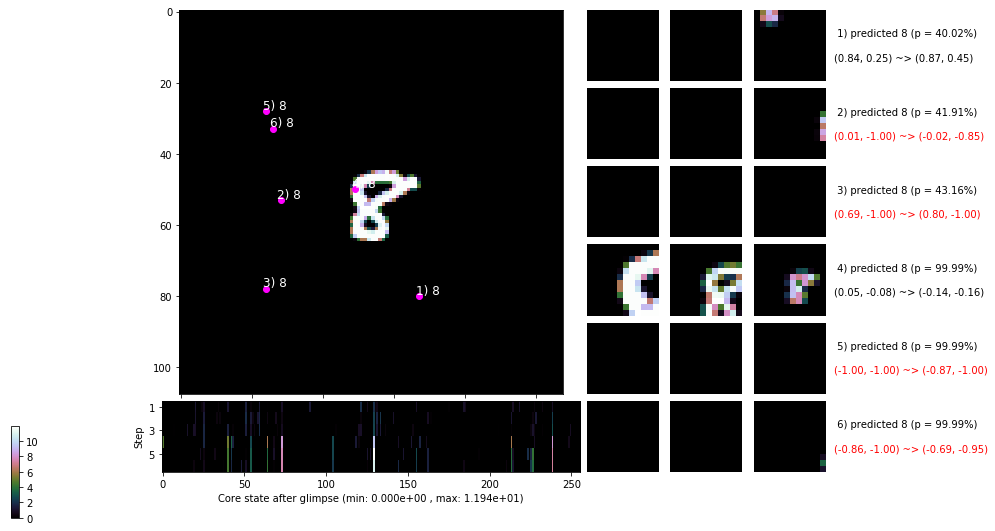

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


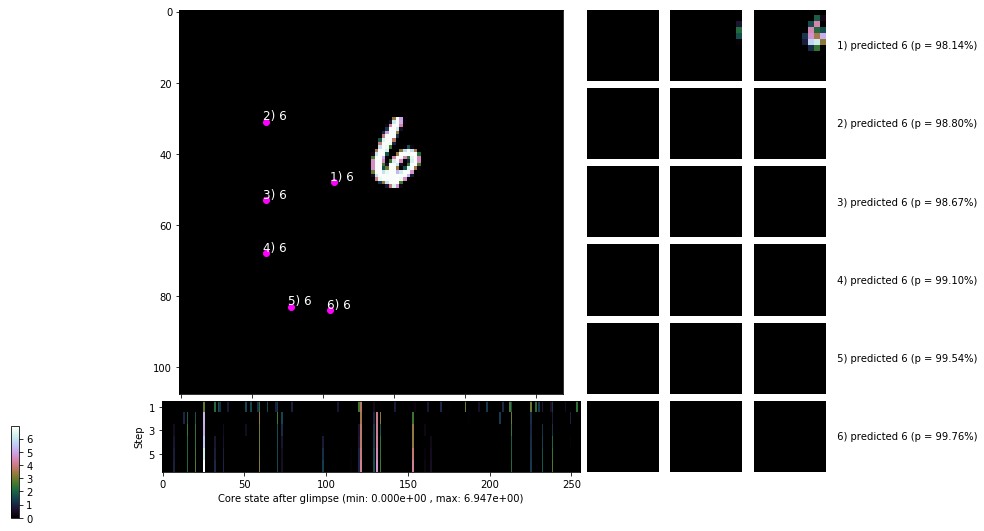


	Target class: 4  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


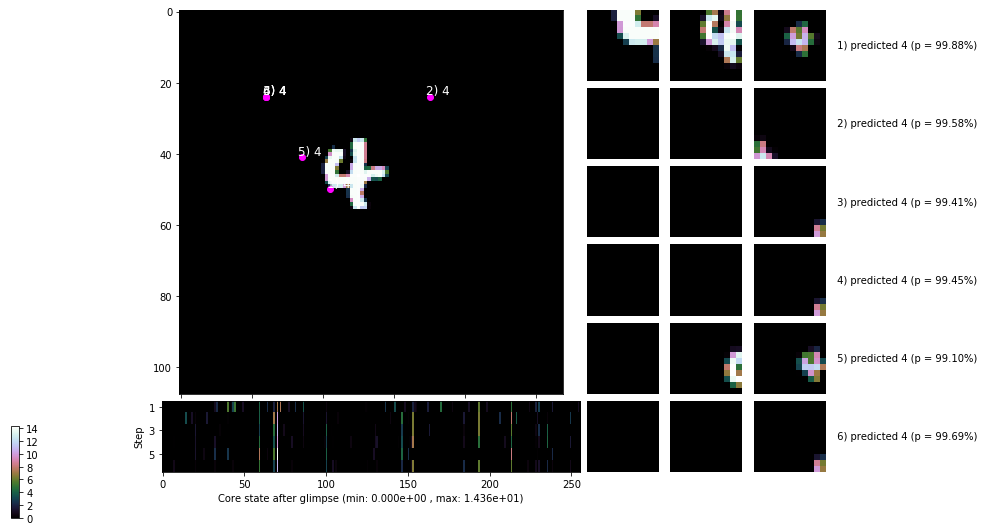

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


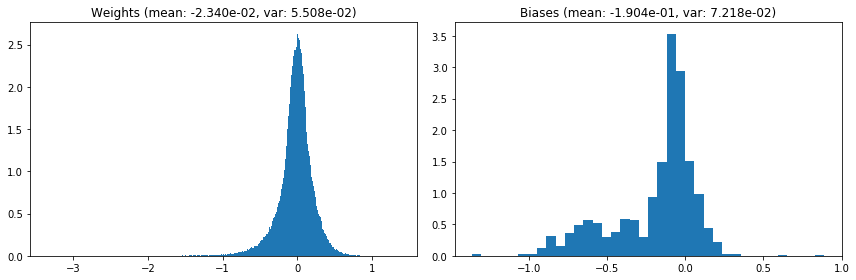

                                      Location network weights and biases


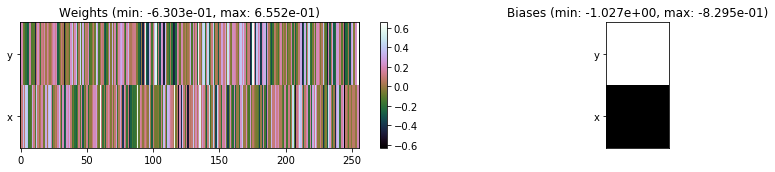

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.04 sec | TRAIN >> class loss: 0.2353 | steps:  2.207 :( | reward:  0.9309 :( | acc.: 93.093% :(
                          | VAL   >> class loss: 0.1959 | steps:  2.161 :( | reward:  0.9380 :( | acc.: 93.800% :(


Epoch  58/400) lr = 0.0001707
 b    500/  4000 >> 101.0 ms/b | lr: 1.70e-04 | grad 2norm: 3118.36 | grad inf norm: 590.001
       Weights || abs max:  3.34 ( 8291.67) | mean: -2.34e-02 ( 0.06) | var: 5.51e-02 ( 3165.53)
        Biases || abs max:  1.36 (  200.71) | mean: -1.90e-01 ( 0.36) | var: 7.22e-02 ( 2235.46)
                  class loss: 0.213 | steps: 2.179 | reward:  0.932 | acc.: 93.19%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.1 ms/b | lr: 1.70e-04 | grad 2norm: 239.75 | grad inf norm: 49.512
       Weights || abs max:  3.34 (20076.70) | mean: -2.34e-02 ( 0.1

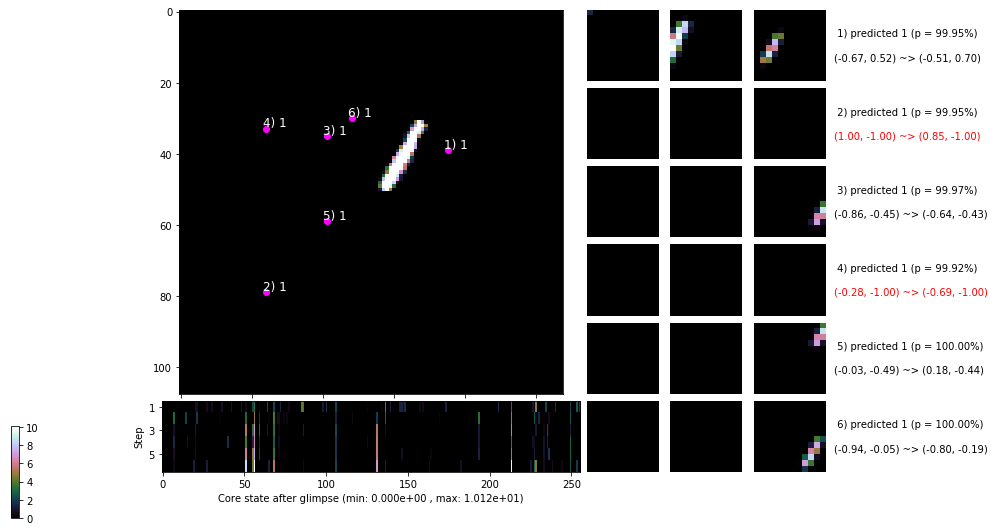

 b   1500/  4000 >> 103.8 ms/b | lr: 1.69e-04 | grad 2norm: 2871.47 | grad inf norm: 556.489
       Weights || abs max:  3.34 ( 6732.45) | mean: -2.33e-02 ( 0.05) | var: 5.51e-02 ( 1958.90)
        Biases || abs max:  1.36 (  223.18) | mean: -1.91e-01 ( 0.41) | var: 7.23e-02 (  578.40)
                  class loss: 0.205 | steps: 2.185 | reward:  0.934 | acc.: 93.42%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.0 ms/b | lr: 1.68e-04 | grad 2norm: 284.51 | grad inf norm: 57.724
       Weights || abs max:  3.34 ( 8346.48) | mean: -2.33e-02 ( 0.06) | var: 5.51e-02 ( 4417.14)
        Biases || abs max:  1.36 (   98.80) | mean: -1.91e-01 ( 0.23) | var: 7.24e-02 (  246.87)
                  class loss: 0.206 | steps: 2.208 | reward:  0.935 | acc.: 93.49%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

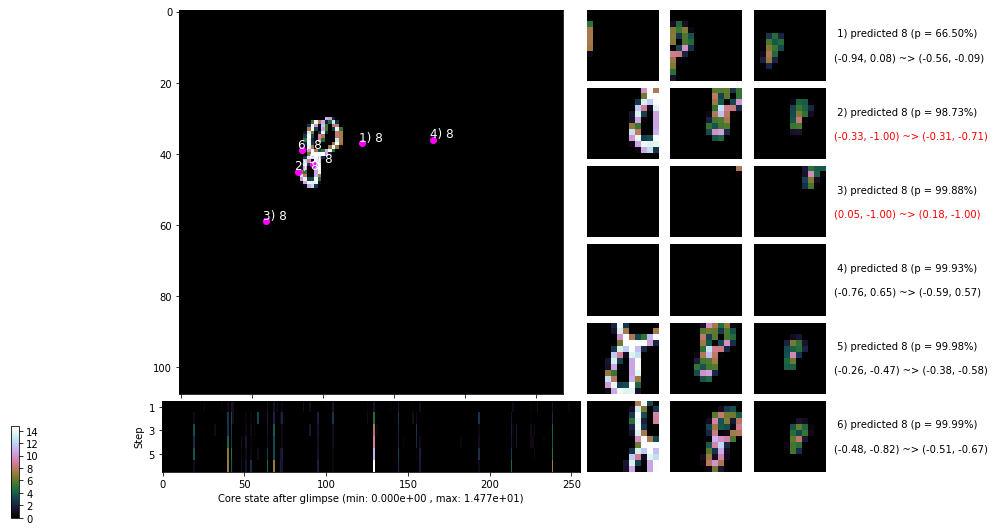

 b   2500/  4000 >> 107.0 ms/b | lr: 1.68e-04 | grad 2norm: 113.07 | grad inf norm: 23.348
       Weights || abs max:  3.34 ( 9620.98) | mean: -2.34e-02 ( 0.06) | var: 5.52e-02 (11426.26)
        Biases || abs max:  1.36 (  261.06) | mean: -1.91e-01 ( 0.41) | var: 7.24e-02 ( 1485.92)
                  class loss: 0.224 | steps: 2.232 | reward:  0.928 | acc.: 92.84%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.3 ms/b | lr: 1.67e-04 | grad 2norm: 850.98 | grad inf norm: 166.317
       Weights || abs max:  3.34 ( 3968.60) | mean: -2.34e-02 ( 0.04) | var: 5.52e-02 ( 2344.53)
        Biases || abs max:  1.37 (  565.62) | mean: -1.91e-01 ( 0.73) | var: 7.25e-02 (32328.38)
                  class loss: 0.198 | steps: 2.186 | reward:  0.935 | acc.: 93.47%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

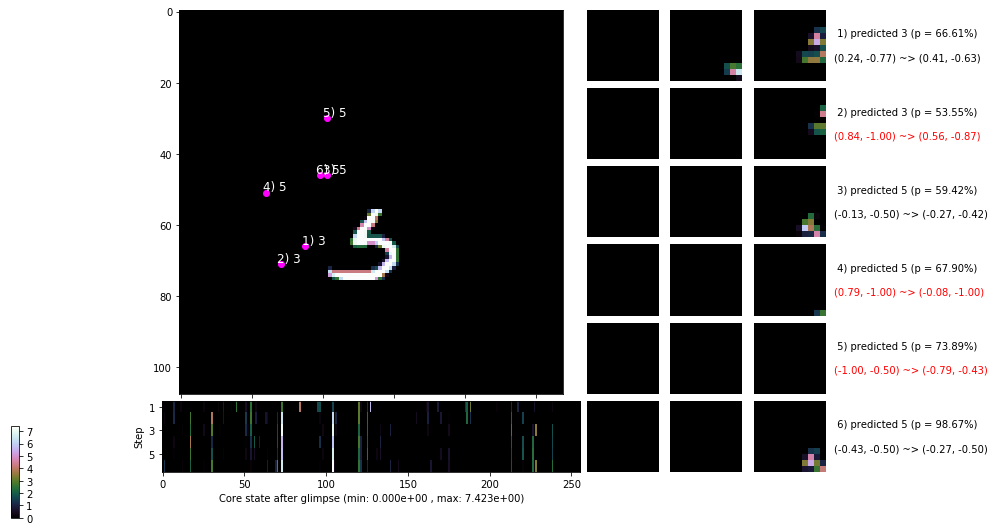

 b   3500/  4000 >> 105.7 ms/b | lr: 1.66e-04 | grad 2norm: 1857.99 | grad inf norm: 356.102
       Weights || abs max:  3.34 ( 6785.70) | mean: -2.33e-02 ( 0.05) | var: 5.52e-02 ( 3524.50)
        Biases || abs max:  1.37 (  158.04) | mean: -1.91e-01 ( 0.33) | var: 7.25e-02 (  308.27)
                  class loss: 0.213 | steps: 2.223 | reward:  0.933 | acc.: 93.29%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.8 ms/b | lr: 1.66e-04 | grad 2norm: 145.60 | grad inf norm: 31.328
       Weights || abs max:  3.34 ( 4588.15) | mean: -2.33e-02 ( 0.04) | var: 5.52e-02 ( 1308.76)
        Biases || abs max:  1.37 (  251.73) | mean: -1.91e-01 ( 0.46) | var: 7.26e-02 ( 1093.52)
                  class loss: 0.212 | steps: 2.238 | reward:  0.932 | acc.: 93.22%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 

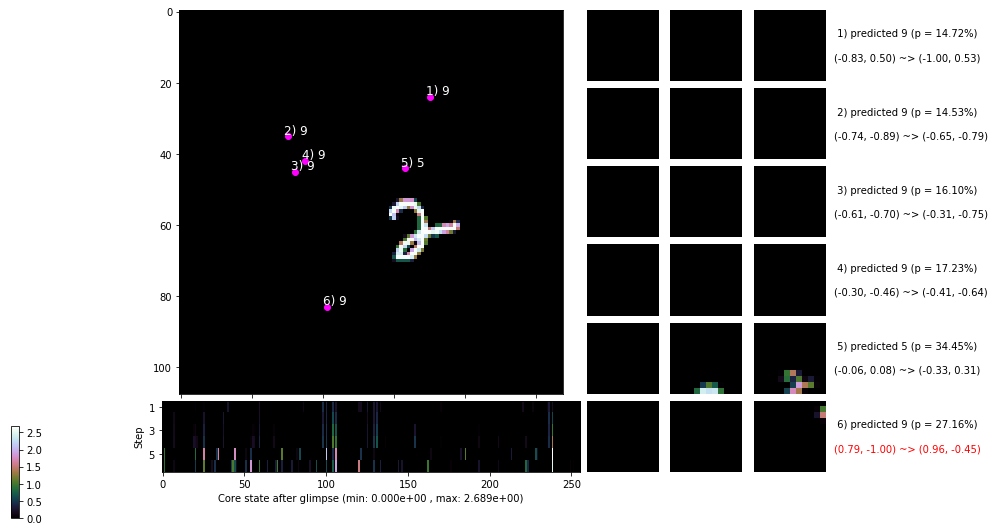

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


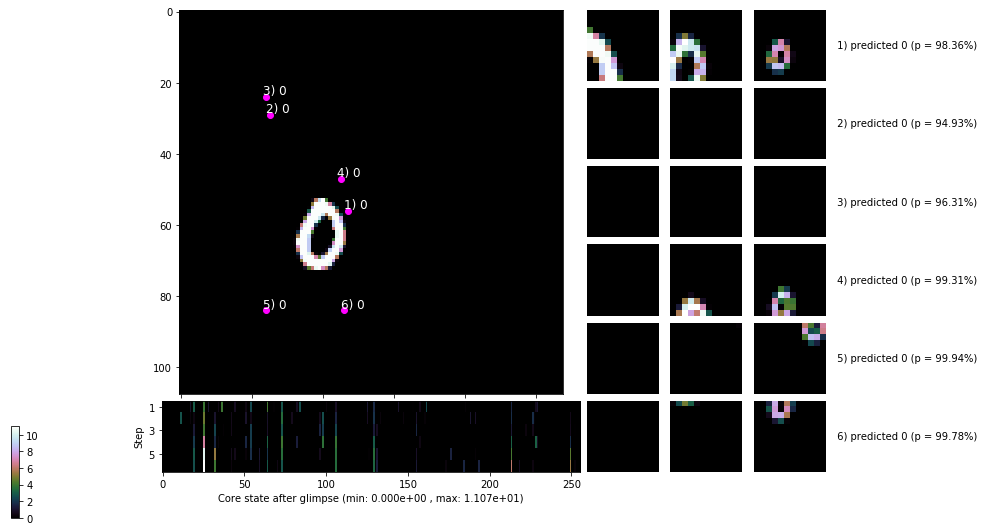


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


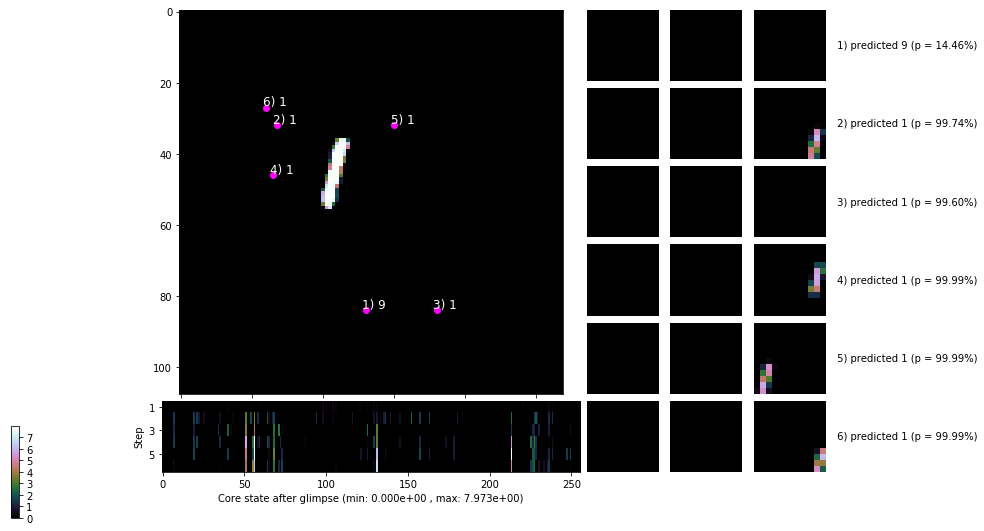

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


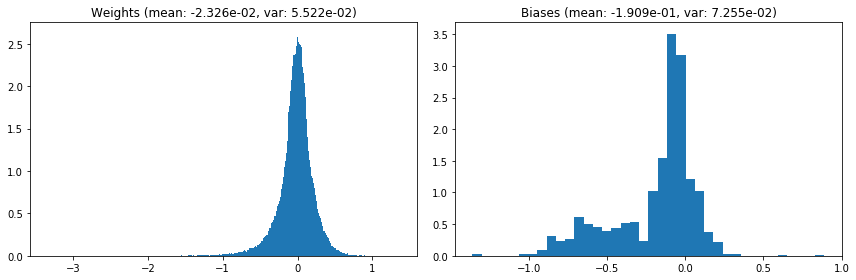

                                      Location network weights and biases


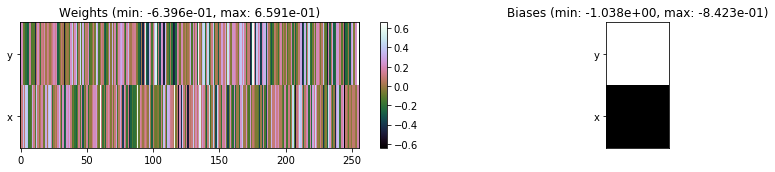

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.03 sec | TRAIN >> class loss: 0.2099 | steps:  2.205 :( | reward:  0.9327 :( | acc.: 93.273% :(
                          | VAL   >> class loss: 0.1890 | steps:  2.189 :( | reward:  0.9374 :( | acc.: 93.740% :(


Epoch  59/400) lr = 0.0001655
 b    500/  4000 >> 107.0 ms/b | lr: 1.65e-04 | grad 2norm: 219.84 | grad inf norm: 46.689
       Weights || abs max:  3.33 ( 5680.73) | mean: -2.33e-02 ( 0.04) | var: 5.52e-02 ( 2400.60)
        Biases || abs max:  1.36 (  328.21) | mean: -1.91e-01 ( 0.48) | var: 7.26e-02 ( 4729.38)
                  class loss: 0.210 | steps: 2.223 | reward:  0.932 | acc.: 93.16%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.7 ms/b | lr: 1.64e-04 | grad 2norm: 430.80 | grad inf norm: 78.553
       Weights || abs max:  3.33 ( 5024.32) | mean: -2.33e-02 ( 0.04)

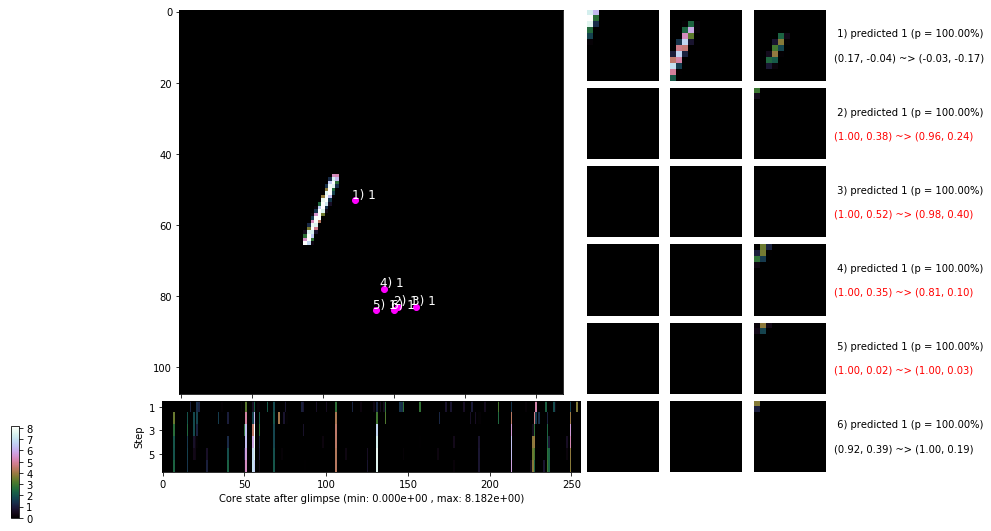

 b   1500/  4000 >> 107.3 ms/b | lr: 1.64e-04 | grad 2norm: 525.82 | grad inf norm: 104.487
       Weights || abs max:  3.34 (14145.17) | mean: -2.33e-02 ( 0.08) | var: 5.53e-02 (25409.05)
        Biases || abs max:  1.36 (  182.40) | mean: -1.91e-01 ( 0.31) | var: 7.28e-02 (  761.13)
                  class loss: 0.255 | steps: 2.232 | reward:  0.932 | acc.: 93.16%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.6 ms/b | lr: 1.63e-04 | grad 2norm: 630.33 | grad inf norm: 121.917
       Weights || abs max:  3.34 (41868.79) | mean: -2.33e-02 ( 0.19) | var: 5.53e-02 (1639019.88)
        Biases || abs max:  1.36 (  185.79) | mean: -1.91e-01 ( 0.33) | var: 7.29e-02 (  376.25)
                  class loss: 0.201 | steps: 2.189 | reward:  0.935 | acc.: 93.48%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0

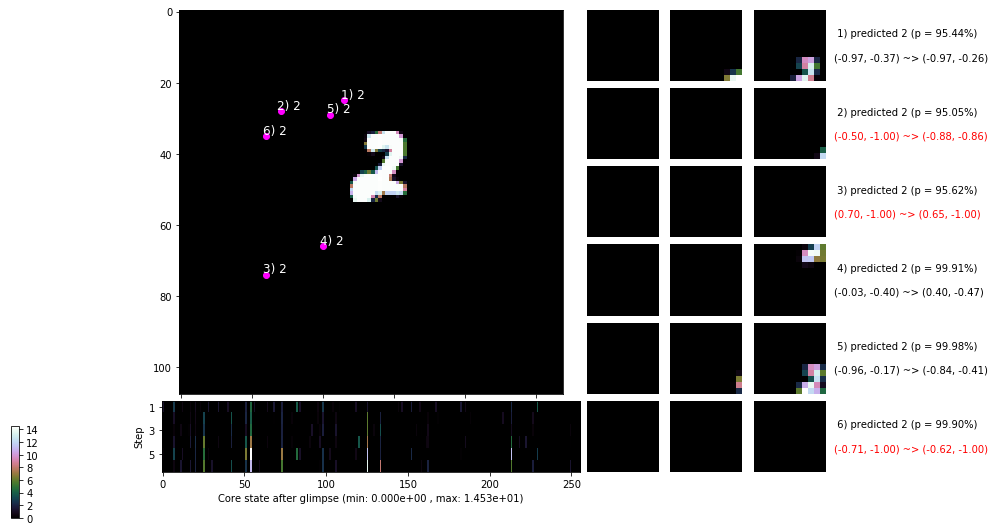

 b   2500/  4000 >> 103.2 ms/b | lr: 1.63e-04 | grad 2norm: 12.37 | grad inf norm:  4.296
       Weights || abs max:  3.34 ( 7651.88) | mean: -2.32e-02 ( 0.05) | var: 5.53e-02 (12588.22)
        Biases || abs max:  1.36 (  149.96) | mean: -1.91e-01 ( 0.27) | var: 7.30e-02 ( 1218.09)
                  class loss: 0.195 | steps: 2.162 | reward:  0.938 | acc.: 93.82%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.8 ms/b | lr: 1.62e-04 | grad 2norm: 19.95 | grad inf norm:  5.658
       Weights || abs max:  3.34 (10011.05) | mean: -2.32e-02 ( 0.07) | var: 5.53e-02 (30329.70)
        Biases || abs max:  1.36 (18835.74) | mean: -1.91e-01 (18.31) | var: 7.31e-02 (167985648.00)
                  class loss: 0.187 | steps: 2.196 | reward:  0.940 | acc.: 93.96%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

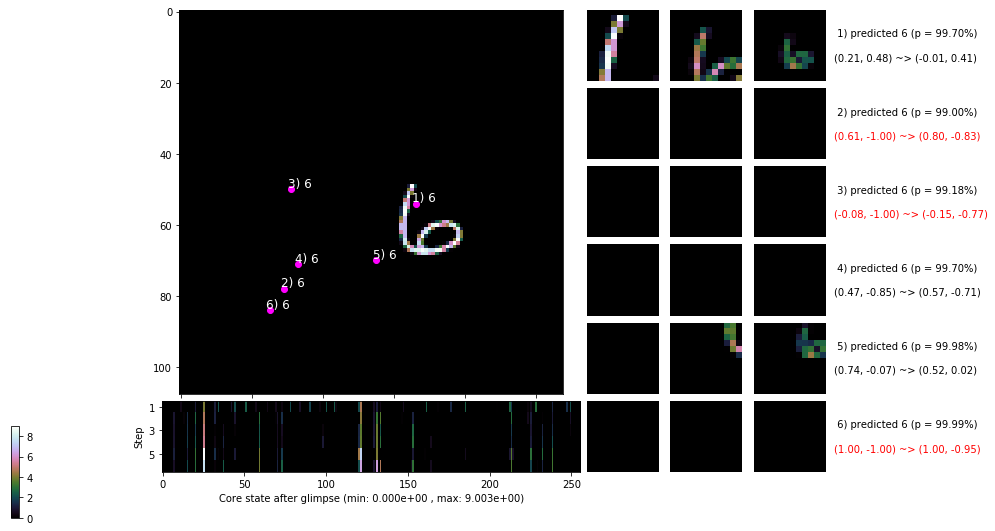

 b   3500/  4000 >> 103.2 ms/b | lr: 1.61e-04 | grad 2norm: 404.98 | grad inf norm: 76.012
       Weights || abs max:  3.34 ( 7301.08) | mean: -2.32e-02 ( 0.05) | var: 5.53e-02 ( 5287.83)
        Biases || abs max:  1.36 (  170.38) | mean: -1.92e-01 ( 0.30) | var: 7.33e-02 (  305.90)
                  class loss: 0.202 | steps: 2.210 | reward:  0.935 | acc.: 93.47%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.8 ms/b | lr: 1.61e-04 | grad 2norm: 104.99 | grad inf norm: 21.004
       Weights || abs max:  3.34 (13897.44) | mean: -2.32e-02 ( 0.08) | var: 5.54e-02 (35278.12)
        Biases || abs max:  1.36 (  393.07) | mean: -1.91e-01 ( 0.73) | var: 7.33e-02 (62059.37)
                  class loss: 0.199 | steps: 2.191 | reward:  0.936 | acc.: 93.59%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

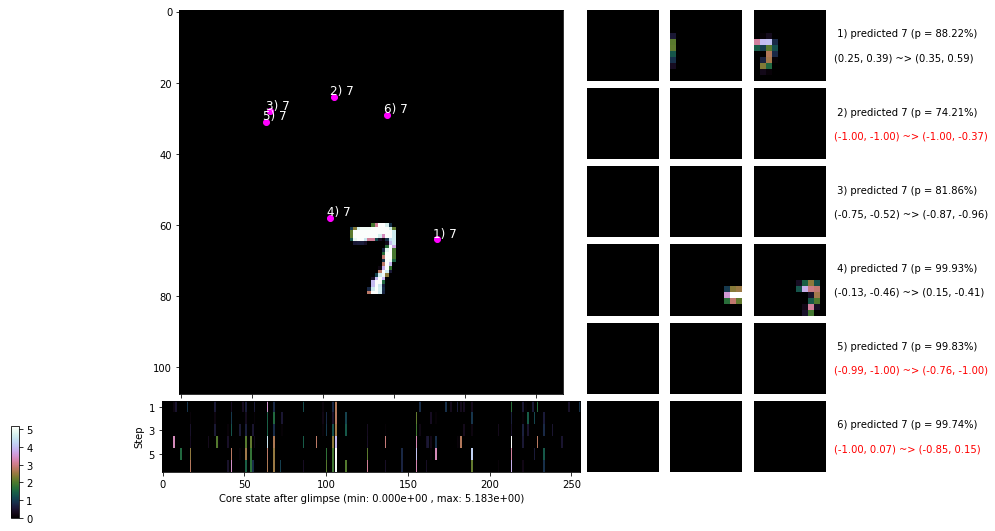

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


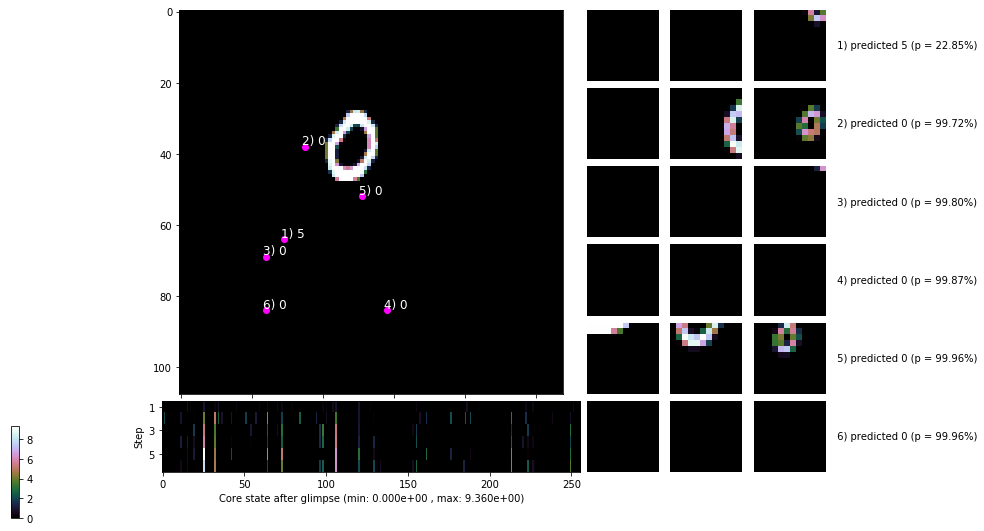


	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


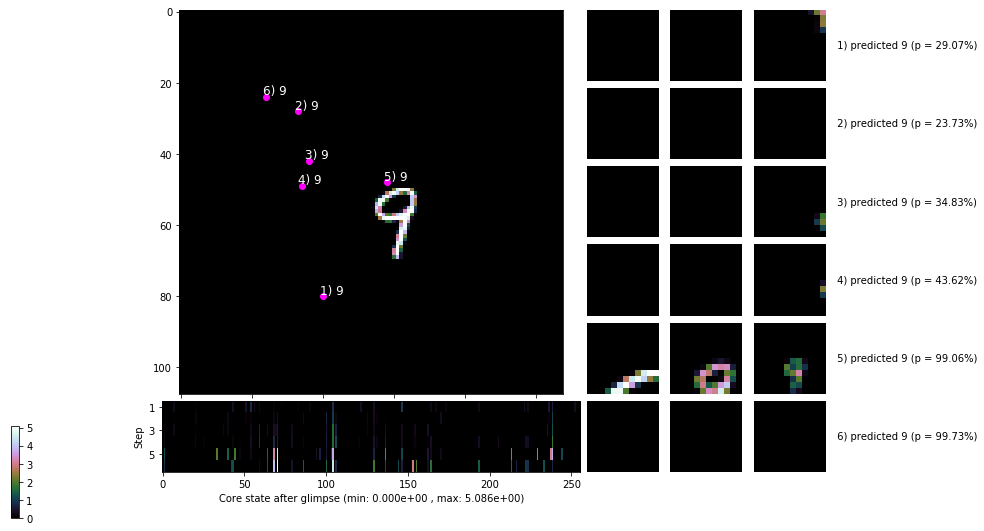

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


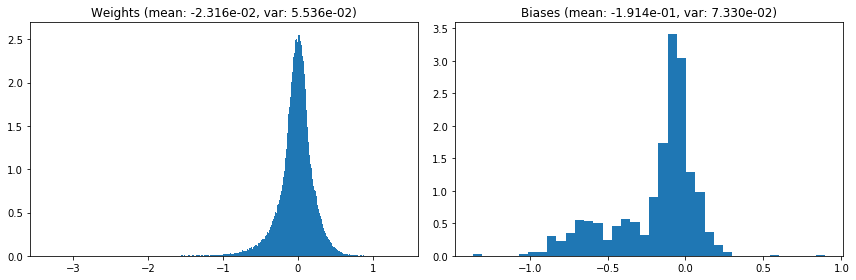

                                      Location network weights and biases


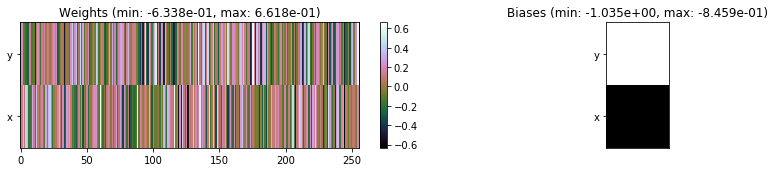

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.82 sec | TRAIN >> class loss: 0.2077 | steps:  2.207 :( | reward:  0.9346 :( | acc.: 93.463% :(
                          | VAL   >> class loss: 0.1817 | steps:  2.191 :( | reward:  0.9420    | acc.: 94.200% 


Epoch  60/400) lr = 0.0001604
 b    500/  4000 >> 106.1 ms/b | lr: 1.60e-04 | grad 2norm: 195.44 | grad inf norm: 41.689
       Weights || abs max:  3.34 ( 9207.63) | mean: -2.31e-02 ( 0.07) | var: 5.54e-02 ( 5347.16)
        Biases || abs max:  1.37 (  109.17) | mean: -1.91e-01 ( 0.24) | var: 7.33e-02 (  429.55)
                  class loss: 0.203 | steps: 2.172 | reward:  0.937 | acc.: 93.70%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 106.3 ms/b | lr: 1.59e-04 | grad 2norm: 66.16 | grad inf norm: 13.868
       Weights || abs max:  3.34 ( 6255.54) | mean: -2.31e-02 ( 0.05) | 

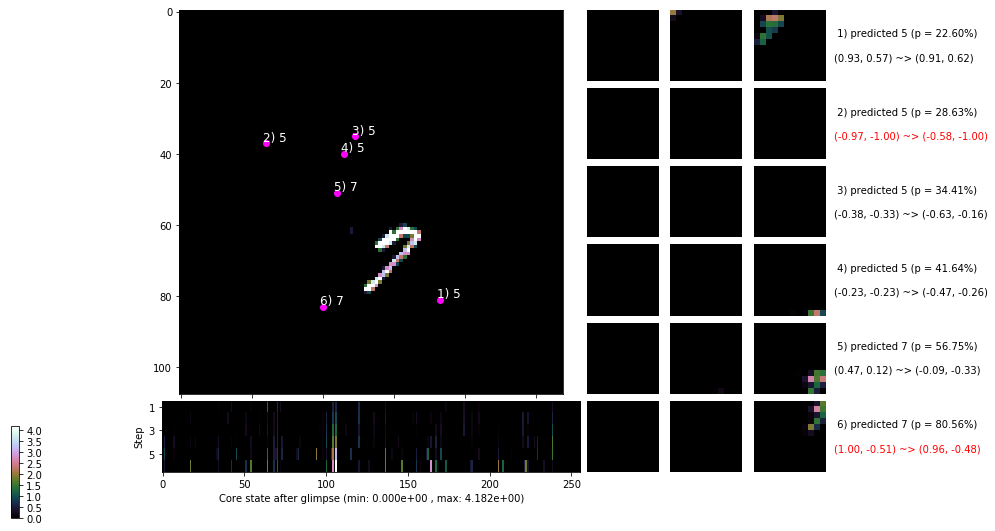

 b   1500/  4000 >> 106.1 ms/b | lr: 1.59e-04 | grad 2norm: 49.68 | grad inf norm: 11.766
       Weights || abs max:  3.34 ( 5502.38) | mean: -2.30e-02 ( 0.04) | var: 5.54e-02 ( 1623.10)
        Biases || abs max:  1.37 (   74.92) | mean: -1.91e-01 ( 0.21) | var: 7.33e-02 (  179.40)
                  class loss: 0.202 | steps: 2.163 | reward:  0.936 | acc.: 93.56%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 105.3 ms/b | lr: 1.58e-04 | grad 2norm: 95.17 | grad inf norm: 20.230
       Weights || abs max:  3.34 ( 8515.41) | mean: -2.29e-02 ( 0.06) | var: 5.54e-02 ( 7990.00)
        Biases || abs max:  1.37 (   80.12) | mean: -1.91e-01 ( 0.23) | var: 7.32e-02 (  251.86)
                  class loss: 0.192 | steps: 2.152 | reward:  0.940 | acc.: 94.00%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

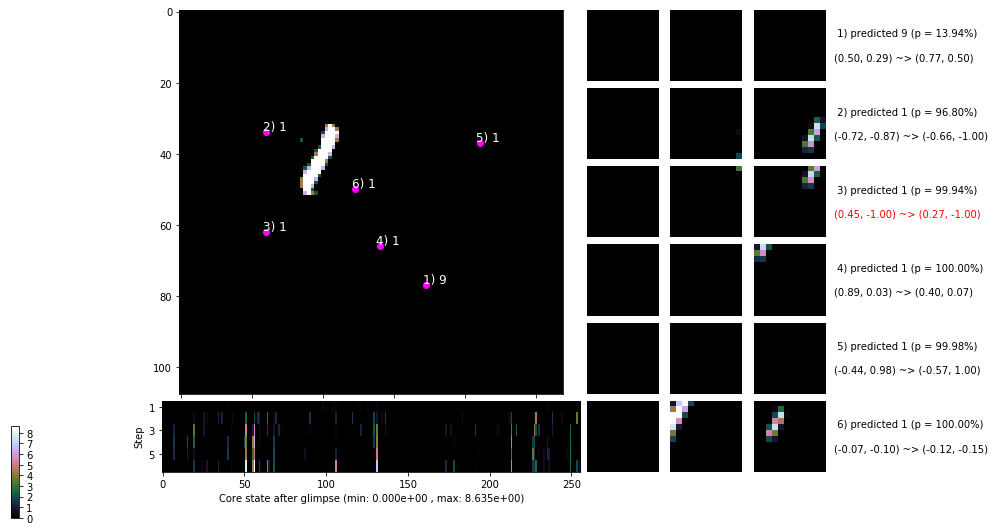

 b   2500/  4000 >> 106.8 ms/b | lr: 1.58e-04 | grad 2norm: 226.57 | grad inf norm: 43.172
       Weights || abs max:  3.34 ( 8031.79) | mean: -2.29e-02 ( 0.06) | var: 5.54e-02 ( 2714.99)
        Biases || abs max:  1.37 (   61.82) | mean: -1.91e-01 ( 0.17) | var: 7.33e-02 (  182.69)
                  class loss: 0.188 | steps: 2.129 | reward:  0.944 | acc.: 94.39%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.1 ms/b | lr: 1.57e-04 | grad 2norm: 2276.75 | grad inf norm: 415.787
       Weights || abs max:  3.35 ( 5116.50) | mean: -2.29e-02 ( 0.05) | var: 5.55e-02 (  980.08)
        Biases || abs max:  1.37 (   99.64) | mean: -1.92e-01 ( 0.25) | var: 7.35e-02 ( 1075.73)
                  class loss: 0.216 | steps: 2.183 | reward:  0.937 | acc.: 93.68%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

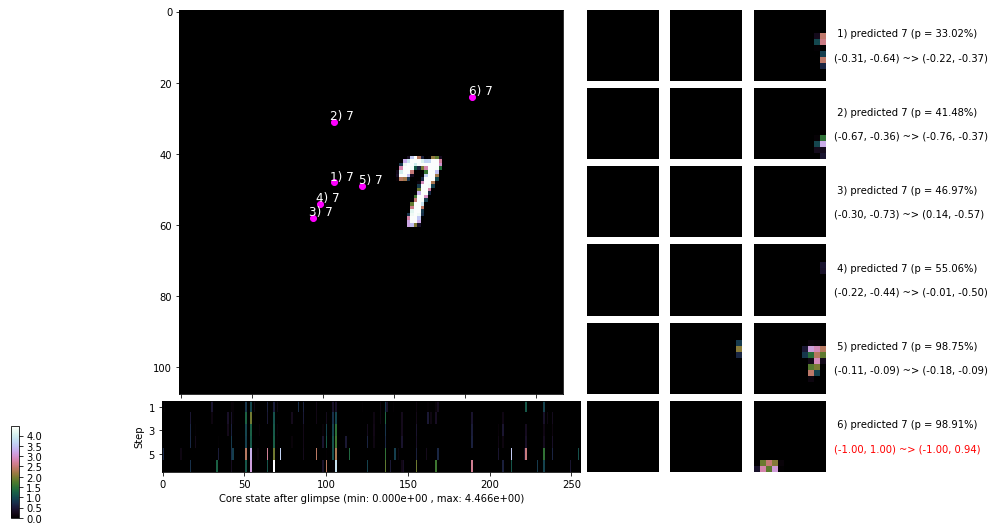

 b   3500/  4000 >> 105.7 ms/b | lr: 1.56e-04 | grad 2norm: 305.36 | grad inf norm: 60.581
       Weights || abs max:  3.36 (10116.24) | mean: -2.29e-02 ( 0.07) | var: 5.55e-02 (17183.57)
        Biases || abs max:  1.37 (  111.24) | mean: -1.92e-01 ( 0.19) | var: 7.35e-02 ( 2041.06)
                  class loss: 0.188 | steps: 2.140 | reward:  0.941 | acc.: 94.13%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 103.8 ms/b | lr: 1.56e-04 | grad 2norm: 504.70 | grad inf norm: 85.479
       Weights || abs max:  3.36 (19207.12) | mean: -2.29e-02 ( 0.10) | var: 5.55e-02 (108507.21)
        Biases || abs max:  1.37 (   40.26) | mean: -1.92e-01 ( 0.14) | var: 7.36e-02 (  112.58)
                  class loss: 0.248 | steps: 2.162 | reward:  0.936 | acc.: 93.63%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

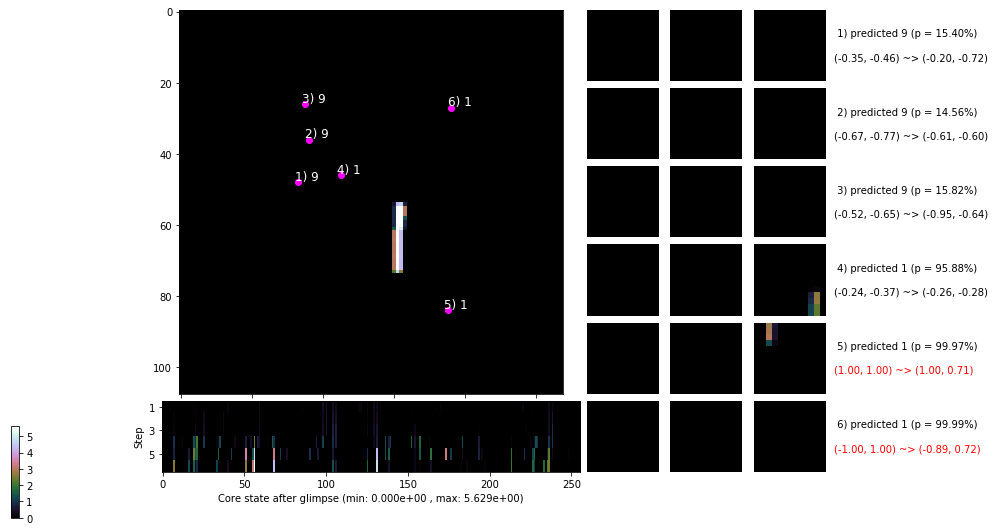

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


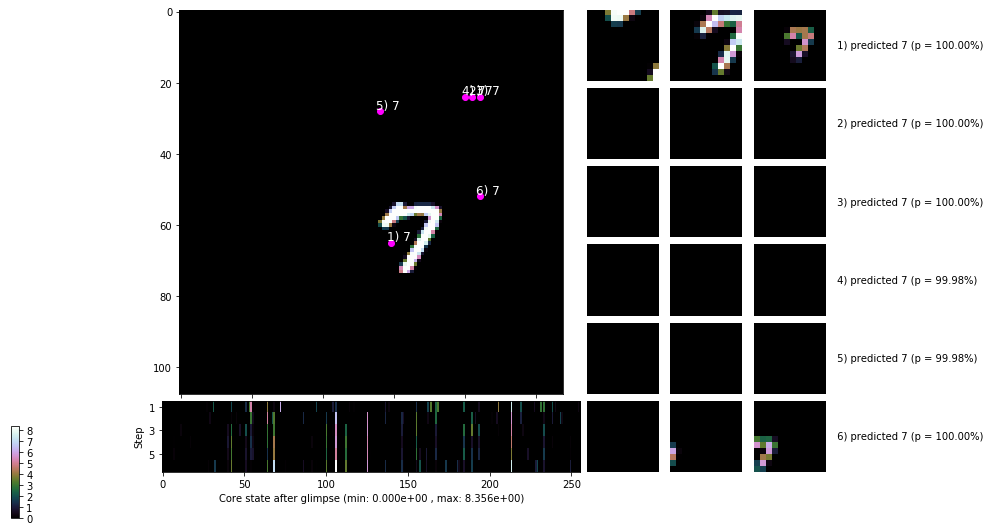


	Target class: 3  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


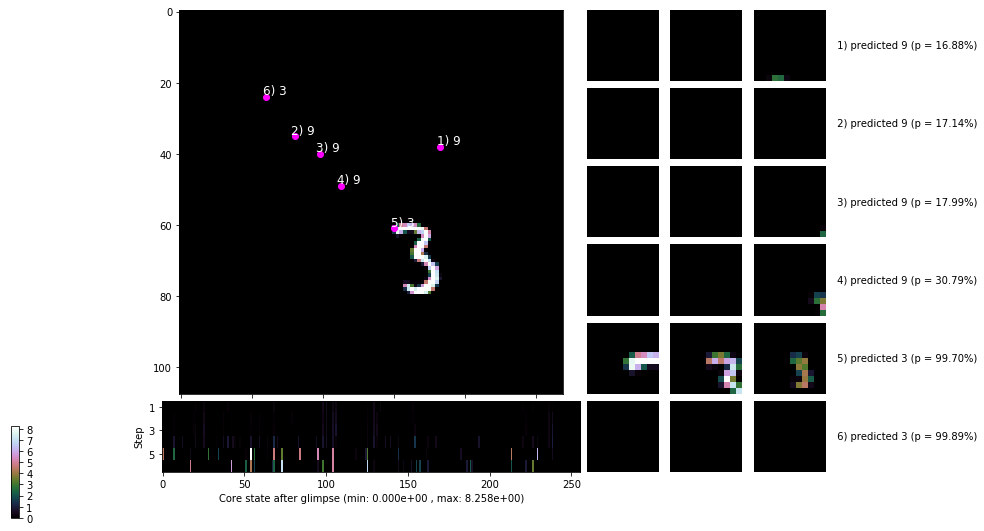

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


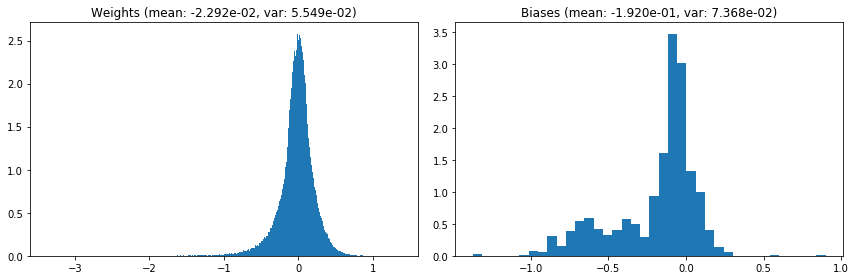

                                      Location network weights and biases


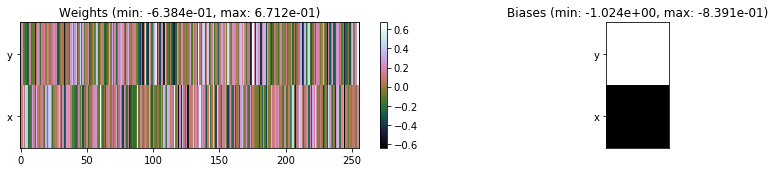

---------------------------------------------------------------------------------------------------------------
Elapsed time:  421.98 sec | TRAIN >> class loss: 0.2035 | steps:  2.157 :( | reward:  0.9386    | acc.: 93.863% 
                          | VAL   >> class loss: 0.1797 | steps:  2.146 :( | reward:  0.9444    | acc.: 94.440% 


Epoch  61/400) lr = 0.0001555
 b    500/  4000 >> 106.0 ms/b | lr: 1.55e-04 | grad 2norm: 435.14 | grad inf norm: 85.375
       Weights || abs max:  3.37 (150794.44) | mean: -2.29e-02 ( 0.62) | var: 5.55e-02 (38077500.00)
        Biases || abs max:  1.37 (  165.92) | mean: -1.92e-01 ( 0.27) | var: 7.37e-02 ( 1674.52)
                  class loss: 0.188 | steps: 2.159 | reward:  0.943 | acc.: 94.26%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 112.7 ms/b | lr: 1.54e-04 | grad 2norm: 14566.12 | grad inf norm: 2642.540
       Weights || abs max:  3.37 (27593.99) | mean: -2.28e-02 ( 0

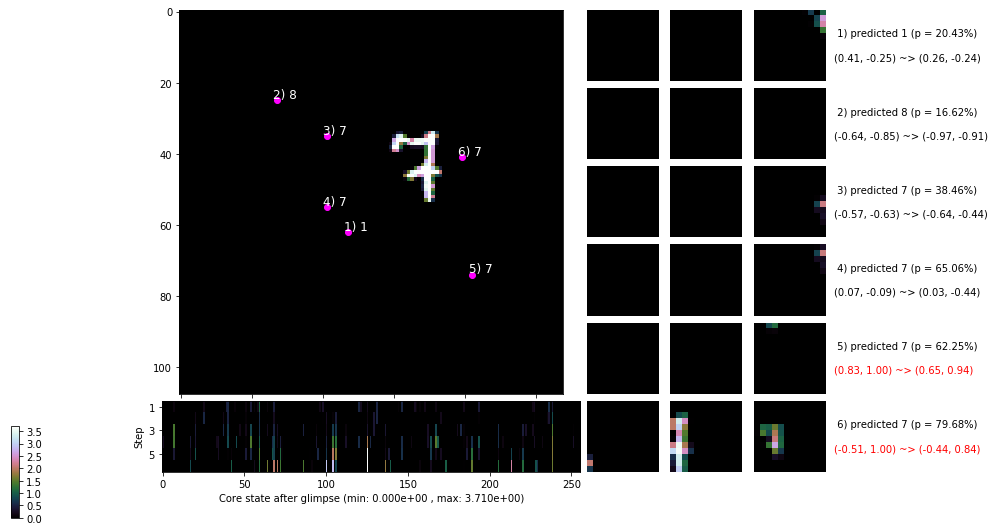

 b   1500/  4000 >> 105.9 ms/b | lr: 1.54e-04 | grad 2norm: 928.85 | grad inf norm: 180.997
       Weights || abs max:  3.37 (13400.21) | mean: -2.28e-02 ( 0.08) | var: 5.55e-02 (30146.21)
        Biases || abs max:  1.37 (   63.58) | mean: -1.92e-01 ( 0.19) | var: 7.36e-02 (   79.22)
                  class loss: 0.195 | steps: 2.186 | reward:  0.937 | acc.: 93.75%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.8 ms/b | lr: 1.53e-04 | grad 2norm: 25.71 | grad inf norm:  6.845
       Weights || abs max:  3.37 (12832.49) | mean: -2.28e-02 ( 0.08) | var: 5.55e-02 (18846.87)
        Biases || abs max:  1.38 (   78.45) | mean: -1.92e-01 ( 0.18) | var: 7.37e-02 (  243.61)
                  class loss: 0.194 | steps: 2.150 | reward:  0.940 | acc.: 93.97%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

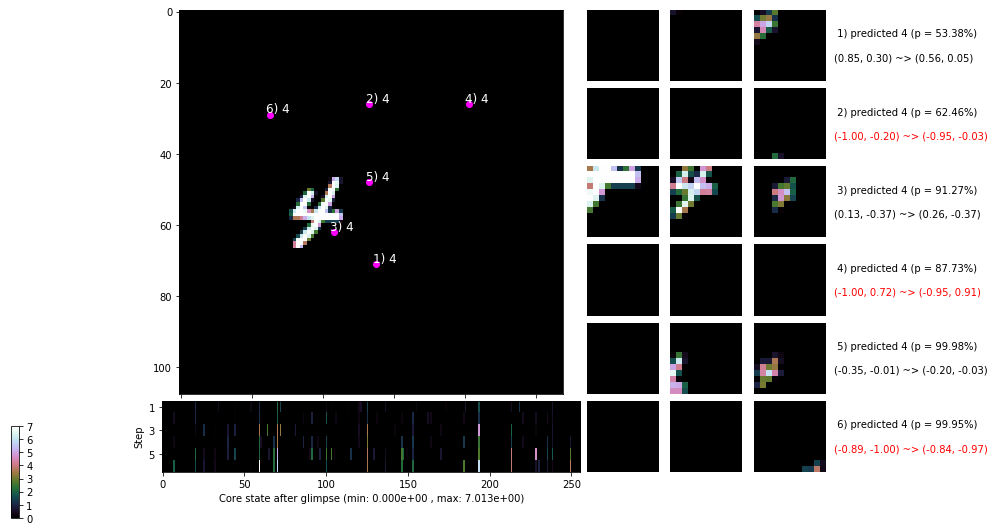

 b   2500/  4000 >> 105.3 ms/b | lr: 1.53e-04 | grad 2norm: 712.66 | grad inf norm: 145.846
       Weights || abs max:  3.37 ( 8598.01) | mean: -2.28e-02 ( 0.07) | var: 5.55e-02 ( 3495.63)
        Biases || abs max:  1.38 (  415.44) | mean: -1.92e-01 ( 0.83) | var: 7.39e-02 (96175.85)
                  class loss: 0.180 | steps: 2.122 | reward:  0.941 | acc.: 94.13%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 106.4 ms/b | lr: 1.52e-04 | grad 2norm: 696.35 | grad inf norm: 142.726
       Weights || abs max:  3.37 ( 9093.69) | mean: -2.28e-02 ( 0.06) | var: 5.56e-02 (13834.38)
        Biases || abs max:  1.38 (  171.46) | mean: -1.92e-01 ( 0.29) | var: 7.40e-02 (  922.58)
                  class loss: 0.195 | steps: 2.165 | reward:  0.938 | acc.: 93.75%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

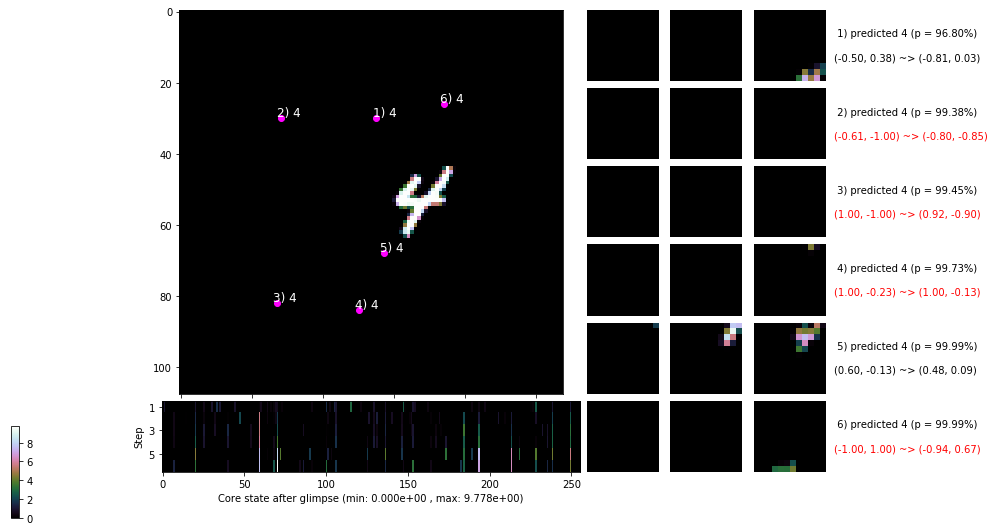

 b   3500/  4000 >> 107.5 ms/b | lr: 1.52e-04 | grad 2norm: 1369.96 | grad inf norm: 262.828
       Weights || abs max:  3.37 (11207.85) | mean: -2.28e-02 ( 0.07) | var: 5.56e-02 (19566.82)
        Biases || abs max:  1.38 (  120.84) | mean: -1.92e-01 ( 0.23) | var: 7.40e-02 ( 1229.05)
                  class loss: 0.190 | steps: 2.170 | reward:  0.940 | acc.: 94.01%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 105.2 ms/b | lr: 1.51e-04 | grad 2norm: 247.86 | grad inf norm: 53.679
       Weights || abs max:  3.38 (12208.47) | mean: -2.27e-02 ( 0.08) | var: 5.56e-02 (18193.69)
        Biases || abs max:  1.38 (   65.30) | mean: -1.92e-01 ( 0.15) | var: 7.40e-02 (  276.19)
                  class loss: 0.196 | steps: 2.177 | reward:  0.938 | acc.: 93.85%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

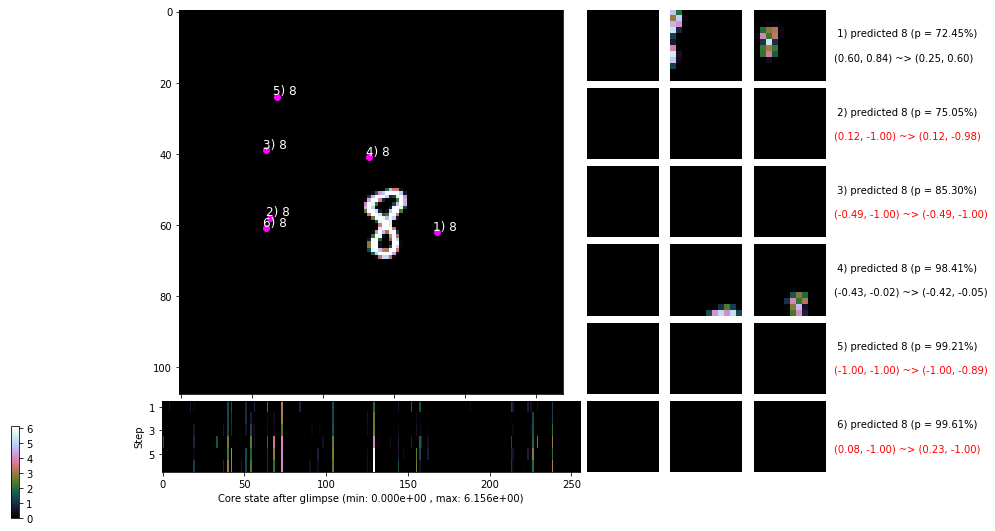

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


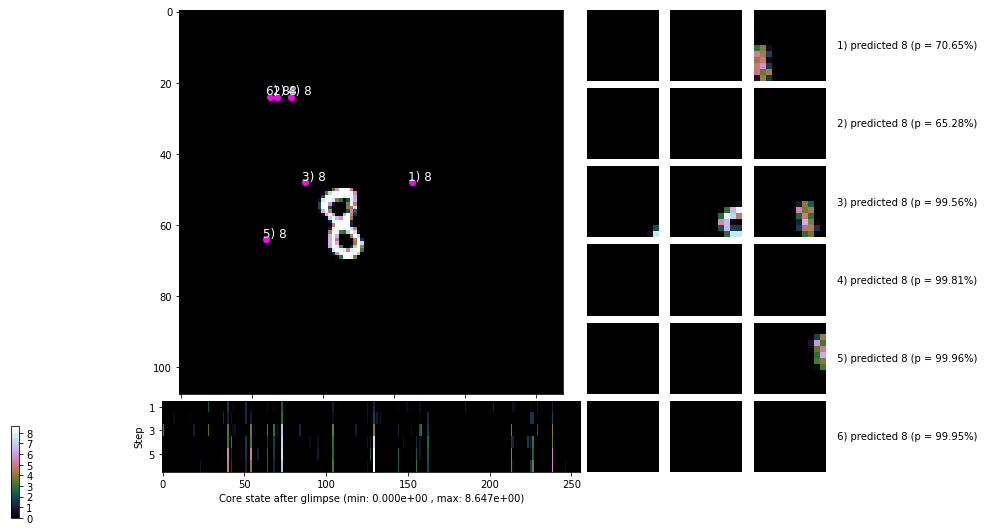


	Target class: 3  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


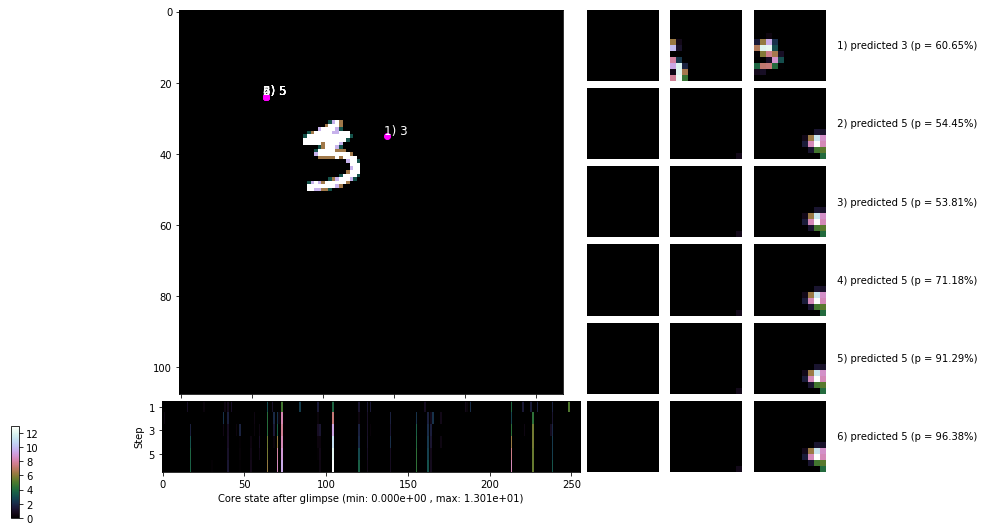

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


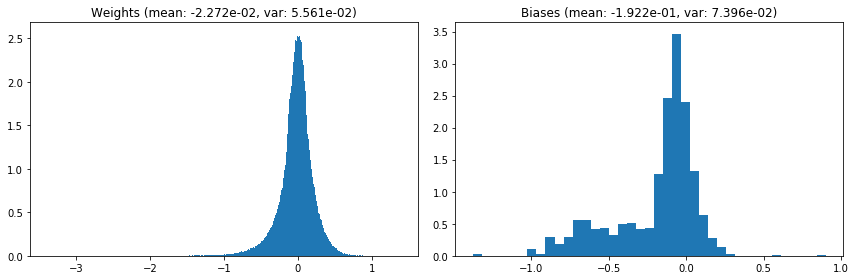

                                      Location network weights and biases


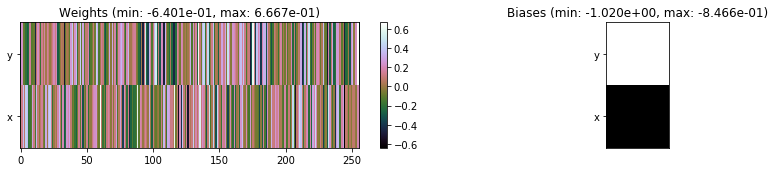

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.60 sec | TRAIN >> class loss: 0.1912 | steps:  2.162 :( | reward:  0.9395    | acc.: 93.947% 
                          | VAL   >> class loss: 0.1856 | steps:  2.135 :( | reward:  0.9414 :( | acc.: 94.140% :(


Epoch  62/400) lr = 0.0001508
 b    500/  4000 >> 102.4 ms/b | lr: 1.50e-04 | grad 2norm: 498.41 | grad inf norm: 101.475
       Weights || abs max:  3.38 ( 8449.81) | mean: -2.27e-02 ( 0.06) | var: 5.56e-02 (17940.45)
        Biases || abs max:  1.38 (   80.24) | mean: -1.92e-01 ( 0.17) | var: 7.39e-02 (  166.41)
                  class loss: 0.201 | steps: 2.179 | reward:  0.935 | acc.: 93.54%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.3 ms/b | lr: 1.50e-04 | grad 2norm: 1374.64 | grad inf norm: 278.458
       Weights || abs max:  3.38 (14493.40) | mean: -2.27e-02 ( 0.09

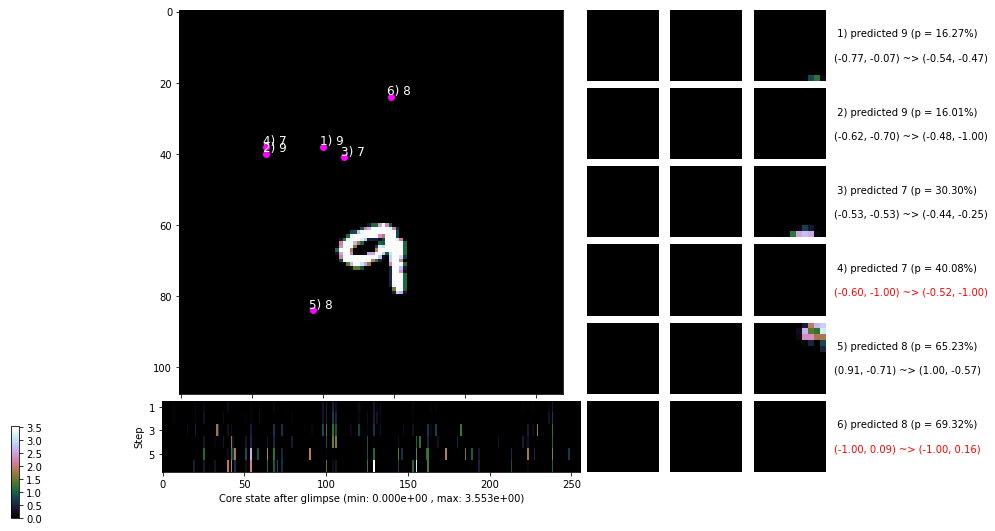

 b   1500/  4000 >> 103.7 ms/b | lr: 1.49e-04 | grad 2norm: 215.68 | grad inf norm: 45.564
       Weights || abs max:  3.38 (12789.62) | mean: -2.27e-02 ( 0.08) | var: 5.57e-02 (15318.13)
        Biases || abs max:  1.38 (   67.06) | mean: -1.92e-01 ( 0.16) | var: 7.40e-02 (   47.54)
                  class loss: 0.196 | steps: 2.167 | reward:  0.939 | acc.: 93.93%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 101.8 ms/b | lr: 1.49e-04 | grad 2norm: 1049.05 | grad inf norm: 212.119
       Weights || abs max:  3.37 ( 7622.48) | mean: -2.27e-02 ( 0.06) | var: 5.57e-02 ( 2966.63)
        Biases || abs max:  1.37 (  316.51) | mean: -1.92e-01 ( 0.47) | var: 7.39e-02 ( 8913.05)
                  class loss: 0.191 | steps: 2.172 | reward:  0.940 | acc.: 94.03%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

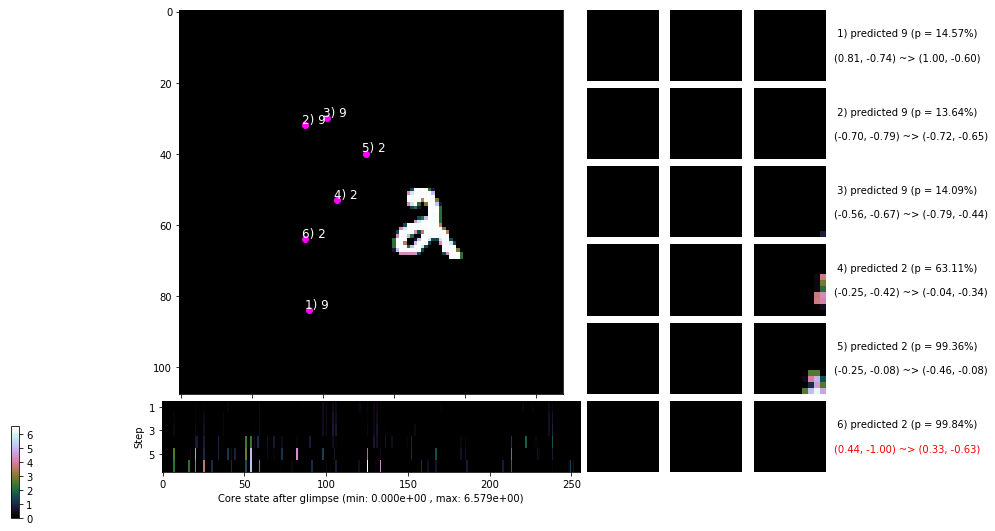

 b   2500/  4000 >> 104.8 ms/b | lr: 1.48e-04 | grad 2norm: 656.95 | grad inf norm: 135.816
       Weights || abs max:  3.37 ( 5569.36) | mean: -2.27e-02 ( 0.05) | var: 5.57e-02 (  588.85)
        Biases || abs max:  1.37 (  186.51) | mean: -1.92e-01 ( 0.30) | var: 7.41e-02 ( 1141.03)
                  class loss: 0.183 | steps: 2.163 | reward:  0.940 | acc.: 93.99%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 104.1 ms/b | lr: 1.47e-04 | grad 2norm: 971.33 | grad inf norm: 170.577
       Weights || abs max:  3.37 (10877.39) | mean: -2.26e-02 ( 0.07) | var: 5.57e-02 (15168.38)
        Biases || abs max:  1.37 (   57.50) | mean: -1.93e-01 ( 0.14) | var: 7.42e-02 (   23.56)
                  class loss: 0.195 | steps: 2.192 | reward:  0.938 | acc.: 93.81%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

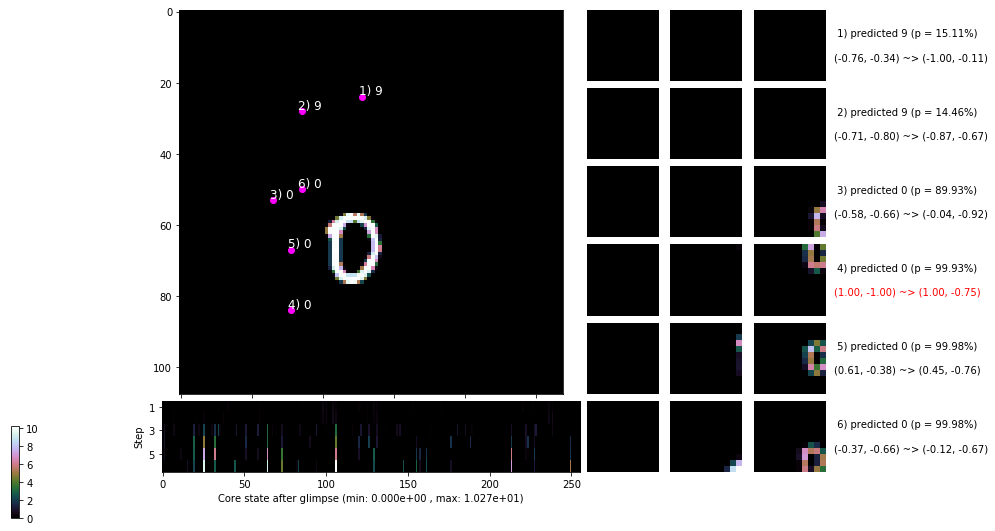

 b   3500/  4000 >> 106.8 ms/b | lr: 1.47e-04 | grad 2norm: 1879.17 | grad inf norm: 364.068
       Weights || abs max:  3.37 (23827.47) | mean: -2.26e-02 ( 0.12) | var: 5.57e-02 (384958.09)
        Biases || abs max:  1.36 (  192.31) | mean: -1.93e-01 ( 0.31) | var: 7.42e-02 (  782.96)
                  class loss: 0.187 | steps: 2.187 | reward:  0.941 | acc.: 94.05%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.2 ms/b | lr: 1.46e-04 | grad 2norm: 666.58 | grad inf norm: 125.947
       Weights || abs max:  3.37 (17716.00) | mean: -2.26e-02 ( 0.10) | var: 5.57e-02 (104019.34)
        Biases || abs max:  1.36 (  102.94) | mean: -1.93e-01 ( 0.24) | var: 7.42e-02 (  130.40)
                  class loss: 0.604 | steps: 2.182 | reward:  0.939 | acc.: 93.91%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.

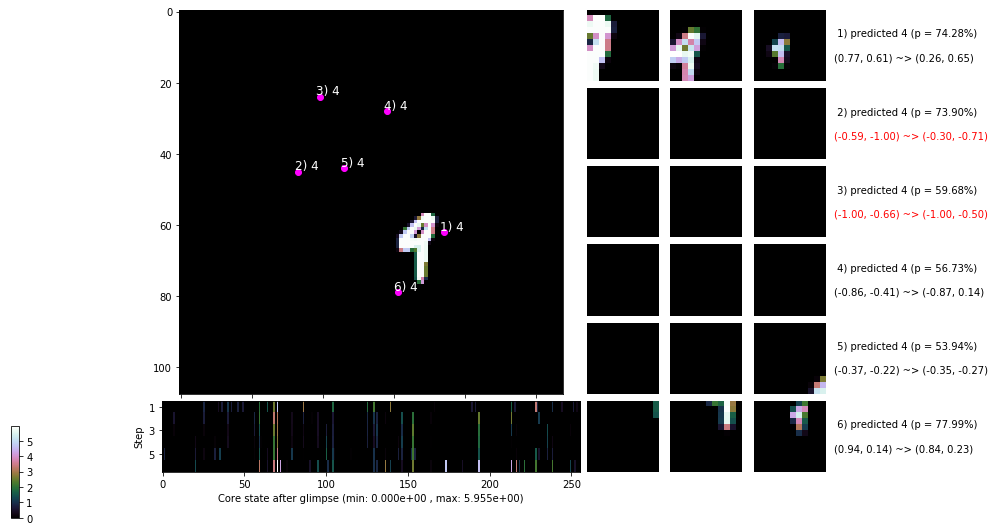

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


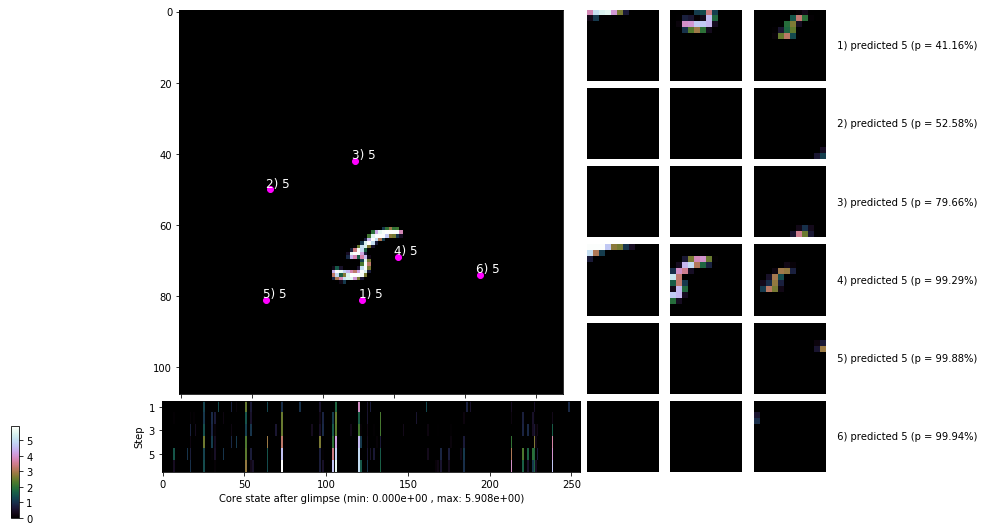


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


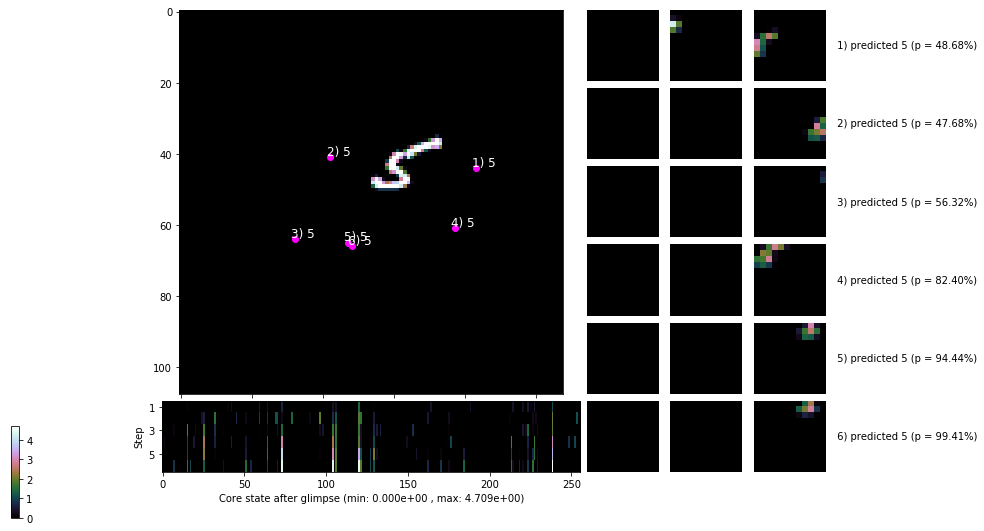

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


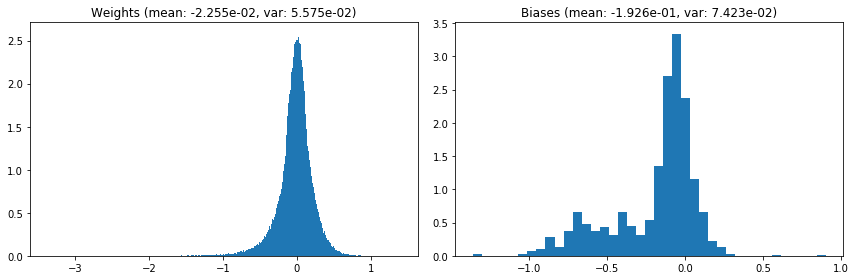

                                      Location network weights and biases


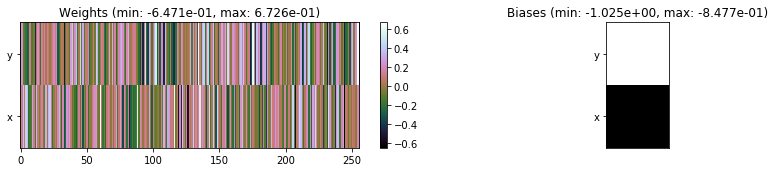

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.85 sec | TRAIN >> class loss: 0.2429 | steps:  2.176 :( | reward:  0.9390 :( | acc.: 93.899% :(
                          | VAL   >> class loss: 0.1803 | steps:  2.172 :( | reward:  0.9452    | acc.: 94.520% 


Epoch  63/400) lr = 0.0001462
 b    500/  4000 >> 103.7 ms/b | lr: 1.46e-04 | grad 2norm: 163.58 | grad inf norm: 33.068
       Weights || abs max:  3.37 (10344.75) | mean: -2.25e-02 ( 0.06) | var: 5.58e-02 (42152.13)
        Biases || abs max:  1.35 (  109.92) | mean: -1.93e-01 ( 0.22) | var: 7.43e-02 (  636.50)
                  class loss: 0.183 | steps: 2.160 | reward:  0.943 | acc.: 94.27%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 106.7 ms/b | lr: 1.45e-04 | grad 2norm: 287.93 | grad inf norm: 52.203
       Weights || abs max:  3.37 (16078.91) | mean: -2.26e-02 ( 0.09) |

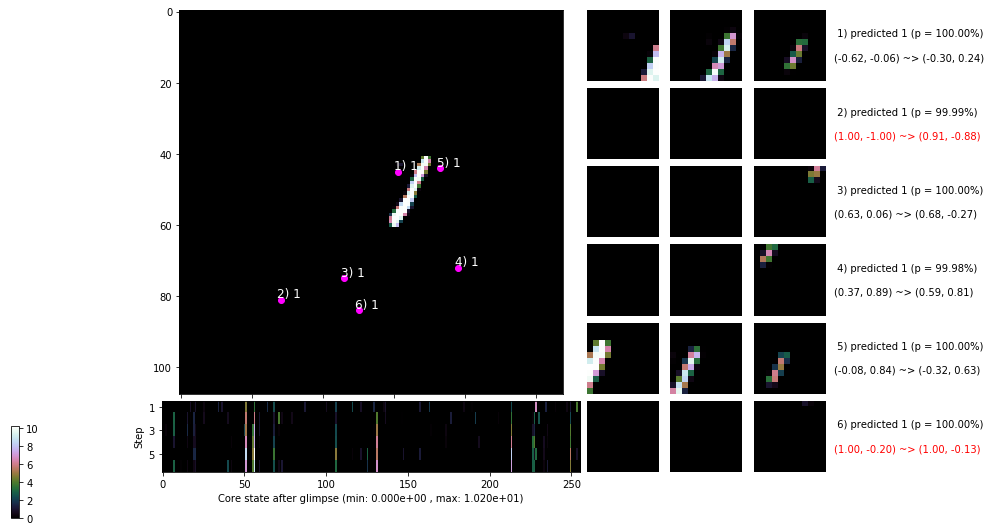

 b   1500/  4000 >> 104.2 ms/b | lr: 1.45e-04 | grad 2norm: 158.42 | grad inf norm: 34.654
       Weights || abs max:  3.37 ( 5388.14) | mean: -2.27e-02 ( 0.05) | var: 5.58e-02 ( 1894.78)
        Biases || abs max:  1.36 (  156.02) | mean: -1.93e-01 ( 0.25) | var: 7.46e-02 ( 1967.76)
                  class loss: 0.195 | steps: 2.194 | reward:  0.939 | acc.: 93.94%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.9 ms/b | lr: 1.44e-04 | grad 2norm: 19.31 | grad inf norm:  5.701
       Weights || abs max:  3.37 ( 7860.73) | mean: -2.27e-02 ( 0.06) | var: 5.58e-02 ( 5398.68)
        Biases || abs max:  1.36 (  107.95) | mean: -1.93e-01 ( 0.23) | var: 7.48e-02 (  283.43)
                  class loss: 0.194 | steps: 2.167 | reward:  0.939 | acc.: 93.91%
                 --------------------------------------------------------------------------------

	Target class: 2 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

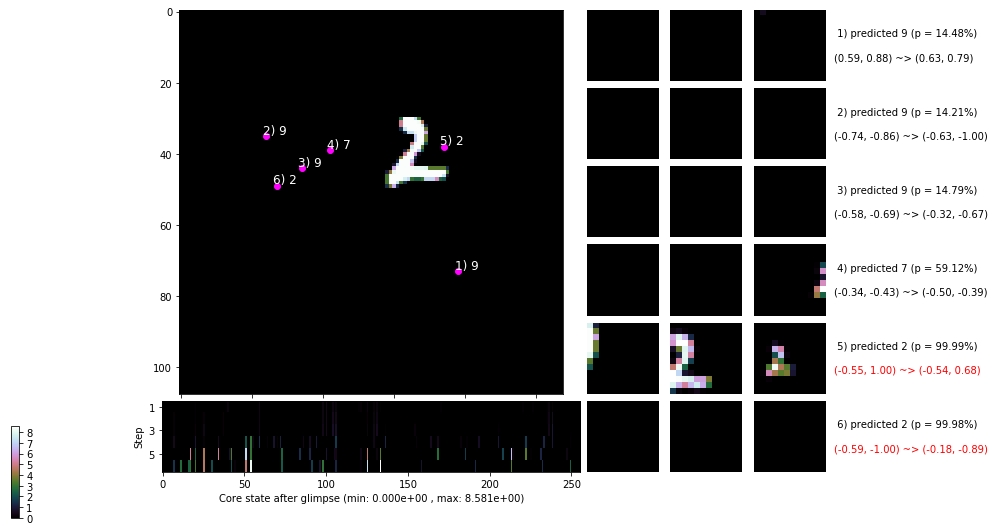

 b   2500/  4000 >> 110.5 ms/b | lr: 1.44e-04 | grad 2norm: 45.07 | grad inf norm: 11.282
       Weights || abs max:  3.37 (66487.94) | mean: -2.27e-02 ( 0.28) | var: 5.58e-02 (4684491.00)
        Biases || abs max:  1.36 (  267.03) | mean: -1.93e-01 ( 0.37) | var: 7.50e-02 (13686.24)
                  class loss: 0.187 | steps: 2.165 | reward:  0.942 | acc.: 94.17%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 109.5 ms/b | lr: 1.43e-04 | grad 2norm: 121.82 | grad inf norm: 24.069
       Weights || abs max:  3.38 ( 5996.16) | mean: -2.27e-02 ( 0.05) | var: 5.58e-02 ( 7994.92)
        Biases || abs max:  1.36 (   69.01) | mean: -1.94e-01 ( 0.17) | var: 7.50e-02 (  264.78)
                  class loss: 0.183 | steps: 2.170 | reward:  0.944 | acc.: 94.37%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

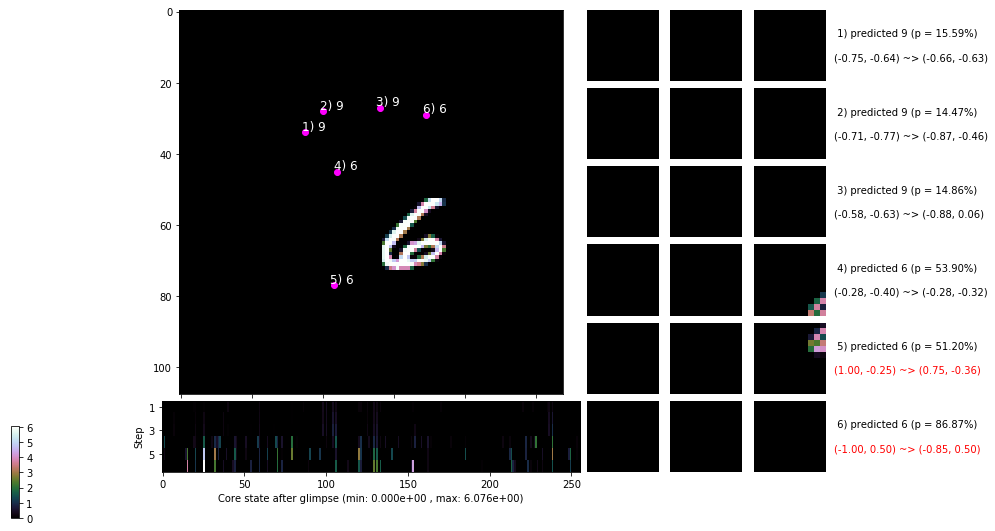

 b   3500/  4000 >> 115.2 ms/b | lr: 1.42e-04 | grad 2norm: 29.91 | grad inf norm:  7.281
       Weights || abs max:  3.38 (18267.72) | mean: -2.28e-02 ( 0.10) | var: 5.58e-02 (98220.78)
        Biases || abs max:  1.36 (  129.29) | mean: -1.94e-01 ( 0.30) | var: 7.52e-02 (  671.76)
                  class loss: 0.198 | steps: 2.165 | reward:  0.941 | acc.: 94.06%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 111.9 ms/b | lr: 1.42e-04 | grad 2norm: 16.12 | grad inf norm:  5.336
       Weights || abs max:  3.38 (24679.11) | mean: -2.28e-02 ( 0.12) | var: 5.58e-02 (502384.94)
        Biases || abs max:  1.36 (   52.66) | mean: -1.94e-01 ( 0.16) | var: 7.53e-02 (   23.76)
                  class loss: 0.188 | steps: 2.162 | reward:  0.941 | acc.: 94.07%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

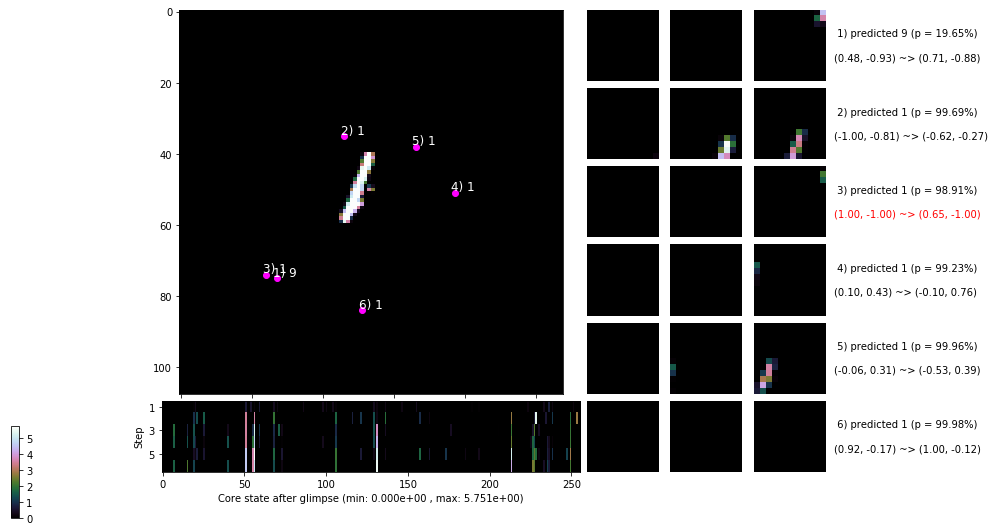

                                          ---===  VALIDATION  ===---

	Target class: 9  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


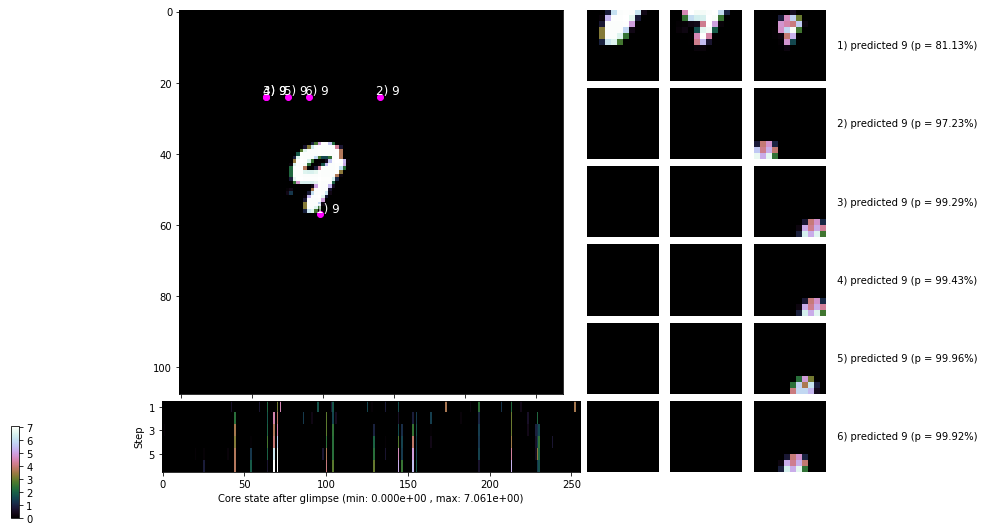


	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


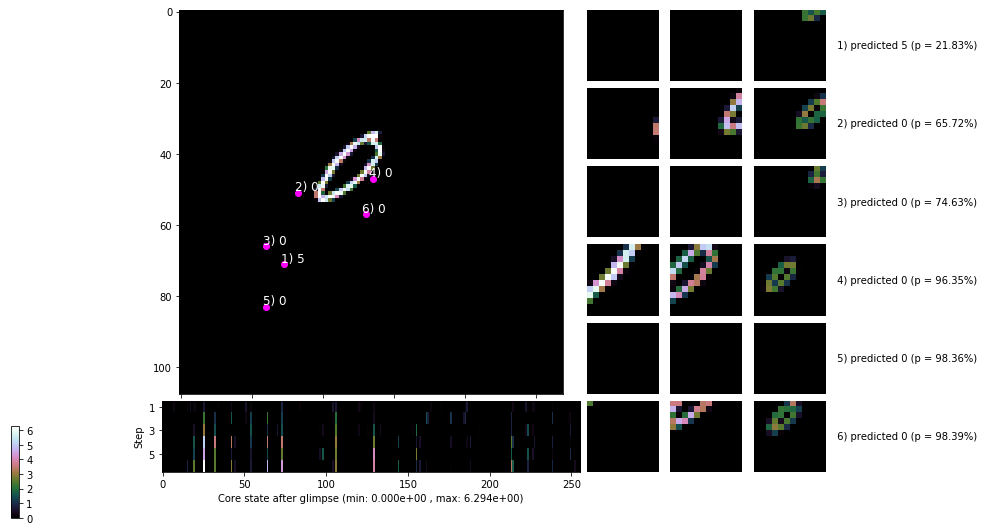

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


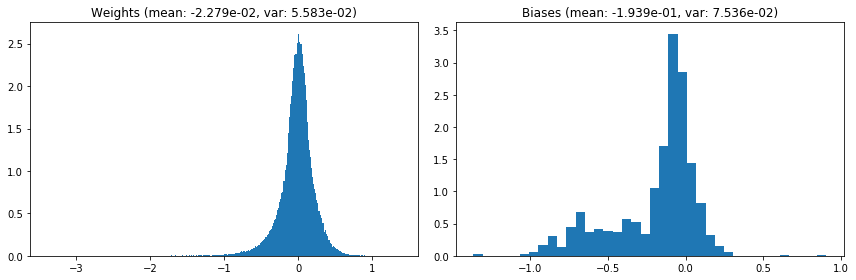

                                      Location network weights and biases


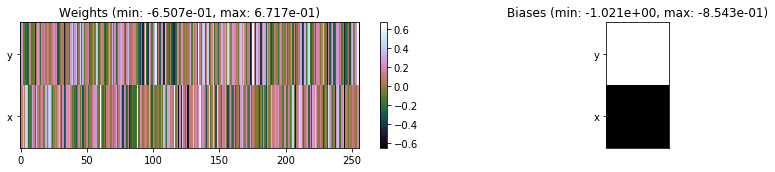

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.70 sec | TRAIN >> class loss: 0.2214 | steps:  2.167 :( | reward:  0.9411    | acc.: 94.109% 
                          | VAL   >> class loss: 0.1698 | steps:  2.089    | reward:  0.9468    | acc.: 94.680% 


Epoch  64/400) lr = 0.0001417
 b    500/  4000 >> 109.8 ms/b | lr: 1.41e-04 | grad 2norm: 27.63 | grad inf norm:  7.658
       Weights || abs max:  3.39 ( 7839.11) | mean: -2.28e-02 ( 0.06) | var: 5.58e-02 ( 2177.58)
        Biases || abs max:  1.37 (   85.59) | mean: -1.94e-01 ( 0.17) | var: 7.54e-02 (  158.23)
                  class loss: 0.191 | steps: 2.171 | reward:  0.940 | acc.: 94.01%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 109.5 ms/b | lr: 1.41e-04 | grad 2norm: 10.29 | grad inf norm:  3.738
       Weights || abs max:  3.39 ( 5533.44) | mean: -2.28e-02 ( 0.05) | var

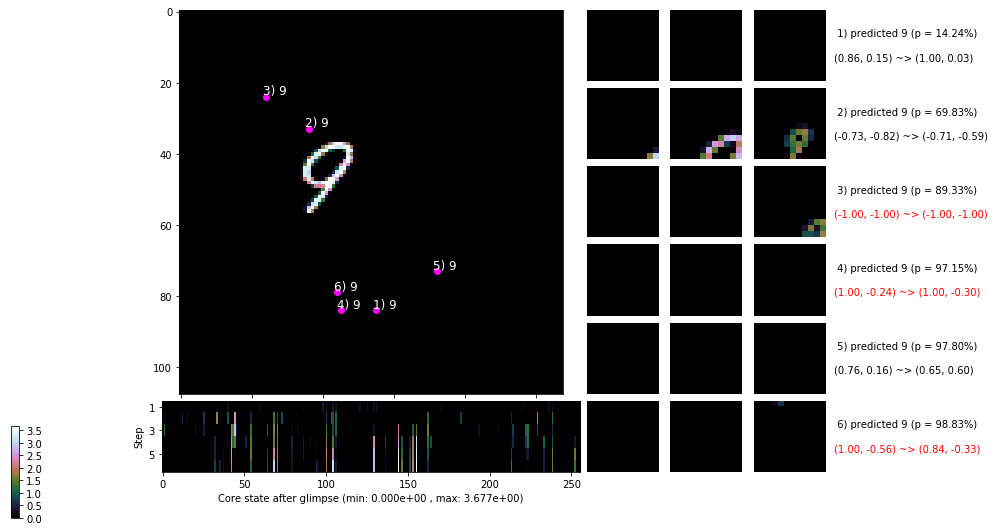

 b   1500/  4000 >> 108.7 ms/b | lr: 1.40e-04 | grad 2norm: 13.82 | grad inf norm:  4.516
       Weights || abs max:  3.39 (12135.45) | mean: -2.28e-02 ( 0.07) | var: 5.59e-02 (60880.46)
        Biases || abs max:  1.36 (  120.28) | mean: -1.94e-01 ( 0.22) | var: 7.56e-02 (  281.34)
                  class loss: 0.188 | steps: 2.174 | reward:  0.941 | acc.: 94.09%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 106.1 ms/b | lr: 1.40e-04 | grad 2norm: 55.63 | grad inf norm: 13.231
       Weights || abs max:  3.39 ( 6309.19) | mean: -2.27e-02 ( 0.05) | var: 5.59e-02 ( 2686.86)
        Biases || abs max:  1.36 (  177.66) | mean: -1.94e-01 ( 0.35) | var: 7.56e-02 ( 1335.68)
                  class loss: 0.179 | steps: 2.186 | reward:  0.942 | acc.: 94.16%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

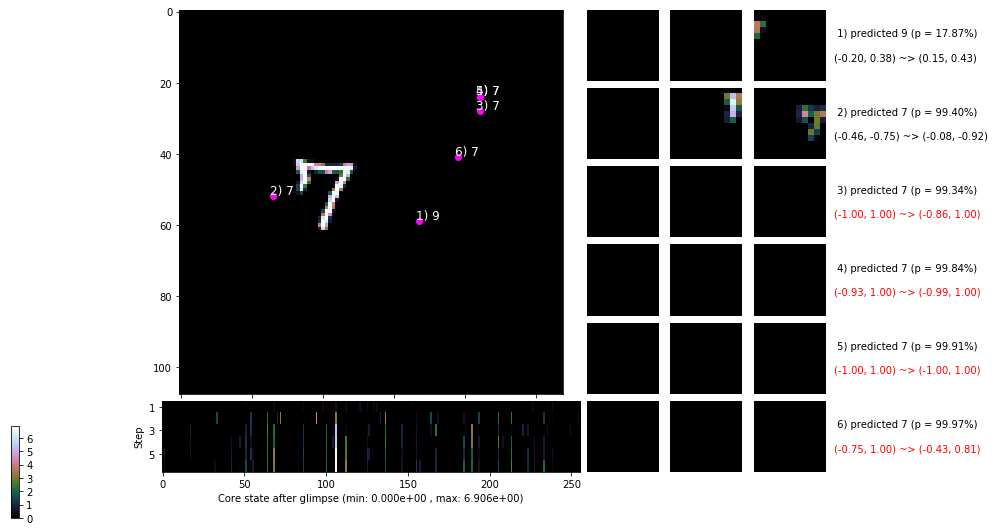

 b   2500/  4000 >> 109.7 ms/b | lr: 1.39e-04 | grad 2norm: 117.43 | grad inf norm: 27.321
       Weights || abs max:  3.39 ( 6387.16) | mean: -2.27e-02 ( 0.05) | var: 5.59e-02 ( 3739.78)
        Biases || abs max:  1.36 (  261.39) | mean: -1.94e-01 ( 0.37) | var: 7.56e-02 (11373.32)
                  class loss: 0.186 | steps: 2.178 | reward:  0.941 | acc.: 94.11%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 106.2 ms/b | lr: 1.39e-04 | grad 2norm: 534.91 | grad inf norm: 106.500
       Weights || abs max:  3.39 (24183.03) | mean: -2.27e-02 ( 0.12) | var: 5.59e-02 (514283.50)
        Biases || abs max:  1.37 (   91.62) | mean: -1.94e-01 ( 0.19) | var: 7.57e-02 (  214.86)
                  class loss: 0.196 | steps: 2.174 | reward:  0.938 | acc.: 93.77%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

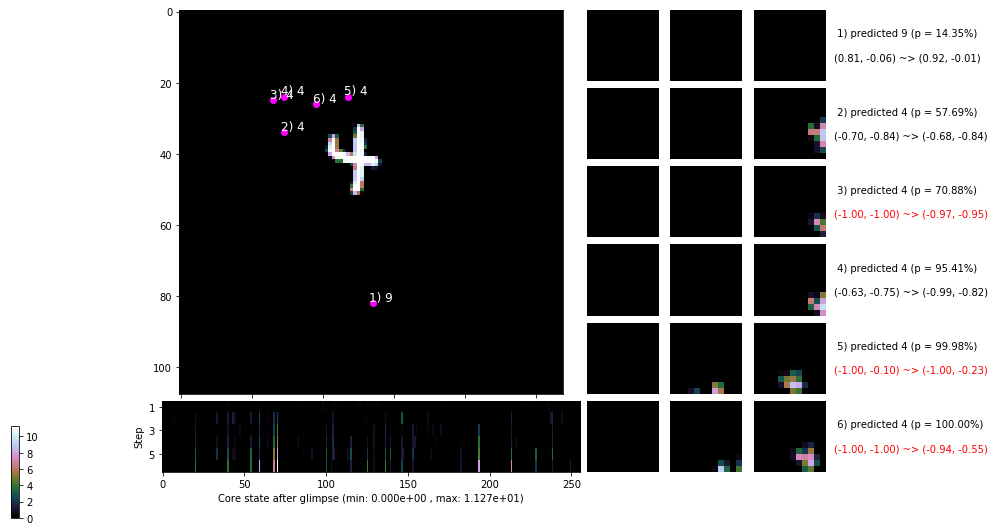

 b   3500/  4000 >> 111.1 ms/b | lr: 1.38e-04 | grad 2norm: 540.74 | grad inf norm: 114.693
       Weights || abs max:  3.38 (23986.90) | mean: -2.27e-02 ( 0.12) | var: 5.59e-02 (350292.78)
        Biases || abs max:  1.36 (  149.22) | mean: -1.94e-01 ( 0.25) | var: 7.56e-02 (  850.97)
                  class loss: 0.185 | steps: 2.199 | reward:  0.942 | acc.: 94.21%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 107.0 ms/b | lr: 1.38e-04 | grad 2norm: 44.34 | grad inf norm: 11.031
       Weights || abs max:  3.39 ( 6621.64) | mean: -2.26e-02 ( 0.05) | var: 5.59e-02 ( 3897.91)
        Biases || abs max:  1.37 (   62.25) | mean: -1.94e-01 ( 0.16) | var: 7.57e-02 (   53.88)
                  class loss: 0.184 | steps: 2.181 | reward:  0.942 | acc.: 94.22%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0

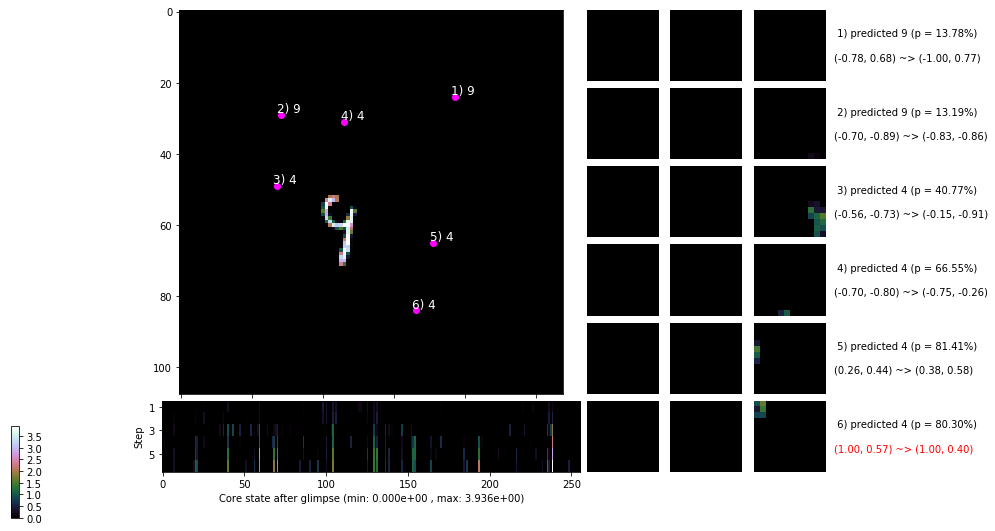

                                          ---===  VALIDATION  ===---

	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


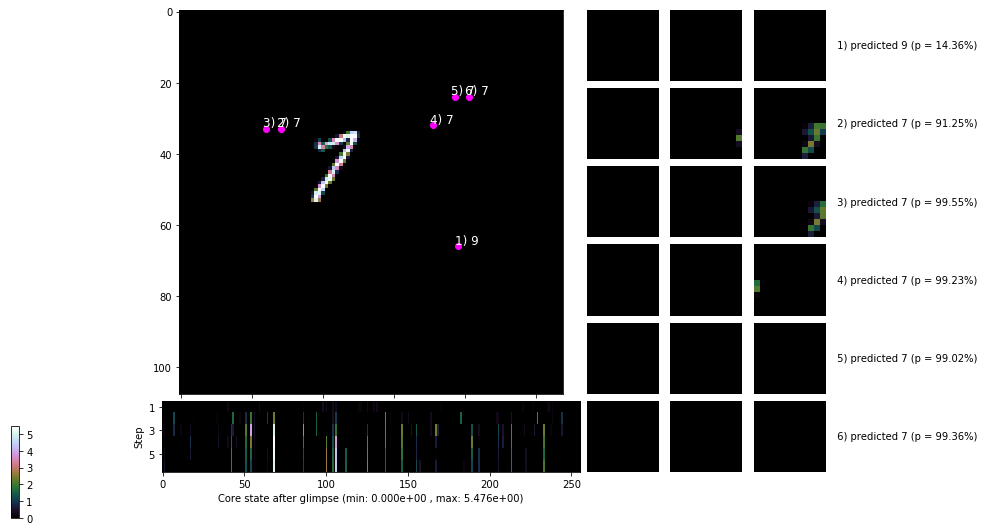


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


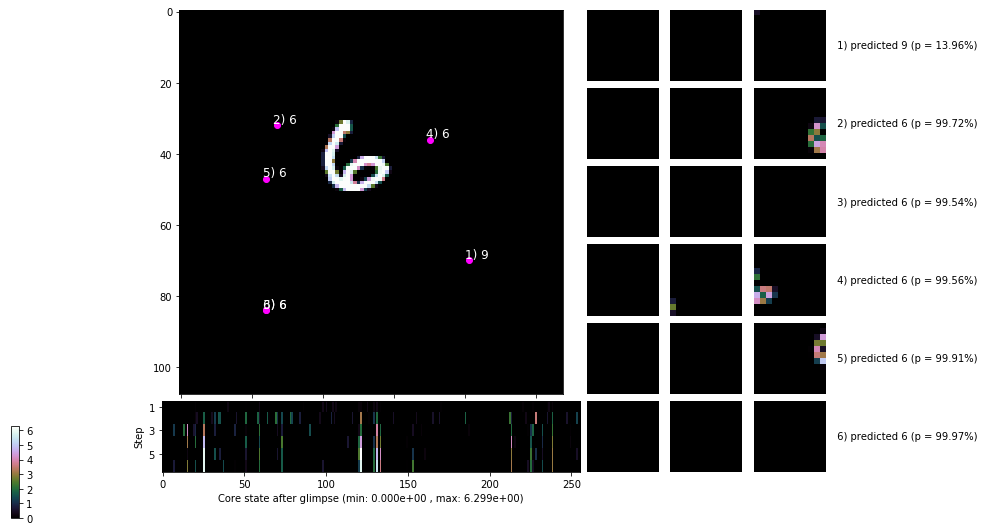

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


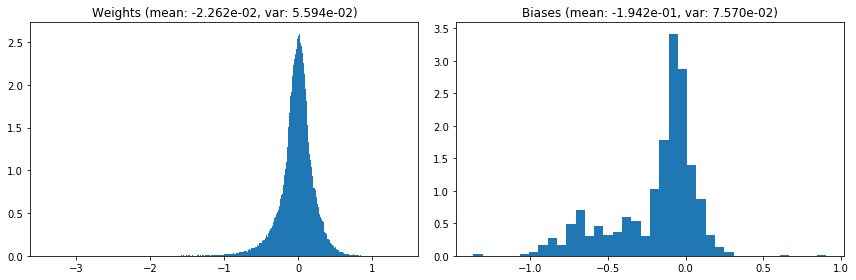

                                      Location network weights and biases


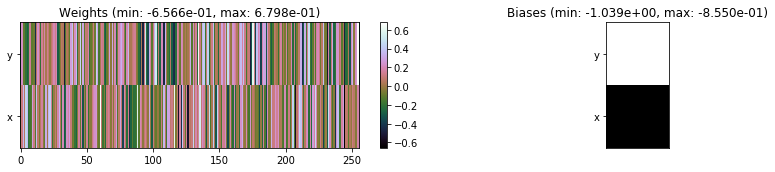

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.32 sec | TRAIN >> class loss: 0.1877 | steps:  2.181 :( | reward:  0.9406 :( | acc.: 94.064% :(
                          | VAL   >> class loss: 0.1715 | steps:  2.154 :( | reward:  0.9464 :( | acc.: 94.640% :(


Epoch  65/400) lr = 0.0001374
 b    500/  4000 >> 106.7 ms/b | lr: 1.37e-04 | grad 2norm: 178.08 | grad inf norm: 38.655
       Weights || abs max:  3.39 ( 5370.64) | mean: -2.26e-02 ( 0.04) | var: 5.59e-02 ( 1143.05)
        Biases || abs max:  1.36 (  463.64) | mean: -1.94e-01 ( 0.56) | var: 7.57e-02 (49413.34)
                  class loss: 0.193 | steps: 2.168 | reward:  0.942 | acc.: 94.16%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 110.2 ms/b | lr: 1.36e-04 | grad 2norm: 84.94 | grad inf norm: 17.558
       Weights || abs max:  3.39 (16311.71) | mean: -2.26e-02 ( 0.09) 

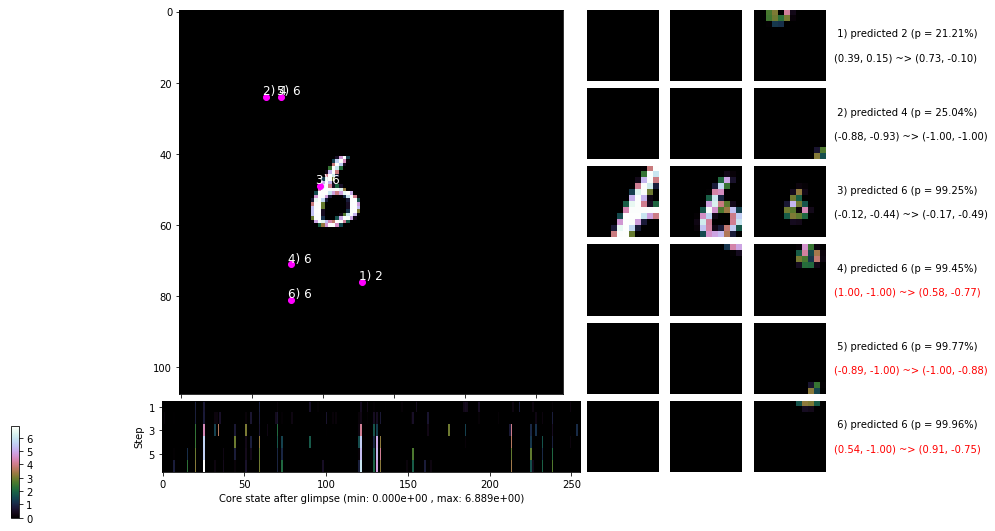

 b   1500/  4000 >> 105.1 ms/b | lr: 1.36e-04 | grad 2norm: 38.87 | grad inf norm:  9.823
       Weights || abs max:  3.39 (11861.51) | mean: -2.26e-02 ( 0.07) | var: 5.60e-02 (10689.96)
        Biases || abs max:  1.36 (  566.60) | mean: -1.94e-01 ( 0.66) | var: 7.58e-02 (45605.99)
                  class loss: 0.206 | steps: 2.169 | reward:  0.939 | acc.: 93.87%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 106.1 ms/b | lr: 1.35e-04 | grad 2norm: 32.72 | grad inf norm:  8.535
       Weights || abs max:  3.39 ( 7301.52) | mean: -2.26e-02 ( 0.05) | var: 5.60e-02 ( 5203.86)
        Biases || abs max:  1.36 (  481.66) | mean: -1.94e-01 ( 0.56) | var: 7.59e-02 (68940.70)
                  class loss: 0.205 | steps: 2.190 | reward:  0.938 | acc.: 93.85%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

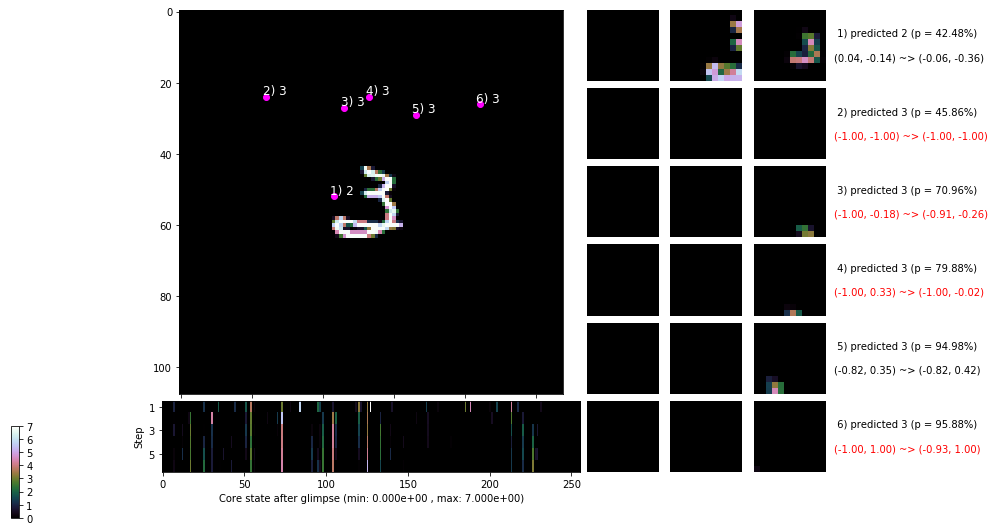

 b   2500/  4000 >> 111.4 ms/b | lr: 1.35e-04 | grad 2norm: 12.45 | grad inf norm:  4.341
       Weights || abs max:  3.40 ( 7990.04) | mean: -2.26e-02 ( 0.06) | var: 5.60e-02 ( 2412.22)
        Biases || abs max:  1.37 (  225.49) | mean: -1.94e-01 ( 0.39) | var: 7.59e-02 ( 1871.16)
                  class loss: 0.193 | steps: 2.196 | reward:  0.937 | acc.: 93.71%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.7 ms/b | lr: 1.34e-04 | grad 2norm: 417.73 | grad inf norm: 81.873
       Weights || abs max:  3.40 (14033.19) | mean: -2.26e-02 ( 0.08) | var: 5.60e-02 (37470.87)
        Biases || abs max:  1.37 (   97.72) | mean: -1.95e-01 ( 0.20) | var: 7.60e-02 (  818.21)
                  class loss: 0.188 | steps: 2.173 | reward:  0.941 | acc.: 94.10%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

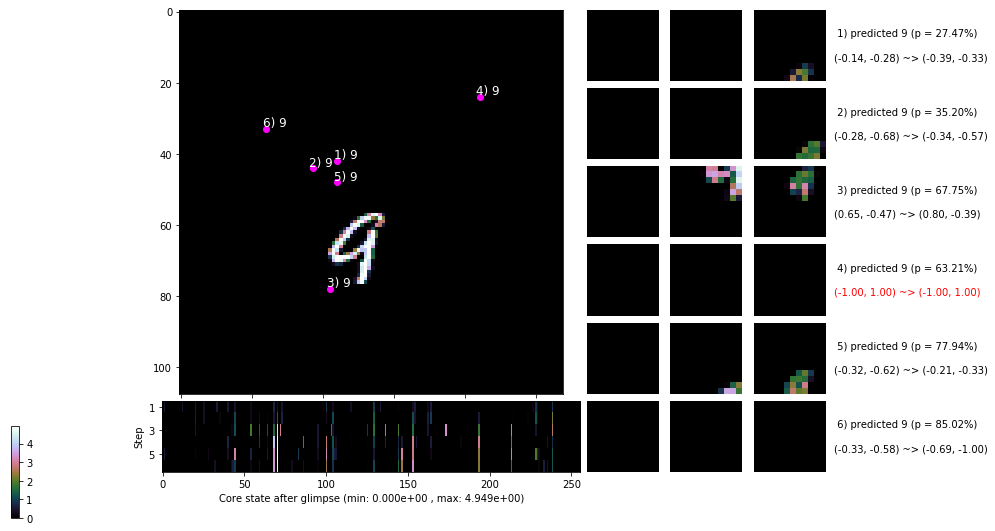

 b   3500/  4000 >> 104.9 ms/b | lr: 1.34e-04 | grad 2norm: 117.50 | grad inf norm: 26.468
       Weights || abs max:  3.40 (16435.57) | mean: -2.26e-02 ( 0.10) | var: 5.60e-02 (29329.37)
        Biases || abs max:  1.37 (  211.14) | mean: -1.95e-01 ( 0.32) | var: 7.60e-02 ( 3879.91)
                  class loss: 0.199 | steps: 2.200 | reward:  0.937 | acc.: 93.73%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.8 ms/b | lr: 1.33e-04 | grad 2norm: 98.45 | grad inf norm: 21.678
       Weights || abs max:  3.40 ( 9524.46) | mean: -2.25e-02 ( 0.06) | var: 5.60e-02 (12999.20)
        Biases || abs max:  1.37 (  121.18) | mean: -1.94e-01 ( 0.24) | var: 7.60e-02 (  275.33)
                  class loss: 0.187 | steps: 2.162 | reward:  0.942 | acc.: 94.20%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

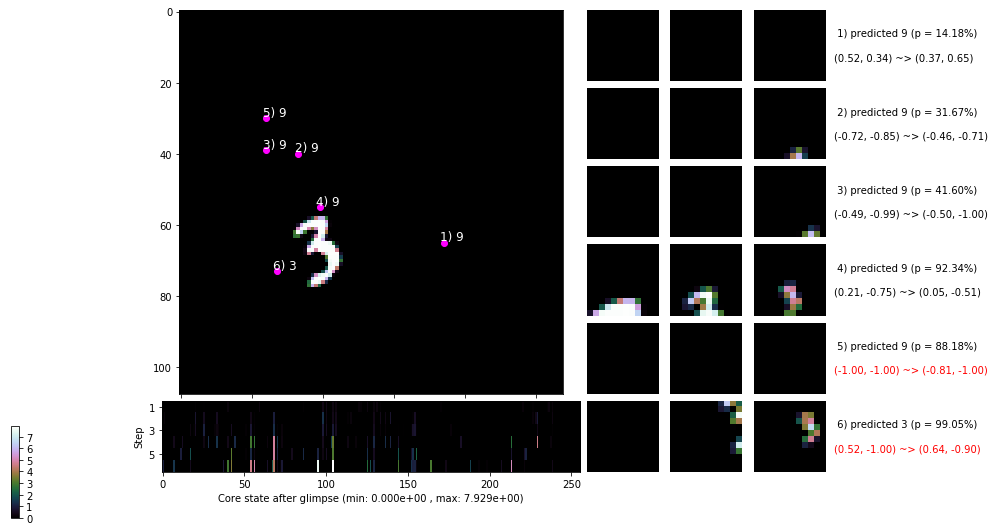

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


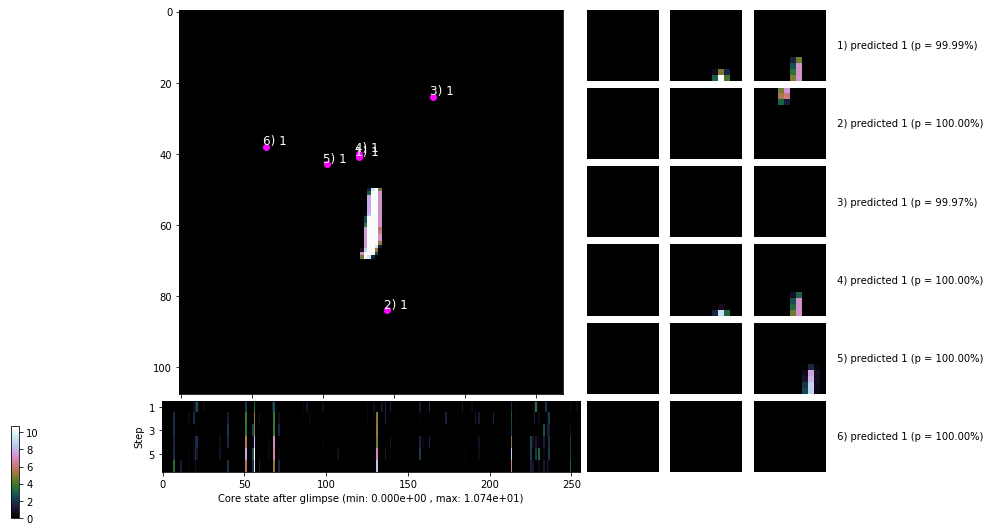


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


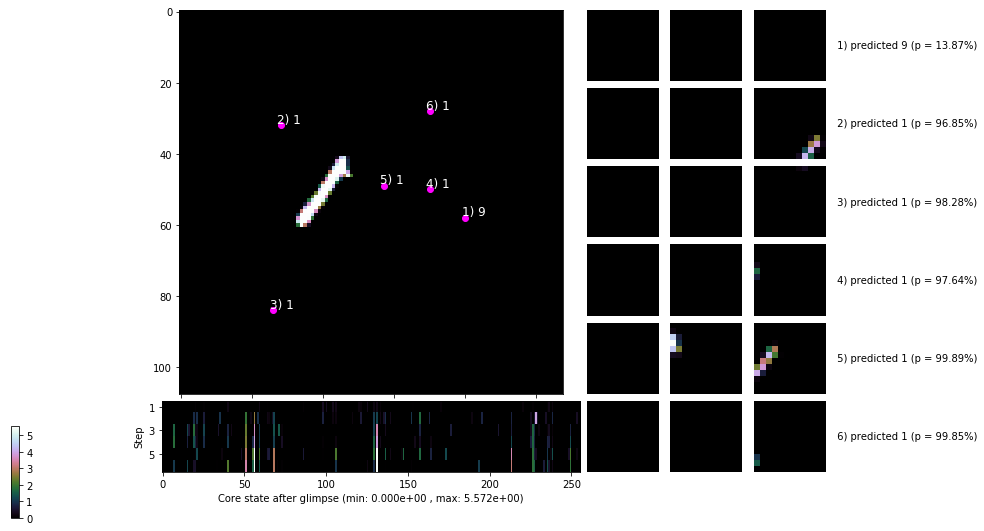

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


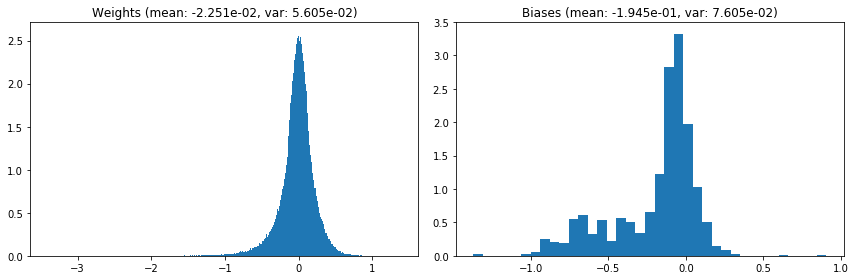

                                      Location network weights and biases


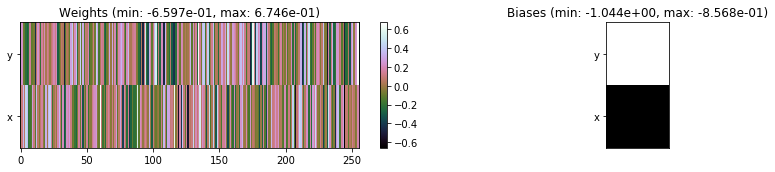

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.16 sec | TRAIN >> class loss: 0.1948 | steps:  2.180 :( | reward:  0.9394 :( | acc.: 93.939% :(
                          | VAL   >> class loss: 0.1896 | steps:  2.163 :( | reward:  0.9398 :( | acc.: 93.980% :(


Epoch  66/400) lr = 0.0001332
 b    500/  4000 >> 103.7 ms/b | lr: 1.33e-04 | grad 2norm: 53.41 | grad inf norm: 12.808
       Weights || abs max:  3.41 (15293.42) | mean: -2.25e-02 ( 0.09) | var: 5.61e-02 (90366.73)
        Biases || abs max:  1.37 (  403.56) | mean: -1.95e-01 ( 0.55) | var: 7.61e-02 ( 8090.82)
                  class loss: 0.187 | steps: 2.169 | reward:  0.942 | acc.: 94.17%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.7 ms/b | lr: 1.32e-04 | grad 2norm: 521.34 | grad inf norm: 104.234
       Weights || abs max:  3.41 ( 7124.48) | mean: -2.25e-02 ( 0.06)

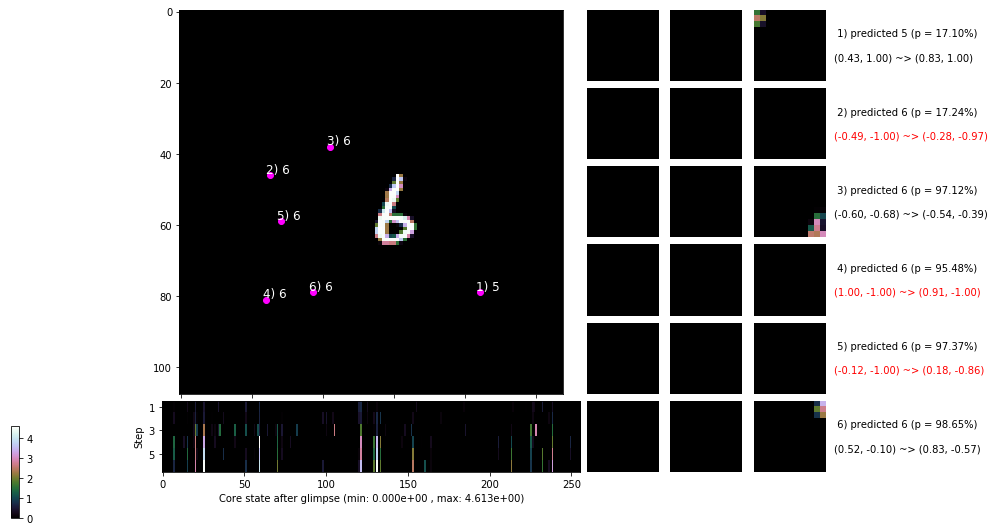

 b   1500/  4000 >> 105.5 ms/b | lr: 1.32e-04 | grad 2norm: 592.62 | grad inf norm: 120.107
       Weights || abs max:  3.41 ( 8936.40) | mean: -2.24e-02 ( 0.06) | var: 5.61e-02 ( 4486.30)
        Biases || abs max:  1.38 (  135.89) | mean: -1.95e-01 ( 0.29) | var: 7.61e-02 (  359.79)
                  class loss: 0.187 | steps: 2.209 | reward:  0.940 | acc.: 94.02%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.7 ms/b | lr: 1.31e-04 | grad 2norm: 271.72 | grad inf norm: 52.255
       Weights || abs max:  3.40 (10818.54) | mean: -2.24e-02 ( 0.07) | var: 5.61e-02 ( 9890.93)
        Biases || abs max:  1.38 (  184.20) | mean: -1.95e-01 ( 0.30) | var: 7.61e-02 ( 2122.16)
                  class loss: 0.186 | steps: 2.164 | reward:  0.943 | acc.: 94.27%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

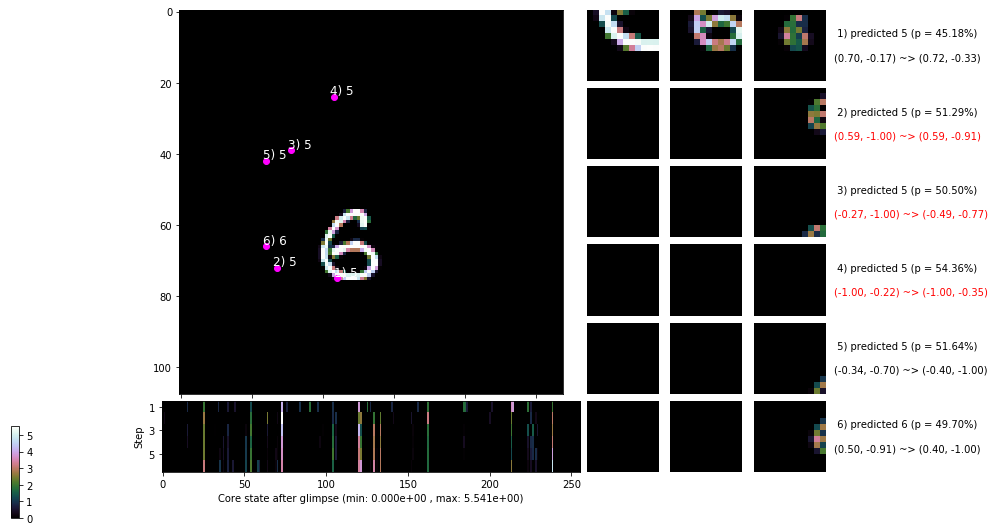

 b   2500/  4000 >> 104.7 ms/b | lr: 1.31e-04 | grad 2norm: 153.83 | grad inf norm: 32.000
       Weights || abs max:  3.40 (10307.92) | mean: -2.24e-02 ( 0.07) | var: 5.61e-02 ( 8955.50)
        Biases || abs max:  1.38 ( 1735.56) | mean: -1.95e-01 ( 1.82) | var: 7.61e-02 (828508.12)
                  class loss: 0.190 | steps: 2.202 | reward:  0.941 | acc.: 94.10%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.7 ms/b | lr: 1.30e-04 | grad 2norm: 215.33 | grad inf norm: 44.978
       Weights || abs max:  3.41 (404324.22) | mean: -2.24e-02 ( 1.61) | var: 5.61e-02 (309782240.00)
        Biases || abs max:  1.38 (  213.20) | mean: -1.95e-01 ( 0.31) | var: 7.62e-02 ( 1597.15)
                  class loss: 0.189 | steps: 2.210 | reward:  0.941 | acc.: 94.13%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1

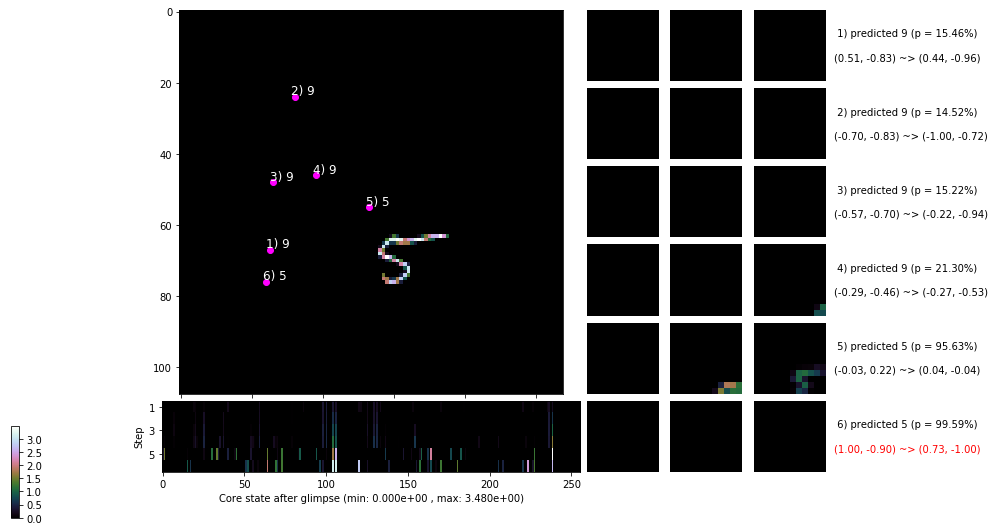

 b   3500/  4000 >> 106.1 ms/b | lr: 1.30e-04 | grad 2norm: 35.85 | grad inf norm:  9.571
       Weights || abs max:  3.41 ( 8090.58) | mean: -2.24e-02 ( 0.06) | var: 5.61e-02 (12622.57)
        Biases || abs max:  1.38 (  425.46) | mean: -1.95e-01 ( 0.65) | var: 7.63e-02 ( 3603.54)
                  class loss: 0.197 | steps: 2.201 | reward:  0.938 | acc.: 93.82%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 105.4 ms/b | lr: 1.29e-04 | grad 2norm: 118.17 | grad inf norm: 24.730
       Weights || abs max:  3.41 (11268.23) | mean: -2.24e-02 ( 0.07) | var: 5.61e-02 (43700.11)
        Biases || abs max:  1.38 (   83.56) | mean: -1.95e-01 ( 0.21) | var: 7.64e-02 (  357.32)
                  class loss: 0.186 | steps: 2.179 | reward:  0.943 | acc.: 94.29%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

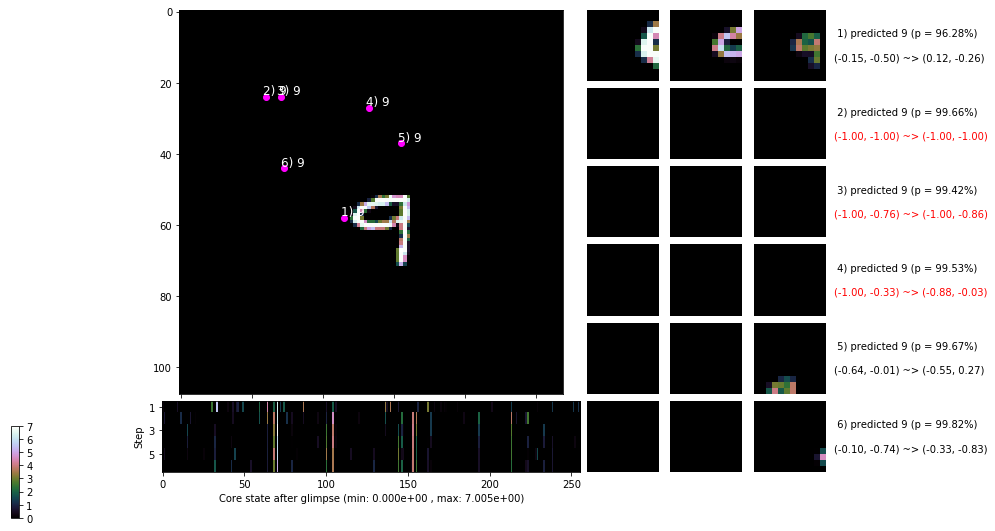

                                          ---===  VALIDATION  ===---

	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


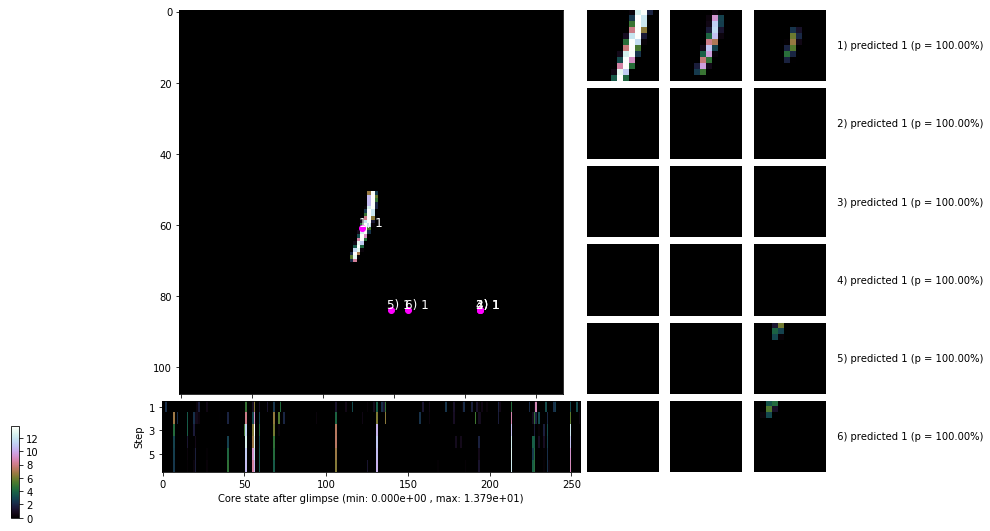


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


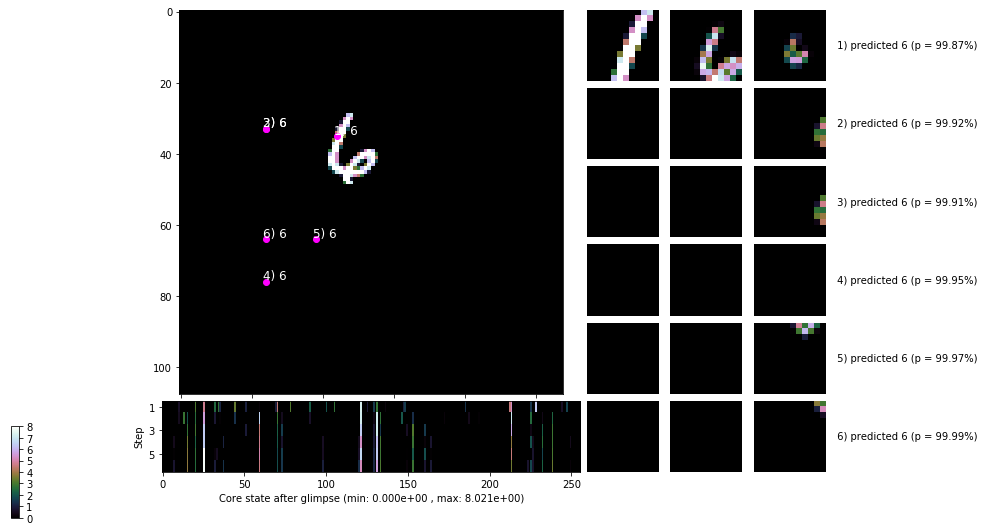

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


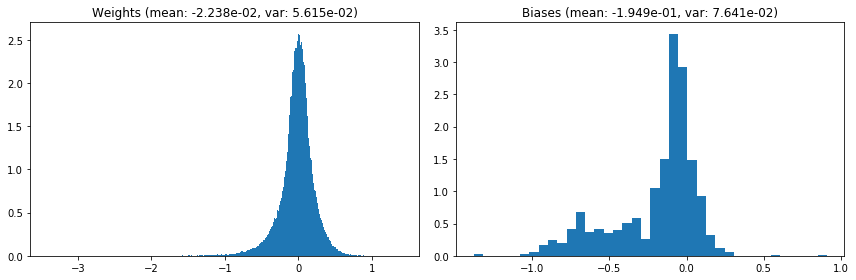

                                      Location network weights and biases


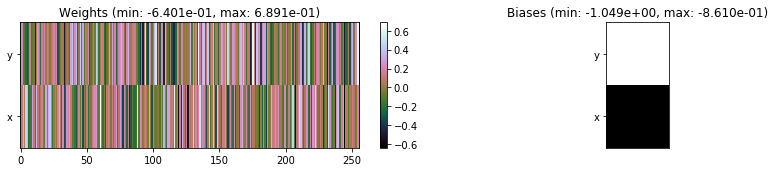

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.24 sec | TRAIN >> class loss: 0.1880 | steps:  2.187 :( | reward:  0.9411    | acc.: 94.114% 
                          | VAL   >> class loss: 0.1761 | steps:  2.156 :( | reward:  0.9418 :( | acc.: 94.180% :(


Epoch  67/400) lr = 0.0001291
 b    500/  4000 >> 103.3 ms/b | lr: 1.29e-04 | grad 2norm: 29.45 | grad inf norm:  8.024
       Weights || abs max:  3.41 (10496.98) | mean: -2.24e-02 ( 0.07) | var: 5.62e-02 (61654.41)
        Biases || abs max:  1.38 (   40.18) | mean: -1.95e-01 ( 0.12) | var: 7.64e-02 (   36.15)
                  class loss: 0.188 | steps: 2.187 | reward:  0.942 | acc.: 94.16%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 103.0 ms/b | lr: 1.28e-04 | grad 2norm: 147.78 | grad inf norm: 30.988
       Weights || abs max:  3.41 ( 6602.13) | mean: -2.23e-02 ( 0.05) | 

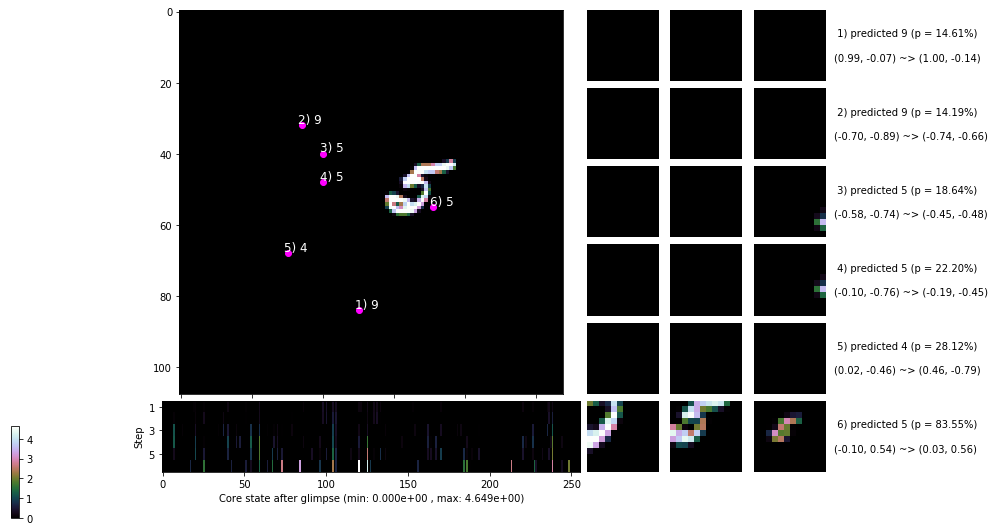

 b   1500/  4000 >> 105.5 ms/b | lr: 1.28e-04 | grad 2norm: 37.75 | grad inf norm:  9.257
       Weights || abs max:  3.41 ( 8990.10) | mean: -2.23e-02 ( 0.06) | var: 5.62e-02 ( 3872.18)
        Biases || abs max:  1.38 (  153.28) | mean: -1.95e-01 ( 0.27) | var: 7.64e-02 (  566.53)
                  class loss: 0.188 | steps: 2.196 | reward:  0.942 | acc.: 94.19%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.7 ms/b | lr: 1.27e-04 | grad 2norm: 47.83 | grad inf norm: 11.227
       Weights || abs max:  3.41 ( 8160.45) | mean: -2.22e-02 ( 0.06) | var: 5.62e-02 ( 3369.91)
        Biases || abs max:  1.38 (  142.12) | mean: -1.95e-01 ( 0.26) | var: 7.64e-02 (  271.61)
                  class loss: 0.192 | steps: 2.185 | reward:  0.939 | acc.: 93.93%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

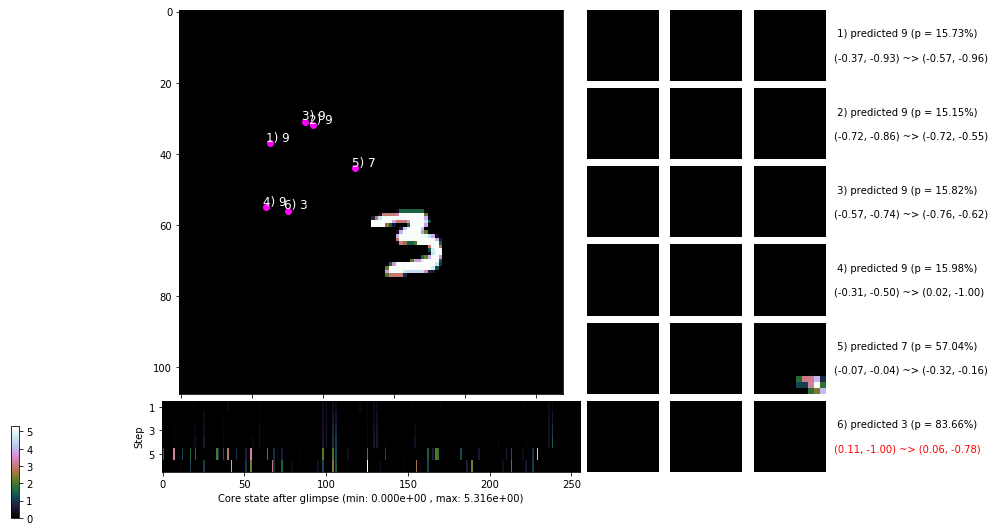

 b   2500/  4000 >> 104.8 ms/b | lr: 1.27e-04 | grad 2norm: 849.69 | grad inf norm: 164.518
       Weights || abs max:  3.41 (15354.77) | mean: -2.22e-02 ( 0.09) | var: 5.62e-02 (206503.20)
        Biases || abs max:  1.38 (  166.42) | mean: -1.95e-01 ( 0.29) | var: 7.65e-02 ( 1789.34)
                  class loss: 0.194 | steps: 2.220 | reward:  0.936 | acc.: 93.63%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.8 ms/b | lr: 1.26e-04 | grad 2norm: 245.37 | grad inf norm: 52.186
       Weights || abs max:  3.40 ( 9605.09) | mean: -2.23e-02 ( 0.06) | var: 5.62e-02 (14345.92)
        Biases || abs max:  1.38 (  498.21) | mean: -1.95e-01 ( 0.63) | var: 7.66e-02 (71298.27)
                  class loss: 0.202 | steps: 2.244 | reward:  0.937 | acc.: 93.73%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

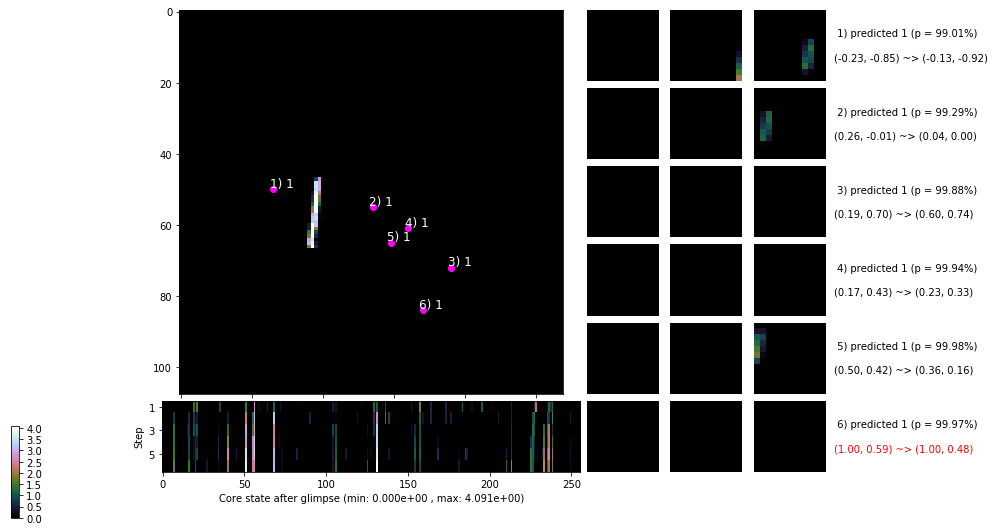

 b   3500/  4000 >> 104.4 ms/b | lr: 1.26e-04 | grad 2norm: 209.42 | grad inf norm: 45.677
       Weights || abs max:  3.41 (78097.26) | mean: -2.22e-02 ( 0.33) | var: 5.62e-02 (9730645.00)
        Biases || abs max:  1.38 (  106.45) | mean: -1.95e-01 ( 0.23) | var: 7.66e-02 (  306.79)
                  class loss: 0.186 | steps: 2.227 | reward:  0.939 | acc.: 93.89%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.6 ms/b | lr: 1.25e-04 | grad 2norm: 549.79 | grad inf norm: 108.276
       Weights || abs max:  3.41 ( 7637.39) | mean: -2.21e-02 ( 0.06) | var: 5.63e-02 ( 4137.91)
        Biases || abs max:  1.38 (  226.90) | mean: -1.95e-01 ( 0.33) | var: 7.66e-02 ( 2370.10)
                  class loss: 0.200 | steps: 2.233 | reward:  0.939 | acc.: 93.90%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

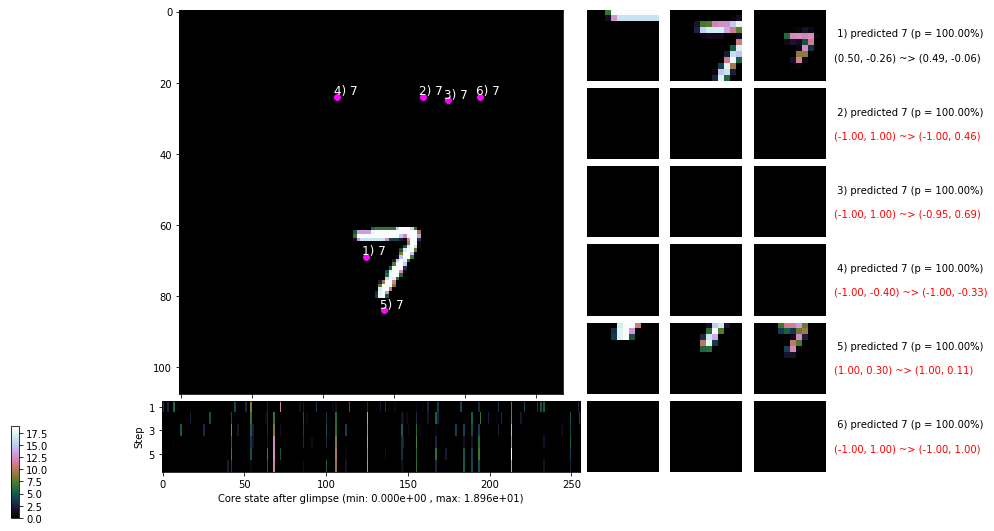

                                          ---===  VALIDATION  ===---

	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


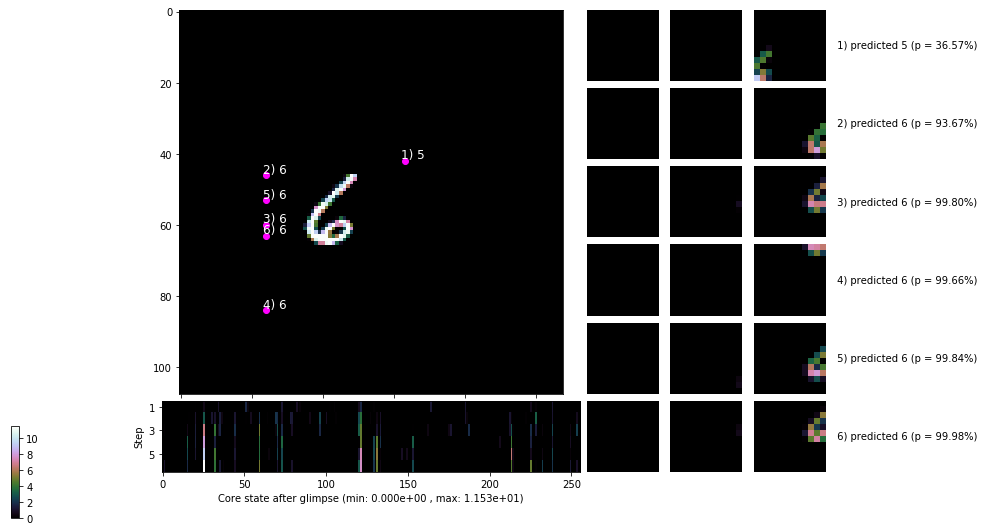


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


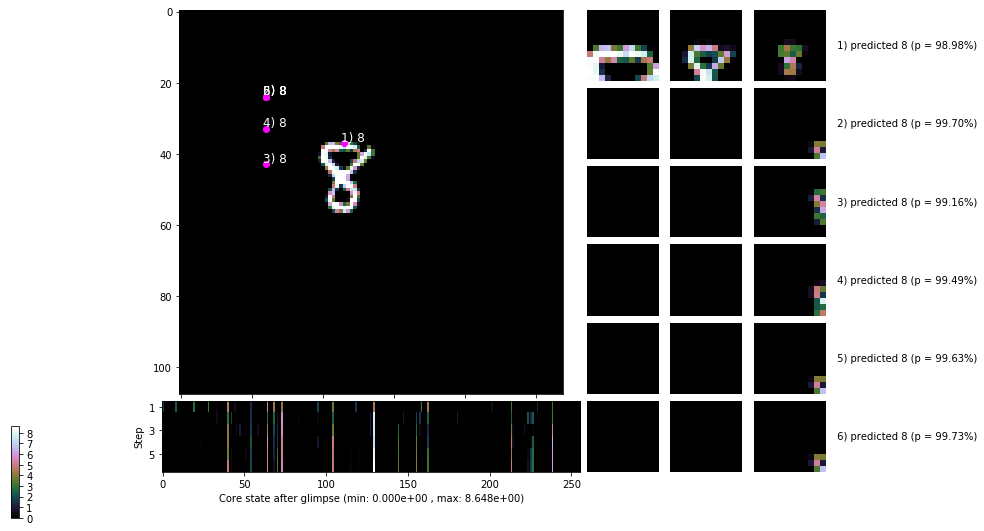

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


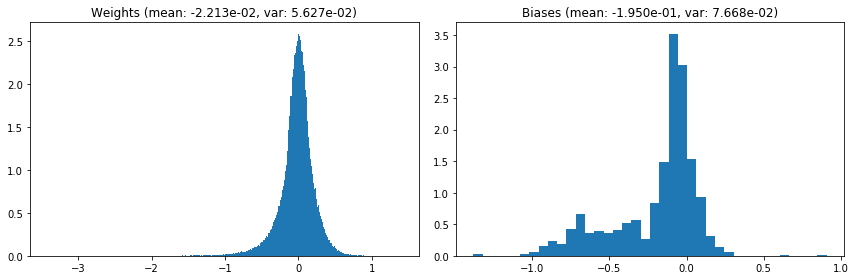

                                      Location network weights and biases


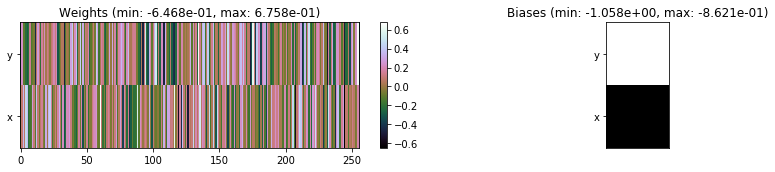

---------------------------------------------------------------------------------------------------------------
Elapsed time:  415.81 sec | TRAIN >> class loss: 0.1919 | steps:  2.209 :( | reward:  0.9396 :( | acc.: 93.957% :(
                          | VAL   >> class loss: 0.1956 | steps:  2.208 :( | reward:  0.9396 :( | acc.: 93.960% :(


Epoch  68/400) lr = 0.0001252
 b    500/  4000 >> 106.8 ms/b | lr: 1.25e-04 | grad 2norm: 151.63 | grad inf norm: 32.984
       Weights || abs max:  3.41 (16190.97) | mean: -2.21e-02 ( 0.09) | var: 5.63e-02 (40115.44)
        Biases || abs max:  1.38 (  246.58) | mean: -1.95e-01 ( 0.42) | var: 7.68e-02 ( 4402.28)
                  class loss: 0.187 | steps: 2.210 | reward:  0.940 | acc.: 94.04%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 106.7 ms/b | lr: 1.24e-04 | grad 2norm: 55.90 | grad inf norm: 13.364
       Weights || abs max:  3.41 ( 7302.06) | mean: -2.21e-02 ( 0.05) 

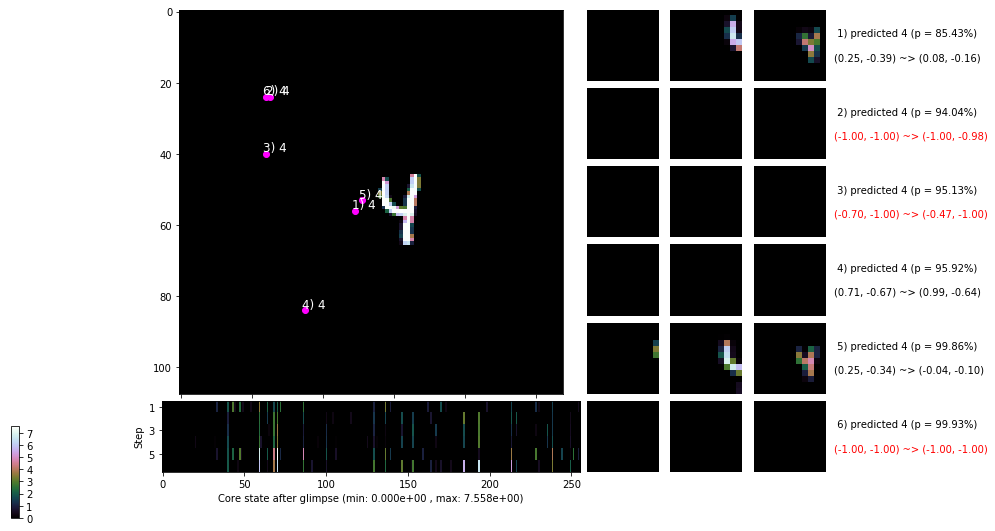

 b   1500/  4000 >> 105.4 ms/b | lr: 1.24e-04 | grad 2norm: 716.92 | grad inf norm: 135.695
       Weights || abs max:  3.41 (13466.66) | mean: -2.20e-02 ( 0.08) | var: 5.63e-02 (57392.13)
        Biases || abs max:  1.38 (  172.71) | mean: -1.95e-01 ( 0.31) | var: 7.69e-02 (  450.87)
                  class loss: 0.191 | steps: 2.255 | reward:  0.938 | acc.: 93.79%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 102.8 ms/b | lr: 1.23e-04 | grad 2norm: 108.32 | grad inf norm: 20.962
       Weights || abs max:  3.41 ( 5012.17) | mean: -2.20e-02 ( 0.04) | var: 5.63e-02 ( 1591.26)
        Biases || abs max:  1.38 (  134.27) | mean: -1.95e-01 ( 0.26) | var: 7.69e-02 (  292.07)
                  class loss: 0.203 | steps: 2.268 | reward:  0.937 | acc.: 93.65%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

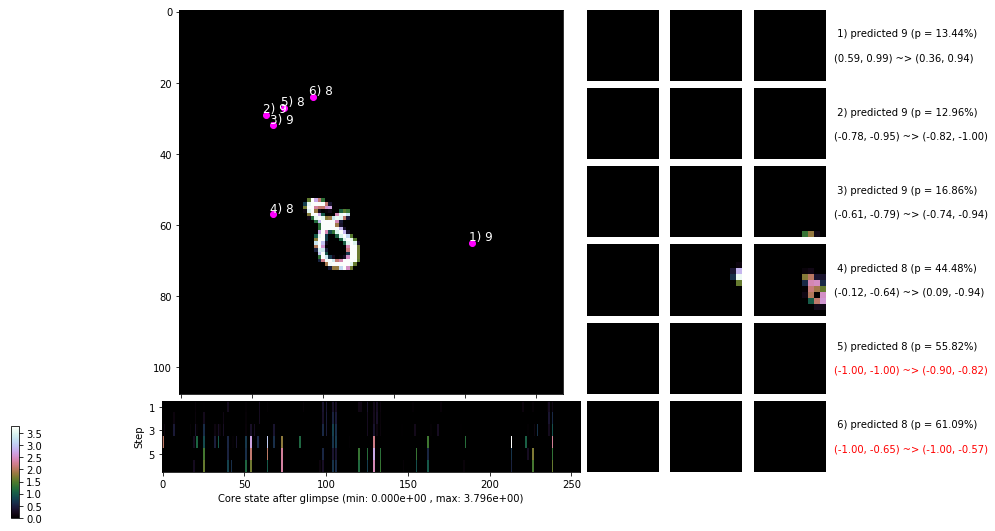

 b   2500/  4000 >> 103.9 ms/b | lr: 1.23e-04 | grad 2norm: 245.30 | grad inf norm: 51.448
       Weights || abs max:  3.41 ( 9812.64) | mean: -2.20e-02 ( 0.06) | var: 5.63e-02 ( 8620.93)
        Biases || abs max:  1.38 (  150.46) | mean: -1.95e-01 ( 0.26) | var: 7.70e-02 (  420.26)
                  class loss: 0.190 | steps: 2.234 | reward:  0.939 | acc.: 93.94%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 102.8 ms/b | lr: 1.22e-04 | grad 2norm: 383.61 | grad inf norm: 74.332
       Weights || abs max:  3.41 ( 6987.52) | mean: -2.20e-02 ( 0.05) | var: 5.63e-02 ( 6759.57)
        Biases || abs max:  1.38 (  197.84) | mean: -1.95e-01 ( 0.39) | var: 7.71e-02 ( 5277.59)
                  class loss: 0.191 | steps: 2.226 | reward:  0.938 | acc.: 93.81%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

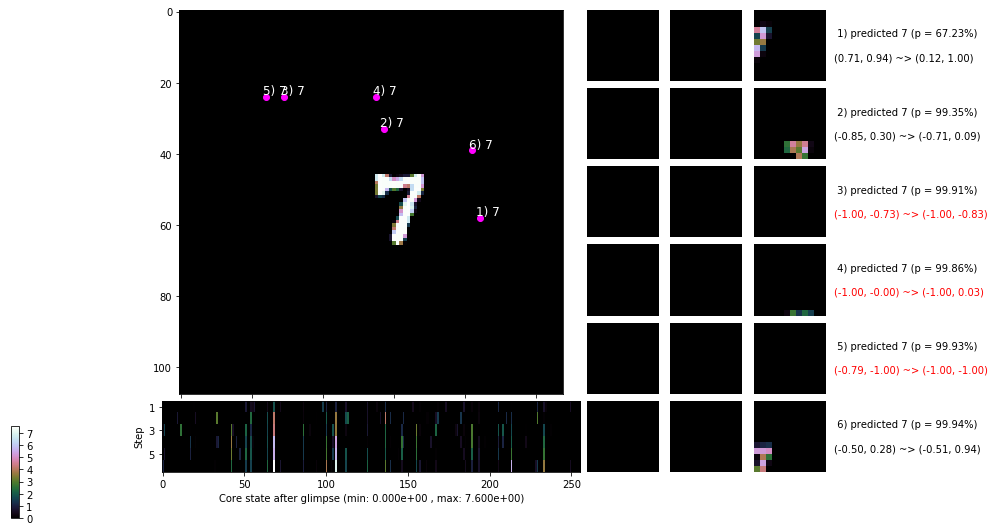

 b   3500/  4000 >> 106.1 ms/b | lr: 1.22e-04 | grad 2norm: 551.57 | grad inf norm: 105.254
       Weights || abs max:  3.41 ( 7280.86) | mean: -2.20e-02 ( 0.05) | var: 5.63e-02 ( 6428.50)
        Biases || abs max:  1.38 (  185.94) | mean: -1.95e-01 ( 0.34) | var: 7.72e-02 (  824.50)
                  class loss: 0.253 | steps: 2.243 | reward:  0.936 | acc.: 93.61%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 104.0 ms/b | lr: 1.21e-04 | grad 2norm: 262.47 | grad inf norm: 50.597
       Weights || abs max:  3.41 (11770.03) | mean: -2.20e-02 ( 0.07) | var: 5.64e-02 (58245.60)
        Biases || abs max:  1.38 (  133.11) | mean: -1.95e-01 ( 0.29) | var: 7.72e-02 (  380.63)
                  class loss: 0.196 | steps: 2.219 | reward:  0.940 | acc.: 93.99%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

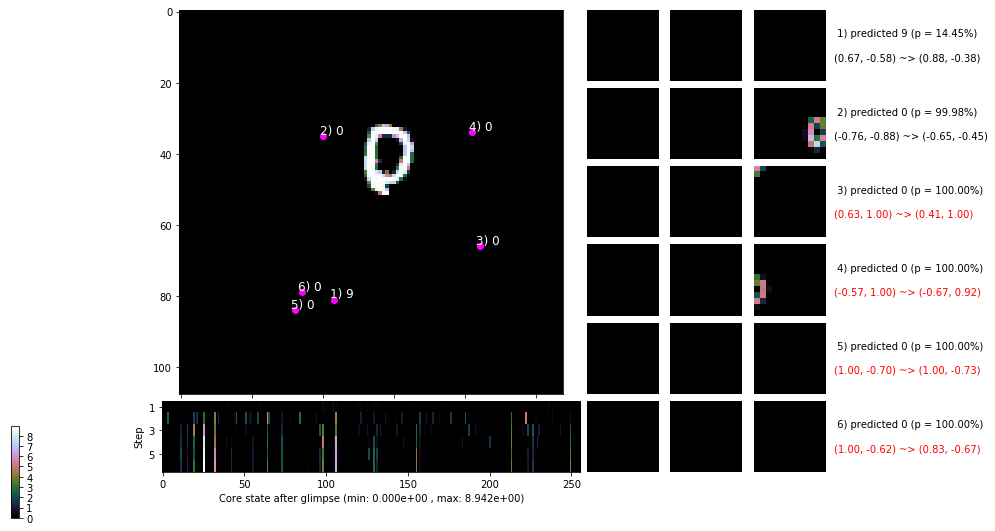

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


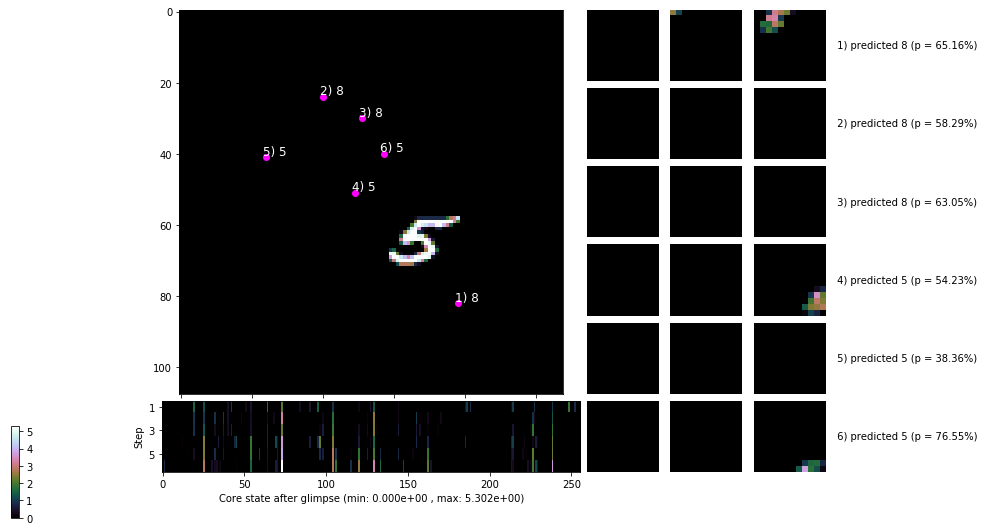


	Target class: 1  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


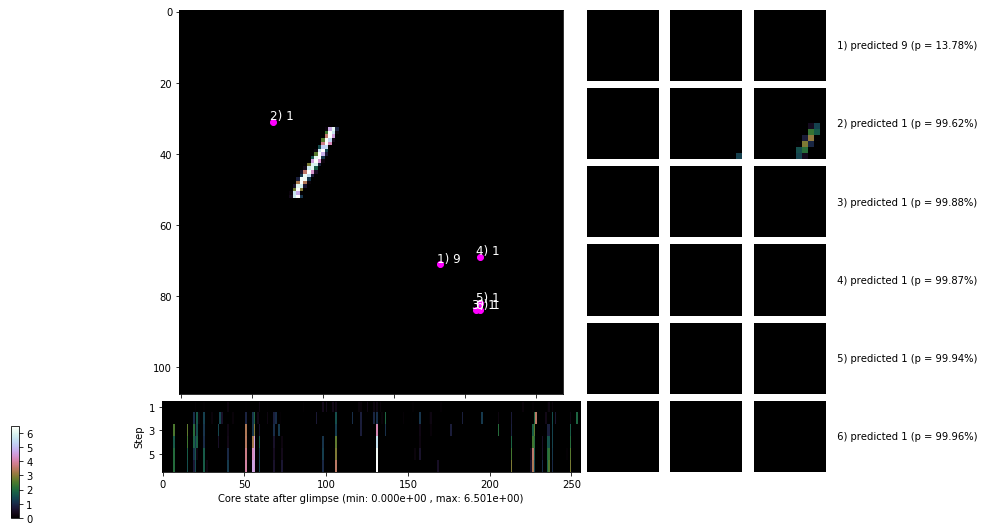

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


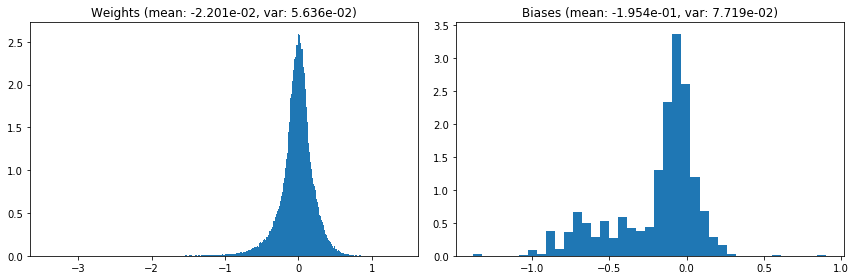

                                      Location network weights and biases


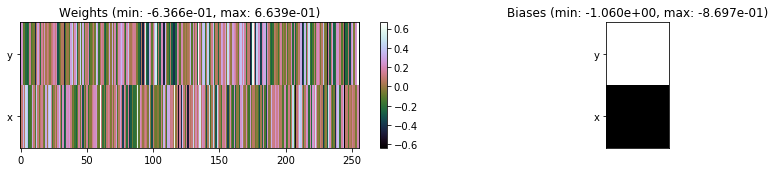

---------------------------------------------------------------------------------------------------------------
Elapsed time:  420.52 sec | TRAIN >> class loss: 0.2016 | steps:  2.236 :( | reward:  0.9380 :( | acc.: 93.803% :(
                          | VAL   >> class loss: 0.1941 | steps:  2.204 :( | reward:  0.9366 :( | acc.: 93.660% :(


Epoch  69/400) lr = 0.0001214
 b    500/  4000 >> 101.5 ms/b | lr: 1.21e-04 | grad 2norm: 761.22 | grad inf norm: 137.414
       Weights || abs max:  3.42 (18336.70) | mean: -2.20e-02 ( 0.10) | var: 5.64e-02 (256792.67)
        Biases || abs max:  1.38 (  199.94) | mean: -1.95e-01 ( 0.35) | var: 7.71e-02 ( 1603.07)
                  class loss: 0.197 | steps: 2.239 | reward:  0.938 | acc.: 93.81%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.5 ms/b | lr: 1.21e-04 | grad 2norm: 367.07 | grad inf norm: 68.032
       Weights || abs max:  3.41 (11743.45) | mean: -2.20e-02 ( 0.0

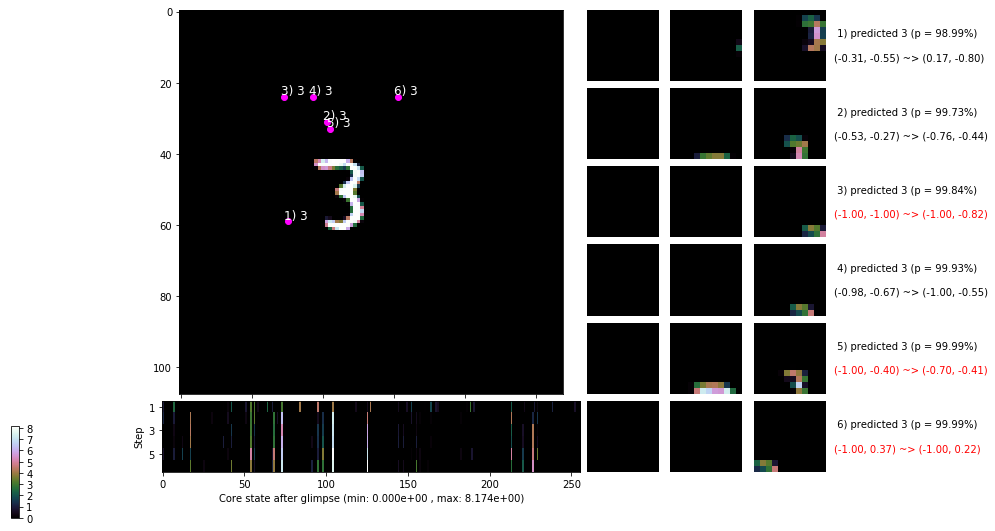

 b   1500/  4000 >> 104.4 ms/b | lr: 1.20e-04 | grad 2norm: 4161.57 | grad inf norm: 691.535
       Weights || abs max:  3.42 ( 5791.83) | mean: -2.20e-02 ( 0.05) | var: 5.64e-02 ( 1183.36)
        Biases || abs max:  1.38 (  184.35) | mean: -1.96e-01 ( 0.29) | var: 7.73e-02 (  719.26)
                  class loss: 0.193 | steps: 2.226 | reward:  0.940 | acc.: 93.97%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 105.0 ms/b | lr: 1.20e-04 | grad 2norm: 37.79 | grad inf norm: 10.135
       Weights || abs max:  3.42 ( 6186.49) | mean: -2.20e-02 ( 0.05) | var: 5.64e-02 ( 1327.82)
        Biases || abs max:  1.38 (   78.72) | mean: -1.96e-01 ( 0.19) | var: 7.74e-02 (  101.45)
                  class loss: 0.188 | steps: 2.190 | reward:  0.942 | acc.: 94.23%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

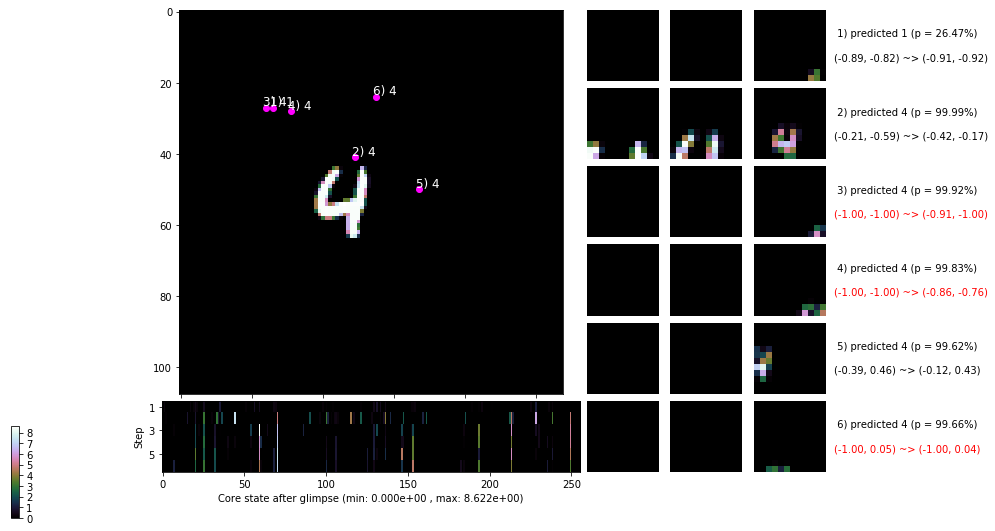

 b   2500/  4000 >> 107.7 ms/b | lr: 1.19e-04 | grad 2norm: 340.26 | grad inf norm: 64.961
       Weights || abs max:  3.42 (18767.67) | mean: -2.19e-02 ( 0.10) | var: 5.64e-02 (113648.45)
        Biases || abs max:  1.38 (  173.05) | mean: -1.96e-01 ( 0.34) | var: 7.74e-02 (  457.28)
                  class loss: 0.186 | steps: 2.195 | reward:  0.942 | acc.: 94.17%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 101.0 ms/b | lr: 1.19e-04 | grad 2norm: 541.81 | grad inf norm: 100.228
       Weights || abs max:  3.42 ( 7898.37) | mean: -2.19e-02 ( 0.06) | var: 5.64e-02 ( 3399.15)
        Biases || abs max:  1.38 (   89.63) | mean: -1.96e-01 ( 0.23) | var: 7.74e-02 (  159.13)
                  class loss: 0.185 | steps: 2.212 | reward:  0.943 | acc.: 94.29%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

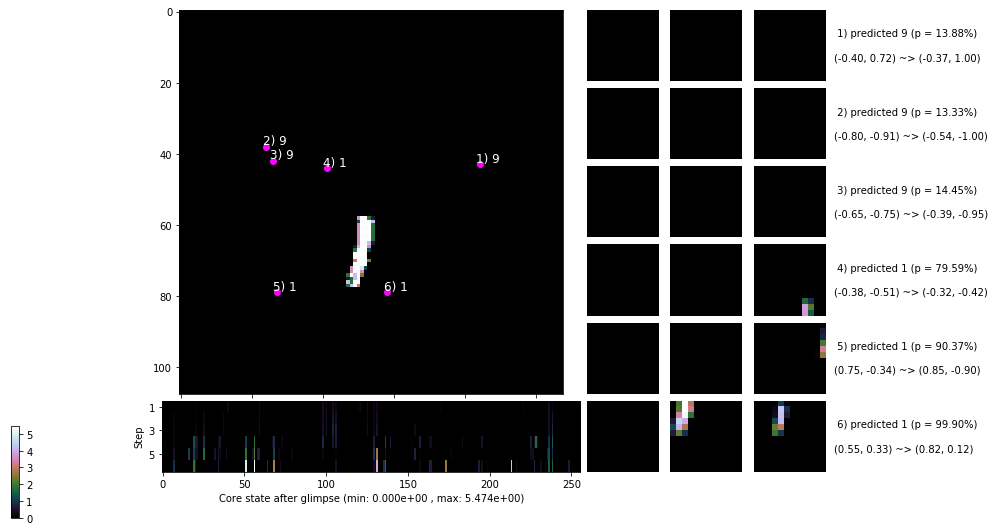

 b   3500/  4000 >> 103.1 ms/b | lr: 1.18e-04 | grad 2norm: 142.10 | grad inf norm: 31.284
       Weights || abs max:  3.42 ( 6873.56) | mean: -2.19e-02 ( 0.06) | var: 5.64e-02 ( 1484.16)
        Biases || abs max:  1.38 (  369.80) | mean: -1.96e-01 ( 0.52) | var: 7.75e-02 (16369.40)
                  class loss: 0.193 | steps: 2.237 | reward:  0.939 | acc.: 93.94%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 101.7 ms/b | lr: 1.18e-04 | grad 2norm: 744.49 | grad inf norm: 138.295
       Weights || abs max:  3.42 (31032.51) | mean: -2.19e-02 ( 0.15) | var: 5.64e-02 (280723.53)
        Biases || abs max:  1.38 (  178.37) | mean: -1.96e-01 ( 0.29) | var: 7.75e-02 ( 2757.46)
                  class loss: 0.187 | steps: 2.206 | reward:  0.942 | acc.: 94.18%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

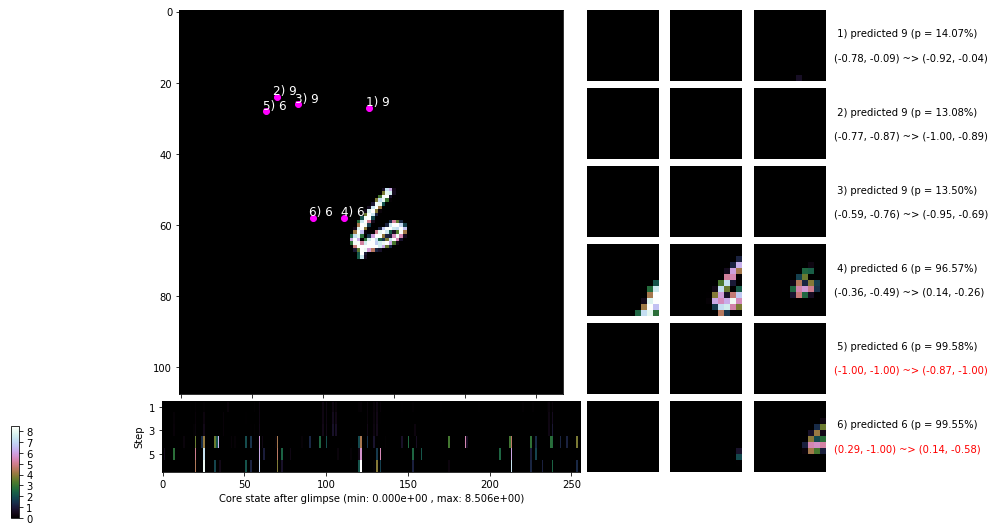

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


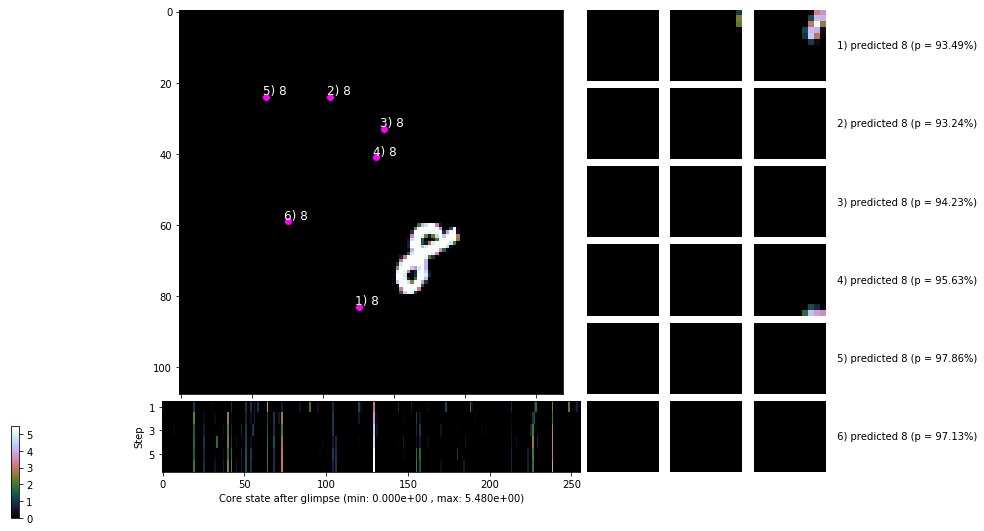


	Target class: 7  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


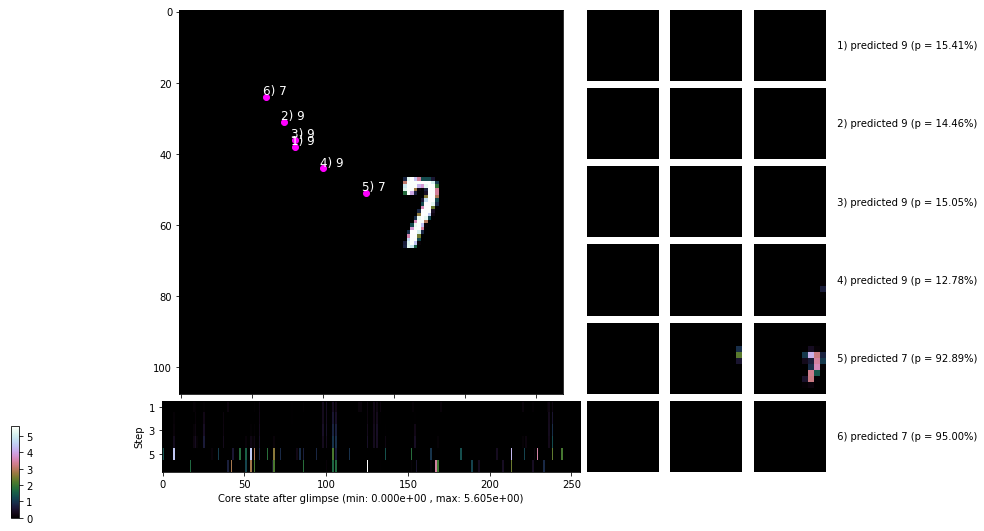

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


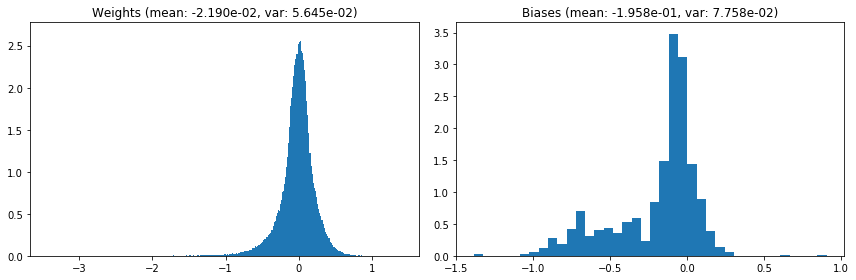

                                      Location network weights and biases


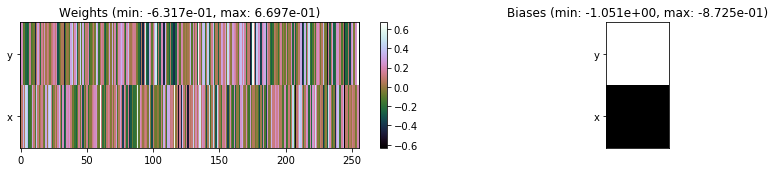

---------------------------------------------------------------------------------------------------------------
Elapsed time:  413.84 sec | TRAIN >> class loss: 0.1896 | steps:  2.220 :( | reward:  0.9408 :( | acc.: 94.085% :(
                          | VAL   >> class loss: 0.1765 | steps:  2.201 :( | reward:  0.9450 :( | acc.: 94.500% :(


Epoch  70/400) lr = 0.0001176
 b    500/  4000 >> 102.6 ms/b | lr: 1.17e-04 | grad 2norm: 10917.04 | grad inf norm: 1913.376
       Weights || abs max:  3.42 ( 9318.02) | mean: -2.19e-02 ( 0.07) | var: 5.65e-02 ( 5950.37)
        Biases || abs max:  1.38 (  115.60) | mean: -1.96e-01 ( 0.23) | var: 7.76e-02 (  154.16)
                  class loss: 0.188 | steps: 2.209 | reward:  0.941 | acc.: 94.07%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 101.4 ms/b | lr: 1.17e-04 | grad 2norm: 651.89 | grad inf norm: 123.475
       Weights || abs max:  3.42 (11046.38) | mean: -2.19e-02 ( 

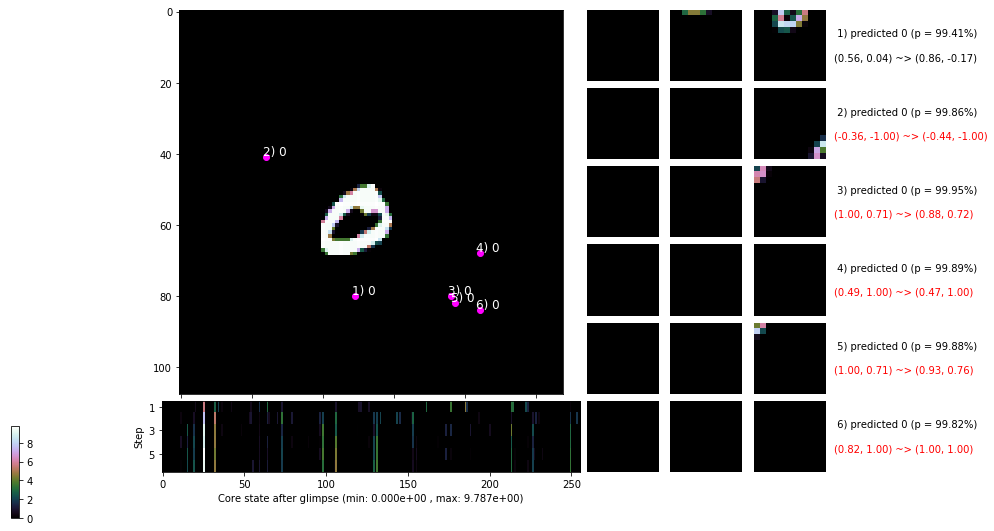

 b   1500/  4000 >> 103.4 ms/b | lr: 1.16e-04 | grad 2norm: 362.09 | grad inf norm: 68.036
       Weights || abs max:  3.43 (11024.28) | mean: -2.19e-02 ( 0.07) | var: 5.65e-02 (20823.98)
        Biases || abs max:  1.38 (  268.92) | mean: -1.96e-01 ( 0.44) | var: 7.78e-02 ( 8508.57)
                  class loss: 0.184 | steps: 2.218 | reward:  0.942 | acc.: 94.20%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 100.7 ms/b | lr: 1.16e-04 | grad 2norm: 829.23 | grad inf norm: 151.731
       Weights || abs max:  3.43 (24381.17) | mean: -2.18e-02 ( 0.12) | var: 5.65e-02 (559166.75)
        Biases || abs max:  1.39 (  163.11) | mean: -1.96e-01 ( 0.29) | var: 7.79e-02 (  427.78)
                  class loss: 0.191 | steps: 2.250 | reward:  0.941 | acc.: 94.11%
                 --------------------------------------------------------------------------------

	Target class: 7 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

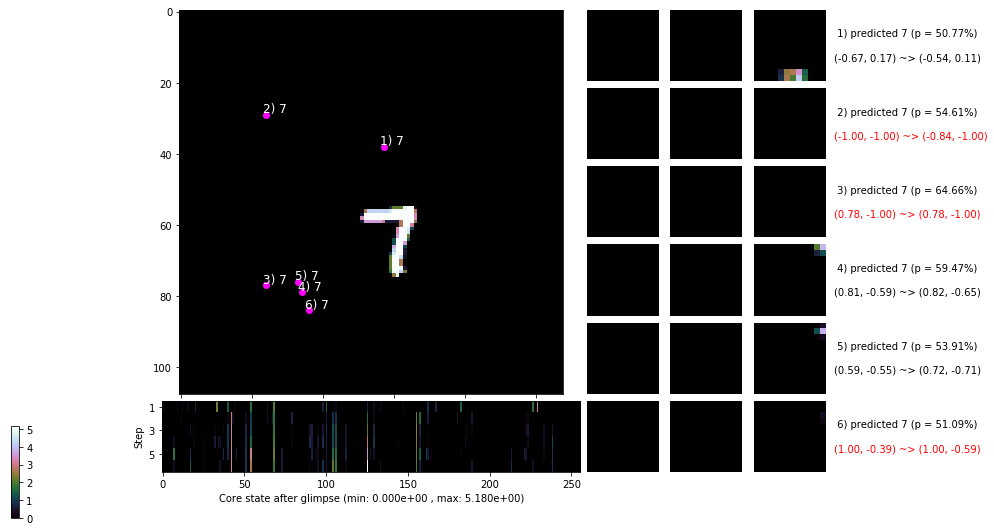

 b   2500/  4000 >> 104.8 ms/b | lr: 1.16e-04 | grad 2norm: 1579.86 | grad inf norm: 280.235
       Weights || abs max:  3.43 ( 6101.64) | mean: -2.19e-02 ( 0.05) | var: 5.65e-02 ( 1191.14)
        Biases || abs max:  1.39 (   68.70) | mean: -1.96e-01 ( 0.20) | var: 7.80e-02 (   86.95)
                  class loss: 0.196 | steps: 2.238 | reward:  0.936 | acc.: 93.59%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.1 ms/b | lr: 1.15e-04 | grad 2norm: 2200.50 | grad inf norm: 387.040
       Weights || abs max:  3.43 ( 8186.86) | mean: -2.18e-02 ( 0.06) | var: 5.65e-02 ( 3816.18)
        Biases || abs max:  1.39 ( 1278.21) | mean: -1.96e-01 ( 2.06) | var: 7.79e-02 (473187.22)
                  class loss: 0.191 | steps: 2.244 | reward:  0.940 | acc.: 94.00%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.

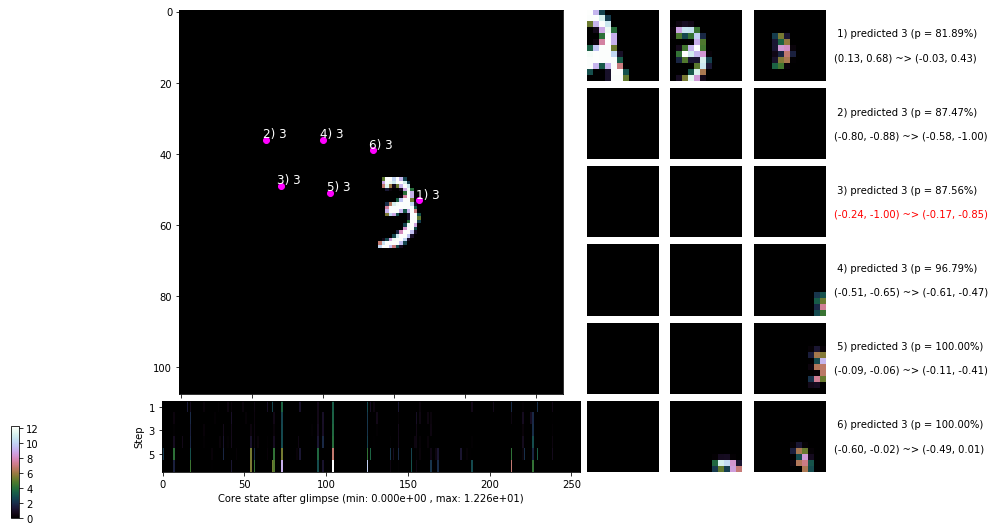

 b   3500/  4000 >> 108.1 ms/b | lr: 1.15e-04 | grad 2norm: 255.62 | grad inf norm: 50.488
       Weights || abs max:  3.44 ( 5421.04) | mean: -2.18e-02 ( 0.05) | var: 5.65e-02 ( 1692.64)
        Biases || abs max:  1.39 (  160.75) | mean: -1.96e-01 ( 0.30) | var: 7.80e-02 ( 1326.60)
                  class loss: 0.177 | steps: 2.221 | reward:  0.944 | acc.: 94.36%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 108.0 ms/b | lr: 1.14e-04 | grad 2norm: 6707.18 | grad inf norm: 1163.530
       Weights || abs max:  3.44 ( 8086.09) | mean: -2.18e-02 ( 0.06) | var: 5.65e-02 ( 3648.09)
        Biases || abs max:  1.39 (  171.60) | mean: -1.97e-01 ( 0.32) | var: 7.81e-02 (  307.00)
                  class loss: 0.192 | steps: 2.256 | reward:  0.938 | acc.: 93.83%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

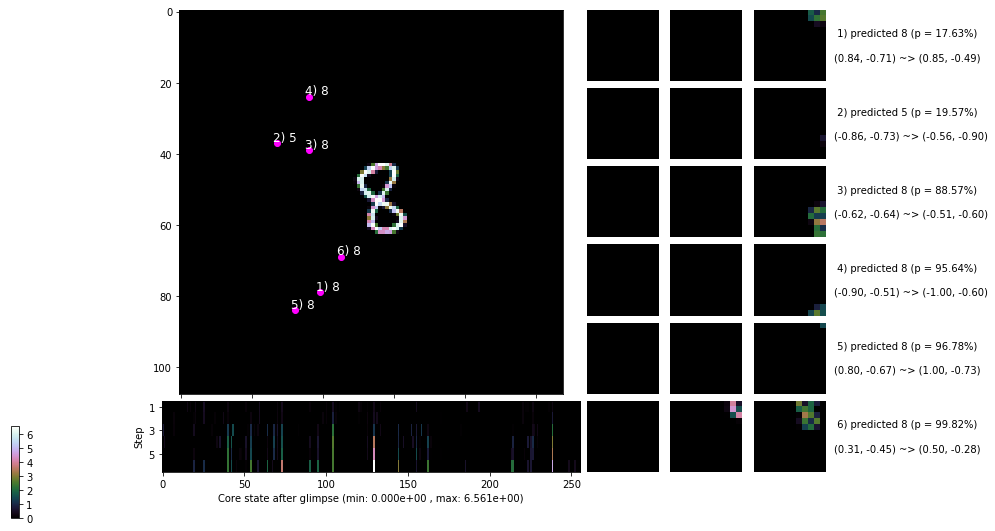

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


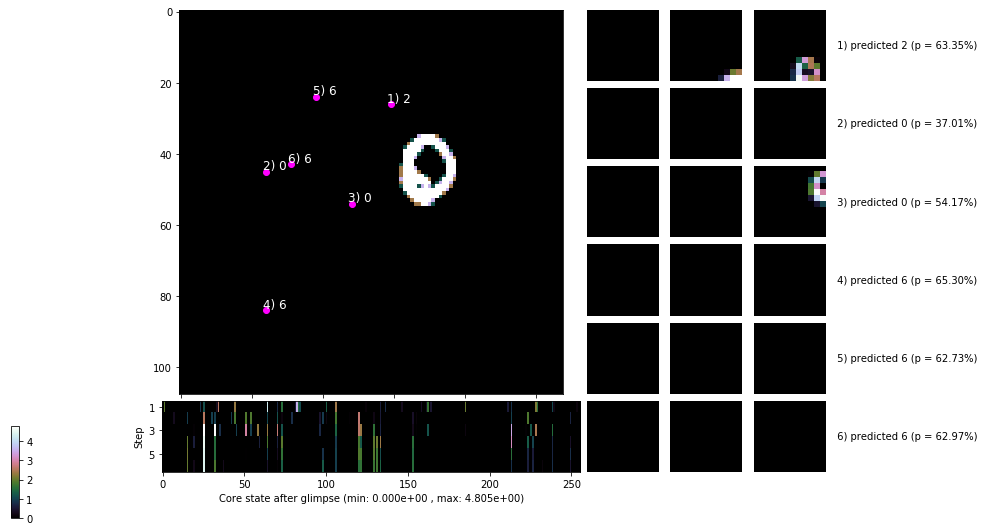


	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


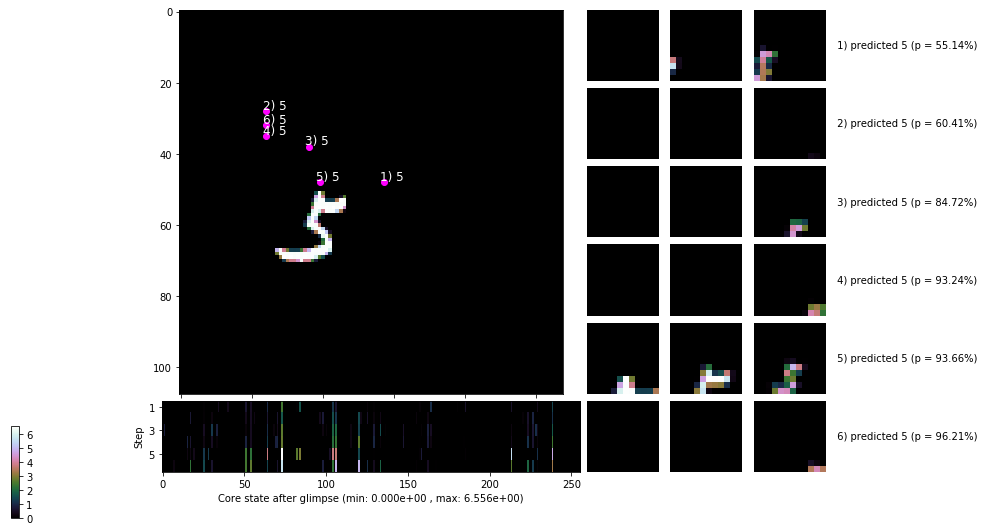

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


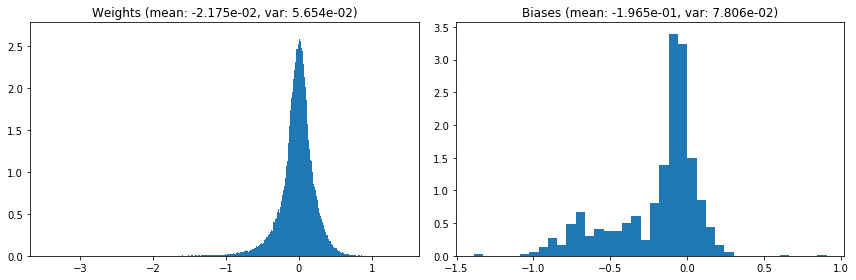

                                      Location network weights and biases


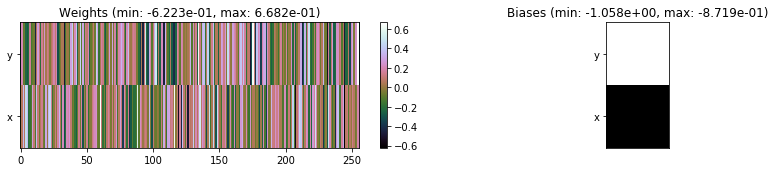

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.40 sec | TRAIN >> class loss: 0.1895 | steps:  2.229 :( | reward:  0.9404 :( | acc.: 94.035% :(
                          | VAL   >> class loss: 0.1793 | steps:  2.233 :( | reward:  0.9440 :( | acc.: 94.400% :(


Epoch  71/400) lr = 0.0001141
 b    500/  4000 >> 106.0 ms/b | lr: 1.14e-04 | grad 2norm: 385.07 | grad inf norm: 72.601
       Weights || abs max:  3.44 (10570.84) | mean: -2.18e-02 ( 0.07) | var: 5.65e-02 (20047.65)
        Biases || abs max:  1.39 (  165.16) | mean: -1.97e-01 ( 0.37) | var: 7.81e-02 (  788.88)
                  class loss: 0.203 | steps: 2.253 | reward:  0.939 | acc.: 93.92%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 104.8 ms/b | lr: 1.13e-04 | grad 2norm: 426.57 | grad inf norm: 76.717
       Weights || abs max:  3.44 ( 6535.13) | mean: -2.18e-02 ( 0.05)

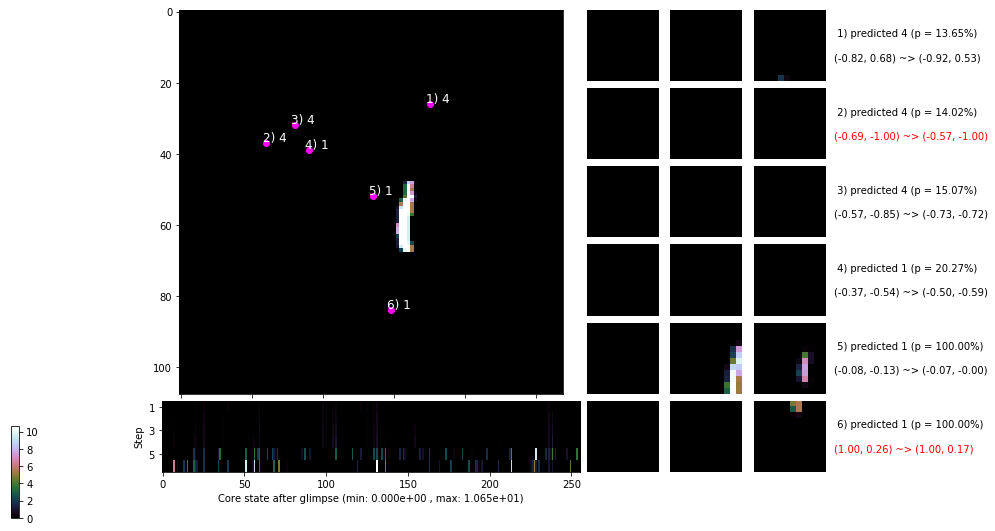

 b   1500/  4000 >> 103.8 ms/b | lr: 1.13e-04 | grad 2norm: 610.92 | grad inf norm: 110.310
       Weights || abs max:  3.44 (16625.91) | mean: -2.18e-02 ( 0.09) | var: 5.66e-02 (233102.28)
        Biases || abs max:  1.39 (  181.98) | mean: -1.97e-01 ( 0.38) | var: 7.83e-02 ( 1498.59)
                  class loss: 0.188 | steps: 2.249 | reward:  0.939 | acc.: 93.88%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 103.0 ms/b | lr: 1.12e-04 | grad 2norm: 25.26 | grad inf norm:  6.998
       Weights || abs max:  3.44 (12015.55) | mean: -2.18e-02 ( 0.08) | var: 5.66e-02 (25168.24)
        Biases || abs max:  1.39 (  713.97) | mean: -1.97e-01 ( 1.20) | var: 7.83e-02 (37347.36)
                  class loss: 0.195 | steps: 2.239 | reward:  0.938 | acc.: 93.79%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

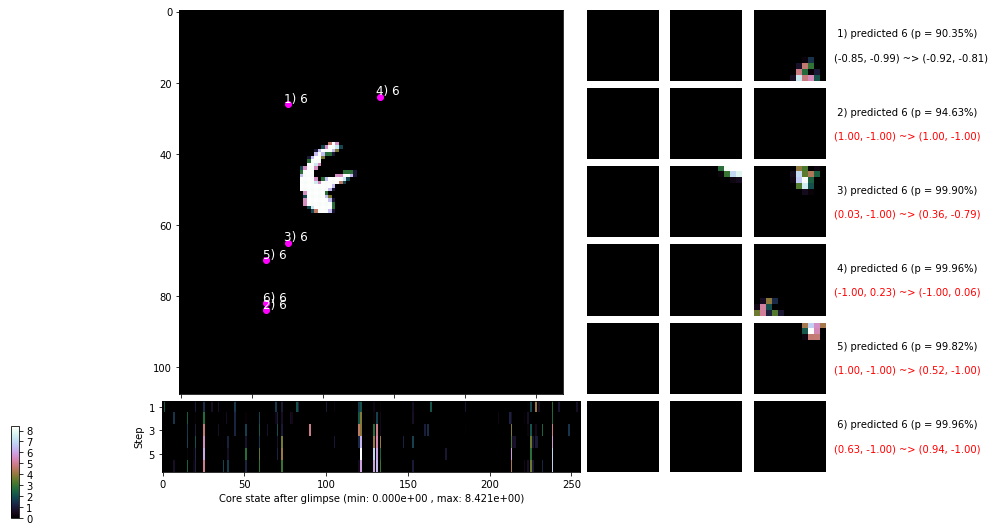

 b   2500/  4000 >> 103.9 ms/b | lr: 1.12e-04 | grad 2norm: 28.22 | grad inf norm:  7.562
       Weights || abs max:  3.44 ( 6937.84) | mean: -2.18e-02 ( 0.05) | var: 5.66e-02 ( 3441.54)
        Biases || abs max:  1.40 (  282.03) | mean: -1.97e-01 ( 0.43) | var: 7.84e-02 ( 1146.15)
                  class loss: 0.205 | steps: 2.226 | reward:  0.935 | acc.: 93.51%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 105.0 ms/b | lr: 1.12e-04 | grad 2norm: 913.73 | grad inf norm: 157.962
       Weights || abs max:  3.44 ( 9432.50) | mean: -2.18e-02 ( 0.06) | var: 5.66e-02 ( 7605.27)
        Biases || abs max:  1.39 (  415.38) | mean: -1.97e-01 ( 0.54) | var: 7.84e-02 (16277.97)
                  class loss: 0.195 | steps: 2.255 | reward:  0.935 | acc.: 93.46%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

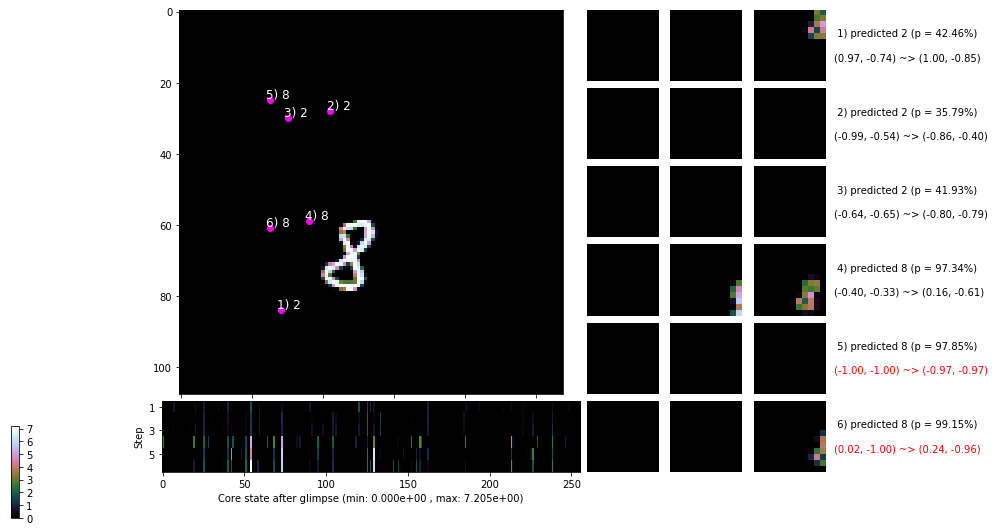

 b   3500/  4000 >> 110.4 ms/b | lr: 1.11e-04 | grad 2norm: 471.84 | grad inf norm: 83.943
       Weights || abs max:  3.44 (10790.83) | mean: -2.17e-02 ( 0.07) | var: 5.66e-02 (10173.24)
        Biases || abs max:  1.39 (  446.14) | mean: -1.97e-01 ( 0.64) | var: 7.83e-02 (15959.57)
                  class loss: 0.204 | steps: 2.267 | reward:  0.935 | acc.: 93.54%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 107.4 ms/b | lr: 1.11e-04 | grad 2norm: 25.34 | grad inf norm:  6.861
       Weights || abs max:  3.44 ( 8600.60) | mean: -2.17e-02 ( 0.06) | var: 5.66e-02 ( 3802.11)
        Biases || abs max:  1.40 (  175.48) | mean: -1.97e-01 ( 0.32) | var: 7.82e-02 ( 2281.60)
                  class loss: 0.209 | steps: 2.283 | reward:  0.934 | acc.: 93.37%
                 --------------------------------------------------------------------------------

	Target class: 6 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0

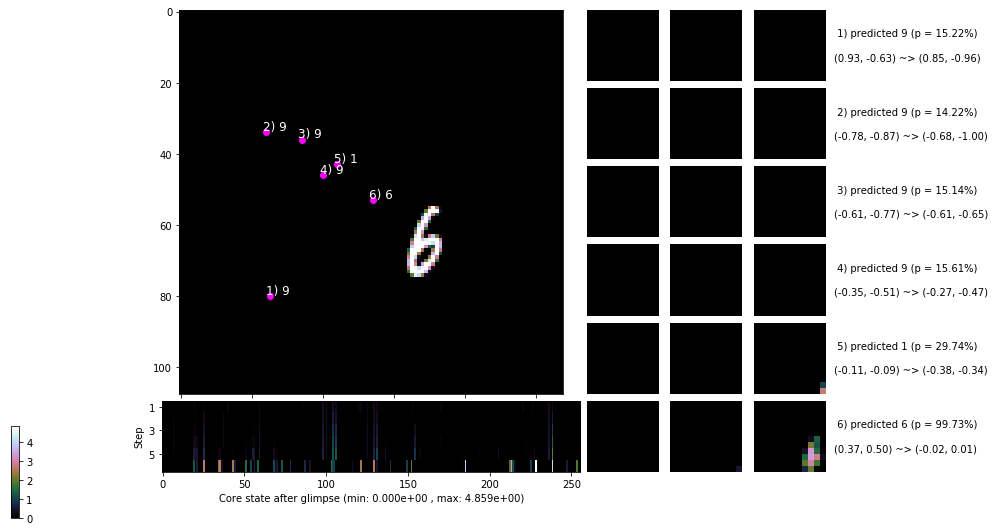

                                          ---===  VALIDATION  ===---

	Target class: 5  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


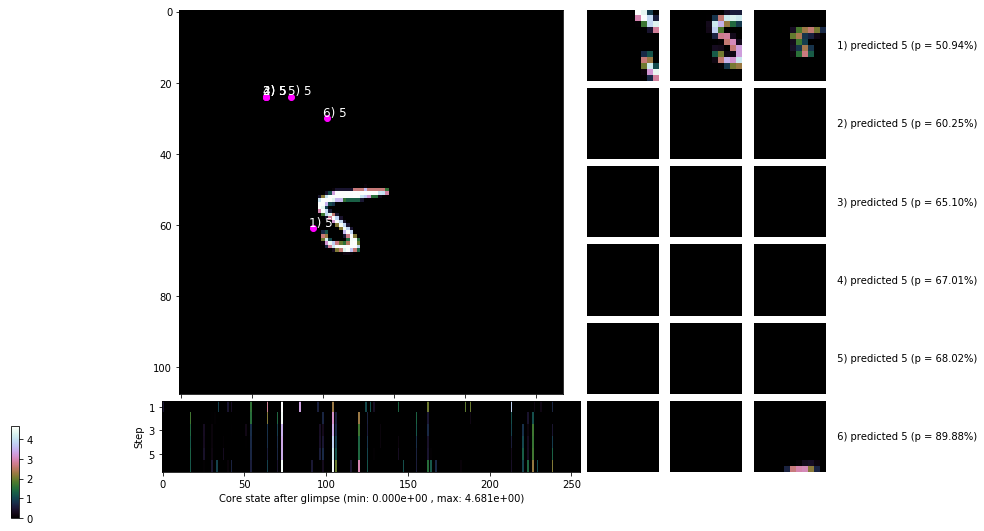


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


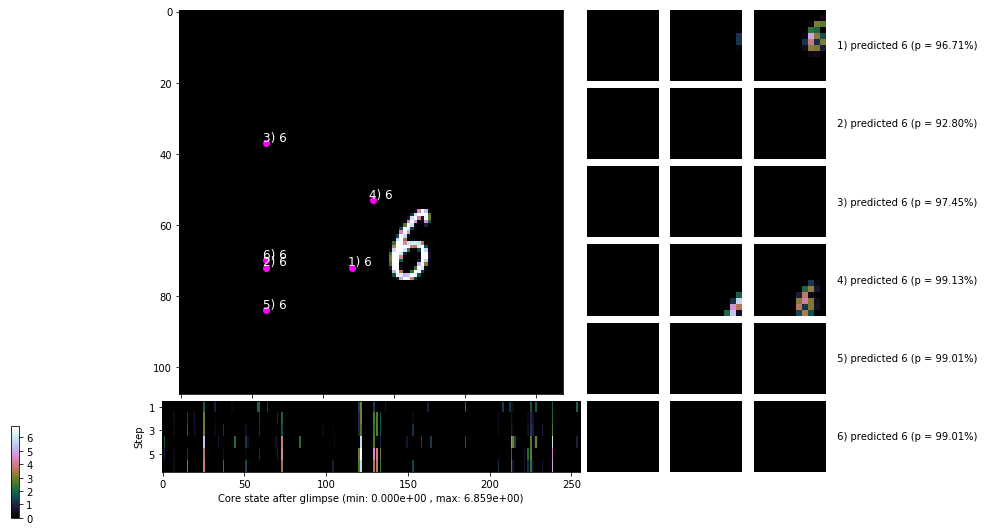

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


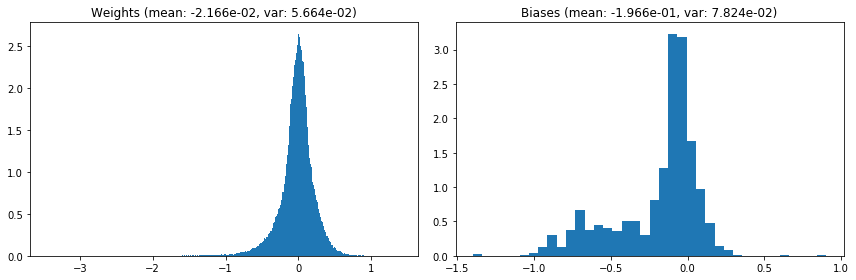

                                      Location network weights and biases


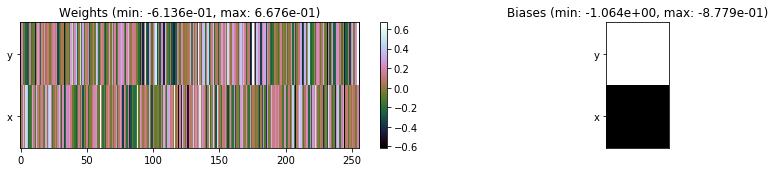

---------------------------------------------------------------------------------------------------------------
Elapsed time:  423.46 sec | TRAIN >> class loss: 0.1994 | steps:  2.253 :( | reward:  0.9367 :( | acc.: 93.670% :(
                          | VAL   >> class loss: 0.1852 | steps:  2.247 :( | reward:  0.9406 :( | acc.: 94.060% :(


Epoch  72/400) lr = 0.0001106
 b    500/  4000 >> 111.9 ms/b | lr: 1.10e-04 | grad 2norm: 516.11 | grad inf norm: 96.678
       Weights || abs max:  3.44 ( 6518.58) | mean: -2.17e-02 ( 0.05) | var: 5.66e-02 ( 2699.97)
        Biases || abs max:  1.40 (  226.27) | mean: -1.97e-01 ( 0.41) | var: 7.82e-02 ( 1112.76)
                  class loss: 0.210 | steps: 2.268 | reward:  0.933 | acc.: 93.25%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 107.5 ms/b | lr: 1.10e-04 | grad 2norm: 1102.90 | grad inf norm: 196.768
       Weights || abs max:  3.44 ( 7621.09) | mean: -2.16e-02 ( 0.0

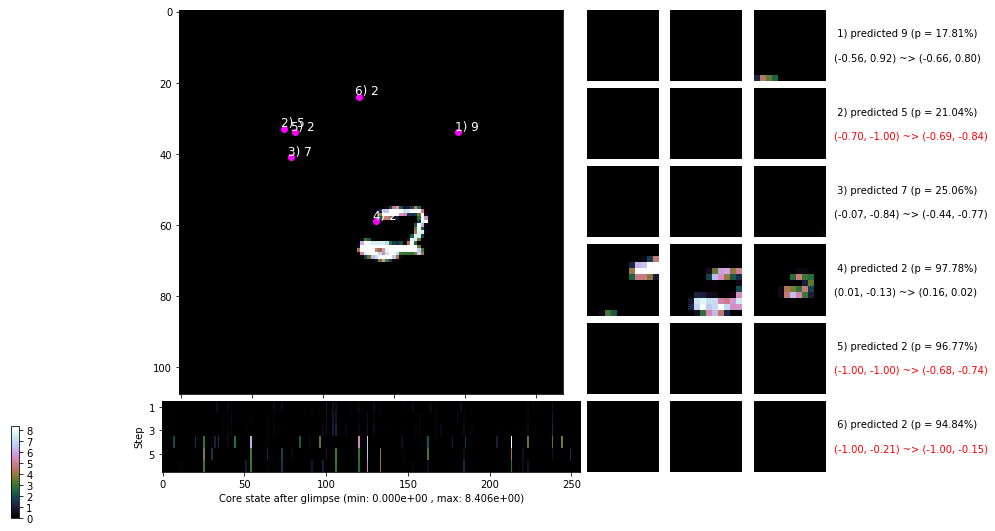

 b   1500/  4000 >> 107.9 ms/b | lr: 1.09e-04 | grad 2norm: 113.28 | grad inf norm: 24.329
       Weights || abs max:  3.43 (35898.92) | mean: -2.17e-02 ( 0.17) | var: 5.67e-02 (523459.31)
        Biases || abs max:  1.40 ( 3079.71) | mean: -1.97e-01 ( 3.10) | var: 7.84e-02 (4364810.00)
                  class loss: 0.199 | steps: 2.261 | reward:  0.938 | acc.: 93.76%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 107.1 ms/b | lr: 1.09e-04 | grad 2norm: 60.58 | grad inf norm: 14.225
       Weights || abs max:  3.44 (17439.38) | mean: -2.17e-02 ( 0.09) | var: 5.67e-02 (252944.22)
        Biases || abs max:  1.40 (  344.29) | mean: -1.97e-01 ( 0.45) | var: 7.85e-02 (11025.58)
                  class loss: 0.187 | steps: 2.240 | reward:  0.940 | acc.: 93.97%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0,

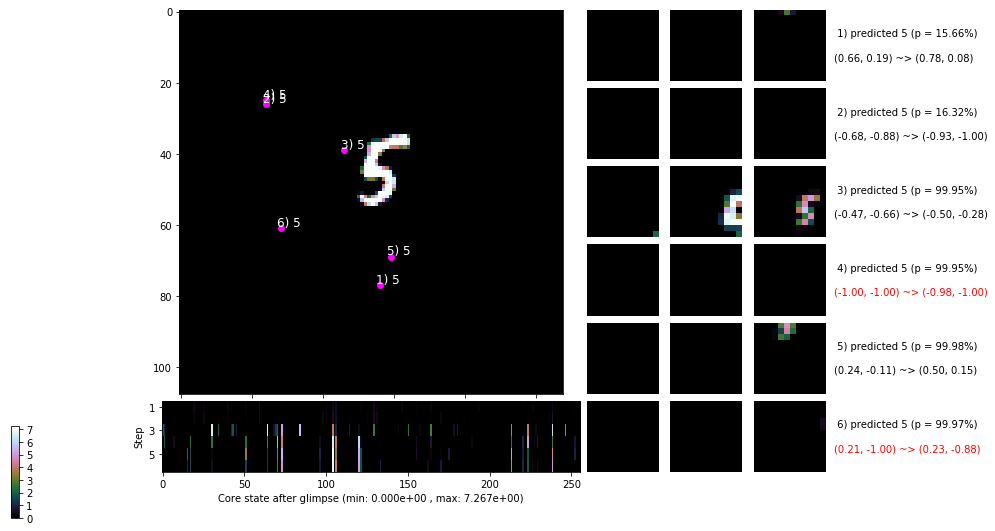

 b   2500/  4000 >> 109.3 ms/b | lr: 1.09e-04 | grad 2norm: 410.54 | grad inf norm: 79.001
       Weights || abs max:  3.44 (12903.58) | mean: -2.16e-02 ( 0.07) | var: 5.67e-02 (43286.05)
        Biases || abs max:  1.40 (   82.95) | mean: -1.97e-01 ( 0.19) | var: 7.85e-02 (  338.18)
                  class loss: 0.200 | steps: 2.270 | reward:  0.937 | acc.: 93.71%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 106.2 ms/b | lr: 1.08e-04 | grad 2norm: 40.54 | grad inf norm:  9.591
       Weights || abs max:  3.44 (11148.29) | mean: -2.16e-02 ( 0.07) | var: 5.67e-02 (11559.29)
        Biases || abs max:  1.40 (   93.18) | mean: -1.97e-01 ( 0.21) | var: 7.84e-02 (   83.29)
                  class loss: 0.197 | steps: 2.254 | reward:  0.936 | acc.: 93.57%
                 --------------------------------------------------------------------------------

	Target class: 4 | Discounted rewards: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

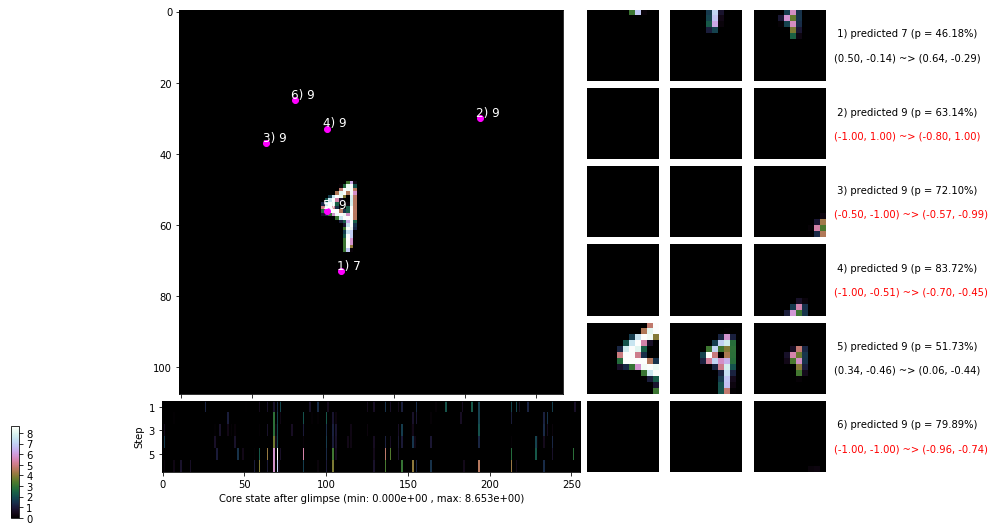

 b   3500/  4000 >> 110.8 ms/b | lr: 1.08e-04 | grad 2norm: 553.87 | grad inf norm: 96.678
       Weights || abs max:  3.44 (23437.51) | mean: -2.16e-02 ( 0.12) | var: 5.67e-02 (305043.97)
        Biases || abs max:  1.40 (  146.50) | mean: -1.97e-01 ( 0.26) | var: 7.84e-02 (  476.01)
                  class loss: 0.216 | steps: 2.271 | reward:  0.930 | acc.: 93.02%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 115.9 ms/b | lr: 1.07e-04 | grad 2norm: 116.84 | grad inf norm: 24.824
       Weights || abs max:  3.44 ( 5454.23) | mean: -2.16e-02 ( 0.05) | var: 5.67e-02 (  965.23)
        Biases || abs max:  1.41 (  158.67) | mean: -1.97e-01 ( 0.29) | var: 7.85e-02 (  969.27)
                  class loss: 0.215 | steps: 2.311 | reward:  0.930 | acc.: 93.01%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

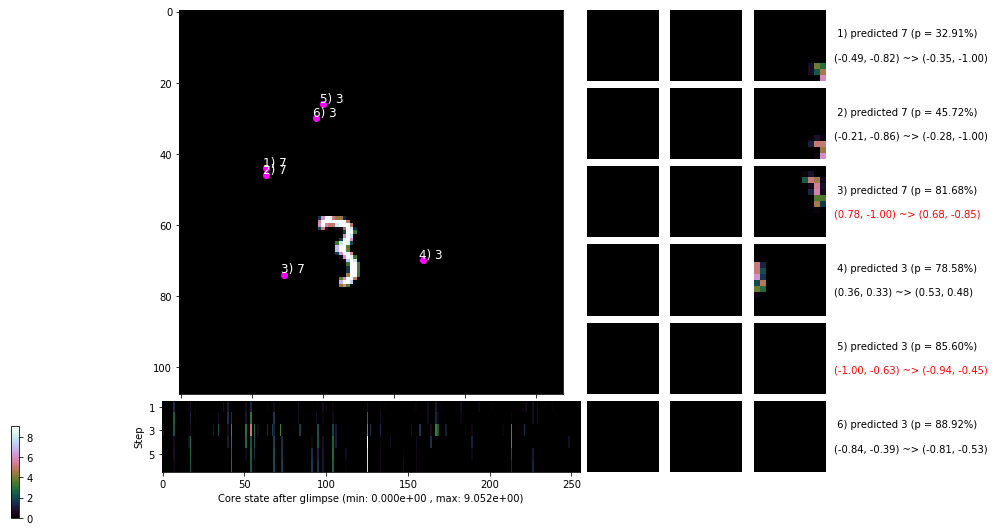

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


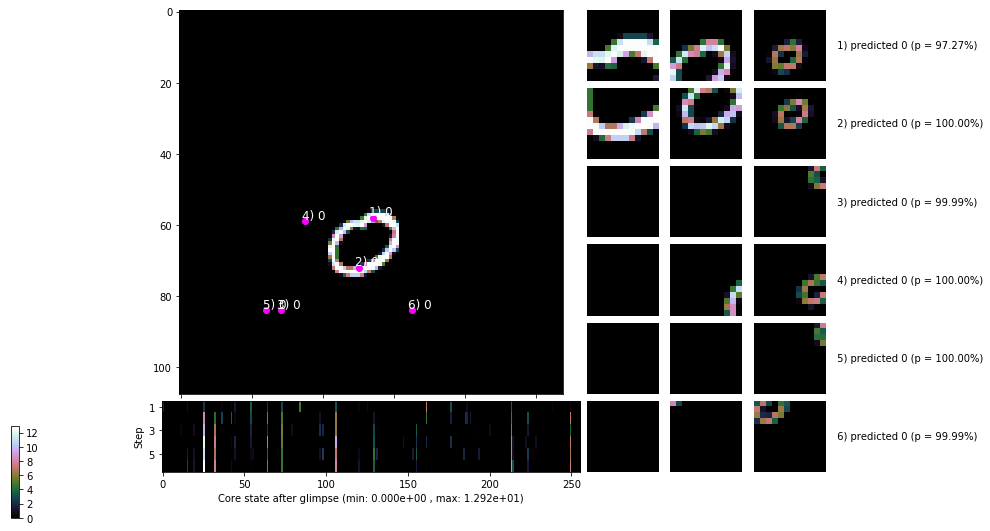


	Target class: 2  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


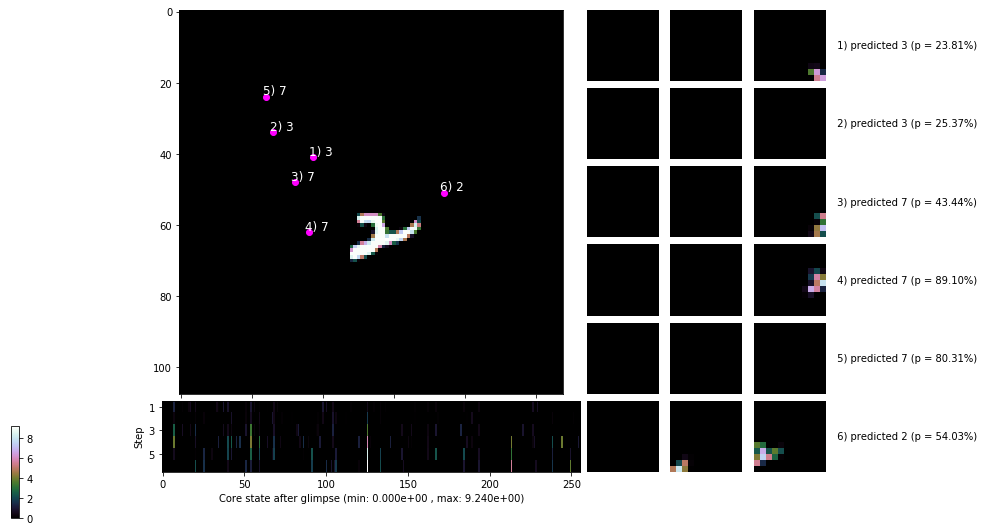

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


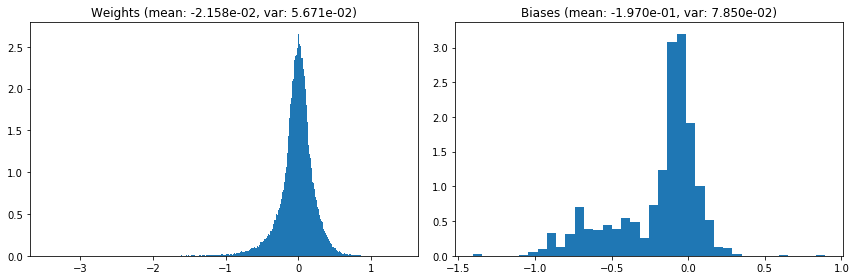

                                      Location network weights and biases


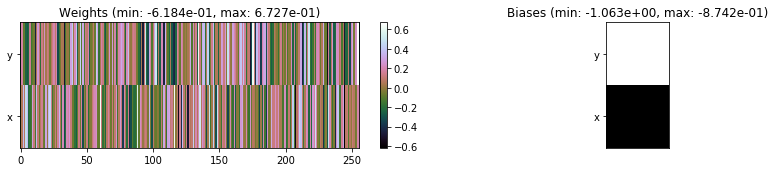

---------------------------------------------------------------------------------------------------------------
Elapsed time:  439.33 sec | TRAIN >> class loss: 0.2031 | steps:  2.268 :( | reward:  0.9351 :( | acc.: 93.507% :(
                          | VAL   >> class loss: 0.1910 | steps:  2.325 :( | reward:  0.9394 :( | acc.: 93.940% :(


Epoch  73/400) lr = 0.0001072
 b    500/  4000 >> 106.6 ms/b | lr: 1.07e-04 | grad 2norm: 76.20 | grad inf norm: 17.043
       Weights || abs max:  3.44 ( 7833.41) | mean: -2.16e-02 ( 0.05) | var: 5.67e-02 ( 8781.17)
        Biases || abs max:  1.41 (  848.69) | mean: -1.97e-01 ( 0.99) | var: 7.86e-02 (216802.23)
                  class loss: 0.209 | steps: 2.287 | reward:  0.932 | acc.: 93.20%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 105.7 ms/b | lr: 1.06e-04 | grad 2norm: 121.61 | grad inf norm: 25.225
       Weights || abs max:  3.44 ( 6075.42) | mean: -2.16e-02 ( 0.05)

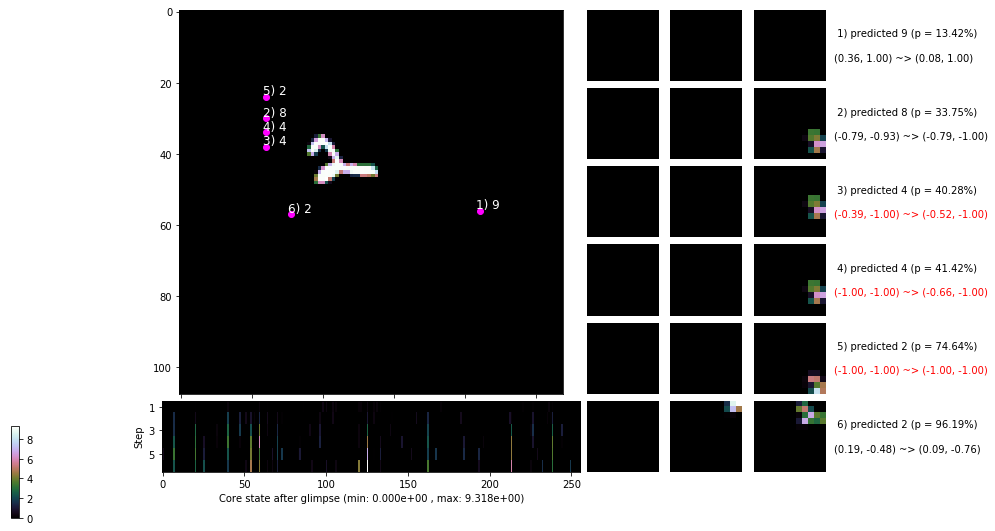

 b   1500/  4000 >> 107.7 ms/b | lr: 1.06e-04 | grad 2norm: 252.24 | grad inf norm: 50.847
       Weights || abs max:  3.45 (10559.54) | mean: -2.15e-02 ( 0.07) | var: 5.67e-02 (12711.99)
        Biases || abs max:  1.41 (  716.48) | mean: -1.97e-01 ( 0.87) | var: 7.87e-02 (24500.20)
                  class loss: 0.197 | steps: 2.273 | reward:  0.935 | acc.: 93.51%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.0 ms/b | lr: 1.06e-04 | grad 2norm: 1588.03 | grad inf norm: 278.593
       Weights || abs max:  3.45 ( 7646.59) | mean: -2.15e-02 ( 0.06) | var: 5.68e-02 ( 5489.63)
        Biases || abs max:  1.41 (  495.80) | mean: -1.97e-01 ( 0.65) | var: 7.86e-02 ( 5441.22)
                  class loss: 0.196 | steps: 2.249 | reward:  0.937 | acc.: 93.70%
                 --------------------------------------------------------------------------------

	Target class: 3 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 

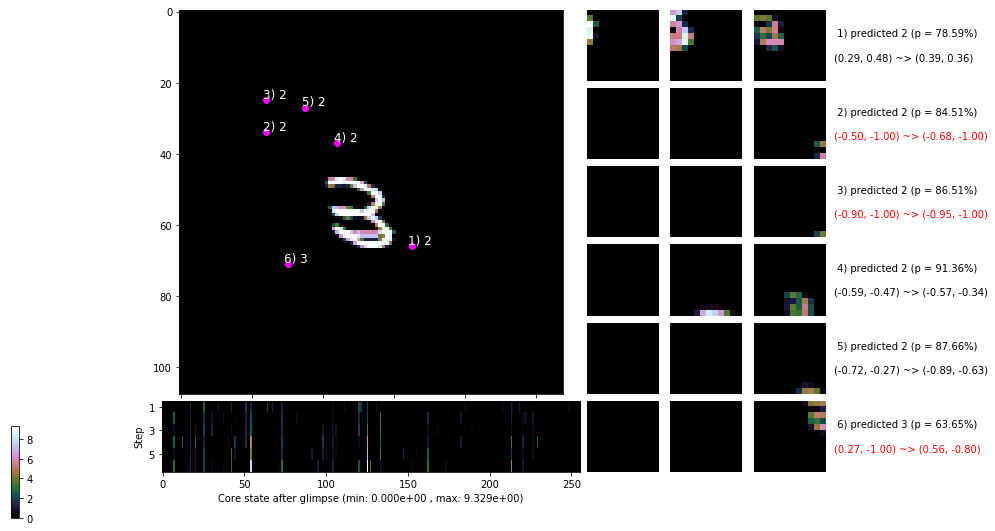

 b   2500/  4000 >> 113.8 ms/b | lr: 1.05e-04 | grad 2norm: 5296.77 | grad inf norm: 928.524
       Weights || abs max:  3.46 ( 8776.93) | mean: -2.15e-02 ( 0.06) | var: 5.68e-02 (13972.32)
        Biases || abs max:  1.41 (  331.46) | mean: -1.97e-01 ( 0.50) | var: 7.86e-02 ( 7090.19)
                  class loss: 0.198 | steps: 2.280 | reward:  0.934 | acc.: 93.45%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 103.8 ms/b | lr: 1.05e-04 | grad 2norm: 21.23 | grad inf norm:  5.824
       Weights || abs max:  3.46 (11117.33) | mean: -2.15e-02 ( 0.07) | var: 5.68e-02 (11289.66)
        Biases || abs max:  1.41 (  336.69) | mean: -1.97e-01 ( 0.46) | var: 7.87e-02 (13150.16)
                  class loss: 0.206 | steps: 2.274 | reward:  0.932 | acc.: 93.19%
                 --------------------------------------------------------------------------------

	Target class: 8 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

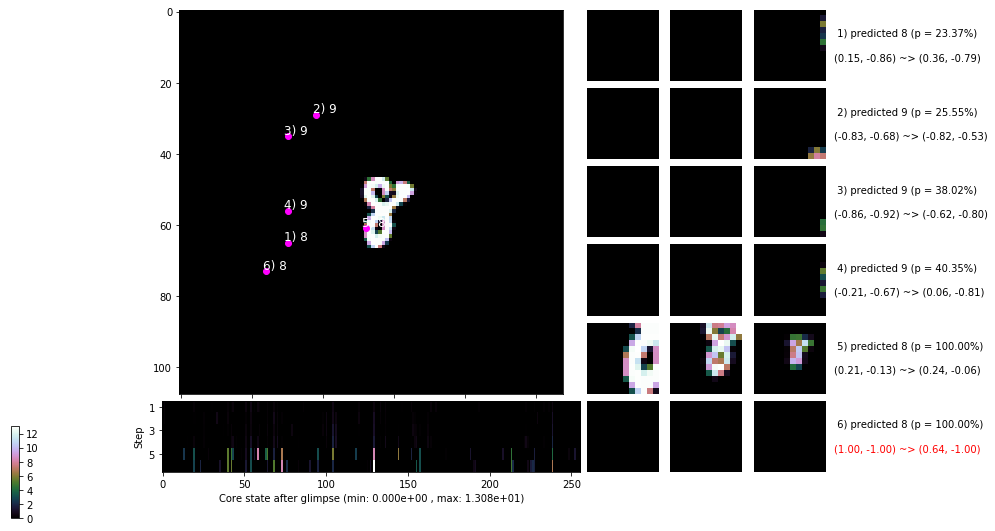

 b   3500/  4000 >> 104.0 ms/b | lr: 1.04e-04 | grad 2norm: 145.40 | grad inf norm: 29.450
       Weights || abs max:  3.46 ( 7372.02) | mean: -2.14e-02 ( 0.06) | var: 5.68e-02 ( 3348.61)
        Biases || abs max:  1.41 (   85.36) | mean: -1.97e-01 ( 0.20) | var: 7.88e-02 (  284.10)
                  class loss: 0.203 | steps: 2.258 | reward:  0.935 | acc.: 93.49%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 102.4 ms/b | lr: 1.04e-04 | grad 2norm: 532.21 | grad inf norm: 93.682
       Weights || abs max:  3.46 ( 5816.27) | mean: -2.14e-02 ( 0.05) | var: 5.68e-02 ( 1444.31)
        Biases || abs max:  1.41 (  109.53) | mean: -1.97e-01 ( 0.22) | var: 7.88e-02 (  146.64)
                  class loss: 0.202 | steps: 2.257 | reward:  0.934 | acc.: 93.38%
                 --------------------------------------------------------------------------------

	Target class: 1 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

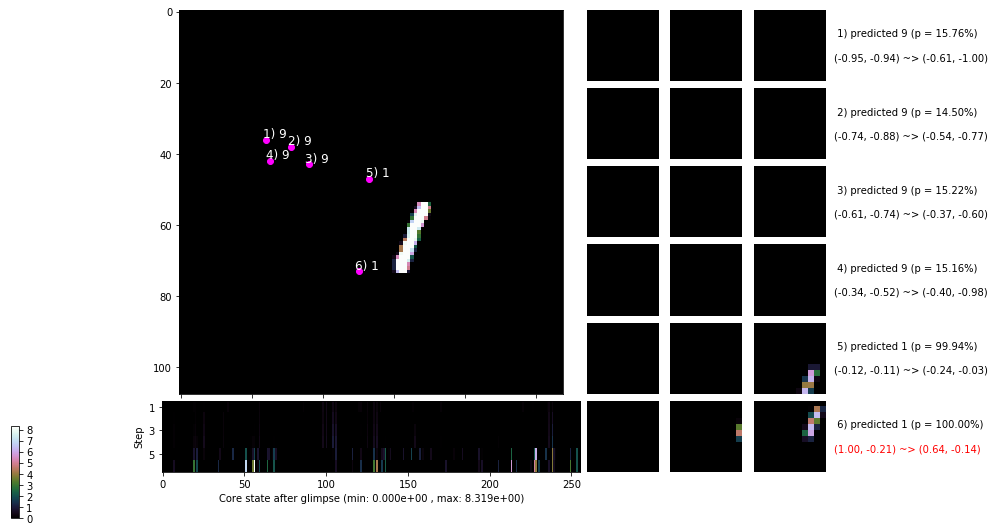

                                          ---===  VALIDATION  ===---

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


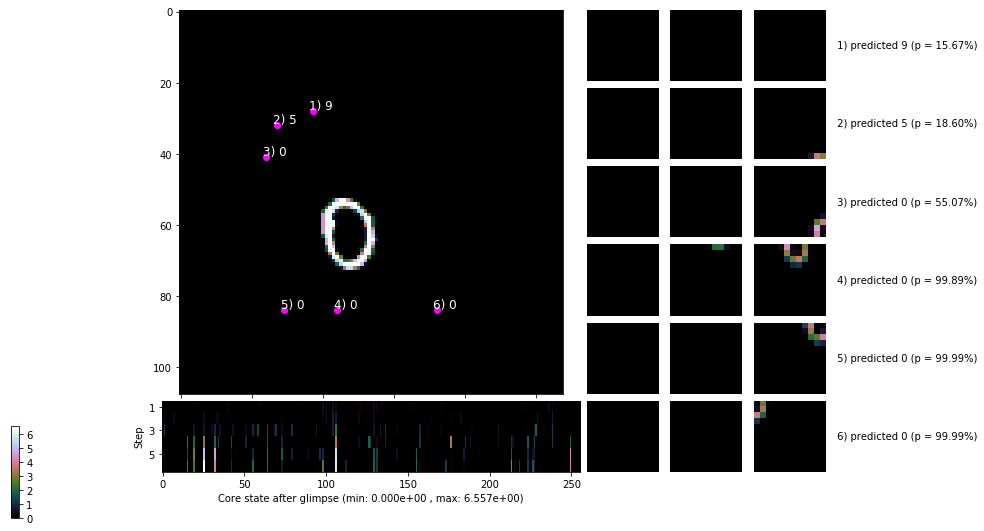


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


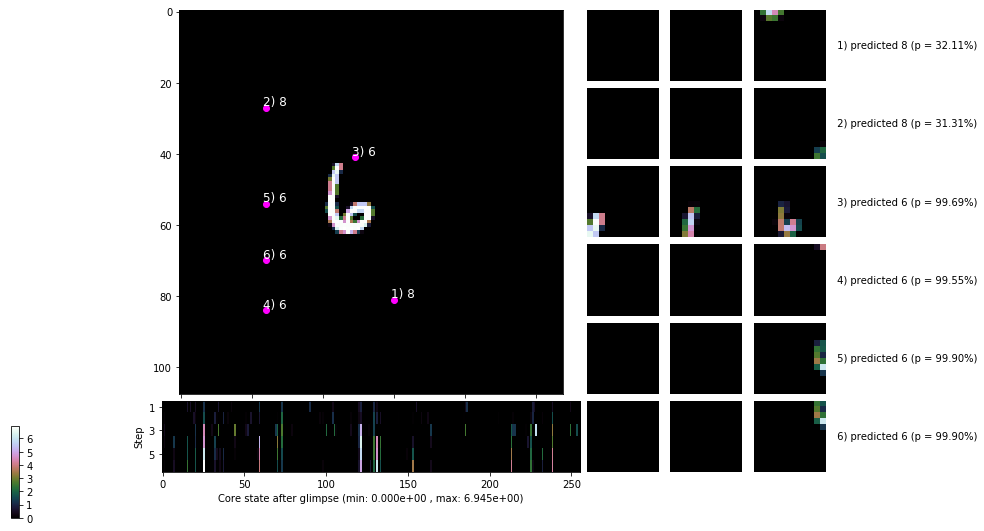

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


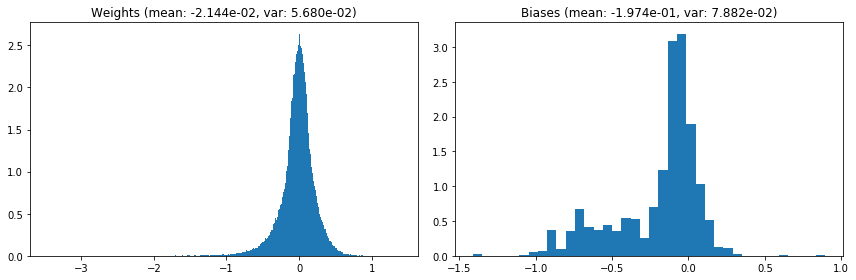

                                      Location network weights and biases


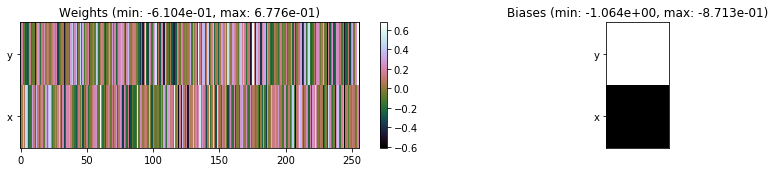

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.71 sec | TRAIN >> class loss: 0.2019 | steps:  2.267 :( | reward:  0.9339 :( | acc.: 93.389% :(
                          | VAL   >> class loss: 0.1878 | steps:  2.241 :( | reward:  0.9410 :( | acc.: 94.100% :(


Epoch  74/400) lr = 0.0001039
 b    500/  4000 >> 105.2 ms/b | lr: 1.04e-04 | grad 2norm: 724.41 | grad inf norm: 133.620
       Weights || abs max:  3.46 ( 5054.83) | mean: -2.15e-02 ( 0.04) | var: 5.68e-02 (  934.06)
        Biases || abs max:  1.41 (  270.59) | mean: -1.97e-01 ( 0.49) | var: 7.89e-02 ( 9499.25)
                  class loss: 0.222 | steps: 2.236 | reward:  0.941 | acc.: 94.09%
                 --------------------------------------------------------------------------------
 b   1000/  4000 >> 111.3 ms/b | lr: 1.03e-04 | grad 2norm: 1174.39 | grad inf norm: 209.890
       Weights || abs max:  3.46 ( 5785.83) | mean: -2.15e-02 ( 0.

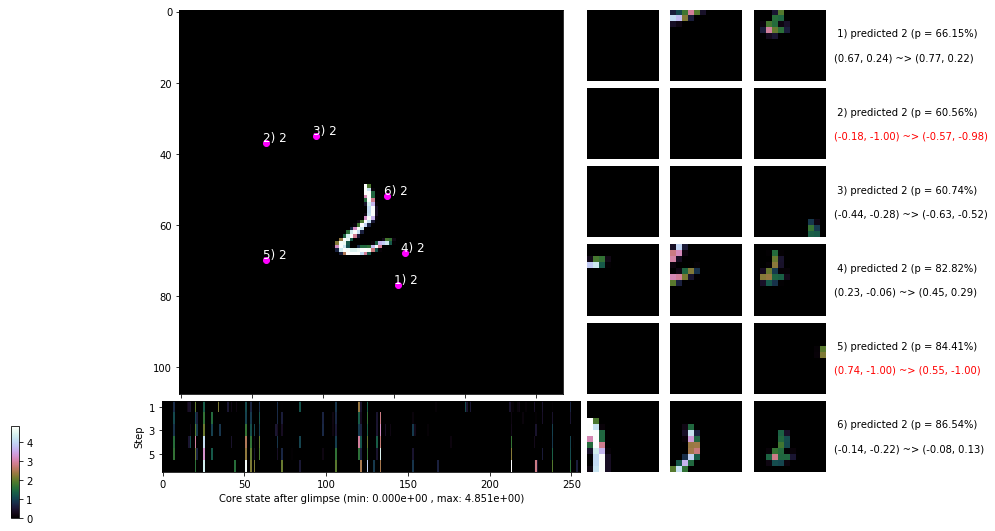

 b   1500/  4000 >> 108.1 ms/b | lr: 1.03e-04 | grad 2norm: 156.03 | grad inf norm: 30.712
       Weights || abs max:  3.46 ( 5186.45) | mean: -2.14e-02 ( 0.04) | var: 5.68e-02 ( 2055.68)
        Biases || abs max:  1.41 (  108.05) | mean: -1.97e-01 ( 0.24) | var: 7.90e-02 (   95.23)
                  class loss: 0.201 | steps: 2.260 | reward:  0.939 | acc.: 93.85%
                 --------------------------------------------------------------------------------
 b   2000/  4000 >> 109.3 ms/b | lr: 1.02e-04 | grad 2norm: 571.02 | grad inf norm: 107.450
       Weights || abs max:  3.46 ( 8433.66) | mean: -2.14e-02 ( 0.06) | var: 5.68e-02 ( 6930.78)
        Biases || abs max:  1.41 (  154.90) | mean: -1.97e-01 ( 0.27) | var: 7.89e-02 (  449.54)
                  class loss: 0.196 | steps: 2.244 | reward:  0.938 | acc.: 93.77%
                 --------------------------------------------------------------------------------

	Target class: 9 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1

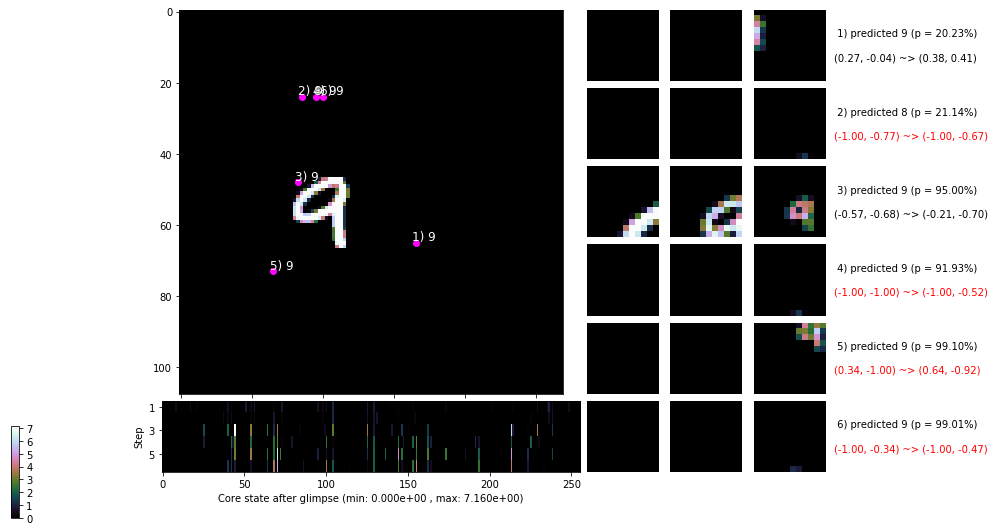

 b   2500/  4000 >> 108.3 ms/b | lr: 1.02e-04 | grad 2norm: 424.19 | grad inf norm: 76.874
       Weights || abs max:  3.46 ( 5042.80) | mean: -2.14e-02 ( 0.05) | var: 5.68e-02 (  668.78)
        Biases || abs max:  1.41 (   63.39) | mean: -1.97e-01 ( 0.17) | var: 7.90e-02 (  226.14)
                  class loss: 0.185 | steps: 2.196 | reward:  0.940 | acc.: 94.02%
                 --------------------------------------------------------------------------------
 b   3000/  4000 >> 104.4 ms/b | lr: 1.02e-04 | grad 2norm: 271.09 | grad inf norm: 52.364
       Weights || abs max:  3.46 ( 8067.11) | mean: -2.14e-02 ( 0.06) | var: 5.68e-02 ( 3832.66)
        Biases || abs max:  1.41 (  156.50) | mean: -1.98e-01 ( 0.28) | var: 7.91e-02 (  984.18)
                  class loss: 0.196 | steps: 2.220 | reward:  0.939 | acc.: 93.91%
                 --------------------------------------------------------------------------------

	Target class: 0 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.

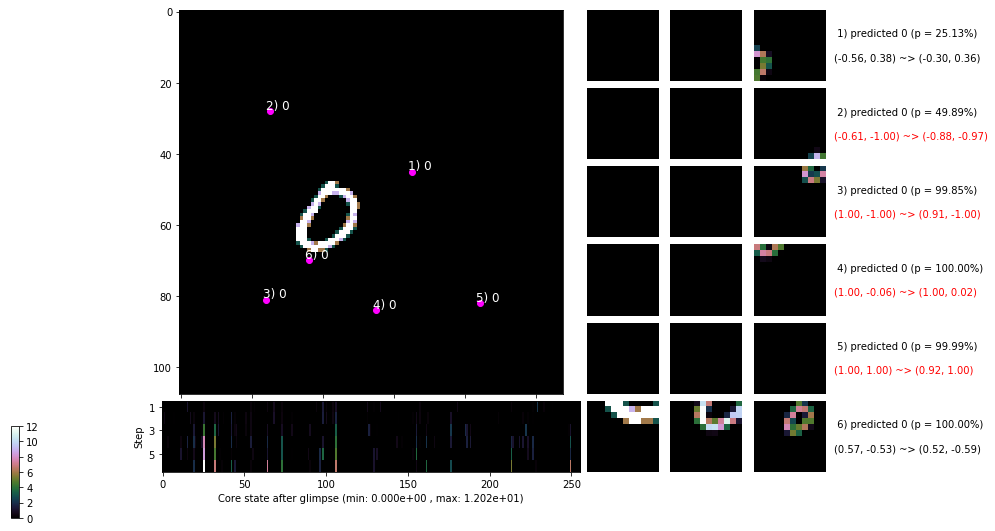

 b   3500/  4000 >> 106.8 ms/b | lr: 1.01e-04 | grad 2norm: 2501.43 | grad inf norm: 423.705
       Weights || abs max:  3.45 (13320.48) | mean: -2.13e-02 ( 0.08) | var: 5.69e-02 (13712.15)
        Biases || abs max:  1.41 (   88.30) | mean: -1.97e-01 ( 0.20) | var: 7.90e-02 (  184.92)
                  class loss: 0.195 | steps: 2.236 | reward:  0.938 | acc.: 93.79%
                 --------------------------------------------------------------------------------
 b   4000/  4000 >> 109.1 ms/b | lr: 1.01e-04 | grad 2norm: 1996.80 | grad inf norm: 336.689
       Weights || abs max:  3.46 (24752.34) | mean: -2.13e-02 ( 0.12) | var: 5.69e-02 (236828.97)
        Biases || abs max:  1.41 (  271.59) | mean: -1.98e-01 ( 0.38) | var: 7.91e-02 (10072.78)
                  class loss: 0.208 | steps: 2.234 | reward:  0.933 | acc.: 93.35%
                 --------------------------------------------------------------------------------

	Target class: 5 | Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.

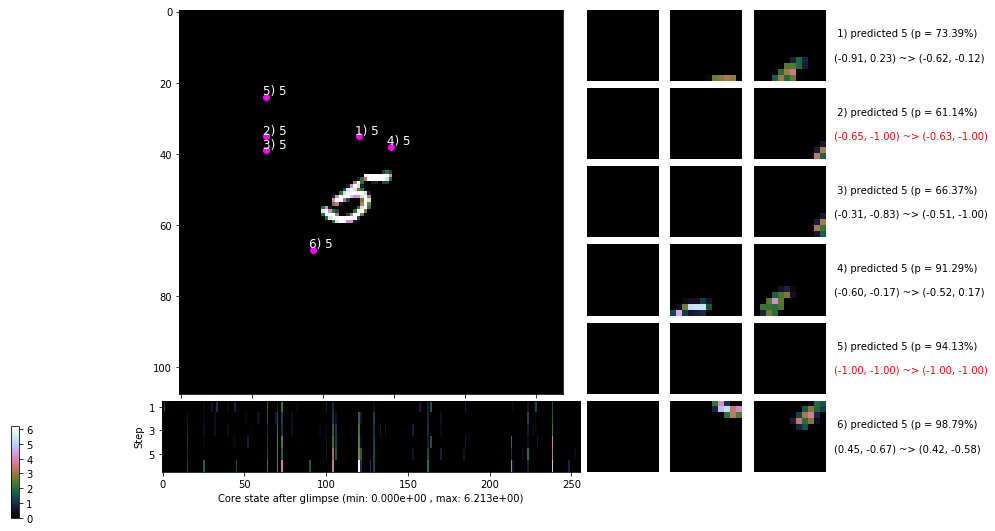

                                          ---===  VALIDATION  ===---

	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


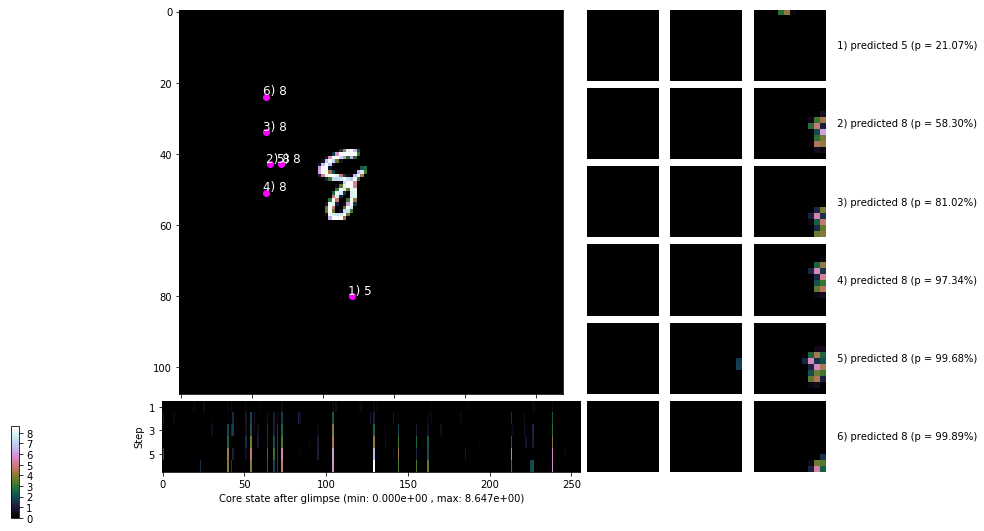


	Target class: 6  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


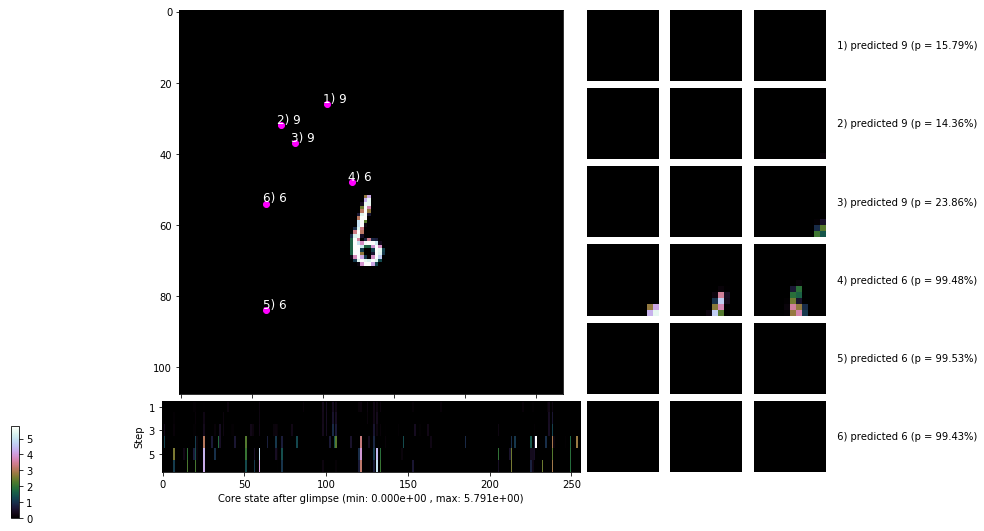

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


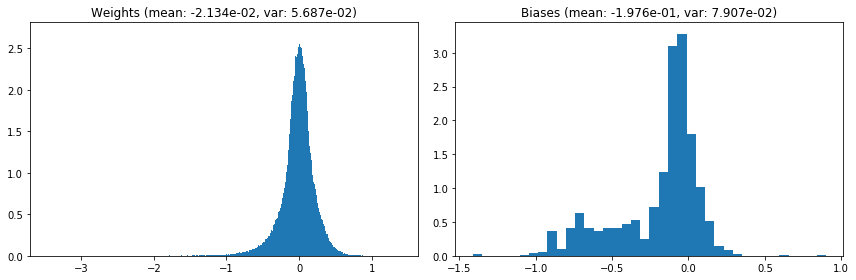

                                      Location network weights and biases


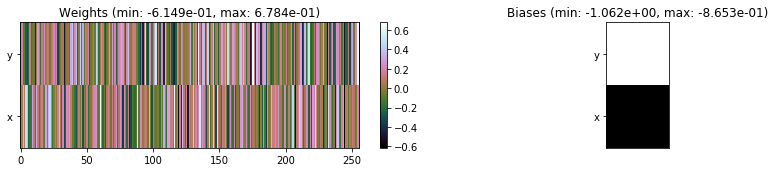

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.39 sec | TRAIN >> class loss: 0.1998 | steps:  2.234 :( | reward:  0.9383 :( | acc.: 93.832% :(
                          | VAL   >> class loss: 0.1864 | steps:  2.200 :( | reward:  0.9390 :( | acc.: 93.900% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 0  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


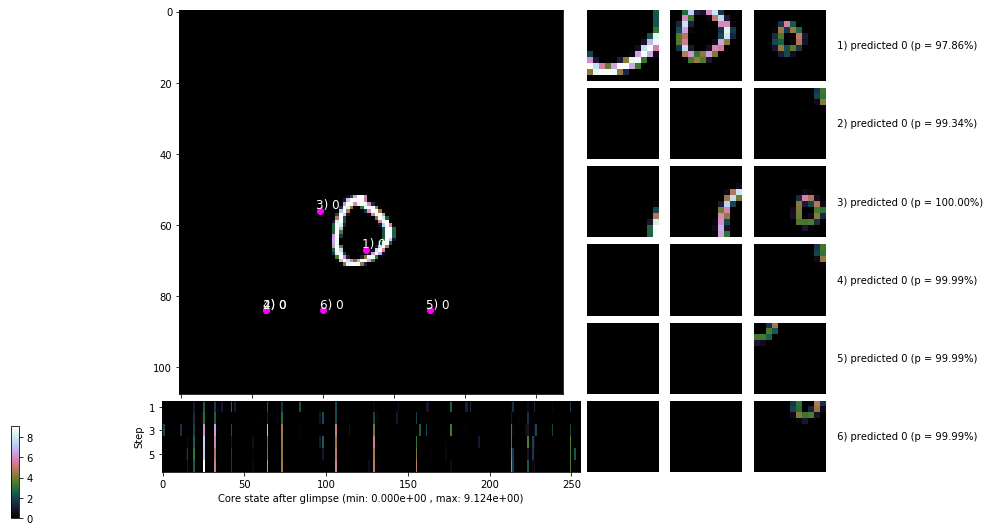


	Target class: 8  |  Discounted rewards: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


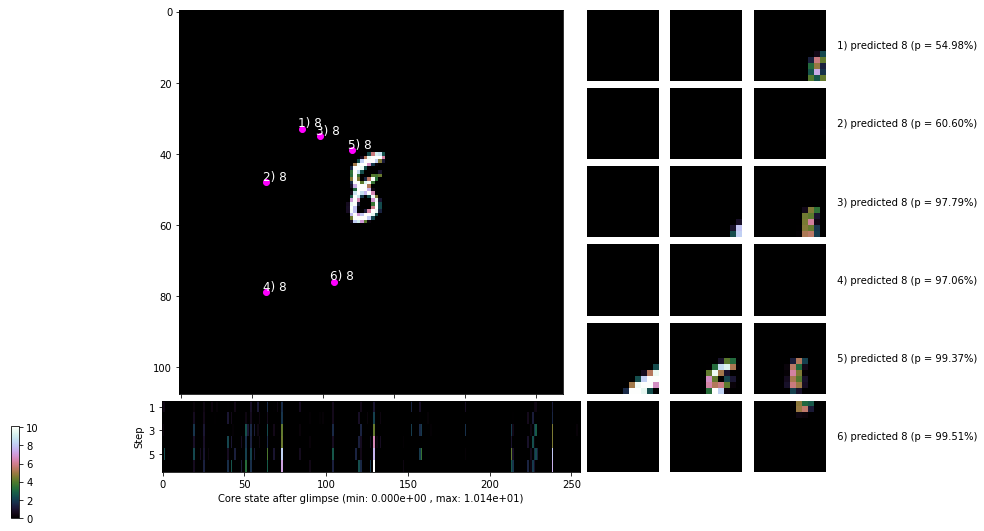

	>> class loss: 0.2100 | steps:  2.238 | reward:  0.9350 | acc.: 93.500%


In [8]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    eval_viz_freq = eval_viz_freq, early_stopping = early_stopping
)

In [9]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.2f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 74 epochs

Best train stats:
    steps: 2.15 (epoch 51)
    reward: 0.94 (epoch 66)
    accuracy: 0.94 (epoch 66)

Best val stats:
    steps: 2.09 (epoch 63)
    reward: 0.95 (epoch 63)
    accuracy: 0.95 (epoch 63)



### Training curves

In [10]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

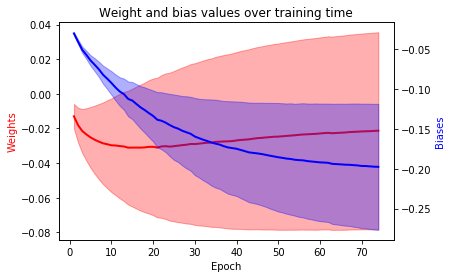

In [11]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

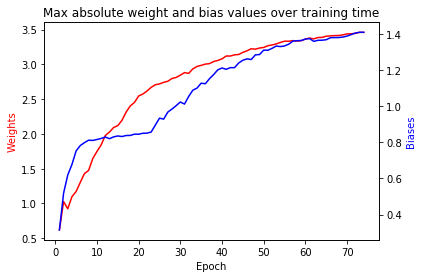

In [12]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

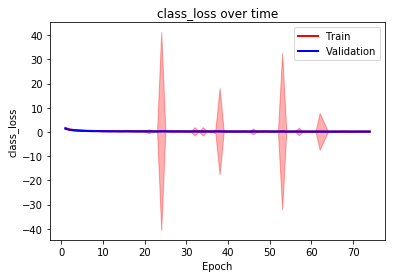

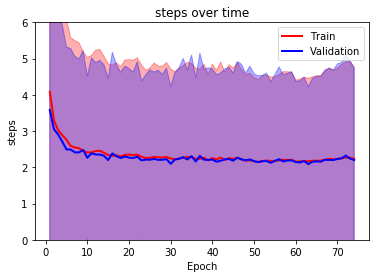

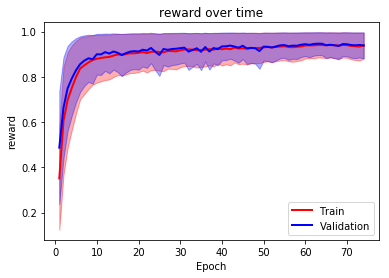

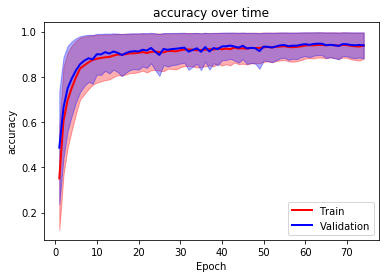

In [13]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

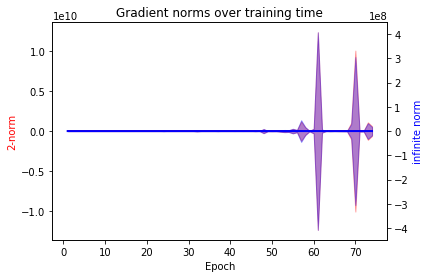

In [14]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')